In [1]:
import cv2 as cv
import glob, os
from scipy import signal
import numpy as np
import matplotlib.pyplot as plt

path = '/Users/estepark/Documents/week9_tues/images'
results = '/Users/estepark/Documents/week9_tues/results'
kern = [[0, 1,  0], [1, 0, -1],[ 0, -1 ,0]]

# for fname in glob.glob(path+'/*.Png'):
    
#     serNum = fname.split('/')[6] 
#     img  = cv.imread(fname)
#     imgray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
#     imgFilt = cv.bilateralFilter(imgray, 15, 75, 75)
    
#     diag_img = signal.convolve2d(imgFilt, np.array(kern), boundary='symm', mode='same')
#     diag_cpy = (((diag_img+2))/4*255).astype(np.uint8) #bc min=-2 and max=+2
    
#     print(diag_cpy)
#     plt.figure()
#     plt.title(serNum)
#     plt.imshow(diag_img)
#     plt.show()
#     cv.imwrite(os.path.join(results, serNum), diag_cpy)
    


/Users/estepark/Documents/week9_tues/label/1_20181126_102202_White_Reg.png
1_20181126_102202_White_Reg.png
(646, 481, 3)


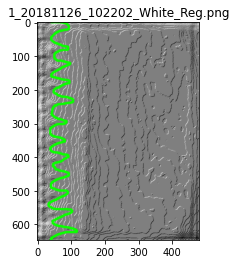

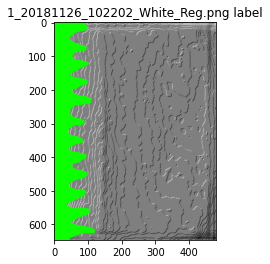

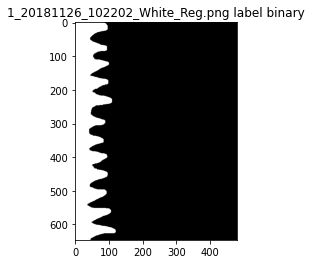

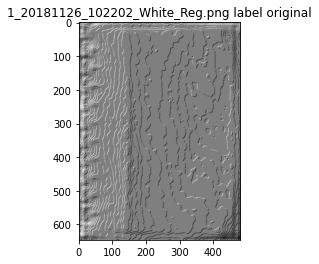

In [2]:
labels =  '/Users/estepark/Documents/week9_tues/label'

for fname in glob.glob(labels+'/*.png'):

    print(fname)
    serNum = fname.split('/')[6] 
    print(serNum)
    img  = cv.imread(fname)
    label = cv.imread('./results/{}'.format(serNum))
    labl = np.copy(img)
    
    labl_binary = np.zeros(img.shape[:2])
    print(labl.shape)
    for i in range(labl.shape[0]): 
        for j in range(labl.shape[1])[::-1]:
            if labl[i][j][0] == labl[i][j][1] == labl[i][j][2]:
                continue
            else:
                labl[i][0:j][:] = labl[i][j][:]
                labl_binary[i][0:j] = 1
                break
    plt.figure()
    plt.title(serNum)
    plt.imshow(img)
    plt.show()
    
    plt.figure()
    plt.title(serNum+' label')
    plt.imshow(labl)
    plt.show()
    
    plt.figure()
    plt.title(serNum+' label binary')
    plt.imshow(labl_binary, cmap="gray")
    plt.show()
    
    plt.figure()
    plt.title(serNum+' label original')
    plt.imshow(label, cmap="gray")
    plt.show()

In [3]:
label = label[:,:,0]
print(label.shape)
label = label/255
print('max = {}, min = {}'.format(np.max(label), np.min(label)))

(646, 481)
max = 1.0, min = 0.0


In [4]:
import scipy.fftpack
def dct2d(a):
    return scipy.fftpack.dct(scipy.fftpack.dct( a, axis=0, norm='ortho' ),axis=1,norm='ortho')
n = 0

print("img rows {}".format(label.shape[0]))
print("img cols {}".format(label.shape[1]))

# if (img.shape[0]%8 !=0):
#     floorX = math.floor(img.shape[0]/8)
#     if (img.shape[1]% 8!=0 ):
#         floorY = math.floor(img.shape[1]/8)
# imgCrop = img[0:floorX*8, 0:floorY*8 ]
ch_dct = []
not_dct = []
bad_ch = 0
bad_not = 0 
for i in range(label.shape[0]-7): 
    for j in range(label.shape[1]-7): 
        patch = label[i:i+8, j:j+8]
        
        #print(patch.shape,',',i,',',j)
        vec = dct2d(patch).flatten()
        if np.all(patch == patch[0][0]): 
            #print(i,',',j,':',vec)
            if labl_binary[i,j] == 1: 
                bad_ch += 1
            else: 
                bad_not += 1 
            continue
        if labl_binary[i,j] == 1: 
            ch_dct.append(vec)
        else: 
            not_dct.append(vec)
        assert patch.shape == (8,8)
        n = n + 1
print(n)
print(label.shape[0]*label.shape[1])
print('bad ch = {}, bad not = {}'.format(bad_ch, bad_not))




img rows 646
img cols 481
199042
310726
bad ch = 2857, bad not = 100987


In [5]:
ch_dct = np.array(ch_dct)
not_dct = np.array(not_dct)
print(ch_dct.shape)

(44139, 64)


In [6]:
np.mean(ch_dct, axis=0)

array([ 4.45685565e+00, -7.78836799e-03, -2.56025724e-03, -6.01085819e-05,
       -7.83054335e-04,  3.48923835e-04, -4.85436821e-04,  9.53001710e-05,
        6.66896115e-03,  2.68288990e-04,  1.58316565e-04,  6.78538520e-05,
        5.78132115e-05, -4.26705941e-05,  8.85999956e-05, -3.75432525e-06,
        3.92221496e-05,  1.43478472e-04, -7.84045722e-05, -7.23985589e-05,
       -9.64031717e-06, -2.80751162e-05,  9.62516751e-07, -2.49910213e-05,
        6.76370889e-04,  9.00981689e-05, -1.08991274e-04, -7.40410786e-05,
        6.19073858e-05, -8.41900242e-06, -3.61164556e-06,  1.92993422e-05,
        1.33257725e-04,  1.46387272e-04, -8.41522321e-05,  3.89770553e-05,
        2.41771871e-05, -5.58010430e-05,  2.71757290e-05, -2.18186866e-05,
        2.35977089e-04, -5.32063661e-06, -4.49318475e-05,  3.72007069e-05,
       -3.53253281e-05,  2.22377967e-05,  2.91995129e-05, -4.27216754e-06,
       -1.71109823e-04,  4.11619920e-05, -8.98822265e-06,  1.65435627e-05,
       -8.32813089e-06,  

In [7]:
np.mean(not_dct, axis=0)

array([ 3.88835752e+00,  8.71098803e-03,  1.69468442e-03,  1.30441655e-03,
        2.19596628e-04,  3.01996040e-04,  1.53119405e-04,  9.86679190e-05,
        8.51464992e-03, -1.79469781e-04, -4.97980993e-05, -2.44080414e-05,
       -1.65054632e-05,  9.70912924e-06, -2.65976720e-05,  9.04550665e-07,
       -4.35737895e-04, -3.53987832e-05,  3.15590884e-05,  1.48314222e-05,
        6.55181164e-06,  6.02877772e-06, -1.09299377e-06,  6.46189191e-06,
        1.23409390e-03, -2.83081573e-05,  2.55265571e-05,  2.01692251e-05,
       -1.83979304e-05,  1.69459536e-07,  1.16591584e-06, -5.23927527e-06,
       -7.19900234e-05, -4.35317353e-05,  2.41314352e-05, -1.22762389e-05,
       -6.48413371e-06,  1.66749442e-05, -7.37523710e-06,  6.58149131e-06,
        3.25343428e-04,  1.53145785e-07,  1.34374448e-05, -1.13362771e-05,
        1.12044570e-05, -7.36195798e-06, -8.23009155e-06,  8.26378777e-07,
       -8.65282831e-05, -7.30469709e-06,  5.33577599e-07, -4.73559660e-06,
        2.09865342e-06, -

In [8]:
foreground = ch_dct
background = not_dct
total = ch_dct.shape[0] + not_dct.shape[0]
print(total==n)

# suspected that valid ch has lower probability considering 
# it takes less area of the total image
# P_Y=y
prior_ch = ch_dct.shape[0]/ total
# P_X=x
prior_chNot = not_dct.shape[0]/ total
print("Probability RV Y=valid ch: {}".format(prior_ch))
print("Probability RV X=invalid ch: {}".format(prior_chNot))


True
Probability RV Y=valid ch: 0.22175721706976417
Probability RV X=invalid ch: 0.7782427829302359


In [9]:
#MLE for background
N = background.shape[1]
base_BG = np.zeros(background.shape[1]) + (-N/2 * np.log(2 * np.pi))
mean_BG = np.mean(background,axis = 0)
var_BG = np.var(background,axis = 0)
se_BG = np.sqrt(var_BG)
cov_BG = np.cov(background.T)
temp = np.sum((background - mean_BG / np.sqrt(var_BG)) ** 2,axis = 0)
MLE_BG = base_BG - N * np.log(var_BG) - 0.5 * temp

In [10]:
from scipy.stats import norm
import matplotlib.pyplot as plt

#MLE for foreground
N = foreground.shape[0] # nubmer of rows in valid ch mat 
base_FG = np.zeros(foreground.shape[1]) + (-N/2 * np.log(2 * np.pi))
mean_FG = np.mean(foreground,axis = 0)
var_FG = np.var(foreground,axis = 0)
se_FG = np.sqrt(var_FG)
cov_FG = np.cov(foreground.T)
temp = np.sum((foreground - mean_FG / np.sqrt(var_FG)) ** 2,axis = 0)
MLE_FG_log = base_FG - N * np.log(var_FG) - 0.5 * temp

In [11]:
def kl_divergence(p, q):
    return np.sum(np.where(p != 0, p * np.log(q / p), 0))

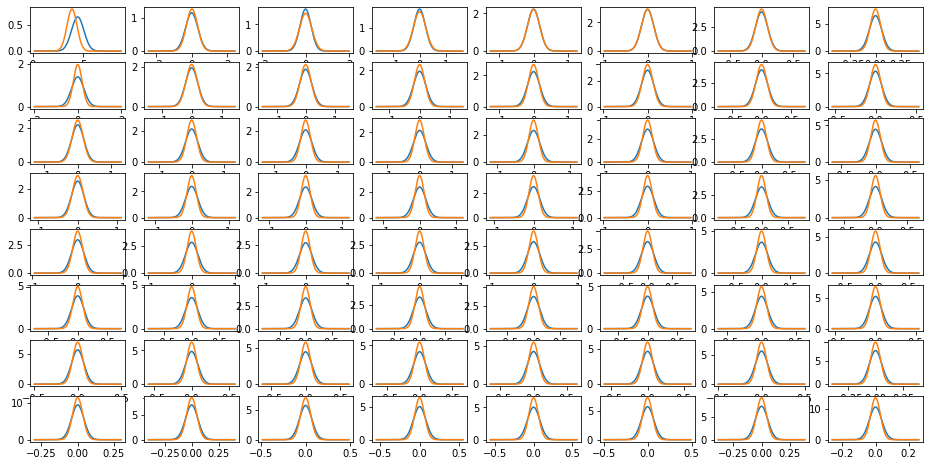

In [12]:
#marginal density plot
from scipy.stats import norm
from scipy.special import kl_div
import matplotlib.pyplot as plt
fig=plt.figure(figsize=(16,8))
KL_distance = []
mean_distance = np.zeros(foreground.shape[1])
for i in range(foreground.shape[1]):
    fig.add_subplot(8,8,i+1)
    x_FG = np.linspace(mean_FG[i] - 7 * se_FG[i] ,mean_FG[i] + 7 * se_FG[i],500)
    x_BG = np.linspace(mean_BG[i] - 7 * se_BG[i], mean_BG[i] + 7 * se_BG[i],500)
    x = np.sort(np.array([x_FG,x_BG]),axis = None)
    y_cheetah = norm.pdf(x,mean_FG[i],se_FG[i])
    y_grass = norm.pdf(x,mean_BG[i],se_BG[i])
    KL = kl_divergence(y_grass,y_cheetah)
    KL_distance.append(KL)
    mean_distance[i] = abs(mean_FG[i] - mean_BG[i])
    plt.plot(x,y_cheetah,x,y_grass)
#     title = "Fit result for the %d feature" %(i+1)
#     plt.title(title)
plt.show()

In [13]:
# define the zigzag transformation
zig_zag = np.array([[0,1,5,6,14,15,27,28],[2,4,7,13,16,26,29,42],[3,8,12,17,25,30,41,43],
                   [9,11,18,24,31,40,44,53],[10,19,23,32,39,45,52,54],[20,22,33,38,46,51,55,60],
                   [21,34,37,47,50,56,59,61],[35,36,48,49,57,58,62,63]])
zz_flat = zig_zag.flatten()
def zig_zag_transform(a):
    result = np.zeros(64)
    for i in range(64):
        result[zz_flat[i]] = a[i]
    return result

0 , 0 : 1.6826038292998107e+19 , 2360763303574.916
0 , 1 : 1.1104765593961769e+19 , 756421101775.8794
0 , 2 : 1394823259586619.5 , 46352.334149054215
0 , 3 : 411386948769196.6 , 2142.8551980467246
0 , 4 : 9499386891337.22 , 0.4552936243513126
0 , 5 : 1381835025.323814 , 2.0480517393757738e-06
0 , 6 : 14072721.242698215 , 1.1570363258563563e-10
0 , 7 : 85351962.42026652 , 2.545185063286008e-09
0 , 8 : 4001793.896164072 , 1.0760839721821434e-11
0 , 9 : 158212353.98000214 , 4.892348540062278e-09
0 , 10 : 4068315491.717132 , 1.713791546246022e-06
0 , 11 : 20657011172.57259 , 4.0112752020851866e-05
0 , 12 : 94976476942.15633 , 0.0005168483014555482
0 , 13 : 4534670827630185.0 , 64957.66484810325
0 , 14 : 3.64866696406032e+19 , 496153901101.7856
0 , 15 : 5.618948515215947e+20 , 71893793649502.53
0 , 16 : 7.640033779243937e+21 , 1.0928128806025604e+16
0 , 17 : 4.701209701435532e+25 , 4.498487071157051e+22
0 , 18 : 6.027173226370276e+26 , 3.535322821360439e+24
0 , 19 : 3.062449173780475e+31 , 

0 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
0 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
0 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
0 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
0 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
0 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
0 , 192 : 4.782675351992408e+35 , 1.6666593365218836e+41
0 , 193 : 4.810410015163857e+33 , 2.2367085243985523e+38
0 , 194 : 2.0257610827854968e+33 , 8.000298191436215e+37
0 , 195 : 1.7881117754565164e+32 , 6.459471260929872e+36
0 , 196 : 1.2440336383276802e+32 , 2.3082632869842362e+36
0 , 197 : 1.3489755195581162e+32 , 2.5952782822524404e+36
0 , 198 : 9.030180833111616e+31 , 1.3820696452652543e+36
0 , 199 : 5.997969787962393e+32 , 5.659934186687867e+36
0 , 200 : 3.801274234056343e+33 , 2.925712275720172e+37
0 , 201 : 1.5213310961302848e+35 , 1.9933375498692653e+39
0 , 202 : 1.4478746448097568e+38 , 4.606292025343128e+43
0 , 203 : 1.152864388929665e+40 , 4.

0 , 369 : 6.643589969725441e+20 , 52608585115116.11
0 , 370 : 3.0352493454671957e+22 , 3.4038550673149664e+16
0 , 371 : 1.411195379646543e+23 , 6.156161264827697e+17
0 , 372 : 4.324540184923453e+25 , 1.1052774444175255e+22
0 , 373 : 4.876817689617001e+26 , 4.1879562095939064e+23
0 , 374 : 2.9926229333344843e+27 , 9.407357903636931e+24
0 , 375 : 1.3332679802251425e+28 , 3.4257498502806682e+25
0 , 376 : 4.592066318040453e+27 , 4.006352592620307e+24
0 , 377 : 1.367883122068339e+29 , 1.5585755214180904e+27
0 , 378 : 2.4526231096064686e+29 , 2.363111391209792e+27
0 , 379 : 1.5456819452307754e+29 , 2.2985615850021317e+27
0 , 380 : 3.273491227436559e+29 , 3.8100165991381078e+28
0 , 381 : 7.739540224384844e+27 , 1.9695890369956492e+26
0 , 382 : 1.944818595386768e+24 , 1.764449634589571e+21
0 , 383 : 1.1706540518474824e+25 , 3.5787441214406237e+21
0 , 384 : 8.334877702227897e+25 , 1.892417313154375e+22
0 , 385 : 4.5909646253517387e+20 , 234656332937142.0
0 , 386 : 4.9161727096593946e+17 , 19746

1 , 94 : 9.692206063079109e+33 , 9.267639151439147e+35
1 , 95 : 2.8932231436894053e+35 , 3.873972134808537e+38
1 , 96 : 1.4922795540150588e+38 , 4.576791737552936e+43
1 , 97 : 7.097201499839151e+36 , 4.124563834144175e+41
1 , 98 : 4.412046510018652e+35 , 6.770396338480505e+39
1 , 99 : 2.2118196839116708e+35 , 1.7411871825217466e+39
1 , 100 : 2.162682232917776e+35 , 1.1243393811100396e+39
1 , 101 : 3.00116259413031e+35 , 1.5458279258198956e+39
1 , 102 : 6.812495844779265e+35 , 5.216991276763753e+39
1 , 103 : 7.74662128292873e+36 , 1.0925324317908874e+41
1 , 104 : 5.92107661845426e+37 , 4.027810782560644e+42
1 , 105 : 9.543344071133389e+38 , 3.92292511284755e+44
1 , 106 : 1.4922795540150588e+38 , 4.576791737552936e+43
1 , 107 : 7.097201499839151e+36 , 4.124563834144175e+41
1 , 108 : 2.798676368071141e+36 , 8.449068449975194e+40
1 , 109 : 2.089316375164979e+36 , 4.582043925239879e+40
1 , 110 : 1.8374506786306037e+33 , 1.6311396108645537e+36
1 , 111 : 4.434867314320393e+32 , 2.108913274202

1 , 281 : 3.385783921120179e+25 , 1.531816523320144e+24
1 , 282 : 7.112769878664757e+26 , 2.3483847237239675e+26
1 , 283 : 3.789304300179757e+27 , 1.7209247710218233e+27
1 , 284 : 1.329392786296439e+28 , 3.999645363200087e+28
1 , 285 : 1.9460163137245347e+29 , 2.3285740226152098e+30
1 , 286 : 3.3151629350180548e+28 , 8.753579598978545e+28
1 , 287 : 7.0794363383357315e+28 , 2.7834635327814217e+28
1 , 288 : 7.88442146992146e+26 , 2.5672872895085445e+24
1 , 289 : 8.803864130457712e+25 , 6.525166828850308e+22
1 , 290 : 3.061435997645445e+25 , 5.226451722624302e+22
1 , 291 : 9.151710878974791e+23 , 1.669100996640473e+20
1 , 292 : 2.592456767494485e+23 , 7.343208230517794e+19
1 , 293 : 1.0451194341770406e+23 , 1.671901457366035e+18
1 , 294 : 1.1994897321821237e+23 , 1.5272270799075039e+18
1 , 295 : 1.9067945014427047e+23 , 6.552606610587817e+18
1 , 296 : 3.3691316080657195e+25 , 7.955243778924767e+22
1 , 297 : 1.942489099818252e+27 , 5.889474154062541e+25
1 , 298 : 1.1734729404839324e+27 , 4

1 , 469 : 19577385359.91137 , 0.009201128088042467
1 , 470 : 6164970506.9683275 , 0.0001924582139795765
1 , 471 : 6421805965.197592 , 0.00030862260432133157
1 , 472 : 2576149170.211436 , 0.0009269580542482027
2 , 0 : 5.471523602735268e+17 , 649452439.0372484
2 , 1 : 1072215100044736.0 , 4757.409921090304
2 , 2 : 772228857967450.1 , 1946.1291214712037
2 , 3 : 296600171798695.06 , 32.746405953937675
2 , 4 : 60689831073.249115 , 7.709978392286944e-06
2 , 5 : 344223.893431372 , 4.047361299022165e-14
2 , 6 : 99861.17553657487 , 9.136220125727474e-16
2 , 7 : 3696.180122670225 , 6.639580152189161e-18
2 , 8 : 69.70134407215468 , 2.3617271959447246e-20
2 , 9 : 36781.172332028575 , 1.2679245732798853e-15
2 , 10 : 28766.366183316466 , 1.0026409692180092e-15
2 , 11 : 21578903.613984413 , 5.6958824011991575e-11
2 , 12 : 240825317.2687224 , 5.842979522163386e-09
2 , 13 : 2857248271424.968 , 0.2888978102187743
2 , 14 : 3719654419907867.0 , 27443.737096029694
2 , 15 : 8.320004783070728e+18 , 266693618

2 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
2 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
2 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
2 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
2 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
2 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
2 , 192 : 1.3697573611827385e+37 , 3.420040810763241e+42
2 , 193 : 2.8635921905851613e+34 , 4.399348175990929e+38
2 , 194 : 2.196539821958539e+31 , 3.5639143380002344e+34
2 , 195 : 3.9670338122433236e+30 , 3.0691193040170863e+33
2 , 196 : 2.120984528696178e+30 , 1.235111929219769e+33
2 , 197 : 2.3910191229691207e+30 , 1.2568397427350943e+33
2 , 198 : 4.4244852912961615e+30 , 2.970178220017092e+33
2 , 199 : 2.0686626667467527e+31 , 1.8102483255035922e+34
2 , 200 : 1.4616088979142373e+32 , 1.3513028992669648e+35
2 , 201 : 1.4155475944435257e+33 , 4.265250041072161e+36
2 , 202 : 2.774064064552453e+36 , 5.873451790131095e+41
2 , 203 : 1.152864388929665e+40 , 4

2 , 370 : 1.3858589097881533e+21 , 1.77949312094522e+16
2 , 371 : 2.849699051688063e+21 , 1.8886089473483704e+16
2 , 372 : 5.917995121353626e+23 , 5.921317235943798e+19
2 , 373 : 3.482082760112248e+26 , 6.381386721175762e+23
2 , 374 : 2.3337874107912535e+27 , 1.3211800523318122e+25
2 , 375 : 1.1201375663286058e+28 , 7.261102707205549e+25
2 , 376 : 3.0427193916448555e+27 , 6.091989140722272e+24
2 , 377 : 2.0754252538757417e+28 , 1.3141546476048598e+26
2 , 378 : 1.4662715857166442e+30 , 4.23001437118636e+28
2 , 379 : 5.336693735192897e+30 , 6.243275203870376e+29
2 , 380 : 1.2661728015502436e+31 , 7.118618746118197e+30
2 , 381 : 3.183044699845737e+31 , 7.663242149468057e+31
2 , 382 : 3.6491327379876464e+27 , 1.843061811408341e+26
2 , 383 : 3.217339384808689e+28 , 1.8734747679192492e+27
2 , 384 : 2.2162212468954438e+28 , 1.3816777351946097e+27
2 , 385 : 9.417113927258627e+22 , 4.4191706131951713e+18
2 , 386 : 1.9414407631882665e+18 , 283864643116.33185
2 , 387 : 2.130311947963755e+16 , 314

3 , 72 : 2.3730177984303486e+23 , 7.109731731180507e+17
3 , 73 : 1.1367211747214053e+20 , 670810310136.1456
3 , 74 : 3.130391492901405e+20 , 5162963764662.061
3 , 75 : 3.846447658886244e+19 , 522738530038.2017
3 , 76 : 1.1793109774628995e+17 , 26977397.37741394
3 , 77 : 6386506701788930.0 , 31390.104919458354
3 , 78 : 8.112236463475874e+18 , 12908804279.709246
3 , 79 : 5.105836261614362e+18 , 5657746842.29709
3 , 80 : 4.3484330533352e+18 , 3045915402.6113925
3 , 81 : 5.9621248213323405e+22 , 3.328676466325268e+17
3 , 82 : 3.2052084235386313e+22 , 9.2315392312005e+16
3 , 83 : 4.803538535091962e+19 , 982959864069.5079
3 , 84 : 3.576545364651817e+20 , 14699373010042.916
3 , 85 : 1.7431500974287553e+19 , 78503588382.16994
3 , 86 : 1.554157828106052e+20 , 1471930080406.482
3 , 87 : 4.340174628928619e+19 , 268524506669.7627
3 , 88 : 3.108565305241181e+23 , 8.870045481692288e+19
3 , 89 : 8.81187298668167e+22 , 1.90038701818272e+18
3 , 90 : 1.3647992039425062e+22 , 6.258164069393203e+16
3 , 91

3 , 255 : 8.22362238834994e+23 , 3.232773606618531e+22
3 , 256 : 1.4546184505065223e+25 , 5.314639076042442e+23
3 , 257 : 1.955187185978362e+26 , 2.307495627805788e+25
3 , 258 : 2.7518528708864404e+27 , 1.1820728720282319e+27
3 , 259 : 4.208256607170911e+29 , 4.3229485184417254e+29
3 , 260 : 5.313742215664943e+31 , 4.1541148056728224e+33
3 , 261 : 1.0909350356401485e+29 , 3.702654430852302e+29
3 , 262 : 1.2610847539394081e+28 , 1.8204819051667743e+28
3 , 263 : 9.632915057501607e+27 , 7.928641547902611e+27
3 , 264 : 1.8633831296006453e+28 , 1.8314400187580122e+28
3 , 265 : 3.955272296967184e+26 , 1.7380471805692272e+25
3 , 266 : 6.578435036034791e+26 , 4.77937242347729e+25
3 , 267 : 2.1617804285227095e+26 , 2.0259776656196535e+24
3 , 268 : 2.0141479156588498e+26 , 1.0460881567473108e+24
3 , 269 : 3.779250290560861e+26 , 4.610014232795103e+23
3 , 270 : 2.4917239807019044e+29 , 1.4326436821147397e+28
3 , 271 : 7.670312677564989e+27 , 4.4657008616118285e+25
3 , 272 : 6.913098609332072e+27 

3 , 406 : 12020427.121809997 , 3.1846905858832096e-08
3 , 407 : 1442058.3919877964 , 2.237154955035288e-09
3 , 408 : 23256879796.14765 , 0.017563548768287866
3 , 409 : 9683238598880310.0 , 83270144.49474937
3 , 410 : 735502459635782.5 , 811852.3187294524
3 , 411 : 112793642300326.61 , 51074.47843238909
3 , 412 : 148779465033.99942 , 4.1133603467082756
3 , 413 : 60972797113.031555 , 1.24627534134096
3 , 414 : 192463489.696448 , 0.00014833038456648766
3 , 415 : 13514654949713.703 , 2218.268664712264
3 , 416 : 49228162376.88577 , 0.24703774381871366
3 , 417 : 653532144.9797759 , 8.19448595798966e-05
3 , 418 : 5066528.786366258 , 4.893157087293095e-09
3 , 419 : 3332.369298048041 , 1.9296184706525692e-13
3 , 420 : 851053.8703953846 , 2.0145378021889176e-10
3 , 421 : 823321052.1547564 , 7.600562944990306e-06
3 , 422 : 5370054.4737215 , 3.6302402009652376e-09
3 , 423 : 282079483.65820485 , 7.161557640157834e-06
3 , 424 : 311426469.29426414 , 0.00010488008823072535
3 , 425 : 241985105366573.97

4 , 111 : 1.152864388929665e+40 , 4.049036845606858e+46
4 , 112 : 1.4922795540150588e+38 , 4.576791737552936e+43
4 , 113 : 7.097201499839151e+36 , 4.124563834144175e+41
4 , 114 : 2.798676368071141e+36 , 8.449068449975194e+40
4 , 115 : 2.140431058238689e+34 , 2.4210797341295427e+37
4 , 116 : 2.054678120658162e+33 , 4.077001988271407e+35
4 , 117 : 2.1664602360276614e+32 , 1.3251790573989995e+34
4 , 118 : 3.1486708553736896e+31 , 4.622349004572306e+32
4 , 119 : 4.028772325034225e+31 , 1.0255949766637014e+32
4 , 120 : 1.080446633202777e+28 , 8.811878085381689e+26
4 , 121 : 5.597578246726474e+24 , 3.6863501632149106e+21
4 , 122 : 3.846780350497753e+23 , 1.3498360291446825e+19
4 , 123 : 2.670797981944861e+23 , 1.48950141194284e+18
4 , 124 : 3.3012083567902077e+22 , 7.0318397568951496e+16
4 , 125 : 6.517219853769982e+21 , 3397854489999414.0
4 , 126 : 2.3712569659776506e+17 , 1996525095.872709
4 , 127 : 1.3172955324303928e+18 , 159127234685.97195
4 , 128 : 5.094321713630065e+17 , 42737331887.2

4 , 295 : 3.486720338062197e+24 , 7.652662362804498e+20
4 , 296 : 1.4593305824612653e+24 , 1.2045058558478618e+20
4 , 297 : 3.067355065621161e+25 , 1.0687792885445184e+22
4 , 298 : 1.191130128531217e+28 , 6.415727603936695e+25
4 , 299 : 1.0635934939537836e+28 , 8.791223511504794e+25
4 , 300 : 8.042472664210704e+28 , 2.052481816489424e+28
4 , 301 : 1.2195550869875507e+29 , 1.7097049272176505e+28
4 , 302 : 3.180954982302968e+30 , 2.1440860397355298e+30
4 , 303 : 4.979402670073292e+28 , 1.6934134816665792e+27
4 , 304 : 7.645429826277128e+27 , 2.6995316165860774e+26
4 , 305 : 2.6963132797992704e+26 , 2.1580279583557357e+23
4 , 306 : 6.485432149248699e+25 , 1.6085565992155004e+22
4 , 307 : 1.6991912508989362e+24 , 3.209435606047212e+19
4 , 308 : 1.6396351439295613e+24 , 8.050434320552929e+19
4 , 309 : 2.564623330377188e+24 , 5.431732277518943e+20
4 , 310 : 3.188944065526347e+23 , 4.620047995971787e+18
4 , 311 : 6.372059116999097e+25 , 1.3675448726107046e+23
4 , 312 : 4.3094615154730296e+23 

5 , 2 : 4.984140288321539e+17 , 649690792.4786687
5 , 3 : 1.1304391658493208e+20 , 1143651414870.0408
5 , 4 : 2.0452114244409114e+17 , 12974673.538224781
5 , 5 : 8188668984110147.0 , 19282.64310554883
5 , 6 : 40591796795665.03 , 3.513737263026546
5 , 7 : 29068021741.96756 , 1.0638618712031895e-05
5 , 8 : 2186346273.399927 , 4.786360731071646e-07
5 , 9 : 16962652227.433273 , 1.342723244803529e-05
5 , 10 : 1229865277.157304 , 1.2849303599193957e-06
5 , 11 : 393620463185.07733 , 0.14004799586529107
5 , 12 : 2950648877378.2607 , 5.142331763280633
5 , 13 : 260263577325070.3 , 9942.764806805488
5 , 14 : 1.0814485486059718e+16 , 1218699.9062493702
5 , 15 : 3.84458998972666e+20 , 30059379484792.316
5 , 16 : 1.8045254801647244e+23 , 4.8351150499808166e+17
5 , 17 : 8.558459112730318e+24 , 1.0334664306595584e+21
5 , 18 : 3.204370352116811e+24 , 4.784997713600188e+20
5 , 19 : 1.12603761771454e+25 , 1.622761683928389e+22
5 , 20 : 2.0602414593628773e+26 , 3.901971761921898e+24
5 , 21 : 2.05726841767

5 , 201 : 1.3264414203213001e+28 , 2.607609020547942e+27
5 , 202 : 8.016035322559145e+35 , 2.838148706918524e+40
5 , 203 : 1.152864388929665e+40 , 4.049036845606858e+46
5 , 204 : 1.152864388929665e+40 , 4.049036845606858e+46
5 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
5 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
5 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
5 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
5 , 209 : 2.860221162337124e+36 , 6.120984581223684e+40
5 , 210 : 1.1277702815829036e+31 , 4.1566248216877115e+31
5 , 211 : 9.11453423065887e+29 , 1.0770352792187379e+30
5 , 212 : 7.802801022704977e+29 , 8.231327467060599e+29
5 , 213 : 5.67513117946319e+26 , 1.345501318893016e+25
5 , 214 : 5.198756980562256e+22 , 7.795423190588768e+18
5 , 215 : 6.544188064730671e+21 , 2.2304614231404323e+17
5 , 216 : 2.1758972397847723e+21 , 4.147631630420909e+16
5 , 217 : 1.5356595984329747e+21 , 1.6013472978879946e+16
5 , 218 : 1.484755156545847e+22 , 6.341412

5 , 391 : 1.168035947831945e+19 , 96711599354.82039
5 , 392 : 2.0849650138681718e+17 , 159094812.68261388
5 , 393 : 7.126824667818387e+17 , 128574149.76649782
5 , 394 : 2.326520841189185e+18 , 1254991381.509626
5 , 395 : 4.808913677433258e+18 , 8088207951.844813
5 , 396 : 1.0975898186758857e+19 , 8148743211.565874
5 , 397 : 1.0665471388434477e+19 , 7178475973.860471
5 , 398 : 1.0371360238505787e+19 , 4777166950.875682
5 , 399 : 1.8680048888777738e+17 , 32543504.48680236
5 , 400 : 5.153321935524942e+16 , 4276738.809316887
5 , 401 : 1511707536980513.2 , 54360.07834475278
5 , 402 : 6306065156816075.0 , 250191.09631520303
5 , 403 : 1.5420758086396662e+16 , 1266871.841790158
5 , 404 : 16617032057510.635 , 1.1604910536650213
5 , 405 : 122237738177.86856 , 0.0006397544395772462
5 , 406 : 4663230805.490757 , 3.902832192059274e-06
5 , 407 : 210917966.03774056 , 4.1253815991873684e-09
5 , 408 : 1993888430.3148825 , 3.287899809584647e-07
5 , 409 : 177079176924.3954 , 0.012722721803558127
5 , 410 

6 , 105 : 5.564882887828026e+37 , 6.669981869986647e+42
6 , 106 : 1.710940941804731e+38 , 4.383145102473716e+43
6 , 107 : 1.152864388929665e+40 , 4.049036845606858e+46
6 , 108 : 1.152864388929665e+40 , 4.049036845606858e+46
6 , 109 : 1.152864388929665e+40 , 4.049036845606858e+46
6 , 110 : 1.152864388929665e+40 , 4.049036845606858e+46
6 , 111 : 1.152864388929665e+40 , 4.049036845606858e+46
6 , 112 : 1.152864388929665e+40 , 4.049036845606858e+46
6 , 113 : 1.152864388929665e+40 , 4.049036845606858e+46
6 , 114 : 1.152864388929665e+40 , 4.049036845606858e+46
6 , 115 : 1.152864388929665e+40 , 4.049036845606858e+46
6 , 116 : 1.152864388929665e+40 , 4.049036845606858e+46
6 , 117 : 1.152864388929665e+40 , 4.049036845606858e+46
6 , 118 : 1.152864388929665e+40 , 4.049036845606858e+46
6 , 119 : 1.152864388929665e+40 , 4.049036845606858e+46
6 , 120 : 1.8015138722860302e+32 , 3.0549669480061233e+34
6 , 121 : 1.5427767438164638e+30 , 3.7231651535344636e+30
6 , 122 : 4.617574970998621e+28 , 9.63171173

6 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
6 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
6 , 288 : 1.0771606998588165e+36 , 4.2894216834488213e+40
6 , 289 : 6.835459515976145e+33 , 2.5355366823209626e+37
6 , 290 : 9.322013868378471e+31 , 2.615906776118458e+34
6 , 291 : 4.466060886305406e+29 , 4.2715371484968833e+30
6 , 292 : 1.912868034921761e+28 , 4.421804719278055e+27
6 , 293 : 1.8588771185376243e+27 , 4.194414785556457e+25
6 , 294 : 1.377420046114477e+26 , 1.7262398426806918e+24
6 , 295 : 9.820186096202257e+25 , 2.6038121195982446e+23
6 , 296 : 1.6499578351826405e+26 , 5.3216544770097016e+23
6 , 297 : 1.8096677681928118e+28 , 1.0689189834094678e+27
6 , 298 : 1.2225808219818828e+29 , 1.908093941712629e+28
6 , 299 : 1.1491537486801408e+28 , 8.381319787349179e+26
6 , 300 : 7.768113397673627e+31 , 3.380199592463649e+33
6 , 301 : 2.2118196839116708e+35 , 1.7411871825217466e+39
6 , 302 : 2.5520820281230596e+33 , 6.80314058219202e+35
6 , 303 : 3.4597746865563905e+32 

6 , 467 : 6.021658821230608e+16 , 5303865718.683994
6 , 468 : 1.6163423492417827e+17 , 9533916847.96432
6 , 469 : 8654244198384814.0 , 13345719.789652158
6 , 470 : 8.567051434540462e+16 , 404959878.6151387
6 , 471 : 2173694588594856.0 , 439384.0344392407
6 , 472 : 558472733135176.0 , 94210.58130344396
7 , 0 : 1.4778351504423594e+17 , 571848899.8635659
7 , 1 : 1300022414987360.0 , 17767.899097984624
7 , 2 : 1240713438507436.2 , 7038.330592221086
7 , 3 : 1763491920284462.0 , 4192.095699547005
7 , 4 : 12631351175057.887 , 1.969643238206093
7 , 5 : 502462039822102.56 , 257.76862813134886
7 , 6 : 178727740684881.88 , 50.071201188345725
7 , 7 : 6245247289032.709 , 3.06087154503904
7 , 8 : 6571001744369.118 , 11.65308228383585
7 , 9 : 655528688799.9987 , 0.010798635540939983
7 , 10 : 39881520.75618326 , 5.8859578988879164e-09
7 , 11 : 279059905364.0046 , 0.010489142735760936
7 , 12 : 27525097045.087784 , 0.0028941793980448638
7 , 13 : 859740489925096.1 , 43547.68011809278
7 , 14 : 9.382576813

7 , 184 : 1.710940941804731e+38 , 4.383145102473716e+43
7 , 185 : 1.152864388929665e+40 , 4.049036845606858e+46
7 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
7 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
7 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
7 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
7 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
7 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
7 , 192 : 8.762497243063092e+36 , 4.473138576281603e+41
7 , 193 : 6.894048367780734e+32 , 9.853250851179395e+34
7 , 194 : 1.0144417810337071e+29 , 2.9617327598777833e+29
7 , 195 : 7.299898347690205e+27 , 2.719369829849223e+27
7 , 196 : 5.891189264996767e+26 , 4.37563790079803e+25
7 , 197 : 1.7662533482835052e+26 , 3.102532758030741e+24
7 , 198 : 2.13089400079695e+25 , 5.347037169104305e+22
7 , 199 : 5.571023006147064e+24 , 6.357961059761689e+21
7 , 200 : 4.2660918576698847e+24 , 2.0782121988678418e+21
7 , 201 : 5.226257513438103e+24 , 5.646420818

7 , 357 : 2.044701771475929e+24 , 1.4805343565888107e+20
7 , 358 : 7.822217487082038e+24 , 1.2069051698545e+21
7 , 359 : 8.931826533408221e+23 , 4.147533359320729e+19
7 , 360 : 2.2706642295320006e+23 , 6.823559192872796e+18
7 , 361 : 1.6096201834080223e+22 , 1.377281186390134e+17
7 , 362 : 1.7900561441024243e+22 , 7.82871341464586e+16
7 , 363 : 1.967807652584458e+22 , 1.7901793834128733e+17
7 , 364 : 5.321375869814478e+22 , 6.757984676245338e+17
7 , 365 : 1.0843144829794478e+21 , 129114889334001.58
7 , 366 : 6.771988305677361e+20 , 44796556013741.305
7 , 367 : 9.907993984424541e+20 , 144546959375358.53
7 , 368 : 1.6020133836133811e+22 , 1.4276855062428966e+16
7 , 369 : 5.544272919980413e+22 , 1.3179689194833262e+17
7 , 370 : 3.120486087597611e+21 , 6946204812028625.0
7 , 371 : 9.784791832074752e+20 , 4320678279430072.0
7 , 372 : 1.4357270324042667e+21 , 5.509787246936616e+16
7 , 373 : 6.000925709372712e+19 , 1099436764232005.0
7 , 374 : 1.6427552261199698e+19 , 296295544074767.4
7 , 37

8 , 66 : 2.1970759601409075e+25 , 6.025402383525777e+21
8 , 67 : 9.375499497173353e+25 , 3.47293488721447e+22
8 , 68 : 3.027860256369651e+28 , 4.150691223881808e+26
8 , 69 : 5.560158864177865e+34 , 5.6237562766773105e+37
8 , 70 : 9.158894107236175e+36 , 3.5093793753859406e+41
8 , 71 : 1.710940941804731e+38 , 4.383145102473716e+43
8 , 72 : 1.4922795540150588e+38 , 4.576791737552936e+43
8 , 73 : 7.097201499839151e+36 , 4.124563834144175e+41
8 , 74 : 2.798676368071141e+36 , 8.449068449975194e+40
8 , 75 : 4.2940899064137606e+33 , 2.4978825217863292e+36
8 , 76 : 2.4743221570882602e+31 , 4.414413634394675e+32
8 , 77 : 1.2874877696289115e+30 , 2.0093077699890355e+30
8 , 78 : 2.0553671096989252e+29 , 1.159764932957448e+29
8 , 79 : 5.596688401512279e+28 , 1.3904326023769662e+28
8 , 80 : 2.998558813714589e+28 , 6.332504904653074e+27
8 , 81 : 1.7396490698456222e+30 , 1.5483608889151956e+31
8 , 82 : 5.818233166856251e+27 , 3.232865485269546e+26
8 , 83 : 1.9415632065840031e+28 , 2.150004234190212e+

8 , 257 : 5.798851239355683e+23 , 5.873505142800486e+19
8 , 258 : 1.0649407240842165e+25 , 7.816611101401365e+21
8 , 259 : 9.897647451799692e+28 , 1.316520054873135e+28
8 , 260 : 1.3957961173901902e+31 , 6.049200043707315e+31
8 , 261 : 1.2068981643641546e+32 , 2.4621743678218917e+33
8 , 262 : 6.96085194526685e+31 , 9.622836174867459e+32
8 , 263 : 2.626920365855892e+32 , 9.691747011104622e+33
8 , 264 : 1.609809852108816e+33 , 2.4481499301934757e+35
8 , 265 : 4.268744256074743e+32 , 3.372025673655809e+34
8 , 266 : 4.268744256074743e+32 , 3.372025673655809e+34
8 , 267 : 2.1517906637817322e+32 , 3.1194347451649614e+34
8 , 268 : 7.564500800028765e+32 , 2.1049786063310092e+35
8 , 269 : 5.0324453912168933e+33 , 3.8046401916125675e+36
8 , 270 : 4.480629810644425e+34 , 1.1473618661393355e+38
8 , 271 : 2.785345717708086e+33 , 5.784515695746502e+35
8 , 272 : 1.0536824201690846e+32 , 5.912389446395e+33
8 , 273 : 5.52065690109119e+28 , 1.1238211018607764e+28
8 , 274 : 3.613145044179817e+26 , 7.2818

8 , 444 : 5.261892137189856e+18 , 1111137294.1104147
8 , 445 : 2.567268473926316e+19 , 12156157184.357794
8 , 446 : 9.652246121693594e+18 , 5425052977.469147
8 , 447 : 1.639713395744611e+20 , 3533786848486.818
8 , 448 : 5.048777929465635e+22 , 1.4684395881443754e+17
8 , 449 : 2.1259120780962237e+21 , 4726251559691996.0
8 , 450 : 2.101820790709729e+23 , 5.786646375418081e+18
8 , 451 : 5.265637516975997e+24 , 1.4417393253436466e+21
8 , 452 : 5.070237718614859e+20 , 935763267177485.2
8 , 453 : 1.7526192247433583e+20 , 356143931366881.0
8 , 454 : 3.0992479393367585e+19 , 45634158868483.734
8 , 455 : 5.32274814075294e+24 , 2.5015370032225704e+22
8 , 456 : 1.8780610930224624e+25 , 1.498315213788169e+23
8 , 457 : 3.6938725734150704e+24 , 2.637872157477799e+22
8 , 458 : 7.428440902018523e+21 , 1.2154640035131192e+17
8 , 459 : 1.1785272133452481e+21 , 2.143083614739707e+16
8 , 460 : 3.4755105587297164e+20 , 943723285482568.8
8 , 461 : 1.0543014103754608e+22 , 8.923984294471074e+16
8 , 462 : 3.9

9 , 151 : 2.1711972570725786e+29 , 3.731002615648666e+28
9 , 152 : 1.0565887574672454e+30 , 9.410250940483127e+29
9 , 153 : 1.91890588702398e+31 , 1.5429545865371047e+32
9 , 154 : 2.1517906637817322e+32 , 3.1194347451649614e+34
9 , 155 : 4.598593514395571e+29 , 7.777752762728796e+29
9 , 156 : 4.2835548048739676e+27 , 4.006282398958791e+26
9 , 157 : 1.0336950168238231e+27 , 2.963462462767581e+25
9 , 158 : 8.529316811066847e+26 , 2.8412124501787648e+25
9 , 159 : 1.2256964427017236e+27 , 4.301815572283782e+25
9 , 160 : 6.15745222032666e+27 , 5.640714868194371e+26
9 , 161 : 2.8752436431208522e+28 , 1.1045160165641783e+28
9 , 162 : 3.496715259296232e+27 , 6.365435399728538e+25
9 , 163 : 7.560673649434482e+23 , 2.1304235205398774e+19
9 , 164 : 5.59969866819025e+22 , 1.628515735785903e+17
9 , 165 : 4.925433127361804e+24 , 8.188784203229263e+19
9 , 166 : 2.4564046894264608e+22 , 2.265262245487386e+16
9 , 167 : 6.84523908862221e+20 , 820638965703826.1
9 , 168 : 6.471954192168284e+17 , 134157493

9 , 339 : 5.901258976680392e+28 , 7.545138979628451e+27
9 , 340 : 5.261794202882485e+29 , 1.3412120957239932e+29
9 , 341 : 3.297092165589412e+30 , 4.100964238714713e+30
9 , 342 : 8.403263467067508e+30 , 8.101269144286498e+30
9 , 343 : 1.257481411251728e+31 , 6.786982277696765e+30
9 , 344 : 3.0791442180998125e+31 , 3.284529971362939e+31
9 , 345 : 4.2376047717765405e+31 , 1.050900738534322e+32
9 , 346 : 7.131336419896807e+32 , 2.1632131252962187e+34
9 , 347 : 3.0938693603071564e+33 , 2.439794370308082e+35
9 , 348 : 1.4784399232308365e+31 , 1.1293723710720716e+32
9 , 349 : 4.3704359511281155e+32 , 2.95711267482664e+34
9 , 350 : 9.263329771682821e+30 , 5.467505013401632e+31
9 , 351 : 8.542148381251483e+30 , 7.977776357365427e+31
9 , 352 : 7.283076048837242e+31 , 2.1019119008018837e+33
9 , 353 : 1.4088189733313921e+30 , 2.834465047997084e+30
9 , 354 : 7.370557741188677e+29 , 6.567247536552634e+29
9 , 355 : 5.261937150471284e+28 , 1.5170594681530076e+28
9 , 356 : 5.162576716146222e+27 , 6.59

10 , 57 : 9.945820946694339e+33 , 3.7859305021544535e+36
10 , 58 : 8.315055147916227e+30 , 2.5987352823239672e+31
10 , 59 : 2.9233424233207643e+29 , 9.949006774097063e+28
10 , 60 : 3.5883053817487953e+27 , 2.0400346623477207e+26
10 , 61 : 8.750515755769486e+23 , 7.853055490115314e+19
10 , 62 : 4.331934293572933e+22 , 6.966355824293688e+17
10 , 63 : 8.745245545735441e+22 , 1.4752193971956803e+18
10 , 64 : 1.5405066654449656e+24 , 8.526445656201983e+19
10 , 65 : 3.0786259408666045e+25 , 5.5206688968135225e+22
10 , 66 : 1.9304644548861902e+27 , 3.542552846732633e+25
10 , 67 : 4.923530990411384e+28 , 7.15436361072144e+27
10 , 68 : 2.1913595430451932e+30 , 3.731669751767889e+30
10 , 69 : 7.991020133731625e+32 , 6.344542181763003e+34
10 , 70 : 4.6244937938298214e+35 , 1.4703738591720668e+39
10 , 71 : 1.5589712103771655e+37 , 6.052764169319329e+41
10 , 72 : 1.152864388929665e+40 , 4.049036845606858e+46
10 , 73 : 1.152864388929665e+40 , 4.049036845606858e+46
10 , 74 : 1.152864388929665e+40 , 4

10 , 241 : 5.580765329346743e+16 , 897789383.4422097
10 , 242 : 1.9697902143160802e+20 , 588466157529589.2
10 , 243 : 6.045005101068073e+20 , 522834175591597.3
10 , 244 : 3.380354719770353e+24 , 4.349660268603766e+20
10 , 245 : 2.8145237175987864e+22 , 4.2665650876600104e+16
10 , 246 : 3.573009882877072e+24 , 3.03485614917264e+20
10 , 247 : 3.17153855381169e+23 , 6.329613884178734e+18
10 , 248 : 8.072938222006142e+24 , 2.2599661064044596e+21
10 , 249 : 8.663597526882222e+23 , 6.693085076982902e+19
10 , 250 : 1.4167745863279227e+23 , 6.12572554533997e+18
10 , 251 : 2.1579994866014646e+23 , 5.173100021452632e+18
10 , 252 : 2.8246350605129047e+21 , 6010793699460250.0
10 , 253 : 1.6767262355475344e+22 , 1.3467142956066709e+17
10 , 254 : 2.721040273220875e+22 , 1.1908221943626796e+18
10 , 255 : 8.549413839534332e+22 , 6.352338699890348e+18
10 , 256 : 2.3986153083236303e+25 , 2.5436819418957008e+23
10 , 257 : 2.6830927587226722e+25 , 8.746577015084186e+23
10 , 258 : 8.890155170794558e+26 , 1

10 , 434 : 5909969116458558.0 , 792107.0211903362
10 , 435 : 4288124524227570.0 , 379671.6503359605
10 , 436 : 1.023448146519198e+16 , 258911.02134216338
10 , 437 : 6.21674303371067e+17 , 238634171.46927586
10 , 438 : 4.0885958775618826e+18 , 1913425932.0861328
10 , 439 : 4.446369020208384e+20 , 3134125181773.4507
10 , 440 : 1.3650429580701442e+19 , 24445268342.017998
10 , 441 : 7.304082018008482e+16 , 5043504.338254718
10 , 442 : 117350353601727.11 , 257.5352634577603
10 , 443 : 4425925043612367.5 , 195768.47856027342
10 , 444 : 1.6063658871150452e+16 , 1785249.6157524972
10 , 445 : 1.0747846809266412e+18 , 1358591906.2963336
10 , 446 : 8.771448567077686e+18 , 53487787847.426346
10 , 447 : 1.3067726536895139e+22 , 2.3000693671445364e+16
10 , 448 : 2.2931033798953746e+24 , 4.879917613539796e+19
10 , 449 : 4.2773048117318374e+23 , 2.1326075898066067e+19
10 , 450 : 6.906666938733673e+23 , 1.2423249167545408e+20
10 , 451 : 4.475313302017478e+25 , 4.321716212274686e+23
10 , 452 : 3.0407990

11 , 146 : 1.5834868242580914e+29 , 1.1342181719402107e+28
11 , 147 : 3.4071052390199623e+28 , 8.70083730164476e+27
11 , 148 : 7.515683140018694e+27 , 5.374262929310234e+27
11 , 149 : 1.0824823022663577e+28 , 1.0856220340073965e+28
11 , 150 : 2.071981792562055e+28 , 3.332754456154892e+28
11 , 151 : 7.242216680588217e+28 , 2.1850901970336925e+29
11 , 152 : 4.592992814684508e+28 , 1.571364486671921e+29
11 , 153 : 9.526109199449192e+29 , 1.1105591505333904e+31
11 , 154 : 1.9375156150072176e+30 , 9.203078923754066e+30
11 , 155 : 1.8782078970323427e+28 , 3.2052092698502894e+27
11 , 156 : 5.279882790058955e+25 , 1.2576441524143183e+23
11 , 157 : 1.553878982292037e+25 , 8.031915998100011e+21
11 , 158 : 7.298641329194654e+22 , 1.5086302180986624e+18
11 , 159 : 1.4415545733091352e+23 , 2.1666704974262423e+18
11 , 160 : 3.087365144160471e+23 , 5.312075169662552e+18
11 , 161 : 4.065003028937744e+23 , 7.508195553324461e+18
11 , 162 : 6.868995818896407e+23 , 3.91990165985701e+18
11 , 163 : 8.390470

11 , 342 : 2.7267152605917474e+28 , 3.2073661163987256e+27
11 , 343 : 2.144203930553336e+28 , 1.8872519278507808e+27
11 , 344 : 4.193797346041507e+28 , 1.0682276832598182e+28
11 , 345 : 1.4409899371779468e+29 , 4.1170667403526535e+28
11 , 346 : 1.6146234471587497e+30 , 8.872601048576573e+29
11 , 347 : 5.246224932474364e+30 , 1.911692640435004e+30
11 , 348 : 4.8575635888519266e+30 , 5.249128507585466e+30
11 , 349 : 3.103159580085871e+31 , 1.2844339858078395e+32
11 , 350 : 9.652491016099892e+26 , 2.0512695069122285e+24
11 , 351 : 1.642816374231047e+26 , 2.236734640242746e+23
11 , 352 : 3.118688309594982e+25 , 1.5755721167494162e+23
11 , 353 : 5.840822204648973e+23 , 5.54788341015422e+20
11 , 354 : 7.255488879454313e+21 , 1.8408955471220778e+17
11 , 355 : 3.823571419285782e+22 , 2.098397665700955e+18
11 , 356 : 9.53270112713614e+23 , 9.168462920063138e+20
11 , 357 : 9.961697765845295e+24 , 2.625218617310963e+22
11 , 358 : 2.1337420554034596e+26 , 7.794630464628705e+24
11 , 359 : 7.3084658

12 , 50 : 4.898992633456082e+31 , 3.008261411290387e+32
12 , 51 : 2.093627087670095e+29 , 2.4067423477638167e+29
12 , 52 : 1.4759439301071684e+29 , 3.048491353052455e+29
12 , 53 : 1.5242005412809344e+29 , 3.236152924909438e+29
12 , 54 : 2.3184599547121623e+29 , 5.175713390265646e+29
12 , 55 : 1.979530518618275e+29 , 3.893983648654656e+29
12 , 56 : 1.9619222800558277e+29 , 4.297336410631715e+29
12 , 57 : 1.3131578532232392e+29 , 2.9944355786789213e+29
12 , 58 : 2.9680994005255295e+27 , 8.398158687216617e+26
12 , 59 : 4.44320765422729e+27 , 1.789661647575447e+27
12 , 60 : 1.4522194905492682e+27 , 8.439805818391935e+26
12 , 61 : 1.9087012647985317e+25 , 1.6378685679581052e+23
12 , 62 : 7.693427396924576e+24 , 4.743391982727027e+22
12 , 63 : 1.2982359817919419e+25 , 9.97869578106297e+22
12 , 64 : 2.5792031402238923e+25 , 1.761255564453155e+23
12 , 65 : 1.0911835316610664e+26 , 1.924714501383791e+24
12 , 66 : 2.8092631408918806e+25 , 9.9584864408016e+22
12 , 67 : 2.0002491401246627e+27 , 1.

12 , 246 : 5.976399528062385e+22 , 5.172133364289575e+18
12 , 247 : 1.641800605388171e+25 , 3.7210622761193695e+22
12 , 248 : 9.571383192421448e+25 , 2.3849455527148514e+22
12 , 249 : 1.346958386933029e+25 , 2.937999247522167e+20
12 , 250 : 4.211515528504418e+23 , 9.456173100568048e+16
12 , 251 : 8.70344540004568e+23 , 1.2710564649001709e+17
12 , 252 : 4.4011380014715466e+21 , 50875174575605.92
12 , 253 : 2.2718727003658093e+22 , 1226292460799640.5
12 , 254 : 3.3657706896665225e+21 , 394786027427286.6
12 , 255 : 5.64081864687248e+20 , 36720662443533.69
12 , 256 : 1.2127132885907027e+21 , 932226587360564.5
12 , 257 : 4.758999980959811e+18 , 245642109099.36682
12 , 258 : 2.581324840923075e+18 , 92801810979.47775
12 , 259 : 2.196795566658014e+18 , 271733315429.68472
12 , 260 : 4.871771893821149e+17 , 17997320451.80264
12 , 261 : 3.4942834199563464e+18 , 488948194521.80255
12 , 262 : 3.6260773080902656e+18 , 561284044819.4036
12 , 263 : 1.4640798946407795e+18 , 373823127775.1425
12 , 264 :

12 , 430 : 2.502079511018378e+18 , 65772478917.97753
12 , 431 : 1.4719961241075984e+17 , 101531183.07243451
12 , 432 : 2.812103252888265e+18 , 13939089518.4184
12 , 433 : 1.5419281295438135e+19 , 196374219605.77655
12 , 434 : 4.1451916306545567e+18 , 8144251410.07392
12 , 435 : 6.519126365888665e+18 , 20319137210.70807
12 , 436 : 1.4195007347162895e+18 , 2470283489.036055
12 , 437 : 1399339014750503.8 , 63736.97558847001
12 , 438 : 3076497949075239.0 , 24099.639462139967
12 , 439 : 1.417136561934554e+16 , 547093.5862810788
12 , 440 : 1126069678403522.8 , 7056.3338110246805
12 , 441 : 7.947440596924517e+16 , 2465502.761144351
12 , 442 : 2.6904247914045028e+16 , 244579.6062892594
12 , 443 : 2.1995475952210522e+19 , 34625155636.865776
12 , 444 : 8.458709317464068e+20 , 29436368609193.746
12 , 445 : 3.3788617890291954e+22 , 1.321862053491358e+16
12 , 446 : 4.469389185181638e+22 , 1.0549677887438798e+17
12 , 447 : 6.798650834831323e+24 , 2.631852746847902e+21
12 , 448 : 1.1071623323723954e+

13 , 157 : 7.993324439804522e+26 , 2.367394047492616e+23
13 , 158 : 1.8294029704680947e+22 , 4.0101777973096584e+16
13 , 159 : 1.8183840303164805e+23 , 3.1595863576039686e+17
13 , 160 : 1.226056188601478e+24 , 5.031917190834334e+18
13 , 161 : 6.228142298249239e+23 , 3.187101257928281e+18
13 , 162 : 2.0485865584153795e+25 , 3.761224005080657e+21
13 , 163 : 2.2507329840289573e+26 , 7.66422837070395e+22
13 , 164 : 1.082392421182492e+25 , 1.1081126034808267e+21
13 , 165 : 1.0859593024442096e+26 , 2.8376932601683843e+22
13 , 166 : 1.7009949635923296e+26 , 1.949387650461631e+22
13 , 167 : 1.1765228268222802e+26 , 6.631385760110255e+22
13 , 168 : 1.922337024589254e+22 , 3.518990819322136e+16
13 , 169 : 1.0118666664836841e+18 , 2870577805.7892175
13 , 170 : 2.067076829697403e+16 , 12142341.5189866
13 , 171 : 3040455699541870.5 , 369397.7003198872
13 , 172 : 3017245271935.6953 , 1.684527740950591
13 , 173 : 638777972572.6719 , 0.46647099283083804
13 , 174 : 43981701469616.42 , 161.8869132519822

13 , 350 : 2.0406893920374067e+25 , 1.0537661292666335e+23
13 , 351 : 1.3458882276986427e+27 , 1.1282112393062713e+26
13 , 352 : 6.890515524565628e+27 , 4.6954946845206144e+27
13 , 353 : 3.708412452643125e+28 , 7.3893093675188405e+28
13 , 354 : 1.0022452727585556e+27 , 9.353655349354716e+25
13 , 355 : 5.3519096589599135e+26 , 4.711008567693807e+25
13 , 356 : 8.273354936022599e+26 , 2.258762391741957e+26
13 , 357 : 1.0756055023927222e+27 , 4.650559728470593e+26
13 , 358 : 9.708524544722094e+26 , 5.5022985965255956e+26
13 , 359 : 1.2442689630199017e+28 , 8.475212615195145e+28
13 , 360 : 8.425510145288912e+27 , 4.847466848724066e+28
13 , 361 : 6.066670186275666e+27 , 1.4086594168679775e+28
13 , 362 : 5.45501220154906e+27 , 7.001605124103857e+27
13 , 363 : 2.5828261860112184e+29 , 1.9453942811281172e+30
13 , 364 : 2.0642240053437046e+29 , 6.59574123112666e+29
13 , 365 : 9.50994177262347e+28 , 1.8393977482197196e+29
13 , 366 : 5.165716759441728e+28 , 5.222643481245883e+28
13 , 367 : 2.22235

14 , 61 : 2.7178687212867374e+18 , 941524977728.8414
14 , 62 : 3.2642230065762136e+19 , 23677782760525.137
14 , 63 : 2.406516712803724e+20 , 445058746029604.7
14 , 64 : 6.532921961428158e+19 , 13986125024131.332
14 , 65 : 2.5836451859998848e+17 , 571876574.0649542
14 , 66 : 5.353289826098577e+17 , 439702137.7642534
14 , 67 : 3.4966387729093866e+20 , 32879266521841.48
14 , 68 : 4.6307402551317234e+21 , 2038309345822613.8
14 , 69 : 2.399738089842537e+22 , 5.622340878414298e+16
14 , 70 : 1.505565943149968e+26 , 2.0380300680027933e+24
14 , 71 : 6.767692908439498e+26 , 1.9566044216919226e+25
14 , 72 : 9.465411701846948e+28 , 3.499131281727204e+29
14 , 73 : 1.096701080403169e+29 , 8.188899315498219e+29
14 , 74 : 2.154165042129218e+28 , 5.397229865342958e+28
14 , 75 : 2.6553759871599636e+28 , 4.878372816586675e+28
14 , 76 : 3.5225042871493988e+28 , 7.1660192298929255e+28
14 , 77 : 7.854147518340815e+28 , 1.5193678171566063e+29
14 , 78 : 1.096199249423718e+29 , 2.5245259812510216e+29
14 , 79 :

14 , 216 : 2.757624121363791e+19 , 152118418616.57596
14 , 217 : 1.1742517940427442e+19 , 30534523808.76937
14 , 218 : 1.2221752544983774e+20 , 1671092101103.8733
14 , 219 : 4.1315042605019146e+22 , 5.542254970501314e+16
14 , 220 : 3.8046550201809075e+23 , 2.49817121494332e+18
14 , 221 : 3.4656605458050593e+22 , 4.692274718236302e+16
14 , 222 : 1.242607910719455e+21 , 445786071211041.1
14 , 223 : 2.773899580548414e+23 , 1.7034816575777376e+19
14 , 224 : 6.734623586035546e+22 , 9.126460834108655e+17
14 , 225 : 1.77793397863672e+22 , 9.329893311594922e+16
14 , 226 : 4.1060585780039326e+20 , 288029177613932.5
14 , 227 : 3.188562858089464e+17 , 5703765798.728823
14 , 228 : 4.3549058672784504e+16 , 101269239.2767251
14 , 229 : 8.701743083363873e+17 , 5322232084.836682
14 , 230 : 1.7798595646063493e+18 , 6920979212.063644
14 , 231 : 5.373093852536347e+17 , 1008314022.2627449
14 , 232 : 2.0592336791906038e+17 , 256877841.10274768
14 , 233 : 4.035125570661089e+16 , 18828811.562378433
14 , 234 

14 , 399 : 3.1752028148885387e+24 , 6.791444194534308e+21
14 , 400 : 3.1752028148885387e+24 , 6.791444194534308e+21
14 , 401 : 3.702369171860774e+23 , 1.0694833929888956e+20
14 , 402 : 2.5616189035697716e+22 , 8.519461735949295e+17
14 , 403 : 1.2794983820275107e+22 , 9.019490041896611e+16
14 , 404 : 2.270693096656795e+21 , 969843007447213.8
14 , 405 : 8.777067223045959e+19 , 2329072179344.164
14 , 406 : 2.9964489649936253e+19 , 60476482231.55596
14 , 407 : 2.1732384010979744e+16 , 179148.86903696053
14 , 408 : 4990901105614182.0 , 25156.18282695653
14 , 409 : 4.295363877835078e+17 , 275483780.28890145
14 , 410 : 7.537726690245719e+17 , 85372612.09773383
14 , 411 : 3.105143424548853e+19 , 22975958966.58831
14 , 412 : 6.866613234843703e+21 , 2236763585438702.5
14 , 413 : 2.3865851411445334e+19 , 219074216548.65262
14 , 414 : 2.1596796765918006e+18 , 3206930746.3083997
14 , 415 : 5311862390490706.0 , 2717.343958899979
14 , 416 : 135938186419057.17 , 9.984623430067494
14 , 417 : 1617483649

15 , 78 : 2.9449041828771975e+25 , 4.31707216106389e+23
15 , 79 : 6.746833086599512e+21 , 1.2294179799079416e+17
15 , 80 : 3.5206839439409565e+20 , 144914705771671.84
15 , 81 : 1.358922426569168e+20 , 5938189931621.758
15 , 82 : 7.393677656537555e+16 , 10993864.092774311
15 , 83 : 1.3354126747694674e+17 , 88610237.35944526
15 , 84 : 1.578654935484048e+18 , 2163859840.2818656
15 , 85 : 9.15990225248693e+17 , 194238230.4455419
15 , 86 : 3.6920301029045766e+17 , 51833102.30602051
15 , 87 : 7.605863013663423e+19 , 573220612204.7136
15 , 88 : 4.274170241553556e+20 , 24250979331519.203
15 , 89 : 2.2169762229886804e+18 , 1338347130.1430433
15 , 90 : 1.1739005293321722e+21 , 37936564529495.51
15 , 91 : 1.8818736788115485e+20 , 496352027372.2868
15 , 92 : 3.7493423803698447e+18 , 341380315.9174153
15 , 93 : 1.340582418649392e+17 , 608544.5908978109
15 , 94 : 2.9194523844871784e+16 , 20278.460954773676
15 , 95 : 14646603421857.04 , 0.00296016950713009
15 , 96 : 387143133901.7197 , 1.610645974724

15 , 268 : 176990249296402.75 , 1136.4020915104204
15 , 269 : 549386572185168.06 , 1787.009422317121
15 , 270 : 1.0473397992556094e+16 , 551694.0086476157
15 , 271 : 1.2133309111631819e+19 , 246758029826.5414
15 , 272 : 9.12300296133018e+19 , 9159068507643.123
15 , 273 : 2.2629720892216185e+19 , 3911687404070.9297
15 , 274 : 1.2686429286035292e+18 , 532308510749.13947
15 , 275 : 2.2934774387399685e+18 , 11935780114734.709
15 , 276 : 1.4973816047328154e+17 , 1771163625713.8977
15 , 277 : 1.106581670351358e+17 , 3732906743874.415
15 , 278 : 8047679298200170.0 , 30090986754.58279
15 , 279 : 2.1186937063270006e+18 , 300426657033749.9
15 , 280 : 3.5522772124864773e+18 , 244119390595945.1
15 , 281 : 1.604712495594565e+19 , 803990929914407.1
15 , 282 : 1.2984782097074984e+20 , 6280605186789389.0
15 , 283 : 1.1938058709492291e+21 , 6.813717150168243e+16
15 , 284 : 3.189646113099249e+21 , 4.558164611117787e+16
15 , 285 : 3.9704460019824565e+20 , 647123142575807.5
15 , 286 : 4.123689336208188e+2

15 , 415 : 1.8609515072516948e+18 , 386853110.3633668
15 , 416 : 4.121679222981326e+18 , 2806350000.612728
15 , 417 : 6.654321682525764e+16 , 1127927.6268156718
15 , 418 : 84240741724438.12 , 0.41251306596868476
15 , 419 : 535625035151284.6 , 23.837355131032542
15 , 420 : 661930898034914.1 , 199.61249689174568
15 , 421 : 13550872751876.734 , 0.0259764792657463
15 , 422 : 136146438086144.72 , 0.9123055965225898
15 , 423 : 1.1760897320211308e+16 , 5383.667350627488
15 , 424 : 9234774646095620.0 , 2576.52680878466
15 , 425 : 3573335311839502.5 , 897.777960972906
15 , 426 : 2.7648756711797018e+17 , 16864587.147922408
15 , 427 : 8.453177121742314e+16 , 10551437.499344341
15 , 428 : 1.2575272092684181e+17 , 43484193.75534761
15 , 429 : 1.52580277663664e+19 , 464312516226.8441
15 , 430 : 6.811102826084333e+20 , 494334127927809.5
15 , 431 : 5.691370953262531e+18 , 295216548517.1029
15 , 432 : 5.472401867487492e+18 , 109641476384.13052
15 , 433 : 3.612324431397028e+19 , 829599164058.264
15 , 43

16 , 131 : 434159693.35575336 , 1.3390175794022108e-05
16 , 132 : 6697500644285.423 , 833.2557869355152
16 , 133 : 19841541836770.023 , 8676.339960719391
16 , 134 : 5.085945957513095e+17 , 176651026089.06055
16 , 135 : 2.755711101556869e+21 , 5.7476373083046984e+16
16 , 136 : 2.811680312943281e+21 , 1.3999997992022414e+16
16 , 137 : 6.883893659383161e+22 , 1.4833291566858435e+18
16 , 138 : 1.397651831112093e+24 , 8.025751705632273e+19
16 , 139 : 3.0212573901748244e+25 , 5.640112180253182e+21
16 , 140 : 1.7087949380051567e+26 , 7.25665769439269e+22
16 , 141 : 1.2751913029852618e+27 , 8.955447697064044e+23
16 , 142 : 1.0807014188156927e+29 , 1.4054212049664603e+27
16 , 143 : 1.0694917187690237e+31 , 1.8077925551910165e+30
16 , 144 : 6.685526176028185e+32 , 2.799694648459272e+33
16 , 145 : 4.1257172988781674e+30 , 1.1540237804207059e+30
16 , 146 : 5.949235337657868e+29 , 1.1917351407953016e+29
16 , 147 : 2.4973176787368153e+29 , 3.110006465497425e+28
16 , 148 : 9.087971567743376e+28 , 5.3

16 , 326 : 2.8647053341866477e+24 , 1.170008886280707e+21
16 , 327 : 3.356342923660029e+24 , 4.6423628942549723e+21
16 , 328 : 2.4011717106093932e+25 , 5.96164243236643e+22
16 , 329 : 1.8313918483140383e+26 , 4.797716530259612e+24
16 , 330 : 1.024929715857272e+26 , 3.124964517039958e+24
16 , 331 : 2.8103913272516903e+26 , 1.0776748227411272e+25
16 , 332 : 6.771125421078833e+28 , 6.59943412419344e+28
16 , 333 : 6.8673146971697395e+28 , 7.407870446788743e+28
16 , 334 : 6.289254310565099e+28 , 9.482631636060926e+28
16 , 335 : 1.6163296690588938e+29 , 3.635586649504234e+29
16 , 336 : 2.0195338663997253e+29 , 7.035811973304011e+29
16 , 337 : 2.6301905011749405e+29 , 2.0615084660083265e+30
16 , 338 : 1.2244001345015861e+29 , 1.7049009959510785e+30
16 , 339 : 8.322942595557994e+27 , 1.9562526904942344e+28
16 , 340 : 5.841413630093874e+26 , 2.3120332643636427e+26
16 , 341 : 1.9365780801269947e+26 , 1.9152038624373436e+25
16 , 342 : 6.37045890208554e+24 , 1.7694220662491314e+22
16 , 343 : 4.966

17 , 4 : 150158962850880.06 , 16907.36763964666
17 , 5 : 4758997680606.801 , 21.039994050853807
17 , 6 : 207575989707661.72 , 3326.1764732799584
17 , 7 : 2.097092779299691e+16 , 26802299.2532746
17 , 8 : 3.157468716836676e+20 , 403520874223290.75
17 , 9 : 8.737160960388669e+20 , 1.1521013407143516e+16
17 , 10 : 1.7037405637883672e+24 , 7.745777245740252e+21
17 , 11 : 2.3656481675321434e+23 , 2.0302507378074436e+20
17 , 12 : 4.56125586646403e+22 , 3.988580496627517e+19
17 , 13 : 4.896590901896237e+19 , 201769282055329.0
17 , 14 : 1.8639977076917567e+19 , 18128691066827.23
17 , 15 : 4.815857404448411e+20 , 2531209261454152.0
17 , 16 : 143498161136.796 , 0.6703918257215323
17 , 17 : 14125410.503830444 , 1.544333748560369e-06
17 , 18 : 407690389.9165692 , 0.0003864947234427083
17 , 19 : 96696549.02636252 , 2.0125314798066135e-05
17 , 20 : 1881339464.2470984 , 0.014044498584806846
17 , 21 : 1868069114719.7231 , 3750.515686725022
17 , 22 : 2.2034983399189715e+17 , 33471674370.011208
17 , 23 

17 , 192 : 187085572107154.28 , 32808.45737495196
17 , 193 : 255109460240.92798 , 6.681269832221423
17 , 194 : 2352536208936.1567 , 67.60267929574208
17 , 195 : 10413897161548.367 , 65.44316076658232
17 , 196 : 2767627121451.9497 , 2.3832936606981567
17 , 197 : 299189093985298.94 , 5748.955960851508
17 , 198 : 5.654499200588526e+16 , 14425818.58994077
17 , 199 : 4.941121565904231e+17 , 141498026.36089483
17 , 200 : 3.1819759553238767e+22 , 7938255456030391.0
17 , 201 : 1.0213502443659844e+22 , 2500366349607914.5
17 , 202 : 3.065602602392685e+21 , 603896036421844.6
17 , 203 : 2.2206306245220454e+19 , 311344434655.86365
17 , 204 : 2.9780394202235433e+19 , 975918941123.45
17 , 205 : 1.2815349237871327e+18 , 16843717997.287415
17 , 206 : 9351296774279242.0 , 17214788.48520774
17 , 207 : 98536855687791.53 , 58229.79094851452
17 , 208 : 1657099071151.883 , 311.398489513036
17 , 209 : 798889341217.2712 , 76.64312162925707
17 , 210 : 7860237580498.116 , 3320.678099680185
17 , 211 : 70100923563

17 , 386 : 1.0483399248287727e+28 , 1.3064091607661098e+27
17 , 387 : 4.793025764729419e+27 , 2.573794016479204e+26
17 , 388 : 5.239963779983665e+29 , 5.926750692167609e+29
17 , 389 : 1.5741917577904975e+29 , 3.1120725973949375e+29
17 , 390 : 1.2184867133219289e+29 , 2.639685040260448e+29
17 , 391 : 1.8191062489663423e+29 , 7.113895195590416e+29
17 , 392 : 2.9297958458983676e+29 , 2.386994950624664e+30
17 , 393 : 1.9460163137245347e+29 , 2.3285740226152098e+30
17 , 394 : 2.9150707763745296e+29 , 8.489404107142045e+30
17 , 395 : 6.949505525981593e+29 , 4.4878063040626435e+31
17 , 396 : 6.949505525981593e+29 , 4.4878063040626435e+31
17 , 397 : 6.949505525981593e+29 , 4.4878063040626435e+31
17 , 398 : 6.949505525981593e+29 , 4.4878063040626435e+31
17 , 399 : 6.949505525981593e+29 , 4.4878063040626435e+31
17 , 400 : 6.949505525981593e+29 , 4.4878063040626435e+31
17 , 401 : 6.223661781912376e+29 , 1.2766560769776635e+31
17 , 402 : 1.3165992267148278e+27 , 4.634505445926704e+26
17 , 403 : 3.

18 , 65 : 8.401882275019085e+22 , 5.171246452682406e+19
18 , 66 : 4.258959282156641e+20 , 5170428977378882.0
18 , 67 : 9.745043707036408e+20 , 8573325879601614.0
18 , 68 : 1.1231939975520833e+21 , 7331503862986766.0
18 , 69 : 7.136615463337165e+20 , 7628039723188412.0
18 , 70 : 3.628743280282901e+19 , 99673139703755.8
18 , 71 : 7.905056660625532e+18 , 9293099672650.902
18 , 72 : 1.5798800741276915e+18 , 597477210319.9192
18 , 73 : 2.995651451660127e+17 , 84678892301.07782
18 , 74 : 2.898777076436385e+18 , 11231537066996.28
18 , 75 : 3.193423268502909e+17 , 31118469994.871136
18 , 76 : 1.6821566022224038e+18 , 126817451932.53409
18 , 77 : 3.572195996666358e+17 , 7775813063.084995
18 , 78 : 5.227252870213196e+17 , 16705383405.20876
18 , 79 : 8.798160486779766e+16 , 322352490.80322546
18 , 80 : 6.527558712983092e+16 , 199305695.08799252
18 , 81 : 1.810843038168988e+17 , 472135666.0869328
18 , 82 : 2.7905951209062496e+16 , 4010354.424830245
18 , 83 : 1.1497089788143496e+18 , 5034662563.220

18 , 256 : 8887371788981158.0 , 370540.2982698343
18 , 257 : 4241181207192843.5 , 584293.6174404111
18 , 258 : 3.4160289374430736e+16 , 37823846.93841503
18 , 259 : 4.848073458716188e+19 , 60818218660593.766
18 , 260 : 1.1119449516632635e+19 , 5894649137937.772
18 , 261 : 2.2096392355312796e+19 , 71935757628354.05
18 , 262 : 4.5360873300602683e+20 , 4552711925388252.0
18 , 263 : 3.725747619284047e+23 , 9.723748574915402e+19
18 , 264 : 1.607449615174406e+25 , 4.5715351115060987e+21
18 , 265 : 1.0287407876118511e+26 , 2.3648096680972904e+22
18 , 266 : 3.940034662264951e+25 , 6.352401777898462e+21
18 , 267 : 9.984631569690065e+24 , 7.287646683700218e+20
18 , 268 : 1.1738477446097351e+25 , 8.00532811266464e+20
18 , 269 : 1.8465023111440406e+24 , 2.1822263616987296e+19
18 , 270 : 2.482310055564175e+24 , 2.0185833211047166e+20
18 , 271 : 1.6984873866001072e+25 , 4.563069717929725e+22
18 , 272 : 3.2447889393255973e+24 , 6.038974181427024e+21
18 , 273 : 6.004127343699481e+25 , 2.34504085276560

18 , 436 : 2.098058504407678e+26 , 5.5548545985407194e+23
18 , 437 : 1.0248405817939508e+25 , 2.1220776931804185e+21
18 , 438 : 1.0609235234819855e+25 , 3.202217995685663e+21
18 , 439 : 2.9926417165767067e+25 , 2.78455227644514e+22
18 , 440 : 2.9033774678238714e+24 , 1.273323582559921e+21
18 , 441 : 7.038868569782939e+27 , 2.4198934007638835e+26
18 , 442 : 1.5443674511268722e+28 , 8.740593491920395e+26
18 , 443 : 1.1895825694606352e+29 , 7.226138936425696e+28
18 , 444 : 3.531362817153417e+29 , 2.8893708847800592e+29
18 , 445 : 1.420610134688861e+27 , 1.9147710444344023e+25
18 , 446 : 7.306096672206967e+29 , 1.0214865347117544e+30
18 , 447 : 7.634968843639969e+31 , 1.8356649125255802e+33
18 , 448 : 4.998654514490146e+31 , 8.617926220458574e+32
18 , 449 : 5.522603456583627e+30 , 4.786317347164919e+31
18 , 450 : 4.356142732435406e+27 , 3.062008905983177e+26
18 , 451 : 3.538618970850457e+24 , 1.2379337169764037e+22
18 , 452 : 1.2094690582267488e+24 , 1.647648247416211e+21
18 , 453 : 3.0403

19 , 156 : 3.823042757629202e+16 , 3121215.280802594
19 , 157 : 9.167864599517128e+16 , 2668908.1550973873
19 , 158 : 3682326008868104.0 , 8989.434860564652
19 , 159 : 4.405387249632962e+16 , 843959.683438758
19 , 160 : 4.923895983289603e+16 , 670064.8641867888
19 , 161 : 2.4755489583824758e+17 , 4620826.000468329
19 , 162 : 1.8442777951057994e+19 , 50964302863.283195
19 , 163 : 3.945729988145453e+19 , 1780707642112.157
19 , 164 : 5.358314785288008e+18 , 701037325707.5161
19 , 165 : 1.076876404038805e+17 , 11119491611.400185
19 , 166 : 2.279667982400176e+17 , 14841478259.768642
19 , 167 : 7.975398720579275e+18 , 6456476365030.025
19 , 168 : 1.1384512363740167e+20 , 283072767551964.4
19 , 169 : 2.18619691279077e+22 , 8.67915206708245e+17
19 , 170 : 1.5237574274557887e+25 , 3.685250532929922e+22
19 , 171 : 1.6108993677702325e+29 , 7.616804393288532e+28
19 , 172 : 2.917033285689994e+30 , 5.936404041768228e+30
19 , 173 : 2.4537906385608847e+30 , 7.926217101139667e+29
19 , 174 : 6.014997519

19 , 340 : 7.4132456595053125e+22 , 6.66485448247573e+19
19 , 341 : 7.613398159109781e+21 , 2.2419698181159693e+17
19 , 342 : 3.6935136985361007e+21 , 2.661922535132738e+16
19 , 343 : 2.07675374300501e+22 , 1.1869935883857246e+17
19 , 344 : 3.6920577191618447e+22 , 1.5331630061328723e+17
19 , 345 : 2.2534689613109614e+24 , 2.3604830188139184e+20
19 , 346 : 5.164028971282802e+26 , 7.106641917833894e+24
19 , 347 : 4.457345742736165e+26 , 1.6336883656903939e+25
19 , 348 : 8.282017588510437e+28 , 3.9140300895694613e+28
19 , 349 : 1.7909863313132534e+27 , 1.2255853084191863e+26
19 , 350 : 7.215663897004781e+25 , 1.1797970068499288e+24
19 , 351 : 3.7349278742189463e+25 , 3.455322074269964e+23
19 , 352 : 3.5657082617215954e+26 , 6.588285729016969e+24
19 , 353 : 9.600832330730165e+25 , 1.6401711600301848e+24
19 , 354 : 8.062676951115134e+24 , 1.625923297796266e+23
19 , 355 : 1.547759768989177e+26 , 9.896805960762292e+25
19 , 356 : 1.3782691865042838e+27 , 2.0703387197256386e+27
19 , 357 : 1.29

20 , 11 : 5.019048815142151e+19 , 162540852317540.44
20 , 12 : 8.978109555694592e+18 , 16541859100290.334
20 , 13 : 1.2935645790773434e+17 , 3322498902.1626453
20 , 14 : 2.1219622595751356e+16 , 1108213313.7859347
20 , 15 : 3.826289505324539e+20 , 3963721486967993.0
20 , 16 : 61516879433117.984 , 237775.17418796732
20 , 17 : 49859666284521.305 , 1320305.3693939236
20 , 18 : 27245313336865.78 , 2450344.418847802
20 , 19 : 1.8039706720218256e+16 , 34300466288.87673
20 , 20 : 8.204756167436708e+17 , 4258700189929.52
20 , 21 : 1.1295437179857326e+23 , 1.1868870550620256e+19
20 , 22 : 9.409535669181513e+21 , 2.2389370721178028e+16
20 , 23 : 8.741378691977728e+20 , 193201427329823.22
20 , 24 : 4.0642574332776645e+20 , 109958138597642.12
20 , 25 : 1.3771069263499333e+21 , 430666707664333.06
20 , 26 : 1.4253846739637922e+26 , 4.496131321396155e+23
20 , 27 : 8.378105529872673e+21 , 1.773157948485688e+16
20 , 28 : 1.6749853985172995e+18 , 4718954828.943594
20 , 29 : 3.291887865876613e+17 , 47478

20 , 203 : 3.8545434330767315e+24 , 4.446015915076083e+19
20 , 204 : 1.5116310999609848e+26 , 1.1207039376692187e+22
20 , 205 : 1.7683177562986247e+27 , 7.56031286875029e+23
20 , 206 : 9.662460547039714e+26 , 1.1069860532345898e+24
20 , 207 : 6.550955035978732e+25 , 2.308771620355215e+22
20 , 208 : 1.552541684004845e+25 , 3.3601700294876327e+21
20 , 209 : 3.819070462930543e+23 , 2.826303430251207e+19
20 , 210 : 5.840424661008103e+21 , 1.4623692094068902e+17
20 , 211 : 1.15543477515574e+20 , 903991434583546.1
20 , 212 : 1.15543477515574e+20 , 903991434583546.1
20 , 213 : 1.15543477515574e+20 , 903991434583546.1
20 , 214 : 1.15543477515574e+20 , 903991434583546.1
20 , 215 : 1.15543477515574e+20 , 903991434583546.1
20 , 216 : 1.15543477515574e+20 , 903991434583546.1
20 , 217 : 8.498431749330503e+19 , 285709228394755.06
20 , 218 : 5.860237156492536e+19 , 113039257466872.48
20 , 219 : 6.589077102282445e+20 , 846071883170847.4
20 , 220 : 1.4289211934753192e+20 , 11809809313828.088
20 , 221 :

20 , 393 : 2.7159675316922297e+32 , 6.985949237680688e+34
20 , 394 : 6.0886494058950795e+32 , 8.317836425918883e+34
20 , 395 : 6.0886494058950795e+32 , 8.317836425918883e+34
20 , 396 : 6.0886494058950795e+32 , 8.317836425918883e+34
20 , 397 : 6.0886494058950795e+32 , 8.317836425918883e+34
20 , 398 : 6.0886494058950795e+32 , 8.317836425918883e+34
20 , 399 : 6.0886494058950795e+32 , 8.317836425918883e+34
20 , 400 : 6.0886494058950795e+32 , 8.317836425918883e+34
20 , 401 : 2.637461704945517e+33 , 5.253832387234318e+35
20 , 402 : 2.310434379898316e+32 , 5.251047985227476e+33
20 , 403 : 1.780607853517704e+32 , 2.3246636798907448e+33
20 , 404 : 3.1392062493102174e+32 , 2.947643776667854e+33
20 , 405 : 1.2666370770796168e+33 , 2.6672430425560374e+34
20 , 406 : 1.3190444430420518e+32 , 5.0219483766331556e+32
20 , 407 : 1.0779954638113454e+32 , 4.261939976137628e+32
20 , 408 : 5.962447091915701e+31 , 3.471085196204357e+32
20 , 409 : 7.261871897878246e+31 , 6.53224953456272e+32
20 , 410 : 5.2074

21 , 78 : 8.186731319091762e+19 , 25563541598689.957
21 , 79 : 3.10675468890775e+20 , 57109618462612.12
21 , 80 : 3.8199127599284365e+17 , 617777441.6832333
21 , 81 : 5.778021634791765e+16 , 36436180.621929236
21 , 82 : 8867010071045574.0 , 920045.4669129422
21 , 83 : 7.5926368868864e+16 , 41813320.01829789
21 , 84 : 2.1468144299497866e+17 , 426680433.6501233
21 , 85 : 1.9253803447735764e+16 , 31550150.30080175
21 , 86 : 1.1313799392029069e+18 , 3903099480.9743385
21 , 87 : 1.5622101380646725e+18 , 2995493409.6487083
21 , 88 : 1190397399422863.8 , 25057.29685059188
21 , 89 : 5406749562695138.0 , 33652.0096555522
21 , 90 : 1472467790024.1812 , 0.009602141148152108
21 , 91 : 250005550768858.5 , 11.441522472233263
21 , 92 : 11191037983428.965 , 0.07141098452081171
21 , 93 : 1075603022036715.9 , 944.2738047346451
21 , 94 : 165273170944366.9 , 18.82257675666289
21 , 95 : 383435343888.9042 , 0.0002753076629720383
21 , 96 : 164372399667.3741 , 0.0003408467571671648
21 , 97 : 1954742111.068479

21 , 275 : 1.4093575145970425e+22 , 6.529470767097716e+18
21 , 276 : 4.258374062114161e+19 , 1349839102937211.2
21 , 277 : 2.2225933178669282e+20 , 6.7014998567106216e+16
21 , 278 : 3.332220926252079e+20 , 3.22177417900886e+17
21 , 279 : 1.7264169947575034e+19 , 123634947965796.67
21 , 280 : 4.145384961345538e+20 , 2973948250885200.0
21 , 281 : 9.03138404008141e+22 , 1.2044342990903775e+19
21 , 282 : 1.1279737452589054e+22 , 7.0422283106061784e+16
21 , 283 : 5.925290880736304e+22 , 1.2878469666254024e+18
21 , 284 : 8.545017705592986e+23 , 2.0022730973062093e+20
21 , 285 : 8.442033968385042e+26 , 2.578137994560494e+25
21 , 286 : 1.305363819307551e+27 , 2.5999236364584406e+26
21 , 287 : 1.1149820348454578e+26 , 5.627946887675671e+24
21 , 288 : 1.623752874770832e+27 , 8.198409267792219e+26
21 , 289 : 2.736189994066132e+27 , 8.693347061828979e+26
21 , 290 : 5.184947319803941e+27 , 1.386905512499901e+27
21 , 291 : 1.3794803310257509e+29 , 2.114557772481061e+29
21 , 292 : 9.213187574985739e+

21 , 465 : 4.774427141387475e+25 , 4.5710334821046404e+24
21 , 466 : 9.889014396622392e+26 , 1.671585626808937e+26
21 , 467 : 4.761082042612328e+30 , 1.6481761190419913e+32
21 , 468 : 1.1113402770783144e+31 , 1.6856862020120864e+32
21 , 469 : 4.0112040149422245e+29 , 4.9170681770676475e+29
21 , 470 : 1.1250652850707557e+29 , 6.876950742461622e+28
21 , 471 : 5.0913064025723575e+28 , 2.0715525801992314e+28
21 , 472 : 7.328442615998159e+28 , 4.840006877474062e+28
22 , 0 : 7.752962827940044e+18 , 553888483106.1188
22 , 1 : 7.923437695084636e+19 , 100085313980953.44
22 , 2 : 3.8093696066673217e+21 , 1.4127996754732262e+17
22 , 3 : 1.361009367455466e+24 , 7.993078832017412e+20
22 , 4 : 7.602992168626489e+24 , 9.328751719106672e+21
22 , 5 : 8.034840997399822e+24 , 9.182510128660717e+21
22 , 6 : 4.273747473361609e+23 , 5.060236442439435e+20
22 , 7 : 8.309276552559605e+23 , 1.0168680275907497e+23
22 , 8 : 7.519686750375744e+22 , 8.156839433773274e+20
22 , 9 : 2.551941195921264e+23 , 2.850867663

22 , 161 : 2.6610154500969567e+23 , 9.73212123502727e+18
22 , 162 : 1.9131905622005992e+23 , 9.215458552713209e+18
22 , 163 : 2.447646616319703e+21 , 2.9134469295009744e+16
22 , 164 : 1.0584257013125274e+20 , 316344562708724.2
22 , 165 : 1.0235371385197737e+18 , 547798482729.261
22 , 166 : 3.0468357576617836e+16 , 2828062478.1612234
22 , 167 : 2.2150698285162816e+16 , 1835093789.094542
22 , 168 : 1.8552134315936212e+18 , 895989112416.0575
22 , 169 : 3.546172985076309e+19 , 54255572300793.97
22 , 170 : 2.44513351342792e+21 , 4.540438238903857e+16
22 , 171 : 1.0313308439881817e+23 , 1.8558705266866606e+19
22 , 172 : 5.458319783951302e+23 , 2.608633335040722e+20
22 , 173 : 1.636012784676883e+24 , 1.0689910824555505e+21
22 , 174 : 1.3279299704155767e+23 , 6.413914191620917e+18
22 , 175 : 4.3460299771919534e+23 , 6.181470832829595e+18
22 , 176 : 1.0992730916461518e+25 , 3.409690760753473e+20
22 , 177 : 1.119912216157696e+28 , 1.934181804231577e+25
22 , 178 : 2.640070970463778e+28 , 1.126633

22 , 312 : 2.3579824891767667e+28 , 9.160851146121119e+27
22 , 313 : 9.513857207928485e+28 , 3.936398364010777e+29
22 , 314 : 9.021714976409894e+28 , 2.532585426251442e+29
22 , 315 : 6.639848658786246e+28 , 1.7620808444360194e+29
22 , 316 : 3.6222514177278625e+28 , 7.3343423321638265e+28
22 , 317 : 3.455113714382118e+28 , 6.712012950411024e+28
22 , 318 : 9.982313059212815e+28 , 1.0973793861167407e+29
22 , 319 : 2.5234298777807206e+29 , 6.785361763168568e+29
22 , 320 : 5.735308641546605e+29 , 2.9999058635136103e+30
22 , 321 : 4.799400001132446e+30 , 2.8805860785058857e+31
22 , 322 : 8.2028654849647e+31 , 2.1246254139329217e+33
22 , 323 : 2.8384200891800165e+31 , 1.6349798842898445e+32
22 , 324 : 2.9217820640234654e+31 , 2.304761994236608e+32
22 , 325 : 1.87476089611196e+30 , 2.0034488594909118e+30
22 , 326 : 6.629531917473333e+31 , 9.79419755059949e+32
22 , 327 : 1.433626087505356e+31 , 8.983699497952903e+31
22 , 328 : 1.239963224376801e+31 , 1.3242630956313879e+32
22 , 329 : 1.20477613

22 , 472 : 1.6117923772478914e+30 , 1.0311653465301683e+30
23 , 0 : 1.5537240395150726e+17 , 928400950.3476299
23 , 1 : 7.027751692332886e+19 , 23631892373510.355
23 , 2 : 1.383579299903474e+24 , 4.171591418154181e+20
23 , 3 : 1.0461917239461936e+27 , 1.656399969229496e+25
23 , 4 : 4.631374622708607e+27 , 9.133833169595866e+25
23 , 5 : 1.1708065429155678e+28 , 2.7967107265163465e+26
23 , 6 : 6.47883374705629e+26 , 2.9743129781810115e+25
23 , 7 : 3.6733732132605033e+25 , 3.0768859099638235e+24
23 , 8 : 7.616519117168207e+23 , 5.444211670721072e+21
23 , 9 : 6.8484489709497665e+22 , 4.472995648258398e+19
23 , 10 : 2.2338104780258707e+22 , 5.37075515144309e+18
23 , 11 : 6.518769643609265e+20 , 1.931924816709449e+16
23 , 12 : 1.4356031238981917e+23 , 1.6067050797255662e+20
23 , 13 : 4.3945949331693116e+23 , 1.150033750804439e+20
23 , 14 : 3.157859775498993e+24 , 5.890749782575951e+21
23 , 15 : 2.285094518931967e+26 , 5.370803491812493e+24
23 , 16 : 4.898840209699339e+24 , 8.060951765868678e

23 , 165 : 4.141669430916442e+21 , 4.226977964704465e+16
23 , 166 : 9.068521582048924e+20 , 4179699239091157.0
23 , 167 : 1.0017834358797332e+20 , 219079441437598.84
23 , 168 : 9.767767810244601e+20 , 1.5286507183848098e+16
23 , 169 : 7.420592396833994e+21 , 2.2284181173710365e+17
23 , 170 : 4.606115079669157e+22 , 6.516805767611666e+18
23 , 171 : 4.3602741219841676e+23 , 3.198416014140683e+20
23 , 172 : 3.663232684121811e+24 , 1.1567886250472267e+22
23 , 173 : 1.865570218906571e+25 , 1.6305189827311058e+23
23 , 174 : 5.271186617956296e+24 , 6.829890001858241e+21
23 , 175 : 3.223745780624681e+25 , 3.968565855825271e+22
23 , 176 : 2.976913401603076e+26 , 6.565323246786088e+23
23 , 177 : 1.6201165701968332e+28 , 8.285566659354814e+26
23 , 178 : 4.096961059519722e+28 , 2.9283213611743393e+27
23 , 179 : 5.538203564591376e+29 , 1.023243054037011e+29
23 , 180 : 8.942254808691796e+28 , 2.711459019157457e+27
23 , 181 : 1.2137595954233965e+28 , 1.0158425399123277e+26
23 , 182 : 5.55763975258323

23 , 344 : 2.2393874765147654e+29 , 9.98792991372906e+29
23 , 345 : 2.0957018055781397e+30 , 4.094816456857216e+31
23 , 346 : 5.221144168898178e+31 , 7.385875454348194e+33
23 , 347 : 3.2143244854301303e+32 , 1.782515264566304e+35
23 , 348 : 2.3126464850251018e+33 , 3.445196294700169e+36
23 , 349 : 4.412046510018652e+35 , 6.770396338480505e+39
23 , 350 : 3.526109949860143e+34 , 1.9116778061707254e+38
23 , 351 : 4.4839026239008203e+33 , 7.410162204089253e+36
23 , 352 : 8.056763948352198e+32 , 4.5750577572648895e+35
23 , 353 : 2.7159675316922297e+32 , 6.985949237680688e+34
23 , 354 : 6.0886494058950795e+32 , 8.317836425918883e+34
23 , 355 : 6.0886494058950795e+32 , 8.317836425918883e+34
23 , 356 : 6.0886494058950795e+32 , 8.317836425918883e+34
23 , 357 : 6.0886494058950795e+32 , 8.317836425918883e+34
23 , 358 : 6.0886494058950795e+32 , 8.317836425918883e+34
23 , 359 : 2.637461704945517e+33 , 5.253832387234318e+35
23 , 360 : 2.310434379898316e+32 , 5.251047985227476e+33
23 , 361 : 2.018055

24 , 25 : 6.94848708378483e+30 , 3.4128026409385955e+32
24 , 26 : 1.296610337219128e+28 , 1.5948703260034874e+28
24 , 27 : 9.981450320159152e+24 , 1.6987874524375546e+23
24 , 28 : 3.4126581870505297e+22 , 6.009966067722216e+18
24 , 29 : 8.86521355382039e+23 , 3.2236031517183803e+19
24 , 30 : 1.769534717858525e+25 , 2.1444861366142978e+21
24 , 31 : 1.851090381959213e+26 , 1.6605378928815242e+24
24 , 32 : 3.943204994498095e+25 , 5.7900402371725e+22
24 , 33 : 2.0528279903545317e+25 , 2.6857670602603306e+22
24 , 34 : 3.986157596247386e+25 , 3.3990346592929314e+22
24 , 35 : 3.4488278516954253e+25 , 5.386444856609231e+22
24 , 36 : 3.4083658771803e+29 , 1.0052812409378243e+29
24 , 37 : 8.56672932288376e+32 , 6.092163216785798e+34
24 , 38 : 1.4478746448097568e+38 , 4.606292025343128e+43
24 , 39 : 1.152864388929665e+40 , 4.049036845606858e+46
24 , 40 : 1.152864388929665e+40 , 4.049036845606858e+46
24 , 41 : 1.152864388929665e+40 , 4.049036845606858e+46
24 , 42 : 1.152864388929665e+40 , 4.049036

24 , 211 : 7.726736097299995e+23 , 7.633090945483893e+21
24 , 212 : 4.1982867474416927e+21 , 1.2999596008383398e+18
24 , 213 : 3.653987684471024e+20 , 4.567817377944424e+16
24 , 214 : 3.4355584155441525e+19 , 1254505049122605.8
24 , 215 : 1.7648928435647207e+19 , 944968503060111.8
24 , 216 : 2.8564961032933118e+19 , 2802632868526311.5
24 , 217 : 2.3290113177494865e+21 , 2.861641112345001e+18
24 , 218 : 7.530824161363414e+20 , 2.888281540689544e+17
24 , 219 : 1.0227994846597778e+23 , 6.770324255250989e+19
24 , 220 : 7.613728436250169e+23 , 4.0705485378903035e+20
24 , 221 : 1.5353853189237587e+26 , 5.494467290103423e+23
24 , 222 : 1.3568286006415142e+27 , 3.716645207458501e+25
24 , 223 : 1.605380563546926e+29 , 7.401167614312227e+28
24 , 224 : 3.4447467838680974e+31 , 5.465809595827742e+32
24 , 225 : 2.68591034027689e+31 , 2.2244914524134227e+32
24 , 226 : 2.854408154290277e+31 , 9.632640454543832e+31
24 , 227 : 1.1457265055363667e+31 , 2.9186647128362424e+31
24 , 228 : 1.510377397813932

24 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
24 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
24 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
24 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
24 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
24 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
24 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
24 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
24 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
24 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
24 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
24 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
24 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
24 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
24 , 409 : 4.380769123557382e+38 , 4.761194681713644e+44
24 , 410 : 1.3134285767933375e+34 , 9.684761627218946e+37
24 , 411 : 1.8950093076386212e+30 , 3.843432990005714e+31
24 , 412 : 1.8896463139898118

25 , 100 : 9.953772899257785e+24 , 4.717196600476742e+21
25 , 101 : 2.8272037818463277e+25 , 1.0413555956149396e+22
25 , 102 : 1.4170401592306104e+26 , 1.985909688622905e+23
25 , 103 : 1.4278275224317073e+29 , 5.623360690889895e+27
25 , 104 : 1.2322407781149088e+31 , 3.5873188969561724e+31
25 , 105 : 4.998921903251472e+30 , 1.0094469761141227e+31
25 , 106 : 2.637461704945517e+33 , 5.253832387234318e+35
25 , 107 : 4.5932044198540087e+27 , 9.718046486496308e+26
25 , 108 : 1.2910693453128276e+26 , 2.2381835861620515e+24
25 , 109 : 1.5514853768675757e+23 , 1.606562640749445e+19
25 , 110 : 2.7400468377174163e+21 , 8715849170684008.0
25 , 111 : 3.5902392482355487e+19 , 2020285011291.577
25 , 112 : 1.9824095920088453e+18 , 5450296928.219123
25 , 113 : 1.8050361899037987e+17 , 33526645.597685914
25 , 114 : 6.654571387985628e+16 , 2460272.124866826
25 , 115 : 1084574466780053.8 , 3374.933308614322
25 , 116 : 3.1068009192846852e+16 , 498462.4183069983
25 , 117 : 7.519811150585808e+16 , 1870832.1

25 , 281 : 1.4294462100574792e+29 , 4.173806505300262e+27
25 , 282 : 1.0677716494410247e+29 , 2.0941630251188316e+27
25 , 283 : 3.753430724850442e+29 , 1.1506837182129672e+28
25 , 284 : 3.3824022543346776e+30 , 3.6709616582486096e+29
25 , 285 : 3.078623900176744e+33 , 1.0564028877772697e+35
25 , 286 : 1.0179414956173873e+34 , 6.598631142822868e+35
25 , 287 : 3.4153922330495188e+34 , 5.786650672110556e+36
25 , 288 : 5.92107661845426e+37 , 4.027810782560644e+42
25 , 289 : 9.543344071133389e+38 , 3.92292511284755e+44
25 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
25 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
25 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
25 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
25 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
25 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
25 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
25 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
25 , 298 : 1.15286438892

25 , 447 : 2.5288462649093615e+29 , 5.890376846631348e+31
25 , 448 : 4.004227472266812e+24 , 7.161324360305474e+24
25 , 449 : 9.29040122793423e+22 , 7.812394730376237e+22
25 , 450 : 1.2802019055580848e+24 , 4.85734532048067e+24
25 , 451 : 2.247368656252536e+24 , 1.0467790494327026e+24
25 , 452 : 4.8952690332014985e+25 , 1.0244864044099357e+27
25 , 453 : 3.554555750148402e+25 , 4.369611053248296e+26
25 , 454 : 5.920201119456837e+22 , 3.984268925779579e+22
25 , 455 : 1.995828648189241e+20 , 1.4915092216989575e+20
25 , 456 : 2.486038934435367e+20 , 8.84371377013994e+19
25 , 457 : 4.4310839399984325e+19 , 4.298772139404712e+19
25 , 458 : 1.0397912475140744e+22 , 3.4712566814439667e+24
25 , 459 : 1.1761790276065328e+23 , 2.3248700540253053e+25
25 , 460 : 3.605233727178709e+23 , 8.534611566396394e+25
25 , 461 : 9.612904341489136e+26 , 2.505356058184962e+30
25 , 462 : 6.059799305271101e+27 , 7.274962411250873e+30
25 , 463 : 4.283420480707727e+28 , 1.386817412894765e+32
25 , 464 : 5.1668080714

26 , 142 : 6.193997569079014e+25 , 1.327310950055613e+25
26 , 143 : 4.476222062186184e+25 , 8.028065843437199e+24
26 , 144 : 1.170267856816354e+27 , 6.288802521523139e+26
26 , 145 : 1.92280496703786e+26 , 1.1608760778213944e+25
26 , 146 : 3.4008625240988126e+26 , 1.9832570843249974e+24
26 , 147 : 1.3305496894702462e+28 , 2.1423458595044144e+26
26 , 148 : 3.792277344161135e+27 , 1.5622896876389875e+25
26 , 149 : 2.8133012403379583e+27 , 5.161614480157649e+25
26 , 150 : 9.781888411567703e+28 , 1.9352290566185203e+28
26 , 151 : 1.6518715281435005e+31 , 3.40278218034507e+32
26 , 152 : 7.575005311304784e+28 , 1.2752451171824652e+29
26 , 153 : 4.0325757368129964e+27 , 6.919876368377914e+26
26 , 154 : 2.1470016636246018e+27 , 3.45282377182767e+26
26 , 155 : 1.171730803451954e+26 , 1.9215554095640835e+24
26 , 156 : 5.103709647953869e+20 , 1962794339959654.5
26 , 157 : 1.0315352564025355e+20 , 289246935901019.94
26 , 158 : 1.3798823984930499e+23 , 2.0757517369649607e+19
26 , 159 : 5.58713767399

26 , 313 : 3.283142916649124e+29 , 9.090819061626511e+29
26 , 314 : 2.948643740059148e+29 , 2.7898071723048633e+29
26 , 315 : 7.866501014608492e+29 , 1.2556193180918029e+30
26 , 316 : 1.8191161201801654e+28 , 1.9766853563331749e+27
26 , 317 : 9.303481773305385e+27 , 6.1031783103179446e+26
26 , 318 : 7.637936749679683e+27 , 3.530126433061618e+26
26 , 319 : 1.2402966393168376e+29 , 1.8433066247426746e+28
26 , 320 : 1.3225409470800323e+30 , 2.830680726389897e+30
26 , 321 : 6.57500660469863e+30 , 2.6498363580219794e+32
26 , 322 : 8.461846341434641e+30 , 3.459036882317966e+32
26 , 323 : 8.603624335772635e+30 , 1.6772221181686594e+33
26 , 324 : 1.101372014458284e+32 , 1.269022809207095e+35
26 , 325 : 3.688798167233955e+32 , 1.1039790539971624e+36
26 , 326 : 9.252023245330017e+33 , 1.0600672313146741e+38
26 , 327 : 3.0380976978004557e+35 , 1.3711584096984108e+39
26 , 328 : 2.4954444966342653e+34 , 1.5974401420809977e+37
26 , 329 : 7.427186622721322e+33 , 2.270805624215425e+36
26 , 330 : 1.406

27 , 9 : 1.3220246318808087e+21 , 3685350864917342.5
27 , 10 : 1.152921013492391e+21 , 1399683421659975.0
27 , 11 : 6.323353296865404e+23 , 9.612451982611222e+19
27 , 12 : 5.446680188360398e+23 , 1.0904004675010691e+20
27 , 13 : 4.1246903657560234e+24 , 3.069161732866216e+21
27 , 14 : 2.3883008910159662e+26 , 2.8428159920640314e+24
27 , 15 : 5.110930040736451e+28 , 2.77958692565825e+28
27 , 16 : 1.19424538133291e+31 , 2.4537042345571384e+32
27 , 17 : 4.6488306244089595e+34 , 5.367029099545399e+37
27 , 18 : 3.0908572114967825e+37 , 1.8387131530376016e+42
27 , 19 : 1.152864388929665e+40 , 4.049036845606858e+46
27 , 20 : 1.767040066547064e+35 , 6.647158514277511e+39
27 , 21 : 2.3769687771837662e+33 , 6.763630599950384e+36
27 , 22 : 6.219668613269034e+32 , 1.3175915813998428e+36
27 , 23 : 2.0311755513501414e+32 , 2.2210425334588893e+35
27 , 24 : 1.041735639171764e+32 , 5.276858476158677e+34
27 , 25 : 1.0165119884140997e+32 , 6.824406733932209e+34
27 , 26 : 3.79541613462368e+29 , 4.53942548

27 , 193 : 1.8038503902143304e+33 , 4.6615866899366955e+35
27 , 194 : 5.7656538993076805e+34 , 8.435800868661992e+37
27 , 195 : 5.036728895779242e+34 , 8.995025138967576e+37
27 , 196 : 2.8065530380850286e+33 , 9.480607575285018e+35
27 , 197 : 1.493829126064393e+33 , 3.2913640021574033e+35
27 , 198 : 6.839579450080837e+33 , 3.815003555822016e+36
27 , 199 : 2.8886014264225314e+34 , 4.308623065641018e+37
27 , 200 : 1.3101878609961641e+34 , 1.7344022121572038e+37
27 , 201 : 4.1552518371626265e+32 , 4.460130669581915e+34
27 , 202 : 2.1772233272193582e+32 , 6.450279123043083e+33
27 , 203 : 5.043517314915303e+32 , 2.31195477098719e+34
27 , 204 : 6.234334079234888e+32 , 2.6463355698725937e+34
27 , 205 : 3.9197112195439737e+28 , 6.145177560595651e+27
27 , 206 : 3.637596481685044e+26 , 2.899645699600023e+24
27 , 207 : 1.1175554062693281e+26 , 4.65719554068988e+23
27 , 208 : 2.7468599953481054e+26 , 1.7580314064223643e+24
27 , 209 : 3.675963101405265e+27 , 1.168220170183273e+26
27 , 210 : 2.99666

27 , 373 : 2.4575384511581785e+37 , 1.9452907884695272e+42
27 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
27 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
27 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
27 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
27 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
27 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
27 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
27 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
27 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
27 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
27 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
27 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
27 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
27 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
27 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
27 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
27 , 390 : 1.152864388929665e

28 , 80 : 7.86975703938311e+22 , 3.344793222435456e+19
28 , 81 : 1.3249128301333476e+20 , 132157838867068.72
28 , 82 : 4.2565613379147335e+22 , 1.1100701139782262e+18
28 , 83 : 4.7377527927113696e+23 , 5.314386229042718e+19
28 , 84 : 2.5941823501384474e+23 , 9.217758473381757e+18
28 , 85 : 5.565519641518269e+26 , 4.4892487658348265e+24
28 , 86 : 5.587949021654221e+25 , 7.581464671958416e+22
28 , 87 : 2.9200325222805377e+24 , 2.0063242055150122e+20
28 , 88 : 1.0315627350474663e+24 , 1.7774774498134776e+19
28 , 89 : 3.3958509424509466e+25 , 1.2953689190022754e+21
28 , 90 : 2.3134710406772597e+27 , 2.1543879458347952e+24
28 , 91 : 5.567865595792349e+25 , 1.1604101088531433e+22
28 , 92 : 1.4185544403503973e+24 , 1.7641414631953285e+20
28 , 93 : 4.293656822555081e+22 , 2.937551778314315e+17
28 , 94 : 3.0673544826462595e+24 , 6.053013001246152e+20
28 , 95 : 6.115770667598843e+24 , 4.1412559601752484e+21
28 , 96 : 8.109114099260798e+25 , 3.386772360376941e+23
28 , 97 : 2.4072236963220196e+30 

28 , 265 : 2.065768992653858e+28 , 4.00522257072426e+29
28 , 266 : 2.3102293810431536e+28 , 3.944375159633391e+29
28 , 267 : 1.8559470854632316e+28 , 3.284871296161231e+29
28 , 268 : 4.882141441893602e+28 , 8.986350487189808e+29
28 , 269 : 1.5836351278908372e+30 , 9.450154265105434e+31
28 , 270 : 7.804912320616478e+30 , 6.427674695150381e+32
28 , 271 : 1.483929741554237e+32 , 2.258961751177316e+34
28 , 272 : 7.097201499839151e+36 , 4.124563834144175e+41
28 , 273 : 2.798676368071141e+36 , 8.449068449975194e+40
28 , 274 : 2.089316375164979e+36 , 4.582043925239879e+40
28 , 275 : 2.1714579762157977e+36 , 4.226586037965023e+40
28 , 276 : 3.1953796264999735e+36 , 6.361977273268089e+40
28 , 277 : 6.434918545103292e+36 , 2.102468975407776e+41
28 , 278 : 5.92107661845426e+37 , 4.027810782560644e+42
28 , 279 : 9.543344071133389e+38 , 3.92292511284755e+44
28 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
28 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
28 , 282 : 1.152864388929665e

28 , 408 : 1.9616618975634086e+29 , 4.267445650680639e+29
28 , 409 : 3.292275675115818e+26 , 1.3787590308459222e+25
28 , 410 : 4.617335347386608e+25 , 7.919500724621572e+23
28 , 411 : 1.230435998594058e+24 , 1.541349078986567e+21
28 , 412 : 1.940620401208094e+23 , 4.7999091495812825e+20
28 , 413 : 1.9606484648000176e+24 , 3.92554819719102e+22
28 , 414 : 5.356528660130741e+25 , 6.170901500331774e+24
28 , 415 : 1.684433145487022e+27 , 8.387460181083334e+26
28 , 416 : 6.508894150938688e+28 , 1.4508179379056641e+29
28 , 417 : 8.076846550122976e+30 , 5.878218134868619e+32
28 , 418 : 1.071470290820798e+32 , 2.1824503746314663e+35
28 , 419 : 1.0335686824365612e+28 , 9.983173259580685e+29
28 , 420 : 4.095791083304741e+29 , 3.070838722417886e+31
28 , 421 : 1.531290456927443e+30 , 2.9103258167433728e+32
28 , 422 : 8.962047663449803e+29 , 1.2957013554153572e+32
28 , 423 : 8.596566611225554e+29 , 1.1467708040220149e+32
28 , 424 : 1.2946411949281302e+30 , 1.8647910632816623e+32
28 , 425 : 2.4225096

29 , 121 : 2.0087626001927832e+24 , 3.146893590282763e+20
29 , 122 : 1.216941717271425e+24 , 1.1477213804943119e+20
29 , 123 : 1.0983015127153012e+25 , 3.5823878765224657e+21
29 , 124 : 1.133084499113697e+25 , 7.960072395720829e+21
29 , 125 : 1.4626877820532107e+29 , 2.153743777601575e+29
29 , 126 : 1.084309219822173e+29 , 1.2417068221783844e+29
29 , 127 : 1.9770783744030155e+29 , 1.2115974511050925e+29
29 , 128 : 3.844266724644528e+29 , 1.5387189403957498e+29
29 , 129 : 1.3554955235557243e+26 , 4.428185056818016e+24
29 , 130 : 6.0758716219350065e+25 , 5.406135607506701e+23
29 , 131 : 1.0299750174103745e+26 , 8.867064437320194e+23
29 , 132 : 8.070323260419114e+28 , 1.7073441096670048e+28
29 , 133 : 3.8624180703306407e+27 , 1.407643105884817e+26
29 , 134 : 1.6669808918366742e+26 , 1.1138513152070388e+24
29 , 135 : 1.183997602833729e+25 , 2.2296469920622993e+22
29 , 136 : 2.3017050273234747e+24 , 1.5557321534587698e+21
29 , 137 : 9.334594658926525e+24 , 2.2973934410673745e+22
29 , 138 : 

29 , 310 : 1.152864388929665e+40 , 4.049036845606858e+46
29 , 311 : 4.380769123557382e+38 , 4.761194681713644e+44
29 , 312 : 2.1165699841445295e+37 , 4.9741121391522e+42
29 , 313 : 1.8406820286862725e+36 , 1.3947038668244201e+41
29 , 314 : 2.967447370458349e+32 , 2.9168609391887515e+35
29 , 315 : 1.5537360150913364e+32 , 4.529104552221544e+34
29 , 316 : 6.821895513089972e+29 , 3.7363304488189812e+31
29 , 317 : 1.1108852103236597e+27 , 2.3155533114578077e+27
29 , 318 : 1.9110922393445572e+26 , 3.881099757138154e+26
29 , 319 : 8.636230045418587e+26 , 2.7218541051209215e+27
29 , 320 : 2.774861028296394e+27 , 2.4724660114111442e+28
29 , 321 : 7.329551727502412e+27 , 1.1227151350711846e+29
29 , 322 : 2.2025223149871454e+30 , 3.164154144271396e+32
29 , 323 : 5.078120736634351e+31 , 8.777834242821198e+34
29 , 324 : 3.3933510598931276e+32 , 7.948376969561687e+35
29 , 325 : 2.657472907373303e+34 , 3.7514984641804965e+38
29 , 326 : 4.63785510973576e+35 , 2.4846575003536607e+40
29 , 327 : 1.15286

30 , 20 : 3.9732575035114216e+36 , 5.495004552255001e+41
30 , 21 : 5.265496561639768e+35 , 2.6708787130219553e+40
30 , 22 : 1.2581042655850215e+35 , 3.3762597498149073e+39
30 , 23 : 6.768326306086659e+34 , 1.1001631108117602e+39
30 , 24 : 7.051103935497467e+34 , 1.0734690519148822e+39
30 , 25 : 3.186672450667586e+34 , 2.0775768469302974e+38
30 , 26 : 8.580071146584651e+33 , 2.5694570572130756e+37
30 , 27 : 2.1844733281644923e+32 , 1.2321039990963618e+34
30 , 28 : 6.533609440321677e+30 , 4.651415668904097e+31
30 , 29 : 2.6990927819811827e+30 , 7.582903365595215e+30
30 , 30 : 2.55876568000302e+27 , 1.3128224146037977e+26
30 , 31 : 8.988051162311675e+25 , 2.8558421348999568e+23
30 , 32 : 1.5559649258723557e+24 , 4.6696808186559175e+20
30 , 33 : 8.164287107565025e+24 , 2.0869826423199587e+22
30 , 34 : 1.9917265531939862e+27 , 1.7842194620615595e+26
30 , 35 : 9.770774602186401e+26 , 7.189326828663258e+25
30 , 36 : 6.9632426613237e+28 , 5.863070131901162e+28
30 , 37 : 3.2076797593850677e+28 

30 , 202 : 1.936305302764415e+35 , 8.236859320013153e+38
30 , 203 : 1.7575902489882963e+34 , 1.6524812834329967e+37
30 , 204 : 1.1285437931259417e+33 , 2.1629985517382205e+35
30 , 205 : 5.6253087754535985e+29 , 2.604168874825625e+30
30 , 206 : 5.286593685208194e+27 , 1.1481273107852799e+27
30 , 207 : 1.275020886246148e+27 , 6.039609996054106e+25
30 , 208 : 6.37967020873691e+26 , 2.9662687882034575e+25
30 , 209 : 8.984128607795786e+26 , 2.086997097938023e+25
30 , 210 : 3.423048498110954e+26 , 2.0130078191083922e+24
30 , 211 : 4.86508572352693e+26 , 9.766944844942582e+23
30 , 212 : 1.058407708144879e+27 , 1.3426970193672215e+24
30 , 213 : 3.180035933494936e+28 , 2.6654077003236955e+26
30 , 214 : 4.179509920744669e+30 , 1.5399622075621924e+30
30 , 215 : 2.9746535824031123e+28 , 2.5402551074795285e+27
30 , 216 : 5.827269648137706e+28 , 5.419288748912696e+27
30 , 217 : 6.616676664450926e+28 , 5.303600758690082e+27
30 , 218 : 9.159224860164665e+27 , 3.104999570359422e+26
30 , 219 : 3.8350722

30 , 382 : 3.0908572114967825e+37 , 1.8387131530376016e+42
30 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
30 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
30 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
30 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
30 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
30 , 388 : 4.380769123557382e+38 , 4.761194681713644e+44
30 , 389 : 2.1165699841445295e+37 , 4.9741121391522e+42
30 , 390 : 1.8406820286862725e+36 , 1.3947038668244201e+41
30 , 391 : 1.7913398653622997e+35 , 3.886908917844075e+39
30 , 392 : 1.8485163172159257e+34 , 1.6086704224953915e+38
30 , 393 : 2.503591253356611e+33 , 7.659509766519946e+36
30 , 394 : 3.126145492501271e+32 , 5.3641415109704354e+35
30 , 395 : 6.751725133006529e+31 , 5.462284781908189e+34
30 , 396 : 2.417469859794332e+32 , 3.51841088635776e+35
30 , 397 : 2.0532523205823588e+33 , 5.509249637277279e+36
30 , 398 : 2.036947012346225e+34 , 1.546513903153073e+38
30 , 399 : 3.30224405497

31 , 56 : 4.082805055134022e+32 , 1.3181061679542354e+34
31 , 57 : 3.8055780940905426e+32 , 1.8008843011009576e+34
31 , 58 : 2.595846235901313e+31 , 2.8676525801861128e+32
31 , 59 : 1.646299338087794e+32 , 7.362104638322757e+33
31 , 60 : 1.7468150355078465e+34 , 1.2281226387638933e+37
31 , 61 : 2.063554690527406e+37 , 2.641636414912993e+42
31 , 62 : 2.6333280004508533e+34 , 4.2090492479989326e+37
31 , 63 : 5.127993089751786e+32 , 6.183234836292858e+34
31 , 64 : 1.160305292907811e+32 , 2.905359957611927e+33
31 , 65 : 1.5910927489168133e+32 , 6.536311930645168e+33
31 , 66 : 2.996877708052867e+32 , 1.2200285454580428e+34
31 , 67 : 1.4604844312449436e+32 , 7.565233205385475e+33
31 , 68 : 5.35086259112556e+31 , 1.1092467381336594e+33
31 , 69 : 2.679188701891554e+31 , 3.5914641131637694e+32
31 , 70 : 1.4385054269080715e+32 , 3.846582847416532e+33
31 , 71 : 6.337377083279195e+32 , 5.215497869981743e+34
31 , 72 : 4.18480102984021e+29 , 5.355406119783157e+29
31 , 73 : 2.678539246286835e+27 , 1.

31 , 199 : 5.928343798229064e+34 , 7.912784773479726e+37
31 , 200 : 7.989641529482624e+34 , 3.186177884873391e+38
31 , 201 : 8.427856483178147e+34 , 2.3680544207715274e+38
31 , 202 : 2.5162762230990447e+37 , 3.334670511398889e+42
31 , 203 : 3.907364393935032e+35 , 3.8024614659612774e+39
31 , 204 : 2.4544000618175107e+34 , 5.0437179955722e+37
31 , 205 : 1.875013548911438e+31 , 1.0366586439900451e+33
31 , 206 : 4.747705558680093e+29 , 3.8131049035666763e+30
31 , 207 : 6.7200283863331645e+28 , 6.1188177410426295e+28
31 , 208 : 5.59407305691556e+28 , 7.22858224774464e+27
31 , 209 : 1.6375770391649647e+28 , 4.6568123662146185e+26
31 , 210 : 5.711345631045903e+27 , 7.162351294743947e+25
31 , 211 : 6.22564818327707e+28 , 1.7220473081996142e+27
31 , 212 : 5.50314666446921e+29 , 3.125613119470888e+28
31 , 213 : 1.6218083870000516e+31 , 1.018337696515544e+31
31 , 214 : 1.815528413271286e+35 , 1.2752557576858083e+38
31 , 215 : 6.737113095565411e+33 , 5.477509759795173e+36
31 , 216 : 6.72827151528

31 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
31 , 387 : 4.589347825827805e+34 , 5.8867985213923775e+38
31 , 388 : 9.067961139960214e+33 , 6.322360697101347e+37
31 , 389 : 4.951934171634029e+33 , 2.596643008253696e+37
31 , 390 : 1.5665928712945782e+33 , 3.128543447151796e+36
31 , 391 : 3.607272435814025e+32 , 3.0524204764863894e+35
31 , 392 : 8.866357873954274e+31 , 3.0533871995428953e+34
31 , 393 : 1.9529873009264695e+31 , 3.6645411833204293e+33
31 , 394 : 5.652564271478841e+30 , 4.0596058447420284e+32
31 , 395 : 1.0309784254640035e+31 , 2.2616975241869545e+33
31 , 396 : 1.670013503957517e+31 , 2.5788954774733726e+33
31 , 397 : 1.7952977178976838e+31 , 1.163407283558571e+33
31 , 398 : 2.0574603802953943e+31 , 9.41969306488953e+32
31 , 399 : 6.118993392371779e+28 , 1.1612105780255191e+29
31 , 400 : 1.1226950096805375e+28 , 2.5611845128849615e+27
31 , 401 : 1.1272816070182685e+28 , 1.4549153612776517e+27
31 , 402 : 1.2546321083158062e+29 , 9.374248258569669e+28
31 , 403 : 7.4

32 , 87 : 2.093668755143842e+29 , 6.611263016532244e+28
32 , 88 : 8.28564609533467e+31 , 2.4800617567418238e+32
32 , 89 : 1.5318574024914645e+35 , 9.96674178744252e+37
32 , 90 : 9.543344071133389e+38 , 3.92292511284755e+44
32 , 91 : 3.3144904536815824e+35 , 8.581537617545877e+39
32 , 92 : 6.658313980759126e+33 , 1.591041383732709e+37
32 , 93 : 3.399230577852468e+32 , 4.129788896639162e+35
32 , 94 : 5.8397459142266785e+31 , 2.537854533681491e+34
32 , 95 : 1.529191205236805e+31 , 5.639542764499246e+33
32 , 96 : 9.652997196082026e+30 , 2.9512573591453173e+33
32 , 97 : 2.6041193844588655e+31 , 8.664317856828358e+33
32 , 98 : 8.095735777159632e+31 , 2.7262939538907064e+34
32 , 99 : 4.856932024209101e+32 , 1.2384333158253547e+35
32 , 100 : 3.389168698611978e+35 , 1.0346397084665895e+39
32 , 101 : 1.152864388929665e+40 , 4.049036845606858e+46
32 , 102 : 1.152864388929665e+40 , 4.049036845606858e+46
32 , 103 : 1.152864388929665e+40 , 4.049036845606858e+46
32 , 104 : 1.6730901583178763e+35 , 3.

32 , 231 : 1.3577645087618412e+34 , 6.871067734702846e+36
32 , 232 : 2.1043329033932877e+35 , 4.850638749423389e+38
32 , 233 : 1.5589712103771655e+37 , 6.052764169319329e+41
32 , 234 : 1.152864388929665e+40 , 4.049036845606858e+46
32 , 235 : 1.152864388929665e+40 , 4.049036845606858e+46
32 , 236 : 1.152864388929665e+40 , 4.049036845606858e+46
32 , 237 : 1.152864388929665e+40 , 4.049036845606858e+46
32 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
32 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
32 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
32 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
32 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
32 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
32 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
32 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
32 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
32 , 247 : 1.152864388929665e+40 , 4.049036845606858e+46
32 , 248 : 1.152864388929665

32 , 409 : 1.6339602648163546e+25 , 1.0181627707845238e+23
32 , 410 : 7.404655130431944e+25 , 7.325514863348451e+23
32 , 411 : 6.722342004860872e+26 , 2.280180331380355e+25
32 , 412 : 2.002345803156781e+29 , 1.0890286961143276e+29
32 , 413 : 1.0738394471437286e+30 , 2.6122996451768556e+30
32 , 414 : 9.214799450975812e+30 , 7.791569886691045e+31
32 , 415 : 3.281058839476618e+33 , 1.8996983575583168e+36
32 , 416 : 4.1973292599265915e+34 , 2.8273255171926585e+38
32 , 417 : 5.100524731886357e+38 , 4.259725619025415e+44
32 , 418 : 9.144625173265669e+35 , 4.634331171846641e+41
32 , 419 : 5.163949118668301e+33 , 1.7741458074263787e+38
32 , 420 : 5.529431064604433e+31 , 3.0465489805849345e+35
32 , 421 : 2.83505131360492e+30 , 3.0039405477758215e+33
32 , 422 : 8.948644158024824e+29 , 3.170369040176647e+32
32 , 423 : 5.7078890876731425e+29 , 1.365538331599917e+32
32 , 424 : 5.476846096769669e+29 , 6.375918615181552e+31
32 , 425 : 8.325319163683695e+29 , 8.144785079654405e+31
32 , 426 : 5.7892337

33 , 124 : 1.372296694547015e+33 , 1.0287203082896204e+38
33 , 125 : 1.4893320617352108e+33 , 9.81088664754782e+37
33 , 126 : 1.6494468502510673e+33 , 7.312857899225498e+37
33 , 127 : 5.96747478928983e+33 , 1.38064149446435e+38
33 , 128 : 1.3636691493119398e+31 , 7.413782359517804e+34
33 , 129 : 1.5879372361953182e+33 , 1.8592548067908728e+36
33 , 130 : 2.0236421681444474e+32 , 1.92753762878372e+35
33 , 131 : 2.680361313229832e+31 , 4.5106446365730194e+33
33 , 132 : 5.593060856512949e+30 , 6.845580401729283e+32
33 , 133 : 3.2177578751804546e+30 , 2.0991194201465865e+32
33 , 134 : 2.465737074620989e+30 , 9.925689648393338e+31
33 , 135 : 4.50421186479248e+30 , 9.18462218818773e+31
33 , 136 : 1.0980052100714224e+31 , 1.5795382786111974e+32
33 , 137 : 2.6327319023173384e+33 , 1.6084079243933474e+35
33 , 138 : 2.8932231436894053e+35 , 3.873972134808537e+38
33 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
33 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
33 , 141 : 1.152864388

33 , 270 : 3.9975515173553394e+29 , 7.114727558621904e+31
33 , 271 : 6.178481011514977e+32 , 1.0225058467809983e+36
33 , 272 : 2.639392383362555e+34 , 5.06871346027299e+38
33 , 273 : 2.774064064552453e+36 , 5.873451790131095e+41
33 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
33 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
33 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
33 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
33 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
33 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
33 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
33 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
33 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
33 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
33 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
33 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
33 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
33 , 287 : 1.152864388929665e+

33 , 454 : 6.869569543859005e+26 , 4.351171122014152e+30
33 , 455 : 3.937392068735658e+24 , 8.1818390300744e+28
33 , 456 : 1.3709871902829587e+24 , 3.902715890354135e+27
33 , 457 : 3.911966354957694e+23 , 2.1579707093647033e+27
33 , 458 : 2.575080585022055e+24 , 4.007419805160386e+27
33 , 459 : 1.9135069051186512e+22 , 1.2656207843798416e+24
33 , 460 : 2.446178641230676e+22 , 1.803017688260868e+24
33 , 461 : 5.212901775110174e+24 , 3.355233431603991e+26
33 , 462 : 3.5797498009312305e+26 , 1.1962348266958216e+29
33 , 463 : 3.075917411698357e+27 , 2.5580301423699246e+30
33 , 464 : 9.414007838611206e+31 , 1.5470000470321444e+36
33 , 465 : 2.7071558021654196e+32 , 3.450368378047415e+36
33 , 466 : 3.1591308566467624e+33 , 3.753647061061558e+37
33 , 467 : 1.368084488663704e+34 , 2.9460649378313416e+38
33 , 468 : 5.825606366300389e+36 , 5.799701421374923e+41
33 , 469 : 2.9447668124240182e+34 , 2.4283088227234363e+39
33 , 470 : 9.271289002319199e+32 , 4.7011586909191695e+36
33 , 471 : 2.202456

34 , 176 : 7.333009764729883e+30 , 4.302670904768976e+33
34 , 177 : 1.2396286715177035e+30 , 1.872953459577463e+32
34 , 178 : 1.485063156088527e+30 , 8.997304166760102e+31
34 , 179 : 4.023653313705521e+30 , 1.886035911981016e+32
34 , 180 : 2.2598360896381157e+32 , 2.4482930906620844e+34
34 , 181 : 4.6903649057722355e+34 , 6.688600177307664e+37
34 , 182 : 1.170886814654215e+36 , 7.862183735593256e+39
34 , 183 : 3.0908572114967825e+37 , 1.8387131530376016e+42
34 , 184 : 1.152864388929665e+40 , 4.049036845606858e+46
34 , 185 : 1.152864388929665e+40 , 4.049036845606858e+46
34 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
34 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
34 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
34 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
34 , 190 : 1.230296947760778e+38 , 4.74735983631868e+43
34 , 191 : 1.9739868437288507e+37 , 1.968059135209571e+42
34 , 192 : 7.77861916990227e+35 , 1.1146809821951784e+40
34 , 193 : 1.154116396607

34 , 364 : 1.068974018618339e+37 , 4.4496077438886244e+42
34 , 365 : 1.903332840522919e+32 , 5.815389596595105e+35
34 , 366 : 6.892788287491356e+30 , 1.7481560649100138e+33
34 , 367 : 3.558043439048309e+30 , 6.918915255062591e+32
34 , 368 : 1.5918619983169792e+30 , 3.0146449902489774e+32
34 , 369 : 1.6447453062225424e+30 , 3.025528596934063e+32
34 , 370 : 1.7944099659817695e+27 , 3.6526961525978094e+27
34 , 371 : 1.4297348844497512e+24 , 1.817630581336038e+22
34 , 372 : 9.948519449245793e+22 , 2.569982544388393e+20
34 , 373 : 3.4157231800238857e+22 , 4.102156608948163e+18
34 , 374 : 4.287110404073121e+21 , 1.7181159959897907e+18
34 , 375 : 1.0165013114681829e+20 , 1.4919301826837618e+16
34 , 376 : 2.485230782666474e+18 , 70376851903170.75
34 , 377 : 1.6570089421402894e+19 , 335934861991061.75
34 , 378 : 3.9028903137171164e+20 , 2.741306980002499e+16
34 , 379 : 1.241595116575946e+23 , 2.2831073931854656e+20
34 , 380 : 1.7485598222916297e+25 , 5.1280041457141974e+23
34 , 381 : 4.78017785

35 , 86 : 2.854800309295833e+32 , 4.849656025572042e+35
35 , 87 : 1.2094795244804582e+33 , 3.14317286836584e+36
35 , 88 : 4.475051545428627e+36 , 5.181670152771464e+41
35 , 89 : 1.152864388929665e+40 , 4.049036845606858e+46
35 , 90 : 1.152864388929665e+40 , 4.049036845606858e+46
35 , 91 : 3.9732575035114216e+36 , 5.495004552255001e+41
35 , 92 : 3.6312675739146283e+34 , 4.316239077980579e+38
35 , 93 : 2.3283235008174687e+33 , 6.176641263378921e+36
35 , 94 : 3.6405446834228674e+32 , 3.4052212459672914e+35
35 , 95 : 1.6688760946454903e+32 , 1.1464341665224535e+35
35 , 96 : 3.489901745003785e+31 , 4.673909252615345e+34
35 , 97 : 3.368361351494069e+31 , 4.166124124954593e+34
35 , 98 : 3.1550400283391573e+32 , 1.773058873082821e+35
35 , 99 : 1.6232405875156988e+33 , 8.740081225253055e+35
35 , 100 : 4.258130334321535e+34 , 1.0473255543625478e+38
35 , 101 : 5.076650715815947e+36 , 2.7222714682929456e+41
35 , 102 : 2.5493514713811984e+37 , 3.033418210585128e+42
35 , 103 : 2.4798450678636147e+37

35 , 253 : 1.152864388929665e+40 , 4.049036845606858e+46
35 , 254 : 3.9732575035114216e+36 , 5.495004552255001e+41
35 , 255 : 6.537446906983347e+34 , 2.177437738510161e+39
35 , 256 : 4.987037348362987e+30 , 1.0103484941901395e+33
35 , 257 : 1.7033417143928513e+30 , 4.149677580981926e+32
35 , 258 : 6.26511744772031e+29 , 4.7055311991163475e+31
35 , 259 : 1.4611438454290818e+29 , 1.9298036606292065e+31
35 , 260 : 1.7332778048320408e+29 , 1.9296943470164846e+31
35 , 261 : 1.2138390703228393e+30 , 5.366410403460279e+31
35 , 262 : 1.5026021125925864e+31 , 8.643246347713635e+32
35 , 263 : 1.1588803861810671e+30 , 2.1504314064646184e+31
35 , 264 : 2.3167680843222058e+30 , 3.621088811621037e+32
35 , 265 : 2.3276212177085678e+29 , 3.93239041603944e+30
35 , 266 : 2.046194067065377e+30 , 3.4782682918215656e+32
35 , 267 : 8.156133480161366e+29 , 1.6403760345586227e+32
35 , 268 : 8.453858078663284e+29 , 2.0532414339957618e+32
35 , 269 : 1.470204292711365e+30 , 3.9544613812070294e+32
35 , 270 : 4.29

35 , 417 : 4.380769123557382e+38 , 4.761194681713644e+44
35 , 418 : 3.591721334015913e+33 , 3.4044544422699005e+39
35 , 419 : 1.0121665974049562e+32 , 6.021656470962655e+36
35 , 420 : 2.1862593398533223e+31 , 6.739729174155742e+35
35 , 421 : 8.665788568602026e+30 , 1.7230162546422185e+35
35 , 422 : 7.865396752450369e+30 , 1.0500208923307377e+35
35 , 423 : 9.732223462817755e+30 , 1.3703785126866549e+35
35 , 424 : 1.915701018103422e+31 , 3.2657629379622837e+35
35 , 425 : 8.349822022865327e+31 , 1.274295806849903e+36
35 , 426 : 6.79653214929985e+27 , 4.040297529504485e+32
35 , 427 : 2.154315105293513e+34 , 6.981749349018788e+39
35 , 428 : 4.91620832445939e+33 , 1.784655721832713e+39
35 , 429 : 1.8045420693061596e+33 , 8.924901891410297e+38
35 , 430 : 1.64650156638918e+33 , 5.9047895723870836e+38
35 , 431 : 1.7989054996446782e+33 , 6.553409314107583e+38
35 , 432 : 1.6854517040657096e+33 , 7.128459535744462e+38
35 , 433 : 1.1697646823463538e+34 , 1.9345714582737533e+39
35 , 434 : 5.40813177

36 , 95 : 2.655674159716153e+32 , 8.16487740775996e+34
36 , 96 : 3.996242126372562e+31 , 1.0703497398628984e+34
36 , 97 : 2.2512281407273513e+31 , 4.585606706531174e+33
36 , 98 : 9.795497537222549e+31 , 9.083799068637585e+33
36 , 99 : 3.513106707284946e+32 , 3.1220442391428927e+34
36 , 100 : 3.848466769652513e+33 , 1.2350475766650842e+36
36 , 101 : 4.746642437785976e+35 , 2.8102953526176517e+39
36 , 102 : 6.904726046329005e+36 , 1.8989630247790182e+41
36 , 103 : 6.748053179742839e+36 , 8.638595939023781e+41
36 , 104 : 3.012663902955989e+34 , 1.2643747826683166e+38
36 , 105 : 1.9558891833290954e+32 , 1.099622403351146e+35
36 , 106 : 9.337729648725854e+31 , 7.048655543905655e+34
36 , 107 : 3.246255160160041e+31 , 3.774663467599556e+34
36 , 108 : 3.912216832622105e+31 , 3.8252733288699927e+34
36 , 109 : 2.651012960828542e+31 , 3.3727175206444944e+34
36 , 110 : 1.1170744018006335e+31 , 1.4454748925624235e+33
36 , 111 : 7.124759357549667e+26 , 3.3999110546678185e+27
36 , 112 : 6.71070134276

36 , 261 : 8.96090840441675e+28 , 3.714253467710499e+29
36 , 262 : 1.1323055629306036e+30 , 5.562140495823373e+30
36 , 263 : 4.951092126141139e+30 , 4.816947156481148e+31
36 , 264 : 2.4323416197999545e+28 , 2.122838802505021e+28
36 , 265 : 6.257435056407086e+28 , 3.410694113641096e+29
36 , 266 : 3.360207567307604e+30 , 8.363663622893026e+32
36 , 267 : 1.123614832041893e+30 , 3.805301299362404e+32
36 , 268 : 9.978439867248133e+29 , 2.7957286220913725e+32
36 , 269 : 1.1298227800306065e+30 , 2.5965023228658555e+32
36 , 270 : 2.38337977305584e+30 , 6.0490213504839204e+32
36 , 271 : 2.229900764577942e+31 , 9.700165291293467e+33
36 , 272 : 3.1100805706677472e+32 , 6.4577893543722635e+35
36 , 273 : 4.8455151162556456e+33 , 2.6685485997057916e+37
36 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
36 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
36 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
36 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
36 , 278 : 1.1528643889

36 , 432 : 3.553095014731932e+32 , 1.0724690729773726e+37
36 , 433 : 2.653523893127419e+33 , 3.8583064699621954e+37
36 , 434 : 2.818887196878608e+28 , 4.0676775235088766e+30
36 , 435 : 2.1492693513011967e+28 , 4.232138338807506e+29
36 , 436 : 4.480878851759512e+31 , 6.324824314367568e+34
36 , 437 : 1.540613020078409e+31 , 1.4387520658607777e+34
36 , 438 : 8.71205896238979e+30 , 6.97876063317275e+33
36 , 439 : 1.4213820458840126e+31 , 1.3787452529921385e+34
36 , 440 : 3.1864715622802275e+31 , 4.31136061968409e+34
36 , 441 : 1.3980536799005269e+32 , 2.4532572743887957e+35
36 , 442 : 2.0418229115308925e+33 , 1.0628178925074612e+37
36 , 443 : 5.227977327182339e+32 , 4.83420360838527e+35
36 , 444 : 7.91743917318395e+32 , 5.461354947838446e+36
36 , 445 : 1.339356328519498e+32 , 1.4938551554026974e+35
36 , 446 : 9.543902226221367e+30 , 5.41154216260671e+33
36 , 447 : 4.5447371297886206e+30 , 2.1158017440106175e+33
36 , 448 : 3.8890804129030585e+30 , 1.4369825877151237e+33
36 , 449 : 3.4934035

37 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
37 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
37 , 142 : 2.3318431971172025e+33 , 3.6916053747138073e+37
37 , 143 : 2.8159463674817242e+32 , 1.6102188935115098e+36
37 , 144 : 1.8758678904464196e+31 , 6.347417256748677e+34
37 , 145 : 9.110614998485497e+30 , 3.0472967566768824e+34
37 , 146 : 3.6441936654434654e+30 , 7.656823722719024e+33
37 , 147 : 4.227008276992303e+30 , 7.62473593539235e+33
37 , 148 : 6.544214967197406e+30 , 1.359786880309505e+34
37 , 149 : 3.390629283981655e+31 , 3.0890011829884724e+34
37 , 150 : 1.814083712027487e+32 , 3.3264868781635445e+35
37 , 151 : 6.736839045628895e+35 , 4.3492837531159286e+39
37 , 152 : 1.152864388929665e+40 , 4.049036845606858e+46
37 , 153 : 1.152864388929665e+40 , 4.049036845606858e+46
37 , 154 : 1.152864388929665e+40 , 4.049036845606858e+46
37 , 155 : 1.152864388929665e+40 , 4.049036845606858e+46
37 , 156 : 1.152864388929665e+40 , 4.049036845606858e+46
37 , 157 : 1.152864388

37 , 314 : 6.374697153574725e+23 , 2.5149640744151066e+22
37 , 315 : 7.924052606700989e+24 , 4.05002715814008e+23
37 , 316 : 7.897868391130088e+26 , 4.341998491141768e+25
37 , 317 : 5.567210662100414e+28 , 1.1006319708374392e+29
37 , 318 : 3.664693833925518e+30 , 6.77892346024231e+31
37 , 319 : 9.721894665329655e+33 , 2.2305169304641006e+37
37 , 320 : 1.0403911000911353e+35 , 6.674281047544949e+38
37 , 321 : 2.4835865358941464e+36 , 1.113096675996605e+41
37 , 322 : 7.887314076425729e+37 , 1.6381115210075945e+43
37 , 323 : 6.358883856790875e+36 , 2.7324821776293257e+41
37 , 324 : 3.6139061203329724e+32 , 4.148030725955122e+34
37 , 325 : 8.03460478628898e+31 , 6.041448018681323e+33
37 , 326 : 6.3959957583150585e+31 , 2.919133728721576e+33
37 , 327 : 6.004220661438976e+31 , 2.626925054830861e+33
37 , 328 : 6.291912114181603e+31 , 2.4192784159907392e+33
37 , 329 : 7.78990025725586e+31 , 3.0555166937112554e+33
37 , 330 : 1.4296323429509077e+32 , 4.792906214840378e+33
37 , 331 : 2.5030687405

38 , 12 : 2.0157791260439294e+22 , 2.5756901033025454e+18
38 , 13 : 2.263894411667387e+23 , 4.091485210645316e+19
38 , 14 : 3.8192217238334383e+21 , 2.285230063466788e+17
38 , 15 : 1.1140431375227938e+21 , 1.0997528800861166e+16
38 , 16 : 3.520331742804545e+20 , 2927494180523368.0
38 , 17 : 1.1909526577748625e+23 , 4.218400311702641e+19
38 , 18 : 6.885030873777875e+21 , 1.3224113190111424e+17
38 , 19 : 3.8452162549558595e+20 , 2978583740473546.5
38 , 20 : 8.454105540417688e+21 , 1.8404373635915904e+18
38 , 21 : 7.77641667505691e+20 , 5.2276120338679944e+16
38 , 22 : 4.818365379283773e+21 , 1.3519332384853403e+17
38 , 23 : 1.5093424327812955e+23 , 9.875719052178954e+18
38 , 24 : 1.5500462331875058e+24 , 2.1894783207733454e+20
38 , 25 : 2.727866428498987e+25 , 1.3249496214272414e+22
38 , 26 : 1.4618174825771684e+27 , 2.2858541587140254e+25
38 , 27 : 3.120657594677308e+27 , 2.2032116306278037e+26
38 , 28 : 1.6002595530032123e+29 , 2.522320404917354e+29
38 , 29 : 4.9608151071516114e+26 , 3

38 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
38 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
38 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
38 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
38 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
38 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
38 , 194 : 1.152864388929665e+40 , 4.049036845606858e+46
38 , 195 : 1.152864388929665e+40 , 4.049036845606858e+46
38 , 196 : 1.152864388929665e+40 , 4.049036845606858e+46
38 , 197 : 1.152864388929665e+40 , 4.049036845606858e+46
38 , 198 : 1.152864388929665e+40 , 4.049036845606858e+46
38 , 199 : 9.255100026587183e+36 , 4.468670971428726e+41
38 , 200 : 2.4523343804753835e+35 , 1.3017699838174431e+39
38 , 201 : 2.445562139551163e+33 , 2.0731794917478293e+36
38 , 202 : 1.4600553019149836e+32 , 1.6037258821777967e+34
38 , 203 : 1.7924133583852004e+30 , 1.5654007660203323e+31
38 , 204 : 3.4487144891276986e+28 , 1.5479543107543014e+28
38 , 205 : 2.193100384

38 , 370 : 1.4777059324131358e+27 , 4.313969376701973e+28
38 , 371 : 4.299270197980952e+25 , 4.481975825763414e+25
38 , 372 : 7.598346080414675e+23 , 5.255102606607607e+22
38 , 373 : 4.506472798977921e+22 , 7.546298573742352e+19
38 , 374 : 1.7150115643616904e+27 , 5.661009267620405e+26
38 , 375 : 5.050917929353519e+24 , 5.98050946398282e+22
38 , 376 : 2.4276258307783063e+21 , 4.528415838429073e+17
38 , 377 : 5.587955392210734e+20 , 1.6061541339123226e+16
38 , 378 : 4.380420616132607e+20 , 9669564596857480.0
38 , 379 : 4.808993596094465e+21 , 5.014126120498266e+17
38 , 380 : 2.449350574042802e+26 , 3.034531929764642e+25
38 , 381 : 5.9886981666852746e+29 , 2.2461052627914936e+30
38 , 382 : 3.357791655524898e+32 , 1.3741545374609488e+35
38 , 383 : 1.2490344191527062e+34 , 2.103385805956439e+37
38 , 384 : 1.3328404811604947e+37 , 4.054498927107287e+42
38 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
38 , 386 : 5.93269116380015e+34 , 1.1004997970180531e+40
38 , 387 : 2.3226567559376

39 , 74 : 6.02751316985368e+28 , 8.420844063990433e+31
39 , 75 : 3.377772326998253e+32 , 3.984999834291827e+37
39 , 76 : 5.013938018574153e+34 , 9.373979100138302e+40
39 , 77 : 2.2855395619450603e+34 , 6.069587257255642e+40
39 , 78 : 4.6373669878105075e+34 , 9.124896470021469e+40
39 , 79 : 1.0311459683614768e+33 , 3.64075049012331e+38
39 , 80 : 1.626979860521983e+29 , 6.594546611519787e+32
39 , 81 : 6.9472488140348525e+28 , 9.068795089748936e+31
39 , 82 : 9.272088907448393e+31 , 4.178148521079409e+35
39 , 83 : 7.524481792644389e+31 , 3.733640862540331e+35
39 , 84 : 7.716504630923958e+31 , 3.8550371629880616e+35
39 , 85 : 1.6262137052650944e+32 , 1.094450651783986e+36
39 , 86 : 8.558480111781132e+32 , 5.774429872170882e+36
39 , 87 : 1.681984195196517e+34 , 2.5385885143403625e+38
39 , 88 : 2.0627094656360015e+35 , 2.8952375863384596e+40
39 , 89 : 1.152864388929665e+40 , 4.049036845606858e+46
39 , 90 : 1.152864388929665e+40 , 4.049036845606858e+46
39 , 91 : 1.152864388929665e+40 , 4.04903

39 , 221 : 5.455895085582072e+35 , 4.055519035709666e+39
39 , 222 : 2.813973949028289e+37 , 3.4409447364696145e+42
39 , 223 : 4.293068769629465e+37 , 7.223680540896347e+42
39 , 224 : 1.4478746448097568e+38 , 4.606292025343128e+43
39 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
39 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
39 , 227 : 1.152864388929665e+40 , 4.049036845606858e+46
39 , 228 : 1.152864388929665e+40 , 4.049036845606858e+46
39 , 229 : 1.1530662555740898e+37 , 5.988384262039829e+41
39 , 230 : 4.192064421132997e+36 , 1.2101373856438932e+41
39 , 231 : 4.294121638993036e+34 , 7.293589721395485e+37
39 , 232 : 4.0481580321597195e+31 , 1.0090647947625339e+33
39 , 233 : 5.531347717794279e+29 , 2.257021781575323e+30
39 , 234 : 9.307525224615773e+28 , 1.401380392201303e+29
39 , 235 : 2.629015012879773e+28 , 5.766217414776661e+28
39 , 236 : 7.661924721036369e+27 , 4.578192730160112e+27
39 , 237 : 1.8856254117327385e+27 , 7.975510078835203e+26
39 , 238 : 6.87646177897

39 , 369 : 4.135293217814126e+32 , 1.736860986850192e+38
39 , 370 : 3.0121037967186352e+29 , 1.4483679495003314e+33
39 , 371 : 2.8533576297311627e+28 , 6.026952083216959e+30
39 , 372 : 1.5037716206479644e+28 , 2.8315062247288127e+30
39 , 373 : 1.457794885840063e+31 , 5.223690202600456e+32
39 , 374 : 1.3247633792263686e+30 , 2.7056342204454684e+31
39 , 375 : 8.068700696423011e+27 , 1.311987092467443e+28
39 , 376 : 4.86370541945483e+25 , 6.60549727476273e+24
39 , 377 : 2.899932644107587e+25 , 1.9462165535339037e+24
39 , 378 : 3.5665152495257516e+25 , 3.618411511243201e+24
39 , 379 : 1.6739283366658052e+29 , 1.2396883081111714e+30
39 , 380 : 5.096769342775292e+29 , 5.237834036513471e+30
39 , 381 : 6.918599405011844e+30 , 2.4123041792815857e+32
39 , 382 : 4.9942292302599597e+33 , 1.342892223942904e+37
39 , 383 : 2.990836894447705e+34 , 3.2288565489808544e+38
39 , 384 : 6.14022497004544e+37 , 2.165364480090501e+43
39 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
39 , 386 : 7.8809711

40 , 47 : 2.0695785823646207e+32 , 2.3257371848385785e+34
40 , 48 : 1.4650756645949203e+31 , 2.069506142090742e+32
40 , 49 : 2.360220754117911e+31 , 4.662517499186337e+32
40 , 50 : 2.2616427781987618e+33 , 5.025959332307726e+35
40 , 51 : 2.996877708052867e+32 , 1.2200285454580428e+34
40 , 52 : 1.4604844312449436e+32 , 7.565233205385475e+33
40 , 53 : 5.35086259112556e+31 , 1.1092467381336594e+33
40 , 54 : 2.679188701891554e+31 , 3.5914641131637694e+32
40 , 55 : 1.4385054269080715e+32 , 3.846582847416532e+33
40 , 56 : 1.1740945674224545e+30 , 2.982172790849559e+30
40 , 57 : 4.834049165881663e+26 , 2.13345600965391e+25
40 , 58 : 1.965710724537621e+26 , 7.232555418730604e+24
40 , 59 : 1.8277786533266357e+29 , 3.6337769269483376e+29
40 , 60 : 3.9087646157821273e+30 , 1.7592799874839405e+32
40 , 61 : 2.1271908866148708e+30 , 1.0589282164530058e+32
40 , 62 : 5.913734665435021e+30 , 3.480160426310486e+32
40 , 63 : 3.8592920302999826e+31 , 5.003015625512668e+33
40 , 64 : 6.376348274707705e+32 ,

40 , 237 : 3.1281642569304974e+28 , 3.581048049523875e+27
40 , 238 : 9.187911142637638e+27 , 2.4180461429720016e+27
40 , 239 : 1.0118577007386175e+27 , 8.157695196892545e+25
40 , 240 : 7.322375397437976e+26 , 4.282203971952334e+25
40 , 241 : 3.280831926772469e+28 , 2.6167878556034437e+28
40 , 242 : 7.460669430332024e+28 , 7.304152166251579e+28
40 , 243 : 4.393393112981277e+27 , 1.2722417035438118e+27
40 , 244 : 3.293574080880816e+27 , 3.570325317725097e+26
40 , 245 : 1.1932191477885649e+28 , 2.7157077338131647e+27
40 , 246 : 1.5955188529978107e+28 , 2.3058170650519795e+27
40 , 247 : 9.29579176898248e+28 , 2.7807753767370436e+28
40 , 248 : 7.827230962162682e+31 , 2.725552496136922e+33
40 , 249 : 1.1918350806734265e+32 , 2.600294100593589e+33
40 , 250 : 9.795329063539315e+31 , 3.020545688236006e+33
40 , 251 : 5.86632555135597e+32 , 3.5011746870921918e+34
40 , 252 : 7.978746104908358e+33 , 2.1490969275777692e+36
40 , 253 : 3.1427630490010115e+34 , 1.4660251216946473e+37
40 , 254 : 4.28539

40 , 382 : 8.718563389173246e+33 , 1.8214269479876472e+37
40 , 383 : 4.1973292599265915e+34 , 2.8273255171926585e+38
40 , 384 : 5.100524731886357e+38 , 4.259725619025415e+44
40 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
40 , 386 : 1.9065256743750564e+35 , 6.181985249157725e+40
40 , 387 : 6.125243420956395e+33 , 3.123777317658502e+38
40 , 388 : 1.21341176414862e+33 , 4.406270750800444e+37
40 , 389 : 2.080861049693532e+32 , 7.943372027411753e+36
40 , 390 : 1.1424687715765399e+32 , 2.686466431999568e+36
40 , 391 : 1.2208395568760586e+32 , 3.345340671493208e+36
40 , 392 : 9.452426350468374e+31 , 1.8843217060838852e+36
40 , 393 : 5.2976586196050004e+32 , 5.249824136280445e+36
40 , 394 : 2.0255778478084867e+33 , 1.3497513146038176e+37
40 , 395 : 5.964285496329594e+35 , 1.1692970142713862e+40
40 , 396 : 1.4478746448097568e+38 , 4.606292025343128e+43
40 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
40 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
40 , 399 : 1.1528643

41 , 65 : 2.446289956052379e+31 , 1.5768833203571458e+33
41 , 66 : 5.517216283251805e+28 , 7.101242981822152e+30
41 , 67 : 7.261329037934561e+30 , 2.646947820416709e+33
41 , 68 : 9.673081863073762e+31 , 4.43050670067466e+35
41 , 69 : 5.125105629258927e+31 , 2.6658256977285563e+35
41 , 70 : 3.512614749976592e+31 , 1.500091430633801e+35
41 , 71 : 5.167641752947593e+31 , 2.0739239441322476e+35
41 , 72 : 5.143809005132934e+30 , 2.7059484976865966e+33
41 , 73 : 6.89008619718681e+26 , 1.4007258827066082e+29
41 , 74 : 4.7043916825197086e+27 , 1.1378431951823968e+30
41 , 75 : 1.811900618188137e+33 , 7.648189330897455e+37
41 , 76 : 1.559868395577075e+33 , 9.985349052805257e+37
41 , 77 : 1.2760529011502868e+33 , 1.024107103491987e+38
41 , 78 : 2.0568193528361114e+33 , 1.3077571312442175e+38
41 , 79 : 1.5185898309715728e+31 , 1.108128173980004e+35
41 , 80 : 1.184018229720153e+29 , 3.74346055449581e+32
41 , 81 : 2.318180793955064e+29 , 8.732433535385295e+32
41 , 82 : 1.6028766258148926e+33 , 8.023

41 , 247 : 3.3177821521961163e+28 , 6.123888511256876e+27
41 , 248 : 3.42035874685631e+32 , 3.2809545142939527e+34
41 , 249 : 1.244655106298844e+32 , 5.345047931686794e+33
41 , 250 : 2.238288937106161e+31 , 1.8157183704376704e+32
41 , 251 : 2.679241427709751e+31 , 2.9007161695398894e+32
41 , 252 : 3.342675481134949e+32 , 1.1971648003892838e+34
41 , 253 : 1.6412097245088225e+33 , 1.0484498680426989e+35
41 , 254 : 2.762564566033571e+34 , 9.493840540834547e+36
41 , 255 : 6.057793347043237e+32 , 1.040583758816829e+35
41 , 256 : 7.247363395801771e+32 , 9.005523434475387e+34
41 , 257 : 6.64629692835395e+28 , 4.865436398301408e+28
41 , 258 : 2.308427777994192e+27 , 7.828784821924708e+25
41 , 259 : 4.567749315279351e+26 , 1.903847415441866e+25
41 , 260 : 5.577738134833814e+26 , 2.438941146973758e+25
41 , 261 : 5.8385477052749326e+26 , 3.823123498390397e+25
41 , 262 : 3.7466642360281013e+27 , 1.087916441721118e+26
41 , 263 : 6.166975589790901e+27 , 2.2736657697663257e+26
41 , 264 : 2.1411499997

41 , 392 : 3.2750890454954806e+30 , 1.3435064097162552e+33
41 , 393 : 2.305219548085422e+31 , 6.448588350954594e+33
41 , 394 : 1.3803998414291877e+32 , 3.568670848126783e+34
41 , 395 : 3.7006783405526435e+34 , 4.887232207357008e+37
41 , 396 : 2.5186733734233213e+37 , 1.8436992583871084e+42
41 , 397 : 1.710940941804731e+38 , 4.383145102473716e+43
41 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
41 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
41 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
41 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
41 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
41 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
41 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
41 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
41 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
41 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
41 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
41 , 409 : 1.152864388929

42 , 73 : 5.990769556791786e+28 , 3.880386228931624e+31
42 , 74 : 1.5922391468877175e+30 , 3.92675936229053e+33
42 , 75 : 1.6028766258148926e+33 , 8.023160220970619e+37
42 , 76 : 1.1070148568949376e+33 , 7.989202898109508e+37
42 , 77 : 8.91436022672274e+32 , 7.790084992872647e+37
42 , 78 : 1.8598982824999697e+33 , 1.264382445130133e+38
42 , 79 : 7.027396099579935e+30 , 3.0027138608955767e+34
42 , 80 : 1.858009621137403e+29 , 4.6888029218016125e+32
42 , 81 : 5.673439069185797e+29 , 1.5126636496522922e+33
42 , 82 : 1.9439879498095815e+33 , 9.572756606562428e+37
42 , 83 : 1.0695421871230499e+33 , 8.555022456234743e+37
42 , 84 : 1.0391678171682836e+33 , 9.227702584080562e+37
42 , 85 : 1.9648661798337912e+33 , 1.2257413822489297e+38
42 , 86 : 3.0985390326647347e+33 , 2.1714889691602095e+38
42 , 87 : 4.289648859802095e+34 , 1.1941239343546052e+39
42 , 88 : 2.946207497431479e+36 , 3.2288362178895356e+41
42 , 89 : 1.152864388929665e+40 , 4.049036845606858e+46
42 , 90 : 1.152864388929665e+40 , 

42 , 261 : 7.605267608207628e+25 , 2.983653226055828e+24
42 , 262 : 4.372990371705551e+26 , 9.434167058426716e+24
42 , 263 : 2.3811909461997754e+27 , 1.254027342179653e+26
42 , 264 : 1.2833651950446807e+27 , 3.9382677269854e+25
42 , 265 : 1.4406371457708569e+28 , 2.2002865852206763e+28
42 , 266 : 1.2485522195710596e+29 , 5.68111546037237e+29
42 , 267 : 9.018422048973822e+30 , 9.10806022133986e+32
42 , 268 : 8.051264540765065e+29 , 4.400155383217918e+31
42 , 269 : 2.809527835735984e+29 , 4.781521779060633e+30
42 , 270 : 9.18133282658958e+28 , 1.793068346809295e+30
42 , 271 : 1.4229680274284714e+29 , 1.7938252451426572e+30
42 , 272 : 5.850191714893807e+29 , 7.63498211113883e+30
42 , 273 : 2.701708791977482e+32 , 2.0329987695754066e+34
42 , 274 : 1.8548614763832815e+35 , 5.0469729787694305e+38
42 , 275 : 1.4362803417687922e+37 , 6.1707965867203104e+41
42 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
42 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
42 , 278 : 1.152864388929

42 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
42 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
42 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
42 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
42 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
42 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
42 , 417 : 1.3697573611827385e+37 , 3.420040810763241e+42
42 , 418 : 4.4369235521695615e+33 , 1.8161784940947427e+37
42 , 419 : 2.117527966498493e+32 , 8.237727189260042e+34
42 , 420 : 3.0181883107205183e+30 , 7.2493289527568e+31
42 , 421 : 6.802492544533618e+29 , 1.118682588709753e+31
42 , 422 : 3.200245245631029e+29 , 2.529215251567819e+30
42 , 423 : 1.0675396900193157e+29 , 6.658118560183259e+29
42 , 424 : 1.3246504505898626e+29 , 3.4599858430809184e+29
42 , 425 : 1.948944692009231e+29 , 5.470325488047611e+29
42 , 426 : 4.518139495841523e+32 , 2.8317460184533423e+34
42 , 427 : 3.557635970760219e+32 , 8.673375057253333e+34
42 , 428 : 1.845707146562

43 , 123 : 6.650218313820421e+31 , 2.7030996522166395e+35
43 , 124 : 1.2700621566510944e+32 , 3.9322104556248544e+35
43 , 125 : 6.275508227235825e+27 , 1.370095395758008e+29
43 , 126 : 7.943656300231307e+26 , 1.568961771251077e+27
43 , 127 : 6.814076331338174e+29 , 4.074299788069441e+30
43 , 128 : 2.870672940237505e+29 , 6.2623724102726475e+29
43 , 129 : 8.995945811310082e+28 , 1.2836053525417721e+29
43 , 130 : 1.0639504526433214e+29 , 2.4258142560947142e+29
43 , 131 : 1.1962492740831e+29 , 2.8281750678566875e+29
43 , 132 : 3.3025658042944766e+29 , 8.498705292151722e+29
43 , 133 : 4.433609399875866e+30 , 8.292823658951174e+31
43 , 134 : 4.0983027615967424e+32 , 4.866056355061945e+34
43 , 135 : 3.1403587464740758e+35 , 3.415726035107798e+39
43 , 136 : 1.152864388929665e+40 , 4.049036845606858e+46
43 , 137 : 1.152864388929665e+40 , 4.049036845606858e+46
43 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
43 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
43 , 140 : 1.152864388

43 , 272 : 6.1899915002634e+31 , 6.439837615303476e+33
43 , 273 : 1.3687895555457959e+32 , 2.744627871487574e+34
43 , 274 : 6.779644923292779e+33 , 4.522167053361258e+36
43 , 275 : 1.641894670145567e+35 , 1.013151952035792e+39
43 , 276 : 4.293068769629465e+37 , 7.223680540896347e+42
43 , 277 : 1.4478746448097568e+38 , 4.606292025343128e+43
43 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
43 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
43 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
43 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
43 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
43 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
43 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
43 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
43 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
43 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
43 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
43 , 289 : 1.152864388929665e+4

43 , 420 : 2.568246798937215e+32 , 7.2615739940472095e+34
43 , 421 : 3.704195787470386e+31 , 2.0033910410787846e+33
43 , 422 : 1.259726726520108e+31 , 8.126664143146177e+32
43 , 423 : 3.516562399144719e+30 , 1.7906568890973707e+32
43 , 424 : 4.6225462845315156e+30 , 1.6655770506222227e+32
43 , 425 : 2.4950205145703685e+31 , 1.2948149720419491e+33
43 , 426 : 8.150380756928608e+31 , 3.154133824543157e+33
43 , 427 : 6.71287275544687e+31 , 4.7653495687866936e+33
43 , 428 : 2.776033499140649e+31 , 2.044263435929745e+33
43 , 429 : 7.641907097435725e+30 , 9.003060360265768e+32
43 , 430 : 5.783550431881656e+30 , 1.2567730695730983e+33
43 , 431 : 1.091382944647005e+31 , 9.460309630640183e+33
43 , 432 : 4.979204347838799e+30 , 4.235352559910724e+33
43 , 433 : 5.722942920885575e+30 , 4.495424702740891e+33
43 , 434 : 4.491231845807057e+28 , 2.915933134456294e+30
43 , 435 : 6.802146849925235e+25 , 4.622106808736782e+26
43 , 436 : 1.9058795213766816e+24 , 2.1039711945502152e+24
43 , 437 : 5.48944411

44 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
44 , 143 : 1.8342346106106983e+35 , 2.082949441004181e+41
44 , 144 : 3.4917018700328565e+34 , 2.256168068353507e+40
44 , 145 : 4.215274269348877e+33 , 3.7803394775718216e+39
44 , 146 : 3.0378999120556e+33 , 2.325991862645275e+39
44 , 147 : 2.207426795349734e+33 , 1.1393254129702654e+39
44 , 148 : 3.46172691584131e+33 , 2.082840399412251e+39
44 , 149 : 6.216968987569498e+33 , 3.2383870094552674e+39
44 , 150 : 6.152875421653611e+34 , 3.2271161556445004e+40
44 , 151 : 2.6583005788898103e+35 , 6.758441956567001e+41
44 , 152 : 1.152864388929665e+40 , 4.049036845606858e+46
44 , 153 : 1.152864388929665e+40 , 4.049036845606858e+46
44 , 154 : 1.152864388929665e+40 , 4.049036845606858e+46
44 , 155 : 1.152864388929665e+40 , 4.049036845606858e+46
44 , 156 : 1.152864388929665e+40 , 4.049036845606858e+46
44 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
44 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
44 , 159 : 1.15286438892966

44 , 323 : 1.4922795540150588e+38 , 4.576791737552936e+43
44 , 324 : 9.964507550678053e+34 , 5.3355557705203096e+38
44 , 325 : 1.0819721077451006e+25 , 2.179130537320876e+23
44 , 326 : 2.7807358588400676e+23 , 7.296835661764335e+20
44 , 327 : 2.0807124037965075e+21 , 3.4535487500354426e+17
44 , 328 : 8.777335488969083e+17 , 2813135009208.369
44 , 329 : 4.0271394151732346e+17 , 2226953031131.911
44 , 330 : 1.7155914630900397e+17 , 2017934247531.254
44 , 331 : 2.058949918955248e+17 , 6243672911936.784
44 , 332 : 5.835262392532448e+17 , 34569011347761.832
44 , 333 : 1.1110532473373707e+26 , 3.1155311124732024e+25
44 , 334 : 7.942684531193636e+28 , 3.5665940700497025e+29
44 , 335 : 6.788298491495648e+33 , 1.461656908941072e+37
44 , 336 : 4.18568603907065e+34 , 4.738162422265672e+38
44 , 337 : 1.0469962964372074e+32 , 6.722351252719351e+35
44 , 338 : 2.1188392795567393e+33 , 7.0608880224348215e+37
44 , 339 : 4.741064123120408e+31 , 1.2325065370580835e+35
44 , 340 : 5.367790069057957e+30 , 4

44 , 468 : 1.5004650358255021e+29 , 1.5704215551862394e+34
44 , 469 : 1.1586403968861635e+29 , 1.2605694469211531e+34
44 , 470 : 5.448922880883977e+30 , 4.909777799343238e+34
44 , 471 : 3.524214362828477e+32 , 9.217316651219836e+36
44 , 472 : 7.16835264304192e+31 , 3.2343551356843187e+35
45 , 0 : 1.4755736999748858e+30 , 8.597513434860874e+31
45 , 1 : 3.479734211896383e+28 , 1.1172705566734873e+29
45 , 2 : 6.890275176348367e+23 , 7.690980017494688e+20
45 , 3 : 1.5621159676776267e+23 , 8.391497712061093e+19
45 , 4 : 4.716864271013745e+22 , 5.945381863545744e+18
45 , 5 : 1.919088494090099e+22 , 6.653434708651734e+17
45 , 6 : 1.170254387977765e+23 , 2.1526502654148755e+19
45 , 7 : 1.8839125682800363e+23 , 2.8839393367716766e+19
45 , 8 : 8.489822650706716e+21 , 2.282449096601787e+17
45 , 9 : 1.3041937774932996e+22 , 1.1044597808762735e+18
45 , 10 : 1.6937766869883363e+19 , 53711731858908.54
45 , 11 : 2.307307137323894e+16 , 493688970.3308982
45 , 12 : 1.0104290622297666e+17 , 8091069131.15

45 , 177 : 4.168921093971039e+31 , 3.209117517135325e+34
45 , 178 : 1.2137148994101583e+30 , 1.5700495637680017e+32
45 , 179 : 1.7304433950732853e+29 , 1.025424954547541e+31
45 , 180 : 8.572674354825832e+28 , 2.358005780530588e+30
45 , 181 : 3.7255163444665853e+28 , 3.4970360132070646e+29
45 , 182 : 4.343445056544495e+28 , 2.191071976165488e+29
45 , 183 : 4.864962925386324e+28 , 1.752803964483482e+29
45 , 184 : 1.0900488337402029e+32 , 1.0693296456152707e+34
45 , 185 : 9.631551401581084e+34 , 2.6387717335602086e+38
45 , 186 : 7.595821830345178e+36 , 5.854775410624392e+41
45 , 187 : 4.794999350118721e+37 , 4.116257911177745e+42
45 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
45 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
45 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
45 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
45 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
45 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
45 , 194 : 1.1528643889

45 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
45 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
45 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
45 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
45 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
45 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
45 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
45 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
45 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
45 , 364 : 1.9065256743750564e+35 , 6.181985249157725e+40
45 , 365 : 6.125243420956395e+33 , 3.123777317658502e+38
45 , 366 : 1.21341176414862e+33 , 4.406270750800444e+37
45 , 367 : 2.080861049693532e+32 , 7.943372027411753e+36
45 , 368 : 1.1424687715765399e+32 , 2.686466431999568e+36
45 , 369 : 1.2208395568760586e+32 , 3.345340671493208e+36
45 , 370 : 9.452426350468374e+31 , 1.8843217060838852e+36
45 , 371 : 5.2976586196050004e+32 , 5.249824136280445e+36
45 , 372 : 2.02557784780848

46 , 56 : 1.1978970062757401e+30 , 3.3163588968639607e+31
46 , 57 : 3.5157804694894657e+30 , 9.75087685448212e+31
46 , 58 : 3.276215479942712e+27 , 3.2886396823996075e+27
46 , 59 : 5.061056281167023e+25 , 1.2966999948300476e+25
46 , 60 : 4.41577028391044e+24 , 2.6834157958803178e+23
46 , 61 : 3.8555776130096797e+25 , 7.375554281636443e+24
46 , 62 : 2.2321567573294676e+29 , 1.8223945085341756e+30
46 , 63 : 1.0776444487143815e+31 , 7.081832508039282e+32
46 , 64 : 3.3725263025664286e+30 , 1.8285765581906197e+32
46 , 65 : 1.2460562808452149e+28 , 3.2628192786252595e+28
46 , 66 : 4.1062786224193846e+25 , 5.944344772974711e+24
46 , 67 : 3.375475711924612e+25 , 2.434070617488864e+24
46 , 68 : 3.237127542514093e+27 , 4.800538986386132e+27
46 , 69 : 9.445663076433033e+28 , 4.971809241977444e+29
46 , 70 : 3.5069788107733653e+28 , 1.4011205303816767e+29
46 , 71 : 2.901391367591852e+30 , 5.337831167610473e+31
46 , 72 : 2.368543827374127e+26 , 2.1614543103310653e+25
46 , 73 : 9.581405203154926e+24 

46 , 234 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 235 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 236 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 237 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 246 : 2.3831225198640637e+37 , 1.8821622608444554e+42
46 , 247 : 1.1356926188700659e+36 , 1.0761528699994727e+40
46 , 248 : 1.7928680450194072e+34 , 1.0580971144809193e+37
46 , 249 : 1.2031998556780653e+33 , 1.1086591793817966e+35
46 , 250 : 8.194442568295752e+31 , 1.4678201745882267e+33
46 , 251 : 2.985320736

46 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
46 , 420 : 9.923761356714295e+36 , 6.11457235602744e+41
46 , 421 : 1.3553018899209436e+35 , 4.6947591572831574e+38
46 , 422 : 2.9067956682482543e+32 , 2.5029797241661717e+34
46 , 423 : 3.433352729806759e+31 , 6.57539490865641e+32
46 , 424 : 1.8141055266338697

47 , 115 : 4.002998008801575e+34 , 8.921403414263143e+40
47 , 116 : 6.255984163633111e+35 , 2.5320109935370717e+41
47 , 117 : 1.0003099866588292e+30 , 9.487613672585635e+33
47 , 118 : 4.010249665696819e+32 , 6.74671989770023e+35
47 , 119 : 7.0442151222867585e+31 , 2.0923927284226234e+35
47 , 120 : 5.145800665069543e+31 , 2.0518289993907084e+35
47 , 121 : 3.5852665641761044e+31 , 1.4485158128342757e+35
47 , 122 : 4.893347643144519e+31 , 2.6021893819652742e+35
47 , 123 : 9.725036808693436e+31 , 4.089691603484057e+35
47 , 124 : 5.218397252182498e+27 , 4.446691212078528e+29
47 , 125 : 2.0784201235334557e+27 , 6.273536977644149e+28
47 , 126 : 1.1962108899725363e+29 , 6.095834546096895e+29
47 , 127 : 1.519972146754269e+30 , 3.8030078908650324e+31
47 , 128 : 9.272977833634555e+29 , 3.399966252695152e+31
47 , 129 : 1.256564320330263e+30 , 4.434920862440225e+31
47 , 130 : 1.49988078246535e+30 , 6.737863978406051e+31
47 , 131 : 1.7068548825047692e+31 , 1.4866864168656513e+33
47 , 132 : 2.8736568

47 , 270 : 4.354481435335296e+31 , 1.372438660876987e+33
47 , 271 : 1.6362638463819984e+31 , 6.422654898475502e+32
47 , 272 : 1.8193994206888696e+30 , 4.717791837937075e+31
47 , 273 : 8.48656096068497e+29 , 1.6842716660461559e+31
47 , 274 : 8.652543756399458e+30 , 2.8146949761117588e+32
47 , 275 : 3.990601457221155e+31 , 5.273299982388839e+33
47 , 276 : 2.8909212889174185e+32 , 6.256521855926758e+34
47 , 277 : 3.531843818986699e+33 , 2.7122162730265497e+36
47 , 278 : 5.964285496329594e+35 , 1.1692970142713862e+40
47 , 279 : 1.4478746448097568e+38 , 4.606292025343128e+43
47 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
47 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
47 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
47 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
47 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
47 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
47 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
47 , 287 : 1.15286438892

47 , 462 : 1.5630950949839606e+23 , 5.579711377562892e+24
47 , 463 : 7.506592248749811e+23 , 3.152987015973018e+25
47 , 464 : 1.0621190887731447e+27 , 7.325099345218536e+29
47 , 465 : 8.306391622552927e+26 , 3.269868345312641e+29
47 , 466 : 3.336429946339171e+27 , 2.0342243425038545e+30
47 , 467 : 8.876296299810206e+31 , 1.0715198614279196e+36
47 , 468 : 2.0174834265262013e+28 , 4.213671053718074e+31
47 , 469 : 2.2756912918065896e+27 , 6.292509102724247e+29
47 , 470 : 3.8344629263485883e+27 , 3.857607212672165e+29
47 , 471 : 1.701342112367584e+29 , 3.3739196769260156e+31
47 , 472 : 6.20094975788531e+31 , 4.201185941379971e+34
48 , 0 : 1.4029218335883381e+22 , 5.327761027657143e+18
48 , 1 : 2.124164688883721e+19 , 107386999333311.89
48 , 2 : 1.1234832656387434e+16 , 279990189.89306515
48 , 3 : 2426773985626552.5 , 21702435.712227494
48 , 4 : 2822734540559409.0 , 4101816.4072866254
48 , 5 : 4.3219177301369224e+16 , 528657221.85057765
48 , 6 : 1.9103690688380512e+17 , 4578990767.831817
48

48 , 178 : 1.1640355226803052e+31 , 1.438001915850951e+34
48 , 179 : 8.097225627036916e+30 , 2.8262978353873474e+33
48 , 180 : 1.993395371425146e+30 , 1.8758379101903868e+32
48 , 181 : 1.214330116755383e+30 , 1.752421461325222e+32
48 , 182 : 2.3032380030260803e+30 , 1.8451430775173223e+32
48 , 183 : 2.985143505626499e+30 , 6.3550100776518235e+32
48 , 184 : 2.2442863080694406e+35 , 8.008868937692674e+38
48 , 185 : 1.1058908768939117e+36 , 1.1452737033036436e+40
48 , 186 : 2.5186733734233213e+37 , 1.8436992583871084e+42
48 , 187 : 1.710940941804731e+38 , 4.383145102473716e+43
48 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
48 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
48 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
48 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
48 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
48 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
48 , 194 : 1.152864388929665e+40 , 4.049036845606858e+46
48 , 195 : 1.1528643

48 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
48 , 324 : 8.557305437144798e+35 , 2.5035872962595745e+40
48 , 325 : 9.993306258351429e+30 , 6.2370931544315655e+32
48 , 326 : 2.3029177531517285e+29 , 3.342682189574597e+30
48 , 327 : 1.1440485697598056e+29 , 5.02127055848028e+29
48 , 328 : 1.1785044170434652e+23 , 5.105284845135792e+21
48 , 329 : 3785173966789946.0 , 12393504948696.033
48 , 330 : 2302884754909694.0 , 1599062173263.325
48 , 331 : 1757458713798866.2 , 740046732751.3047
48 , 332 : 5458019838013993.0 , 632615215151.5227
48 , 333 : 3.113206032302088e+17 , 172829554203418.88
48 , 334 : 1.216678419778554e+22 , 1.5082753908872747e+21
48 , 335 : 3.5548074114920395e+26 , 9.72245874965257e+27
48 , 336 : 3.3750965492783706e+33 , 4.1623993273838856e+37
48 , 337 : 1.0605507933341382e+31 , 1.0309644669745185e+35
48 , 338 : 1.7109456163920444e+34 , 4.7333020999835415e+38
48 , 339 : 1.3180155889970008e+33 , 6.67187112691043e+36
48 , 340 : 1.3141609165880713e+32 , 4.620414134373

49 , 27 : 1.1238065900685374e+28 , 2.6144253844171345e+27
49 , 28 : 1.2608261542456942e+26 , 7.993614157828395e+23
49 , 29 : 4.711452040106249e+24 , 2.744702535283251e+21
49 , 30 : 3.8979018960918987e+24 , 1.5210276833446194e+21
49 , 31 : 1.3634689717966666e+23 , 8.08075756072149e+18
49 , 32 : 1.3377162143904236e+22 , 7.845916155089466e+16
49 , 33 : 9.670166257885491e+20 , 138075460345359.34
49 , 34 : 1.1989443397780773e+22 , 5738385178262935.0
49 , 35 : 1.7138506900859805e+21 , 665791468203215.8
49 , 36 : 5.271512574210337e+21 , 9054036788219124.0
49 , 37 : 1.2089151608164833e+21 , 2304909301902704.5
49 , 38 : 6.136998352068855e+23 , 1.8839566549526272e+20
49 , 39 : 1.8808619252421065e+21 , 4.693651762540772e+16
49 , 40 : 6.451598096154455e+18 , 45519990841457.77
49 , 41 : 2.829170654158032e+21 , 3.981298506249239e+17
49 , 42 : 5.5769283961505564e+23 , 1.087107342021269e+21
49 , 43 : 1.4972315259745652e+22 , 7.76321278984185e+18
49 , 44 : 7.472482770393269e+23 , 7.822288867500023e+20


49 , 201 : 2.7540249812660015e+36 , 1.2028856993156022e+42
49 , 202 : 7.235117324192735e+33 , 2.1370254343128706e+38
49 , 203 : 1.1980687878621889e+32 , 1.7835414035449004e+35
49 , 204 : 9.904588728819007e+29 , 1.018723620527876e+32
49 , 205 : 5.743870696790536e+28 , 1.0531176089684765e+30
49 , 206 : 1.9172174795407667e+27 , 6.561649254660767e+27
49 , 207 : 2.058617944524671e+26 , 1.7617755214013977e+26
49 , 208 : 8.762709077089079e+24 , 3.731677454024574e+23
49 , 209 : 2.698784872098522e+24 , 7.057576545967379e+22
49 , 210 : 4.804593032030869e+23 , 1.6882995530765652e+19
49 , 211 : 9.563634289164209e+23 , 9.135136155607717e+19
49 , 212 : 1.5452766795887035e+25 , 3.3702861450069506e+22
49 , 213 : 4.242112866014094e+27 , 1.4556236473671457e+27
49 , 214 : 5.94820847592396e+27 , 3.1279179809028457e+27
49 , 215 : 2.4780575381953344e+28 , 4.46565852783449e+28
49 , 216 : 1.4411751036701424e+29 , 2.3784763615668244e+30
49 , 217 : 2.7037316529308316e+27 , 3.6331861272641195e+27
49 , 218 : 5.49

49 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
49 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
49 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
49 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
49 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
49 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
49 , 389 : 1.4922795540150588e+38 , 4.576791737552936e+43
49 , 390 : 2.0252679693444268e+37 , 1.9755994559027305e+42
49 , 391 : 3.647688005465191e+29 , 1.7402761062187628e+31
49 , 392 : 9.434818574167693e+28 , 6.0337343902994404e+29
49 , 393 : 1.870593011653998e+28 , 3.989231634199703e+28
49 , 394 : 1.1455097251458893e+28 , 1.5420579570356242e+28
49 , 395 : 4.271004364608649e+28 , 1.0452202036637338e+29
49 , 396 : 2.7400669521000498e+29 , 2.3049255160236158e+30
49 , 397 : 1.6474262075697038e+30 , 4.8855868766183365e+31
49 , 398 : 6.157855276862944e+31 , 2.8821311732782943e+34
49 , 399 : 8.738027350658401e+32 , 2.089679742815048e+36
49 , 400 : 1.43628

50 , 90 : 5.293348898158669e+30 , 4.637926020125923e+32
50 , 91 : 1.6040528336245852e+32 , 1.674914163344716e+34
50 , 92 : 1.2641053591654872e+31 , 2.2882145384844947e+32
50 , 93 : 5.709223772290184e+29 , 1.833549479791409e+30
50 , 94 : 1.1118330074106718e+29 , 1.4956076143301131e+29
50 , 95 : 8.140948256420207e+28 , 8.75637883118186e+28
50 , 96 : 2.2119158887181905e+26 , 5.961654574866863e+24
50 , 97 : 8.085252751555673e+23 , 1.1534733746350335e+21
50 , 98 : 2.4132455180424054e+23 , 2.1744577647843004e+19
50 , 99 : 1.7854503807494308e+24 , 6.747112131213212e+20
50 , 100 : 4.1908966378484e+25 , 5.724924702232572e+23
50 , 101 : 1.1787914715145182e+29 , 1.9890569152282747e+29
50 , 102 : 8.038246996987408e+28 , 1.1161511712699093e+29
50 , 103 : 1.1366655398048221e+29 , 7.148006844286275e+28
50 , 104 : 1.783622157022213e+29 , 9.248540268062102e+28
50 , 105 : 3.9411938947092525e+31 , 9.544032983235245e+31
50 , 106 : 2.4029929802902502e+33 , 1.7071499485894045e+35
50 , 107 : 9.28270302186674

50 , 274 : 1.3269885160395578e+30 , 1.3790127119626874e+32
50 , 275 : 3.4453236111856913e+30 , 4.702942216667278e+32
50 , 276 : 2.822792857498753e+31 , 6.292221230439528e+33
50 , 277 : 3.1404806936487478e+32 , 4.3034914397778054e+35
50 , 278 : 4.277947496084766e+33 , 1.28741821926582e+37
50 , 279 : 8.197943567761053e+35 , 4.711237399783521e+40
50 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
50 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
50 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
50 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
50 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
50 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
50 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
50 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
50 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
50 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
50 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
50 , 291 : 1.15286438892966

50 , 469 : 9.120569840451268e+27 , 6.810346629914751e+28
50 , 470 : 2.001088591907614e+28 , 1.9748643626224976e+29
50 , 471 : 1.3610352625320811e+28 , 6.165690410882925e+28
50 , 472 : 2.5136354143160103e+31 , 1.3227954846053305e+33
51 , 0 : 2.0125427234244e+23 , 5.074905566588343e+20
51 , 1 : 9.067387446803867e+20 , 5.673446243528186e+16
51 , 2 : 2.973369728504664e+20 , 2743899693638006.0
51 , 3 : 3.0670577414112297e+19 , 48408528623045.81
51 , 4 : 4.708381719760585e+19 , 376892689355344.4
51 , 5 : 5.282499577824554e+25 , 9.593199014322068e+23
51 , 6 : 6.758263271119896e+25 , 1.210729743723474e+24
51 , 7 : 1.347906297336089e+21 , 699305027822941.8
51 , 8 : 3.0667492549130977e+21 , 422269160210308.6
51 , 9 : 4.092722370743736e+22 , 1.653357129314789e+17
51 , 10 : 5.64904000809369e+21 , 5641422756862758.0
51 , 11 : 4.660185945630945e+22 , 2.0076543914313718e+17
51 , 12 : 1.4536316087953915e+23 , 3.0347823126535716e+18
51 , 13 : 1.7973421835542647e+23 , 5.558256310466008e+18
51 , 14 : 8.0

51 , 175 : 5.852494497686733e+30 , 4.494141275520823e+34
51 , 176 : 1.4561457555663036e+31 , 8.054167411274595e+34
51 , 177 : 1.4078487169796242e+35 , 1.809782858001478e+39
51 , 178 : 1.171436957923714e+34 , 3.241472632785318e+37
51 , 179 : 1.5046114167063015e+33 , 7.325653672762208e+35
51 , 180 : 1.7377163460216938e+32 , 2.827078462859642e+34
51 , 181 : 7.445600181902456e+31 , 1.550266676072883e+34
51 , 182 : 8.092541847738729e+31 , 3.5956053847375567e+34
51 , 183 : 8.171851937167566e+31 , 1.5900859311070572e+34
51 , 184 : 2.1561554638197647e+32 , 3.1344567231112505e+34
51 , 185 : 2.332736159834089e+33 , 7.851590807806714e+35
51 , 186 : 1.698442938043311e+34 , 3.517431213068867e+37
51 , 187 : 2.2089963677248343e+35 , 1.8306402424213097e+39
51 , 188 : 3.4565801707282e+36 , 3.0781734789840713e+41
51 , 189 : 1.715327450267434e+37 , 3.3726281191355265e+42
51 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
51 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
51 , 192 : 1.15286438

51 , 324 : 3.9732575035114216e+36 , 5.495004552255001e+41
51 , 325 : 2.393941138430365e+34 , 1.6692117201140252e+38
51 , 326 : 6.2694457013304864e+32 , 6.224646446048734e+35
51 , 327 : 1.7154442072190646e+31 , 8.255797899422437e+32
51 , 328 : 9.675927236120009e+26 , 1.1273904888467156e+26
51 , 329 : 1.6624972387149302e+21 , 1.5426490097564844e+20
51 , 330 : 1.0163161712329831e+21 , 3.9712160058632946e+19
51 , 331 : 1.8383929997858602e+21 , 3.813006176292694e+19
51 , 332 : 1.116812090414855e+22 , 3.8987236912565335e+20
51 , 333 : 1.2275432419543192e+26 , 7.239976367198112e+26
51 , 334 : 6.770919066169164e+26 , 8.941346087581311e+27
51 , 335 : 3.9441945368577553e+27 , 2.2944555044506414e+29
51 , 336 : 3.824454776060222e+32 , 1.1158449957514331e+36
51 , 337 : 3.854283778174424e+33 , 1.9870502244319545e+37
51 , 338 : 1.819726069474676e+37 , 1.9668873752348773e+42
51 , 339 : 4.544464838519924e+33 , 7.994684362367326e+36
51 , 340 : 1.9948028087142308e+30 , 1.663287788391583e+32
51 , 341 : 2.

52 , 25 : 3.8789697815247046e+36 , 8.508006961939938e+40
52 , 26 : 7.380621347131259e+34 , 1.3865151557686127e+38
52 , 27 : 1.4738218408717631e+32 , 1.444951840263622e+34
52 , 28 : 9.497515549865947e+30 , 1.0840578854854335e+33
52 , 29 : 4.9783010674131575e+28 , 1.137947048745705e+29
52 , 30 : 5.07967850871677e+27 , 2.6684134212585104e+27
52 , 31 : 2.2989777299805955e+27 , 1.9556787583132092e+26
52 , 32 : 1.9053159042651053e+26 , 4.623413810994658e+24
52 , 33 : 3.018486069631782e+26 , 7.947447822818384e+24
52 , 34 : 1.0087789050440578e+28 , 2.944424623630306e+27
52 , 35 : 4.0903939773903744e+30 , 2.540358276587118e+32
52 , 36 : 3.817739168561723e+27 , 6.750334318162651e+27
52 , 37 : 1.632847513457899e+26 , 1.6714022889868973e+25
52 , 38 : 3.593840463254994e+26 , 4.87673761284953e+25
52 , 39 : 1.7799597284607197e+24 , 5.528620839740373e+22
52 , 40 : 3.331154584982271e+21 , 2.7167428950408586e+18
52 , 41 : 6.417225642554998e+22 , 2.5281719334807794e+20
52 , 42 : 9.607743314782825e+25 , 3

52 , 177 : 1.4504547915478152e+36 , 3.081487561899947e+40
52 , 178 : 1.6456351719277344e+35 , 1.0848511820081015e+39
52 , 179 : 1.1412199275849149e+34 , 1.3697100093968195e+37
52 , 180 : 1.6996153023383676e+33 , 4.27081895091309e+35
52 , 181 : 8.304637622403123e+31 , 1.2923563409114776e+34
52 , 182 : 4.853876298405161e+31 , 1.516653766587052e+34
52 , 183 : 4.580943439672921e+31 , 9.861244968412078e+33
52 , 184 : 6.255533238033588e+31 , 1.1384028688700318e+34
52 , 185 : 3.3007072443408305e+32 , 1.4047128439527901e+35
52 , 186 : 1.4499882152324593e+33 , 3.8882336445407605e+36
52 , 187 : 1.0009908769652728e+33 , 1.5118641703213428e+36
52 , 188 : 1.5839586848149138e+33 , 9.914310761591427e+36
52 , 189 : 7.546777890103814e+33 , 5.397918588628732e+37
52 , 190 : 2.7182432619027437e+37 , 2.77095997749539e+42
52 , 191 : 2.5904436474375805e+36 , 3.0014641261197104e+40
52 , 192 : 2.3711536017732158e+35 , 1.5851501185698313e+39
52 , 193 : 1.9345884168764185e+35 , 8.454248293366193e+38
52 , 194 : 4

52 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
52 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
52 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
52 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
52 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
52 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
52 , 363 : 4.380769123557382e+38 , 4.761194681713644e+44
52 , 364 : 2.3384730713981086e+34 , 3.545915234746893e+38
52 , 365 : 1.6721127848014672e+33 , 2.5395592638620233e+36
52 , 366 : 1.0350286560991204e+28 , 8.603197347301847e+27
52 , 367 : 6.173958451661326e+26 , 4.821611317227677e+25
52 , 368 : 6.830401826760725e+26 , 4.02818540183483e+25
52 , 369 : 6.132246785960273e+26 , 3.979377743907526e+25
52 , 370 : 9.484490989074903e+26 , 7.564380715849128e+25
52 , 371 : 2.519840232167748e+27 , 2.8776935923304338e+26
52 , 372 : 5.284926868260538e+28 , 1.663576913159426e+28
52 , 373 : 3.1912913926817026e+31 , 6.237865862775814e+32
52 , 374 : 2.7754925823957

53 , 65 : 2.532941756004771e+32 , 1.0524347638778036e+34
53 , 66 : 3.9380393691364956e+31 , 5.849822995198291e+32
53 , 67 : 4.2641775693001285e+29 , 5.398584053717651e+29
53 , 68 : 7.3710778431543625e+28 , 2.6778371981283115e+28
53 , 69 : 6.603949168125442e+26 , 1.5278889003564728e+25
53 , 70 : 1.2784381316859674e+23 , 2.2663865690207277e+19
53 , 71 : 1.83494965225157e+23 , 3.2872539593311072e+19
53 , 72 : 6.734018223300962e+23 , 3.9424720228679555e+20
53 , 73 : 7.856340173100551e+25 , 1.261380934693604e+24
53 , 74 : 9.541136951832318e+25 , 1.0509143692920106e+24
53 , 75 : 1.3140661746513639e+28 , 3.3703043431874185e+27
53 , 76 : 1.6128809902234102e+26 , 3.9911659035028003e+24
53 , 77 : 1.218416127590811e+27 , 6.192299705079867e+25
53 , 78 : 1.0923217072211469e+28 , 3.506417711853489e+27
53 , 79 : 4.318394434388196e+28 , 1.1175314867754193e+29
53 , 80 : 8.49998255296156e+30 , 6.766573082423192e+32
53 , 81 : 1.745679330503972e+29 , 1.5216672296050757e+30
53 , 82 : 1.2889347192415813e+26

53 , 211 : 5.523329256916444e+34 , 1.2733800905114163e+39
53 , 212 : 3.062495433784975e+33 , 2.0735740624335694e+38
53 , 213 : 1.9952584616728392e+33 , 1.3117777276604758e+38
53 , 214 : 9.643018453672222e+32 , 7.821213329101868e+37
53 , 215 : 1.053978920687518e+33 , 7.8444211051397e+37
53 , 216 : 1.4820091393983398e+33 , 7.512354753259516e+37
53 , 217 : 4.612138687942932e+33 , 1.4542678727724937e+38
53 , 218 : 8.758754809291322e+31 , 7.249473054638391e+34
53 , 219 : 1.8526715848549405e+32 , 2.301696587601898e+34
53 , 220 : 2.5305800467358585e+32 , 2.685211426535204e+35
53 , 221 : 5.350530516811293e+31 , 6.511017641147638e+34
53 , 222 : 1.0916566280134893e+31 , 1.9433103261388506e+34
53 , 223 : 1.681411914559534e+31 , 4.18371130833522e+34
53 , 224 : 3.1842342097732132e+31 , 8.447777011957748e+34
53 , 225 : 1.811525653475037e+32 , 8.586699976225376e+35
53 , 226 : 1.0666392649504381e+33 , 1.4633344660905828e+37
53 , 227 : 8.197182634385436e+33 , 2.54765373742863e+38
53 , 228 : 6.251711015

53 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
53 , 363 : 2.0293868506242012e+35 , 1.3924258693746968e+40
53 , 364 : 3.65049133570278e+32 , 2.546454944391023e+35
53 , 365 : 1.2544366782685363e+31 , 8.208775135965277e+32
53 , 366 : 8.589313219377098e+26 , 1.7977683435591307e+26
53 , 367 : 1.0772862901206493e+26 , 7.061982245343578e+24
53 , 368 : 6.357254819768135e+25 , 3.5671862335944066e+24
53 , 369 : 7.702939294998756e+25 , 3.652290486388794e+24
53 , 370 : 3.407217539615444e+26 , 3.652201800511402e+25
53 , 371 : 7.644498265746388e+27 , 5.356086103630904e+27
53 , 372 : 2.2620887439414635e+29 , 3.385154084014732e+29
53 , 373 : 1.1280934387091538e+32 , 1.185281780322167e+34
53 , 374 : 5.61741089325726e+33 , 4.131059506136014e+36
53 , 375 : 8.300916706673141e+36 , 3.9460442603276184e+41
53 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
53 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
53 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
53 , 379 : 1.15286438892

54 , 75 : 2.890253189506333e+27 , 1.128392032259758e+27
54 , 76 : 3.8254516227555364e+27 , 1.8943863371285542e+27
54 , 77 : 2.57291075491165e+27 , 7.468904800535648e+26
54 , 78 : 1.545175430982451e+28 , 2.1313785902463866e+28
54 , 79 : 7.8262748235985115e+28 , 1.9304629615567482e+30
54 , 80 : 1.3780339053844517e+30 , 1.3722427210467668e+32
54 , 81 : 1.7772444246536347e+32 , 2.2468824811767304e+35
54 , 82 : 4.1214530602625914e+27 , 1.4423713799583327e+29
54 , 83 : 1.753377743329383e+26 , 1.0356938688832807e+27
54 , 84 : 2.8601856142440236e+26 , 2.0684425025167666e+27
54 , 85 : 6.82982824209043e+27 , 1.1570727177493765e+30
54 , 86 : 3.5707451980161626e+32 , 3.1646052193465053e+36
54 , 87 : 3.1482622884601868e+32 , 3.030075034675832e+36
54 , 88 : 4.878593619103167e+32 , 5.730467010994077e+36
54 , 89 : 1.2427485760449156e+29 , 3.5886705670542666e+31
54 , 90 : 8.808230248231096e+27 , 1.0401828516235987e+30
54 , 91 : 4.734423263864321e+28 , 7.345819455345237e+30
54 , 92 : 2.5370676206587097e

54 , 222 : 9.95751251549052e+31 , 1.8201624133914895e+36
54 , 223 : 1.330667720638445e+32 , 3.3419936362604835e+36
54 , 224 : 1.3323179692606205e+32 , 2.7646053596179363e+36
54 , 225 : 2.931410052916086e+32 , 7.621508094237572e+36
54 , 226 : 1.8414658228815423e+33 , 4.301951771956284e+37
54 , 227 : 9.434146451669368e+33 , 3.020998785956839e+38
54 , 228 : 2.5645621354822603e+35 , 5.363859518562458e+40
54 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
54 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
54 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
54 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
54 , 233 : 1.152864388929665e+40 , 4.049036845606858e+46
54 , 234 : 1.152864388929665e+40 , 4.049036845606858e+46
54 , 235 : 1.152864388929665e+40 , 4.049036845606858e+46
54 , 236 : 1.152864388929665e+40 , 4.049036845606858e+46
54 , 237 : 1.152864388929665e+40 , 4.049036845606858e+46
54 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
54 , 239 : 1.1528643889296

54 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
54 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
54 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
54 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
54 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
54 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
54 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
54 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
54 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
54 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
54 , 424 : 1.3697573611827385e+37 , 3.420040810763241e+42
54 , 425 : 1.9198263836917443e+34 , 4.918635139820469e+39
54 , 426 : 4.4197157363747495e+33 , 1.8045006417623386e+38
54 , 427 : 3.3863091583413304e+32 , 1.488659563752361e+37
54 , 428 : 2.3764647329465982e+32 , 5.612290551185458e+36
54 , 429 : 2.651818251058416e+32 , 6.660539668414212e+36
54 , 430 : 2.6114180951322916e+32 , 8.945730534946393e+36
54 , 431 : 1.19059578526

55 , 120 : 4.90899149158194e+31 , 2.9711335361707524e+35
55 , 121 : 6.595113255308319e+31 , 3.3298150291963636e+35
55 , 122 : 1.7888020626379068e+30 , 1.1440790415047594e+33
55 , 123 : 2.8823643050299363e+27 , 1.378332889887996e+30
55 , 124 : 2.982488371808383e+27 , 3.0007914644384012e+29
55 , 125 : 9.673081863073762e+31 , 4.43050670067466e+35
55 , 126 : 5.125105629258927e+31 , 2.6658256977285563e+35
55 , 127 : 3.512614749976592e+31 , 1.500091430633801e+35
55 , 128 : 5.167641752947593e+31 , 2.0739239441322476e+35
55 , 129 : 6.951256256931083e+31 , 2.1460947599007734e+35
55 , 130 : 4.08262266149144e+32 , 7.494085415421471e+35
55 , 131 : 2.3732032607165804e+34 , 2.2577149722824483e+38
55 , 132 : 1.152864388929665e+40 , 4.049036845606858e+46
55 , 133 : 1.152864388929665e+40 , 4.049036845606858e+46
55 , 134 : 1.152864388929665e+40 , 4.049036845606858e+46
55 , 135 : 1.152864388929665e+40 , 4.049036845606858e+46
55 , 136 : 1.152864388929665e+40 , 4.049036845606858e+46
55 , 137 : 1.1528643889

55 , 270 : 1.152864388929665e+40 , 4.049036845606858e+46
55 , 271 : 2.152723072649212e+36 , 6.08188097930563e+41
55 , 272 : 1.7109456163920444e+34 , 4.7333020999835415e+38
55 , 273 : 9.672462593004353e+32 , 1.0350313183420329e+37
55 , 274 : 1.5847964896996313e+32 , 2.849029036829781e+36
55 , 275 : 4.17394439347973e+31 , 7.867236231303921e+35
55 , 276 : 4.498086066061292e+31 , 1.0082201350283524e+36
55 , 277 : 4.709261291660959e+31 , 7.997478549112976e+35
55 , 278 : 2.1853250437888805e+32 , 2.752650087940006e+36
55 , 279 : 1.4089608852331868e+33 , 1.0532554157095208e+37
55 , 280 : 2.639392383362555e+34 , 5.06871346027299e+38
55 , 281 : 2.774064064552453e+36 , 5.873451790131095e+41
55 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
55 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
55 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
55 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
55 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
55 , 287 : 1.1528643889296

55 , 457 : 1.5882678882757929e+22 , 7.909059985339735e+22
55 , 458 : 2.6539690944184117e+20 , 6.044139363459921e+20
55 , 459 : 1.7150938182822209e+25 , 1.6710169630320433e+27
55 , 460 : 1.4494637991851354e+25 , 1.0430637746803309e+27
55 , 461 : 3.6240351621491114e+25 , 2.4149388979959646e+27
55 , 462 : 1.2423055705005337e+29 , 1.995903675624086e+32
55 , 463 : 6.168603740507027e+22 , 4.523900245819816e+22
55 , 464 : 7.804879295185567e+21 , 3.980186106674074e+21
55 , 465 : 1.4739600351174474e+24 , 5.495254894838472e+25
55 , 466 : 1.3822175678862848e+24 , 2.019125149621669e+25
55 , 467 : 6.244210847557219e+26 , 2.4167142487582226e+27
55 , 468 : 2.389990008578759e+29 , 1.7765188125114096e+31
55 , 469 : 2.7140360553935812e+29 , 1.513055946092581e+31
55 , 470 : 1.8665052195959415e+30 , 9.004123048733125e+31
55 , 471 : 3.9418255336932375e+31 , 3.6517381596450006e+33
55 , 472 : 6.745748666003769e+32 , 9.377080826398008e+34
56 , 0 : 2.5067071328901787e+21 , 8.101465762881959e+18
56 , 1 : 4.6117

56 , 171 : 2.831195826144721e+31 , 4.24011711187189e+35
56 , 172 : 2.597578211566478e+31 , 2.8679963190996952e+35
56 , 173 : 4.311610727709385e+31 , 4.726241212149042e+35
56 , 174 : 5.859044713427901e+31 , 6.836198414788874e+35
56 , 175 : 4.345815592839863e+32 , 2.4846955492998784e+36
56 , 176 : 1.706403356828844e+33 , 1.0736247320974886e+37
56 , 177 : 5.057885021932379e+36 , 2.0482102427858578e+41
56 , 178 : 1.152864388929665e+40 , 4.049036845606858e+46
56 , 179 : 1.4922795540150588e+38 , 4.576791737552936e+43
56 , 180 : 5.018351349931627e+37 , 6.93759558206992e+42
56 , 181 : 2.7834113910714675e+33 , 1.4726239321419494e+37
56 , 182 : 1.591115583344609e+32 , 1.2436764697151278e+35
56 , 183 : 4.457358206791168e+30 , 5.5579656354474384e+32
56 , 184 : 1.4470436356420604e+30 , 5.344584035339111e+31
56 , 185 : 5.39959325409634e+27 , 9.920597728659516e+27
56 , 186 : 6.67826477260339e+24 , 2.964198326387409e+23
56 , 187 : 1.5515368804017193e+24 , 1.717326734373066e+23
56 , 188 : 1.93643152039

56 , 316 : 1.3828551847204697e+35 , 3.0474506716842385e+38
56 , 317 : 8.435208569702514e+36 , 2.7068500382146077e+41
56 , 318 : 2.443781023275262e+37 , 1.887354198549056e+42
56 , 319 : 1.4478746448097568e+38 , 4.606292025343128e+43
56 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
56 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
56 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
56 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
56 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
56 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
56 , 326 : 1.152864388929665e+40 , 4.049036845606858e+46
56 , 327 : 1.4922795540150588e+38 , 4.576791737552936e+43
56 , 328 : 5.018351349931627e+37 , 6.93759558206992e+42
56 , 329 : 1.2124946021955342e+35 , 1.1175221496688131e+39
56 , 330 : 3.842486533093546e+34 , 1.570822059698976e+38
56 , 331 : 2.0562182002837172e+34 , 5.755071946411025e+37
56 , 332 : 2.282896028447201e+34 , 5.6308413763421185e+37
56 , 333 : 4.5274442886

57 , 28 : 7.76788473433767e+30 , 1.0356341101194737e+33
57 , 29 : 7.776086637589076e+30 , 1.1706272878026586e+33
57 , 30 : 5.977270405232278e+30 , 1.0626381956655445e+33
57 , 31 : 2.072550823686463e+31 , 4.6645383053940017e+33
57 , 32 : 2.4432850299751434e+32 , 1.4477230165296674e+35
57 , 33 : 8.586178036526504e+27 , 1.7448249131264276e+30
57 , 34 : 9.479688749805331e+28 , 4.234721351054104e+31
57 , 35 : 1.1185612669404594e+32 , 9.113500541516074e+35
57 , 36 : 7.477394542443151e+31 , 6.885669478744424e+35
57 , 37 : 5.043205250048565e+28 , 1.3537082223604842e+31
57 , 38 : 3.496081711253378e+28 , 3.9297863115870905e+30
57 , 39 : 6.51704905941702e+27 , 9.098998441909382e+29
57 , 40 : 3.503435571655196e+28 , 3.9498586688336325e+30
57 , 41 : 4.025442213107505e+26 , 8.766837956174177e+27
57 , 42 : 8.923867677585135e+26 , 4.3321147434609877e+27
57 , 43 : 6.683019804404806e+27 , 3.0079118427704882e+29
57 , 44 : 1.6342866177656676e+28 , 2.1210649302823498e+29
57 , 45 : 3.857432983427682e+27 , 4

57 , 222 : 4.215274269348877e+33 , 3.7803394775718216e+39
57 , 223 : 3.0378999120556e+33 , 2.325991862645275e+39
57 , 224 : 2.207426795349734e+33 , 1.1393254129702654e+39
57 , 225 : 3.46172691584131e+33 , 2.082840399412251e+39
57 , 226 : 6.216968987569498e+33 , 3.2383870094552674e+39
57 , 227 : 6.152875421653611e+34 , 3.2271161556445004e+40
57 , 228 : 2.6583005788898103e+35 , 6.758441956567001e+41
57 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 233 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 234 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 235 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 236 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 237 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 239 : 1.152864388929665e

57 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
57 , 424 : 1.152864388929665e+4

58 , 119 : 9.643018453672222e+32 , 7.821213329101868e+37
58 , 120 : 1.053978920687518e+33 , 7.8444211051397e+37
58 , 121 : 1.4820091393983398e+33 , 7.512354753259516e+37
58 , 122 : 1.4408863001863155e+30 , 3.467826410945079e+33
58 , 123 : 1.7816234672716335e+29 , 6.031749491485952e+32
58 , 124 : 2.779023383020477e+31 , 1.1516825868124108e+35
58 , 125 : 2.1372750362607525e+33 , 1.2601151162294689e+38
58 , 126 : 1.1011702956306843e+33 , 9.38633986180111e+37
58 , 127 : 1.0015543592012333e+33 , 8.406235971114594e+37
58 , 128 : 1.8323581648945502e+33 , 9.01426105422707e+37
58 , 129 : 4.562368681047987e+33 , 1.8870278285168865e+38
58 , 130 : 4.331759032794739e+34 , 1.277132187577554e+39
58 , 131 : 2.854187040007949e+37 , 3.5415323607999973e+42
58 , 132 : 1.152864388929665e+40 , 4.049036845606858e+46
58 , 133 : 1.152864388929665e+40 , 4.049036845606858e+46
58 , 134 : 1.152864388929665e+40 , 4.049036845606858e+46
58 , 135 : 1.152864388929665e+40 , 4.049036845606858e+46
58 , 136 : 1.15286438892

58 , 272 : 1.819726069474676e+37 , 1.9668873752348773e+42
58 , 273 : 3.4945918370377176e+31 , 1.9903971978887433e+35
58 , 274 : 1.3741249525411142e+31 , 2.2303323826968055e+34
58 , 275 : 3.259297975596127e+30 , 4.06577358528739e+33
58 , 276 : 2.907173153827309e+30 , 2.7522209827911074e+33
58 , 277 : 5.914850056111304e+30 , 5.378172372350826e+33
58 , 278 : 1.3534526335918991e+31 , 2.0741769635990112e+34
58 , 279 : 1.696403002652796e+32 , 7.295946808859458e+35
58 , 280 : 3.9082466833047405e+33 , 1.4807200129420342e+38
58 , 281 : 1.0301329195076788e+35 , 3.034127641084744e+40
58 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
58 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
58 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
58 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
58 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
58 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
58 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
58 , 289 : 1.15286438

58 , 463 : 3.7734770844172406e+27 , 1.5777564222003658e+30
58 , 464 : 9.622595783139981e+26 , 1.1101520927895042e+30
58 , 465 : 2.0718212121941708e+26 , 4.967304279438054e+28
58 , 466 : 2.6393744298502316e+25 , 3.575387788506996e+27
58 , 467 : 7.787228470558684e+25 , 7.868755373184625e+27
58 , 468 : 8.091896722277808e+29 , 3.1809264527120045e+32
58 , 469 : 6.648693055209213e+29 , 2.170083879881173e+32
58 , 470 : 1.083401398090529e+30 , 4.181385806977597e+32
58 , 471 : 5.0256351469273535e+30 , 4.8136660029445004e+33
58 , 472 : 2.1509782321889915e+33 , 1.182880690269675e+37
59 , 0 : 4.702816683366969e+21 , 8.563293743338493e+18
59 , 1 : 2.7487581531736726e+22 , 5.191361223395131e+19
59 , 2 : 1.546519225406807e+23 , 5.716432445369e+20
59 , 3 : 5.830679957779259e+22 , 1.8197363126007444e+20
59 , 4 : 8.30988416129793e+23 , 1.4636372329628421e+21
59 , 5 : 8.443777467240435e+22 , 2.101336114507102e+18
59 , 6 : 3.115889212313871e+20 , 20704591956602.84
59 , 7 : 2.168128715738358e+21 , 58397433

59 , 167 : 8.212725028006174e+32 , 1.8945050840027693e+35
59 , 168 : 6.962645529470605e+26 , 1.7740280961350215e+27
59 , 169 : 8.16644302303031e+25 , 1.5427005852216265e+25
59 , 170 : 1.496172263875435e+27 , 1.6633280836249894e+27
59 , 171 : 1.978516883671875e+30 , 3.361218207554389e+32
59 , 172 : 2.3037680256318442e+30 , 4.6997643904997686e+32
59 , 173 : 2.808431395059103e+30 , 4.152712507945666e+32
59 , 174 : 3.965303363196536e+30 , 5.398364552703438e+32
59 , 175 : 3.341852477199417e+31 , 4.924717154288735e+33
59 , 176 : 1.2059900646756696e+33 , 1.9286800506596245e+36
59 , 177 : 4.210838860035964e+36 , 1.011119980274232e+41
59 , 178 : 1.152864388929665e+40 , 4.049036845606858e+46
59 , 179 : 1.152864388929665e+40 , 4.049036845606858e+46
59 , 180 : 1.152864388929665e+40 , 4.049036845606858e+46
59 , 181 : 2.152723072649212e+36 , 6.08188097930563e+41
59 , 182 : 2.6204176131239878e+35 , 2.9260310090974984e+40
59 , 183 : 1.2313912134312876e+34 , 2.3843957710530832e+38
59 , 184 : 2.14310129

59 , 311 : 7.902604910072328e+18 , 900091914990139.8
59 , 312 : 2.2340108751612454e+17 , 2883890165775.211
59 , 313 : 1.1685162914500255e+18 , 13411605837761.496
59 , 314 : 6.763908458514847e+23 , 1.2659610452944248e+21
59 , 315 : 3.5434579854140954e+26 , 3.3147063466348353e+25
59 , 316 : 4.4469945913660557e+30 , 5.716606824306985e+31
59 , 317 : 9.583429182083311e+31 , 1.329559938465121e+34
59 , 318 : 8.87721447163976e+32 , 6.811386194825801e+35
59 , 319 : 6.940137332358305e+33 , 2.0348932789701626e+37
59 , 320 : 1.715327450267434e+37 , 3.3726281191355265e+42
59 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
59 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
59 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
59 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
59 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
59 , 326 : 1.152864388929665e+40 , 4.049036845606858e+46
59 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
59 , 328 : 1.152864388929665e+40 , 

59 , 455 : 7.9640277870886e+21 , 1.3156109021834378e+23
59 , 456 : 3.9217281373542044e+21 , 1.0491402995794632e+24
59 , 457 : 1.1531765292751285e+24 , 1.6761040137791827e+27
59 , 458 : 2.3070636059335495e+20 , 4.13557617214072e+21
59 , 459 : 1.1459464217839288e+19 , 1.9706248420097406e+20
59 , 460 : 1.0733717641699229e+22 , 2.399654266693544e+24
59 , 461 : 4.96791167620481e+22 , 3.6782945769710093e+25
59 , 462 : 1.60921291736712e+27 , 1.5410724921755448e+31
59 , 463 : 3.045197486889958e+30 , 9.70633546053668e+34
59 , 464 : 1.3573236159153006e+31 , 5.0626729257532004e+35
59 , 465 : 2.759771414312438e+30 , 1.7313959932847352e+34
59 , 466 : 7.269425035448002e+28 , 2.455350832299994e+32
59 , 467 : 7.333609531950767e+28 , 1.5285354280434967e+32
59 , 468 : 1.445051508697981e+32 , 1.1428567172433474e+36
59 , 469 : 1.8369724015791345e+32 , 1.6167161627650837e+36
59 , 470 : 2.1873623675669206e+32 , 2.0617359059366387e+36
59 , 471 : 5.7334276307494526e+32 , 1.0631422828282618e+37
59 , 472 : 2.93

60 , 170 : 3.5083010739233606e+25 , 1.5358967077726644e+25
60 , 171 : 2.1518466482726625e+28 , 4.742280970539393e+29
60 , 172 : 1.9257175576372471e+30 , 4.757891344728576e+32
60 , 173 : 2.2600416193057682e+30 , 3.822432991118039e+32
60 , 174 : 2.6631904415877523e+30 , 3.750285938554717e+32
60 , 175 : 2.0225331137357274e+31 , 3.676992291617427e+33
60 , 176 : 2.3839853471628766e+33 , 4.018989151001357e+36
60 , 177 : 8.300916706673141e+36 , 3.9460442603276184e+41
60 , 178 : 1.152864388929665e+40 , 4.049036845606858e+46
60 , 179 : 1.152864388929665e+40 , 4.049036845606858e+46
60 , 180 : 1.152864388929665e+40 , 4.049036845606858e+46
60 , 181 : 1.3697573611827385e+37 , 3.420040810763241e+42
60 , 182 : 2.768581731725344e+36 , 3.0090447471825386e+41
60 , 183 : 1.4078487169796242e+35 , 1.809782858001478e+39
60 , 184 : 2.548480823773949e+34 , 1.3110428093901164e+38
60 , 185 : 2.40621848641984e+31 , 4.408220717532781e+33
60 , 186 : 3.034780785770339e+27 , 2.0344301474166727e+28
60 , 187 : 2.30845

60 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
60 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
60 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
60 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
60 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
60 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
60 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
60 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
60 , 362 : 1.4910508381372556e+35 , 2.443067912716413e+39
60 , 363 : 1.3412158915963567e+31 , 2.703613095057633e+34
60 , 364 : 3.434588864922109e+30 , 2.4624686529110697e+33
60 , 365 : 2.989587180244665e+30 , 2.0948576069869863e+33
60 , 366 : 2.313578676274858e+30 , 1.520324026347811e+33
60 , 367 : 2.3582955349275718e+30 , 1.2908392492732015e+33
60 , 368 : 3.5293100927946116e+30 , 1.7812001057664278e+33
60 , 369 : 3.646906748872987e+30 , 1.6268535392527722e+33
60 , 370 : 2.0984400669796823e+31 , 1.1823370824023027e+34
60 , 371 : 2.0611914

61 , 67 : 1.3136920333206453e+30 , 9.82869435807545e+31
61 , 68 : 1.6394164950639717e+30 , 1.1428026245555276e+32
61 , 69 : 1.2454309886235812e+31 , 3.987725448778303e+33
61 , 70 : 7.481720359395221e+31 , 8.89815901699523e+34
61 , 71 : 7.931191231733786e+31 , 1.1688067137571423e+35
61 , 72 : 3.645634261606518e+28 , 1.0886991267327275e+30
61 , 73 : 1.6019453169521853e+28 , 1.5572633056841252e+29
61 , 74 : 3.921376916154684e+27 , 2.285381425216646e+28
61 , 75 : 1.206170069788989e+28 , 8.520876156069964e+28
61 , 76 : 1.4607504577003638e+29 , 7.61980241146567e+30
61 , 77 : 2.741816741088751e+27 , 1.1879347290372056e+29
61 , 78 : 1.4045948841961743e+27 , 1.9370182244011303e+28
61 , 79 : 7.681395618280247e+26 , 1.3420272065584803e+28
61 , 80 : 7.723445637565182e+27 , 3.554850090951879e+29
61 , 81 : 5.338144591108578e+30 , 4.985323213238714e+33
61 , 82 : 3.798700119964969e+33 , 2.68501368976967e+38
61 , 83 : 4.8420450506829285e+29 , 1.127805185735986e+34
61 , 84 : 5.938473913747549e+30 , 5.86

61 , 257 : 1.6999049838034327e+32 , 4.832521886933628e+36
61 , 258 : 1.83677496465152e+32 , 4.397033210048642e+36
61 , 259 : 1.9309601800290377e+31 , 1.2005422595971715e+35
61 , 260 : 7.140786543966479e+28 , 7.442167898623497e+30
61 , 261 : 2.9265480971298686e+27 , 5.241125560831183e+28
61 , 262 : 4.388729311054124e+28 , 2.4077394246776172e+30
61 , 263 : 5.6074562315187395e+31 , 5.255007724898855e+34
61 , 264 : 5.961786913997291e+31 , 6.5353810271605825e+34
61 , 265 : 4.862952885696474e+31 , 8.493387922607385e+34
61 , 266 : 1.2973883068142062e+32 , 1.5607300064980057e+35
61 , 267 : 3.0836124422960797e+32 , 4.812970337440274e+35
61 , 268 : 3.5225109712949863e+34 , 2.6622686414516695e+38
61 , 269 : 2.946207497431479e+36 , 3.2288362178895356e+41
61 , 270 : 4.380769123557382e+38 , 4.761194681713644e+44
61 , 271 : 2.3384730713981086e+34 , 3.545915234746893e+38
61 , 272 : 1.6721127848014672e+33 , 2.5395592638620233e+36
61 , 273 : 1.1746063891416901e+30 , 5.5259804286005054e+32
61 , 274 : 6.3

61 , 438 : 4.853024428433787e+32 , 7.811656985039415e+34
61 , 439 : 2.5014809189718408e+32 , 2.0420113317297078e+34
61 , 440 : 6.081235531663067e+32 , 6.408597113612041e+34
61 , 441 : 4.3285870793143835e+32 , 9.634263276069783e+34
61 , 442 : 5.602411483449316e+32 , 1.2994553143630582e+35
61 , 443 : 2.4629935598278143e+34 , 4.563330868042234e+37
61 , 444 : 6.139817622078743e+34 , 2.8614678639521546e+38
61 , 445 : 2.1458074128408977e+37 , 2.7560347144884888e+42
61 , 446 : 2.928680707229925e+35 , 3.6136518940516524e+39
61 , 447 : 4.277974183255563e+31 , 2.3885362014686317e+34
61 , 448 : 1.4680433608521605e+31 , 1.084358458533534e+34
61 , 449 : 2.586784524457443e+32 , 3.831077249745185e+36
61 , 450 : 1.2871199964433873e+28 , 2.7749371090935024e+30
61 , 451 : 5.313711664473104e+24 , 4.1172625108085515e+26
61 , 452 : 1.773566983185411e+24 , 8.051180062960903e+25
61 , 453 : 1.0931774141985363e+21 , 5.53433924315943e+21
61 , 454 : 1.0826844393974955e+21 , 4.042261826871093e+21
61 , 455 : 1.067

62 , 110 : 8.64707528494666e+31 , 6.12630366840769e+34
62 , 111 : 2.0654766303646863e+31 , 1.7402728122456158e+34
62 , 112 : 1.2440145165688e+31 , 1.0338087691901777e+34
62 , 113 : 1.318847176021903e+31 , 1.0440883644683934e+34
62 , 114 : 2.0196584732694003e+31 , 1.6553559550516733e+34
62 , 115 : 3.7304649891610685e+28 , 7.716178481625638e+30
62 , 116 : 7.088810259164674e+28 , 1.648489620044103e+31
62 , 117 : 5.132246618501268e+30 , 1.5104938697661252e+34
62 , 118 : 5.013938018574153e+34 , 9.373979100138302e+40
62 , 119 : 2.2855395619450603e+34 , 6.069587257255642e+40
62 , 120 : 4.6373669878105075e+34 , 9.124896470021469e+40
62 , 121 : 4.002998008801575e+34 , 8.921403414263143e+40
62 , 122 : 9.78108755355402e+30 , 1.8703530578208062e+36
62 , 123 : 9.216457984412452e+30 , 1.6597376758523652e+36
62 , 124 : 5.303385358727726e+34 , 9.340222663383719e+40
62 , 125 : 5.013938018574153e+34 , 9.373979100138302e+40
62 , 126 : 2.2855395619450603e+34 , 6.069587257255642e+40
62 , 127 : 4.6373669878

62 , 294 : 7.093940840713511e+24 , 1.6291595645267711e+22
62 , 295 : 7.392926491614689e+23 , 3.411830384951775e+20
62 , 296 : 3.4336151144808637e+24 , 2.2702630626904354e+21
62 , 297 : 5.061598882596343e+24 , 3.8033964752980337e+21
62 , 298 : 5.846523777231075e+24 , 3.7052045679077753e+21
62 , 299 : 6.082321228532708e+25 , 2.7637239807437077e+23
62 , 300 : 3.9835605712932864e+26 , 8.124828807542227e+24
62 , 301 : 1.4213658629235446e+28 , 3.8888465483223994e+27
62 , 302 : 3.7281050341434765e+28 , 1.0621004339073206e+28
62 , 303 : 6.912442090407132e+27 , 1.5483898608167059e+27
62 , 304 : 4.646934384374697e+28 , 6.187026789257148e+28
62 , 305 : 5.327747614952188e+30 , 1.210978527770448e+32
62 , 306 : 4.52360537661492e+30 , 5.160001516423614e+31
62 , 307 : 1.4409040912044432e+27 , 4.212916211105098e+26
62 , 308 : 1.140898083839325e+26 , 4.890435047195542e+25
62 , 309 : 7.696862648214938e+25 , 8.672408325148287e+25
62 , 310 : 1.6347545052357476e+19 , 2413998796708176.5
62 , 311 : 8.65786283

63 , 3 : 6.267340271603351e+21 , 1.1088405312238105e+19
63 , 4 : 4.8421182532626555e+25 , 1.0104645752359847e+23
63 , 5 : 4.005220821694184e+25 , 2.232402741199277e+22
63 , 6 : 3.1999270685282505e+24 , 2.4226787138748328e+20
63 , 7 : 4.773426755033363e+26 , 8.978169766973122e+23
63 , 8 : 3.977390036013083e+26 , 1.0964119784383154e+24
63 , 9 : 3.865142197398344e+26 , 1.3637917758712042e+24
63 , 10 : 1.4729841738052918e+28 , 5.166226566274234e+25
63 , 11 : 1.9720916033478974e+30 , 1.1441242962300263e+30
63 , 12 : 3.4879357382036752e+31 , 9.647716325702614e+31
63 , 13 : 2.111223374956988e+33 , 1.4798552717701799e+35
63 , 14 : 6.055413849641512e+35 , 4.706510808092008e+39
63 , 15 : 9.434438457951145e+36 , 4.279680940834439e+41
63 , 16 : 2.0094395067379659e+34 , 8.545974999528296e+37
63 , 17 : 9.47747164760909e+28 , 1.0601431739475003e+29
63 , 18 : 1.0870673348666014e+28 , 3.4541632822733507e+27
63 , 19 : 8.151158538689747e+26 , 1.9509658359238844e+25
63 , 20 : 4.744780619339156e+25 , 1.554

63 , 157 : 3.9346273147489573e+28 , 5.085291090698252e+31
63 , 158 : 3.8055124789844113e+30 , 5.927092333612105e+33
63 , 159 : 2.976738250708371e+29 , 1.1295420282585424e+32
63 , 160 : 1.3540144498262265e+29 , 3.7487796264967023e+31
63 , 161 : 1.2440878524130872e+29 , 1.8273433056399064e+31
63 , 162 : 1.0110560570598398e+26 , 1.0730213115476956e+25
63 , 163 : 2.608620222346862e+23 , 1.4620086708038743e+20
63 , 164 : 1.741026075464454e+26 , 5.2174528882868064e+23
63 , 165 : 2.802968511496552e+27 , 1.0732320530997626e+26
63 , 166 : 6.492314915158179e+30 , 2.006403937389431e+32
63 , 167 : 1.0457428023486054e+27 , 4.982077381579881e+27
63 , 168 : 3.7270631124143007e+25 , 4.574401831633814e+25
63 , 169 : 3.04242165925868e+23 , 2.092289512753001e+22
63 , 170 : 7.850533104008904e+23 , 7.3905273191774344e+22
63 , 171 : 4.1014675055392255e+26 , 2.8222421488881273e+27
63 , 172 : 1.5319970537294424e+30 , 9.586507174570624e+32
63 , 173 : 2.5510728868622e+30 , 1.1285245671415556e+33
63 , 174 : 3.54

63 , 341 : 5.068582257884129e+30 , 1.5197461641493646e+33
63 , 342 : 5.139667474553031e+28 , 1.885350957994461e+30
63 , 343 : 1.901192272910105e+28 , 3.54359405429497e+29
63 , 344 : 7.355108731165457e+27 , 8.07383626696196e+28
63 , 345 : 8.532005970476531e+27 , 7.539429109894079e+28
63 , 346 : 2.621593912166797e+28 , 3.705503645394005e+29
63 , 347 : 4.113291187116288e+29 , 1.0137978258189219e+31
63 , 348 : 2.0228892811997203e+31 , 5.952056357560124e+33
63 , 349 : 5.100524731886357e+38 , 4.259725619025415e+44
63 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
63 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
63 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
63 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
63 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
63 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
63 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
63 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
63 , 358 : 1.152864388929665e+

64 , 49 : 1.7783046330276512e+28 , 6.712033698082676e+27
64 , 50 : 7.485558102393387e+29 , 9.136384381969251e+29
64 , 51 : 1.0300235430009182e+28 , 2.9331412514769015e+27
64 , 52 : 7.577920769650556e+22 , 1.9364039339765936e+19
64 , 53 : 5.120442847620084e+24 , 1.0385489847405177e+22
64 , 54 : 4.588349050239626e+28 , 4.653676220989545e+28
64 , 55 : 2.7387915427234766e+28 , 3.0837045501637253e+28
64 , 56 : 3.511349130698955e+28 , 5.544788966250314e+28
64 , 57 : 1.8087645857650317e+29 , 4.8444402420319625e+29
64 , 58 : 3.7085298360679316e+30 , 2.969764608529709e+31
64 , 59 : 5.208906266410991e+29 , 9.863542594693522e+29
64 , 60 : 1.9022134338219167e+29 , 7.841565210222932e+29
64 , 61 : 4.678119928741537e+30 , 3.0240532716885944e+31
64 , 62 : 5.7228587417199064e+32 , 1.0867209971660792e+35
64 , 63 : 9.054549922668166e+31 , 1.3339393071566e+34
64 , 64 : 1.3448850322793196e+31 , 3.1660976230012264e+33
64 , 65 : 1.206226664274449e+31 , 2.7911460269583956e+33
64 , 66 : 5.17007526245247e+31 , 

64 , 243 : 8.298249998139242e+26 , 1.0263710195583464e+26
64 , 244 : 6.486882070832685e+25 , 7.715125289381026e+23
64 , 245 : 3.3926674169145916e+24 , 3.452309935578686e+22
64 , 246 : 2.0915661061440695e+25 , 1.5018624673263894e+24
64 , 247 : 1.7423038640067918e+28 , 5.5774336721715035e+28
64 , 248 : 1.1225041963988466e+31 , 3.463522841445949e+33
64 , 249 : 1.1000138411137863e+32 , 7.587293808627343e+34
64 , 250 : 3.785814357157502e+32 , 9.00028631179921e+35
64 , 251 : 4.2981850539542536e+33 , 4.272625599668821e+37
64 , 252 : 6.250869113390632e+34 , 3.639635797324949e+39
64 , 253 : 1.920000031881063e+34 , 7.783341624913977e+38
64 , 254 : 2.5410810150119487e+34 , 7.245368794129764e+39
64 , 255 : 5.171756276794137e+33 , 2.3741418534701983e+38
64 , 256 : 4.039185231133507e+29 , 1.0814718488529645e+32
64 , 257 : 2.1542551892742524e+29 , 2.588508402707977e+31
64 , 258 : 1.7635796811062756e+27 , 5.970983089869503e+27
64 , 259 : 1.0558611539954522e+24 , 6.411399062646182e+22
64 , 260 : 1.0730

64 , 428 : 1.3647704685746848e+33 , 2.599887386036208e+36
64 , 429 : 1.1010349448599877e+32 , 9.832994241834852e+34
64 , 430 : 1.8489917898885523e+31 , 3.0501942514532223e+33
64 , 431 : 1.477595016143049e+30 , 1.2367490018900601e+32
64 , 432 : 6.929134878326398e+29 , 3.9236429432894687e+31
64 , 433 : 2.3737455251578778e+30 , 1.3649170565989483e+32
64 , 434 : 5.317594301296133e+31 , 6.193592581943349e+33
64 , 435 : 1.627579487510035e+32 , 2.226046635917499e+34
64 , 436 : 1.0802037054456588e+32 , 1.3939717844423872e+34
64 , 437 : 2.204267157164272e+34 , 5.734153721260616e+37
64 , 438 : 2.5162762230990447e+37 , 3.334670511398889e+42
64 , 439 : 2.063554690527406e+37 , 2.641636414912993e+42
64 , 440 : 7.474390126486792e+34 , 4.751075230467412e+38
64 , 441 : 2.076130541522409e+33 , 1.1718313830750878e+36
64 , 442 : 4.158228580952462e+32 , 1.0305230542480958e+35
64 , 443 : 3.8591630824832116e+32 , 1.1192652903487719e+35
64 , 444 : 3.2357096621238644e+32 , 4.0127998837609914e+34
64 , 445 : 2.3

65 , 133 : 1.152864388929665e+40 , 4.049036845606858e+46
65 , 134 : 1.152864388929665e+40 , 4.049036845606858e+46
65 , 135 : 1.152864388929665e+40 , 4.049036845606858e+46
65 , 136 : 1.152864388929665e+40 , 4.049036845606858e+46
65 , 137 : 1.152864388929665e+40 , 4.049036845606858e+46
65 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
65 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
65 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
65 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
65 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
65 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
65 , 144 : 1.152864388929665e+40 , 4.049036845606858e+46
65 , 145 : 1.152864388929665e+40 , 4.049036845606858e+46
65 , 146 : 1.152864388929665e+40 , 4.049036845606858e+46
65 , 147 : 1.152864388929665e+40 , 4.049036845606858e+46
65 , 148 : 2.3455903950279538e+34 , 1.804531731573455e+38
65 , 149 : 5.0351130578727515e+31 , 9.252955809877653e+33
65 , 150 : 5.340023393762622e

65 , 282 : 4.380769123557382e+38 , 4.761194681713644e+44
65 , 283 : 2.3384730713981086e+34 , 3.545915234746893e+38
65 , 284 : 4.0957001267795375e+32 , 2.0783773048144488e+35
65 , 285 : 3.9039719310682926e+31 , 3.7688504902753363e+33
65 , 286 : 6.241177042128575e+30 , 1.9515213464288077e+32
65 , 287 : 1.5699913539496083e+28 , 1.4918095759479248e+28
65 , 288 : 1.0174228045752687e+27 , 3.080880278370502e+26
65 , 289 : 2.9396539701436417e+26 , 6.049778139118141e+25
65 , 290 : 4.01746770340401e+24 , 2.9826960802284063e+22
65 , 291 : 3.2543383340458514e+24 , 1.570136188058711e+22
65 , 292 : 1.1205496244908113e+25 , 7.33704479165278e+22
65 , 293 : 8.349849145855218e+25 , 6.185242465154781e+23
65 , 294 : 6.105614813974545e+25 , 1.8867928476943487e+23
65 , 295 : 6.484208324693366e+25 , 2.1097107625024636e+23
65 , 296 : 1.4431575813418273e+28 , 1.2510758898561272e+27
65 , 297 : 9.589027497742083e+28 , 1.4267834840940591e+28
65 , 298 : 4.859877377645229e+29 , 3.221384387452242e+29
65 , 299 : 8.81

65 , 468 : 1.3715867191929435e+31 , 5.140737549981109e+35
65 , 469 : 6.01573645760835e+32 , 2.772779615065714e+38
65 , 470 : 7.462689351157927e+32 , 2.587933429559553e+38
65 , 471 : 7.834009435627988e+32 , 2.593525885733308e+38
65 , 472 : 6.484172003567568e+32 , 2.778981428566202e+38
66 , 0 : 2.569669049741729e+29 , 1.8872072516771894e+33
66 , 1 : 2.040234308795348e+29 , 8.728015189542032e+32
66 , 2 : 1.2392706728844808e+28 , 2.1451550213747437e+30
66 , 3 : 1.5122495594677516e+25 , 9.028776217731275e+25
66 , 4 : 1.120623726286083e+28 , 2.342741625708418e+28
66 , 5 : 4.8298007644341565e+28 , 9.336452261213333e+28
66 , 6 : 7.505894021353971e+27 , 6.341924402679934e+26
66 , 7 : 1.1617380376125638e+28 , 7.29513661879682e+26
66 , 8 : 2.7466408234895387e+28 , 2.309082799963417e+27
66 , 9 : 1.1557112578476404e+29 , 1.4529032627835852e+28
66 , 10 : 7.713064182036293e+29 , 1.9936109285109374e+29
66 , 11 : 4.236833693070899e+31 , 9.745023125812209e+31
66 , 12 : 4.314199770737182e+33 , 4.73902851

66 , 172 : 7.743453719204243e+21 , 7.649276947351786e+19
66 , 173 : 5.586125255246355e+22 , 9.579442457469552e+20
66 , 174 : 8.494983390981493e+24 , 4.3400013832497074e+23
66 , 175 : 1.3835779109611856e+26 , 2.736100003522049e+25
66 , 176 : 1.0277197374682411e+31 , 1.68508300738289e+32
66 , 177 : 1.0137714736269061e+34 , 5.1782097813647206e+36
66 , 178 : 2.4575384511581785e+37 , 1.9452907884695272e+42
66 , 179 : 3.874157097163756e+35 , 6.330945710999208e+39
66 , 180 : 9.213810670682713e+30 , 3.6797116710390165e+33
66 , 181 : 1.7558881091852823e+29 , 4.006985038097616e+30
66 , 182 : 2.2550839340375965e+28 , 2.036721189068464e+29
66 , 183 : 4.618541500776893e+27 , 2.3930708613999443e+28
66 , 184 : 2.4251459235719966e+26 , 4.747996595468177e+26
66 , 185 : 2.855730752211821e+25 , 3.2692820214744924e+25
66 , 186 : 4.571694610602984e+23 , 1.0553250668946996e+23
66 , 187 : 2.0803710617952873e+23 , 1.5600106980611627e+22
66 , 188 : 2.5972000217765947e+24 , 1.836627485011946e+23
66 , 189 : 1.43

66 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
66 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
66 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
66 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
66 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
66 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
66 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
66 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
66 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
66 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
66 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
66 , 362 : 5.659825070802272e+33 , 3.2165079155323418e+38
66 , 363 : 1.2370021467709514e+31 , 1.4009051027842964e+34
66 , 364 : 9.099396742980855e+29 , 5.9701800467988094e+32
66 , 365 : 4.528517875013168e+29 , 2.6212397698647554e+32
66 , 366 : 2.9762920182207948e+29 , 1.2020679773097454e+32
66 , 367 : 2.9678913685811508e+29 , 1.3478009739625546e+32
66 , 368 : 1.063789962

67 , 32 : 76638818204671.42 , 19.703805941888998
67 , 33 : 13228502315220.447 , 0.3818175884117334
67 , 34 : 19196824030.091427 , 1.7562672996073303e-06
67 , 35 : 117507055647.50867 , 8.865179523185506e-06
67 , 36 : 19240985885.86438 , 2.3907434571181273e-07
67 , 37 : 143787161.36201522 , 5.475268030394956e-11
67 , 38 : 179290543696.32202 , 3.843626241530029e-05
67 , 39 : 184560948061.8375 , 3.2752163284248394e-05
67 , 40 : 218037571358873.16 , 3.4107804368739103
67 , 41 : 642756246272411.6 , 78.5650474398843
67 , 42 : 4.787461270270796e+16 , 91519.04325480733
67 , 43 : 7.085567843405763e+19 , 30821145180.900772
67 , 44 : 3.1961468326102876e+16 , 1782145.4988254164
67 , 45 : 9.683912303602277e+17 , 1219257792.1486192
67 , 46 : 7.41982590018272e+19 , 5806646946327.559
67 , 47 : 3.9701870159501106e+20 , 56196298782206.42
67 , 48 : 9.685284372459528e+21 , 3.1234923524988948e+16
67 , 49 : 1.3438863206148378e+20 , 28184673124790.664
67 , 50 : 2.961752701641652e+21 , 3936819520013564.0
67 , 

67 , 205 : 2.7069103316033524e+33 , 6.184356876755708e+36
67 , 206 : 5.5403619337609335e+32 , 3.363061750187942e+35
67 , 207 : 7.355269534285938e+31 , 8.021016487805877e+33
67 , 208 : 1.3929064909528042e+31 , 5.31321848962302e+32
67 , 209 : 2.7517057290151347e+28 , 2.455780423626605e+28
67 , 210 : 5.125795643539768e+27 , 1.7441003049430116e+27
67 , 211 : 1.7957734101185737e+27 , 3.5582669967258466e+26
67 , 212 : 3.5458979694097446e+27 , 2.4602115264766144e+27
67 , 213 : 4.334616347208635e+27 , 4.146661863519404e+27
67 , 214 : 5.40313221262889e+28 , 4.2999953603885665e+29
67 , 215 : 4.2330704038319216e+28 , 3.4780442651548494e+29
67 , 216 : 1.757051342984979e+28 , 1.0954655957867911e+29
67 , 217 : 5.816482805113933e+28 , 1.3355924483880223e+30
67 , 218 : 2.2780790062445116e+30 , 1.2652478269913426e+33
67 , 219 : 2.7978405184566973e+28 , 1.4953550984457081e+30
67 , 220 : 7.492360420342374e+28 , 2.587764232376303e+30
67 , 221 : 3.4533401422355993e+27 , 7.54066842960947e+27
67 , 222 : 3.92

67 , 385 : 2.1977329264579262e+32 , 2.6008883485220472e+36
67 , 386 : 3.7177208452543077e+31 , 4.971833054272824e+35
67 , 387 : 3.3035271735071663e+31 , 3.954777916579357e+35
67 , 388 : 2.441182275289283e+31 , 2.7764302520833002e+35
67 , 389 : 3.0403996503888954e+31 , 3.2422704119865922e+35
67 , 390 : 5.985586188808404e+31 , 4.872498096290782e+35
67 , 391 : 3.336027988217182e+32 , 6.297642734598526e+36
67 , 392 : 4.253880003923108e+34 , 2.4736960031085435e+39
67 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
67 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
67 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
67 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
67 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
67 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
67 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
67 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
67 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
67 , 402 : 1.1528643889

68 , 88 : 5.473027757156712e+22 , 8.873563462015171e+19
68 , 89 : 2.6476061565557565e+25 , 2.487618499714679e+24
68 , 90 : 3.610865968533744e+24 , 4.903707991810775e+23
68 , 91 : 3.684947243164453e+26 , 2.2339506632888988e+27
68 , 92 : 4.2660235296527314e+26 , 3.1715490618088853e+27
68 , 93 : 1.293115659571878e+27 , 1.2914738476690608e+28
68 , 94 : 5.300430115088885e+29 , 2.4845143741114452e+32
68 , 95 : 1.935939128693845e+32 , 1.1405811271879936e+36
68 , 96 : 1.2641159659101268e+32 , 7.716300258252166e+35
68 , 97 : 1.3549290644869974e+33 , 2.876592929282235e+36
68 , 98 : 4.866381621795546e+33 , 8.906439189008495e+36
68 , 99 : 4.3736342892366105e+29 , 2.2058940203402863e+32
68 , 100 : 4.420042240798255e+31 , 1.4019290918420232e+35
68 , 101 : 1.2706831276348872e+34 , 1.1781960310896614e+39
68 , 102 : 4.161565473838978e+33 , 5.4356557217833364e+38
68 , 103 : 2.5331424087200823e+33 , 3.25524247566239e+38
68 , 104 : 3.26970199725318e+33 , 4.333474596878663e+38
68 , 105 : 3.136141301962825e

68 , 254 : 4.782675351992408e+35 , 1.6666593365218836e+41
68 , 255 : 3.977255134088617e+34 , 3.676222936803079e+39
68 , 256 : 2.2385305269774996e+32 , 8.141292361576532e+35
68 , 257 : 1.7807566628532118e+31 , 2.1332295033475012e+34
68 , 258 : 2.122660721606685e+29 , 1.3103712663349527e+31
68 , 259 : 3.776911698031176e+27 , 3.215824438271079e+28
68 , 260 : 5.062608339958863e+23 , 2.1859929165512487e+23
68 , 261 : 1.918381640799546e+19 , 1.8984112419858502e+17
68 , 262 : 6.028969076317623e+19 , 6.49141081444978e+16
68 , 263 : 1.1208456686836744e+21 , 7.982837521980138e+16
68 , 264 : 5.2491911864049055e+20 , 1.2099126522926576e+16
68 , 265 : 5.033512208205447e+21 , 6.3398516508087e+17
68 , 266 : 9.589016515919307e+19 , 4979061676617954.0
68 , 267 : 3.033844227904463e+21 , 2.3499373064710277e+18
68 , 268 : 1.6638230835882276e+25 , 6.07862304060966e+23
68 , 269 : 1.339136533796769e+25 , 1.004578386062121e+23
68 , 270 : 1.4437092386081186e+25 , 2.715326059809018e+23
68 , 271 : 1.355979120055

68 , 440 : 1.819726069474676e+37 , 1.9668873752348773e+42
68 , 441 : 9.228023288937587e+35 , 1.0928819733115142e+40
68 , 442 : 9.37939920641447e+32 , 3.063086416549513e+35
68 , 443 : 1.9303836726034603e+32 , 2.3946004864441503e+34
68 , 444 : 7.533146915664564e+31 , 1.3040715938462028e+34
68 , 445 : 4.204088108798589e+31 , 3.8954730102339223e+33
68 , 446 : 2.808155802868963e+31 , 1.374936308627815e+33
68 , 447 : 3.4014694082059876e+32 , 2.6256894184577013e+34
68 , 448 : 1.530578140204862e+29 , 3.9399237435532344e+31
68 , 449 : 1.1243510260638269e+29 , 4.179130943907695e+31
68 , 450 : 8.448702756770235e+29 , 2.799799671899686e+33
68 , 451 : 3.330502909873865e+29 , 3.82630530119279e+33
68 , 452 : 4.525078183079746e+28 , 2.0290481599857274e+32
68 , 453 : 4.520102435586336e+27 , 2.8195430773960397e+31
68 , 454 : 5.8106554865338736e+23 , 1.778378941052108e+27
68 , 455 : 4.1226150331978856e+23 , 5.495272984942176e+26
68 , 456 : 1.3574217756156161e+22 , 8.301714798653031e+23
68 , 457 : 1.36022

69 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
69 , 144 : 1.152864388929665e+40 , 4.049036845606858e+46
69 , 145 : 1.152864388929665e+40 , 4.049036845606858e+46
69 , 146 : 1.152864388929665e+40 , 4.049036845606858e+46
69 , 147 : 1.152864388929665e+40 , 4.049036845606858e+46
69 , 148 : 2.288768183218497e+36 , 7.85897045151495e+40
69 , 149 : 9.239212999263527e+32 , 8.32888268625043e+36
69 , 150 : 2.418158799992321e+32 , 2.209835347090916e+36
69 , 151 : 4.949257853190479e+31 , 6.435151442878132e+35
69 , 152 : 3.832966466954938e+31 , 5.338177907504481e+35
69 , 153 : 2.8518478747687714e+31 , 3.1936860945556527e+35
69 , 154 : 3.874377687013882e+31 , 3.7429546717773354e+35
69 , 155 : 1.403262259059808e+27 , 6.670709026231511e+30
69 , 156 : 4.828972632792497e+27 , 5.292732160551627e+31
69 , 157 : 1.1263250517645588e+28 , 1.3560606878938047e+32
69 , 158 : 1.655765030929118e+33 , 7.757252779194247e+38
69 , 159 : 1.3325707243476762e+33 , 4.697913511129539e+38
69 , 160 : 1.57103966528981

69 , 320 : 3.210171396960174e+28 , 3.2547489624407215e+28
69 , 321 : 3.610823107256148e+27 , 1.5105797691496572e+27
69 , 322 : 3.560190277759572e+25 , 1.0302461091486735e+24
69 , 323 : 7.825778681286807e+21 , 5.946677292109016e+18
69 , 324 : 1.9149506635023214e+21 , 3.782224820272114e+17
69 , 325 : 3.5394060482329654e+21 , 1.0886605519885752e+18
69 , 326 : 1.6209618611088002e+22 , 1.4197107301314716e+19
69 , 327 : 2.266223085701028e+23 , 5.2011485589257316e+20
69 , 328 : 4.594383952992771e+26 , 3.373725144483021e+25
69 , 329 : 2.722393542225393e+30 , 7.354936691697954e+31
69 , 330 : 1.523772817169359e+32 , 1.7521995603122462e+34
69 , 331 : 6.437373263655115e+35 , 2.2224450424669673e+40
69 , 332 : 1.152864388929665e+40 , 4.049036845606858e+46
69 , 333 : 1.152864388929665e+40 , 4.049036845606858e+46
69 , 334 : 1.152864388929665e+40 , 4.049036845606858e+46
69 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
69 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
69 , 337 : 1.1528643

70 , 38 : 713657801926.4702 , 0.0006063371920497261
70 , 39 : 110174979401.5924 , 1.5619290666824947e-05
70 , 40 : 177561820895.89142 , 2.192516475190898e-05
70 , 41 : 6654206202148.52 , 0.05125787676631139
70 , 42 : 14864544613995.18 , 0.12048448637165533
70 , 43 : 1.9492214569113738e+18 , 329265770.4677334
70 , 44 : 7.27684702386841e+17 , 166587553.69734967
70 , 45 : 1.2126746751646642e+17 , 31504652.92869681
70 , 46 : 3.0515602445583413e+19 , 2238840410486.36
70 , 47 : 2.5239372392993936e+21 , 2987202372141452.0
70 , 48 : 7.476671569475505e+23 , 1.2319987537654427e+20
70 , 49 : 1.583696735751393e+23 , 6.491729232007384e+18
70 , 50 : 2.5180049663648697e+23 , 2.586701313355528e+19
70 , 51 : 3.1543752299231192e+22 , 2.149719131848892e+17
70 , 52 : 1.60744475721643e+22 , 2.511299998748694e+16
70 , 53 : 7.475037366643871e+26 , 1.5010648517486402e+25
70 , 54 : 1.3011026012008008e+27 , 2.846190432880618e+25
70 , 55 : 6.063217928730323e+27 , 1.4595113836078301e+26
70 , 56 : 3.08169191503968

70 , 217 : 1.0381797275185729e+27 , 5.870337359506488e+27
70 , 218 : 1.1339161212505596e+29 , 9.940773405010471e+30
70 , 219 : 6.352932856857711e+29 , 8.167598002748872e+31
70 , 220 : 3.3470084411327016e+30 , 8.170360831428141e+32
70 , 221 : 1.2302506347183365e+29 , 3.94540202135666e+30
70 , 222 : 5.374935706288585e+29 , 4.505849432340475e+31
70 , 223 : 6.951250600498353e+29 , 1.20378449758214e+31
70 , 224 : 1.0938228827313661e+30 , 2.0386107392286553e+31
70 , 225 : 1.8663895130248125e+33 , 1.1953284027480406e+36
70 , 226 : 7.525887420158273e+31 , 4.82276866021129e+34
70 , 227 : 3.785699079448263e+31 , 4.630154541190825e+34
70 , 228 : 3.907778056307474e+31 , 6.692909892382773e+34
70 , 229 : 9.333943498794592e+31 , 1.1970851653327374e+35
70 , 230 : 3.131480945441718e+32 , 2.306220237283945e+35
70 , 231 : 5.1713164561054957e+33 , 2.2918566329812917e+37
70 , 232 : 1.0394939839962059e+35 , 3.6923711988397155e+39
70 , 233 : 3.44991995093628e+35 , 2.979523147687583e+40
70 , 234 : 2.774064064

70 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
70 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
70 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
70 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
70 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
70 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
70 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
70 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
70 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
70 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
70 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
70 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
70 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
70 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
70 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
70 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
70 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
70 , 422 : 1.152864388929665e+4

71 , 108 : 1.5706378635881933e+32 , 5.1412348578342086e+33
71 , 109 : 7.340601152463575e+30 , 5.006173991046995e+32
71 , 110 : 1.0349768848334254e+32 , 2.5187826496998517e+34
71 , 111 : 2.6231033657595906e+31 , 6.645128013809065e+33
71 , 112 : 4.1062524600943153e+30 , 3.1376234199233277e+33
71 , 113 : 3.5220006639589196e+30 , 2.3865673803873053e+33
71 , 114 : 3.646712216310369e+30 , 2.0372793851260193e+33
71 , 115 : 3.705936982093016e+27 , 1.4124736947772977e+29
71 , 116 : 1.0618671747492767e+26 , 1.7674107116381318e+26
71 , 117 : 2.8941791782730354e+26 , 9.324017222939657e+26
71 , 118 : 1.4028831565525735e+29 , 2.2214303773887424e+31
71 , 119 : 1.9049025545044176e+32 , 7.332314558276676e+35
71 , 120 : 2.164418864418849e+32 , 7.266798826059809e+35
71 , 121 : 1.9549677061648878e+32 , 9.934481726415993e+35
71 , 122 : 2.121641859035059e+31 , 1.8474608599259475e+34
71 , 123 : 4.988030162935852e+28 , 2.959235038038865e+30
71 , 124 : 1.3046136826030691e+28 , 4.245305528929961e+29
71 , 125 : 

71 , 276 : 5.100524731886357e+38 , 4.259725619025415e+44
71 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
71 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
71 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
71 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
71 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
71 , 282 : 1.8342346106106983e+35 , 2.082949441004181e+41
71 , 283 : 7.509917505038332e+33 , 2.7766979876311725e+39
71 , 284 : 1.1305085771323252e+32 , 5.379059871664914e+36
71 , 285 : 3.7396327087619673e+31 , 1.0836422160651895e+36
71 , 286 : 2.079661173406109e+31 , 3.2623956128709767e+35
71 , 287 : 1.566845080509571e+31 , 1.7977814531955407e+35
71 , 288 : 1.4837548624719507e+31 , 8.40544053922136e+34
71 , 289 : 3.037331532253712e+31 , 1.0973060312808625e+35
71 , 290 : 3.670513701396463e+31 , 1.6527102853411677e+35
71 , 291 : 8.264383882917421e+34 , 4.567722471409602e+38
71 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
71 , 293 : 1.152864388

71 , 445 : 3.0104666644427734e+33 , 6.427784453866708e+36
71 , 446 : 6.577292213839884e+32 , 2.0826254170329972e+36
71 , 447 : 2.7818796455732845e+32 , 2.09333495345335e+36
71 , 448 : 9.339095563771488e+29 , 1.2068849598158497e+33
71 , 449 : 1.7396918287490617e+29 , 5.182908885088764e+32
71 , 450 : 1.0250413463399035e+29 , 5.7128728512087036e+32
71 , 451 : 1.2856086381744883e+28 , 8.258176285338209e+30
71 , 452 : 9.224942597039304e+25 , 4.380389323376404e+28
71 , 453 : 5.977682065431423e+25 , 3.8769130872894117e+28
71 , 454 : 2.3896977660395e+25 , 2.05680006572434e+28
71 , 455 : 1.9140413468489727e+25 , 1.0433876575650131e+28
71 , 456 : 2.5241090570795478e+22 , 3.293845006054056e+23
71 , 457 : 1.016707381519168e+22 , 2.981547444915237e+23
71 , 458 : 3.652966550050457e+26 , 3.710313883203019e+29
71 , 459 : 3.641278852269352e+27 , 4.761008070900535e+30
71 , 460 : 2.0736620481777294e+23 , 2.215444142208177e+26
71 , 461 : 1.6071738543552557e+25 , 2.3607779468589784e+28
71 , 462 : 3.7252667

72 , 146 : 1.152864388929665e+40 , 4.049036845606858e+46
72 , 147 : 1.152864388929665e+40 , 4.049036845606858e+46
72 , 148 : 1.230296947760778e+38 , 4.74735983631868e+43
72 , 149 : 8.00297546054276e+33 , 3.7453138145166336e+38
72 , 150 : 3.2973850212205187e+33 , 9.991495041338781e+37
72 , 151 : 2.4036388470524865e+32 , 7.502648111127288e+36
72 , 152 : 1.3655814685298015e+32 , 3.2064106616152555e+36
72 , 153 : 1.711384835587882e+32 , 4.1533867365986767e+36
72 , 154 : 1.3360050318277592e+32 , 3.412566947136702e+36
72 , 155 : 3.169597685451679e+27 , 2.1589634441798825e+31
72 , 156 : 3.87454506299413e+26 , 3.915216846882397e+29
72 , 157 : 1.6444864896187978e+26 , 1.4778887416255107e+29
72 , 158 : 6.899616666320454e+29 , 4.890715547256474e+32
72 , 159 : 2.3909840895787684e+31 , 7.717474556373055e+34
72 , 160 : 1.5019027292958536e+31 , 3.679073884377684e+34
72 , 161 : 1.0718447181574175e+31 , 1.7807703201759244e+34
72 , 162 : 6.738043105210295e+31 , 5.981220189643845e+34
72 , 163 : 3.3290373

72 , 330 : 7.438373452785806e+32 , 7.413028780792756e+34
72 , 331 : 1.3274946687101964e+32 , 3.241423898373158e+33
72 , 332 : 1.2166772277850767e+32 , 3.7215062751119364e+33
72 , 333 : 2.502494690713089e+32 , 1.4010501385707328e+34
72 , 334 : 2.1559674464555665e+33 , 4.213382228361893e+35
72 , 335 : 9.538899236057974e+34 , 1.902165712325385e+38
72 , 336 : 1.4349457397405416e+32 , 6.9217748334310205e+34
72 , 337 : 4.692064137035152e+31 , 1.8582019964059915e+34
72 , 338 : 1.426010037816646e+30 , 4.325322689562759e+31
72 , 339 : 4.7049508351614e+29 , 3.0394706559659894e+30
72 , 340 : 2.4126719215759032e+27 , 8.721688357244061e+27
72 , 341 : 1.0322620769368796e+26 , 4.206110474652727e+25
72 , 342 : 1.1822716221448867e+26 , 4.7344970096629935e+25
72 , 343 : 2.9968569392364452e+26 , 1.887987160688408e+26
72 , 344 : 1.7604994568382127e+28 , 8.723849586906262e+28
72 , 345 : 4.603606480552999e+29 , 5.781322332321927e+30
72 , 346 : 1.8494836715347328e+30 , 4.936967638402545e+31
72 , 347 : 2.2793

73 , 39 : 3.821220992272184e+17 , 114821018.08284122
73 , 40 : 1.4927154256523092e+19 , 1939219739.3058624
73 , 41 : 1.0645855898157813e+20 , 136711198838.64613
73 , 42 : 1.5966565119432484e+20 , 239496338343.34268
73 , 43 : 3.425318525906698e+21 , 31452175074466.02
73 , 44 : 7.652133465002647e+25 , 3.5757974918600596e+22
73 , 45 : 7.832160933399324e+26 , 1.233589932859826e+25
73 , 46 : 6.52913477241754e+27 , 5.9847267087063326e+26
73 , 47 : 2.9952576594920218e+29 , 4.215596186279121e+29
73 , 48 : 3.040167234017008e+29 , 3.878401510041013e+29
73 , 49 : 2.5695513255678373e+29 , 1.354281906702004e+29
73 , 50 : 1.3979186987605105e+29 , 1.6909405343581512e+28
73 , 51 : 1.632347922940436e+29 , 9.298336897329129e+27
73 , 52 : 1.059575152317115e+30 , 1.5731435900162518e+29
73 , 53 : 1.0637300611761959e+33 , 1.339545684239831e+34
73 , 54 : 4.892888507769736e+33 , 2.0027177905299596e+35
73 , 55 : 1.684251589563876e+34 , 2.0174407615157668e+36
73 , 56 : 6.694447074684662e+34 , 1.8299459897201686

73 , 227 : 2.8773173786390658e+32 , 1.3983974691748887e+35
73 , 228 : 8.074213655552681e+31 , 2.2331260791039906e+34
73 , 229 : 1.761891403956641e+31 , 2.630891999170763e+33
73 , 230 : 1.7538842779139624e+31 , 3.274871496342272e+33
73 , 231 : 4.906459759391314e+31 , 2.3790715239365954e+34
73 , 232 : 2.0897919061819144e+32 , 2.1494877431163757e+35
73 , 233 : 1.3491337627427767e+33 , 1.7668686476390988e+36
73 , 234 : 1.6670943310855658e+34 , 8.562151166810768e+37
73 , 235 : 4.293068769629465e+37 , 7.223680540896347e+42
73 , 236 : 1.4478746448097568e+38 , 4.606292025343128e+43
73 , 237 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 242 : 9.923761356714295e+36 , 6.11457235602744e+41
73 , 243 : 9.726190703971277e+33 , 2.635679024204016e+37
73 , 244 : 2.59220062

73 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
73 , 429 : 1.152864388929665e+4

74 , 121 : 3.751921689458729e+33 , 3.879725149754192e+38
74 , 122 : 4.8278454314487624e+33 , 5.803612003401237e+38
74 , 123 : 7.673135902356543e+31 , 4.1485983283472244e+35
74 , 124 : 1.880308137929631e+29 , 1.755696676211489e+32
74 , 125 : 1.3410160881335085e+29 , 1.1586826125913398e+32
74 , 126 : 4.761396932662873e+32 , 2.428353675077274e+36
74 , 127 : 2.0072498323710846e+32 , 1.0633638558429534e+36
74 , 128 : 2.5146949504411517e+32 , 1.429406612156495e+36
74 , 129 : 1.7576564775991487e+32 , 1.1238311542169303e+36
74 , 130 : 7.281718137901726e+32 , 2.4353253615652485e+36
74 , 131 : 7.688221686434417e+33 , 2.9014661989926403e+37
74 , 132 : 2.9015328616629076e+34 , 2.4035556869193176e+38
74 , 133 : 1.710940941804731e+38 , 4.383145102473716e+43
74 , 134 : 3.2866470471012318e+37 , 4.199203246158881e+42
74 , 135 : 7.024425529878913e+36 , 2.9106780665044608e+41
74 , 136 : 4.074078849640011e+36 , 1.1442184507494678e+41
74 , 137 : 2.997355238240351e+36 , 7.118779744634167e+40
74 , 138 : 2.45

74 , 270 : 1.152864388929665e+40 , 4.049036845606858e+46
74 , 271 : 1.152864388929665e+40 , 4.049036845606858e+46
74 , 272 : 1.152864388929665e+40 , 4.049036845606858e+46
74 , 273 : 1.152864388929665e+40 , 4.049036845606858e+46
74 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
74 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
74 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
74 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
74 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
74 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
74 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
74 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
74 , 282 : 2.0346108070124336e+33 , 2.2645704522444182e+39
74 , 283 : 9.522741866538938e+32 , 2.992349537090617e+38
74 , 284 : 3.6208142934287865e+32 , 1.408064919065013e+38
74 , 285 : 3.7263863812270955e+32 , 1.8809838906547898e+38
74 , 286 : 3.980059796287351e+32 , 1.8663276985059152e+38
74 , 287 : 7.053697082945

74 , 439 : 1.9194366255667236e+32 , 5.885884942805015e+34
74 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
74 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
74 , 442 : 1.152864388929665e+40 , 4.049036845606858e+46
74 , 443 : 1.152864388929665e+40 , 4.049036845606858e+46
74 , 444 : 1.152864388929665e+40 , 4.049036845606858e+46
74 , 445 : 5.230615854064413e+35 , 2.9193803111767454e+40
74 , 446 : 1.475292333702978e+34 , 1.7838598446996432e+38
74 , 447 : 3.3264895367028505e+32 , 4.2630097689744265e+35
74 , 448 : 3.493437611918609e+30 , 3.4323336306342505e+32
74 , 449 : 1.0975920069024e+25 , 2.4317084685881643e+25
74 , 450 : 3.449899685564801e+25 , 1.1735049217823252e+26
74 , 451 : 7.6652591392749006e+25 , 8.173498169270066e+26
74 , 452 : 1.4547872242974715e+24 , 1.3380282923686438e+25
74 , 453 : 4.275380543311647e+23 , 6.0091960993601935e+23
74 , 454 : 1.503333608973624e+25 , 1.7622896739228706e+26
74 , 455 : 1.5196354380792578e+27 , 2.0595496956698194e+29
74 , 456 : 9.89695

75 , 142 : 5.463044653177419e+36 , 1.2813826884430295e+41
75 , 143 : 1.4362803417687922e+37 , 6.1707965867203104e+41
75 , 144 : 1.152864388929665e+40 , 4.049036845606858e+46
75 , 145 : 1.152864388929665e+40 , 4.049036845606858e+46
75 , 146 : 1.152864388929665e+40 , 4.049036845606858e+46
75 , 147 : 1.152864388929665e+40 , 4.049036845606858e+46
75 , 148 : 1.152864388929665e+40 , 4.049036845606858e+46
75 , 149 : 4.782675351992408e+35 , 1.6666593365218836e+41
75 , 150 : 1.2192490439654943e+34 , 3.2939887159954906e+39
75 , 151 : 3.172681585727278e+33 , 8.695982007656213e+38
75 , 152 : 6.01573645760835e+32 , 2.772779615065714e+38
75 , 153 : 7.462689351157927e+32 , 2.587933429559553e+38
75 , 154 : 7.834009435627988e+32 , 2.593525885733308e+38
75 , 155 : 3.624411393858055e+30 , 2.1137166196732205e+35
75 , 156 : 7.986597219292278e+28 , 1.2510983284996674e+32
75 , 157 : 1.138743350530434e+27 , 8.645894513131758e+28
75 , 158 : 2.094908603946038e+27 , 3.6506876484784714e+28
75 , 159 : 3.2676883141

75 , 319 : 2.4481358696722282e+23 , 1.4499423027409723e+20
75 , 320 : 1.6678333002103267e+24 , 1.8124098400175375e+21
75 , 321 : 1.5019268812411271e+26 , 1.2775375987868064e+24
75 , 322 : 6.988191499238787e+27 , 4.393567585280815e+26
75 , 323 : 1.745839521843705e+29 , 7.068939136808665e+28
75 , 324 : 1.8938214212472022e+31 , 3.600500215731552e+32
75 , 325 : 5.482878086234323e+33 , 4.375585986440282e+36
75 , 326 : 8.264383882917421e+34 , 4.567722471409602e+38
75 , 327 : 7.239848406775146e+36 , 4.2513271604333804e+41
75 , 328 : 5.451254888518374e+34 , 9.655277835869942e+37
75 , 329 : 2.0866954532514233e+33 , 4.5934215945165775e+35
75 , 330 : 6.375364417875628e+31 , 2.0681365681036605e+33
75 , 331 : 1.0584252526584409e+31 , 1.6024777392072258e+32
75 , 332 : 1.8200833005984415e+30 , 9.754596254678439e+30
75 , 333 : 9.825941895345656e+28 , 2.4366460127977435e+29
75 , 334 : 2.3415504530194653e+28 , 1.2693781405728544e+28
75 , 335 : 3.2091428646737007e+27 , 1.289307458144333e+27
75 , 336 : 7.

76 , 3 : 1.323638145688658e+35 , 3.763680456207984e+41
76 , 4 : 4.8950984416642436e+30 , 3.4853958294017746e+33
76 , 5 : 5.466494427868056e+33 , 7.51259228926472e+35
76 , 6 : 5.7228988360228115e+32 , 1.6459891523162836e+34
76 , 7 : 4.763029028145923e+30 , 6.527007112164733e+30
76 , 8 : 3.980824767752823e+29 , 2.0340855545551675e+29
76 , 9 : 2.168550686474446e+28 , 2.355946781628769e+27
76 , 10 : 2.9281347296136396e+27 , 8.10605239740186e+25
76 , 11 : 4.580665546018285e+26 , 2.3927892686677169e+24
76 , 12 : 8.97330110804091e+26 , 1.2299514330566214e+25
76 , 13 : 9.668464821827892e+26 , 2.2820949095820843e+25
76 , 14 : 2.627963933818298e+27 , 1.4911214043334238e+26
76 , 15 : 2.9441539042894075e+27 , 1.4297029885270236e+26
76 , 16 : 2.78141139814087e+27 , 2.0832723187083036e+26
76 , 17 : 4.428186394230641e+27 , 8.749564707881447e+26
76 , 18 : 1.0270170202810834e+27 , 2.5915233180791104e+25
76 , 19 : 8.242919532642478e+25 , 3.462703464044257e+23
76 , 20 : 4.188137522384472e+25 , 1.70918947

76 , 178 : 1.152864388929665e+40 , 4.049036845606858e+46
76 , 179 : 7.880971177186988e+34 , 3.7359719082318865e+40
76 , 180 : 1.2493314727999086e+34 , 1.773008438586831e+39
76 , 181 : 1.4448822160682358e+33 , 6.548511575416262e+37
76 , 182 : 3.0163901188745043e+32 , 8.116102736782459e+36
76 , 183 : 1.242539035495688e+32 , 7.893518355665765e+35
76 , 184 : 2.8980750434175246e+31 , 1.4202327240635162e+35
76 , 185 : 2.1593458503628977e+31 , 6.591534709268724e+34
76 , 186 : 1.7581135956218146e+32 , 4.153460109852764e+35
76 , 187 : 1.0013386055006086e+33 , 2.940780053147458e+36
76 , 188 : 1.3686097117096224e+36 , 1.0916380784247846e+40
76 , 189 : 3.0908572114967825e+37 , 1.8387131530376016e+42
76 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
76 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
76 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
76 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
76 , 194 : 1.152864388929665e+40 , 4.049036845606858e+46
76 , 195 : 1.15286

76 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
76 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
76 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
76 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
76 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
76 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
76 , 359 : 2.0293868506242012e+35 , 1.3924258693746968e+40
76 , 360 : 9.240864888368726e+31 , 1.4295479932428758e+35
76 , 361 : 1.9156890840349322e+30 , 7.237185895996619e+32
76 , 362 : 1.0371204729883974e+29 , 4.4213028940729034e+30
76 , 363 : 2.8384791766034165e+28 , 4.076588629130203e+29
76 , 364 : 3.062734247519226e+28 , 3.707212761269746e+29
76 , 365 : 3.516321307028683e+28 , 4.017385815076583e+29
76 , 366 : 1.5438534297294542e+29 , 4.431250072624206e+30
76 , 367 : 2.778467169117276e+30 , 7.03442523222039e+32
76 , 368 : 1.5000925557261873e+32 , 1.223225596450773e+35
76 , 369 : 2.8796453549682797e+35 , 1.1610411823473289e+40
76 , 370 : 1.15286438

77 , 61 : 2.768747270812178e+36 , 3.138671912022267e+41
77 , 62 : 2.5906519132820046e+34 , 1.0209714314857647e+38
77 , 63 : 2.3878379051289946e+32 , 1.855546764637571e+35
77 , 64 : 9.57359599976279e+31 , 8.601633211642657e+34
77 , 65 : 3.744959176092506e+31 , 5.111735797419521e+34
77 , 66 : 4.599831151870496e+31 , 4.678817195156817e+34
77 , 67 : 7.413161182816518e+30 , 1.6579004869972297e+33
77 , 68 : 9.037695994020612e+26 , 8.663588041246292e+26
77 , 69 : 1.1661931498885129e+26 , 9.477416143250853e+24
77 , 70 : 4.804050430091009e+25 , 5.331612950610393e+23
77 , 71 : 1.1120149463742776e+28 , 2.335039783207075e+27
77 , 72 : 7.890163767537263e+27 , 2.6086503060676517e+26
77 , 73 : 8.664626332409022e+25 , 1.1725619731189223e+24
77 , 74 : 1.1493235697564762e+26 , 1.533546782080051e+24
77 , 75 : 1.5381637450598848e+26 , 3.7662991429574376e+24
77 , 76 : 5.379082887924714e+26 , 1.0675591917024198e+25
77 , 77 : 1.0601258203360155e+24 , 5.689382420195e+20
77 , 78 : 8.005059423546496e+23 , 2.353

77 , 230 : 5.311344536766536e+32 , 4.875398578273935e+37
77 , 231 : 5.121479398012706e+32 , 5.842600889611053e+37
77 , 232 : 5.112972197002192e+32 , 4.363541115845464e+37
77 , 233 : 1.5746826963456935e+33 , 1.1764536126604506e+38
77 , 234 : 4.569186222806054e+33 , 2.2526124631225016e+38
77 , 235 : 2.741842898561592e+34 , 2.1321038968413972e+39
77 , 236 : 2.5645621354822603e+35 , 5.363859518562458e+40
77 , 237 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 247 : 1.1528643889296

77 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
77 , 428 : 1.152864388929665e+4

78 , 118 : 1.0780883231847268e+28 , 5.1207947843075426e+29
78 , 119 : 3.340598816691889e+27 , 2.7114386787285148e+29
78 , 120 : 3.119959409545008e+30 , 3.5866900176653687e+33
78 , 121 : 3.592009989139213e+33 , 3.927374820215175e+38
78 , 122 : 4.003105133234412e+33 , 4.3515828999265586e+38
78 , 123 : 3.694400067218684e+33 , 5.034747674105671e+38
78 , 124 : 4.858591459910384e+31 , 1.7364183482361303e+35
78 , 125 : 1.2188338504393169e+30 , 5.124414607690932e+32
78 , 126 : 2.7912505051562383e+31 , 6.882158840050258e+33
78 , 127 : 4.691711728853043e+32 , 6.0297026421022405e+35
78 , 128 : 6.362306580566456e+31 , 4.82906248519341e+34
78 , 129 : 3.6730237516690346e+31 , 2.680385002158056e+34
78 , 130 : 2.8487384599648053e+31 , 1.6950629190114943e+34
78 , 131 : 2.2939510913234056e+32 , 5.547814237596288e+34
78 , 132 : 1.1516479040301813e+33 , 3.038888322552615e+35
78 , 133 : 3.34845505069682e+34 , 4.631589123107323e+37
78 , 134 : 8.979890351312376e+33 , 3.6933992255457913e+36
78 , 135 : 4.19206

78 , 301 : 1.8406820286862725e+36 , 1.3947038668244201e+41
78 , 302 : 1.7913398653622997e+35 , 3.886908917844075e+39
78 , 303 : 4.033953078294531e+31 , 1.6370883881438835e+34
78 , 304 : 1.7731266541045075e+31 , 2.907808563607074e+33
78 , 305 : 6.738115726735037e+30 , 6.528441349099301e+32
78 , 306 : 8.413419642390843e+27 , 6.484115799841635e+27
78 , 307 : 6.0790363680032e+27 , 2.2234026613630474e+27
78 , 308 : 9.922261573949713e+27 , 3.106663251172979e+27
78 , 309 : 1.813232880150902e+28 , 6.987290133046659e+27
78 , 310 : 1.526931830834103e+28 , 1.30840418121877e+28
78 , 311 : 5.995422143434866e+27 , 5.931904499267672e+27
78 , 312 : 6.3802262618155035e+25 , 1.8164865588228763e+24
78 , 313 : 1.0119575964706059e+26 , 2.1261318101524932e+24
78 , 314 : 2.1296647662460193e+26 , 3.41621533078062e+24
78 , 315 : 6.9774318345877885e+25 , 2.084282825331638e+23
78 , 316 : 7.912680848295749e+25 , 4.8743491079256066e+23
78 , 317 : 1.9116048754584003e+26 , 2.6800200880900453e+24
78 , 318 : 9.8701701

78 , 446 : 7.51955803349986e+34 , 1.971627017861744e+39
78 , 447 : 5.318069786644177e+32 , 8.957113936785161e+35
78 , 448 : 2.0998053810459735e+32 , 3.95099643485633e+35
78 , 449 : 1.0755064475864225e+28 , 2.34442884380198e+29
78 , 450 : 7.536965090250704e+24 , 3.407575790991506e+24
78 , 451 : 1.1201853048775502e+24 , 1.5622096908774285e+23
78 , 452 : 2.3522373728549302e+21 , 1.1301506815859117e+20
78 , 453 : 9.170791645869083e+20 , 2.5513003593660318e+19
78 , 454 : 9.655104657906099e+20 , 1.742668717215295e+19
78 , 455 : 7.83434473760892e+23 , 5.485170166289407e+23
78 , 456 : 3.441064422399903e+27 , 4.761235107380259e+28
78 , 457 : 6.899351172845353e+30 , 9.647108067683726e+33
78 , 458 : 2.642734810118422e+30 , 9.454704641759546e+32
78 , 459 : 6.432624257297912e+29 , 8.126166544180947e+32
78 , 460 : 5.155615333765069e+26 , 6.0548082254730346e+28
78 , 461 : 7.339427676632071e+24 , 2.696764731544471e+25
78 , 462 : 6.839689090867177e+25 , 6.84847243000764e+26
78 , 463 : 5.905595889039253

79 , 157 : 1.633629550015491e+30 , 3.338128124621444e+32
79 , 158 : 9.367465066675343e+30 , 2.27648506535466e+34
79 , 159 : 8.649270474008302e+32 , 2.445645700933328e+35
79 , 160 : 6.196487447340473e+34 , 3.0861196194452102e+38
79 , 161 : 3.5582515420859553e+34 , 7.856349725877223e+37
79 , 162 : 1.2302213435409398e+31 , 8.810023802692846e+32
79 , 163 : 2.4443458983464532e+30 , 1.2423753600240547e+32
79 , 164 : 2.7604841549907103e+29 , 5.93969677449409e+30
79 , 165 : 9.649010618961677e+28 , 1.0284417138209447e+30
79 , 166 : 1.2893871748389057e+24 , 5.485885866917712e+21
79 , 167 : 1.2022193175450537e+23 , 1.4006908644946122e+20
79 , 168 : 2.3944301739909912e+22 , 1.5248075067927663e+19
79 , 169 : 3.9190207067640574e+22 , 1.8353120877461856e+19
79 , 170 : 5.2476701473742954e+22 , 1.487377813103273e+19
79 , 171 : 4.98414048428064e+24 , 3.894312937606409e+22
79 , 172 : 3.684856702574687e+26 , 1.304380116111224e+25
79 , 173 : 6.2630885949916425e+28 , 4.2238009085162855e+28
79 , 174 : 1.6748

79 , 300 : 1.779007857022733e+33 , 3.2416599110840995e+36
79 , 301 : 4.713684268900943e+32 , 3.453496737158574e+35
79 , 302 : 1.1003026745366162e+32 , 2.2794848795474757e+34
79 , 303 : 7.640969016553001e+28 , 3.148245698546837e+29
79 , 304 : 1.3390422503614858e+28 , 1.8336743898692884e+28
79 , 305 : 1.3849565503860995e+28 , 3.3851596457596787e+28
79 , 306 : 5.054066503487741e+26 , 1.6531243633349053e+26
79 , 307 : 1.1068957455851484e+27 , 2.7441078103691547e+26
79 , 308 : 1.9242639197549996e+27 , 5.1901561450605354e+26
79 , 309 : 3.174003536606971e+27 , 7.63810938062066e+26
79 , 310 : 2.5831662643935e+27 , 9.561789938020227e+26
79 , 311 : 1.0592920503185257e+27 , 3.845316377524225e+26
79 , 312 : 5.975649150473989e+25 , 2.756697244105226e+24
79 , 313 : 1.065995852533281e+26 , 4.965031945989661e+24
79 , 314 : 1.9272534549868087e+26 , 7.107238572010671e+24
79 , 315 : 9.131984712694307e+26 , 6.3247131333241594e+25
79 , 316 : 2.8614411368458626e+26 , 8.446401487091101e+24
79 , 317 : 1.06700

80 , 8 : 2.6810952465403838e+22 , 3.684787661526927e+17
80 , 9 : 3.8157999279958513e+21 , 1.65442827597186e+16
80 , 10 : 1.6110239310704255e+19 , 1867498837656.0679
80 , 11 : 4.3785657962254556e+18 , 315470396345.3281
80 , 12 : 1.1416551116865275e+18 , 10307186797.593468
80 , 13 : 3.762503283010378e+19 , 3849407417581.392
80 , 14 : 8.278161407569693e+18 , 404403520790.2251
80 , 15 : 6.284182974945621e+18 , 385562011450.1963
80 , 16 : 2.0374966882505376e+21 , 2.6819941699015748e+16
80 , 17 : 1.6342473938208763e+22 , 2.0405923574776228e+18
80 , 18 : 2.4059723308915754e+25 , 2.9845260072288703e+22
80 , 19 : 5.195357389472581e+25 , 5.365695423836883e+22
80 , 20 : 5.195057969064092e+27 , 4.732345581319311e+25
80 , 21 : 2.927317234199692e+30 , 7.41896190269637e+29
80 , 22 : 1.1290422586044877e+31 , 5.627298261320366e+30
80 , 23 : 5.473932522127225e+31 , 6.881174434234801e+31
80 , 24 : 9.923528285257901e+28 , 8.129481014509747e+27
80 , 25 : 7.612335129307864e+29 , 3.614876732979897e+29
80 , 2

80 , 157 : 5.416186468288716e+31 , 8.367363127860823e+34
80 , 158 : 1.1657783947044078e+33 , 6.663951593102094e+36
80 , 159 : 1.0057852793811324e+34 , 8.40631747582324e+36
80 , 160 : 4.262816372678994e+36 , 1.1826017580837075e+41
80 , 161 : 3.109036547132805e+36 , 5.973494678687796e+40
80 , 162 : 7.678966733065984e+32 , 3.562886760526186e+35
80 , 163 : 8.641975313681885e+31 , 1.5870372863343566e+34
80 , 164 : 3.483034372732429e+30 , 9.279123253136681e+31
80 , 165 : 9.404018332980176e+29 , 6.82051812834487e+30
80 , 166 : 4.934924709332644e+25 , 1.0072614115938751e+24
80 , 167 : 3.430415195749124e+24 , 1.007736900184571e+22
80 , 168 : 7.1180293749816785e+22 , 3.355410850643363e+19
80 , 169 : 4.967273293102335e+22 , 1.573931175968424e+19
80 , 170 : 7.191492342134929e+20 , 1.97079498446073e+16
80 , 171 : 3.152075672408238e+22 , 7.365428641534001e+18
80 , 172 : 7.307999746481911e+23 , 1.2577697773309363e+21
80 , 173 : 8.592916248314601e+25 , 4.019674558393027e+24
80 , 174 : 2.63253487724982

80 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
80 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
80 , 329 : 1.152864388929665e+40 , 4.049036845606858e+46
80 , 330 : 1.230296947760778e+38 , 4.74735983631868e+43
80 , 331 : 3.734930030132236e+37 , 7.222219060710875e+42
80 , 332 : 1.870961877572175e+35 , 1.458478793376926e+39
80 , 333 : 8.394822778679035e+33 , 1.8972346838254873e+37
80 , 334 : 5.4529830374474785e+32 , 3.971025026193872e+35
80 , 335 : 2.7684597369119083e+31 , 5.892856900561466e+33
80 , 336 : 5.341184866859369e+30 , 1.3708998913302603e+32
80 , 337 : 1.8708164238950174e+31 , 1.1932498237466998e+33
80 , 338 : 1.0895632718614933e+32 , 2.0789204546760564e+34
80 , 339 : 4.80596576201988e+32 , 1.4938666864157873e+35
80 , 340 : 2.6542945512337275e+33 , 2.1669502332603744e+36
80 , 341 : 9.247779407686504e+33 , 1.8669454342760624e+37
80 , 342 : 1.8741229830631108e+34 , 4.564309800358111e+37
80 , 343 : 8.264383882917421e+34 , 4.567722471409602e+38
80 , 344 : 1.1528643

81 , 30 : 7.520860094340082e+27 , 1.1062284627768673e+28
81 , 31 : 1.215887852628195e+28 , 2.1832042249881693e+28
81 , 32 : 1.2628878610291414e+28 , 2.0243446088864846e+28
81 , 33 : 2.427055389739072e+31 , 5.5820324242593736e+32
81 , 34 : 3.3350333517380246e+32 , 3.5794543591507115e+34
81 , 35 : 4.786542756829184e+31 , 4.531009303616012e+33
81 , 36 : 4.3170896845661567e+27 , 9.584903799223265e+26
81 , 37 : 2.0332072011003107e+27 , 2.4098757535256367e+26
81 , 38 : 3.7650651211382765e+29 , 2.8958143812145566e+29
81 , 39 : 6.901260320041928e+24 , 1.8908279858211154e+21
81 , 40 : 4.42652533166727e+21 , 1.582544215622171e+16
81 , 41 : 4.701349363639102e+19 , 3785458808158.7266
81 , 42 : 2.0804187181147822e+18 , 2456341334.4230103
81 , 43 : 1.5712960982138826e+18 , 545464524.5194302
81 , 44 : 4.4261347327447155e+19 , 614823867786.1376
81 , 45 : 8.248486588999274e+18 , 58855435684.57659
81 , 46 : 5.6323216604409096e+20 , 446631509856768.75
81 , 47 : 5.617551682900143e+22 , 4.0216633527470756e

81 , 219 : 5.398896778274996e+30 , 2.2048448645001727e+32
81 , 220 : 5.049664345598767e+30 , 2.5295711641157642e+32
81 , 221 : 5.058321974952212e+30 , 2.0478960676632118e+32
81 , 222 : 1.1080763155615196e+31 , 2.9231260906718993e+32
81 , 223 : 4.954507199151232e+31 , 1.682661586098667e+33
81 , 224 : 4.014360857267216e+33 , 2.0424051106352005e+36
81 , 225 : 1.0578741636041499e+38 , 1.9801161701116973e+43
81 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
81 , 227 : 1.152864388929665e+40 , 4.049036845606858e+46
81 , 228 : 2.287806840172577e+35 , 1.0171109248306056e+42
81 , 229 : 1.084034625014397e+35 , 4.908266623020758e+41
81 , 230 : 1.8634004006527757e+34 , 1.3758726052113934e+41
81 , 231 : 1.6342867325264333e+34 , 1.534183126534736e+41
81 , 232 : 1.2170681839950107e+34 , 8.979399289925753e+40
81 , 233 : 1.830920037495063e+34 , 1.4530062136036585e+41
81 , 234 : 1.9424533561952817e+34 , 1.2399560998111154e+41
81 , 235 : 1.323638145688658e+35 , 3.763680456207984e+41
81 , 236 : 2.65

81 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
81 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
81 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
81 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
81 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
81 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
81 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
81 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
81 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
81 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
81 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
81 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
81 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
81 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
81 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
81 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
81 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
81 , 422 : 1.152864388929665e+4

82 , 111 : 4.302698673500041e+27 , 8.312391151112057e+29
82 , 112 : 1.7846002955922756e+26 , 8.785761688448782e+26
82 , 113 : 9.303940511327413e+25 , 1.0701090485503376e+27
82 , 114 : 5.848317871716042e+29 , 8.86375855153517e+31
82 , 115 : 1.824266298654158e+29 , 3.0504753257137143e+31
82 , 116 : 3.186469853973935e+29 , 4.17731317090486e+31
82 , 117 : 8.606196089252954e+24 , 2.983728341740675e+24
82 , 118 : 4.481668630281933e+22 , 8.808713051761029e+20
82 , 119 : 4.1544111043138326e+23 , 2.5304489618752567e+22
82 , 120 : 1.3110802515241795e+26 , 7.3290350083158745e+25
82 , 121 : 1.637748897179102e+29 , 9.199977540440184e+30
82 , 122 : 2.4866535985171517e+29 , 1.5116970463976803e+31
82 , 123 : 8.602516346555983e+29 , 7.67893614612203e+31
82 , 124 : 1.8611562237896807e+31 , 1.7642057987037172e+33
82 , 125 : 9.089278888944313e+30 , 4.167057063747452e+32
82 , 126 : 1.4481829940901082e+29 , 1.4684323484277636e+30
82 , 127 : 2.8230309750594055e+33 , 2.2261133708739235e+36
82 , 128 : 3.134361

82 , 281 : 4.1450752061533626e+23 , 4.7461459576668684e+20
82 , 282 : 5.440566221966178e+22 , 2.0280193387636675e+19
82 , 283 : 5.0977928529480175e+23 , 5.923435543804982e+20
82 , 284 : 4.726610478605166e+24 , 1.8878556677935412e+22
82 , 285 : 4.29697888664975e+25 , 6.952792542524136e+23
82 , 286 : 7.224645660949399e+27 , 2.6027939869021887e+27
82 , 287 : 8.422716629584012e+29 , 5.217813335119811e+30
82 , 288 : 1.8592918014018124e+32 , 2.9760097798112786e+34
82 , 289 : 2.881394013811233e+33 , 6.941184242156297e+36
82 , 290 : 1.702128944159801e+37 , 8.666907785825815e+41
82 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
82 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
82 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
82 , 294 : 4.589347825827805e+34 , 5.8867985213923775e+38
82 , 295 : 2.7069103316033524e+33 , 6.184356876755708e+36
82 , 296 : 7.612185498420724e+30 , 2.6928714799551505e+32
82 , 297 : 1.244699291606751e+30 , 9.14440832705747e+30
82 , 298 : 9.338474785

82 , 461 : 1.7786598259598863e+31 , 2.3370213772748274e+35
82 , 462 : 6.248290153950877e+31 , 8.429125828049784e+35
82 , 463 : 8.986934389050223e+31 , 1.5352034046553714e+36
82 , 464 : 6.09671213791247e+32 , 1.420130793360624e+37
82 , 465 : 4.448248259399855e+30 , 1.1611255809717861e+34
82 , 466 : 9.855735442578675e+28 , 3.311217835151305e+31
82 , 467 : 2.613274044736623e+32 , 1.3679263066813708e+35
82 , 468 : 2.4860019235929606e+30 , 1.9805330550590077e+32
82 , 469 : 1.238316299148792e+30 , 6.244842125755443e+31
82 , 470 : 8.013623435901599e+30 , 7.480005352992904e+32
82 , 471 : 3.0310137218971595e+31 , 8.885696668285692e+33
82 , 472 : 2.2691723349330493e+32 , 1.4280839583985417e+35
83 , 0 : 1.6813685844957396e+29 , 1.324815822454314e+30
83 , 1 : 1.6483902523150494e+29 , 1.3411807145756694e+30
83 , 2 : 1.1462511841659917e+30 , 2.6283463805692856e+31
83 , 3 : 4.689569030109389e+27 , 2.8756973367342784e+27
83 , 4 : 8.084781401311176e+26 , 2.8510799756109132e+26
83 , 5 : 1.67648607813077

83 , 136 : 4.475051545428627e+36 , 5.181670152771464e+41
83 , 137 : 1.152864388929665e+40 , 4.049036845606858e+46
83 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
83 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
83 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
83 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
83 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
83 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
83 , 144 : 1.152864388929665e+40 , 4.049036845606858e+46
83 , 145 : 1.152864388929665e+40 , 4.049036845606858e+46
83 , 146 : 4.380769123557382e+38 , 4.761194681713644e+44
83 , 147 : 1.7715535549476538e+34 , 1.5325694507414982e+38
83 , 148 : 4.325446043123217e+32 , 2.2099946053729612e+35
83 , 149 : 2.050021585079949e+31 , 1.1020121399355517e+33
83 , 150 : 5.309084202140804e+26 , 1.3661671818783014e+26
83 , 151 : 3.164732538105581e+26 , 4.8954674790348275e+25
83 , 152 : 1.7156073725880515e+26 , 2.175930862476298e+25
83 , 153 : 3.33024998728

83 , 311 : 8.732341586561943e+26 , 1.1783788002961697e+26
83 , 312 : 2.194414680183981e+29 , 2.123604629879143e+30
83 , 313 : 1.6605595181011473e+30 , 3.196336982512874e+31
83 , 314 : 2.056023327232412e+31 , 1.6398780761009981e+33
83 , 315 : 2.6723190418787616e+34 , 1.8113821487077385e+38
83 , 316 : 1.892853776137857e+35 , 4.535145485034939e+39
83 , 317 : 8.116505948656125e+35 , 4.893602253869788e+40
83 , 318 : 1.0416245236581696e+37 , 1.7879477214258845e+42
83 , 319 : 5.100524731886357e+38 , 4.259725619025415e+44
83 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
83 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
83 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
83 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
83 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
83 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
83 , 326 : 1.152864388929665e+40 , 4.049036845606858e+46
83 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
83 , 328 : 1.15286438892

84 , 19 : 7.911426720538775e+26 , 2.1278390886286984e+25
84 , 20 : 1.676476074552184e+27 , 3.11549549994667e+26
84 , 21 : 4.433441425033304e+29 , 1.0240055305076327e+31
84 , 22 : 5.970913622199912e+29 , 3.269840642874951e+31
84 , 23 : 3.1180810978951677e+29 , 6.183425283639947e+30
84 , 24 : 5.841628654031592e+26 , 2.0716017119928215e+27
84 , 25 : 1.269937500480215e+27 , 7.121454396770936e+26
84 , 26 : 5.629532999650849e+25 , 8.168357213533179e+23
84 , 27 : 2.100907744488701e+25 , 1.3132251317142403e+23
84 , 28 : 7.124414440461265e+25 , 9.294434646063258e+23
84 , 29 : 2.676054875463938e+25 , 2.1119987727013055e+23
84 , 30 : 2.6180208127033714e+27 , 2.7978446159868195e+26
84 , 31 : 3.7725602969267064e+28 , 1.9938938596590618e+28
84 , 32 : 3.92144903911889e+28 , 3.6732830338760237e+28
84 , 33 : 4.11044121347468e+29 , 4.3273523126198134e+29
84 , 34 : 5.657617223758017e+31 , 1.2087249160946568e+33
84 , 35 : 1.1513106518642479e+29 , 4.395277732952535e+28
84 , 36 : 1.7062884502053362e+28 , 7.

84 , 165 : 2.787023120955288e+37 , 2.5411911054093026e+42
84 , 166 : 1.3028111016364954e+32 , 3.9796539751354846e+34
84 , 167 : 6.39478097331623e+28 , 1.618190214307808e+29
84 , 168 : 1.001773646523106e+23 , 7.819408116924917e+19
84 , 169 : 8.788773956809262e+21 , 3.248908525046987e+17
84 , 170 : 3.130986270528084e+22 , 1.8325419394275019e+19
84 , 171 : 3.2256464879538552e+22 , 9.630128778748697e+18
84 , 172 : 7.217036457083767e+22 , 3.824670645073079e+19
84 , 173 : 1.0199725640696184e+24 , 1.7075321359822498e+21
84 , 174 : 4.689061588011734e+25 , 1.6796747133208295e+24
84 , 175 : 3.982260464184042e+28 , 3.1089510796665987e+28
84 , 176 : 5.957066713371406e+30 , 1.208019803460434e+32
84 , 177 : 8.645429927408853e+32 , 2.5092793045577125e+35
84 , 178 : 1.308602649677155e+37 , 4.645314739636869e+41
84 , 179 : 1.152864388929665e+40 , 4.049036845606858e+46
84 , 180 : 1.152864388929665e+40 , 4.049036845606858e+46
84 , 181 : 1.152864388929665e+40 , 4.049036845606858e+46
84 , 182 : 1.152864388

84 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
84 , 347 : 1.152864388929665e+40 , 4.049036845606858e+46
84 , 348 : 1.152864388929665e+40 , 4.049036845606858e+46
84 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
84 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
84 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
84 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
84 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
84 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
84 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
84 , 356 : 4.380769123557382e+38 , 4.761194681713644e+44
84 , 357 : 7.028991091174069e+36 , 2.290694568863193e+42
84 , 358 : 8.104500588680099e+29 , 1.7767182187299774e+32
84 , 359 : 3.1502809328004238e+28 , 4.183671646562315e+29
84 , 360 : 1.8980076527746983e+27 , 5.215555859099911e+27
84 , 361 : 2.4728705131553387e+27 , 6.470886633995068e+27
84 , 362 : 1.5260610581568903e+27 , 3.6195013305618784e+27
84 , 363 : 4.364302393963

85 , 51 : 4.233493304137167e+25 , 1.4139256864950077e+22
85 , 52 : 6.812748572512309e+26 , 1.032254519102649e+25
85 , 53 : 1.1605127072074821e+27 , 4.934532283435688e+25
85 , 54 : 6.495873436111177e+30 , 7.9819409766158e+31
85 , 55 : 1.4288038413099184e+31 , 8.087770936913608e+32
85 , 56 : 6.829378342134253e+31 , 3.432401681780508e+33
85 , 57 : 6.51425670889574e+31 , 2.2994830822185142e+33
85 , 58 : 1.3574247144287749e+32 , 4.977804866453133e+33
85 , 59 : 7.49384634268455e+32 , 6.738293110871668e+34
85 , 60 : 1.3047622583282727e+34 , 5.648187131548848e+36
85 , 61 : 3.545621244528116e+32 , 6.194621729077861e+35
85 , 62 : 9.56127298818519e+34 , 4.7188534042928214e+39
85 , 63 : 1.9809201694985704e+34 , 1.1214845047276817e+39
85 , 64 : 5.0435021810725535e+33 , 5.924927436967679e+38
85 , 65 : 3.592009989139213e+33 , 3.927374820215175e+38
85 , 66 : 1.2771736637961237e+31 , 1.5578055395280582e+35
85 , 67 : 8.527531234467151e+29 , 4.321188585590756e+33
85 , 68 : 4.6785135666370046e+29 , 2.4851

85 , 214 : 6.805764922565122e+31 , 1.2151656473111202e+35
85 , 215 : 3.30393439416765e+29 , 5.216006864622361e+31
85 , 216 : 1.0237854450745417e+29 , 2.374160569076164e+30
85 , 217 : 2.43389651344506e+32 , 8.884928194706382e+34
85 , 218 : 4.975147030161157e+31 , 6.004271525287979e+33
85 , 219 : 2.8951540444958673e+30 , 8.167236023634604e+31
85 , 220 : 4.803388528309236e+29 , 5.879126098699444e+30
85 , 221 : 2.824126659643156e+28 , 4.257166391904638e+28
85 , 222 : 3.9502392790120594e+27 , 6.567445281915947e+26
85 , 223 : 1.846954993523536e+27 , 2.1411454091876755e+26
85 , 224 : 1.0626370215788075e+29 , 7.069637059181577e+29
85 , 225 : 1.7199542495572352e+29 , 2.270200231869844e+30
85 , 226 : 9.523036012031474e+27 , 5.183474090213881e+28
85 , 227 : 1.0786938801422807e+28 , 7.863292140889184e+28
85 , 228 : 1.3644940654160104e+26 , 1.4381596731572524e+27
85 , 229 : 1.1785143458984123e+27 , 1.3919105691046332e+28
85 , 230 : 8.727883307489188e+27 , 3.4657210358279165e+29
85 , 231 : 1.1465659

85 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
85 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
85 , 409 : 4.589347825827805e+34 , 5.8867985213923775e+38
85 , 410 : 3.4972198447815356e+34 , 1.6919454181972204e+38
85 , 411 : 1.36237231254019e+34 , 3.4618956641949163e+37
85 , 412 : 8.539216449335522e+33 , 2.3052801612520625e+37
85 , 413 : 8.573887625650532e+33 , 2.403031239603581e+37
85 , 414 : 1.0242724063637058e+34 , 3.4475981132596787e+37
85 , 415 : 1.8108050403539312e+34 , 6.990396949760867e+37
85 , 416 : 5.012674640681549e+34 , 3.513682204545937e+38
85 , 417 : 1.5852156554186264e+36 , 6.576615634935172e+40
85 , 418 : 1.710940941804731e+38 , 4.383145102473716e+43
85 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
85 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
85 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
85 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
85 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
85 , 424 : 1.1528643889

86 , 113 : 1.720663432866756e+29 , 1.7840814406093217e+33
86 , 114 : 2.072361949091153e+32 , 2.0409466540680573e+36
86 , 115 : 8.698114210353318e+31 , 1.2518444090771962e+36
86 , 116 : 1.8332297984113365e+32 , 1.9927908035482174e+36
86 , 117 : 2.585556762481783e+26 , 3.4014875558095387e+27
86 , 118 : 3.1184687902598155e+24 , 3.6929233462094746e+24
86 , 119 : 7.571899568420111e+23 , 4.759081408626632e+23
86 , 120 : 2.9441041394969185e+26 , 8.252628071509044e+26
86 , 121 : 1.2749879405290877e+29 , 1.6832735964173557e+31
86 , 122 : 7.113620527762061e+28 , 1.1093424446251286e+31
86 , 123 : 2.301998509944438e+29 , 3.0031419874838244e+31
86 , 124 : 4.9111814943004984e+29 , 6.970460493340709e+31
86 , 125 : 1.2708360092782606e+31 , 1.3873285347680772e+33
86 , 126 : 1.1661351737480976e+32 , 2.3821519855231287e+34
86 , 127 : 2.3831225198640637e+37 , 1.8821622608444554e+42
86 , 128 : 1.6116563010564136e+34 , 6.596696884513481e+37
86 , 129 : 5.474765446575525e+33 , 1.8001195700390396e+37
86 , 130 

86 , 286 : 8.264383882917421e+34 , 4.567722471409602e+38
86 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
86 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
86 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
86 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
86 , 291 : 2.0293868506242012e+35 , 1.3924258693746968e+40
86 , 292 : 3.65049133570278e+32 , 2.546454944391023e+35
86 , 293 : 1.2544366782685363e+31 , 8.208775135965277e+32
86 , 294 : 5.059244501103914e+28 , 8.51083244035338e+28
86 , 295 : 1.4037490071913234e+27 , 2.548528484317412e+26
86 , 296 : 1.555126155955681e+25 , 2.1743397463600277e+23
86 , 297 : 8.829973602540561e+23 , 2.4847914492544633e+21
86 , 298 : 1.2148807914446954e+23 , 1.5590885234978157e+20
86 , 299 : 9.170075460459201e+22 , 1.056154736391727e+20
86 , 300 : 1.0081985306562797e+24 , 2.7451842757083788e+20
86 , 301 : 8.068074450690816e+24 , 1.1511921207410885e+22
86 , 302 : 7.631786519684976e+25 , 3.5129204470173965e+23
86 , 303 : 1.20828325

86 , 461 : 3.9607579771997284e+29 , 2.66711319418702e+31
86 , 462 : 6.339832039053875e+29 , 2.7734607248044942e+31
86 , 463 : 3.5694467967153734e+30 , 2.2987833464543194e+32
86 , 464 : 7.349591945327071e+30 , 8.06325754163558e+32
86 , 465 : 1.095120172299666e+32 , 4.055597773627504e+34
86 , 466 : 1.8684149242012373e+30 , 1.9579094873226568e+33
86 , 467 : 7.556185233276256e+30 , 6.456076756747452e+33
86 , 468 : 4.359726953303787e+32 , 2.2194033247318215e+36
86 , 469 : 3.4616152403189826e+31 , 1.235079217550633e+35
86 , 470 : 4.820439807204525e+31 , 1.5462402639331954e+35
86 , 471 : 5.045177043332258e+31 , 1.5847121304933538e+35
86 , 472 : 4.2709128972312e+31 , 1.2186492198960393e+35
87 , 0 : 2.3772508315403543e+25 , 1.3148770272981407e+23
87 , 1 : 1.5934139158762328e+25 , 2.1561093293989025e+23
87 , 2 : 1.0465614769415168e+25 , 1.4567977106260774e+23
87 , 3 : 5.092783887364234e+23 , 1.0949968629868467e+20
87 , 4 : 3.3205299820064328e+22 , 5.665945634005749e+17
87 , 5 : 1.440936076697159

87 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
87 , 144 : 5.508366242171502e+34 , 5.258925992827916e+39
87 , 145 : 1.1474879991384848e+32 , 6.110206255243759e+34
87 , 146 : 1.7779618002536577e+31 , 3.867764793659591e+33
87 , 147 : 6.692963168592006e+28 , 3.122040624391426e+29
87 , 148 : 1.3924137969387023e+27 , 6.460682253138904e+26
87 , 149 : 2.572266821099042e+25 , 3.3309167388565493e+24
87 , 150 : 6.094150701637096e+24 , 3.0708209735513496e+23
87 , 151 : 7.951587765149376e+24 , 2.9345960546958833e+23
87 , 152 : 3.641085488711127e+25 , 3.728670445531057e+24
87 , 153 : 2.0698242668431573e+28 , 2.0891176443501755e+27
87 , 154 : 7.87024609949151e+30 , 7.8606538734610595e+31
87 , 155 : 2.725248479292476e+31 , 6.292500047390136e+32
87 , 156 : 7.023529387450579e+32 , 2.0855061684662767e+35
87 , 157 : 2.8796453549682797e+35 , 1.1610411823473289e+40
87 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
87 , 159 : 1.152864388929665e+40 , 4.049036845606858e+46
87 , 160 : 1.1528643

87 , 305 : 5.100524731886357e+38 , 4.259725619025415e+44
87 , 306 : 1.152864388929665e+40 , 4.049036845606858e+46
87 , 307 : 1.152864388929665e+40 , 4.049036845606858e+46
87 , 308 : 1.152864388929665e+40 , 4.049036845606858e+46
87 , 309 : 1.152864388929665e+40 , 4.049036845606858e+46
87 , 310 : 1.152864388929665e+40 , 4.049036845606858e+46
87 , 311 : 1.152864388929665e+40 , 4.049036845606858e+46
87 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
87 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
87 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
87 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
87 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
87 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
87 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
87 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
87 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
87 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
87 , 322 : 1.152864388929665e+4

88 , 8 : 7.2525340824648065e+19 , 1631779361306.1565
88 , 9 : 1.1886120310084241e+19 , 1388429757710.9585
88 , 10 : 6.090380338093928e+17 , 8462417418.895195
88 , 11 : 1.843886634511076e+18 , 724378849461.9998
88 , 12 : 3.412994167074595e+17 , 20231627608.474953
88 , 13 : 9.058192428547388e+17 , 130651018491.09033
88 , 14 : 1.4333196403889424e+17 , 2074121479.9859385
88 , 15 : 1.794375303459836e+18 , 1053027216118.2365
88 , 16 : 1.3559485506707235e+20 , 123750816088011.94
88 , 17 : 3.336219756302763e+21 , 1.411819388369985e+16
88 , 18 : 1.82085057316683e+23 , 9.149145589478018e+18
88 , 19 : 7.195022351102526e+23 , 3.1814194771879284e+20
88 , 20 : 1.5545900614665307e+25 , 1.699402537393422e+23
88 , 21 : 2.4949329328413777e+27 , 6.739236568737759e+26
88 , 22 : 5.165111465574229e+28 , 4.080552900660481e+28
88 , 23 : 2.2446461891558233e+29 , 1.4952794462241385e+29
88 , 24 : 1.7079668982883423e+31 , 3.483900519943481e+32
88 , 25 : 4.0519796212256696e+31 , 7.386212026674396e+32
88 , 26 : 1.1

88 , 153 : 2.7439681559716383e+30 , 7.543863895429867e+30
88 , 154 : 3.8615854351673606e+32 , 3.0882608231477645e+34
88 , 155 : 3.281058839476618e+33 , 1.8996983575583168e+36
88 , 156 : 4.1973292599265915e+34 , 2.8273255171926585e+38
88 , 157 : 5.100524731886357e+38 , 4.259725619025415e+44
88 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 159 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 160 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 161 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 162 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 163 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 164 : 4.995974516149906e+37 , 2.3139921583387155e+43
88 , 165 : 3.6361576054560914e+34 , 1.8731318188233597e+39
88 , 166 : 1.326506460555589e+32 , 6.812531813386265e+34
88 , 167 : 3.158464756315928e+30 , 1.5602793143378552e+32
88 , 168 : 3.234818244869025e+28 , 6.536692366183764e+28
88 , 169 : 1.1932545111776905e+27 , 8.037296015309888e+26
88 , 170 : 9.3211038

88 , 332 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 333 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 334 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 347 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 348 : 1.152864388929665e+40 , 4.049036845606858e+46
88 , 349 : 1.152864388929665e+4

89 , 15 : 1.45666279711733e+19 , 105724803275614.89
89 , 16 : 5.196913837056115e+20 , 3881081591050963.5
89 , 17 : 2.87172070071393e+22 , 6.790926533157204e+18
89 , 18 : 3.6533818520496752e+22 , 1.1541625572294904e+19
89 , 19 : 4.346340213971138e+22 , 1.2790017241102709e+19
89 , 20 : 3.0213255670197473e+23 , 1.496991226996462e+20
89 , 21 : 2.118730891796085e+26 , 3.563664652035316e+24
89 , 22 : 2.907121592651862e+27 , 3.855702882115403e+26
89 , 23 : 7.319064331093814e+29 , 2.4043078764740225e+30
89 , 24 : 1.508169905425515e+32 , 1.2556031758641539e+34
89 , 25 : 3.2320245661812504e+32 , 1.751660082174389e+34
89 , 26 : 7.258569577098633e+31 , 2.5480352028494658e+33
89 , 27 : 6.621876272943587e+30 , 3.248112958514358e+31
89 , 28 : 1.995201830869808e+28 , 1.223717923489128e+28
89 , 29 : 3.4048217022213017e+25 , 1.3240875092857288e+24
89 , 30 : 1.3863249466359414e+25 , 3.7211023319583464e+23
89 , 31 : 1.510162474156691e+24 , 6.484526729425403e+21
89 , 32 : 5.717267047694101e+22 , 1.09344425

89 , 203 : 1.152864388929665e+40 , 4.049036845606858e+46
89 , 204 : 1.152864388929665e+40 , 4.049036845606858e+46
89 , 205 : 4.589347825827805e+34 , 5.8867985213923775e+38
89 , 206 : 2.7069103316033524e+33 , 6.184356876755708e+36
89 , 207 : 3.4664016716946325e+30 , 1.954178592876888e+32
89 , 208 : 2.0741425935190176e+28 , 3.1686673925974355e+29
89 , 209 : 1.6566982813494454e+28 , 2.6865536766241823e+29
89 , 210 : 2.4847028983994353e+28 , 4.650930431236407e+29
89 , 211 : 4.081425750906033e+28 , 1.0286141852243893e+30
89 , 212 : 1.457322632814124e+29 , 4.946020026391061e+30
89 , 213 : 8.832444738982239e+30 , 1.7638919801912805e+33
89 , 214 : 5.163526642143058e+31 , 4.670803665305036e+34
89 , 215 : 1.1727335560547507e+34 , 3.746091953913873e+38
89 , 216 : 1.886645429602256e+35 , 4.5883133478753546e+39
89 , 217 : 2.0252679693444268e+37 , 1.9755994559027305e+42
89 , 218 : 7.335959331138483e+36 , 2.7840791777434545e+41
89 , 219 : 9.465314387273708e+34 , 3.4327914448731476e+38
89 , 220 : 4.46

89 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
89 , 383 : 7.880971177186988e+34 , 3.7359719082318865e+40
89 , 384 : 2.154315105293513e+34 , 6.981749349018788e+39
89 , 385 : 1.8989793876191086e+33 , 1.4288135490401524e+38
89 , 386 : 3.2109342489826983e+32 , 1.680424131303726e+37
89 , 387 : 2.297401378493692e+32 , 6.557988055129135e+36
89 , 388 : 2.4586548040355566e+32 , 8.304423881955494e+36
89 , 389 : 2.2596355298968785e+32 , 7.210808534195936e+36
89 , 390 : 1.6028973473154412e+33 , 2.730107452205819e+37
89 , 391 : 5.769433058777705e+33 , 8.885359488647618e+37
89 , 392 : 2.4575384511581785e+37 , 1.9452907884695272e+42
89 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
89 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
89 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
89 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
89 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
89 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
89 , 399 : 1.152864388

90 , 87 : 2.6652066607769394e+32 , 3.9528992568301024e+34
90 , 88 : 2.3760273125849708e+31 , 9.451049514756784e+32
90 , 89 : 1.3838422051063222e+31 , 4.271163025514659e+32
90 , 90 : 5.884452081448846e+28 , 1.0743089563004315e+29
90 , 91 : 8.222098855676835e+26 , 3.137334861989585e+26
90 , 92 : 3.6384769829639035e+25 , 2.7047321108842327e+24
90 , 93 : 8.66590323599307e+25 , 9.374465606473411e+24
90 , 94 : 1.144739909762611e+27 , 5.9435776846833806e+26
90 , 95 : 2.708485566110775e+28 , 8.09801631891902e+28
90 , 96 : 1.8063013711786107e+30 , 6.611476544153348e+31
90 , 97 : 1.1701745016559439e+31 , 2.6916272254394022e+32
90 , 98 : 3.315554632185477e+26 , 9.16586181200185e+26
90 , 99 : 8.379954516938369e+26 , 2.1750313129532006e+27
90 , 100 : 6.9082987881944315e+28 , 3.8429789285601376e+30
90 , 101 : 1.0996088280467084e+31 , 3.1270993018109946e+34
90 , 102 : 3.592009989139213e+33 , 3.927374820215175e+38
90 , 103 : 4.003105133234412e+33 , 4.3515828999265586e+38
90 , 104 : 3.694400067218684e+

90 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
90 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
90 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
90 , 247 : 1.152864388929665e+40 , 4.049036845606858e+46
90 , 248 : 1.152864388929665e+40 , 4.049036845606858e+46
90 , 249 : 1.152864388929665e+40 , 4.049036845606858e+46
90 , 250 : 1.152864388929665e+40 , 4.049036845606858e+46
90 , 251 : 1.152864388929665e+40 , 4.049036845606858e+46
90 , 252 : 1.152864388929665e+40 , 4.049036845606858e+46
90 , 253 : 4.589347825827805e+34 , 5.8867985213923775e+38
90 , 254 : 2.7069103316033524e+33 , 6.184356876755708e+36
90 , 255 : 8.634663160454893e+30 , 5.144640464183114e+32
90 , 256 : 1.4032101729295806e+27 , 1.9859704730088748e+26
90 , 257 : 1.3596299667469553e+26 , 8.322783559806697e+24
90 , 258 : 1.062153199959229e+26 , 4.965615290376357e+24
90 , 259 : 1.3430553189783535e+26 , 4.441682872305424e+24
90 , 260 : 7.377500765821754e+26 , 3.568157517132002e+25
90 , 261 : 2.040071984009

90 , 429 : 9.144625173265669e+35 , 4.634331171846641e+41
90 , 430 : 2.3749093710930223e+33 , 1.3756096077642287e+38
90 , 431 : 1.8423420528387345e+31 , 4.5299106443084365e+34
90 , 432 : 4.5019368321332455e+30 , 4.444414463995281e+33
90 , 433 : 2.4413538153606802e+30 , 1.6996994702908246e+33
90 , 434 : 2.514795342029152e+30 , 1.9026235226833259e+33
90 , 435 : 3.802514535620893e+30 , 2.036341645237396e+33
90 , 436 : 8.399119162967935e+30 , 5.1291299610402416e+33
90 , 437 : 3.754491265882148e+31 , 5.906423257550723e+34
90 , 438 : 7.837711696293934e+34 , 4.2462016375194756e+39
90 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
90 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
90 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
90 , 442 : 1.152864388929665e+40 , 4.049036845606858e+46
90 , 443 : 1.152864388929665e+40 , 4.049036845606858e+46
90 , 444 : 1.152864388929665e+40 , 4.049036845606858e+46
90 , 445 : 1.152864388929665e+40 , 4.049036845606858e+46
90 , 446 : 1.15286438

91 , 143 : 1.5854516284506212e+34 , 1.40749944450834e+38
91 , 144 : 9.633656497806277e+30 , 3.874923322459434e+33
91 , 145 : 1.985510239035708e+29 , 6.513848929392661e+30
91 , 146 : 1.6397517186221121e+28 , 9.878177827565935e+28
91 , 147 : 1.2344720054113186e+27 , 3.421571587143635e+27
91 , 148 : 8.704146195096348e+26 , 1.7658260462620276e+27
91 , 149 : 1.10179248198112e+27 , 1.1028505339612727e+27
91 , 150 : 2.8332159639508547e+27 , 2.851435269498862e+27
91 , 151 : 3.8062930716221637e+28 , 1.9693779024741967e+29
91 , 152 : 1.7619360380687914e+31 , 1.1835973768958476e+33
91 , 153 : 4.1175038417370037e+34 , 1.1602906396471563e+38
91 , 154 : 5.100524731886357e+38 , 4.259725619025415e+44
91 , 155 : 1.152864388929665e+40 , 4.049036845606858e+46
91 , 156 : 1.152864388929665e+40 , 4.049036845606858e+46
91 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
91 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
91 , 159 : 1.152864388929665e+40 , 4.049036845606858e+46
91 , 160 : 1.15286438

91 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
91 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
91 , 290 : 9.144625173265669e+35 , 4.634331171846641e+41
91 , 291 : 5.595247824640186e+33 , 4.2236559285768885e+38
91 , 292 : 8.079276058621214e+31 , 6.2980566528159665e+35
91 , 293 : 2.7816269669511895e+30 , 3.061341254890359e+33
91 , 294 : 9.44594913266112e+29 , 4.882472106152797e+32
91 , 295 : 5.686353582471179e+29 , 1.712155793484813e+32
91 , 296 : 5.501602456983375e+29 , 9.216624799545439e+31
91 , 297 : 9.336529321508171e+29 , 1.1943159955960583e+32
91 , 298 : 1.4466323314457624e+30 , 2.694614906347646e+32
91 , 299 : 2.3261777668545686e+33 , 1.131087387784075e+36
91 , 300 : 8.264383882917421e+34 , 4.567722471409602e+38
91 , 301 : 1.152864388929665e+40 , 4.049036845606858e+46
91 , 302 : 1.152864388929665e+40 , 4.049036845606858e+46
91 , 303 : 1.152864388929665e+40 , 4.049036845606858e+46
91 , 304 : 1.152864388929665e+40 , 4.049036845606858e+46
91 , 305 : 1.1528643889296

92 , 4 : 2.147728173665393e+23 , 2.0650332233813578e+19
92 , 5 : 6.4899824182048555e+25 , 8.485922050872165e+23
92 , 6 : 7.822869598883414e+27 , 8.895379124413199e+27
92 , 7 : 4.1514391840184364e+24 , 5.164536510630406e+22
92 , 8 : 4.2955691829377e+22 , 1.963190038071871e+19
92 , 9 : 1.8497624225678465e+22 , 9.747360523441654e+18
92 , 10 : 5.0922778952285694e+23 , 6.346603715999384e+20
92 , 11 : 2.081858693188033e+23 , 4.2326457782720635e+19
92 , 12 : 6.069816027798996e+22 , 1.4713086946525252e+19
92 , 13 : 4.688244130631578e+20 , 1.5817526206929805e+17
92 , 14 : 1.2254957483129622e+20 , 2175164719218758.5
92 , 15 : 1.8303224327341406e+21 , 7.842942268579867e+16
92 , 16 : 2.5976827127073655e+25 , 2.3976684922189917e+23
92 , 17 : 4.221357400365464e+24 , 4.4197118544389194e+21
92 , 18 : 6.589538592586292e+24 , 9.258705154133381e+21
92 , 19 : 6.008709365024043e+24 , 1.4755910480656967e+21
92 , 20 : 2.593936213515515e+25 , 5.9269294971464695e+22
92 , 21 : 3.2152601926353396e+22 , 3.9160388

92 , 196 : 1.152864388929665e+40 , 4.049036845606858e+46
92 , 197 : 1.152864388929665e+40 , 4.049036845606858e+46
92 , 198 : 1.152864388929665e+40 , 4.049036845606858e+46
92 , 199 : 1.152864388929665e+40 , 4.049036845606858e+46
92 , 200 : 1.152864388929665e+40 , 4.049036845606858e+46
92 , 201 : 1.152864388929665e+40 , 4.049036845606858e+46
92 , 202 : 1.152864388929665e+40 , 4.049036845606858e+46
92 , 203 : 1.152864388929665e+40 , 4.049036845606858e+46
92 , 204 : 1.068974018618339e+37 , 4.4496077438886244e+42
92 , 205 : 1.1597955381352016e+34 , 2.9498892402609796e+38
92 , 206 : 2.9685156361674407e+32 , 3.766817050630546e+35
92 , 207 : 1.5295724901336062e+30 , 5.477370074183966e+32
92 , 208 : 4.871732369484909e+28 , 1.3152844530741584e+30
92 , 209 : 2.511825484998392e+28 , 3.710744543582077e+29
92 , 210 : 2.3268504246792382e+28 , 2.215556582134794e+29
92 , 211 : 2.1959704931091213e+28 , 1.7266364388422043e+29
92 , 212 : 3.736316639544073e+28 , 2.271781958110837e+29
92 , 213 : 1.211431311

92 , 377 : 3415807108272253.5 , 28803622142.599373
92 , 378 : 2.0210119439588654e+18 , 774295022360721.6
92 , 379 : 8.09889378970768e+20 , 2.212555061683063e+18
92 , 380 : 1.305421056294539e+27 , 1.340431046979901e+26
92 , 381 : 2.658017573480816e+31 , 1.546550788998793e+33
92 , 382 : 5.057885021932379e+36 , 2.0482102427858578e+41
92 , 383 : 2.152723072649212e+36 , 6.08188097930563e+41
92 , 384 : 1.7109456163920444e+34 , 4.7333020999835415e+38
92 , 385 : 3.761273749308664e+32 , 9.159248403485775e+35
92 , 386 : 2.2947632734698266e+29 , 7.531482700747678e+31
92 , 387 : 4.928095465343729e+28 , 9.435653892858286e+30
92 , 388 : 3.6741255312235076e+28 , 6.721636402986882e+30
92 , 389 : 4.546032580440043e+28 , 6.923059716535452e+30
92 , 390 : 3.120117783200548e+29 , 4.08729691776997e+31
92 , 391 : 3.389524893012081e+30 , 3.597477859571512e+32
92 , 392 : 9.478022852345867e+31 , 2.4136091901454266e+34
92 , 393 : 6.52742957032292e+34 , 1.0693775796754553e+39
92 , 394 : 1.4478746448097568e+38 , 4

93 , 79 : 1.3889254098913384e+32 , 4.4857457503128415e+33
93 , 80 : 5.169101535519258e+31 , 1.4129998028630274e+33
93 , 81 : 4.425459730628696e+31 , 5.9211705845338144e+32
93 , 82 : 2.0370877449051128e+32 , 5.795438961630496e+33
93 , 83 : 3.6447325620708104e+33 , 6.465207306549956e+35
93 , 84 : 1.8548614763832815e+35 , 5.0469729787694305e+38
93 , 85 : 3.6937797723912156e+34 , 3.357250789744284e+37
93 , 86 : 3.4786507445707207e+34 , 4.935854923780651e+37
93 , 87 : 2.6660830196516216e+32 , 2.459258827121201e+34
93 , 88 : 2.3823672426569367e+31 , 7.85975231668748e+32
93 , 89 : 1.2075076744276193e+31 , 2.5956396339274738e+32
93 , 90 : 2.7423846396524574e+30 , 2.2751009220824773e+31
93 , 91 : 1.0147892103570364e+28 , 6.183231163506737e+27
93 , 92 : 2.3347898935307111e+27 , 7.671760521047857e+26
93 , 93 : 1.2687872153686702e+27 , 1.803606028604498e+26
93 , 94 : 5.5501714340916204e+26 , 3.481565011751233e+25
93 , 95 : 9.1416831830555e+27 , 4.157945712962187e+27
93 , 96 : 5.331490954429142e+28

93 , 261 : 3.512247052392189e+29 , 2.4955009556743188e+29
93 , 262 : 7.355890258135086e+30 , 5.449133572769596e+31
93 , 263 : 2.3261777668545686e+33 , 1.131087387784075e+36
93 , 264 : 8.264383882917421e+34 , 4.567722471409602e+38
93 , 265 : 1.152864388929665e+40 , 4.049036845606858e+46
93 , 266 : 1.152864388929665e+40 , 4.049036845606858e+46
93 , 267 : 1.152864388929665e+40 , 4.049036845606858e+46
93 , 268 : 1.152864388929665e+40 , 4.049036845606858e+46
93 , 269 : 2.288768183218497e+36 , 7.85897045151495e+40
93 , 270 : 2.259779910556004e+32 , 8.186859496214046e+34
93 , 271 : 2.6267276408608407e+31 , 3.742980072590097e+33
93 , 272 : 3.525141810869429e+30 , 3.4673214366301044e+32
93 , 273 : 1.8723551661182917e+30 , 1.4095179012251436e+32
93 , 274 : 1.408841087272471e+30 , 6.55175696122288e+31
93 , 275 : 1.2444823099542917e+30 , 3.7582312429828015e+31
93 , 276 : 2.235821702865038e+30 , 5.288708798991977e+31
93 , 277 : 2.639397428621299e+31 , 7.160651876910167e+32
93 , 278 : 2.209124889538

93 , 437 : 1.8050400794085634e+32 , 4.668075792282135e+36
93 , 438 : 2.774064064552453e+36 , 5.873451790131095e+41
93 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
93 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
93 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
93 , 442 : 1.152864388929665e+40 , 4.049036845606858e+46
93 , 443 : 1.152864388929665e+40 , 4.049036845606858e+46
93 , 444 : 1.152864388929665e+40 , 4.049036845606858e+46
93 , 445 : 1.152864388929665e+40 , 4.049036845606858e+46
93 , 446 : 1.152864388929665e+40 , 4.049036845606858e+46
93 , 447 : 1.152864388929665e+40 , 4.049036845606858e+46
93 , 448 : 1.152864388929665e+40 , 4.049036845606858e+46
93 , 449 : 1.3697573611827385e+37 , 3.420040810763241e+42
93 , 450 : 5.861300107173186e+33 , 2.4383132674322208e+38
93 , 451 : 2.749581841229793e+33 , 7.500217396806184e+37
93 , 452 : 5.116662229918776e+29 , 2.4281638198922024e+32
93 , 453 : 2.8548112555669057e+29 , 1.1467689029405405e+32
93 , 454 : 2.513373628238

94 , 117 : 8.109868987597093e+30 , 3.236526175709336e+33
94 , 118 : 5.604487979922703e+27 , 1.682488975028356e+29
94 , 119 : 2.585118025104826e+26 , 1.7951097556384193e+27
94 , 120 : 4.4578921760174855e+26 , 5.126989704166485e+27
94 , 121 : 2.217756183133091e+28 , 2.4761607230450455e+30
94 , 122 : 2.376175822164958e+30 , 9.048025961349515e+32
94 , 123 : 1.5056889660378431e+32 , 5.238357464302456e+35
94 , 124 : 1.327985194119308e+32 , 4.688730890154161e+35
94 , 125 : 1.758427635018268e+33 , 2.1627285464058494e+36
94 , 126 : 1.1232913340195525e+34 , 1.881744326328416e+37
94 , 127 : 1.5589712103771655e+37 , 6.052764169319329e+41
94 , 128 : 3.9732575035114216e+36 , 5.495004552255001e+41
94 , 129 : 6.537446906983347e+34 , 2.177437738510161e+39
94 , 130 : 2.6976486944234503e+34 , 7.471597172626833e+38
94 , 131 : 2.884174010780712e+33 , 3.1705165788422068e+38
94 , 132 : 2.7057179171155596e+33 , 2.5225225286943915e+38
94 , 133 : 2.2723170454631814e+33 , 2.326867215858715e+38
94 , 134 : 2.61375

94 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
94 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
94 , 301 : 1.152864388929665e+40 , 4.049036845606858e+46
94 , 302 : 1.152864388929665e+40 , 4.049036845606858e+46
94 , 303 : 1.152864388929665e+40 , 4.049036845606858e+46
94 , 304 : 1.152864388929665e+40 , 4.049036845606858e+46
94 , 305 : 1.152864388929665e+40 , 4.049036845606858e+46
94 , 306 : 1.152864388929665e+40 , 4.049036845606858e+46
94 , 307 : 1.152864388929665e+40 , 4.049036845606858e+46
94 , 308 : 1.152864388929665e+40 , 4.049036845606858e+46
94 , 309 : 1.152864388929665e+40 , 4.049036845606858e+46
94 , 310 : 1.152864388929665e+40 , 4.049036845606858e+46
94 , 311 : 1.152864388929665e+40 , 4.049036845606858e+46
94 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
94 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
94 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
94 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
94 , 316 : 1.152864388929665e+4

94 , 471 : 3.842810222358343e+34 , 9.052144545257914e+37
94 , 472 : 3.6805429657789565e+33 , 1.9014990836150393e+36
95 , 0 : 8.699242400883403e+18 , 17306198901940.178
95 , 1 : 2.5230576710152003e+18 , 1602873500389.6035
95 , 2 : 6.748957677674546e+17 , 301513052925.4238
95 , 3 : 1.0092179701835131e+17 , 8742729815.354437
95 , 4 : 2.7581740319836396e+18 , 2120067005246.9333
95 , 5 : 2.9362050808798144e+21 , 1.3008363077824238e+17
95 , 6 : 1.446467080250924e+23 , 9.117945683077656e+19
95 , 7 : 2.5640429291394312e+20 , 1638114830734912.2
95 , 8 : 2.290542248291966e+20 , 1824271869339936.8
95 , 9 : 7.353365182322689e+20 , 6051584027270394.0
95 , 10 : 3.4385896428569685e+22 , 9.59449878207212e+17
95 , 11 : 3.211731245312217e+22 , 1.9457025451321124e+18
95 , 12 : 3.9434813374198564e+18 , 7003221673761.975
95 , 13 : 3.0214246357625303e+18 , 15124928927073.553
95 , 14 : 1.9143977351440595e+17 , 4819567640.770065
95 , 15 : 1.1722528933502003e+17 , 3255678753.5398583
95 , 16 : 2255563863620836.

95 , 175 : 4.0207159071520175e+33 , 2.4120105748775547e+37
95 , 176 : 7.18503128725073e+29 , 5.51706087710247e+31
95 , 177 : 9.721905276891942e+25 , 7.91016585780077e+25
95 , 178 : 7.158793231286932e+19 , 1.516718200780773e+16
95 , 179 : 2.309908612528604e+19 , 748230968698961.2
95 , 180 : 6462671465739748.0 , 790068740.9699641
95 , 181 : 3865630194.4262013 , 7.918177770602131
95 , 182 : 2573442.1133119226 , 0.00010231102585310045
95 , 183 : 5748699.624960128 , 0.00013314541733902972
95 , 184 : 360905123513588.25 , 42976524.93053336
95 , 185 : 2.2964730802394717e+20 , 1.9527834720538835e+17
95 , 186 : 9.679015824064488e+23 , 9.015261429804653e+22
95 , 187 : 2.554928082239455e+27 , 5.778625655249286e+27
95 , 188 : 1.862196096834027e+28 , 5.582881777700245e+28
95 , 189 : 6.03481845453118e+28 , 5.0410300665224965e+29
95 , 190 : 1.715327450267434e+37 , 3.3726281191355265e+42
95 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
95 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
95

95 , 355 : 7.028991091174069e+36 , 2.290694568863193e+42
95 , 356 : 1.8039110155473224e+34 , 1.6414823020026384e+38
95 , 357 : 8.207989132575495e+29 , 4.974093505106722e+32
95 , 358 : 3.2162350266034906e+28 , 2.9123867437302133e+30
95 , 359 : 1.4032499042590546e+28 , 1.2905760887562656e+30
95 , 360 : 1.4023276492306688e+28 , 1.2467643913432626e+30
95 , 361 : 1.8467661043722329e+28 , 1.542262675289352e+30
95 , 362 : 6.079685666583906e+28 , 5.159717296088352e+30
95 , 363 : 5.412756315953342e+30 , 2.5434642869344568e+33
95 , 364 : 5.742551330077559e+31 , 1.3299898572956768e+35
95 , 365 : 8.683456288509174e+33 , 4.9181128846216485e+38
95 , 366 : 5.100524731886357e+38 , 4.259725619025415e+44
95 , 367 : 1.152864388929665e+40 , 4.049036845606858e+46
95 , 368 : 1.152864388929665e+40 , 4.049036845606858e+46
95 , 369 : 1.152864388929665e+40 , 4.049036845606858e+46
95 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
95 , 371 : 3.6251750864294884e+35 , 1.2514000377756257e+40
95 , 372 : 5.2998

96 , 67 : 1.1931049450770466e+28 , 3.214369882502059e+30
96 , 68 : 1.7348094432100502e+29 , 3.271691003497647e+31
96 , 69 : 1.0941086350281495e+28 , 4.7179162492181114e+29
96 , 70 : 3.7881352907584876e+27 , 7.406423049673794e+28
96 , 71 : 2.3589641409488336e+27 , 1.9212094194745847e+28
96 , 72 : 9.567638931467948e+26 , 1.0965906145815435e+28
96 , 73 : 9.019686168528598e+30 , 3.3178044052292877e+33
96 , 74 : 2.665640816154633e+31 , 7.481066532373845e+33
96 , 75 : 9.98058042595077e+29 , 9.99675212108383e+30
96 , 76 : 1.0154096332375593e+29 , 1.204669581826556e+29
96 , 77 : 3.8765675985005965e+29 , 5.39551784277097e+29
96 , 78 : 1.373338346730682e+30 , 2.133052181947633e+30
96 , 79 : 3.4371996284429705e+31 , 5.8772308393872706e+32
96 , 80 : 6.91736175049737e+30 , 5.504768908439698e+31
96 , 81 : 1.3659950957500592e+31 , 1.2426933540004716e+32
96 , 82 : 1.887796957760363e+31 , 6.990408240162417e+32
96 , 83 : 9.311018731643166e+31 , 4.415437582546791e+33
96 , 84 : 7.931306804766498e+32 , 1.1

96 , 248 : 4.325446043123217e+32 , 2.2099946053729612e+35
96 , 249 : 1.340278668522977e+30 , 1.1757088282461132e+31
96 , 250 : 4.615220452803686e+28 , 2.2532567543481543e+28
96 , 251 : 2.3925532103097964e+26 , 5.330245670257919e+24
96 , 252 : 7.66279140946126e+24 , 1.751518759441484e+22
96 , 253 : 2.026477572481939e+23 , 6.6329146017217266e+19
96 , 254 : 1.850149045494907e+23 , 9.734162248484282e+19
96 , 255 : 1.714170926356338e+23 , 9.44831261696111e+19
96 , 256 : 1.152690290315804e+24 , 1.1295873179859852e+21
96 , 257 : 1.2342889890534427e+26 , 6.004146517265116e+23
96 , 258 : 4.042770828852972e+27 , 1.396573364727006e+26
96 , 259 : 8.759787525463709e+29 , 6.973113076308937e+29
96 , 260 : 1.864359134754298e+31 , 1.8060129912118133e+32
96 , 261 : 5.482878086234323e+33 , 4.375585986440282e+36
96 , 262 : 8.264383882917421e+34 , 4.567722471409602e+38
96 , 263 : 1.152864388929665e+40 , 4.049036845606858e+46
96 , 264 : 1.152864388929665e+40 , 4.049036845606858e+46
96 , 265 : 1.152864388929

96 , 429 : 1.3697573611827385e+37 , 3.420040810763241e+42
96 , 430 : 1.9198263836917443e+34 , 4.918635139820469e+39
96 , 431 : 8.982316535869936e+33 , 2.127605275563346e+39
96 , 432 : 1.69417391119116e+33 , 7.228570897486682e+38
96 , 433 : 1.8385910487812585e+33 , 6.599925142249372e+38
96 , 434 : 1.8696963602635586e+33 , 5.850181953699133e+38
96 , 435 : 2.1247745104685916e+33 , 8.72356401531448e+38
96 , 436 : 6.70584814953062e+33 , 1.579920111364114e+39
96 , 437 : 2.9581625004699363e+34 , 5.935114412799614e+39
96 , 438 : 1.0301329195076788e+35 , 3.034127641084744e+40
96 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
96 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
96 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
96 , 442 : 1.152864388929665e+40 , 4.049036845606858e+46
96 , 443 : 1.6730901583178763e+35 , 3.404241569568347e+38
96 , 444 : 6.714106926519087e+34 , 1.2175141332032558e+38
96 , 445 : 3.183151568403858e+34 , 3.9459957930694967e+37
96 , 446 : 1.02020995890

97 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
97 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
97 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
97 , 142 : 1.819726069474676e+37 , 1.9668873752348773e+42
97 , 143 : 6.4664082142093355e+32 , 3.6856204665124413e+36
97 , 144 : 1.0491791999701795e+32 , 2.4421316049974416e+35
97 , 145 : 2.8578280979991184e+31 , 7.058146366465167e+34
97 , 146 : 6.081456038558603e+30 , 1.399244250758492e+34
97 , 147 : 4.216005237842011e+30 , 5.918064748701896e+33
97 , 148 : 5.970170646108983e+30 , 8.621914529646227e+33
97 , 149 : 9.856812781956836e+30 , 1.8243667301029767e+34
97 , 150 : 4.4348442496678605e+31 , 5.627619956441114e+34
97 , 151 : 1.1640757741235007e+33 , 7.782786135436429e+36
97 , 152 : 1.715327450267434e+37 , 3.3726281191355265e+42
97 , 153 : 1.152864388929665e+40 , 4.049036845606858e+46
97 , 154 : 1.152864388929665e+40 , 4.049036845606858e+46
97 , 155 : 1.152864388929665e+40 , 4.049036845606858e+46
97 , 156 : 1.15286438

97 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
97 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
97 , 326 : 1.152864388929665e+40 , 4.049036845606858e+46
97 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
97 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
97 , 329 : 1.8253690151115038e+35 , 1.4173233471522224e+40
97 , 330 : 1.5235869077309846e+33 , 8.031558428163873e+36
97 , 331 : 5.098305808397145e+31 , 4.570931558933943e+34
97 , 332 : 3.261532708131044e+29 , 2.4713229020884256e+31
97 , 333 : 2.133429089854411e+25 , 1.2555638197280534e+25
97 , 334 : 2.0277330018282156e+22 , 2.951050998826512e+19
97 , 335 : 5.774871433855489e+19 , 1210922092853640.5
97 , 336 : 8.13875613902414e+19 , 1056449583029546.4
97 , 337 : 5.2199854689749836e+19 , 1858142860424397.5
97 , 338 : 2.7169673246752977e+22 , 2.9188221358814193e+18
97 , 339 : 8.137118823373876e+23 , 5.76436662119746e+20
97 , 340 : 3.898754928192165e+25 , 2.398487901279562e+23
97 , 341 : 7.73441360924823e+26 ,

98 , 15 : 944272878415236.4 , 617269306.1941981
98 , 16 : 25745603508364.617 , 223298.70029137871
98 , 17 : 1217264213227.4692 , 3716.8103536143
98 , 18 : 31194185606.943245 , 1.8046608003747964
98 , 19 : 331636108.181535 , 0.0007085235278733625
98 , 20 : 8087284.463483151 , 3.82484980116548e-07
98 , 21 : 189049696.44797394 , 0.00034069832426537774
98 , 22 : 11282597569721.629 , 10678.80399548104
98 , 23 : 59554265793104.19 , 196018.96235462566
98 , 24 : 32669653089755.074 , 30157.843248360517
98 , 25 : 5479443726465859.0 , 59987887.02918412
98 , 26 : 4.602563988429825e+17 , 99979455968.20406
98 , 27 : 8.231432626049117e+18 , 60062409880348.555
98 , 28 : 7.141843497582866e+18 , 86748949409249.2
98 , 29 : 1.4768212800562598e+19 , 1426964834186025.2
98 , 30 : 3.791764864382568e+22 , 7.19529705558415e+21
98 , 31 : 2.4883875103943963e+23 , 2.6345268604483844e+23
98 , 32 : 2.7600296414238184e+23 , 2.749315109021119e+23
98 , 33 : 7.934464762423647e+26 , 2.6998046266827637e+28
98 , 34 : 9.779

98 , 210 : 2.8214586066396896e+32 , 4.75684702913496e+36
98 , 211 : 7.528304836512814e+33 , 3.788489993079952e+38
98 , 212 : 1.134451911050439e+36 , 3.919702675809181e+41
98 , 213 : 1.152864388929665e+40 , 4.049036845606858e+46
98 , 214 : 1.152864388929665e+40 , 4.049036845606858e+46
98 , 215 : 1.152864388929665e+40 , 4.049036845606858e+46
98 , 216 : 1.152864388929665e+40 , 4.049036845606858e+46
98 , 217 : 1.152864388929665e+40 , 4.049036845606858e+46
98 , 218 : 1.152864388929665e+40 , 4.049036845606858e+46
98 , 219 : 1.152864388929665e+40 , 4.049036845606858e+46
98 , 220 : 1.152864388929665e+40 , 4.049036845606858e+46
98 , 221 : 1.152864388929665e+40 , 4.049036845606858e+46
98 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
98 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
98 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
98 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
98 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
98 , 227 : 1.152864388929665e+4

98 , 374 : 4.144133075515837e+32 , 2.9939100936787422e+35
98 , 375 : 1.726287568880778e+32 , 1.621899745253232e+35
98 , 376 : 1.8796290320116557e+32 , 1.5641041116268219e+35
98 , 377 : 2.2521668728487014e+32 , 2.2655888080536454e+35
98 , 378 : 8.699371618059342e+32 , 6.527426733013071e+35
98 , 379 : 2.9374311599716107e+33 , 2.821686371993178e+36
98 , 380 : 8.718563389173246e+33 , 1.8214269479876472e+37
98 , 381 : 4.1973292599265915e+34 , 2.8273255171926585e+38
98 , 382 : 5.100524731886357e+38 , 4.259725619025415e+44
98 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
98 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
98 , 385 : 3.015505148753637e+31 , 8.193293602690762e+33
98 , 386 : 1.3317090112967552e+27 , 1.3567464839998059e+28
98 , 387 : 6.759006005976865e+26 , 4.4335063420843793e+27
98 , 388 : 3.125244904807046e+26 , 2.438117626331511e+27
98 , 389 : 1.8072262018074866e+26 , 8.698346157152119e+26
98 , 390 : 2.824188713696147e+26 , 9.425911714867848e+26
98 , 391 : 7.38236

99 , 74 : 1.8063013711786107e+30 , 6.611476544153348e+31
99 , 75 : 1.1701745016559439e+31 , 2.6916272254394022e+32
99 , 76 : 5.667239107297431e+31 , 1.7533420722765665e+33
99 , 77 : 9.121155453277225e+30 , 1.0659942871553915e+32
99 , 78 : 2.9296612135761587e+32 , 3.230407434940572e+34
99 , 79 : 1.5393324701142307e+35 , 6.776579103135134e+38
99 , 80 : 3.907364393935032e+35 , 3.8024614659612774e+39
99 , 81 : 1.5950441302033898e+34 , 1.892321700868801e+37
99 , 82 : 2.133433627573077e+32 , 1.2625469077641055e+34
99 , 83 : 5.186308000203985e+31 , 1.5032666400619934e+33
99 , 84 : 1.1532050252867124e+31 , 9.953026026560144e+32
99 , 85 : 4.288046852948917e+31 , 9.373534681001321e+33
99 , 86 : 1.307633310321683e+32 , 5.22724021536278e+34
99 , 87 : 4.027372349198235e+32 , 2.749664201531566e+35
99 , 88 : 6.408634222693681e+33 , 1.8330065371253395e+37
99 , 89 : 1.2882823236832978e+33 , 1.2471901104149167e+36
99 , 90 : 1.9033412898170407e+30 , 4.846999368607747e+31
99 , 91 : 5.774689060845335e+32 ,

99 , 249 : 7.25239743548629e+26 , 1.9807919675016755e+26
99 , 250 : 3.3694236821073268e+25 , 1.0125150755909591e+24
99 , 251 : 9.189745465548871e+23 , 5.399366148918381e+21
99 , 252 : 1.0865361103439372e+23 , 1.1373042471211056e+20
99 , 253 : 4.2483420765062844e+24 , 4.5286838850423085e+21
99 , 254 : 4.125910155235298e+26 , 3.920351609176085e+24
99 , 255 : 4.042770828852972e+27 , 1.396573364727006e+26
99 , 256 : 8.759787525463709e+29 , 6.973113076308937e+29
99 , 257 : 1.864359134754298e+31 , 1.8060129912118133e+32
99 , 258 : 5.482878086234323e+33 , 4.375585986440282e+36
99 , 259 : 8.264383882917421e+34 , 4.567722471409602e+38
99 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
99 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
99 , 262 : 1.152864388929665e+40 , 4.049036845606858e+46
99 , 263 : 1.152864388929665e+40 , 4.049036845606858e+46
99 , 264 : 1.152864388929665e+40 , 4.049036845606858e+46
99 , 265 : 1.152864388929665e+40 , 4.049036845606858e+46
99 , 266 : 1.15286438892

99 , 434 : 1.2170681839950107e+34 , 8.979399289925753e+40
99 , 435 : 1.830920037495063e+34 , 1.4530062136036585e+41
99 , 436 : 1.9424533561952817e+34 , 1.2399560998111154e+41
99 , 437 : 1.323638145688658e+35 , 3.763680456207984e+41
99 , 438 : 2.6583005788898103e+35 , 6.758441956567001e+41
99 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
99 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
99 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
99 , 442 : 2.4798450678636147e+37 , 3.198707292089744e+42
99 , 443 : 1.3747060059067405e+34 , 1.661919344062036e+37
99 , 444 : 2.489299776823749e+32 , 5.722946317433546e+34
99 , 445 : 1.1827321614779327e+30 , 7.07698219683285e+31
99 , 446 : 1.9058559061391375e+29 , 2.1129587093724292e+31
99 , 447 : 1.2802309609186018e+29 , 1.2787590765957585e+31
99 , 448 : 1.6201564134892957e+29 , 2.301395506524887e+31
99 , 449 : 3.938393024508522e+29 , 4.7325306544838495e+31
99 , 450 : 3.378780295163256e+28 , 1.3692350877993732e+30
99 , 451 : 1.7036

100 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
100 , 143 : 2.152723072649212e+36 , 6.08188097930563e+41
100 , 144 : 1.3277879715209926e+34 , 3.32163344074737e+39
100 , 145 : 2.5823929231606365e+33 , 1.064121307385878e+38
100 , 146 : 1.4142172141682209e+32 , 5.0857348025080876e+36
100 , 147 : 1.034092124362954e+32 , 1.870880352529929e+36
100 , 148 : 1.0996128136900137e+32 , 2.1559701419588045e+36
100 , 149 : 1.1384707480819356e+32 , 2.70217934442456e+36
100 , 150 : 6.379021833492138e+32 , 8.928858492192627e+36
100 , 151 : 9.263685849116373e+33 , 1.6047738283371388e+38
100 , 152 : 2.7081702683664922e+35 , 1.379396923915652e+40
100 , 153 : 1.152864388929665e+40 , 4.049036845606858e+46
100 , 154 : 1.152864388929665e+40 , 4.049036845606858e+46
100 , 155 : 1.152864388929665e+40 , 4.049036845606858e+46
100 , 156 : 1.152864388929665e+40 , 4.049036845606858e+46
100 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
100 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
100 , 15

100 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
100 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
100 , 329 : 1.3697573611827385e+37 , 3.420040810763241e+42
100 , 330 : 1.4602474548296229e+36 , 7.527979711119155e+40
100 , 331 : 3.1715137692870993e+35 , 5.2277658281785754e+39
100 , 332 : 1.3721159836898246e+34 , 8.478584585837309e+37
100 , 333 : 7.692619002330221e+28 , 1.9778701085753302e+29
100 , 334 : 3.432549126476619e+26 , 1.8674663980054813e+25
100 , 335 : 5.645139022445854e+23 , 1.4427160670376019e+21
100 , 336 : 1.3191094519949593e+24 , 3.0222260586943417e+21
100 , 337 : 2.6719879709735e+24 , 8.015442229171965e+21
100 , 338 : 5.165273838877584e+25 , 3.217372482192474e+23
100 , 339 : 1.750192389881078e+26 , 3.2761920939275473e+24
100 , 340 : 1.7116201227887662e+27 , 7.603060386588016e+25
100 , 341 : 1.7520890507328226e+28 , 3.454403014841456e+27
100 , 342 : 3.753869521469719e+32 , 7.1914324709172485e+34
100 , 343 : 6.437373263655115e+35 , 2.2224450424669673e+40
1

100 , 468 : 3.1768000494963475e+30 , 1.7179196650412943e+32
100 , 469 : 1.2707444943594227e+32 , 2.8601856398119964e+34
100 , 470 : 9.49722931356401e+31 , 1.0830793293588677e+34
100 , 471 : 1.08298786593237e+32 , 1.7247343547972908e+34
100 , 472 : 2.8342777165495266e+30 , 2.0548215375886997e+31
101 , 0 : 3.337314707578362e+16 , 45899702720.99727
101 , 1 : 1099027812261524.1 , 32097067.55229856
101 , 2 : 819834357148226.1 , 11051881.338127067
101 , 3 : 4918300238875600.0 , 161223064.26044378
101 , 4 : 2629494795896785.5 , 4044323.615168032
101 , 5 : 1.0799249678957648e+16 , 66387137.07894986
101 , 6 : 6.3477740314090136e+16 , 1486607908.0523078
101 , 7 : 3.636102826799729e+20 , 186010579136827.16
101 , 8 : 4.4574699516278964e+22 , 2.7581916096236687e+18
101 , 9 : 2.012282896493213e+22 , 9.360854389153275e+17
101 , 10 : 1.945114185469591e+24 , 7.829669999152634e+21
101 , 11 : 4.6053310661826066e+23 , 3.797274934325032e+21
101 , 12 : 1.8696542668651528e+23 , 2.3263715595011634e+20
101 , 1

101 , 182 : 138792992.6372199 , 4.2814459348066176e-05
101 , 183 : 19878649149.854263 , 0.10784909213511298
101 , 184 : 38199748170257.055 , 5859.164122580681
101 , 185 : 1.436623753542754e+19 , 6675935202526.471
101 , 186 : 2.796181073079582e+25 , 2.852703896667218e+22
101 , 187 : 4.825502514433153e+30 , 3.035337136963774e+31
101 , 188 : 4.798218395301682e+31 , 7.44606169415696e+32
101 , 189 : 1.4628540077026777e+34 , 9.266337257531257e+36
101 , 190 : 6.14022497004544e+37 , 2.165364480090501e+43
101 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
101 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
101 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
101 , 194 : 1.152864388929665e+40 , 4.049036845606858e+46
101 , 195 : 4.589347825827805e+34 , 5.8867985213923775e+38
101 , 196 : 9.067961139960214e+33 , 6.322360697101347e+37
101 , 197 : 4.262541283773999e+31 , 5.1316179427314236e+33
101 , 198 : 7.657974126075975e+29 , 5.300499440588402e+30
101 , 199 : 1.1271623152607342e+

101 , 326 : 5.979306253983744e+36 , 3.9942000884082375e+41
101 , 327 : 1.4478746448097568e+38 , 4.606292025343128e+43
101 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
101 , 329 : 1.230296947760778e+38 , 4.74735983631868e+43
101 , 330 : 1.9739868437288507e+37 , 1.968059135209571e+42
101 , 331 : 1.0758813618350626e+36 , 2.642815537796543e+40
101 , 332 : 5.799738405956677e+34 , 4.454539235591972e+38
101 , 333 : 1.1001202364933242e+30 , 3.054694574723823e+30
101 , 334 : 9.146893673013012e+26 , 1.926524515262406e+26
101 , 335 : 4.491800434194132e+24 , 1.7313412869921123e+22
101 , 336 : 7.530953943006037e+24 , 2.3996013828830424e+22
101 , 337 : 3.4109722102575547e+25 , 1.5591527296118032e+23
101 , 338 : 3.8600595742173465e+26 , 5.047244255932378e+24
101 , 339 : 7.97563031939757e+26 , 1.816069848306448e+25
101 , 340 : 1.865486007554986e+28 , 1.794039006830534e+27
101 , 341 : 3.9620179118560335e+29 , 8.599929839051411e+29
101 , 342 : 1.9852616422562808e+33 , 6.548592078738352e+35
101 

102 , 33 : 1.3557261929305383e+26 , 5.5346342047699475e+26
102 , 34 : 9.51931548848729e+27 , 6.574495961764146e+28
102 , 35 : 6.37612871902602e+28 , 5.7307639870593775e+29
102 , 36 : 3.8481589615438515e+28 , 2.1058996346645523e+29
102 , 37 : 2.18160770197849e+31 , 1.2130789949410523e+33
102 , 38 : 2.855364128726412e+31 , 5.038495185215469e+32
102 , 39 : 1.965320538700133e+32 , 5.1547205517295634e+33
102 , 40 : 2.1695301971526143e+32 , 6.908187885781829e+34
102 , 41 : 1.7916955429355966e+28 , 3.1487882722548395e+28
102 , 42 : 2.2878152540932033e+27 , 1.0050398350794642e+27
102 , 43 : 1.4197619938861056e+26 , 1.0524926422471873e+25
102 , 44 : 1.3490001924855716e+25 , 8.617754085282735e+23
102 , 45 : 1.4645410075223213e+27 , 3.7541209070629703e+27
102 , 46 : 2.242882974659253e+28 , 1.6936228302018917e+29
102 , 47 : 1.540467437494629e+32 , 1.2634517932728539e+35
102 , 48 : 3.1073679276309785e+31 , 6.510677954452117e+33
102 , 49 : 1.5565272149256762e+30 , 3.49925715395597e+31
102 , 50 : 5.2

102 , 210 : 7.399849442412917e+34 , 9.456314559318668e+38
102 , 211 : 1.544461082862457e+35 , 5.817759167381189e+39
102 , 212 : 5.100524731886357e+38 , 4.259725619025415e+44
102 , 213 : 1.152864388929665e+40 , 4.049036845606858e+46
102 , 214 : 1.152864388929665e+40 , 4.049036845606858e+46
102 , 215 : 1.152864388929665e+40 , 4.049036845606858e+46
102 , 216 : 1.152864388929665e+40 , 4.049036845606858e+46
102 , 217 : 1.152864388929665e+40 , 4.049036845606858e+46
102 , 218 : 1.152864388929665e+40 , 4.049036845606858e+46
102 , 219 : 1.152864388929665e+40 , 4.049036845606858e+46
102 , 220 : 1.152864388929665e+40 , 4.049036845606858e+46
102 , 221 : 1.152864388929665e+40 , 4.049036845606858e+46
102 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
102 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
102 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
102 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
102 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
102 , 227 : 1.

102 , 391 : 4.2462545567796117e+27 , 1.7985066134057505e+28
102 , 392 : 6.580346296230625e+27 , 2.023779579989984e+28
102 , 393 : 4.488018301103674e+28 , 1.2082446464250576e+29
102 , 394 : 1.9037854348679996e+31 , 1.686377014835123e+33
102 , 395 : 1.4478746448097568e+38 , 4.606292025343128e+43
102 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
102 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
102 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
102 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
102 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
102 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
102 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
102 , 403 : 3.6619488040002323e+36 , 1.990283131727751e+41
102 , 404 : 1.0665468433357963e+33 , 1.2799816992321983e+36
102 , 405 : 1.4616924761934363e+31 , 1.6630697653590487e+33
102 , 406 : 5.061504298763592e+30 , 4.1346972416919134e+32
102 , 407 : 2.063255392032992e+30 , 1.0082578353371708e+32
10

103 , 60 : 5.843807246514266e+30 , 2.7535517968162246e+33
103 , 61 : 2.2671706704805644e+33 , 1.0849573576387722e+37
103 , 62 : 6.759366022621015e+32 , 2.674153151749177e+36
103 , 63 : 1.7601614767392037e+32 , 1.1877637958302275e+36
103 , 64 : 2.5926035153183646e+30 , 1.221090920280836e+33
103 , 65 : 1.0667032992994244e+29 , 8.533893202894101e+30
103 , 66 : 1.728617394921482e+29 , 2.1823704824816703e+30
103 , 67 : 4.9056916137656085e+28 , 2.5990326988145164e+29
103 , 68 : 5.605331152634661e+28 , 3.25720999837486e+29
103 , 69 : 1.2259226811400072e+30 , 6.238087770614368e+31
103 , 70 : 8.77188346140091e+28 , 6.966542671443837e+29
103 , 71 : 1.6158908388366155e+27 , 3.6125692055638336e+26
103 , 72 : 1.2611969936808824e+26 , 7.220089467109712e+24
103 , 73 : 2.369156323036646e+26 , 1.8929616435933281e+25
103 , 74 : 4.1794129907448545e+27 , 2.342569658399912e+27
103 , 75 : 1.2185301426639949e+30 , 1.504374377171366e+31
103 , 76 : 2.348192778544689e+30 , 2.3502345285571807e+31
103 , 77 : 6.08

103 , 202 : 2.831639647445144e+24 , 2.751514093473286e+21
103 , 203 : 3.680497795353624e+24 , 1.3031075300190703e+22
103 , 204 : 1.0147653709249152e+26 , 1.1699168031323811e+24
103 , 205 : 4.485571293670098e+26 , 1.0440547983254755e+25
103 , 206 : 1.0256489078621678e+29 , 5.935345844112582e+28
103 , 207 : 5.54144310804366e+30 , 6.576612564912908e+31
103 , 208 : 3.238039467414672e+33 , 2.2226321883274127e+36
103 , 209 : 3.3460059631658055e+34 , 1.5367998073104582e+38
103 , 210 : 2.142195087214959e+35 , 5.374180077410246e+39
103 , 211 : 2.8796453549682797e+35 , 1.1610411823473289e+40
103 , 212 : 1.152864388929665e+40 , 4.049036845606858e+46
103 , 213 : 1.152864388929665e+40 , 4.049036845606858e+46
103 , 214 : 1.152864388929665e+40 , 4.049036845606858e+46
103 , 215 : 1.152864388929665e+40 , 4.049036845606858e+46
103 , 216 : 1.152864388929665e+40 , 4.049036845606858e+46
103 , 217 : 1.152864388929665e+40 , 4.049036845606858e+46
103 , 218 : 1.152864388929665e+40 , 4.049036845606858e+46
103 ,

103 , 392 : 1.881101313246712e+26 , 7.237022345948461e+25
103 , 393 : 1.3785984471700447e+27 , 1.3677276492055564e+27
103 , 394 : 8.883932501381023e+30 , 5.065794511703816e+32
103 , 395 : 1.715327450267434e+37 , 3.3726281191355265e+42
103 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
103 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
103 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
103 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
103 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
103 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
103 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
103 , 403 : 1.3697573611827385e+37 , 3.420040810763241e+42
103 , 404 : 4.4369235521695615e+33 , 1.8161784940947427e+37
103 , 405 : 1.8857904124743476e+31 , 3.661255582824535e+33
103 , 406 : 2.040476646338162e+30 , 5.600262936085871e+31
103 , 407 : 7.948735241502603e+29 , 8.059242557511092e+30
103 , 408 : 1.6480923514711102e+29 , 7.350633205244155e+29
103 , 

104 , 92 : 5.107120607884701e+32 , 9.898180689016769e+35
104 , 93 : 9.272088907448393e+31 , 4.178148521079409e+35
104 , 94 : 7.524481792644389e+31 , 3.733640862540331e+35
104 , 95 : 7.716504630923958e+31 , 3.8550371629880616e+35
104 , 96 : 3.3011467554689793e+27 , 3.609101495191252e+29
104 , 97 : 2.7197314844423797e+27 , 1.1064013458228484e+29
104 , 98 : 3.3665145626669213e+27 , 2.1728135045036817e+29
104 , 99 : 7.74545236593284e+27 , 4.329883240014347e+30
104 , 100 : 4.590974834330337e+32 , 4.8916995150156605e+36
104 , 101 : 4.155997160982483e+32 , 4.367557292308193e+36
104 , 102 : 1.341750810165527e+30 , 5.550274613952192e+32
104 , 103 : 1.3974278689175423e+28 , 1.393532856626893e+29
104 , 104 : 2.4011446863699264e+27 , 2.5722511090949915e+28
104 , 105 : 4.481862498197985e+29 , 9.275443508175553e+30
104 , 106 : 2.229522486910753e+31 , 1.3520514561441577e+34
104 , 107 : 3.4410887694925064e+31 , 2.7831713875672636e+34
104 , 108 : 6.089957118835148e+31 , 5.818976723550008e+34
104 , 109 

104 , 247 : 2.0135153185288737e+25 , 1.9027642314807595e+24
104 , 248 : 1.9762898835995766e+25 , 1.1374988899798886e+24
104 , 249 : 1.3796143402644771e+26 , 1.057765063329601e+25
104 , 250 : 2.6762925751305745e+27 , 6.873816092506451e+26
104 , 251 : 1.0692547154841762e+29 , 2.444113538503387e+29
104 , 252 : 1.7619360380687914e+31 , 1.1835973768958476e+33
104 , 253 : 4.1175038417370037e+34 , 1.1602906396471563e+38
104 , 254 : 5.100524731886357e+38 , 4.259725619025415e+44
104 , 255 : 1.152864388929665e+40 , 4.049036845606858e+46
104 , 256 : 1.152864388929665e+40 , 4.049036845606858e+46
104 , 257 : 4.380769123557382e+38 , 4.761194681713644e+44
104 , 258 : 2.1165699841445295e+37 , 4.9741121391522e+42
104 , 259 : 2.6409654006357274e+33 , 9.064410869997691e+36
104 , 260 : 7.597068362640051e+32 , 1.0055365047202641e+36
104 , 261 : 2.4986996906151638e+32 , 1.6212005563552855e+35
104 , 262 : 2.2189911888502595e+29 , 6.1669205655423386e+29
104 , 263 : 2.4811620332885425e+28 , 1.81687813075126e+2

104 , 434 : 9.445285137765572e+29 , 7.505761949730849e+31
104 , 435 : 2.112779238202491e+31 , 1.0092941753833126e+34
104 , 436 : 1.8419340980622695e+31 , 2.2333488773836862e+33
104 , 437 : 1.4843716775259214e+31 , 4.820128064789872e+33
104 , 438 : 1.8181805848010423e+33 , 6.987499375911585e+36
104 , 439 : 4.448026834583782e+36 , 1.1938170330821762e+41
104 , 440 : 3.4534241673540463e+36 , 8.634890615928009e+40
104 , 441 : 3.7535546142655355e+36 , 8.726168021620004e+40
104 , 442 : 2.684015349121187e+33 , 2.6625284619184336e+36
104 , 443 : 1.7549967663962012e+29 , 2.6629011685531414e+29
104 , 444 : 3.322758864824957e+26 , 1.5572768322588113e+25
104 , 445 : 3.1949219381528786e+18 , 7.35552112526291e+16
104 , 446 : 6.959656420107875e+19 , 2.652987182446344e+18
104 , 447 : 4.705074378544714e+19 , 1.0622201356280585e+18
104 , 448 : 4.477874179041915e+19 , 1.1210727918942766e+18
104 , 449 : 1.0345347378239244e+20 , 2.1034745733808648e+18
104 , 450 : 8.052896989543673e+19 , 1.7397215982676273e+

105 , 148 : 1.1314405867513468e+30 , 2.9793530464256796e+32
105 , 149 : 1.9483421596756119e+30 , 4.845286668378244e+32
105 , 150 : 4.8006189573224257e+30 , 1.7409054587618446e+33
105 , 151 : 1.1020488001855016e+32 , 7.038502878547435e+34
105 , 152 : 2.0691755827894524e+33 , 1.3655084746777392e+37
105 , 153 : 8.066617934590114e+35 , 2.240410890015293e+40
105 , 154 : 1.152864388929665e+40 , 4.049036845606858e+46
105 , 155 : 1.152864388929665e+40 , 4.049036845606858e+46
105 , 156 : 1.152864388929665e+40 , 4.049036845606858e+46
105 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
105 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
105 , 159 : 1.152864388929665e+40 , 4.049036845606858e+46
105 , 160 : 1.152864388929665e+40 , 4.049036845606858e+46
105 , 161 : 1.152864388929665e+40 , 4.049036845606858e+46
105 , 162 : 1.152864388929665e+40 , 4.049036845606858e+46
105 , 163 : 1.152864388929665e+40 , 4.049036845606858e+46
105 , 164 : 1.152864388929665e+40 , 4.049036845606858e+46
105 , 

105 , 292 : 9.503371642182196e+26 , 2.4602941358888694e+27
105 , 293 : 2.1636767439875834e+28 , 3.0326880290513142e+29
105 , 294 : 4.831696345906183e+28 , 1.4055497518190274e+30
105 , 295 : 3.0707445769502646e+29 , 1.3667474714527866e+31
105 , 296 : 1.256187257536712e+30 , 1.7383363915169564e+32
105 , 297 : 2.183206303969884e+31 , 8.148017190330705e+33
105 , 298 : 9.530554308530142e+34 , 2.954777752809949e+38
105 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
105 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
105 , 301 : 1.152864388929665e+40 , 4.049036845606858e+46
105 , 302 : 1.152864388929665e+40 , 4.049036845606858e+46
105 , 303 : 1.152864388929665e+40 , 4.049036845606858e+46
105 , 304 : 1.152864388929665e+40 , 4.049036845606858e+46
105 , 305 : 1.152864388929665e+40 , 4.049036845606858e+46
105 , 306 : 1.152864388929665e+40 , 4.049036845606858e+46
105 , 307 : 1.152864388929665e+40 , 4.049036845606858e+46
105 , 308 : 1.152864388929665e+40 , 4.049036845606858e+46
105 , 3

105 , 438 : 4.929127998252066e+33 , 1.8937762009762348e+37
105 , 439 : 2.997355238240351e+36 , 7.118779744634167e+40
105 , 440 : 2.4561649128819713e+36 , 5.339353529822063e+40
105 , 441 : 2.5943621727686684e+36 , 5.217156759817749e+40
105 , 442 : 1.0979226162704765e+34 , 8.259956113625451e+36
105 , 443 : 1.139016191615062e+30 , 6.654769661516863e+30
105 , 444 : 5.306209302593982e+27 , 1.3521997259131545e+27
105 , 445 : 5.140398388649563e+20 , 1.2504831578762258e+20
105 , 446 : 6.072632950742453e+23 , 6.192733773884847e+24
105 , 447 : 7.36665426288181e+23 , 8.712167026154982e+24
105 , 448 : 6.394656303174927e+23 , 1.2600537883836353e+25
105 , 449 : 2.608675168054423e+24 , 1.857217727308965e+25
105 , 450 : 1.6108595747078823e+21 , 3.6114829595076546e+20
105 , 451 : 4.111023785600714e+18 , 5.507163770210116e+18
105 , 452 : 5.072462872163395e+22 , 5.255800247587191e+23
105 , 453 : 3.5896035667799835e+26 , 3.126116919031811e+29
105 , 454 : 6.9246533223934725e+28 , 1.9646462214230577e+34
105

106 , 149 : 3.176946299403335e+30 , 3.711104431079153e+32
106 , 150 : 5.850395375796965e+30 , 8.342247223538025e+32
106 , 151 : 5.648249597149646e+31 , 1.1727794980541347e+34
106 , 152 : 1.7628691128719374e+33 , 4.67664380372693e+36
106 , 153 : 8.016035322559145e+35 , 2.838148706918524e+40
106 , 154 : 1.152864388929665e+40 , 4.049036845606858e+46
106 , 155 : 1.152864388929665e+40 , 4.049036845606858e+46
106 , 156 : 1.152864388929665e+40 , 4.049036845606858e+46
106 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
106 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
106 , 159 : 1.152864388929665e+40 , 4.049036845606858e+46
106 , 160 : 1.152864388929665e+40 , 4.049036845606858e+46
106 , 161 : 1.152864388929665e+40 , 4.049036845606858e+46
106 , 162 : 1.152864388929665e+40 , 4.049036845606858e+46
106 , 163 : 1.152864388929665e+40 , 4.049036845606858e+46
106 , 164 : 1.152864388929665e+40 , 4.049036845606858e+46
106 , 165 : 1.152864388929665e+40 , 4.049036845606858e+46
106 , 166 : 1

106 , 292 : 2.4454202933102937e+27 , 2.7183985737625716e+27
106 , 293 : 3.3022690436768324e+28 , 1.3695411939114582e+29
106 , 294 : 1.5737125317797937e+29 , 1.9365102291156236e+30
106 , 295 : 8.740535622961737e+29 , 2.055770097268672e+31
106 , 296 : 3.389792251457012e+30 , 2.0297366956298918e+32
106 , 297 : 3.0949513464393082e+31 , 6.381088486152027e+33
106 , 298 : 6.765216480489472e+35 , 5.631789695192066e+39
106 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
106 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
106 , 301 : 1.152864388929665e+40 , 4.049036845606858e+46
106 , 302 : 1.152864388929665e+40 , 4.049036845606858e+46
106 , 303 : 1.152864388929665e+40 , 4.049036845606858e+46
106 , 304 : 1.152864388929665e+40 , 4.049036845606858e+46
106 , 305 : 1.152864388929665e+40 , 4.049036845606858e+46
106 , 306 : 4.380769123557382e+38 , 4.761194681713644e+44
106 , 307 : 2.1165699841445295e+37 , 4.9741121391522e+42
106 , 308 : 2.6409654006357274e+33 , 9.064410869997691e+36
106 , 

106 , 439 : 2.4582145667058848e+36 , 5.03744773593392e+40
106 , 440 : 2.1031091792250903e+36 , 4.2807532942246056e+40
106 , 441 : 2.194378983698763e+36 , 4.0285446551236185e+40
106 , 442 : 2.954295374922675e+34 , 3.5091042025392757e+37
106 , 443 : 9.037704521256272e+29 , 3.5797635391061424e+30
106 , 444 : 5.494590994933253e+27 , 8.987832362261834e+26
106 , 445 : 5.441558735617496e+21 , 4.6909488323542804e+20
106 , 446 : 3.9893713557282497e+24 , 3.37508204999817e+25
106 , 447 : 3.2855734639751013e+24 , 2.4250149474288952e+25
106 , 448 : 1.6223754933646215e+24 , 1.6721352619592393e+25
106 , 449 : 3.018041296885195e+24 , 1.2125804594269182e+25
106 , 450 : 4.094297023806724e+21 , 1.0294794642932602e+21
106 , 451 : 6.173631271213615e+18 , 3.9463786356717476e+18
106 , 452 : 6.038115474631795e+22 , 1.644754691359801e+23
106 , 453 : 4.4902036971105114e+26 , 1.7621817480167904e+29
106 , 454 : 1.918197602531095e+29 , 6.415244531031147e+34
106 , 455 : 1.0944319514200864e+29 , 2.3343524275196393e+

107 , 148 : 2.8373960994610204e+29 , 3.115281553366517e+30
107 , 149 : 4.38123063999639e+29 , 5.339927636758401e+30
107 , 150 : 2.0869318578453003e+30 , 5.642452582655139e+31
107 , 151 : 4.349097423126484e+31 , 7.392084360118116e+33
107 , 152 : 5.099893162582935e+33 , 1.20611631797668e+37
107 , 153 : 1.856963192525205e+36 , 9.116621868370143e+40
107 , 154 : 1.152864388929665e+40 , 4.049036845606858e+46
107 , 155 : 1.152864388929665e+40 , 4.049036845606858e+46
107 , 156 : 1.152864388929665e+40 , 4.049036845606858e+46
107 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
107 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
107 , 159 : 1.152864388929665e+40 , 4.049036845606858e+46
107 , 160 : 1.152864388929665e+40 , 4.049036845606858e+46
107 , 161 : 1.152864388929665e+40 , 4.049036845606858e+46
107 , 162 : 1.152864388929665e+40 , 4.049036845606858e+46
107 , 163 : 1.152864388929665e+40 , 4.049036845606858e+46
107 , 164 : 1.152864388929665e+40 , 4.049036845606858e+46
107 , 165 : 1.

107 , 291 : 5.071637933629375e+24 , 1.5569417892310497e+23
107 , 292 : 3.173031853345094e+27 , 4.256783946145873e+27
107 , 293 : 5.8183896609897965e+28 , 4.108684274449117e+29
107 , 294 : 3.163101476727935e+29 , 7.486673264533026e+30
107 , 295 : 2.7193633853211987e+30 , 1.1875693240534699e+32
107 , 296 : 9.581688612688278e+30 , 8.573833246270813e+32
107 , 297 : 3.490476702322609e+31 , 8.396273890198854e+33
107 , 298 : 1.702128944159801e+37 , 8.666907785825815e+41
107 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
107 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
107 , 301 : 1.152864388929665e+40 , 4.049036845606858e+46
107 , 302 : 1.152864388929665e+40 , 4.049036845606858e+46
107 , 303 : 1.152864388929665e+40 , 4.049036845606858e+46
107 , 304 : 4.380769123557382e+38 , 4.761194681713644e+44
107 , 305 : 1.7715535549476538e+34 , 1.5325694507414982e+38
107 , 306 : 6.217317890785842e+33 , 2.953326348733255e+37
107 , 307 : 1.779007857022733e+33 , 3.2416599110840995e+36
107 , 3

107 , 437 : 8.468721504666488e+30 , 5.537440683128352e+32
107 , 438 : 7.980407242852592e+34 , 4.005746564481096e+38
107 , 439 : 2.1022538800131675e+36 , 4.1562620675025624e+40
107 , 440 : 1.927161525698425e+36 , 4.012778403192447e+40
107 , 441 : 2.1745757163551318e+36 , 4.2870400432465874e+40
107 , 442 : 2.3296712405880557e+36 , 4.0813094861959227e+40
107 , 443 : 9.791721290934267e+31 , 6.028147182573155e+33
107 , 444 : 1.7625938261936767e+30 , 1.756798512969944e+31
107 , 445 : 1.961147123737513e+24 , 3.938070857935844e+24
107 , 446 : 5.367522181194759e+26 , 2.4428131654197536e+28
107 , 447 : 1.2714504269531597e+26 , 2.2285932880932154e+27
107 , 448 : 6.59605448373013e+25 , 6.492796186089237e+26
107 , 449 : 6.901271539843762e+25 , 2.7305544247916276e+26
107 , 450 : 1.071713709255788e+22 , 1.7860056837990045e+21
107 , 451 : 3.6145598803996875e+20 , 1.2543004979506538e+20
107 , 452 : 5.350367534557077e+23 , 2.904730239904033e+24
107 , 453 : 1.8725570825544524e+27 , 6.543749619079851e+29


108 , 145 : 5.194229590485671e+28 , 7.305995763934754e+28
108 , 146 : 6.844987343969668e+27 , 3.344397115502306e+27
108 , 147 : 5.096261459051738e+27 , 1.796846079356184e+27
108 , 148 : 8.145461702387078e+27 , 3.5600427316006374e+27
108 , 149 : 2.129344218139314e+28 , 1.2428950754406822e+28
108 , 150 : 1.4548640825763964e+30 , 9.991396099472103e+30
108 , 151 : 3.981687617542925e+31 , 2.2750043032834263e+33
108 , 152 : 1.3417646265417773e+34 , 4.887957855982414e+37
108 , 153 : 1.3328404811604947e+37 , 4.054498927107287e+42
108 , 154 : 1.152864388929665e+40 , 4.049036845606858e+46
108 , 155 : 1.152864388929665e+40 , 4.049036845606858e+46
108 , 156 : 1.152864388929665e+40 , 4.049036845606858e+46
108 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
108 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
108 , 159 : 1.152864388929665e+40 , 4.049036845606858e+46
108 , 160 : 1.152864388929665e+40 , 4.049036845606858e+46
108 , 161 : 1.152864388929665e+40 , 4.049036845606858e+46
108 , 16

108 , 289 : 1.2434433897950981e+25 , 2.239332497537172e+23
108 , 290 : 8.299054039085784e+25 , 3.7335933425343806e+24
108 , 291 : 2.1711394125994343e+26 , 1.4316128696755245e+25
108 , 292 : 1.1945492174248127e+29 , 4.7925689731342034e+29
108 , 293 : 2.134152019623323e+30 , 7.018374265295877e+31
108 , 294 : 1.8449627842781904e+31 , 2.5658697542568857e+33
108 , 295 : 4.408230339392712e+32 , 3.366757097865125e+35
108 , 296 : 2.916343163534898e+33 , 5.798566181652671e+36
108 , 297 : 2.201450857986428e+34 , 7.008413049352726e+37
108 , 298 : 4.794999350118721e+37 , 4.116257911177745e+42
108 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
108 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
108 , 301 : 1.152864388929665e+40 , 4.049036845606858e+46
108 , 302 : 4.380769123557382e+38 , 4.761194681713644e+44
108 , 303 : 1.7715535549476538e+34 , 1.5325694507414982e+38
108 , 304 : 6.217317890785842e+33 , 2.953326348733255e+37
108 , 305 : 1.1664286539498191e+31 , 3.675080569804062e+32
108

108 , 430 : 3.5789082021733234e+27 , 1.506919958183781e+27
108 , 431 : 2.655919827401389e+30 , 3.8062316403072743e+31
108 , 432 : 1.518450648147615e+31 , 3.7224159832901e+32
108 , 433 : 6.895377606276982e+31 , 7.090223488746537e+33
108 , 434 : 2.129736573513689e+32 , 2.952411221057145e+34
108 , 435 : 1.2356849928976785e+33 , 7.936152628879361e+35
108 , 436 : 3.110883010830668e+30 , 3.2696639496221817e+31
108 , 437 : 2.08386637081378e+31 , 1.0028512962789507e+33
108 , 438 : 2.587460242660981e+36 , 5.011744962688226e+40
108 , 439 : 2.2120003445771435e+36 , 3.900906457324287e+40
108 , 440 : 2.1703365989863824e+36 , 4.1970160028525577e+40
108 , 441 : 2.2360248831618445e+36 , 3.9381226302052433e+40
108 , 442 : 2.639862332808962e+36 , 4.155002028911529e+40
108 , 443 : 2.1167375303021726e+32 , 2.3409696405888863e+34
108 , 444 : 7.283756634718985e+30 , 1.550990963412285e+32
108 , 445 : 7.457337142974878e+25 , 1.1551737460921237e+26
108 , 446 : 1.502766150799486e+28 , 5.4309440717103496e+29
108

109 , 139 : 3.0908572114967825e+37 , 1.8387131530376016e+42
109 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
109 , 141 : 4.380769123557382e+38 , 4.761194681713644e+44
109 , 142 : 2.3384730713981086e+34 , 3.545915234746893e+38
109 , 143 : 4.0957001267795375e+32 , 2.0783773048144488e+35
109 , 144 : 3.668186316533247e+30 , 6.607959704358808e+31
109 , 145 : 5.857655968733345e+28 , 2.3883565799104817e+29
109 , 146 : 2.9068708022950584e+28 , 1.1512750030714522e+29
109 , 147 : 2.6480254701244936e+28 , 8.860548520418407e+28
109 , 148 : 4.6633480008061675e+28 , 1.342110300222664e+29
109 , 149 : 1.3240261186983657e+29 , 4.65667209376151e+29
109 , 150 : 4.929821173319648e+30 , 1.0591176122370288e+32
109 , 151 : 2.3891089449827195e+32 , 8.290427234438635e+34
109 , 152 : 5.4048154288014765e+34 , 1.6899978325589127e+39
109 , 153 : 6.14022497004544e+37 , 2.165364480090501e+43
109 , 154 : 1.152864388929665e+40 , 4.049036845606858e+46
109 , 155 : 1.152864388929665e+40 , 4.049036845606858e+46
1

109 , 332 : 2.3338373339436017e+28 , 1.0874297848063939e+29
109 , 333 : 9.099825544544492e+27 , 2.9542694784905938e+28
109 , 334 : 2.276306299309496e+28 , 1.341345654550941e+29
109 , 335 : 7.012100205083066e+28 , 2.8929750594720142e+29
109 , 336 : 2.34674471842352e+26 , 2.004408149872862e+25
109 , 337 : 6.991192382312332e+26 , 4.3256800641843075e+25
109 , 338 : 5.826553470935945e+27 , 7.67011879764283e+26
109 , 339 : 1.3277166276249913e+29 , 1.2592836579210691e+29
109 , 340 : 1.9819793452038157e+30 , 1.6058156375421765e+31
109 , 341 : 2.169915621125724e+31 , 8.705519999787e+32
109 , 342 : 3.105131445892192e+29 , 7.506107031106578e+30
109 , 343 : 3.020999585059862e+28 , 1.0142221950560663e+30
109 , 344 : 1.2523164047307236e+28 , 2.844711078316955e+29
109 , 345 : 7.907033185209358e+27 , 4.985358216906472e+28
109 , 346 : 2.9955010672182175e+27 , 8.95841470949933e+27
109 , 347 : 1.5908568196396397e+28 , 1.087492119105039e+29
109 , 348 : 2.0809175589752605e+26 , 8.575215335524037e+25
109 , 

110 , 45 : 4.653463539149419e+25 , 1.5312030592257766e+24
110 , 46 : 1.15176846297999e+26 , 3.5939482216903275e+25
110 , 47 : 3.376986914977921e+27 , 9.203285622048789e+27
110 , 48 : 3.3901020263385504e+31 , 1.0726121100189339e+34
110 , 49 : 6.958926727418015e+31 , 2.5084486764426266e+34
110 , 50 : 1.0683960160510307e+33 , 1.0973165364004174e+36
110 , 51 : 1.071673584276025e+34 , 2.293917043055759e+37
110 , 52 : 1.2958497729686414e+31 , 1.6710732765689752e+33
110 , 53 : 3.8616951504773644e+31 , 7.697072092603025e+33
110 , 54 : 1.0194684938811399e+33 , 2.747391300207893e+35
110 , 55 : 4.583864863075645e+30 , 8.741533083904977e+31
110 , 56 : 1.0656653075054826e+30 , 2.4558180329198175e+31
110 , 57 : 1.4124677239867173e+30 , 4.6937325396816545e+31
110 , 58 : 1.564283608552224e+30 , 8.038466458878267e+31
110 , 59 : 6.748655638648715e+30 , 2.2159707387721123e+32
110 , 60 : 2.562313631772213e+31 , 7.961233804740303e+32
110 , 61 : 3.77046312537128e+29 , 5.726779964221813e+30
110 , 62 : 2.4103

110 , 233 : 1.9107317661934453e+27 , 4.8844418290909325e+26
110 , 234 : 9.409298227718784e+25 , 4.2532054254838796e+24
110 , 235 : 1.0870838113817296e+26 , 4.2138141917398943e+24
110 , 236 : 9.27776417309334e+25 , 1.550783255551002e+24
110 , 237 : 1.0189653661531132e+26 , 1.0978782739281033e+24
110 , 238 : 6.8647673782617054e+25 , 3.482269442967151e+23
110 , 239 : 1.2144742566068785e+26 , 2.4006148208934734e+24
110 , 240 : 7.487718927076008e+24 , 2.1943236805216694e+22
110 , 241 : 2.8681308943935465e+25 , 1.3087982167893643e+23
110 , 242 : 1.5172595667620956e+25 , 5.050467733552267e+22
110 , 243 : 7.5034945299502e+25 , 8.815839513935869e+23
110 , 244 : 4.104386692000229e+26 , 8.055848588581222e+24
110 , 245 : 1.1894787969853908e+29 , 4.0373836018941944e+28
110 , 246 : 5.74650018221099e+29 , 4.935514718468372e+29
110 , 247 : 2.982048809718011e+30 , 5.719227087525823e+30
110 , 248 : 1.864359134754298e+31 , 1.8060129912118133e+32
110 , 249 : 5.482878086234323e+33 , 4.375585986440282e+36
1

110 , 421 : 2.7901832800116152e+26 , 3.3546912570595185e+25
110 , 422 : 4.3876206029221416e+26 , 2.2292086059322745e+26
110 , 423 : 1.5318691465338078e+28 , 1.1232901492916947e+29
110 , 424 : 5.0231796274991595e+28 , 4.377025045371724e+29
110 , 425 : 2.2461175607731182e+29 , 2.968561145633931e+30
110 , 426 : 2.572019712900757e+31 , 1.975325293020176e+33
110 , 427 : 8.30539084835455e+33 , 8.902826114567238e+36
110 , 428 : 2.4611551952841885e+32 , 6.953734289465553e+34
110 , 429 : 3.1151067558097273e+32 , 1.0937003215074644e+35
110 , 430 : 2.5162762230990447e+37 , 3.334670511398889e+42
110 , 431 : 2.063554690527406e+37 , 2.641636414912993e+42
110 , 432 : 2.4914237303545267e+37 , 2.8806083466948256e+42
110 , 433 : 3.294064209035964e+37 , 4.943040942472613e+42
110 , 434 : 7.887314076425729e+37 , 1.6381115210075945e+43
110 , 435 : 5.100524731886357e+38 , 4.259725619025415e+44
110 , 436 : 2.3831225198640637e+37 , 1.8821622608444554e+42
110 , 437 : 6.99230823452925e+36 , 2.6859738172390813e+4

111 , 134 : 3.6326372358113866e+30 , 1.9610415929544963e+32
111 , 135 : 1.8063013711786107e+30 , 6.611476544153348e+31
111 , 136 : 1.1701745016559439e+31 , 2.6916272254394022e+32
111 , 137 : 5.667239107297431e+31 , 1.7533420722765665e+33
111 , 138 : 3.6789316726214936e+32 , 2.663234171862961e+34
111 , 139 : 4.6488306244089595e+34 , 5.367029099545399e+37
111 , 140 : 1.1038144569665e+36 , 1.932993805345099e+40
111 , 141 : 1.0683714191013926e+35 , 7.138145224208183e+39
111 , 142 : 2.4297698006217042e+32 , 1.1329483061267245e+35
111 , 143 : 2.830659458653016e+30 , 7.4778375920300315e+31
111 , 144 : 2.962609548343052e+28 , 1.6555283335329093e+29
111 , 145 : 2.665468687759987e+27 , 2.0957687777346648e+27
111 , 146 : 1.7251088258544556e+27 , 6.673865027088166e+26
111 , 147 : 1.541339208996924e+27 , 3.0361018844671812e+26
111 , 148 : 2.569105360873487e+27 , 4.044082341442873e+26
111 , 149 : 1.031661608134452e+29 , 7.826096168771025e+28
111 , 150 : 1.3084593240129279e+31 , 1.2797275924150218e+3

111 , 277 : 6.938247625300768e+31 , 1.077161470048165e+36
111 , 278 : 4.0764398998485535e+30 , 7.927333402740068e+33
111 , 279 : 1.467218368378328e+30 , 1.6762024827316812e+33
111 , 280 : 8.244142551713118e+29 , 5.2894516127288226e+32
111 , 281 : 7.730073716415477e+29 , 3.200797890829032e+32
111 , 282 : 9.624330298365263e+29 , 2.6763194781032336e+32
111 , 283 : 4.833316266683449e+28 , 2.4556609985100618e+30
111 , 284 : 8.051515938866785e+29 , 3.0710836022292144e+31
111 , 285 : 2.2257754057021195e+32 , 5.305615302426758e+34
111 , 286 : 2.063554690527406e+37 , 2.641636414912993e+42
111 , 287 : 4.529812960285988e+34 , 1.6024118847967493e+38
111 , 288 : 1.7073348757933417e+33 , 1.4490874341027485e+36
111 , 289 : 5.940357668114453e+31 , 1.6630820391997765e+34
111 , 290 : 2.4208989280399225e+32 , 2.5859121425743237e+35
111 , 291 : 3.9156966829065674e+33 , 9.875469158855229e+36
111 , 292 : 6.812651210321554e+33 , 1.9138602847342106e+37
111 , 293 : 4.233581190588525e+34 , 2.702402766480441e+38

111 , 418 : 4.806513555247203e+28 , 8.02331425290188e+27
111 , 419 : 5.435974281221919e+28 , 1.3124129376792446e+28
111 , 420 : 5.507466759947237e+27 , 6.543615634109134e+26
111 , 421 : 5.565125249618598e+25 , 9.157375992247268e+23
111 , 422 : 6.0930591942074036e+25 , 2.0300018091546308e+24
111 , 423 : 3.943198048701549e+26 , 2.0086915891145594e+25
111 , 424 : 8.803100410783941e+25 , 2.5361479661347556e+24
111 , 425 : 2.6611395474905684e+26 , 7.956761791789995e+24
111 , 426 : 3.0687457613184233e+27 , 1.95678142109095e+26
111 , 427 : 1.4192641715594991e+32 , 1.1487988829041304e+34
111 , 428 : 2.1785105397598784e+34 , 4.468795163555878e+37
111 , 429 : 9.158894107236175e+36 , 3.5093793753859406e+41
111 , 430 : 1.710940941804731e+38 , 4.383145102473716e+43
111 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
111 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
111 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
111 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
111 ,

112 , 94 : 1.5520879805633554e+28 , 1.9395754884762158e+27
112 , 95 : 6.825200742420442e+29 , 6.922122045222051e+29
112 , 96 : 3.4169555214009406e+25 , 9.744684754639616e+23
112 , 97 : 3.495533871660537e+24 , 3.415973301344562e+23
112 , 98 : 4.424933444579321e+26 , 2.991363471167878e+27
112 , 99 : 2.9259877729505357e+31 , 4.1143531103254005e+34
112 , 100 : 2.399409705060546e+31 , 4.363712836284128e+34
112 , 101 : 2.654248873305961e+31 , 7.249029151942701e+34
112 , 102 : 1.4682777016763577e+28 , 1.3211977312722728e+29
112 , 103 : 1.1366087631375688e+25 , 5.985587358965979e+24
112 , 104 : 9.199784820764295e+24 , 9.209329752110668e+24
112 , 105 : 2.263465017951086e+26 , 4.7474556499241364e+26
112 , 106 : 1.3484150058041189e+29 , 4.551508407730779e+30
112 , 107 : 1.4415925094443607e+29 , 4.106025953920358e+30
112 , 108 : 1.7749076890870017e+29 , 6.952452741488779e+30
112 , 109 : 9.297170891086449e+29 , 3.403826779746652e+31
112 , 110 : 8.316010635411743e+26 , 3.611134208781823e+28
112 , 11

112 , 273 : 2.1155695855217164e+36 , 7.2633584174444e+40
112 , 274 : 1.715327450267434e+37 , 3.3726281191355265e+42
112 , 275 : 2.7540249812660015e+36 , 1.2028856993156022e+42
112 , 276 : 5.621790842476893e+33 , 2.2732021952756477e+39
112 , 277 : 9.87953514069817e+31 , 4.5705834051215284e+36
112 , 278 : 2.054082428366341e+31 , 5.2802354125461795e+35
112 , 279 : 1.246771691181334e+31 , 2.416389002617127e+35
112 , 280 : 1.0932963816433072e+31 , 1.5515314119072077e+35
112 , 281 : 1.2541870078767654e+31 , 1.3008026085677522e+35
112 , 282 : 1.8462132316090458e+31 , 1.915820787403664e+35
112 , 283 : 5.508056832261891e+31 , 7.338696419085184e+35
112 , 284 : 2.3940932526351756e+34 , 1.302792883209972e+39
112 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
112 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
112 , 287 : 1.230296947760778e+38 , 4.74735983631868e+43
112 , 288 : 4.3548008540506284e+36 , 4.453799963445764e+41
112 , 289 : 2.18335724895044e+35 , 7.441437293965304e+39
112 ,

112 , 417 : 2.5091217747706812e+29 , 1.2953793447837195e+29
112 , 418 : 4.432927836851591e+29 , 1.9081853743610815e+29
112 , 419 : 6.512378241457279e+29 , 5.218992783486344e+29
112 , 420 : 7.899552202207234e+29 , 1.842728107951182e+30
112 , 421 : 3.4700955253714574e+29 , 6.742556059781743e+29
112 , 422 : 1.7515962715921507e+29 , 4.038220289451641e+29
112 , 423 : 5.485082851229968e+29 , 3.625141043019407e+30
112 , 424 : 1.1379487510141451e+29 , 2.348210747370931e+29
112 , 425 : 3.8141924142896206e+28 , 6.064537724407273e+28
112 , 426 : 2.081848823835618e+29 , 3.781396662865041e+29
112 , 427 : 3.297994997233845e+33 , 1.256502980252155e+36
112 , 428 : 4.6903649057722355e+34 , 6.688600177307664e+37
112 , 429 : 1.170886814654215e+36 , 7.862183735593256e+39
112 , 430 : 3.0908572114967825e+37 , 1.8387131530376016e+42
112 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
112 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
112 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
112 

113 , 90 : 2.7609416261803532e+29 , 1.3099455515808119e+29
113 , 91 : 1.1677340014274886e+29 , 6.387030439579421e+28
113 , 92 : 7.341023056492009e+28 , 5.27442996201445e+28
113 , 93 : 1.4362347917831889e+29 , 7.965952690466278e+28
113 , 94 : 3.951618699737142e+29 , 2.9492781780373595e+29
113 , 95 : 6.974984117460115e+29 , 4.892944951070193e+29
113 , 96 : 2.2846995834603897e+27 , 9.683669448986986e+26
113 , 97 : 6.668597552166639e+26 , 2.7329676593870085e+27
113 , 98 : 4.5695655985563456e+29 , 4.126199128993926e+31
113 , 99 : 3.2867242345973473e+31 , 4.661186479963954e+34
113 , 100 : 4.0062572879094904e+31 , 5.732940527494247e+34
113 , 101 : 3.30769325328404e+31 , 6.47951832519293e+34
113 , 102 : 6.278017021555318e+26 , 2.4261352096437735e+27
113 , 103 : 3.5643727083859176e+24 , 1.0913812954041711e+24
113 , 104 : 2.2199940602616426e+24 , 9.864035481758401e+23
113 , 105 : 1.2122066625959986e+26 , 2.674207183452546e+26
113 , 106 : 9.52499070386115e+28 , 2.978889320539639e+30
113 , 107 : 1

113 , 272 : 1.3675241103794783e+33 , 9.896364905726829e+36
113 , 273 : 2.9899878748175598e+35 , 1.1708614201897561e+40
113 , 274 : 2.774064064552453e+36 , 5.873451790131095e+41
113 , 275 : 9.144625173265669e+35 , 4.634331171846641e+41
113 , 276 : 6.011457979245966e+33 , 2.1525224155644696e+39
113 , 277 : 1.006940700770646e+33 , 3.5459276607237956e+38
113 , 278 : 6.838503820216874e+32 , 2.0591812295695324e+38
113 , 279 : 4.7862872483458326e+32 , 1.4503027922546045e+38
113 , 280 : 4.4291456061108856e+32 , 1.3279759558420706e+38
113 , 281 : 7.861299471147603e+32 , 1.3338625348409047e+38
113 , 282 : 1.407839000997701e+33 , 2.7439556467240415e+38
113 , 283 : 6.844498255131948e+33 , 1.9009240984063624e+39
113 , 284 : 1.3328404811604947e+37 , 4.054498927107287e+42
113 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
113 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
113 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
113 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46


113 , 413 : 2.2118196839116708e+35 , 1.7411871825217466e+39
113 , 414 : 2.5520820281230596e+33 , 6.80314058219202e+35
113 , 415 : 4.051689287648638e+32 , 1.3679242167609188e+34
113 , 416 : 2.5888301388075172e+32 , 6.090864594829456e+33
113 , 417 : 7.64523073003856e+29 , 2.3948859323848917e+29
113 , 418 : 5.574813031194741e+29 , 2.512551026277302e+29
113 , 419 : 9.760197092527315e+29 , 1.1412737254136716e+30
113 , 420 : 1.0148859660869381e+29 , 5.74376756534398e+28
113 , 421 : 1.037276562251398e+29 , 1.2155556243041215e+29
113 , 422 : 2.0735491595259717e+28 , 3.123253060751405e+28
113 , 423 : 1.325174307366832e+28 , 1.0652620205895982e+28
113 , 424 : 4.1958676149542035e+27 , 3.004368524541667e+27
113 , 425 : 5.145173191139604e+27 , 1.2253458140686877e+27
113 , 426 : 2.7868609216686874e+28 , 1.1256850649783914e+28
113 , 427 : 3.857743483430646e+32 , 2.7889582995836572e+34
113 , 428 : 9.9481609779387e+33 , 4.7021644429059027e+36
113 , 429 : 4.6244937938298214e+35 , 1.4703738591720668e+39


114 , 84 : 2.066423291708825e+32 , 1.537222222313915e+36
114 , 85 : 1.55289370541378e+32 , 1.3750887276594794e+36
114 , 86 : 3.454963072198732e+30 , 1.5996227078144692e+33
114 , 87 : 8.658490697099595e+27 , 1.1044447788753653e+29
114 , 88 : 9.959654039058435e+26 , 5.451069932827318e+26
114 , 89 : 8.450851672055667e+27 , 1.702270097235506e+27
114 , 90 : 3.817649827802091e+29 , 1.9755114501850014e+29
114 , 91 : 1.9471459223280828e+29 , 1.1697608889644149e+29
114 , 92 : 1.2864397975047834e+29 , 9.400229708517115e+28
114 , 93 : 2.2829893602132092e+29 , 1.1319547614142343e+29
114 , 94 : 4.704534755207175e+29 , 1.86981009787528e+29
114 , 95 : 6.269459791372094e+28 , 6.732121444242734e+27
114 , 96 : 3.013775574533091e+27 , 5.306757052218233e+26
114 , 97 : 2.9592376286290696e+27 , 6.169267650619235e+27
114 , 98 : 5.503494149509606e+30 , 8.374981799666857e+32
114 , 99 : 5.859633244817745e+31 , 1.0572604163007399e+35
114 , 100 : 6.7947098190506385e+31 , 1.4778874823554396e+35
114 , 101 : 5.00630

114 , 263 : 2.3649038007327214e+32 , 1.26604400997073e+34
114 , 264 : 1.8697791496429496e+33 , 4.5026196346271786e+35
114 , 265 : 9.627036044076099e+32 , 4.027606979834623e+35
114 , 266 : 7.144469367859505e+29 , 1.248234804400514e+32
114 , 267 : 3.4411208482050554e+29 , 2.4626345532559028e+31
114 , 268 : 1.440010684944138e+29 , 4.6484147214384715e+30
114 , 269 : 1.0269763908376998e+29 , 2.4953866000809187e+30
114 , 270 : 1.3909515972620884e+29 , 1.7201425359134484e+30
114 , 271 : 1.6905814221621346e+29 , 1.9708883580759423e+30
114 , 272 : 1.3237525760378565e+30 , 3.723659201949634e+31
114 , 273 : 5.392410779657555e+33 , 5.321161106522557e+37
114 , 274 : 6.251711015696106e+35 , 1.511436203522448e+41
114 , 275 : 3.061454864113702e+33 , 4.4420934202114095e+38
114 , 276 : 5.024193099563275e+31 , 1.3010237894734819e+36
114 , 277 : 1.4847346704918729e+31 , 3.742205546147746e+35
114 , 278 : 1.458055794633984e+31 , 3.5826916431211784e+35
114 , 279 : 1.2513619800109152e+31 , 2.483026980108384e+

114 , 443 : 1.152864388929665e+40 , 4.049036845606858e+46
114 , 444 : 1.152864388929665e+40 , 4.049036845606858e+46
114 , 445 : 1.152864388929665e+40 , 4.049036845606858e+46
114 , 446 : 1.152864388929665e+40 , 4.049036845606858e+46
114 , 447 : 1.152864388929665e+40 , 4.049036845606858e+46
114 , 448 : 1.152864388929665e+40 , 4.049036845606858e+46
114 , 449 : 1.152864388929665e+40 , 4.049036845606858e+46
114 , 450 : 2.287806840172577e+35 , 1.0171109248306056e+42
114 , 451 : 1.084034625014397e+35 , 4.908266623020758e+41
114 , 452 : 1.8634004006527757e+34 , 1.3758726052113934e+41
114 , 453 : 1.6342867325264333e+34 , 1.534183126534736e+41
114 , 454 : 3.445663119455623e+31 , 2.6487926531318667e+38
114 , 455 : 3.3839890880513685e+31 , 5.854134036573539e+38
114 , 456 : 2.937413209615133e+30 , 4.849086504843522e+37
114 , 457 : 2.644293496375433e+25 , 2.7257597902804147e+32
114 , 458 : 9.771266270588888e+24 , 1.828565433992222e+31
114 , 459 : 6.288437642694344e+27 , 8.931482800041359e+33
114 , 4

115 , 127 : 1.4174186806422573e+29 , 1.1205443674847327e+30
115 , 128 : 3.9087646157821273e+30 , 1.7592799874839405e+32
115 , 129 : 2.1271908866148708e+30 , 1.0589282164530058e+32
115 , 130 : 5.913734665435021e+30 , 3.480160426310486e+32
115 , 131 : 2.1696559903782987e+28 , 3.592063487377297e+28
115 , 132 : 1.0127881212434302e+26 , 7.992035248403831e+24
115 , 133 : 1.2193078738249493e+26 , 5.636038341311025e+24
115 , 134 : 9.096737745443536e+27 , 3.942870873591576e+27
115 , 135 : 1.0821438678207328e+32 , 4.22277696679481e+33
115 , 136 : 2.368424232920354e+31 , 4.377886886894837e+32
115 , 137 : 1.1014655279668079e+32 , 3.988586078535338e+33
115 , 138 : 3.5799444708667604e+28 , 2.998094774812805e+28
115 , 139 : 8.277180429746117e+27 , 1.5629384586166712e+27
115 , 140 : 5.4724286003133126e+26 , 2.5755046552353817e+25
115 , 141 : 2.965805217155728e+25 , 2.642714156598342e+23
115 , 142 : 1.2254491747893837e+25 , 4.77157966401323e+22
115 , 143 : 2.3996357972716339e+24 , 6.405486847656848e+21

115 , 307 : 1.4947878106442603e+26 , 3.880252245089511e+25
115 , 308 : 3.3621960203188515e+26 , 5.121460158565835e+25
115 , 309 : 1.2644741328076267e+27 , 4.566325367198732e+26
115 , 310 : 6.698958649340337e+28 , 3.572084739308509e+29
115 , 311 : 4.1175038417370037e+34 , 1.1602906396471563e+38
115 , 312 : 5.100524731886357e+38 , 4.259725619025415e+44
115 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
115 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
115 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
115 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
115 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
115 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
115 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
115 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
115 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
115 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
115 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
115 , 324

116 , 17 : 3.4227006577413385e+27 , 1.5848983538767482e+27
116 , 18 : 7.462982348791042e+27 , 5.186365819836985e+27
116 , 19 : 5.509856764673202e+28 , 8.50930115070283e+28
116 , 20 : 5.96249847515417e+29 , 3.9930683240841535e+30
116 , 21 : 2.763502368635727e+31 , 1.1681614139012644e+33
116 , 22 : 5.099893162582935e+33 , 1.20611631797668e+37
116 , 23 : 1.0395480421493293e+35 , 4.807386912033262e+38
116 , 24 : 6.577921957995571e+34 , 8.459833169263477e+37
116 , 25 : 2.9096116994402605e+34 , 1.400069816065204e+37
116 , 26 : 5.039416731221615e+31 , 1.789230572591248e+32
116 , 27 : 6.762541727828394e+30 , 4.281576139580251e+30
116 , 28 : 8.107014234179617e+28 , 1.0146722323428456e+27
116 , 29 : 1.8243707445720908e+28 , 6.85284913856556e+25
116 , 30 : 4.1640084619516373e+27 , 6.204963061129491e+24
116 , 31 : 9.197581471470619e+27 , 6.5136505956252094e+25
116 , 32 : 1.975972831055914e+28 , 6.930078467737431e+26
116 , 33 : 3.927391272870009e+26 , 6.91999281891702e+24
116 , 34 : 4.7510488403001

116 , 160 : 1.3259144578411237e+21 , 3.86865095741183e+16
116 , 161 : 5.612823683301579e+20 , 4475292876286815.5
116 , 162 : 6.239470724791148e+20 , 5665001598170234.0
116 , 163 : 8.744661970931027e+24 , 3.0061594224739945e+22
116 , 164 : 5.681197299608082e+28 , 3.4340811263779167e+28
116 , 165 : 6.045851908011244e+30 , 2.2538068898649923e+32
116 , 166 : 9.567596680531038e+29 , 1.845304369395171e+31
116 , 167 : 9.535826282714395e+29 , 4.920853954661962e+31
116 , 168 : 8.034846279087675e+27 , 3.580476626260191e+28
116 , 169 : 2.049622473840798e+26 , 8.883475988403506e+25
116 , 170 : 2.6549213809995882e+26 , 1.3435017847915312e+26
116 , 171 : 2.1903522877304346e+27 , 1.4109658400882947e+27
116 , 172 : 2.4149127421648507e+28 , 3.0997477962756498e+28
116 , 173 : 1.9499551006974947e+29 , 5.429746966615703e+29
116 , 174 : 1.7719834939992227e+30 , 1.1232264140184305e+31
116 , 175 : 1.273841872318449e+31 , 2.3975264631995467e+32
116 , 176 : 1.116032185065191e+28 , 2.7559985144202048e+29
116 , 

116 , 305 : 5.679624264366972e+27 , 5.953175675027295e+27
116 , 306 : 7.367847968583534e+27 , 9.394386865094968e+27
116 , 307 : 1.1794976914932e+28 , 1.5083610670850575e+28
116 , 308 : 3.419374122610535e+28 , 3.0510712962146528e+28
116 , 309 : 9.478877418705185e+29 , 4.004840519428208e+30
116 , 310 : 2.185499072174442e+32 , 2.9635780195851136e+34
116 , 311 : 1.152864388929665e+40 , 4.049036845606858e+46
116 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
116 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
116 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
116 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
116 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
116 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
116 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
116 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
116 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
116 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
116 , 322 : 1

117 , 18 : 5.053471024299164e+26 , 4.404869288518349e+25
117 , 19 : 2.29857317747946e+28 , 1.2807618324137337e+28
117 , 20 : 6.195456309415644e+29 , 1.5624040488959654e+30
117 , 21 : 4.0152931067970382e+31 , 1.4127299536648554e+33
117 , 22 : 2.756770323769995e+29 , 1.8997139582508455e+29
117 , 23 : 1.5574123866350083e+32 , 8.040545377029488e+33
117 , 24 : 1.6527732520003332e+32 , 2.6839795582992694e+33
117 , 25 : 2.0583760313030585e+31 , 7.734669266790153e+31
117 , 26 : 3.0617607039203323e+29 , 2.700673053534787e+28
117 , 27 : 6.661797485033929e+28 , 1.532070393102762e+27
117 , 28 : 6.952988895375294e+26 , 5.7873729824111257e+23
117 , 29 : 2.5776010541839907e+26 , 9.342810920292865e+22
117 , 30 : 2.780706416906016e+26 , 4.929381481663148e+23
117 , 31 : 4.010226866791095e+26 , 3.2969045249050906e+24
117 , 32 : 7.720819227390823e+25 , 1.2117148041781333e+23
117 , 33 : 9.846925941105058e+23 , 1.68741803136742e+20
117 , 34 : 1.1675012701098287e+23 , 1.7843510373314486e+19
117 , 35 : 1.2985

117 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
117 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
117 , 210 : 1.152864388929665e+40 , 4.049036845606858e+46
117 , 211 : 1.152864388929665e+40 , 4.049036845606858e+46
117 , 212 : 1.152864388929665e+40 , 4.049036845606858e+46
117 , 213 : 1.152864388929665e+40 , 4.049036845606858e+46
117 , 214 : 1.152864388929665e+40 , 4.049036845606858e+46
117 , 215 : 1.152864388929665e+40 , 4.049036845606858e+46
117 , 216 : 1.152864388929665e+40 , 4.049036845606858e+46
117 , 217 : 1.152864388929665e+40 , 4.049036845606858e+46
117 , 218 : 1.152864388929665e+40 , 4.049036845606858e+46
117 , 219 : 1.152864388929665e+40 , 4.049036845606858e+46
117 , 220 : 1.152864388929665e+40 , 4.049036845606858e+46
117 , 221 : 1.152864388929665e+40 , 4.049036845606858e+46
117 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
117 , 223 : 1.266378394855427e+36 , 8.891110863582736e+40
117 , 224 : 3.230907593367094e+33 , 1.1268401620511203e+37
117 , 225 : 1

117 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
117 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
117 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
117 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
117 , 388 : 2.152723072649212e+36 , 6.08188097930563e+41
117 , 389 : 4.5190227309924134e+33 , 1.9018231453586823e+38
117 , 390 : 1.7833337051014231e+33 , 4.725891025961864e+37
117 , 391 : 1.5867191402858159e+32 , 5.160709410996206e+36
117 , 392 : 8.09934813948467e+31 , 1.4203074940846564e+36
117 , 393 : 9.011428556269181e+31 , 1.586081626214991e+36
117 , 394 : 7.467640040606517e+31 , 1.1888875955277931e+36
117 , 395 : 3.402621735837872e+32 , 3.554003089441048e+36
117 , 396 : 2.985562306680014e+33 , 2.126844612126276e+37
117 , 397 : 3.9999161586048667e+34 , 5.728496371446012e+38
117 , 398 : 1.4478746448097568e+38 , 4.606292025343128e+43
117 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
117 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
117 , 40

118 , 102 : 2.4109198958535743e+29 , 8.550020447802342e+32
118 , 103 : 3.377132640722107e+28 , 2.112336484710768e+31
118 , 104 : 4.9115238241541374e+30 , 2.241125056071237e+33
118 , 105 : 5.879422119756292e+31 , 1.752262382878528e+35
118 , 106 : 1.3091941239337408e+31 , 2.3553673249224267e+34
118 , 107 : 1.474257537487736e+31 , 2.173971103870596e+34
118 , 108 : 4.02092009034414e+31 , 9.191981400702887e+34
118 , 109 : 5.488948567777945e+32 , 5.0611254534121464e+35
118 , 110 : 1.1395295913876687e+29 , 2.9930356175755487e+31
118 , 111 : 8.40098672565086e+33 , 3.7339814926711445e+37
118 , 112 : 1.7440462354732562e+34 , 6.425345963840733e+38
118 , 113 : 2.9030228947546396e+33 , 3.204172897651856e+38
118 , 114 : 2.3082457934178124e+33 , 2.2984589327375815e+38
118 , 115 : 2.3659886109362572e+33 , 2.685590379394785e+38
118 , 116 : 2.3368777449461308e+33 , 3.3149964117068138e+38
118 , 117 : 4.4699660624591856e+32 , 1.427311539839781e+36
118 , 118 : 1.2426796926406682e+31 , 3.156675201646884e+33

118 , 249 : 3.90872643959042e+35 , 2.3019597545530254e+41
118 , 250 : 7.047935239527046e+33 , 2.3439646028178127e+39
118 , 251 : 1.5917455027836419e+32 , 7.690185555416177e+36
118 , 252 : 4.569622230186095e+31 , 1.0510570601629704e+36
118 , 253 : 1.996711053954061e+31 , 2.651334518878041e+35
118 , 254 : 1.7468864254467891e+31 , 1.7260226713296955e+35
118 , 255 : 1.9480566744885703e+31 , 1.2740674338169004e+35
118 , 256 : 4.211961771208393e+31 , 2.036386544906375e+35
118 , 257 : 6.957931212343737e+31 , 4.919282780105031e+35
118 , 258 : 2.8796453549682797e+35 , 1.1610411823473289e+40
118 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
118 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
118 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
118 , 262 : 1.152864388929665e+40 , 4.049036845606858e+46
118 , 263 : 3.286143646156078e+36 , 7.258540160064299e+40
118 , 264 : 3.7410016757098967e+33 , 3.290377861036884e+36
118 , 265 : 2.0048574538516767e+31 , 5.0486551464187745e+32
11

118 , 391 : 3.315130360931206e+32 , 6.920383880757735e+36
118 , 392 : 1.0769742972443354e+32 , 1.7503766848122758e+36
118 , 393 : 1.1991052968576192e+32 , 1.8890444659916335e+36
118 , 394 : 1.158534476018078e+32 , 1.734129473898082e+36
118 , 395 : 4.242767287305021e+32 , 6.596698855500115e+36
118 , 396 : 3.078020085271527e+33 , 3.048642097714598e+37
118 , 397 : 1.186098644940647e+34 , 2.1947950164198316e+38
118 , 398 : 1.715327450267434e+37 , 3.3726281191355265e+42
118 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
118 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
118 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
118 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
118 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
118 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
118 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
118 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
118 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
118 , 40

119 , 103 : 4.2555664069607985e+28 , 4.265213967722968e+31
119 , 104 : 9.855601174680123e+31 , 9.654702905665097e+34
119 , 105 : 1.6924145740402292e+32 , 1.1606321962484378e+36
119 , 106 : 7.677338452576162e+31 , 4.105045273203817e+35
119 , 107 : 6.967406875583484e+31 , 4.100814455016622e+35
119 , 108 : 8.868258260395843e+31 , 4.548070590203614e+35
119 , 109 : 5.4108321825430985e+32 , 1.063202730114577e+36
119 , 110 : 5.001114488660864e+28 , 1.0353630928853035e+31
119 , 111 : 2.5055469658144543e+32 , 6.009226157338875e+35
119 , 112 : 1.6280553047240692e+34 , 5.249903375484558e+38
119 , 113 : 1.7885542926842654e+33 , 1.8343635871799826e+38
119 , 114 : 1.8891959353799576e+33 , 1.6769026982428763e+38
119 , 115 : 1.7748750244870716e+33 , 1.7079708574891787e+38
119 , 116 : 1.5483894852345194e+33 , 1.899665345473484e+38
119 , 117 : 1.5534279741333098e+34 , 5.558191719936053e+38
119 , 118 : 9.2195385665587e+31 , 7.270102585331854e+34
119 , 119 : 1.9451228222903704e+29 , 7.487230620947649e+30


119 , 249 : 1.8342346106106983e+35 , 2.082949441004181e+41
119 , 250 : 7.509917505038332e+33 , 2.7766979876311725e+39
119 , 251 : 8.244426432673041e+32 , 3.612183474952834e+38
119 , 252 : 6.549044006624046e+32 , 2.1935233017312676e+38
119 , 253 : 5.6163706987057594e+32 , 1.5726883393274713e+38
119 , 254 : 5.449329766729382e+32 , 1.5567099701933437e+38
119 , 255 : 6.3159822792960914e+32 , 1.0620430978803843e+38
119 , 256 : 1.3605665356904808e+33 , 2.0272594813877125e+38
119 , 257 : 4.9738702345660753e+33 , 1.9812103453954943e+39
119 , 258 : 5.100524731886357e+38 , 4.259725619025415e+44
119 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
119 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
119 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
119 , 262 : 1.152864388929665e+40 , 4.049036845606858e+46
119 , 263 : 5.572249743476106e+36 , 1.8652455065502876e+41
119 , 264 : 1.6574546464397603e+34 , 1.511530955845404e+37
119 , 265 : 2.885498418203277e+32 , 4.16248047717689e+34
1

119 , 393 : 9.49036464359823e+31 , 1.6352549985866165e+36
119 , 394 : 8.865976532224546e+31 , 1.5254579720150972e+36
119 , 395 : 2.06355608581346e+32 , 5.1604416203143045e+36
119 , 396 : 2.595268802928732e+33 , 4.9153877203908575e+37
119 , 397 : 6.980408418042218e+33 , 1.9284259759275714e+38
119 , 398 : 2.774064064552453e+36 , 5.873451790131095e+41
119 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
119 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
119 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
119 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
119 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
119 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
119 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
119 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
119 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
119 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
119 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
119 , 410 :

120 , 104 : 4.007492899902857e+33 , 1.1807114892942857e+38
120 , 105 : 8.811108597316128e+32 , 1.168686584605019e+37
120 , 106 : 3.925814804356771e+32 , 5.034873418523063e+36
120 , 107 : 4.9103086108974195e+32 , 5.923998219694313e+36
120 , 108 : 3.921402703910761e+32 , 5.670821961639851e+36
120 , 109 : 5.236099457933609e+33 , 2.024138769775431e+37
120 , 110 : 3.212213788185614e+30 , 7.184671700341142e+32
120 , 111 : 8.249022036115095e+31 , 4.919063233723892e+34
120 , 112 : 2.6976486944234503e+34 , 7.471597172626833e+38
120 , 113 : 2.884174010780712e+33 , 3.1705165788422068e+38
120 , 114 : 2.7057179171155596e+33 , 2.5225225286943915e+38
120 , 115 : 2.2723170454631814e+33 , 2.326867215858715e+38
120 , 116 : 2.6137568164157453e+33 , 3.1366090911308012e+38
120 , 117 : 1.6423075888708337e+34 , 6.477832091777491e+38
120 , 118 : 3.1224021872810397e+32 , 7.015479199368632e+35
120 , 119 : 4.039215493159137e+29 , 1.253384366320248e+32
120 , 120 : 4.732025616431735e+33 , 1.254263803793282e+37
120

120 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
120 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
120 , 247 : 1.152864388929665e+40 , 4.049036845606858e+46
120 , 248 : 1.152864388929665e+40 , 4.049036845606858e+46
120 , 249 : 2.287806840172577e+35 , 1.0171109248306056e+42
120 , 250 : 1.2618030131017548e+34 , 1.2397972570154256e+40
120 , 251 : 8.463757550816047e+32 , 6.723696667443507e+38
120 , 252 : 5.741812534103476e+32 , 3.6610651908603626e+38
120 , 253 : 3.9179596852671334e+32 , 1.801980450028893e+38
120 , 254 : 4.135293217814126e+32 , 1.736860986850192e+38
120 , 255 : 4.440588597319062e+32 , 1.1725308989520902e+38
120 , 256 : 1.3018173685650715e+33 , 2.0974219217809492e+38
120 , 257 : 2.8093262149654095e+33 , 1.268931003932422e+39
120 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
120 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
120 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
120 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
120 ,

120 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
120 , 425 : 9.923761356714295e+36 , 6.11457235602744e+41
120 , 426 : 1.6469561226871298e+32 , 5.7945144266651585e+34
120 , 427 : 2.603308269112356e+30 , 1.7982740397371745e+32
120 , 428 : 8.904769571531773e+29 , 6.567603793316676e+31
120 , 429 : 6.2876769096059516e+29 , 3.536092864504124e+31
120 , 430 : 4.7511518762849684e+29 , 2.3822028426012365e+31
120 , 431 : 1.8289507887866136e+30 , 1.18835802858246e+32
120 , 432 : 1.0232959916883858e+31 , 1.2104320056274643e+33
120 , 433 : 7.861166486268526e+31 , 2.0078365857891688e+34
120 , 434 : 3.218566944162667e+33 , 6.774526361205871e+36
120 , 435 : 2.4575384511581785e+37 , 1.9452907884695272e+42
120 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
120 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
120 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
120 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
120 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
120 

121 , 100 : 4.6373669878105075e+34 , 9.124896470021469e+40
121 , 101 : 4.002998008801575e+34 , 8.921403414263143e+40
121 , 102 : 2.777270052776969e+30 , 5.7147190468737555e+34
121 , 103 : 1.3447777361679526e+29 , 6.7917350623915e+32
121 , 104 : 2.873955768590263e+33 , 3.6304538253502174e+37
121 , 105 : 6.664018173623766e+32 , 5.335898017304304e+36
121 , 106 : 2.1665657882864116e+32 , 2.029579265642546e+36
121 , 107 : 2.70560500396964e+32 , 2.3213802425162353e+36
121 , 108 : 1.7231084507845533e+32 , 1.437166512316706e+36
121 , 109 : 1.7806350925249204e+33 , 3.7787898260680915e+36
121 , 110 : 5.932455514485471e+30 , 3.2200818475912904e+32
121 , 111 : 3.597117039948923e+30 , 3.584277779915105e+32
121 , 112 : 3.0055741915462697e+32 , 3.569611719720656e+35
121 , 113 : 4.6704023607379573e+33 , 4.873276508396701e+38
121 , 114 : 4.669772762573383e+33 , 4.19638991597271e+38
121 , 115 : 3.751921689458729e+33 , 3.879725149754192e+38
121 , 116 : 4.8278454314487624e+33 , 5.803612003401237e+38
121 ,

121 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
121 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
121 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
121 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
121 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
121 , 247 : 1.152864388929665e+40 , 4.049036845606858e+46
121 , 248 : 1.152864388929665e+40 , 4.049036845606858e+46
121 , 249 : 2.287806840172577e+35 , 1.0171109248306056e+42
121 , 250 : 1.084034625014397e+35 , 4.908266623020758e+41
121 , 251 : 1.8634004006527757e+34 , 1.3758726052113934e+41
121 , 252 : 1.6342867325264333e+34 , 1.534183126534736e+41
121 , 253 : 1.2170681839950107e+34 , 8.979399289925753e+40
121 , 254 : 1.830920037495063e+34 , 1.4530062136036585e+41
121 , 255 : 1.9424533561952817e+34 , 1.2399560998111154e+41
121 , 256 : 1.323638145688658e+35 , 3.763680456207984e+41
121 , 257 : 2.6583005788898103e+35 , 6.758441956567001e+41
121 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
121 ,

121 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
121 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
121 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
121 , 389 : 2.152723072649212e+36 , 6.08188097930563e+41
121 , 390 : 1.3277879715209926e+34 , 3.32163344074737e+39
121 , 391 : 5.223044874874897e+33 , 1.2339318549076911e+39
121 , 392 : 1.0323407521555683e+33 , 4.677565676890891e+38
121 , 393 : 1.0804724715418327e+33 , 3.952883284847908e+38
121 , 394 : 1.0803079494823865e+33 , 3.469849323818831e+38
121 , 395 : 1.1671974814947667e+33 , 4.691288167743327e+38
121 , 396 : 5.464252297722083e+33 , 9.203461346751914e+38
121 , 397 : 2.514697475166149e+34 , 3.4674508011007416e+39
121 , 398 : 2.5645621354822603e+35 , 5.363859518562458e+40
121 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
121 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
121 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
121 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
121 , 40

122 , 104 : 2.2671706704805644e+33 , 1.0849573576387722e+37
122 , 105 : 2.737800249526038e+32 , 6.402537808494523e+35
122 , 106 : 5.41385675437846e+31 , 5.691966555006242e+34
122 , 107 : 3.096311114899381e+31 , 2.7519113443121882e+34
122 , 108 : 2.0182116125912633e+31 , 1.382752017761211e+34
122 , 109 : 1.9692481984660884e+32 , 4.550526624484484e+34
122 , 110 : 4.6413478011235987e+30 , 7.112707265857706e+31
122 , 111 : 6.097593830187033e+29 , 1.0041868786936892e+31
122 , 112 : 5.321900874395706e+31 , 1.1243925130660684e+34
122 , 113 : 8.500931423676554e+32 , 1.162503636462603e+37
122 , 114 : 6.99934258181732e+32 , 1.1266665017045651e+37
122 , 115 : 6.410158346627423e+32 , 1.2486802123675808e+37
122 , 116 : 7.191174201723076e+32 , 1.874328584719259e+37
122 , 117 : 1.751685337992121e+33 , 2.9460116490035307e+37
122 , 118 : 3.0928019195069685e+34 , 6.028572812312577e+38
122 , 119 : 2.3556807656419047e+31 , 8.687808942741701e+34
122 , 120 : 5.265496561639768e+35 , 2.6708787130219553e+40
12

122 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
122 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
122 , 247 : 1.152864388929665e+40 , 4.049036845606858e+46
122 , 248 : 1.152864388929665e+40 , 4.049036845606858e+46
122 , 249 : 2.287806840172577e+35 , 1.0171109248306056e+42
122 , 250 : 1.084034625014397e+35 , 4.908266623020758e+41
122 , 251 : 1.8634004006527757e+34 , 1.3758726052113934e+41
122 , 252 : 1.6342867325264333e+34 , 1.534183126534736e+41
122 , 253 : 1.2170681839950107e+34 , 8.979399289925753e+40
122 , 254 : 1.830920037495063e+34 , 1.4530062136036585e+41
122 , 255 : 1.9424533561952817e+34 , 1.2399560998111154e+41
122 , 256 : 1.323638145688658e+35 , 3.763680456207984e+41
122 , 257 : 2.6583005788898103e+35 , 6.758441956567001e+41
122 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
122 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
122 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
122 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
122 ,

122 , 389 : 1.3697573611827385e+37 , 3.420040810763241e+42
122 , 390 : 1.9198263836917443e+34 , 4.918635139820469e+39
122 , 391 : 8.982316535869936e+33 , 2.127605275563346e+39
122 , 392 : 1.69417391119116e+33 , 7.228570897486682e+38
122 , 393 : 1.8385910487812585e+33 , 6.599925142249372e+38
122 , 394 : 1.8696963602635586e+33 , 5.850181953699133e+38
122 , 395 : 2.1247745104685916e+33 , 8.72356401531448e+38
122 , 396 : 6.70584814953062e+33 , 1.579920111364114e+39
122 , 397 : 2.9581625004699363e+34 , 5.935114412799614e+39
122 , 398 : 1.0301329195076788e+35 , 3.034127641084744e+40
122 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
122 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
122 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
122 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
122 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
122 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
122 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
122 , 406 

123 , 104 : 6.440309389432688e+32 , 8.806042126212645e+35
123 , 105 : 2.1317962784307856e+32 , 1.9500744992831984e+35
123 , 106 : 3.2816892049864934e+31 , 1.552619168545932e+34
123 , 107 : 9.70415654059722e+30 , 4.96303503156755e+33
123 , 108 : 8.109868987597093e+30 , 3.236526175709336e+33
123 , 109 : 6.292856238822888e+31 , 1.0492662613144757e+34
123 , 110 : 3.036939746156137e+32 , 5.407714454767758e+34
123 , 111 : 1.0834350720245107e+29 , 3.075113802656027e+30
123 , 112 : 9.416998095933918e+30 , 2.0258125061734107e+33
123 , 113 : 4.818454326951543e+31 , 1.0817956676967246e+35
123 , 114 : 7.981620308220108e+32 , 1.8961072832019375e+37
123 , 115 : 6.089443883974532e+32 , 1.2916123057656485e+37
123 , 116 : 5.9492631081914605e+32 , 1.2000080875672643e+37
123 , 117 : 7.525751398765276e+32 , 1.205705924139366e+37
123 , 118 : 1.3568219034578504e+34 , 1.8238077566075623e+38
123 , 119 : 5.933318766099569e+31 , 1.3237428198348474e+35
123 , 120 : 3.53750519044788e+34 , 1.606904310821964e+38
123

123 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 301 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 302 : 1.230296947760778e+38 , 4.74735983631868e+43
123 , 303 : 3.734930030132236e+37 , 7.222219060710875e+42
123 , 304 : 1.800750200722523e+32 , 3.061952610179858e+36
123 , 305 : 6.10264542518479e+31 , 2.5758092806464357e+35
123 , 306 : 7.979363558251802e+30 , 1.995918414964684e+34
123 , 307 : 7.797528090973149e+30 , 1.6105632485632803e+34
123 , 308 : 1.

123 , 434 : 1.4525275047436683e+33 , 2.2256320633350795e+37
123 , 435 : 1.308602649677155e+37 , 4.645314739636869e+41
123 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 442 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 443 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 444 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 445 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 446 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 447 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 448 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 449 : 1.152864388929665e+40 , 4.049036845606858e+46
123 , 450 : 7.0922792772239355e+34 , 4.80341182748116e+40
123 , 451 : 

124 , 149 : 4.951934171634029e+33 , 2.596643008253696e+37
124 , 150 : 1.5665928712945782e+33 , 3.128543447151796e+36
124 , 151 : 3.6520376193244056e+32 , 2.0227819260145814e+35
124 , 152 : 9.681883556414363e+31 , 2.7101750936581346e+34
124 , 153 : 1.8445267067501352e+31 , 1.4814524183715573e+33
124 , 154 : 6.500832966282175e+30 , 1.359565153757384e+32
124 , 155 : 4.498265694576803e+31 , 4.77290179759639e+33
124 , 156 : 1.1656701762149207e+33 , 2.8382207373158235e+35
124 , 157 : 1.6213559843217384e+34 , 1.5570851991416486e+37
124 , 158 : 1.5934045496572775e+28 , 4.576366775074834e+28
124 , 159 : 3.0562026695664875e+29 , 2.1108461133895704e+30
124 , 160 : 4.697584144112441e+25 , 6.634399929571862e+24
124 , 161 : 2.6478707272800575e+27 , 3.436746723284583e+27
124 , 162 : 8.12086010038776e+26 , 8.048621662629799e+26
124 , 163 : 9.648370605079498e+26 , 7.497358545436322e+26
124 , 164 : 1.810848178004654e+27 , 1.0770767005981046e+27
124 , 165 : 1.9290596306290206e+28 , 1.3261646638483048e+28

124 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
124 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
124 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
124 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
124 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
124 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
124 , 347 : 1.152864388929665e+40 , 4.049036845606858e+46
124 , 348 : 1.152864388929665e+40 , 4.049036845606858e+46
124 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
124 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
124 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
124 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
124 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
124 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
124 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
124 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
124 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
124 , 358 : 1.

125 , 53 : 3.742977468388269e+18 , 58039019224.00427
125 , 54 : 1.9225467977103823e+19 , 1469306816264.5737
125 , 55 : 1.3449237195474353e+18 , 4073941366.868157
125 , 56 : 1.123367088982526e+19 , 86231015727.0252
125 , 57 : 1.053707736575461e+19 , 24266172303.562817
125 , 58 : 5.351649891704319e+18 , 1891454863.23435
125 , 59 : 1.0012655093844417e+21 , 11924765787331.52
125 , 60 : 1.2100042158170773e+21 , 21117102538409.13
125 , 61 : 1.6758511208303703e+25 , 3.944478692675178e+21
125 , 62 : 4.575711670590229e+26 , 1.4366259500105e+24
125 , 63 : 6.809130177316789e+27 , 6.730586454742958e+25
125 , 64 : 2.597230239828724e+30 , 1.4665488542796505e+30
125 , 65 : 2.2971083690319223e+31 , 5.07677659123018e+31
125 , 66 : 3.631340070383502e+32 , 6.051911902787411e+33
125 , 67 : 5.896598928359259e+35 , 4.6055133166633126e+39
125 , 68 : 9.282703021866749e+35 , 9.777676813334543e+39
125 , 69 : 2.1758263853138027e+37 , 3.155134346295625e+42
125 , 70 : 4.5781294062116366e+36 , 2.8462148118968776e+4

125 , 196 : 1.927526955826672e+30 , 1.0292106225477551e+32
125 , 197 : 1.9975895624697118e+30 , 1.1769723303079817e+32
125 , 198 : 3.6459042780923457e+30 , 1.6218910805782046e+32
125 , 199 : 1.9437052875393912e+31 , 1.4068758541593917e+33
125 , 200 : 1.3526296299639626e+32 , 2.6710677922804897e+34
125 , 201 : 2.990836894447705e+34 , 3.2288565489808544e+38
125 , 202 : 6.14022497004544e+37 , 2.165364480090501e+43
125 , 203 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 204 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 210 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 211 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 212 : 1.152864388929665e+40 , 4.049036845606858e+46
125 ,

125 , 371 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 373 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
125 , 388 : 1.

126 , 76 : 4.543357515709393e+29 , 6.569487782133552e+29
126 , 77 : 7.812107249380555e+31 , 1.9264131480329336e+33
126 , 78 : 5.678161497238099e+31 , 1.7444972406720162e+33
126 , 79 : 4.243265150410908e+27 , 1.5344270656997519e+28
126 , 80 : 2.955336495409848e+28 , 6.898032789939133e+29
126 , 81 : 2.0976284010236278e+29 , 1.2562314304158433e+32
126 , 82 : 2.1947456360156353e+31 , 8.839737220069856e+34
126 , 83 : 5.38987404335405e+27 , 3.571025823254639e+28
126 , 84 : 6.752857719656252e+26 , 4.80453060266155e+26
126 , 85 : 7.884184033460046e+25 , 7.23518069329834e+25
126 , 86 : 4.976659555590381e+26 , 3.591803524867361e+26
126 , 87 : 5.088011395221956e+26 , 3.879824532208147e+26
126 , 88 : 4.7140203705354376e+27 , 9.364754514843269e+27
126 , 89 : 2.941102423920568e+26 , 2.2318779471700955e+26
126 , 90 : 9.420780059816645e+26 , 7.009524889107425e+26
126 , 91 : 6.87624729269068e+26 , 2.716440843507812e+27
126 , 92 : 1.2185181748374003e+30 , 1.1592239825867597e+32
126 , 93 : 6.194131014562

126 , 254 : 1.080693036222776e+33 , 3.96734794269753e+38
126 , 255 : 1.0533813292676166e+33 , 4.746105052603799e+38
126 , 256 : 6.989601220875518e+33 , 1.1558870309542602e+39
126 , 257 : 1.8548310015693863e+34 , 2.9718462882079957e+39
126 , 258 : 2.774064064552453e+36 , 5.873451790131095e+41
126 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
126 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
126 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
126 , 262 : 1.152864388929665e+40 , 4.049036845606858e+46
126 , 263 : 1.152864388929665e+40 , 4.049036845606858e+46
126 , 264 : 1.152864388929665e+40 , 4.049036845606858e+46
126 , 265 : 1.152864388929665e+40 , 4.049036845606858e+46
126 , 266 : 1.152864388929665e+40 , 4.049036845606858e+46
126 , 267 : 1.152864388929665e+40 , 4.049036845606858e+46
126 , 268 : 1.152864388929665e+40 , 4.049036845606858e+46
126 , 269 : 1.152864388929665e+40 , 4.049036845606858e+46
126 , 270 : 2.0293868506242012e+35 , 1.3924258693746968e+40
126 , 271

126 , 428 : 2.0837864383231515e+24 , 6.387187178126583e+22
126 , 429 : 1.8168915659959037e+25 , 1.3786951449728258e+24
126 , 430 : 4.709106593907787e+26 , 2.179231974719561e+26
126 , 431 : 1.5746582880484606e+28 , 3.835739612854356e+28
126 , 432 : 3.4066660879236334e+29 , 4.0420617056946343e+30
126 , 433 : 2.896430672803718e+31 , 4.588338991268526e+33
126 , 434 : 7.748351752043433e+33 , 4.524128485995541e+37
126 , 435 : 5.100524731886357e+38 , 4.259725619025415e+44
126 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
126 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
126 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
126 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
126 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
126 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
126 , 442 : 1.152864388929665e+40 , 4.049036845606858e+46
126 , 443 : 1.152864388929665e+40 , 4.049036845606858e+46
126 , 444 : 1.152864388929665e+40 , 4.049036845606858e+46
126 , 44

127 , 137 : 3.6044300858229526e+28 , 2.364972522237913e+30
127 , 138 : 1.5828443467873055e+31 , 2.597144816885988e+33
127 , 139 : 1.0701141745707701e+30 , 2.1850355732720304e+32
127 , 140 : 7.597171568540002e+28 , 1.4483510815290648e+31
127 , 141 : 1.794395965434297e+28 , 2.172339285194912e+30
127 , 142 : 1.7812623661126974e+28 , 8.167796138639721e+29
127 , 143 : 1.5790853933384889e+28 , 4.9309868688688126e+29
127 , 144 : 7.436953186009002e+30 , 4.39223200871103e+32
127 , 145 : 2.7381066463140132e+31 , 7.310911419082014e+33
127 , 146 : 9.26095262624131e+28 , 8.505900368021038e+30
127 , 147 : 8.981490034832019e+29 , 7.9447906047098265e+31
127 , 148 : 3.006314250358534e+31 , 7.012395625043912e+33
127 , 149 : 5.759724531935006e+30 , 3.861159414860283e+32
127 , 150 : 7.707182763892231e+29 , 1.82738473530066e+31
127 , 151 : 8.751033828589926e+28 , 3.1464288711511973e+29
127 , 152 : 5.485979048005851e+27 , 4.500914546636084e+27
127 , 153 : 4.839934779744433e+26 , 4.058445482665003e+25
127 , 

127 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
127 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
127 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
127 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
127 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
127 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
127 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
127 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
127 , 326 : 1.152864388929665e+40 , 4.049036845606858e+46
127 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
127 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
127 , 329 : 1.152864388929665e+40 , 4.049036845606858e+46
127 , 330 : 1.152864388929665e+40 , 4.049036845606858e+46
127 , 331 : 1.152864388929665e+40 , 4.049036845606858e+46
127 , 332 : 1.152864388929665e+40 , 4.049036845606858e+46
127 , 333 : 1.152864388929665e+40 , 4.049036845606858e+46
127 , 334 : 1.152864388929665e+40 , 4.049036845606858e+46
127 , 335 : 1.

128 , 21 : 2.9259877729505357e+31 , 4.1143531103254005e+34
128 , 22 : 2.399409705060546e+31 , 4.363712836284128e+34
128 , 23 : 3.903204782487334e+26 , 1.2786666866140036e+27
128 , 24 : 8.49083146860199e+24 , 5.5693587595818646e+23
128 , 25 : 1.0437372179865822e+23 , 2.6759980859088165e+20
128 , 26 : 1.669160091067758e+24 , 1.349677063180301e+22
128 , 27 : 2.823141081880621e+24 , 2.0016019206191712e+22
128 , 28 : 5.1628586057578296e+25 , 3.0119426860834276e+23
128 , 29 : 5.2992656956044266e+22 , 1.6128909459528968e+18
128 , 30 : 1.788850094910508e+21 , 5660257850691333.0
128 , 31 : 6.04831299751144e+20 , 3138405101866477.0
128 , 32 : 9.561247879135968e+21 , 3.549259174998115e+16
128 , 33 : 5.1236967693410533e+20 , 552569432548921.3
128 , 34 : 1.8957558749689777e+18 , 10990441891.01604
128 , 35 : 5.4701414434371895e+19 , 7858933244353.123
128 , 36 : 1.2106301004462126e+17 , 305994347.48096067
128 , 37 : 1.1708968305565686e+18 , 197406820.32167444
128 , 38 : 6.541351674830442e+19 , 149847

128 , 195 : 6.323151555843836e+31 , 5.24940206285435e+35
128 , 196 : 1.8542525114438342e+31 , 1.6295446123838974e+35
128 , 197 : 1.4600142034213103e+31 , 1.545286035727298e+35
128 , 198 : 1.4571150977414525e+31 , 1.0201115630351797e+35
128 , 199 : 3.65436534221338e+31 , 1.84773016288503e+35
128 , 200 : 4.75682464343468e+31 , 2.6359903026183875e+35
128 , 201 : 3.44991995093628e+35 , 2.979523147687583e+40
128 , 202 : 2.774064064552453e+36 , 5.873451790131095e+41
128 , 203 : 1.152864388929665e+40 , 4.049036845606858e+46
128 , 204 : 1.152864388929665e+40 , 4.049036845606858e+46
128 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
128 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
128 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
128 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
128 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
128 , 210 : 1.152864388929665e+40 , 4.049036845606858e+46
128 , 211 : 1.152864388929665e+40 , 4.049036845606858e+46
128 , 212 : 1

128 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
128 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
128 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
128 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
128 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
128 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
128 , 390 : 2.287806840172577e+35 , 1.0171109248306056e+42
128 , 391 : 1.084034625014397e+35 , 4.908266623020758e+41
128 , 392 : 1.8634004006527757e+34 , 1.3758726052113934e+41
128 , 393 : 1.6342867325264333e+34 , 1.534183126534736e+41
128 , 394 : 1.2170681839950107e+34 , 8.979399289925753e+40
128 , 395 : 1.830920037495063e+34 , 1.4530062136036585e+41
128 , 396 : 1.9424533561952817e+34 , 1.2399560998111154e+41
128 , 397 : 1.323638145688658e+35 , 3.763680456207984e+41
128 , 398 : 2.6583005788898103e+35 , 6.758441956567001e+41
128 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
128 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
128 ,

129 , 88 : 8.042492307929225e+26 , 1.1181944670581978e+26
129 , 89 : 1.095879276737012e+24 , 4.865216026381929e+21
129 , 90 : 1.9965989730335141e+24 , 4.830467134144476e+21
129 , 91 : 2.826581964029088e+25 , 1.3207548658517344e+24
129 , 92 : 3.2669678189094895e+28 , 8.263418832599596e+28
129 , 93 : 5.977270405232278e+30 , 1.0626381956655445e+33
129 , 94 : 2.072550823686463e+31 , 4.6645383053940017e+33
129 , 95 : 4.9935126040143e+28 , 2.0811724978143557e+30
129 , 96 : 1.3470374090454294e+28 , 5.606631794426787e+30
129 , 97 : 2.457153894310323e+30 , 9.489252941883795e+33
129 , 98 : 2.884174010780712e+33 , 3.1705165788422068e+38
129 , 99 : 2.7057179171155596e+33 , 2.5225225286943915e+38
129 , 100 : 2.2723170454631814e+33 , 2.326867215858715e+38
129 , 101 : 2.6137568164157453e+33 , 3.1366090911308012e+38
129 , 102 : 1.6423075888708337e+34 , 6.477832091777491e+38
129 , 103 : 7.867708017271393e+34 , 2.5232560470290382e+39
129 , 104 : 1.6998958198764898e+34 , 1.8826675145163804e+38
129 , 105 

129 , 235 : 3.950341673968718e+31 , 3.886516464377882e+33
129 , 236 : 2.8159979316030186e+32 , 1.109873711644592e+35
129 , 237 : 4.69272495107023e+33 , 1.5711681873230874e+37
129 , 238 : 4.1027926052950344e+34 , 3.526380655324144e+38
129 , 239 : 8.197943567761053e+35 , 4.711237399783521e+40
129 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
129 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
129 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
129 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
129 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
129 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
129 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
129 , 247 : 1.152864388929665e+40 , 4.049036845606858e+46
129 , 248 : 1.152864388929665e+40 , 4.049036845606858e+46
129 , 249 : 1.3697573611827385e+37 , 3.420040810763241e+42
129 , 250 : 1.9198263836917443e+34 , 4.918635139820469e+39
129 , 251 : 8.982316535869936e+33 , 2.127605275563346e+39
129 , 252 

129 , 422 : 8.197059417017597e+30 , 4.8008196450702736e+32
129 , 423 : 1.4005607195346314e+29 , 7.332436094786302e+29
129 , 424 : 8.460936179862911e+27 , 1.3750225078356867e+27
129 , 425 : 2.2772665942064412e+27 , 1.7931476424232215e+26
129 , 426 : 7.4980771277452714e+25 , 2.467740547089889e+24
129 , 427 : 2.3695215263935275e+26 , 1.846055203318653e+25
129 , 428 : 2.1226990877077264e+27 , 5.668130327716218e+26
129 , 429 : 2.633715920160051e+28 , 1.813959772790033e+28
129 , 430 : 5.324856651897209e+29 , 1.643966814635955e+30
129 , 431 : 4.042262786752321e+30 , 5.855576170136044e+31
129 , 432 : 1.0931274355941075e+33 , 6.258924621895567e+35
129 , 433 : 2.990836894447705e+34 , 3.2288565489808544e+38
129 , 434 : 6.14022497004544e+37 , 2.165364480090501e+43
129 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
129 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
129 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
129 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
129 ,

130 , 123 : 2.0235296854665173e+34 , 1.2451075152933946e+38
130 , 124 : 1.6161809943391845e+33 , 6.372450980074158e+36
130 , 125 : 2.227988364121609e+32 , 1.9894470603072748e+36
130 , 126 : 2.1180752435078534e+32 , 1.5476467199877895e+36
130 , 127 : 1.8699568912937895e+32 , 1.4736632270472006e+36
130 , 128 : 3.745826293624348e+32 , 3.750351540330216e+36
130 , 129 : 1.7260648848963816e+30 , 6.290168509163935e+33
130 , 130 : 1.1449574125991732e+30 , 3.19290215716047e+33
130 , 131 : 1.8829276859148816e+30 , 6.248188458233346e+33
130 , 132 : 1.0083539508591725e+33 , 2.3393296566736997e+37
130 , 133 : 7.417717938747025e+32 , 1.8426114202804854e+37
130 , 134 : 9.414833141359607e+32 , 2.396427707651114e+37
130 , 135 : 2.142429534067596e+29 , 6.633013353668204e+32
130 , 136 : 1.4114340967697785e+28 , 2.5244050474211045e+30
130 , 137 : 6.09346020439499e+27 , 7.525584061245185e+29
130 , 138 : 8.55271568409162e+28 , 1.370969059535528e+30
130 , 139 : 4.497946472637704e+25 , 1.7516898588514492e+26


130 , 304 : 1.1290564626424474e+26 , 7.408751854337136e+24
130 , 305 : 9.01730774160145e+26 , 1.3331203105590971e+26
130 , 306 : 1.617038306560747e+29 , 1.9839521417437462e+29
130 , 307 : 2.2041116696860573e+30 , 1.0839340439639032e+31
130 , 308 : 1.2401554286977616e+31 , 1.701600043355881e+32
130 , 309 : 8.444209388759035e+31 , 3.2055607329478974e+33
130 , 310 : 7.702064625275212e+32 , 1.7860818649155712e+35
130 , 311 : 4.1973292599265915e+34 , 2.8273255171926585e+38
130 , 312 : 5.100524731886357e+38 , 4.259725619025415e+44
130 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
130 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
130 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
130 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
130 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
130 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
130 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
130 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
130 ,

131 , 19 : 3.928993517246342e+30 , 6.368527610508102e+31
131 , 20 : 1.1915494269416041e+30 , 2.2858764564952113e+31
131 , 21 : 8.327805560832385e+29 , 2.9209825446311764e+31
131 , 22 : 7.129801348196919e+26 , 2.4930385655315222e+26
131 , 23 : 1.3837828432172344e+24 , 1.1145265796386296e+22
131 , 24 : 1.2807693094019057e+23 , 1.5323494842148802e+20
131 , 25 : 2.8518020818873593e+23 , 8.609786839003121e+21
131 , 26 : 2.9779135911930944e+26 , 4.970618850592031e+25
131 , 27 : 7.07261065852777e+28 , 1.9570743518551754e+29
131 , 28 : 3.902545189486046e+25 , 1.016286818864422e+25
131 , 29 : 1.5338911453718021e+24 , 2.3592838460380054e+22
131 , 30 : 3.298324328359383e+23 , 1.192802546569024e+21
131 , 31 : 8.038955161513949e+24 , 1.7966425121731572e+23
131 , 32 : 8.881635427504304e+29 , 8.728125312308282e+30
131 , 33 : 6.094901189946057e+27 , 1.1949914103760633e+28
131 , 34 : 4.220594646563022e+25 , 6.601337348036682e+24
131 , 35 : 4.382014018515964e+24 , 2.854342103328909e+22
131 , 36 : 1.7752

131 , 160 : 8456122267012688.0 , 11574431.14046948
131 , 161 : 2984560064299463.5 , 969758.6881227902
131 , 162 : 7446024304207282.0 , 2052114.5257814515
131 , 163 : 2.9093220911068828e+16 , 637355209.9795197
131 , 164 : 3.8296375813369875e+17 , 51731764274.09382
131 , 165 : 3.4864890791855795e+22 , 1.9033481312438145e+19
131 , 166 : 1.396432070711327e+26 , 6.298088191261724e+24
131 , 167 : 1.4626811885635409e+28 , 2.5603112693146925e+28
131 , 168 : 1.3544096909180075e+30 , 3.827872404744769e+31
131 , 169 : 5.118130022793552e+33 , 1.198007221658593e+37
131 , 170 : 6.52742957032292e+34 , 1.0693775796754553e+39
131 , 171 : 1.4478746448097568e+38 , 4.606292025343128e+43
131 , 172 : 9.144625173265669e+35 , 4.634331171846641e+41
131 , 173 : 5.595247824640186e+33 , 4.2236559285768885e+38
131 , 174 : 8.079276058621214e+31 , 6.2980566528159665e+35
131 , 175 : 3.242242611256476e+31 , 2.4218396014043626e+35
131 , 176 : 2.1142703787196554e+31 , 1.205396471744e+35
131 , 177 : 2.1280650393823167e+3

131 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
131 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
131 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
131 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
131 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
131 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
131 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
131 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
131 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
131 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
131 , 347 : 1.152864388929665e+40 , 4.049036845606858e+46
131 , 348 : 1.152864388929665e+40 , 4.049036845606858e+46
131 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
131 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
131 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
131 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
131 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
131 , 354 : 1.

132 , 12 : 7.269017078587968e+29 , 5.7188544285021494e+29
132 , 13 : 1.1187657188453854e+30 , 3.794888116119862e+29
132 , 14 : 6.996532970593338e+30 , 3.0926995514072366e+31
132 , 15 : 2.0318571030561698e+32 , 6.221644058118444e+33
132 , 16 : 2.728225713235635e+34 , 9.663650408763898e+36
132 , 17 : 1.847285363861026e+32 , 1.631603694652512e+34
132 , 18 : 1.4911696353727248e+32 , 2.6400061947329758e+34
132 , 19 : 4.946326396417132e+30 , 6.663865614522747e+31
132 , 20 : 9.763519745134745e+29 , 1.5052596102786323e+31
132 , 21 : 6.801012428521653e+29 , 1.120953972602463e+31
132 , 22 : 2.601392949575142e+26 , 1.76741870443689e+25
132 , 23 : 8.122851487207704e+23 , 3.3090025820176185e+21
132 , 24 : 2.755643568955349e+22 , 2.1709489886984218e+18
132 , 25 : 5.481308723409792e+22 , 1.1059934102676918e+19
132 , 26 : 6.044584996818704e+25 , 6.176960041771678e+23
132 , 27 : 8.005513061538472e+28 , 7.9120053344449034e+28
132 , 28 : 4.532569309202736e+25 , 6.049499161947883e+24
132 , 29 : 1.63283930

132 , 194 : 5.225653033382064e+35 , 2.2352482485962447e+40
132 , 195 : 1.0807104256599601e+34 , 6.028644605474022e+37
132 , 196 : 5.4160332595961514e+32 , 1.2479198970259278e+36
132 , 197 : 4.161136071458363e+31 , 9.748754723650992e+33
132 , 198 : 1.2905916662493836e+30 , 6.158802954624277e+31
132 , 199 : 1.0383042895567091e+30 , 4.866429950916737e+31
132 , 200 : 1.0833596363719452e+31 , 1.248076381361651e+33
132 , 201 : 1.6124208935133697e+32 , 4.994543007880723e+34
132 , 202 : 6.765523668554496e+32 , 2.86721777017089e+35
132 , 203 : 1.2079171607821841e+36 , 1.139741754106906e+40
132 , 204 : 2.4575384511581785e+37 , 1.9452907884695272e+42
132 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
132 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
132 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
132 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
132 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
132 , 210 : 1.152864388929665e+40 , 4.049036845606858e+46
132 

132 , 368 : 1.152864388929665e+40 , 4.049036845606858e+46
132 , 369 : 4.380769123557382e+38 , 4.761194681713644e+44
132 , 370 : 2.1165699841445295e+37 , 4.9741121391522e+42
132 , 371 : 3.536904228237785e+36 , 2.256438225498654e+41
132 , 372 : 1.7497771491876302e+36 , 6.822327837498361e+40
132 , 373 : 1.326432398183857e+36 , 4.379888807326356e+40
132 , 374 : 1.4226097206241644e+36 , 4.654827822800418e+40
132 , 375 : 2.124970096140792e+36 , 8.335994493156502e+40
132 , 376 : 5.979306253983744e+36 , 3.9942000884082375e+41
132 , 377 : 1.4478746448097568e+38 , 4.606292025343128e+43
132 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
132 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
132 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
132 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
132 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
132 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
132 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
132 , 385 :

133 , 77 : 2.4456835176882643e+19 , 902091990694.5054
133 , 78 : 1.0793696397232103e+19 , 27513302009.015972
133 , 79 : 1.0427540220948813e+18 , 651021881.8147708
133 , 80 : 8153646704372657.0 , 971731.3660868848
133 , 81 : 1.2829004035594482e+21 , 385064207950643.75
133 , 82 : 4.5697389513973875e+19 , 1275773378854.0786
133 , 83 : 1.4545543553915718e+19 , 475858761103.038
133 , 84 : 8.443067057077032e+19 , 3498592533930.5635
133 , 85 : 7.410577201891921e+20 , 167286256078613.22
133 , 86 : 2.641542345251944e+24 , 1.3440525809859281e+20
133 , 87 : 1.8242065587526697e+24 , 5.924971171896514e+20
133 , 88 : 9.034388252345033e+24 , 1.6019110111840116e+22
133 , 89 : 1.0573793683364194e+24 , 1.8511873721669895e+21
133 , 90 : 6.546444313478052e+25 , 4.853700092694203e+24
133 , 91 : 2.2209780922299453e+27 , 7.570367335582367e+27
133 , 92 : 6.963747411844152e+31 , 8.762299356709668e+34
133 , 93 : 4.955600918010554e+31 , 6.697192192837297e+34
133 , 94 : 1.1991229488422116e+32 , 8.858135108320538e

133 , 251 : 1.07582604569277e+33 , 2.6598388443939872e+38
133 , 252 : 5.1305933133235544e+32 , 1.2841012395423601e+38
133 , 253 : 4.1918361368468855e+32 , 1.2865975573056313e+38
133 , 254 : 4.170641920900315e+32 , 1.2185681252884654e+38
133 , 255 : 7.810519855415205e+32 , 1.9763922207768594e+38
133 , 256 : 9.287142446532147e+32 , 2.883498209112205e+38
133 , 257 : 9.227319894501279e+33 , 2.0325182126516705e+39
133 , 258 : 4.90369898498142e+35 , 1.83280976482952e+41
133 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 262 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 263 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 264 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 265 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 266 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 267 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 268

133 , 429 : 9.247779407686504e+33 , 1.8669454342760624e+37
133 , 430 : 1.8741229830631108e+34 , 4.564309800358111e+37
133 , 431 : 8.264383882917421e+34 , 4.567722471409602e+38
133 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 442 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 443 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 444 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 445 : 1.152864388929665e+40 , 4.049036845606858e+46
133 , 446 : 

134 , 145 : 3.3791075122164e+29 , 1.1806745875018017e+34
134 , 146 : 6.947385128207997e+26 , 4.428053562017192e+30
134 , 147 : 5.6022087866737344e+26 , 2.3465178012068386e+30
134 , 148 : 3.0426151409295305e+26 , 4.500696441849831e+29
134 , 149 : 6.0309189436191755e+31 , 2.3306671015109617e+35
134 , 150 : 6.630044809455248e+31 , 2.622893229096738e+35
134 , 151 : 7.065586880784514e+31 , 3.465891778627954e+35
134 , 152 : 2.103289761070656e+28 , 1.2775983258267177e+29
134 , 153 : 7.632296737267073e+27 , 1.4652692316547382e+28
134 , 154 : 2.174122315912345e+24 , 9.243151397671043e+21
134 , 155 : 2.1535031494190447e+27 , 3.8359954751940455e+25
134 , 156 : 1.3609168370063311e+22 , 1.6085735679058874e+17
134 , 157 : 2.2549443459368954e+22 , 1.985328365731403e+17
134 , 158 : 2.9206845486292747e+22 , 6.947640057980589e+17
134 , 159 : 1.070104040611807e+23 , 4.3054190043276134e+18
134 , 160 : 1.0248632506295085e+21 , 2675702205802659.5
134 , 161 : 9.684801248094677e+21 , 2.4494639956716532e+16
13

134 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
134 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
134 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
134 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
134 , 326 : 1.152864388929665e+40 , 4.049036845606858e+46
134 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
134 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
134 , 329 : 1.152864388929665e+40 , 4.049036845606858e+46
134 , 330 : 1.152864388929665e+40 , 4.049036845606858e+46
134 , 331 : 1.152864388929665e+40 , 4.049036845606858e+46
134 , 332 : 1.152864388929665e+40 , 4.049036845606858e+46
134 , 333 : 1.152864388929665e+40 , 4.049036845606858e+46
134 , 334 : 1.152864388929665e+40 , 4.049036845606858e+46
134 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
134 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
134 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
134 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
134 , 339 : 1.

135 , 30 : 1.0116667936138797e+25 , 1.1666623600951527e+23
135 , 31 : 2.0960184663940372e+26 , 5.663367900151405e+24
135 , 32 : 7.786769505192748e+27 , 6.748986643586795e+27
135 , 33 : 2.137088068914913e+28 , 1.2852092917056957e+28
135 , 34 : 8.868195449826638e+29 , 3.714420994623485e+30
135 , 35 : 6.423520297191376e+29 , 4.6860680560422426e+29
135 , 36 : 2.752003768299204e+27 , 4.1677190444440026e+25
135 , 37 : 1.2770715006261578e+26 , 1.1573943651470695e+24
135 , 38 : 2.611398319494353e+24 , 6.357775743321072e+20
135 , 39 : 2.989309065823968e+23 , 8.840387240902392e+19
135 , 40 : 1.4157428466691023e+24 , 8.377919950164483e+20
135 , 41 : 6.513202004105169e+24 , 2.0054849324479022e+22
135 , 42 : 4.3049700442020196e+25 , 2.942597480944116e+24
135 , 43 : 1.964880640308463e+27 , 2.2200127267841445e+27
135 , 44 : 7.775148563034268e+27 , 3.2401991956038686e+28
135 , 45 : 9.5168651213552e+28 , 2.1541093888351335e+30
135 , 46 : 8.215158088520815e+28 , 4.5554062692871646e+30
135 , 47 : 9.07544

135 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 210 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 211 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 212 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 213 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 214 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 215 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 216 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 217 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 218 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 219 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 220 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 221 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 223 : 1.

135 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 365 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 366 : 1.152864388929665e+40 , 4.049036845606858e+46
135 , 367 : 3.3908146766124726e+37 , 4.043437213389819e+42
135 , 368 : 2.1854770337117863e+33 , 6.432885857530297e+35
135 , 369 : 6.11756287231404e+27 , 6.971136559867383e+26
135 , 370 : 5.259350096962e+27 , 3.146718600355259e+26
135 , 371 : 5.835066328565155e+27 , 3.097481457060651e+26
135 , 372 : 7.3472029294738e+27 , 4.4710839485665814e+26
135 , 373 : 1.137

136 , 65 : 4.456866346433074e+29 , 1.482179707241241e+31
136 , 66 : 4.072738755301997e+29 , 1.4763533576461886e+31
136 , 67 : 9.606694815478155e+29 , 2.42320407121845e+31
136 , 68 : 2.79583508309035e+30 , 6.37468255664662e+31
136 , 69 : 3.906893830297563e+32 , 4.54910028542532e+34
136 , 70 : 1.386296897697972e+31 , 4.760139892681115e+32
136 , 71 : 5.430238040530754e+31 , 1.4109273845961683e+33
136 , 72 : 3.6110794365758524e+31 , 4.424543246318035e+32
136 , 73 : 8.671211879815877e+29 , 9.400018048571238e+29
136 , 74 : 1.5051934540606557e+29 , 4.927279560699043e+28
136 , 75 : 8.050861449616118e+26 , 8.842669063227674e+24
136 , 76 : 2.559247237900399e+25 , 1.931673302988256e+22
136 , 77 : 9.65554641924728e+23 , 7.184183562521478e+19
136 , 78 : 6.231011893899175e+22 , 2.489063199459631e+17
136 , 79 : 4.5742417747525595e+21 , 1915932224914186.8
136 , 80 : 6.826582625569887e+19 , 2820498214684.408
136 , 81 : 4.975394979167817e+19 , 809206751675.6549
136 , 82 : 1.462625838680877e+20 , 1027933

136 , 240 : 4.63785510973576e+35 , 2.4846575003536607e+40
136 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
136 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
136 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
136 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
136 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
136 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
136 , 247 : 4.589347825827805e+34 , 5.8867985213923775e+38
136 , 248 : 9.067961139960214e+33 , 6.322360697101347e+37
136 , 249 : 6.206820391855564e+30 , 1.49583741503439e+33
136 , 250 : 4.950791246683731e+28 , 6.175773706585136e+30
136 , 251 : 3.1679691470568495e+28 , 3.1460655904660053e+30
136 , 252 : 3.2315989353848696e+28 , 3.284778821775999e+30
136 , 253 : 4.886887923217638e+28 , 5.503253665716974e+30
136 , 254 : 2.0747044331860845e+29 , 4.093231057175553e+31
136 , 255 : 3.5851994109357933e+31 , 7.27024008285796e+34
136 , 256 : 1.7635548253425454e+32 , 1.6122954028344463e+36
136 , 25

136 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
136 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
136 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
136 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
136 , 389 : 1.068974018618339e+37 , 4.4496077438886244e+42
136 , 390 : 5.262619950146476e+33 , 2.600896799188899e+39
136 , 391 : 1.2159338060195404e+33 , 3.3854080250609008e+38
136 , 392 : 6.2075284250824e+32 , 1.5721165129117189e+38
136 , 393 : 4.2972795189394786e+32 , 1.3645513369032936e+38
136 , 394 : 4.78321676767021e+32 , 1.471501539742132e+38
136 , 395 : 8.351153955502749e+32 , 1.8947731481848374e+38
136 , 396 : 1.1084450882230475e+33 , 3.1666934542354808e+38
136 , 397 : 7.758227831407902e+33 , 1.785785492025176e+39
136 , 398 : 1.134451911050439e+36 , 3.919702675809181e+41
136 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
136 , 400 : 1.3697573611827385e+37 , 3.420040810763241e+42
136 , 401 : 1.6923904437521217e+33 , 6.442562990802734e+37
136 , 

137 , 56 : 1.69638374523237e+33 , 3.393279477826393e+36
137 , 57 : 1.655336693331063e+34 , 8.300309047047478e+37
137 , 58 : 1.2186117377551347e+36 , 1.2769190967175706e+41
137 , 59 : 1.152864388929665e+40 , 4.049036845606858e+46
137 , 60 : 9.245989866775008e+37 , 1.8274633414613615e+43
137 , 61 : 5.157648980541638e+33 , 6.125258808673449e+36
137 , 62 : 6.919516165131722e+31 , 7.121377683271144e+33
137 , 63 : 9.502759935917103e+30 , 1.568432252507262e+33
137 , 64 : 7.787644322771946e+30 , 1.2372282743117361e+33
137 , 65 : 7.92911474271794e+30 , 1.6449030868833734e+33
137 , 66 : 9.85902336846827e+30 , 2.4949044758185858e+33
137 , 67 : 2.277215799970653e+31 , 6.348976008078072e+33
137 , 68 : 1.8542353519610826e+32 , 7.601835679943969e+34
137 , 69 : 1.0972802451720636e+33 , 1.318716140392383e+36
137 , 70 : 2.794724525440743e+33 , 1.759579890473999e+36
137 , 71 : 8.188628642456648e+32 , 6.833300605781912e+34
137 , 72 : 1.3582859010045354e+31 , 1.7107804678254567e+32
137 , 73 : 5.59933801376

137 , 203 : 3.4315538311238465e+31 , 3.100554702411235e+33
137 , 204 : 7.64178221926418e+32 , 1.1451729278053703e+36
137 , 205 : 8.066617934590114e+35 , 2.240410890015293e+40
137 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
137 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
137 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
137 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
137 , 210 : 1.152864388929665e+40 , 4.049036845606858e+46
137 , 211 : 1.152864388929665e+40 , 4.049036845606858e+46
137 , 212 : 1.152864388929665e+40 , 4.049036845606858e+46
137 , 213 : 1.152864388929665e+40 , 4.049036845606858e+46
137 , 214 : 1.152864388929665e+40 , 4.049036845606858e+46
137 , 215 : 1.152864388929665e+40 , 4.049036845606858e+46
137 , 216 : 1.152864388929665e+40 , 4.049036845606858e+46
137 , 217 : 1.152864388929665e+40 , 4.049036845606858e+46
137 , 218 : 1.152864388929665e+40 , 4.049036845606858e+46
137 , 219 : 1.152864388929665e+40 , 4.049036845606858e+46
137 , 220 : 1

137 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
137 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
137 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
137 , 389 : 1.6512039754083468e+34 , 1.711164332625794e+39
137 , 390 : 3.7925161033951943e+31 , 9.164332208351657e+35
137 , 391 : 1.316220661670082e+31 , 2.340622144948158e+35
137 , 392 : 9.899288248762136e+30 , 1.4725367838116082e+35
137 , 393 : 1.076751163391409e+31 , 1.6471837416214348e+35
137 , 394 : 1.375064514359906e+31 , 2.4825389177659068e+35
137 , 395 : 2.8812954791650626e+31 , 4.922936667182131e+35
137 , 396 : 1.227556466176701e+32 , 4.3618294354796636e+36
137 , 397 : 7.306347664394215e+33 , 1.8373372878419818e+39
137 , 398 : 3.484116623054304e+36 , 1.0794699739261218e+42
137 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
137 , 400 : 1.230296947760778e+38 , 4.74735983631868e+43
137 , 401 : 2.5410810150119487e+34 , 7.245368794129764e+39
137 , 402 : 1.0247428184917102e+34 , 2.72384629576778e+39
137 ,

138 , 89 : 1.0821173157962223e+30 , 9.506716020031345e+32
138 , 90 : 5.013938018574153e+34 , 9.373979100138302e+40
138 , 91 : 2.2855395619450603e+34 , 6.069587257255642e+40
138 , 92 : 4.6373669878105075e+34 , 9.124896470021469e+40
138 , 93 : 4.002998008801575e+34 , 8.921403414263143e+40
138 , 94 : 6.255984163633111e+35 , 2.5320109935370717e+41
138 , 95 : 1.1136863089708128e+36 , 4.9115190679246484e+41
138 , 96 : 1.2784840294640638e+36 , 6.223824160855275e+41
138 , 97 : 7.611221331440877e+35 , 2.791541194661586e+41
138 , 98 : 5.303385358727726e+34 , 9.340222663383719e+40
138 , 99 : 5.013938018574153e+34 , 9.373979100138302e+40
138 , 100 : 2.2855395619450603e+34 , 6.069587257255642e+40
138 , 101 : 4.6373669878105075e+34 , 9.124896470021469e+40
138 , 102 : 4.002998008801575e+34 , 8.921403414263143e+40
138 , 103 : 6.255984163633111e+35 , 2.5320109935370717e+41
138 , 104 : 1.1136863089708128e+36 , 4.9115190679246484e+41
138 , 105 : 8.450659342051745e+35 , 1.3220830099308577e+41
138 , 106 : 

138 , 233 : 3.410420300643829e+24 , 1.519038876225289e+23
138 , 234 : 1.2347375669334869e+26 , 2.9453040117816535e+25
138 , 235 : 2.664291218645787e+27 , 6.365148160980057e+27
138 , 236 : 1.0046761438686374e+29 , 1.425661950706171e+30
138 , 237 : 5.114447639289415e+30 , 2.9329137226201176e+32
138 , 238 : 1.3475123667344932e+32 , 6.6575223123534855e+34
138 , 239 : 2.648825038762972e+34 , 7.835242385858985e+38
138 , 240 : 1.3328404811604947e+37 , 4.054498927107287e+42
138 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
138 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
138 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
138 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
138 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
138 , 246 : 2.0293868506242012e+35 , 1.3924258693746968e+40
138 , 247 : 3.65049133570278e+32 , 2.546454944391023e+35
138 , 248 : 1.0926503789990505e+31 , 7.940809008341287e+32
138 , 249 : 1.1875722129215149e+28 , 1.0582879838903069e+29
138

138 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
138 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
138 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
138 , 388 : 4.380769123557382e+38 , 4.761194681713644e+44
138 , 389 : 1.198029073420097e+34 , 1.2275258812938812e+39
138 , 390 : 4.320743662233102e+31 , 7.743964114825456e+35
138 , 391 : 2.1956232536179274e+31 , 3.2196556612087983e+35
138 , 392 : 1.7958032703055504e+31 , 2.1502248820098732e+35
138 , 393 : 1.890636151643915e+31 , 2.1668887847550317e+35
138 , 394 : 1.8102195707079877e+31 , 2.2926354765010308e+35
138 , 395 : 3.470147621093147e+31 , 3.703591487599337e+35
138 , 396 : 8.316603480081997e+31 , 1.1028499312835492e+36
138 , 397 : 5.585185011614341e+33 , 3.681010043147109e+38
138 , 398 : 1.3328404811604947e+37 , 4.054498927107287e+42
138 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
138 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
138 , 401 : 1.8342346106106983e+35 , 2.082949441004181e+41
138

139 , 101 : 4.6373669878105075e+34 , 9.124896470021469e+40
139 , 102 : 4.002998008801575e+34 , 8.921403414263143e+40
139 , 103 : 6.255984163633111e+35 , 2.5320109935370717e+41
139 , 104 : 1.1136863089708128e+36 , 4.9115190679246484e+41
139 , 105 : 2.1709083314785924e+34 , 1.0537690303411109e+39
139 , 106 : 8.632012327531876e+32 , 3.7485387842109574e+36
139 , 107 : 7.849662589476896e+31 , 4.359110481800965e+35
139 , 108 : 4.8039657687817375e+31 , 2.5771490138279837e+35
139 , 109 : 2.5558815473033704e+31 , 1.25007844872838e+35
139 , 110 : 4.810922335367049e+31 , 2.5716219845708726e+35
139 , 111 : 1.8870369150274105e+28 , 8.45245325938449e+31
139 , 112 : 1.3622136910140744e+29 , 7.775328703204114e+32
139 , 113 : 5.4207985044801845e+29 , 1.108844933702998e+35
139 , 114 : 5.013938018574153e+34 , 9.373979100138302e+40
139 , 115 : 2.2855395619450603e+34 , 6.069587257255642e+40
139 , 116 : 4.6373669878105075e+34 , 9.124896470021469e+40
139 , 117 : 4.002998008801575e+34 , 8.921403414263143e+40


139 , 282 : 8.767683412164574e+30 , 8.682578495842619e+33
139 , 283 : 3.7939017949546676e+31 , 1.3129283156568542e+35
139 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
139 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
139 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
139 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
139 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
139 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
139 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
139 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
139 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
139 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
139 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
139 , 295 : 4.380769123557382e+38 , 4.761194681713644e+44
139 , 296 : 2.3384730713981086e+34 , 3.545915234746893e+38
139 , 297 : 4.0350131610318674e+33 , 2.3666913258163654e+37
139 , 298 : 9.937092028956009e+30 , 7.849232980484622e+32
139 , 299

139 , 466 : 2.7851053441617483e+29 , 4.2709967637874884e+33
139 , 467 : 4.996406855355127e+29 , 4.397409572381831e+34
139 , 468 : 7.01764092848507e+32 , 4.297852063492214e+37
139 , 469 : 4.2890156091854325e+32 , 2.6030540859871384e+37
139 , 470 : 3.8606081222128966e+32 , 1.8444330687000252e+37
139 , 471 : 3.778425692926637e+32 , 1.6722977607439604e+37
139 , 472 : 4.0230493963230836e+32 , 1.664425217579603e+37
140 , 0 : 2.4464814847236416e+33 , 7.280651146144647e+35
140 , 1 : 9.841735060993229e+33 , 7.324975892483977e+36
140 , 2 : 3.3955986359399484e+34 , 5.851463854560486e+37
140 , 3 : 1.5536939348375007e+34 , 3.5332414071301214e+37
140 , 4 : 4.9490629077321365e+34 , 2.4674996595007963e+38
140 , 5 : 3.2163225696094176e+32 , 2.5702252957161608e+35
140 , 6 : 1.0606391287885043e+32 , 1.0719863758863837e+35
140 , 7 : 7.025380569750106e+29 , 2.7876833892259196e+31
140 , 8 : 4.2812614839392575e+28 , 1.763587876271856e+29
140 , 9 : 2.7133845721475836e+27 , 1.1192092774750642e+28
140 , 10 : 6.

140 , 135 : 4.085238363307784e+25 , 3.396296803901606e+24
140 , 136 : 2.0619558668010821e+24 , 2.8987089296337522e+23
140 , 137 : 7.184622796552831e+26 , 3.373933926266178e+27
140 , 138 : 2.5045959802095736e+30 , 3.787802999895365e+32
140 , 139 : 4.0062572879094904e+31 , 5.732940527494247e+34
140 , 140 : 7.5771929548440325e+25 , 3.411944978435382e+29
140 , 141 : 9.628516739956024e+25 , 1.787243942467573e+29
140 , 142 : 9.878646073923044e+25 , 4.4836063406203675e+29
140 , 143 : 2.0724761261699347e+28 , 7.755261581723703e+32
140 , 144 : 2.2100021201284727e+30 , 1.0437106629105375e+36
140 , 145 : 1.830920037495063e+34 , 1.4530062136036585e+41
140 , 146 : 4.125201156699292e+32 , 5.248739858599933e+38
140 , 147 : 1.1803671427599722e+33 , 3.654470308087874e+38
140 , 148 : 1.6102427416191972e+33 , 3.007867784565065e+38
140 , 149 : 3.907364393935032e+35 , 3.8024614659612774e+39
140 , 150 : 2.4544000618175107e+34 , 5.0437179955722e+37
140 , 151 : 1.875013548911438e+31 , 1.0366586439900451e+33
1

140 , 279 : 3.958085432345923e+31 , 1.2721520154458643e+36
140 , 280 : 5.65766986516986e+31 , 1.8933816213743533e+36
140 , 281 : 6.792403543371898e+31 , 1.7288116095594867e+36
140 , 282 : 4.5411987950440465e+32 , 1.144278435432596e+37
140 , 283 : 1.0270066684632226e+34 , 1.1177342227410844e+39
140 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
140 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
140 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
140 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
140 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
140 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
140 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
140 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
140 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
140 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
140 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
140 , 295 : 2.0293868506242012e+35 , 1.3924258693746968e+40
140 , 2

140 , 465 : 1.5775685544024507e+33 , 7.033297722829153e+38
140 , 466 : 1.4949652275603325e+29 , 1.5377578145271116e+34
140 , 467 : 1.0097984521366806e+29 , 1.1901202630332635e+34
140 , 468 : 1.053140534601853e+32 , 7.061886731424564e+36
140 , 469 : 1.8045420693061596e+33 , 8.924901891410297e+38
140 , 470 : 1.64650156638918e+33 , 5.9047895723870836e+38
140 , 471 : 1.7989054996446782e+33 , 6.553409314107583e+38
140 , 472 : 1.6854517040657096e+33 , 7.128459535744462e+38
141 , 0 : 2.5828922681310482e+32 , 2.6462181024852124e+34
141 , 1 : 9.788569125235758e+32 , 2.8348023560728322e+35
141 , 2 : 3.531843818986699e+33 , 2.7122162730265497e+36
141 , 3 : 1.4971764009932462e+32 , 5.952405843608684e+34
141 , 4 : 4.629011443682549e+32 , 1.82247689680124e+35
141 , 5 : 3.6954813270905065e+32 , 3.8568028217426146e+35
141 , 6 : 1.3513850203635559e+32 , 1.4268887398291984e+35
141 , 7 : 8.386973509824676e+29 , 4.32694928456941e+31
141 , 8 : 7.861544470246372e+27 , 2.2375900878837154e+28
141 , 9 : 2.5663

141 , 176 : 5.46379685688367e+31 , 1.7214236583477465e+36
141 , 177 : 1.3247876136815775e+32 , 5.985993639370842e+36
141 , 178 : 6.844498255131948e+33 , 1.9009240984063624e+39
141 , 179 : 1.3328404811604947e+37 , 4.054498927107287e+42
141 , 180 : 1.152864388929665e+40 , 4.049036845606858e+46
141 , 181 : 1.152864388929665e+40 , 4.049036845606858e+46
141 , 182 : 1.152864388929665e+40 , 4.049036845606858e+46
141 , 183 : 1.152864388929665e+40 , 4.049036845606858e+46
141 , 184 : 1.152864388929665e+40 , 4.049036845606858e+46
141 , 185 : 1.152864388929665e+40 , 4.049036845606858e+46
141 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
141 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
141 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
141 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
141 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
141 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
141 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
141 , 193 :

141 , 327 : 2.7051638839843648e+31 , 2.2941047656458505e+32
141 , 328 : 2.5185182554161088e+32 , 6.789022336606017e+33
141 , 329 : 2.036106976751114e+33 , 3.0969498051810517e+35
141 , 330 : 1.0134255417733522e+35 , 2.8108876499377435e+38
141 , 331 : 8.216631847589544e+35 , 8.68443399911418e+39
141 , 332 : 2.4575384511581785e+37 , 1.9452907884695272e+42
141 , 333 : 1.152864388929665e+40 , 4.049036845606858e+46
141 , 334 : 4.589347825827805e+34 , 5.8867985213923775e+38
141 , 335 : 9.067961139960214e+33 , 6.322360697101347e+37
141 , 336 : 5.266428925858903e+33 , 1.1934486124279846e+37
141 , 337 : 4.9949864840403834e+30 , 2.7053138907276415e+32
141 , 338 : 2.747112522464657e+30 , 7.492437428479582e+31
141 , 339 : 1.4149370371788904e+30 , 2.4951783809009066e+31
141 , 340 : 6.125883556163576e+29 , 9.661556503773728e+30
141 , 341 : 3.5532048692975115e+29 , 3.863299791378239e+30
141 , 342 : 8.584786694639615e+29 , 4.391105583446729e+31
141 , 343 : 3.21832175462184e+30 , 2.9088788001175052e+32


142 , 35 : 1.3422227124637599e+34 , 9.3232783116936e+37
142 , 36 : 1.870961877572175e+35 , 1.458478793376926e+39
142 , 37 : 3.2176529706001306e+34 , 9.001443619440227e+37
142 , 38 : 2.189232915144291e+34 , 2.6945755680398856e+37
142 , 39 : 1.6995498780789156e+34 , 2.0737701631421175e+37
142 , 40 : 1.7592700787619618e+33 , 2.807290298938611e+35
142 , 41 : 2.15290957303072e+33 , 4.348240733704899e+35
142 , 42 : 1.358801894073282e+33 , 1.6589774306284803e+36
142 , 43 : 1.178472370641172e+33 , 1.1155453924421606e+36
142 , 44 : 1.4773350059652203e+33 , 1.6110667742115487e+36
142 , 45 : 3.3621600524678103e+33 , 7.785441806923827e+36
142 , 46 : 1.325218917148432e+35 , 3.2064054391790575e+39
142 , 47 : 5.74834244605174e+35 , 2.532521000730002e+40
142 , 48 : 9.891809820630106e+33 , 4.678959960907754e+37
142 , 49 : 1.0217066995577815e+34 , 1.8234526844256864e+37
142 , 50 : 5.693596327628186e+31 , 5.71517288943743e+33
142 , 51 : 7.213726251943889e+30 , 1.4837918455610184e+33
142 , 52 : 5.17857029

142 , 176 : 4.0442921312313866e+31 , 6.933112382527131e+35
142 , 177 : 7.863699323407473e+31 , 1.1897454406005286e+36
142 , 178 : 5.1197713831035393e+33 , 3.9446556816106134e+38
142 , 179 : 6.14022497004544e+37 , 2.165364480090501e+43
142 , 180 : 1.152864388929665e+40 , 4.049036845606858e+46
142 , 181 : 1.152864388929665e+40 , 4.049036845606858e+46
142 , 182 : 1.152864388929665e+40 , 4.049036845606858e+46
142 , 183 : 1.152864388929665e+40 , 4.049036845606858e+46
142 , 184 : 1.152864388929665e+40 , 4.049036845606858e+46
142 , 185 : 1.152864388929665e+40 , 4.049036845606858e+46
142 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
142 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
142 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
142 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
142 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
142 , 191 : 4.380769123557382e+38 , 4.761194681713644e+44
142 , 192 : 1.7715535549476538e+34 , 1.5325694507414982e+38
142 , 193

142 , 328 : 2.228468844113519e+31 , 5.526663804107941e+32
142 , 329 : 2.373680871988832e+32 , 2.0755851485758891e+34
142 , 330 : 1.2962500009516321e+34 , 1.0222878374267792e+37
142 , 331 : 1.2567763085442136e+35 , 3.921286335441414e+38
142 , 332 : 2.0821761949919454e+36 , 2.866970968883431e+40
142 , 333 : 1.8466041529082965e+32 , 7.131282839279495e+34
142 , 334 : 3.576112271563381e+31 , 5.580075154308775e+33
142 , 335 : 5.5403619337609335e+32 , 3.363061750187942e+35
142 , 336 : 5.808901947721815e+31 , 1.0238146352127836e+34
142 , 337 : 2.495739091486241e+29 , 1.1037953560662036e+30
142 , 338 : 2.7056569793852203e+28 , 3.010511442443865e+28
142 , 339 : 4.5151416750667446e+27 , 1.8706688592767966e+27
142 , 340 : 2.5251405427643465e+27 , 1.1765415138505743e+27
142 , 341 : 3.3164422518854116e+27 , 4.8514716744900365e+27
142 , 342 : 4.0566379866960835e+27 , 1.6998181321749998e+28
142 , 343 : 2.9064698037776713e+28 , 3.274270065757046e+29
142 , 344 : 1.4246733207358405e+29 , 6.34296913460577

143 , 33 : 4.308353024042209e+29 , 1.2118117636235967e+31
143 , 34 : 1.621629901256933e+30 , 8.373137024675533e+31
143 , 35 : 1.3816172102496705e+32 , 9.229200846964125e+34
143 , 36 : 1.32702938611412e+34 , 4.943431395731087e+37
143 , 37 : 2.7921561795803355e+34 , 1.0063321744391576e+38
143 , 38 : 2.9054028678521574e+35 , 1.5480441260582864e+39
143 , 39 : 4.521887810617959e+36 , 1.1898688746626594e+41
143 , 40 : 2.6569422801966175e+34 , 3.5818505521371383e+37
143 , 41 : 2.6399481046252026e+33 , 1.7815221556718856e+36
143 , 42 : 1.5091366382798235e+32 , 1.4757382370260754e+35
143 , 43 : 2.513054893152896e+32 , 3.562867316088566e+35
143 , 44 : 6.139802014770662e+32 , 1.0120117909349435e+36
143 , 45 : 4.558620510565506e+33 , 3.5308907742597154e+37
143 , 46 : 1.828002787164438e+34 , 3.7132558270425104e+38
143 , 47 : 1.3076647997131632e+35 , 4.922413486608977e+39
143 , 48 : 1.5605466093955785e+33 , 2.75605661050596e+36
143 , 49 : 5.013727293128872e+33 , 5.351132559657609e+36
143 , 50 : 8.44

143 , 174 : 7.2395621683394e+29 , 4.042225547279283e+32
143 , 175 : 2.0538692580388556e+30 , 1.903656721720329e+33
143 , 176 : 8.542271441019562e+30 , 1.5576615703368416e+34
143 , 177 : 6.947572654585206e+31 , 9.981813678848073e+35
143 , 178 : 8.683456288509174e+33 , 4.9181128846216485e+38
143 , 179 : 5.100524731886357e+38 , 4.259725619025415e+44
143 , 180 : 1.152864388929665e+40 , 4.049036845606858e+46
143 , 181 : 1.152864388929665e+40 , 4.049036845606858e+46
143 , 182 : 1.152864388929665e+40 , 4.049036845606858e+46
143 , 183 : 1.152864388929665e+40 , 4.049036845606858e+46
143 , 184 : 1.152864388929665e+40 , 4.049036845606858e+46
143 , 185 : 1.152864388929665e+40 , 4.049036845606858e+46
143 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
143 , 187 : 4.380769123557382e+38 , 4.761194681713644e+44
143 , 188 : 2.1165699841445295e+37 , 4.9741121391522e+42
143 , 189 : 1.8406820286862725e+36 , 1.3947038668244201e+41
143 , 190 : 2.967447370458349e+32 , 2.9168609391887515e+35
143 , 191 :

143 , 320 : 1.826478683656419e+26 , 3.510632442421118e+24
143 , 321 : 2.0542913572724257e+26 , 9.206931351066473e+24
143 , 322 : 2.2157687494234815e+26 , 1.0640693405134767e+25
143 , 323 : 1.3677176302789796e+26 , 4.521827202455318e+24
143 , 324 : 1.2601475580967817e+27 , 2.985331422811793e+26
143 , 325 : 6.917645864475815e+27 , 1.0196610793042568e+28
143 , 326 : 3.1548287221056385e+29 , 1.1108708889298072e+30
143 , 327 : 1.9793368879809602e+30 , 9.683115120782776e+30
143 , 328 : 9.571519937917865e+30 , 1.802897970301079e+32
143 , 329 : 1.3094777060837348e+32 , 1.300016916124726e+34
143 , 330 : 6.890957194820797e+33 , 5.289035458350336e+36
143 , 331 : 1.245292712097519e+33 , 1.1629983632692767e+36
143 , 332 : 1.7268063765080652e+29 , 3.194990880411209e+30
143 , 333 : 8.84073597370932e+28 , 6.237683126093808e+29
143 , 334 : 1.6010631026918313e+27 , 4.0473994155743576e+26
143 , 335 : 3.3360311709483154e+29 , 6.761945354392021e+29
143 , 336 : 2.758032769767696e+28 , 9.010278654892479e+27


144 , 26 : 2.3831225198640637e+37 , 1.8821622608444554e+42
144 , 27 : 2.8802033901065955e+33 , 4.532962925385823e+36
144 , 28 : 2.137417311657263e+32 , 1.2287367428283542e+35
144 , 29 : 9.438709732333119e+30 , 3.8460196937650415e+33
144 , 30 : 1.530535577988805e+30 , 2.2627117840441285e+32
144 , 31 : 4.227332147012702e+29 , 1.56239487391427e+31
144 , 32 : 3.9660851471934724e+29 , 6.127148966093642e+30
144 , 33 : 6.80062225090091e+29 , 1.6868450574916358e+31
144 , 34 : 3.477352370973096e+30 , 1.259222541140278e+32
144 , 35 : 2.177664517110077e+31 , 3.120872318468721e+33
144 , 36 : 2.858091442541042e+34 , 7.8871404519621085e+37
144 , 37 : 2.50598118596026e+34 , 3.4122356494046805e+37
144 , 38 : 3.863878834499632e+35 , 2.016860722444973e+39
144 , 39 : 3.1200011723401648e+37 , 3.276143177950592e+42
144 , 40 : 9.622533269074338e+34 , 1.0221053207000522e+39
144 , 41 : 1.5640388680597199e+34 , 1.0948442448047132e+38
144 , 42 : 8.813142379074795e+32 , 1.670470900958861e+37
144 , 43 : 7.2047481

144 , 202 : 2.752215141111454e+32 , 4.731978804427459e+34
144 , 203 : 4.1973292599265915e+34 , 2.8273255171926585e+38
144 , 204 : 5.100524731886357e+38 , 4.259725619025415e+44
144 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
144 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
144 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
144 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
144 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
144 , 210 : 1.152864388929665e+40 , 4.049036845606858e+46
144 , 211 : 4.380769123557382e+38 , 4.761194681713644e+44
144 , 212 : 2.1165699841445295e+37 , 4.9741121391522e+42
144 , 213 : 2.6409654006357274e+33 , 9.064410869997691e+36
144 , 214 : 7.597068362640051e+32 , 1.0055365047202641e+36
144 , 215 : 2.4986996906151638e+32 , 1.6212005563552855e+35
144 , 216 : 7.725627011672586e+31 , 1.5469968393772678e+34
144 , 217 : 1.7839107109398197e+31 , 1.592457562647604e+33
144 , 218 : 6.651542278085288e+30 , 3.2013423305047735e+32
144 , 

144 , 350 : 6.140451643913085e+30 , 1.0638271271675001e+32
144 , 351 : 1.0694529211265241e+32 , 8.024181510413618e+33
144 , 352 : 1.6892480814722998e+33 , 3.83646238649832e+35
144 , 353 : 1.6227104191429799e+34 , 1.7592715236594289e+37
144 , 354 : 2.3936577314148618e+35 , 1.683627063925703e+39
144 , 355 : 5.076650715815947e+36 , 2.7222714682929456e+41
144 , 356 : 2.5493514713811984e+37 , 3.033418210585128e+42
144 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
144 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
144 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
144 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
144 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
144 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
144 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
144 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
144 , 365 : 1.152864388929665e+40 , 4.049036845606858e+46
144 , 366 : 1.152864388929665e+40 , 4.049036845606858e+46
144 , 3

145 , 61 : 2.3831225198640637e+37 , 1.8821622608444554e+42
145 , 62 : 3.4786507445707207e+34 , 4.935854923780651e+37
145 , 63 : 2.7184851349539346e+33 , 7.754509530578032e+35
145 , 64 : 5.14837451585273e+31 , 1.6201696682464756e+33
145 , 65 : 2.107608447361097e+31 , 3.139950512242856e+32
145 , 66 : 6.509090539769299e+30 , 7.432583777398226e+31
145 , 67 : 4.130200909751785e+30 , 6.189580901010087e+31
145 , 68 : 2.5718772445667616e+31 , 8.140646839072657e+32
145 , 69 : 4.166716113503721e+27 , 4.3601099517130363e+27
145 , 70 : 1.1687103027182574e+26 , 1.8355704606104452e+25
145 , 71 : 1.1881133856685241e+26 , 5.7353744387568815e+25
145 , 72 : 1.251406521814604e+27 , 2.4986773703940835e+27
145 , 73 : 2.585437238056253e+29 , 9.122402755708507e+30
145 , 74 : 9.70415654059722e+30 , 4.96303503156755e+33
145 , 75 : 8.109868987597093e+30 , 3.236526175709336e+33
145 , 76 : 6.292856238822888e+31 , 1.0492662613144757e+34
145 , 77 : 3.036939746156137e+32 , 5.407714454767758e+34
145 , 78 : 4.93080763

145 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 244 : 4.995974516149906e+37 , 2.3139921583387155e+43
145 , 245 : 3.6750272232841816e+33 , 5.18063715394706e+38
145 , 246 : 6.20757573766456e+31 , 1.2381018383314143e+36
145 , 247 : 3.0125052038193438e+31 , 7.704918310564238e+35
145 , 248 : 2.127804085191375e+31 , 4.234779584443476e+35
145 , 249 : 2.0149228653696454e+31 , 2.930089753276878e+35
145 , 250 : 2.5880954520536544e+31 , 4.2103350565354895e+35
145 , 251 : 3.821605860527358e+31 , 5.9173269700588406e+35
145 , 252 : 1.4896788360043814e+30 , 8.992144617121627e+33
145 , 253 : 3.7149280047651473e+27 , 2.27206293118251e+30
145 , 254 : 1.5050322932664095e+31 , 7.36829212037817e+33
145 , 255 : 1.740179866340111e+32 , 4.569093211607648e+34
145 , 2

145 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
145 , 433 : 1.

146 , 96 : 2.343710586256433e+28 , 7.886897423852904e+30
146 , 97 : 1.1575325026243064e+32 , 4.283770814287094e+35
146 , 98 : 6.66996175860955e+31 , 3.295057212276073e+35
146 , 99 : 4.915123846089572e+31 , 2.8973822099706195e+35
146 , 100 : 5.11950148284374e+31 , 4.630439452314933e+35
146 , 101 : 1.6508163236621972e+32 , 1.0741698195564647e+36
146 , 102 : 1.0047861442074059e+30 , 4.89285631074881e+32
146 , 103 : 1.4625637278117903e+29 , 3.4039166016828667e+31
146 , 104 : 8.647769759170378e+29 , 7.741686966211306e+30
146 , 105 : 3.689291904827297e+31 , 8.263298280043995e+32
146 , 106 : 1.0468700613888841e+31 , 2.6402619636409682e+32
146 , 107 : 5.709699279668894e+30 , 1.0938661926039167e+32
146 , 108 : 6.055451244523471e+30 , 9.70153005950373e+31
146 , 109 : 1.2733066971418064e+31 , 1.619218228469328e+32
146 , 110 : 2.2533671421137922e+30 , 5.889119307157102e+30
146 , 111 : 4.2138947721788373e+27 , 2.5749321662358636e+28
146 , 112 : 2.8197150652621616e+29 , 7.498117150692428e+31
146 , 1

146 , 276 : 3.0768430713949283e+30 , 1.7681963423848013e+35
146 , 277 : 5.223044874874897e+33 , 1.2339318549076911e+39
146 , 278 : 1.0323407521555683e+33 , 4.677565676890891e+38
146 , 279 : 1.0804724715418327e+33 , 3.952883284847908e+38
146 , 280 : 1.0803079494823865e+33 , 3.469849323818831e+38
146 , 281 : 1.1671974814947667e+33 , 4.691288167743327e+38
146 , 282 : 5.464252297722083e+33 , 9.203461346751914e+38
146 , 283 : 2.514697475166149e+34 , 3.4674508011007416e+39
146 , 284 : 2.5645621354822603e+35 , 5.363859518562458e+40
146 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
146 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
146 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
146 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
146 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
146 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
146 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
146 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
146 ,

146 , 458 : 3.878869091694826e+31 , 5.402436244361963e+38
146 , 459 : 2.3822913800003285e+30 , 3.506404085584749e+36
146 , 460 : 2.4711320844124837e+28 , 2.6005196344758613e+33
146 , 461 : 7.77392202935806e+27 , 3.817471106613592e+32
146 , 462 : 9.424049404509901e+27 , 3.34900838270078e+32
146 , 463 : 1.2608715461312166e+28 , 3.0060941439924714e+32
146 , 464 : 1.711384835587882e+32 , 4.1533867365986767e+36
146 , 465 : 1.3360050318277592e+32 , 3.412566947136702e+36
146 , 466 : 2.885863949625435e+32 , 7.223642050827159e+36
146 , 467 : 1.900311942765901e+29 , 7.433342339745736e+33
146 , 468 : 2.1740891753485072e+29 , 1.0872445267742576e+34
146 , 469 : 1.093250189856655e+32 , 1.763941284945243e+37
146 , 470 : 3.0378999120556e+33 , 2.325991862645275e+39
146 , 471 : 2.207426795349734e+33 , 1.1393254129702654e+39
146 , 472 : 3.46172691584131e+33 , 2.082840399412251e+39
147 , 0 : 1.5203127614783983e+33 , 4.735507901882843e+38
147 , 1 : 5.282570973143058e+27 , 2.4835228598147246e+30
147 , 2 : 2

147 , 161 : 1.2198626627662608e+27 , 5.179857829709781e+25
147 , 162 : 2.0523619826869437e+28 , 2.5562867048423505e+27
147 , 163 : 9.476752937756431e+30 , 7.159143833077713e+31
147 , 164 : 1.5193698195023591e+29 , 1.5656311018884666e+30
147 , 165 : 4.406629279400254e+29 , 1.1086243837020703e+32
147 , 166 : 4.6661236765222785e+29 , 3.343520910530458e+32
147 , 167 : 5.027715633801288e+32 , 7.164661748150551e+35
147 , 168 : 9.159459565534984e+29 , 2.0231655209160143e+31
147 , 169 : 1.0115252748751484e+27 , 2.84039739555483e+26
147 , 170 : 3.886435213656834e+25 , 3.806465863027666e+24
147 , 171 : 5.321046367867578e+25 , 5.949761399463959e+24
147 , 172 : 9.361318440677384e+25 , 9.956568358548144e+24
147 , 173 : 1.9206413950782397e+27 , 4.904416306537172e+26
147 , 174 : 7.364301183758663e+28 , 1.5097230082367432e+29
147 , 175 : 4.929821173319648e+30 , 1.0591176122370288e+32
147 , 176 : 2.3891089449827195e+32 , 8.290427234438635e+34
147 , 177 : 5.4048154288014765e+34 , 1.6899978325589127e+39


147 , 303 : 2.5269376229482124e+35 , 2.252981782050328e+39
147 , 304 : 1.152864388929665e+40 , 4.049036845606858e+46
147 , 305 : 1.4922795540150588e+38 , 4.576791737552936e+43
147 , 306 : 6.80778302690108e+35 , 1.0025094976596831e+40
147 , 307 : 5.769868297296903e+34 , 1.7056591439889576e+38
147 , 308 : 8.182063226288595e+33 , 8.752944970746655e+36
147 , 309 : 9.592678893392058e+32 , 3.6666658236453e+35
147 , 310 : 5.8977833643950895e+31 , 1.0345312782857354e+34
147 , 311 : 6.973872245321598e+30 , 4.081247170545509e+32
147 , 312 : 3.5371790560390214e+28 , 8.275387423276584e+28
147 , 313 : 8.637215588883265e+27 , 1.6668072210575554e+28
147 , 314 : 2.0322982499501397e+26 , 8.171151999856489e+25
147 , 315 : 9.727892351933536e+25 , 3.8308736621293183e+24
147 , 316 : 2.8172169911777526e+25 , 4.2470542385145144e+23
147 , 317 : 1.005732983563484e+25 , 2.910969111906313e+22
147 , 318 : 7.115269619038483e+24 , 1.0765068455916924e+22
147 , 319 : 1.6748599458105776e+25 , 3.119993769726696e+22
147

148 , 7 : 9.90552929313514e+25 , 7.227812681475034e+23
148 , 8 : 2.630890304432864e+23 , 1.0505666371404323e+20
148 , 9 : 1.7610251953279305e+21 , 2.2145167169661572e+16
148 , 10 : 2.533872314003192e+22 , 1.7703217292758035e+17
148 , 11 : 2.5523751736521615e+20 , 236967308548010.38
148 , 12 : 5.264202288645623e+19 , 69726613325466.01
148 , 13 : 4.8458753368197595e+20 , 3.530185659609054e+16
148 , 14 : 5.8585902883390213e+20 , 1.0894352688924578e+16
148 , 15 : 6.861358240062748e+18 , 23018566140970.082
148 , 16 : 2.7835513360012755e+19 , 1745622918970239.2
148 , 17 : 6.675470424402958e+21 , 2.3643329078104175e+19
148 , 18 : 1.93384768644364e+23 , 9.528856973882287e+21
148 , 19 : 5.999260519248653e+23 , 4.926776208820053e+22
148 , 20 : 6.068193377992696e+24 , 7.607169094019938e+23
148 , 21 : 3.763124283529709e+26 , 9.039599141340147e+25
148 , 22 : 2.8878448673712054e+29 , 3.192952881066285e+29
148 , 23 : 8.130001253985093e+29 , 5.291435291089995e+29
148 , 24 : 7.842575025384233e+31 , 7.3

148 , 154 : 4.622374711930554e+31 , 6.451577572455653e+33
148 , 155 : 9.863329264524908e+29 , 2.455159448922543e+31
148 , 156 : 2.1081925994838345e+28 , 5.735485509473694e+28
148 , 157 : 2.254220548234747e+26 , 7.594678226025217e+25
148 , 158 : 4.986405124667438e+25 , 3.074153262417466e+24
148 , 159 : 3.63678739596992e+26 , 1.9236188815868296e+25
148 , 160 : 3.3221311789834716e+27 , 3.653837557038453e+26
148 , 161 : 2.9428367508337345e+29 , 2.810972969917611e+29
148 , 162 : 3.3329309803209195e+30 , 9.437121410539127e+30
148 , 163 : 2.983452325371556e+32 , 2.4783047957298748e+34
148 , 164 : 1.1819301920285556e+28 , 3.8798048126308394e+29
148 , 165 : 2.241916120484352e+29 , 5.611985277643772e+31
148 , 166 : 1.9004400490190223e+34 , 2.0036556609910464e+38
148 , 167 : 1.2605087508784982e+31 , 2.4189178100166584e+33
148 , 168 : 8.473168279506847e+27 , 8.548571372563359e+27
148 , 169 : 2.3279822931381716e+25 , 1.5695290591476204e+24
148 , 170 : 2.3955666456141698e+24 , 3.0136039382360665e+22

148 , 333 : 9.97434484749721e+22 , 1.5326553753797686e+20
148 , 334 : 2.6187865704571043e+22 , 1.257869041138473e+19
148 , 335 : 1.300101694840976e+24 , 9.477541231072973e+20
148 , 336 : 9.925754453535275e+24 , 1.9719226949996166e+22
148 , 337 : 1.6411341831035537e+24 , 1.912694612565547e+21
148 , 338 : 7.578734197385863e+24 , 2.525750036786999e+22
148 , 339 : 1.3391958704390305e+26 , 1.0851436657559186e+24
148 , 340 : 5.090891059872093e+25 , 8.829314023961573e+23
148 , 341 : 1.034267059750274e+27 , 3.553316034210352e+26
148 , 342 : 7.413489810994498e+27 , 1.4544939323347409e+28
148 , 343 : 1.9030610693067087e+30 , 1.3583783897830822e+32
148 , 344 : 7.18312255625042e+29 , 3.0388892906714106e+31
148 , 345 : 1.5042679049709215e+30 , 8.045370492107623e+31
148 , 346 : 3.3259636129002267e+31 , 6.583106475416382e+33
148 , 347 : 3.709270737392642e+31 , 1.7483884024785808e+33
148 , 348 : 2.0100132491703567e+30 , 2.248278026577552e+31
148 , 349 : 4.67554596026378e+30 , 9.408033575973211e+31
148

149 , 38 : 3.539955957348207e+30 , 8.975563830664327e+30
149 , 39 : 3.1334463298947168e+31 , 2.9307560340489724e+32
149 , 40 : 7.165872857325363e+28 , 3.042259174407656e+29
149 , 41 : 3.988976860633645e+28 , 1.6016120325210526e+29
149 , 42 : 1.6702259266010318e+30 , 7.27589854166069e+31
149 , 43 : 3.0697542662784033e+29 , 9.133339119520451e+30
149 , 44 : 1.2509118228390841e+29 , 3.377888729338136e+30
149 , 45 : 3.096311114899381e+31 , 2.7519113443121882e+34
149 , 46 : 2.0182116125912633e+31 , 1.382752017761211e+34
149 , 47 : 1.9692481984660884e+32 , 4.550526624484484e+34
149 , 48 : 8.52064348488395e+32 , 2.1531273472475094e+35
149 , 49 : 7.7201597047882315e+31 , 1.6010044303497836e+33
149 , 50 : 3.2162785887268673e+31 , 2.2657640490062277e+33
149 , 51 : 5.474765446575525e+33 , 1.8001195700390396e+37
149 , 52 : 4.7104132163016824e+32 , 5.332087454947825e+36
149 , 53 : 5.5872706823154865e+32 , 5.71114409625529e+36
149 , 54 : 4.267609058629507e+32 , 4.960911491668088e+36
149 , 55 : 9.7232

149 , 185 : 3.71075617111849e+30 , 7.180103805765271e+32
149 , 186 : 3.3297801084216073e+28 , 1.5286138071345526e+29
149 , 187 : 1.0818715728086268e+27 , 8.523176185444866e+26
149 , 188 : 1.1920069758647934e+26 , 2.546816399686952e+25
149 , 189 : 1.2176979918990026e+25 , 6.870192066106385e+23
149 , 190 : 2.2034462225139846e+23 , 1.4123531900933062e+21
149 , 191 : 1.728178067541952e+24 , 2.4196170651256624e+21
149 , 192 : 9.803510647777471e+24 , 3.6022681235339983e+22
149 , 193 : 5.862317870133142e+24 , 7.748748444330316e+21
149 , 194 : 5.756635897659554e+26 , 5.357485653412438e+24
149 , 195 : 1.6011364432100824e+29 , 4.7036602380352905e+28
149 , 196 : 7.328277982361007e+29 , 2.9550917818191068e+29
149 , 197 : 3.8040757629579075e+30 , 5.772693359413799e+30
149 , 198 : 2.8458498218795135e+31 , 2.518397810617766e+32
149 , 199 : 1.3911846364834887e+34 , 2.216637709362971e+37
149 , 200 : 4.1175038417370037e+34 , 1.1602906396471563e+38
149 , 201 : 5.100524731886357e+38 , 4.259725619025415e+4

149 , 368 : 1.152864388929665e+40 , 4.049036845606858e+46
149 , 369 : 1.152864388929665e+40 , 4.049036845606858e+46
149 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
149 , 371 : 1.152864388929665e+40 , 4.049036845606858e+46
149 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
149 , 373 : 1.152864388929665e+40 , 4.049036845606858e+46
149 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
149 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
149 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
149 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
149 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
149 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
149 , 380 : 1.068974018618339e+37 , 4.4496077438886244e+42
149 , 381 : 1.1597955381352016e+34 , 2.9498892402609796e+38
149 , 382 : 1.0464290858113834e+32 , 6.203961942958884e+34
149 , 383 : 1.2799139710980505e+30 , 5.167482005859469e+31
149 , 384 : 6.327656598872748e+28 , 4.2686906085294665e+29
149 , 38

150 , 71 : 2.1696559903782987e+28 , 3.592063487377297e+28
150 , 72 : 1.0127881212434302e+26 , 7.992035248403831e+24
150 , 73 : 3.188280473735948e+25 , 1.7656279565243008e+24
150 , 74 : 5.834868549653647e+27 , 7.866134851069166e+27
150 , 75 : 2.229522486910753e+31 , 1.3520514561441577e+34
150 , 76 : 3.4410887694925064e+31 , 2.7831713875672636e+34
150 , 77 : 6.089957118835148e+31 , 5.818976723550008e+34
150 , 78 : 3.1282228441174974e+32 , 6.131604537622303e+35
150 , 79 : 2.462271848247184e+33 , 1.100788185229118e+37
150 , 80 : 4.983134621900594e+29 , 4.479041864540346e+32
150 , 81 : 1.0246700357090704e+31 , 3.647775405344246e+34
150 , 82 : 9.67556633912754e+33 , 2.6121605309942962e+39
150 , 83 : 6.900802198473558e+33 , 1.477374797601265e+39
150 , 84 : 3.439637843982696e+33 , 7.783064102107576e+38
150 , 85 : 6.633246878297223e+33 , 1.368737718099106e+39
150 , 86 : 1.2055926676130623e+34 , 2.3005198383543706e+39
150 , 87 : 6.517508096354547e+32 , 6.33545117485349e+36
150 , 88 : 5.469823047

150 , 258 : 4.134346202134759e+24 , 6.228478149256644e+22
150 , 259 : 4.047929112685306e+24 , 2.854244756435797e+22
150 , 260 : 1.1469023835282152e+24 , 1.5544012970766985e+21
150 , 261 : 1.2730636696727085e+28 , 1.6296648001243122e+27
150 , 262 : 3.1346825115943522e+29 , 4.338752745915219e+29
150 , 263 : 1.3811185898656948e+31 , 1.4298767825167702e+32
150 , 264 : 1.1655611352045169e+31 , 7.402421934088332e+31
150 , 265 : 3.42955633276557e+30 , 2.9574335207337067e+31
150 , 266 : 1.0647980069148901e+30 , 9.709711186856812e+30
150 , 267 : 2.3811761570896127e+29 , 5.0059986784727044e+29
150 , 268 : 9.402553753311926e+28 , 5.565230189349319e+28
150 , 269 : 2.1606312848814804e+29 , 3.6097728387489994e+29
150 , 270 : 7.191995593338762e+29 , 1.7084700537761462e+30
150 , 271 : 8.265524143708997e+30 , 7.636582687262475e+31
150 , 272 : 3.9363960445426254e+31 , 6.856316170467634e+32
150 , 273 : 2.983452325371556e+32 , 2.4783047957298748e+34
150 , 274 : 2.3261777668545686e+33 , 1.131087387784075e+

150 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
150 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
150 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
150 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
150 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
150 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
150 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
150 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
150 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
150 , 442 : 1.152864388929665e+40 , 4.049036845606858e+46
150 , 443 : 1.152864388929665e+40 , 4.049036845606858e+46
150 , 444 : 1.152864388929665e+40 , 4.049036845606858e+46
150 , 445 : 1.152864388929665e+40 , 4.049036845606858e+46
150 , 446 : 1.152864388929665e+40 , 4.049036845606858e+46
150 , 447 : 1.152864388929665e+40 , 4.049036845606858e+46
150 , 448 : 1.152864388929665e+40 , 4.049036845606858e+46
150 , 449 : 1.152864388929665e+40 , 4.049036845606858e+46
150 , 450 : 1.

151 , 148 : 4.380769123557382e+38 , 4.761194681713644e+44
151 , 149 : 2.3384730713981086e+34 , 3.545915234746893e+38
151 , 150 : 1.4988223892826465e+32 , 5.638340418680201e+34
151 , 151 : 1.9130151079731894e+31 , 1.4940639520551745e+33
151 , 152 : 8.164718519457314e+29 , 8.937589593822672e+30
151 , 153 : 1.0041040638857244e+29 , 4.926701504203682e+29
151 , 154 : 2.292927415313902e+28 , 5.711810491927331e+28
151 , 155 : 3.766277417355824e+26 , 1.253630497079149e+26
151 , 156 : 1.8905258195382192e+26 , 2.5318224844110767e+25
151 , 157 : 4.89553400127872e+26 , 7.900017598621992e+25
151 , 158 : 5.792974401612228e+29 , 2.567034971328914e+30
151 , 159 : 5.148217309577314e+31 , 1.221895736036116e+33
151 , 160 : 1.3702045975411238e+32 , 7.647277890103963e+33
151 , 161 : 6.984038651575584e+28 , 1.5119645968589679e+31
151 , 162 : 1.5498520347517726e+29 , 4.612216220669401e+31
151 , 163 : 8.456775970956949e+29 , 1.2168465126582594e+32
151 , 164 : 5.018234229695088e+28 , 1.6802961092476755e+29
151

151 , 328 : 3.49113294153149e+34 , 5.1622570807320254e+38
151 , 329 : 7.157745724644753e+31 , 5.192691108312113e+34
151 , 330 : 5.170861423401283e+29 , 1.890954654389254e+32
151 , 331 : 3.8776293344132687e+28 , 1.9756673829810403e+30
151 , 332 : 3.844140263539463e+27 , 3.922606307264455e+28
151 , 333 : 9.532772552774252e+27 , 2.1596714638894484e+28
151 , 334 : 4.8631054334670835e+28 , 4.101402968073544e+28
151 , 335 : 7.286454388364571e+29 , 1.4097052021630353e+30
151 , 336 : 5.698559661100001e+30 , 3.266122865947434e+31
151 , 337 : 2.6000954783814043e+32 , 2.523854690308636e+34
151 , 338 : 1.0416245236581696e+37 , 1.7879477214258845e+42
151 , 339 : 5.100524731886357e+38 , 4.259725619025415e+44
151 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
151 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
151 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
151 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
151 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
151 , 

151 , 469 : 1.3843400633662402e+29 , 6.293920356357425e+34
151 , 470 : 2.880839335025286e+33 , 1.979127292772082e+39
151 , 471 : 2.052610896131855e+33 , 1.0485676995138078e+39
151 , 472 : 3.15428088408399e+33 , 2.118686354440644e+39
152 , 0 : 2.0256539027834794e+27 , 1.0656363509434834e+30
152 , 1 : 1.3215812215973064e+25 , 1.8138561971566055e+26
152 , 2 : 8.809828084517156e+23 , 3.057776745363655e+24
152 , 3 : 1.5603650584612725e+24 , 9.617731221178461e+23
152 , 4 : 1.0308314517267134e+24 , 9.349511537096875e+22
152 , 5 : 2.2361795392945708e+26 , 3.2405976563427504e+25
152 , 6 : 4.619440293591251e+25 , 1.3073633497742746e+24
152 , 7 : 4.4748428909167667e+24 , 3.33598008501856e+22
152 , 8 : 4.640340516796212e+22 , 3.903745651560385e+18
152 , 9 : 3.67296980115694e+23 , 1.336878950122411e+20
152 , 10 : 2.60677457247161e+24 , 2.8851173204351805e+21
152 , 11 : 1.605678733578219e+23 , 4.173222915609496e+19
152 , 12 : 4.2817988152847115e+22 , 6.132217254721981e+18
152 , 13 : 2.32098616028771

152 , 139 : 2.0957819117590744e+33 , 1.1603877071296964e+36
152 , 140 : 2.013257520263732e+33 , 1.0662819640421979e+36
152 , 141 : 3.030397059322493e+33 , 1.4344814335583954e+36
152 , 142 : 5.23030729856696e+33 , 3.329085759154937e+36
152 , 143 : 2.0604799509442664e+34 , 2.708515082765244e+37
152 , 144 : 9.442467050508733e+35 , 1.7809055217358063e+40
152 , 145 : 1.152864388929665e+40 , 4.049036845606858e+46
152 , 146 : 1.152864388929665e+40 , 4.049036845606858e+46
152 , 147 : 1.152864388929665e+40 , 4.049036845606858e+46
152 , 148 : 4.995974516149906e+37 , 2.3139921583387155e+43
152 , 149 : 1.6918904657511548e+34 , 3.8895528844137816e+38
152 , 150 : 7.787970626380067e+31 , 3.001532558770765e+34
152 , 151 : 6.386212391488808e+30 , 5.47830972164371e+32
152 , 152 : 3.663424215648338e+29 , 8.298434403143448e+30
152 , 153 : 2.1960391592904264e+28 , 1.7479309346435136e+29
152 , 154 : 7.761217634399821e+27 , 2.225595144307132e+28
152 , 155 : 1.5291535622468475e+28 , 4.37539366923942e+28
152 ,

152 , 280 : 2.005025299593291e+31 , 3.029133069001475e+35
152 , 281 : 5.990044704891487e+31 , 1.0742447340791458e+36
152 , 282 : 1.9450348433071577e+32 , 7.804559320619944e+36
152 , 283 : 9.227319894501279e+33 , 2.0325182126516705e+39
152 , 284 : 4.90369898498142e+35 , 1.83280976482952e+41
152 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
152 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
152 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
152 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
152 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
152 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
152 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
152 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
152 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
152 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
152 , 295 : 3.6619488040002323e+36 , 1.990283131727751e+41
152 , 296 : 2.699585084515088e+35 , 2.963557260791983e+39
152 , 297 : 

152 , 466 : 7.156417114849653e+31 , 1.7738942554368568e+36
152 , 467 : 2.0541051595302856e+27 , 1.088108486271477e+32
152 , 468 : 1.2464184785122736e+28 , 1.2440875910899443e+33
152 , 469 : 1.081326146336109e+29 , 7.948462938554304e+34
152 , 470 : 1.655765030929118e+33 , 7.757252779194247e+38
152 , 471 : 1.3325707243476762e+33 , 4.697913511129539e+38
152 , 472 : 1.5710396652898188e+33 , 6.31930705837754e+38
153 , 0 : 2.3700239325899988e+27 , 1.3660950420460342e+30
153 , 1 : 4.0752943505933254e+25 , 1.3422611764004254e+27
153 , 2 : 1.3695898521006816e+24 , 9.859609974858904e+24
153 , 3 : 2.3187943412802524e+24 , 5.004194396814092e+24
153 , 4 : 1.4406025121718999e+24 , 1.7079447700894846e+23
153 , 5 : 7.6025212100806855e+25 , 1.9486607388815845e+25
153 , 6 : 1.99421713278047e+25 , 1.3075168979370323e+24
153 , 7 : 9.170747169485034e+23 , 8.040850320354718e+21
153 , 8 : 4.1428899671278954e+22 , 2.3223946110453484e+18
153 , 9 : 1.481289000274326e+24 , 5.9028883827041134e+20
153 , 10 : 5.292

153 , 172 : 1.923766897201058e+32 , 3.2542425603185347e+34
153 , 173 : 9.247779407686504e+33 , 1.8669454342760624e+37
153 , 174 : 1.8741229830631108e+34 , 4.564309800358111e+37
153 , 175 : 8.264383882917421e+34 , 4.567722471409602e+38
153 , 176 : 1.152864388929665e+40 , 4.049036845606858e+46
153 , 177 : 1.152864388929665e+40 , 4.049036845606858e+46
153 , 178 : 4.589347825827805e+34 , 5.8867985213923775e+38
153 , 179 : 2.7069103316033524e+33 , 6.184356876755708e+36
153 , 180 : 5.5403619337609335e+32 , 3.363061750187942e+35
153 , 181 : 1.6812820691555618e+30 , 1.927044848192806e+31
153 , 182 : 1.2464863265924867e+27 , 5.3398311000831555e+26
153 , 183 : 2.2290622486097154e+25 , 6.916514600866003e+23
153 , 184 : 1.121260162418865e+24 , 7.338428445468453e+21
153 , 185 : 1.4313670386146717e+23 , 4.840098118908259e+20
153 , 186 : 1.2340518293121692e+24 , 2.7029921553835314e+22
153 , 187 : 7.3574157559069374e+25 , 2.2759065074975595e+24
153 , 188 : 2.665297639506161e+27 , 3.6541790964047374e+2

153 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
153 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
153 , 326 : 1.4922795540150588e+38 , 4.576791737552936e+43
153 , 327 : 2.0252679693444268e+37 , 1.9755994559027305e+42
153 , 328 : 8.276912274895512e+35 , 2.755487985970732e+40
153 , 329 : 1.605213658549079e+34 , 1.014061383552468e+38
153 , 330 : 5.883186306550298e+32 , 6.333447807346339e+35
153 , 331 : 2.6383301099516375e+32 , 1.6299282961262171e+35
153 , 332 : 2.4472772936528974e+32 , 1.159237231494728e+35
153 , 333 : 5.419422312596657e+32 , 2.0377507088121725e+35
153 , 334 : 2.9995898157056025e+33 , 1.6400894751349415e+36
153 , 335 : 9.247779407686504e+33 , 1.8669454342760624e+37
153 , 336 : 1.8741229830631108e+34 , 4.564309800358111e+37
153 , 337 : 8.264383882917421e+34 , 4.567722471409602e+38
153 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
153 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
153 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
153

154 , 41 : 6.750266870529873e+28 , 4.8247915366914906e+29
154 , 42 : 1.3886900061793752e+27 , 1.671561560118519e+27
154 , 43 : 5.355064584523289e+26 , 2.3267486360568656e+26
154 , 44 : 5.639146123246722e+27 , 1.6637814506239776e+28
154 , 45 : 1.325753299479812e+28 , 3.225702745273379e+29
154 , 46 : 1.2500763579538676e+29 , 1.0379424883399713e+31
154 , 47 : 2.211396367090502e+32 , 1.937206890622927e+36
154 , 48 : 7.073803110329559e+32 , 5.033736326408101e+36
154 , 49 : 3.022907191591977e+33 , 3.269299701991625e+37
154 , 50 : 8.23914009821023e+28 , 7.697517878993448e+31
154 , 51 : 7.549855872968141e+28 , 7.7204678054168205e+31
154 , 52 : 1.3119940836183273e+33 , 1.4991834351487397e+37
154 , 53 : 4.202988486973448e+32 , 2.3396060719664605e+36
154 , 54 : 1.7776565981981616e+32 , 6.1331017180335506e+35
154 , 55 : 2.8555154199368593e+31 , 3.958706225563427e+34
154 , 56 : 3.6813075428905256e+30 , 1.3879269156872897e+33
154 , 57 : 8.951472444711642e+30 , 4.600853945286302e+32
154 , 58 : 1.0398

154 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
154 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
154 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
154 , 227 : 1.152864388929665e+40 , 4.049036845606858e+46
154 , 228 : 1.152864388929665e+40 , 4.049036845606858e+46
154 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
154 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
154 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
154 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
154 , 233 : 4.380769123557382e+38 , 4.761194681713644e+44
154 , 234 : 2.3384730713981086e+34 , 3.545915234746893e+38
154 , 235 : 1.6721127848014672e+33 , 2.5395592638620233e+36
154 , 236 : 1.740179866340111e+32 , 4.569093211607648e+34
154 , 237 : 1.4598686744156051e+31 , 1.0036276790597191e+33
154 , 238 : 1.5868918094051954e+30 , 1.8283454956949065e+31
154 , 239 : 6.220896870177985e+29 , 2.3189507505843244e+30
154 , 240 : 1.7664807899771604e+29 , 1.3289028400846732e+29
154 

154 , 366 : 2.1444793511849632e+27 , 9.99381140753359e+26
154 , 367 : 3.7275390014001146e+27 , 1.6323924539352484e+27
154 , 368 : 4.543716089355235e+29 , 1.2245396916869429e+30
154 , 369 : 8.781099619996655e+30 , 1.1388076781881365e+32
154 , 370 : 1.131678053617853e+32 , 3.091353210715538e+33
154 , 371 : 3.797208097739297e+35 , 1.4976355945578707e+39
154 , 372 : 1.308602649677155e+37 , 4.645314739636869e+41
154 , 373 : 1.152864388929665e+40 , 4.049036845606858e+46
154 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
154 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
154 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
154 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
154 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
154 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
154 , 380 : 2.695703892195525e+34 , 3.067335001120485e+39
154 , 381 : 2.4281659131144354e+31 , 1.6150501511522685e+35
154 , 382 : 3.116990543754825e+30 , 5.0245129141949677e+33
154 , 

155 , 38 : 1.6208092799072018e+34 , 7.924405478804877e+37
155 , 39 : 4.423089146701134e+33 , 1.1057994458425309e+37
155 , 40 : 1.0826291780659316e+32 , 1.0631716228320615e+35
155 , 41 : 4.03456969755808e+31 , 4.870100377584696e+34
155 , 42 : 1.1654521126672066e+29 , 3.93704888443261e+30
155 , 43 : 4.0586813102067404e+27 , 1.976110556553656e+28
155 , 44 : 5.490993798337301e+27 , 4.71646000337128e+28
155 , 45 : 3.291587391068001e+27 , 3.531172352481944e+28
155 , 46 : 5.907563120404049e+27 , 9.48077489217426e+28
155 , 47 : 2.6758249470304946e+30 , 5.3677934305403755e+32
155 , 48 : 8.677305534097626e+31 , 1.2252548127580019e+35
155 , 49 : 6.621404565205835e+32 , 2.2517889853517434e+36
155 , 50 : 1.198737881915008e+30 , 4.935544563659312e+32
155 , 51 : 1.1410721425426591e+29 , 1.8099562565548512e+31
155 , 52 : 1.2637114801382031e+33 , 9.095077404675449e+36
155 , 53 : 1.6875537273805566e+32 , 4.9594935158934685e+35
155 , 54 : 5.984947380644104e+31 , 7.358935884672917e+34
155 , 55 : 2.2170094

155 , 218 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 219 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 220 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 221 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 227 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 228 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 233 : 4.995974516149906e+37 , 2.3139921583387155e+43
155 , 234 : 1.6918904657511548e+34 , 3.8895528844137816e+38
155 , 235 :

155 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 399 : 1.068974018618339e+37 , 4.4496077438886244e+42
155 , 400 : 5.262619950146476e+33 , 2.600896799188899e+39
155 , 401 : 1.2159338060195404e+33 , 3.3854080250609008e+38
155 , 402 : 6.2075284250824e+32 , 1.5721165129117189e+38
155 , 403 : 4.2972795189394786e+32 , 1.3645513369032936e+38
155 , 404 : 4.78321676767021e+32 , 1.471501539742132e+38
155 , 405 : 8.351153955502749e+32 , 1.8947731481848374e+38
155 , 406 : 1.1084450882230475e+33 , 3.1666934542354808e+38
155 , 407 : 7.758227831407902e+33 , 1.785785492025176e+39
155 , 408 : 1.134451911050439e+36 , 3.919702675809181e+41
155 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
155 , 41

156 , 107 : 8.733712507930469e+30 , 7.753546194423974e+33
156 , 108 : 1.048350576807352e+32 , 2.86233053740949e+34
156 , 109 : 1.0197168281124391e+33 , 8.18080505719804e+35
156 , 110 : 3.4505944053623174e+31 , 2.635747457745808e+33
156 , 111 : 4.293117669475274e+31 , 3.0284803350094913e+33
156 , 112 : 1.1239763384329384e+31 , 1.911701687616736e+33
156 , 113 : 1.1538648189308724e+31 , 3.064382080493052e+33
156 , 114 : 6.708156780073456e+30 , 2.5632497270987625e+33
156 , 115 : 1.0447266503434409e+31 , 4.059107025259954e+33
156 , 116 : 1.5165228558179368e+31 , 5.29672477694792e+33
156 , 117 : 1.474380979400086e+29 , 6.053681989532204e+29
156 , 118 : 1.7520616257903336e+26 , 3.919316276821789e+26
156 , 119 : 1.881303006356652e+29 , 7.324722833731391e+29
156 , 120 : 6.37144575290944e+30 , 6.4591861575515724e+32
156 , 121 : 1.6982650566850857e+30 , 2.0056639231756164e+32
156 , 122 : 1.1679929301039473e+30 , 9.181721529457835e+31
156 , 123 : 1.2509040868438094e+30 , 9.604506276586013e+31
156 

156 , 248 : 1.2480819841252425e+27 , 3.280857332449859e+26
156 , 249 : 4.626591920198074e+28 , 1.2012148365606678e+29
156 , 250 : 2.5033881698903853e+30 , 2.611858464932481e+31
156 , 251 : 1.479956464109499e+30 , 6.53808129577374e+31
156 , 252 : 2.010506652160668e+28 , 8.354912753893369e+29
156 , 253 : 9.717580021871068e+28 , 2.866666376389255e+31
156 , 254 : 2.586784524457443e+32 , 3.831077249745185e+36
156 , 255 : 7.366408023237647e+31 , 1.2102513104198821e+36
156 , 256 : 9.49036464359823e+31 , 1.6352549985866165e+36
156 , 257 : 8.865976532224546e+31 , 1.5254579720150972e+36
156 , 258 : 2.06355608581346e+32 , 5.1604416203143045e+36
156 , 259 : 2.595268802928732e+33 , 4.9153877203908575e+37
156 , 260 : 6.980408418042218e+33 , 1.9284259759275714e+38
156 , 261 : 2.774064064552453e+36 , 5.873451790131095e+41
156 , 262 : 1.152864388929665e+40 , 4.049036845606858e+46
156 , 263 : 1.152864388929665e+40 , 4.049036845606858e+46
156 , 264 : 1.152864388929665e+40 , 4.049036845606858e+46
156 , 26

156 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
156 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
156 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
156 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
156 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
156 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
156 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
156 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
156 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
156 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
156 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
156 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
156 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
156 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
156 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
156 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
156 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
156 , 441 : 1.

157 , 101 : 3.340418857334632e+26 , 2.2829474015191604e+27
157 , 102 : 2.197246738167664e+26 , 4.980095983377687e+26
157 , 103 : 1.424573745211664e+29 , 9.611370624952203e+29
157 , 104 : 1.5228889258430032e+31 , 1.3702368023728152e+34
157 , 105 : 1.1848699468604234e+31 , 1.066287404614229e+34
157 , 106 : 1.3733338227606333e+31 , 8.037763473346941e+33
157 , 107 : 1.3032944409114037e+31 , 7.16219001788871e+33
157 , 108 : 1.0098303345709016e+32 , 1.7839410292738304e+34
157 , 109 : 6.5141106372173355e+31 , 6.673025680685738e+33
157 , 110 : 5.9004975390056605e+31 , 2.6048923619451767e+34
157 , 111 : 2.1625370619420206e+32 , 8.135321016408504e+34
157 , 112 : 3.466153557095863e+31 , 1.4257059970854273e+34
157 , 113 : 2.4001648956925894e+31 , 1.2087475184208997e+34
157 , 114 : 1.4266849069686327e+31 , 5.747906182835968e+33
157 , 115 : 1.4159322094191786e+31 , 4.6050915675745374e+33
157 , 116 : 1.448545212406664e+31 , 4.2290895799237745e+33
157 , 117 : 3.351252308425898e+29 , 2.0219393093072103

157 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
157 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
157 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
157 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
157 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
157 , 293 : 4.380769123557382e+38 , 4.761194681713644e+44
157 , 294 : 7.028991091174069e+36 , 2.290694568863193e+42
157 , 295 : 1.8039110155473224e+34 , 1.6414823020026384e+38
157 , 296 : 1.1122178794784686e+32 , 2.942104311680864e+34
157 , 297 : 3.0964957559023913e+29 , 5.299608709732557e+31
157 , 298 : 1.648883185362024e+29 , 2.7387678495689114e+31
157 , 299 : 8.286002521519737e+28 , 1.1326450314583064e+31
157 , 300 : 1.0132335981296332e+29 , 1.8633911866004054e+31
157 , 301 : 2.4813196083495854e+29 , 3.6351980681078455e+31
157 , 302 : 4.366444756476196e+30 , 1.8251631671645022e+33
157 , 303 : 8.933319456453129e+31 , 2.2219280479663755e+35
157 , 304 : 7.607516309747235e+33 , 1.6839544456886684e+38
1

158 , 1 : 4.681823039879608e+27 , 4.213244692563658e+31
158 , 2 : 2.3703742144767267e+28 , 1.3991025131313664e+32
158 , 3 : 2.9897017291653875e+28 , 1.7805735507651367e+32
158 , 4 : 8.141311616514243e+28 , 8.701377330151936e+31
158 , 5 : 1.6775321053011427e+28 , 5.878828818786524e+30
158 , 6 : 6.262528591396144e+27 , 8.994183921861066e+28
158 , 7 : 7.19350563210813e+26 , 1.743516826488618e+27
158 , 8 : 1.240436842325593e+28 , 7.651812201829216e+26
158 , 9 : 1.4125192397182445e+26 , 1.2893523239400102e+22
158 , 10 : 3.8969650089675285e+24 , 9.902086177533186e+18
158 , 11 : 8.559615206729431e+23 , 2.366126795384536e+17
158 , 12 : 5.320921843772033e+22 , 5002671671669450.0
158 , 13 : 9.818084033896362e+22 , 9267203934943924.0
158 , 14 : 2.6695654291976497e+24 , 6.642263646878843e+18
158 , 15 : 5.721940233406173e+24 , 1.6221054449670062e+19
158 , 16 : 2.529353412550565e+26 , 8.151566031695883e+22
158 , 17 : 1.3668206011867972e+28 , 1.3588803507913553e+26
158 , 18 : 6.069641347257009e+28 , 

158 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
158 , 144 : 1.152864388929665e+40 , 4.049036845606858e+46
158 , 145 : 1.152864388929665e+40 , 4.049036845606858e+46
158 , 146 : 1.152864388929665e+40 , 4.049036845606858e+46
158 , 147 : 1.152864388929665e+40 , 4.049036845606858e+46
158 , 148 : 2.152723072649212e+36 , 6.08188097930563e+41
158 , 149 : 8.470748606086826e+32 , 4.0814800275110754e+36
158 , 150 : 4.239491468569606e+29 , 5.196446556314095e+31
158 , 151 : 1.5604810749854818e+29 , 1.1634986501645114e+31
158 , 152 : 1.0122274700660034e+29 , 5.769843128541101e+30
158 , 153 : 1.0446419714008696e+29 , 4.267226829517474e+30
158 , 154 : 1.3488445326121525e+29 , 4.544242042158185e+30
158 , 155 : 3.846859717398202e+29 , 1.233002309346279e+31
158 , 156 : 1.9607165277624198e+30 , 1.406050821355676e+32
158 , 157 : 3.384052094416612e+33 , 5.5708177583827e+36
158 , 158 : 8.667739752019567e+31 , 7.033496534098846e+34
158 , 159 : 1.5644823908741003e+30 , 1.5534860061716224e+32
158 , 16

158 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
158 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
158 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
158 , 292 : 4.380769123557382e+38 , 4.761194681713644e+44
158 , 293 : 7.028991091174069e+36 , 2.290694568863193e+42
158 , 294 : 1.2786991255171804e+36 , 1.101058911298495e+41
158 , 295 : 2.0020892608932618e+32 , 6.117903157539005e+34
158 , 296 : 4.934779876691884e+30 , 8.96079528242151e+31
158 , 297 : 1.5347493723085712e+28 , 1.6642353649759896e+29
158 , 298 : 7.497954749147475e+27 , 5.324132861434152e+28
158 , 299 : 4.7156032232196195e+27 , 4.370701283832711e+28
158 , 300 : 1.8446597122746843e+28 , 5.2181516134620594e+29
158 , 301 : 3.2230815630597294e+29 , 3.071444052578332e+31
158 , 302 : 1.0683813182378538e+31 , 2.1076132486399182e+33
158 , 303 : 1.791604098626987e+32 , 2.005787953949746e+35
158 , 304 : 1.097144843818028e+34 , 2.009086120047786e+38
158 , 305 : 3.484116623054304e+36 , 1.0794699739261218e+42
158 

158 , 469 : 1.9836286085793868e+27 , 5.85362978100315e+29
158 , 470 : 1.0627703509523742e+31 , 8.739530188047234e+34
158 , 471 : 1.3655814685298015e+32 , 3.2064106616152555e+36
158 , 472 : 1.711384835587882e+32 , 4.1533867365986767e+36
159 , 0 : 3.330215033402697e+27 , 3.0593337794401226e+31
159 , 1 : 2.054208166513137e+27 , 1.5664151908179467e+31
159 , 2 : 7.966363393915139e+27 , 4.620303916301232e+31
159 , 3 : 7.14850543463884e+26 , 2.6495643560996477e+29
159 , 4 : 2.4738153753270632e+26 , 1.9032880681074225e+28
159 , 5 : 2.5495920216316433e+25 , 5.527421885254242e+25
159 , 6 : 4.898849912581576e+25 , 1.4935445425639633e+25
159 , 7 : 1.0013061751454048e+22 , 1.040650985105075e+18
159 , 8 : 2.068984840500102e+21 , 1349071050563122.0
159 , 9 : 1.2172227243591751e+22 , 761850449431244.5
159 , 10 : 3.801176750373496e+19 , 40576418020.104904
159 , 11 : 3.831468653564415e+19 , 40782830815.14671
159 , 12 : 3.4829424244927496e+20 , 2059080461739.6326
159 , 13 : 1.0369735162086672e+21 , 67176

159 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 144 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 145 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 146 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 147 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 148 : 1.3697573611827385e+37 , 3.420040810763241e+42
159 , 149 : 1.906883307342408e+33 , 9.283918972987138e+36
159 , 150 : 2.605937062162091e+31 , 2.5676390681097975e+34
159 , 151 : 7.793959046342178e+30 , 5.841468719841316e+33
159 , 152 : 4.3331567576515013e+30 , 2.1337073477328662e+33
159 , 153 : 3.769279648645446e+30 , 1.3453479626342383e+33
159 , 154 : 7.691023273165173e+30 , 4.047463997362522e+33
159 , 155 : 4.6728920135059395e+31 , 2.615028637730724e+34
159 , 156 : 1.752257478458274e+32 , 7.895124735627245e+34
159 , 157 : 5.113213368756404e+31 , 1.4090535793986163e+34
159 , 158 : 8.479304077532989e+30 , 2.9812984371511576e+32
159 , 

159 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 326 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 329 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 330 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 331 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 332 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 333 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 334 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
159 , 338 : 1.

159 , 463 : 9.54995102846472e+25 , 1.6822949867924605e+29
159 , 464 : 4.2893361722015995e+25 , 6.128299227388185e+28
159 , 465 : 4.216005237842011e+30 , 5.918064748701896e+33
159 , 466 : 5.970170646108983e+30 , 8.621914529646227e+33
159 , 467 : 9.856812781956836e+30 , 1.8243667301029767e+34
159 , 468 : 7.48710229346765e+26 , 1.9073123981771994e+29
159 , 469 : 3.1928194717612254e+27 , 2.003042159898043e+30
159 , 470 : 6.88658077652852e+30 , 7.335933113639877e+34
159 , 471 : 2.50100399479865e+32 , 9.377861800819848e+36
159 , 472 : 2.536161759022718e+32 , 7.27731037948786e+36
160 , 0 : 1.9013397297994836e+27 , 1.051692712249808e+31
160 , 1 : 7.88741413933535e+26 , 9.29153554770356e+29
160 , 2 : 9.493562037427871e+23 , 1.307634422453463e+24
160 , 3 : 6.793857528830089e+23 , 3.9988238931928385e+23
160 , 4 : 4.357427957355421e+22 , 1.967687977113977e+21
160 , 5 : 1.9064600984961375e+24 , 2.9670144028449243e+22
160 , 6 : 2.1507892523143445e+23 , 2.3795887549741015e+19
160 , 7 : 1.909989920974

160 , 136 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 137 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 144 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 145 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 146 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 147 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 148 : 1.230296947760778e+38 , 4.74735983631868e+43
160 , 149 : 1.3005798482208272e+33 , 2.1855866982566787e+36
160 , 150 : 3.965205214319338e+31 , 3.061358273514327e+34
160 , 151 : 1.2452942194697715e+31 , 8.254258416081475e+33
160 , 152 : 9.069094910887088e+30 , 4.692302224959854e+33
160 , 153 : 

160 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 326 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 329 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 330 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 331 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 332 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 333 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 334 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
160 , 340 : 1.

160 , 466 : 3.456014835373358e+30 , 1.0926757140279778e+34
160 , 467 : 4.4070392869550173e+30 , 1.5678634511096053e+34
160 , 468 : 7.483376141839099e+26 , 7.963814742543571e+29
160 , 469 : 3.064462859052191e+28 , 4.874922170768398e+32
160 , 470 : 3.1966860588134685e+30 , 2.0938620269772006e+35
160 , 471 : 1.0411842880984115e+33 , 4.7037306537498645e+38
160 , 472 : 9.971530664923927e+32 , 3.489067478153861e+38
161 , 0 : 1.6289637301715086e+27 , 2.19881801579831e+30
161 , 1 : 5.558559411774417e+26 , 1.8878432659681546e+29
161 , 2 : 4.186817078566831e+23 , 5.771673948860922e+23
161 , 3 : 5.374539242206967e+22 , 2.0208596427814245e+22
161 , 4 : 1.3941913061731082e+21 , 3.4631256246806004e+19
161 , 5 : 1.6155407612323479e+24 , 3.2439175030750503e+22
161 , 6 : 9.452372393863234e+20 , 2322925290065290.0
161 , 7 : 1.4809633339121224e+19 , 380097631726.6295
161 , 8 : 3.594683823878913e+17 , 83520572.09026526
161 , 9 : 2.3937861072982867e+17 , 16338786.978942605
161 , 10 : 2.0834486586894947e+17

161 , 179 : 3.2423232365265335e+29 , 4.5422848350594694e+30
161 , 180 : 2.6523600818452948e+29 , 2.659861282096462e+30
161 , 181 : 2.240939262093135e+29 , 1.1401164277210616e+30
161 , 182 : 2.610382687486402e+29 , 1.0487566123488501e+30
161 , 183 : 8.4088504250369e+29 , 5.233925023607072e+30
161 , 184 : 2.124122229017266e+31 , 9.188164007248251e+32
161 , 185 : 2.8796453549682797e+35 , 1.1610411823473289e+40
161 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 194 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 195 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 196

161 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 326 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 329 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 330 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 331 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 332 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 333 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 334 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
161 , 339 : 1.

162 , 29 : 8.316742191026199e+29 , 5.439624867462667e+30
162 , 30 : 9.794733244981375e+30 , 2.1190342877171078e+32
162 , 31 : 3.133816912151047e+33 , 4.422577346856576e+36
162 , 32 : 6.1408434384701835e+34 , 2.0124795039332455e+38
162 , 33 : 2.854187040007949e+37 , 3.5415323607999973e+42
162 , 34 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 35 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 36 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 37 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 38 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 39 : 8.450659342051745e+35 , 1.3220830099308577e+41
162 , 40 : 1.8246087720266843e+35 , 1.3358233198900674e+40
162 , 41 : 9.67556633912754e+33 , 2.6121605309942962e+39
162 , 42 : 6.900802198473558e+33 , 1.477374797601265e+39
162 , 43 : 1.3515522933334108e+29 , 1.6143584975942445e+32
162 , 44 : 1.4187708569318173e+27 , 1.4990926829492682e+29
162 , 45 : 2.440514230324994e+26 , 7.540084599387535e+27
162 , 46 : 4.3018378

162 , 170 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 171 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 172 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 173 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 174 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 175 : 5.230615854064413e+35 , 2.9193803111767454e+40
162 , 176 : 1.0979046201602961e+33 , 4.942399509525336e+36
162 , 177 : 3.2877049862118823e+31 , 1.1335749485289422e+34
162 , 178 : 4.192735796678638e+30 , 7.714942618937061e+32
162 , 179 : 2.5927623675886175e+30 , 3.3786102129974236e+32
162 , 180 : 2.5514384820300126e+30 , 3.352646027165447e+32
162 , 181 : 3.1288293887704286e+30 , 2.941193062560782e+32
162 , 182 : 4.8359432734896524e+30 , 3.288296759123157e+32
162 , 183 : 1.0470482851077032e+31 , 1.6749919382658452e+33
162 , 184 : 4.140243391879388e+32 , 8.153702119614104e+35
162 , 185 : 5.100524731886357e+38 , 4.259725619025415e+44
162 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
162

162 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 347 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 348 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
162 , 363 : 1.

163 , 61 : 4.332064767406494e+35 , 1.7411142868084227e+39
163 , 62 : 8.355764110963936e+32 , 2.841853326619187e+35
163 , 63 : 1.3572374867300483e+32 , 3.202641881870769e+34
163 , 64 : 2.6380054098680327e+31 , 5.244023929920101e+33
163 , 65 : 1.4868862765139136e+31 , 3.064034320554822e+33
163 , 66 : 2.656244230605312e+31 , 6.62848853671783e+33
163 , 67 : 1.2576253739914362e+32 , 5.371799482405692e+34
163 , 68 : 9.036020729474884e+30 , 1.4281376893654523e+33
163 , 69 : 6.106843099267535e+28 , 1.223390733665963e+31
163 , 70 : 5.147341779568688e+30 , 4.933561320364529e+33
163 , 71 : 4.037033805729572e+33 , 4.955602074291955e+38
163 , 72 : 3.850373535640573e+33 , 4.0879560673863256e+38
163 , 73 : 2.645820726931756e+33 , 3.1896157276309047e+38
163 , 74 : 3.9558179459038813e+33 , 5.167109639690125e+38
163 , 75 : 4.495198337587491e+31 , 3.745773490131832e+35
163 , 76 : 2.520517482560807e+28 , 1.0212120653799748e+31
163 , 77 : 1.1790327161912585e+28 , 2.2040568432142165e+30
163 , 78 : 8.9120708

163 , 241 : 5.100524731886357e+38 , 4.259725619025415e+44
163 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
163 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
163 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
163 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
163 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
163 , 247 : 1.152864388929665e+40 , 4.049036845606858e+46
163 , 248 : 1.152864388929665e+40 , 4.049036845606858e+46
163 , 249 : 1.152864388929665e+40 , 4.049036845606858e+46
163 , 250 : 1.152864388929665e+40 , 4.049036845606858e+46
163 , 251 : 5.508366242171502e+34 , 5.258925992827916e+39
163 , 252 : 1.3091587425800586e+32 , 1.788270404972405e+35
163 , 253 : 8.646400515067982e+29 , 1.8571006887687973e+32
163 , 254 : 7.506794348933355e+29 , 1.5444201356842114e+32
163 , 255 : 6.0842051188026285e+29 , 1.4368128237978095e+32
163 , 256 : 8.125047107280147e+29 , 1.9650345676245848e+32
163 , 257 : 1.4123304632498184e+30 , 4.362683692480668e+32
163 , 2

163 , 420 : 6.217317890785842e+33 , 2.953326348733255e+37
163 , 421 : 1.1664286539498191e+31 , 3.675080569804062e+32
163 , 422 : 2.401104668945229e+29 , 4.246514174425158e+29
163 , 423 : 2.149211914163959e+27 , 9.065183925379655e+25
163 , 424 : 3.1145269800692424e+25 , 1.7566726773669927e+23
163 , 425 : 8.207345574054201e+23 , 3.072467468930889e+20
163 , 426 : 4.918556126577057e+23 , 2.2298956955573702e+20
163 , 427 : 1.4755777105540965e+24 , 1.5975814259290853e+21
163 , 428 : 3.0195296402254353e+24 , 3.296912644422592e+21
163 , 429 : 2.581866291879696e+24 , 6.076112398108196e+21
163 , 430 : 3.6392510187975196e+25 , 2.4604598921342e+23
163 , 431 : 7.781702869390908e+25 , 1.2888514862977173e+24
163 , 432 : 5.2624762192477425e+26 , 1.6382079813806882e+25
163 , 433 : 1.735253256078948e+27 , 2.7547928273095434e+26
163 , 434 : 5.96584795299326e+24 , 2.5674323230518195e+22
163 , 435 : 2.6450594607058686e+21 , 7.1503499350895816e+16
163 , 436 : 4.1044422467471534e+18 , 955425060257.3157
163 ,

164 , 102 : 7.100247750153273e+30 , 1.0272311423969006e+36
164 , 103 : 1.9865562351061836e+31 , 1.6545941398691973e+36
164 , 104 : 2.6838041191064135e+30 , 3.3882544004324974e+35
164 , 105 : 6.922887716864216e+33 , 1.3958556732258703e+39
164 , 106 : 3.4594180528690193e+33 , 7.614366801985554e+38
164 , 107 : 6.325252844576489e+33 , 1.48151881389156e+39
164 , 108 : 7.89054026463661e+33 , 2.5975917428159624e+39
164 , 109 : 8.223099968291135e+30 , 3.9986559228056844e+34
164 , 110 : 2.7227984312732142e+29 , 2.5046861755490276e+32
164 , 111 : 4.8818319525708885e+32 , 5.7826903870277734e+35
164 , 112 : 3.6989927485350885e+31 , 2.7482716961961555e+34
164 , 113 : 1.8088761207093927e+31 , 8.666723854776212e+33
164 , 114 : 9.452498871752037e+30 , 3.990282069819837e+33
164 , 115 : 1.1735802254309627e+31 , 5.585929543218258e+33
164 , 116 : 5.877124447311319e+31 , 2.0127647866744518e+34
164 , 117 : 2.97348023194474e+32 , 1.220238229172456e+35
164 , 118 : 1.3522821977193293e+36 , 4.1828680969722436e+

164 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
164 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
164 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
164 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
164 , 288 : 1.068974018618339e+37 , 4.4496077438886244e+42
164 , 289 : 1.8031072937441703e+35 , 4.435847233852687e+39
164 , 290 : 5.283288891091471e+32 , 9.329412021277581e+35
164 , 291 : 2.1232204013562397e+29 , 1.860461935987574e+30
164 , 292 : 1.44992903772392e+28 , 3.915249351591112e+28
164 , 293 : 1.042415147141511e+26 , 4.13893078481581e+25
164 , 294 : 1.1035878333657152e+25 , 6.138964875452454e+23
164 , 295 : 1.6157670915002972e+24 , 1.3272870081389704e+22
164 , 296 : 4.40107864475767e+24 , 4.451818391404574e+22
164 , 297 : 3.206494771286119e+28 , 8.197726607033198e+27
164 , 298 : 4.9062983925915714e+30 , 2.9103918726166437e+31
164 , 299 : 2.4429723144370665e+35 , 1.9015293479192956e+39
164 , 300 : 1.9706036716078717e+36 , 8.300639022079381e+40
164 , 

164 , 463 : 5.9988069924282995e+25 , 5.349663274131787e+28
164 , 464 : 6.421947544901986e+25 , 1.592443538585865e+28
164 , 465 : 5.3621151289875105e+26 , 6.905967078454985e+28
164 , 466 : 2.9290671528600307e+31 , 3.6212395944997384e+34
164 , 467 : 2.399290427993062e+31 , 2.9349117175880463e+34
164 , 468 : 1.0172606820517361e+30 , 3.770581852517713e+32
164 , 469 : 1.0435547832829066e+27 , 4.441417262704684e+29
164 , 470 : 2.3485023600152228e+27 , 1.8254241807712488e+30
164 , 471 : 2.8466712651543477e+29 , 1.8774658484172104e+33
164 , 472 : 1.6329413116219018e+33 , 6.474440025497345e+38
165 , 0 : 2.552279719127566e+30 , 1.491578471125206e+34
165 , 1 : 4.962850496351949e+28 , 3.174956674728668e+31
165 , 2 : 2.1461986205822902e+26 , 2.1892144938518254e+27
165 , 3 : 1.116497605688893e+26 , 1.018161120896178e+26
165 , 4 : 2.921251024641106e+25 , 8.158947182697877e+24
165 , 5 : 1.8144701399799382e+24 , 5.61867682281371e+21
165 , 6 : 2.8089814193998846e+22 , 4.4218468261313894e+18
165 , 7 : 2.

165 , 134 : 7.946874154951221e+35 , 1.2016085674738646e+41
165 , 135 : 8.364395327268273e+38 , 3.620649954004617e+44
165 , 136 : 4.11607119892354e+37 , 3.6106601026995055e+42
165 , 137 : 4.5699502699428746e+36 , 8.77067525300279e+40
165 , 138 : 4.9555071748396565e+35 , 2.2752543148614173e+39
165 , 139 : 4.273608131777736e+34 , 1.149042263692744e+38
165 , 140 : 2.501878821368733e+34 , 3.674487441949813e+37
165 , 141 : 2.300409806706903e+34 , 3.7195762492962245e+37
165 , 142 : 4.480629810644425e+34 , 1.1473618661393355e+38
165 , 143 : 5.7510075456585766e+35 , 4.9655158971903216e+39
165 , 144 : 9.158894107236175e+36 , 3.5093793753859406e+41
165 , 145 : 1.710940941804731e+38 , 4.383145102473716e+43
165 , 146 : 1.152864388929665e+40 , 4.049036845606858e+46
165 , 147 : 1.152864388929665e+40 , 4.049036845606858e+46
165 , 148 : 1.152864388929665e+40 , 4.049036845606858e+46
165 , 149 : 5.7286911644656e+35 , 4.853304569162606e+40
165 , 150 : 4.477402577034473e+32 , 1.0672972810054524e+36
165 , 1

165 , 305 : 1.152864388929665e+40 , 4.049036845606858e+46
165 , 306 : 1.152864388929665e+40 , 4.049036845606858e+46
165 , 307 : 1.152864388929665e+40 , 4.049036845606858e+46
165 , 308 : 1.152864388929665e+40 , 4.049036845606858e+46
165 , 309 : 1.152864388929665e+40 , 4.049036845606858e+46
165 , 310 : 1.152864388929665e+40 , 4.049036845606858e+46
165 , 311 : 1.152864388929665e+40 , 4.049036845606858e+46
165 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
165 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
165 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
165 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
165 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
165 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
165 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
165 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
165 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
165 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
165 , 322 : 1.

165 , 458 : 2.2222908014859008e+23 , 1.6849412968308573e+23
165 , 459 : 1.3253830383803292e+24 , 6.134266115086661e+24
165 , 460 : 9.31660934859215e+29 , 1.2412101515704553e+33
165 , 461 : 1.0803079494823865e+33 , 3.469849323818831e+38
165 , 462 : 8.284366698964399e+27 , 9.943271453277606e+31
165 , 463 : 1.2336167384261184e+26 , 5.5463264339624335e+28
165 , 464 : 1.5409151263567593e+26 , 5.397549361144245e+28
165 , 465 : 2.5408363339896327e+26 , 6.735139126736825e+28
165 , 466 : 2.221929744465352e+31 , 2.834869135744896e+34
165 , 467 : 2.809937570616679e+31 , 3.3736311378638735e+34
165 , 468 : 3.2299039775745503e+31 , 3.780055409882592e+34
165 , 469 : 6.73973103462961e+26 , 3.29410966619235e+29
165 , 470 : 6.73714126676046e+26 , 1.4115086017507406e+30
165 , 471 : 5.709459057793157e+27 , 1.0826193031411777e+31
165 , 472 : 1.4384660083028152e+31 , 8.261214131175902e+35
166 , 0 : 6.576010309254992e+30 , 1.900573561970612e+35
166 , 1 : 4.449751320917828e+29 , 2.4157875346120497e+33
166 , 2

166 , 165 : 9.405426909395301e+29 , 5.933957991569389e+31
166 , 166 : 5.131782102949238e+33 , 1.0565742146534067e+37
166 , 167 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 168 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 169 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 170 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 171 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 172 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 173 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 174 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 175 : 9.237313380021343e+32 , 2.5816691435252915e+36
166 , 176 : 1.8800302218183908e+30 , 1.5636618437046815e+33
166 , 177 : 2.359692840410244e+29 , 4.38683826045441e+31
166 , 178 : 1.750207566778302e+29 , 3.1424053621667044e+31
166 , 179 : 1.3128917889601652e+29 , 2.482602383175144e+31
166 , 180 : 2.377796324151587e+29 , 4.159741434745431e+31
166 , 181 : 3.872683519432233e+29 , 5.2215209883808e+31
166 , 182 :

166 , 348 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
166 , 365 : 1.

167 , 47 : 8.121703591189024e+27 , 3.626038619936404e+29
167 , 48 : 4.6922893312719816e+30 , 3.013546570918177e+33
167 , 49 : 4.7594167035194786e+30 , 3.1689869989764017e+33
167 , 50 : 6.519852052531768e+30 , 5.190144829980745e+33
167 , 51 : 4.0516687695226786e+31 , 3.6357732256567528e+34
167 , 52 : 8.41891222939e+32 , 1.1733018710785682e+36
167 , 53 : 5.741944738582894e+33 , 3.3684560658110265e+37
167 , 54 : 1.710940941804731e+38 , 4.383145102473716e+43
167 , 55 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 56 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 57 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 58 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 59 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 60 : 2.4798450678636147e+37 , 3.198707292089744e+42
167 , 61 : 9.106238070101048e+34 , 4.908445460633073e+38
167 , 62 : 3.4426266725226194e+32 , 2.2916555138392535e+35
167 , 63 : 1.7073728129111344e+32 , 1.5294329192841107e+35
167 , 64 : 6.9898599537

167 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 194 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 195 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 196 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 197 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 198 : 5.659825070802272e+33 , 3.2165079155323418e+38
167 , 199 : 2.337454245005482e+31 , 1.0936343711273717e+35
167 , 200 : 7.889990046061493e+29 , 3.1802888957532313e+32
167 , 201 : 1.5082863782059914e+28 , 5.517850140308706e+29
167 , 202 : 6.1832388634634e+27 , 1.2108030490246095e+29
167 , 203 : 3.097426295444421e+27 , 3.6139532730121095e+28
167 , 204 : 4.2090076325311324e+27 , 2.595338804527211e+28
167 , 205 : 7.714876320807807e+27 , 2.666358657771757e+28
167 , 206 : 1.812183904524753e+28 , 1.391729364109937e+29
167 , 207 : 3.9881330189627715e+31 , 2.237925996138092e+33
167 , 20

167 , 367 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 368 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 369 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 371 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 373 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
167 , 384 : 1.

168 , 44 : 2.104298888768873e+31 , 1.0988542797474045e+33
168 , 45 : 5.2703670729802066e+26 , 8.09358076292999e+26
168 , 46 : 3.098763080251998e+27 , 2.210867325928934e+28
168 , 47 : 8.947473845603926e+28 , 7.018568850864426e+30
168 , 48 : 1.0030540695143992e+31 , 6.189624607010119e+33
168 , 49 : 5.94540713305185e+30 , 3.585522003835427e+33
168 , 50 : 1.2748397132235222e+31 , 7.559065428771306e+33
168 , 51 : 5.197675252013525e+31 , 4.669319670260479e+34
168 , 52 : 8.220160454740982e+32 , 8.624503170887663e+35
168 , 53 : 1.1304194949143326e+34 , 5.060208436030397e+37
168 , 54 : 3.0908572114967825e+37 , 1.8387131530376016e+42
168 , 55 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 56 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 57 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 58 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 59 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 60 : 7.724947417902075e+34 , 9.34503898749395e+38
168 , 61 : 4.29509065488905

168 , 220 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 221 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 226 : 4.380769123557382e+38 , 4.761194681713644e+44
168 , 227 : 2.3384730713981086e+34 , 3.545915234746893e+38
168 , 228 : 1.6721127848014672e+33 , 2.5395592638620233e+36
168 , 229 : 2.4908167288800887e+30 , 1.1291158938827284e+32
168 , 230 : 2.0740306043161586e+28 , 2.4585097858049094e+29
168 , 231 : 1.4038630761490614e+28 , 1.3617689679055135e+29
168 , 232 : 1.384022073013477e+28 , 1.4349025453362016e+29
168 , 233 : 2.240980466024421e+28 , 2.0977507458347062e+29
168 , 234 : 6.510774596887563e+28 , 5.81931310627438e+29
168 , 235 : 4.612353152763027e+30 , 2.552834656019026e+32
168 , 236 : 7.479338000576288e+31 , 2.779418845568288e+34
168 

168 , 398 : 3.4060174482957404e+28 , 8.451516681990566e+27
168 , 399 : 8.811502609814731e+32 , 1.563794983565091e+35
168 , 400 : 4.1175038417370037e+34 , 1.1602906396471563e+38
168 , 401 : 5.100524731886357e+38 , 4.259725619025415e+44
168 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
168 , 415 :

169 , 110 : 3.3803979522231874e+30 , 3.645799220374493e+33
169 , 111 : 3.0066743767939943e+29 , 3.926552704697371e+32
169 , 112 : 2.6976486944234503e+34 , 7.471597172626833e+38
169 , 113 : 2.884174010780712e+33 , 3.1705165788422068e+38
169 , 114 : 2.7057179171155596e+33 , 2.5225225286943915e+38
169 , 115 : 2.2723170454631814e+33 , 2.326867215858715e+38
169 , 116 : 2.6137568164157453e+33 , 3.1366090911308012e+38
169 , 117 : 1.6423075888708337e+34 , 6.477832091777491e+38
169 , 118 : 7.867708017271393e+34 , 2.5232560470290382e+39
169 , 119 : 5.017273382120132e+35 , 4.462647836345196e+40
169 , 120 : 1.2784840294640638e+36 , 6.223824160855275e+41
169 , 121 : 7.611221331440877e+35 , 2.791541194661586e+41
169 , 122 : 5.303385358727726e+34 , 9.340222663383719e+40
169 , 123 : 5.013938018574153e+34 , 9.373979100138302e+40
169 , 124 : 2.2855395619450603e+34 , 6.069587257255642e+40
169 , 125 : 2.607990683419772e+31 , 7.911957623910394e+35
169 , 126 : 2.995755342734513e+29 , 3.00907298018012e+33
16

169 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
169 , 288 : 2.152723072649212e+36 , 6.08188097930563e+41
169 , 289 : 2.37013956050013e+34 , 4.980255135072635e+38
169 , 290 : 1.5796420282067455e+32 , 5.548367054823431e+35
169 , 291 : 3.0629005910945495e+31 , 1.0637022239665228e+35
169 , 292 : 4.5436491686183067e+30 , 1.3097895931779242e+34
169 , 293 : 4.8736163183317346e+30 , 1.6218724531115169e+34
169 , 294 : 6.623954994897901e+30 , 1.4253722750951378e+34
169 , 295 : 2.6263700074210023e+31 , 5.661776967481028e+34
169 , 296 : 1.6884717927377064e+32 , 8.257334302099042e+35
169 , 297 : 4.8830096578030764e+33 , 8.079944532956901e+37
169 , 298 : 6.251711015696106e+35 , 1.511436203522448e+41
169 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
169 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
169 , 301 : 1.152864388929665e+40 , 4.049036845606858e+46
169 , 302 : 1.152864388929665e+40 , 4.049036845606858e+46
169 , 303 : 1.152864388929665e+40 , 4.049036845606858e+46
169 ,

169 , 428 : 1.8741229830631108e+34 , 4.564309800358111e+37
169 , 429 : 8.264383882917421e+34 , 4.567722471409602e+38
169 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
169 , 431 : 3.2866470471012318e+37 , 4.199203246158881e+42
169 , 432 : 2.6417420856433006e+34 , 5.701444605988588e+37
169 , 433 : 8.963373472473897e+31 , 3.8983235674421267e+33
169 , 434 : 1.4718970888131853e+27 , 2.89214202554586e+26
169 , 435 : 5.980979914402958e+25 , 4.963674166212528e+23
169 , 436 : 1.2985696358934168e+25 , 4.125867473358618e+22
169 , 437 : 1.936986586398987e+22 , 4.124084387175663e+18
169 , 438 : 3.3245629903407217e+18 , 21444135711136.688
169 , 439 : 4.231927071543544e+16 , 1131000030.903646
169 , 440 : 1.1128573640969128e+16 , 55901860.07370516
169 , 441 : 7.1298475571935945e+19 , 66676903746882.9
169 , 442 : 5.658059484390612e+21 , 7.451094119517308e+17
169 , 443 : 1.3014267412110407e+24 , 4.0111803413813196e+21
169 , 444 : 2.270183164208067e+26 , 2.3945728626031026e+25
169 , 445 : 8.72611

170 , 102 : 1.2712271244616326e+30 , 7.082242173343031e+33
170 , 103 : 6.067567901103382e+28 , 1.1873153844640713e+32
170 , 104 : 5.136929745168287e+30 , 2.8795511151278114e+34
170 , 105 : 4.6704023607379573e+33 , 4.873276508396701e+38
170 , 106 : 4.669772762573383e+33 , 4.19638991597271e+38
170 , 107 : 3.751921689458729e+33 , 3.879725149754192e+38
170 , 108 : 4.8278454314487624e+33 , 5.803612003401237e+38
170 , 109 : 1.869828271745811e+34 , 1.093570485280453e+39
170 , 110 : 3.2786785526018164e+31 , 5.480934119799262e+34
170 , 111 : 2.1512918970066823e+29 , 4.0109667796677165e+32
170 , 112 : 4.829979076655298e+34 , 1.2727713370509317e+39
170 , 113 : 4.6704023607379573e+33 , 4.873276508396701e+38
170 , 114 : 4.669772762573383e+33 , 4.19638991597271e+38
170 , 115 : 3.751921689458729e+33 , 3.879725149754192e+38
170 , 116 : 4.8278454314487624e+33 , 5.803612003401237e+38
170 , 117 : 1.869828271745811e+34 , 1.093570485280453e+39
170 , 118 : 9.299689073478746e+34 , 4.31524449509449e+39
170 , 

170 , 290 : 1.2780645211561527e+34 , 5.99481636443069e+38
170 , 291 : 3.134521133969185e+33 , 2.0613919706546345e+38
170 , 292 : 5.311344536766536e+32 , 4.875398578273935e+37
170 , 293 : 5.121479398012706e+32 , 5.842600889611053e+37
170 , 294 : 5.112972197002192e+32 , 4.363541115845464e+37
170 , 295 : 1.5746826963456935e+33 , 1.1764536126604506e+38
170 , 296 : 4.569186222806054e+33 , 2.2526124631225016e+38
170 , 297 : 2.741842898561592e+34 , 2.1321038968413972e+39
170 , 298 : 2.5645621354822603e+35 , 5.363859518562458e+40
170 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
170 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
170 , 301 : 1.152864388929665e+40 , 4.049036845606858e+46
170 , 302 : 1.152864388929665e+40 , 4.049036845606858e+46
170 , 303 : 1.152864388929665e+40 , 4.049036845606858e+46
170 , 304 : 1.152864388929665e+40 , 4.049036845606858e+46
170 , 305 : 1.152864388929665e+40 , 4.049036845606858e+46
170 , 306 : 1.152864388929665e+40 , 4.049036845606858e+46
170 , 30

170 , 466 : 2.5244196630114807e+31 , 4.904290493623258e+34
170 , 467 : 1.8121408789703976e+31 , 3.3661431180759603e+34
170 , 468 : 1.7555609137752061e+31 , 1.8911685894036352e+34
170 , 469 : 7.60754707195335e+25 , 1.675717745296872e+29
170 , 470 : 1.5588479713778507e+26 , 1.0130513944247666e+29
170 , 471 : 5.633551556846603e+23 , 1.1211310218241745e+25
170 , 472 : 1.9441602443341013e+24 , 1.0728632388815673e+26
171 , 0 : 3.6792610653057435e+30 , 6.516993184571345e+33
171 , 1 : 4.287794613112941e+30 , 7.701501354721258e+33
171 , 2 : 1.0523252122144078e+31 , 2.820619046846664e+34
171 , 3 : 5.169328382984314e+31 , 1.0478357297427114e+35
171 , 4 : 8.804533350868636e+28 , 2.045694598206184e+30
171 , 5 : 1.8600903070625482e+28 , 6.0677393375825455e+28
171 , 6 : 1.9061815981875234e+33 , 4.293968801485633e+36
171 , 7 : 2.5370676206587097e+32 , 1.0583967456681344e+36
171 , 8 : 1.0259470994405144e+32 , 2.899761637711468e+35
171 , 9 : 5.370606657897412e+28 , 3.698028738311753e+30
171 , 10 : 4.257

171 , 171 : 1.152864388929665e+40 , 4.049036845606858e+46
171 , 172 : 1.152864388929665e+40 , 4.049036845606858e+46
171 , 173 : 1.152864388929665e+40 , 4.049036845606858e+46
171 , 174 : 1.152864388929665e+40 , 4.049036845606858e+46
171 , 175 : 6.91184264787831e+33 , 7.579419484827063e+38
171 , 176 : 2.498025074883637e+32 , 1.8136179081383732e+37
171 , 177 : 6.400414774864366e+30 , 1.4256007530726566e+35
171 , 178 : 2.5581807787408164e+30 , 3.229929986140428e+34
171 , 179 : 9.560299096709766e+29 , 8.111888078657037e+33
171 , 180 : 1.0325402377308844e+30 , 6.406694823004016e+33
171 , 181 : 1.616179601190723e+30 , 6.132625063173207e+33
171 , 182 : 5.130240512402525e+30 , 1.3345470036022e+34
171 , 183 : 2.3734535440003715e+31 , 2.207940299450533e+35
171 , 184 : 4.794999350118721e+37 , 4.116257911177745e+42
171 , 185 : 1.152864388929665e+40 , 4.049036845606858e+46
171 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
171 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
171 , 188 : 

171 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
171 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
171 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
171 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
171 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
171 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
171 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
171 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
171 , 326 : 1.2855224318371887e+35 , 1.2323537725665349e+39
171 , 327 : 8.737541281705415e+30 , 1.0506538463181284e+33
171 , 328 : 3.335359835061275e+29 , 6.534508920477676e+30
171 , 329 : 7.689661700993052e+28 , 5.02236603306806e+29
171 , 330 : 2.7068936802019687e+26 , 6.321086605736291e+25
171 , 331 : 5.855910962747029e+25 , 7.614038049195048e+24
171 , 332 : 6.64483370844997e+23 , 4.931373690273633e+21
171 , 333 : 4.102009697013355e+22 , 5.2912996784849584e+19
171 , 334 : 7.133825319735232e+21 , 1.286388566172132e+18
171 , 335 :

172 , 29 : 1.0457536267681936e+30 , 4.9897923379377645e+29
172 , 30 : 6.194911795263782e+27 , 6.587740213581405e+25
172 , 31 : 1.0548055928683231e+27 , 3.1734629957932864e+24
172 , 32 : 1.4823151207014474e+26 , 1.5622765989325303e+23
172 , 33 : 6.640765079305941e+25 , 2.861008013479015e+22
172 , 34 : 1.4330880374053075e+25 , 2.484027049579932e+21
172 , 35 : 4.969796547470414e+21 , 3675394392997870.5
172 , 36 : 1.578706239077681e+21 , 878860301427493.8
172 , 37 : 1.719977489331917e+20 , 41143906583160.836
172 , 38 : 5.417016997343547e+19 , 7177356145402.807
172 , 39 : 2.426752574492769e+21 , 3317866350172319.0
172 , 40 : 4.71277798443348e+18 , 156147697597.18842
172 , 41 : 1.1298773978835884e+20 , 15483376004664.605
172 , 42 : 2.0768693516769247e+20 , 117443151974379.02
172 , 43 : 1.906339591927841e+21 , 5733812657098222.0
172 , 44 : 5.912680961415931e+21 , 1.2398678215715346e+17
172 , 45 : 3.202752548012142e+17 , 53236845987.387794
172 , 46 : 1.8750054382097143e+21 , 4.670966315223399e

172 , 204 : 2.0554255725065967e+30 , 1.5832314614986944e+33
172 , 205 : 2.5832055155369415e+31 , 2.18198191004807e+34
172 , 206 : 2.749944033739862e+33 , 1.1011599716700553e+37
172 , 207 : 4.794999350118721e+37 , 4.116257911177745e+42
172 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 210 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 211 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 212 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 213 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 214 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 215 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 216 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 217 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 218 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 219 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 220 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 221 :

172 , 345 : 1.0261741663059462e+31 , 3.366817781151728e+32
172 , 346 : 2.083503301049389e+31 , 6.788155973225987e+32
172 , 347 : 1.1712259148854469e+32 , 4.8115015781711515e+33
172 , 348 : 3.67982864705167e+33 , 1.185061553254993e+36
172 , 349 : 2.340736347229663e+34 , 1.8089293212987037e+37
172 , 350 : 2.3466827788657515e+35 , 8.922922237132147e+38
172 , 351 : 1.2079171607821841e+36 , 1.139741754106906e+40
172 , 352 : 2.4575384511581785e+37 , 1.9452907884695272e+42
172 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
172 , 3

173 , 14 : 2.882202710600127e+28 , 4.8921392403411465e+29
173 , 15 : 1.9914964092124347e+27 , 4.4951536814409953e+27
173 , 16 : 2.2926566738659288e+27 , 1.3768585169822907e+27
173 , 17 : 1.1268735178384959e+27 , 4.552115097059171e+26
173 , 18 : 6.45487042393691e+27 , 7.37275076571296e+27
173 , 19 : 5.252920260553699e+29 , 3.481790663466038e+30
173 , 20 : 7.357342041454464e+33 , 3.039779829021665e+37
173 , 21 : 2.4237971281365407e+35 , 5.138530387746756e+39
173 , 22 : 2.5186733734233213e+37 , 1.8436992583871084e+42
173 , 23 : 1.710940941804731e+38 , 4.383145102473716e+43
173 , 24 : 1.6730901583178763e+35 , 3.404241569568347e+38
173 , 25 : 9.617725721123262e+33 , 3.5145440971568946e+36
173 , 26 : 3.1051578822027535e+31 , 1.4310767740650898e+32
173 , 27 : 4.3823585184476045e+30 , 4.7737167985847536e+30
173 , 28 : 3.1563318545964265e+28 , 1.3266610521087167e+27
173 , 29 : 3.3738239798580906e+27 , 4.101506332450872e+25
173 , 30 : 6.313486365601692e+25 , 4.051982779199601e+22
173 , 31 : 9.99

173 , 164 : 2.1247745104685916e+33 , 8.72356401531448e+38
173 , 165 : 6.70584814953062e+33 , 1.579920111364114e+39
173 , 166 : 2.9581625004699363e+34 , 5.935114412799614e+39
173 , 167 : 1.0301329195076788e+35 , 3.034127641084744e+40
173 , 168 : 1.152864388929665e+40 , 4.049036845606858e+46
173 , 169 : 1.152864388929665e+40 , 4.049036845606858e+46
173 , 170 : 1.152864388929665e+40 , 4.049036845606858e+46
173 , 171 : 1.152864388929665e+40 , 4.049036845606858e+46
173 , 172 : 1.152864388929665e+40 , 4.049036845606858e+46
173 , 173 : 1.152864388929665e+40 , 4.049036845606858e+46
173 , 174 : 4.589347825827805e+34 , 5.8867985213923775e+38
173 , 175 : 2.0816975319428965e+31 , 2.722525139165207e+35
173 , 176 : 1.8733519367585988e+30 , 3.1163690114207595e+33
173 , 177 : 4.8078837524585445e+29 , 4.93167157119421e+32
173 , 178 : 3.258823457702412e+29 , 4.057582164293437e+32
173 , 179 : 4.086644690808578e+29 , 4.4966923925827034e+32
173 , 180 : 6.02660917222356e+29 , 6.737893827117728e+32
173 , 181

173 , 349 : 3.322233220610739e+33 , 7.126489401563928e+35
173 , 350 : 4.833165088411052e+34 , 5.834724144859157e+37
173 , 351 : 2.2148975197285613e+35 , 5.746274927715838e+38
173 , 352 : 2.0821761949919454e+36 , 2.866970968883431e+40
173 , 353 : 5.564882887828026e+37 , 6.669981869986647e+42
173 , 354 : 1.710940941804731e+38 , 4.383145102473716e+43
173 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
173 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
173 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
173 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
173 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
173 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
173 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
173 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
173 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
173 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
173 , 365 : 1.152864388929665e+40 , 4.049036845606858e+46
173 , 366 : 

174 , 18 : 1.423631136995643e+28 , 2.6667341995973065e+29
174 , 19 : 4.249885887039742e+28 , 1.0567158486715554e+30
174 , 20 : 4.1543196797421584e+33 , 6.127191092335059e+37
174 , 21 : 6.936639627888918e+33 , 1.038044763768911e+38
174 , 22 : 2.8625895785143367e+36 , 6.5488235989965095e+40
174 , 23 : 4.6963116638840576e+32 , 3.6582746644712223e+34
174 , 24 : 9.617725721123262e+33 , 3.5145440971568946e+36
174 , 25 : 3.1051578822027535e+31 , 1.4310767740650898e+32
174 , 26 : 1.4395988226242773e+30 , 5.461810276521673e+29
174 , 27 : 1.426926157741299e+29 , 2.1369301847607668e+28
174 , 28 : 9.525286774379275e+26 , 4.8315027016135994e+24
174 , 29 : 6.803220940036094e+25 , 1.4477207369059892e+22
174 , 30 : 6.644150048163607e+20 , 11493440397997.096
174 , 31 : 4.698135094837045e+20 , 3289901670763.877
174 , 32 : 5.6459422490664864e+17 , 16023829.272814615
174 , 33 : 1.35124376651843e+17 , 5907818.482307322
174 , 34 : 9.590349346343254e+17 , 727050580.8916448
174 , 35 : 2013560096989223.0 , 178

174 , 168 : 1.152864388929665e+40 , 4.049036845606858e+46
174 , 169 : 1.152864388929665e+40 , 4.049036845606858e+46
174 , 170 : 1.152864388929665e+40 , 4.049036845606858e+46
174 , 171 : 1.152864388929665e+40 , 4.049036845606858e+46
174 , 172 : 1.152864388929665e+40 , 4.049036845606858e+46
174 , 173 : 4.380769123557382e+38 , 4.761194681713644e+44
174 , 174 : 2.3384730713981086e+34 , 3.545915234746893e+38
174 , 175 : 2.31498950486874e+31 , 1.1749053216195576e+35
174 , 176 : 2.5687923938293047e+31 , 1.0043117565656967e+35
174 , 177 : 1.3391167257419676e+31 , 6.627652389318142e+34
174 , 178 : 1.8378217745026203e+31 , 1.2492423343347596e+35
174 , 179 : 2.040209642177423e+31 , 1.5824385346799302e+35
174 , 180 : 4.983340179114637e+31 , 4.0470966544625094e+35
174 , 181 : 1.1428774473605981e+32 , 1.0120262259165134e+36
174 , 182 : 5.987021752346661e+33 , 2.3513953814817038e+38
174 , 183 : 4.90369898498142e+35 , 1.83280976482952e+41
174 , 184 : 1.152864388929665e+40 , 4.049036845606858e+46
174 ,

174 , 350 : 2.874526795190151e+33 , 1.138909055901215e+36
174 , 351 : 1.6227104191429799e+34 , 1.7592715236594289e+37
174 , 352 : 2.3936577314148618e+35 , 1.683627063925703e+39
174 , 353 : 5.076650715815947e+36 , 2.7222714682929456e+41
174 , 354 : 2.5493514713811984e+37 , 3.033418210585128e+42
174 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
174 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
174 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
174 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
174 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
174 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
174 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
174 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
174 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
174 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
174 , 365 : 1.152864388929665e+40 , 4.049036845606858e+46
174 , 366 : 1.152864388929665e+40 , 4.049036845606858e+46
174 , 367

175 , 19 : 6.655186308818256e+30 , 1.4479509382550789e+34
175 , 20 : 1.0268485412839136e+31 , 2.630225021092412e+34
175 , 21 : 1.4840858058433991e+32 , 3.269554753093499e+36
175 , 22 : 3.990033037840398e+34 , 1.2315426333306787e+38
175 , 23 : 4.016696811917525e+31 , 4.251512317719722e+33
175 , 24 : 5.342658743409034e+33 , 1.557850104623467e+36
175 , 25 : 1.3395732696463673e+31 , 5.975706571445713e+31
175 , 26 : 4.6522004204120975e+29 , 2.2424095799481646e+29
175 , 27 : 4.085423111606999e+28 , 3.713973093412776e+27
175 , 28 : 4.2334980399435176e+23 , 8.982706443476507e+17
175 , 29 : 7.717874580298893e+21 , 856426031943420.9
175 , 30 : 3.016189237918188e+18 , 592288154.3169608
175 , 31 : 1.7210256967986474e+17 , 3872420.3385519465
175 , 32 : 1.314544565424745e+16 , 16451.810893847018
175 , 33 : 1.1591767975933344e+16 , 57199.4534968347
175 , 34 : 2316344514157235.5 , 10066.566586428336
175 , 35 : 9565265621228.527 , 0.3715184341044887
175 , 36 : 502962889326.5702 , 0.0025696558843496253


175 , 162 : 5.667210482726073e+32 , 3.1907216732603423e+37
175 , 163 : 5.30421748562652e+32 , 2.5107616848879415e+37
175 , 164 : 6.205886562269005e+32 , 3.2750660463387604e+37
175 , 165 : 1.2810592834825707e+33 , 7.829151393251516e+37
175 , 166 : 2.3237522647976894e+34 , 1.6646593207505697e+39
175 , 167 : 2.241514728323186e+35 , 1.5733601660756427e+41
175 , 168 : 1.152864388929665e+40 , 4.049036845606858e+46
175 , 169 : 1.152864388929665e+40 , 4.049036845606858e+46
175 , 170 : 1.152864388929665e+40 , 4.049036845606858e+46
175 , 171 : 1.152864388929665e+40 , 4.049036845606858e+46
175 , 172 : 1.152864388929665e+40 , 4.049036845606858e+46
175 , 173 : 2.0293868506242012e+35 , 1.3924258693746968e+40
175 , 174 : 3.65049133570278e+32 , 2.546454944391023e+35
175 , 175 : 7.561050874688407e+29 , 2.1568169304206062e+32
175 , 176 : 4.916907792517166e+29 , 1.0405991948428884e+32
175 , 177 : 4.115888782152818e+29 , 7.95625140155457e+31
175 , 178 : 5.815281128222344e+29 , 1.5392608930904495e+32
175 ,

175 , 313 : 9.129950526997884e+34 , 8.165684659777742e+39
175 , 314 : 1.8630013213012472e+34 , 5.010431898556495e+38
175 , 315 : 1.4961155472557773e+33 , 8.120705054423217e+36
175 , 316 : 4.5790336074740536e+32 , 1.344879948418325e+36
175 , 317 : 1.8829463430966585e+32 , 1.3381710177858024e+35
175 , 318 : 3.4807451070534986e+31 , 3.5523579118485703e+33
175 , 319 : 8.799290023731636e+30 , 1.4377233061800843e+32
175 , 320 : 4.260741089611662e+31 , 4.614475575156869e+32
175 , 321 : 2.2956207623593034e+29 , 2.3543534231850643e+29
175 , 322 : 9.636210053605498e+29 , 4.824647035843939e+30
175 , 323 : 2.595281255987423e+31 , 2.0340691702620617e+33
175 , 324 : 8.314705645847149e+30 , 4.991610805091466e+32
175 , 325 : 8.999698843928087e+28 , 2.387250875308867e+29
175 , 326 : 2.918674079114939e+24 , 7.573235877550384e+23
175 , 327 : 7.127511565635153e+22 , 1.220228597835281e+21
175 , 328 : 1.2518995388286824e+23 , 3.133925865172798e+21
175 , 329 : 2.254021330791749e+24 , 3.760498619714806e+23
17

176 , 30 : 9.22518658427292e+17 , 123334403.41005088
176 , 31 : 4.784252468776323e+16 , 277688.0838460644
176 , 32 : 2005083194750307.5 , 1114.6841569815251
176 , 33 : 30345749616.08336 , 1.746711631844379e-05
176 , 34 : 60975255091.6562 , 5.296219551035855e-05
176 , 35 : 82891582856.7011 , 0.00011087913711046043
176 , 36 : 6018642416.615721 , 6.8265571531119e-07
176 , 37 : 5108259712185.185 , 0.13797639926969926
176 , 38 : 4535315142423.615 , 0.14599116040954233
176 , 39 : 1.1213920147630354e+16 , 69708.3905125347
176 , 40 : 5.109100024624225e+16 , 360166.18167408765
176 , 41 : 3.3170247173870787e+18 , 3093866736.634938
176 , 42 : 2.4215934754799495e+20 , 7196281659370.309
176 , 43 : 4.0081967691847677e+20 , 15434832779558.883
176 , 44 : 5.707328552225886e+19 , 652558216888.6342
176 , 45 : 1.327719710603814e+21 , 111481002114053.36
176 , 46 : 3.514289514927832e+21 , 519787354194401.3
176 , 47 : 2.1986908579525236e+21 , 356516704688314.6
176 , 48 : 4.0421811783456575e+21 , 155472615399

176 , 173 : 6.50270175083499e+30 , 3.872666573546712e+32
176 , 174 : 3.256430333638066e+29 , 1.2569039439791314e+30
176 , 175 : 6.062917979122211e+26 , 1.177781048934318e+27
176 , 176 : 7.212364345898231e+26 , 1.1898807797072795e+27
176 , 177 : 8.41030684451562e+26 , 1.9613400884814024e+27
176 , 178 : 3.076617303021391e+27 , 1.2354505501131563e+28
176 , 179 : 1.3337445737948693e+29 , 3.200627034186972e+30
176 , 180 : 3.73947242233305e+30 , 5.935191807013278e+32
176 , 181 : 7.3689185212546875e+31 , 6.48355134805994e+34
176 , 182 : 1.097144843818028e+34 , 2.009086120047786e+38
176 , 183 : 3.484116623054304e+36 , 1.0794699739261218e+42
176 , 184 : 1.152864388929665e+40 , 4.049036845606858e+46
176 , 185 : 1.152864388929665e+40 , 4.049036845606858e+46
176 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
176 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
176 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
176 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
176 , 190 :

176 , 315 : 1.0671378292702682e+30 , 4.615434514926588e+31
176 , 316 : 4.559676887492905e+29 , 7.451031470641573e+30
176 , 317 : 1.4758787569474113e+29 , 4.72690596036296e+29
176 , 318 : 1.3225837538586465e+29 , 3.7264467026884e+29
176 , 319 : 3.8961138740358764e+29 , 4.1290582332307217e+30
176 , 320 : 5.578879617281895e+30 , 6.78547993309132e+31
176 , 321 : 7.716010997734991e+28 , 9.2607462151518e+28
176 , 322 : 5.342184830149055e+28 , 1.1193455033508835e+29
176 , 323 : 2.6380766983524533e+29 , 3.1724838260258084e+30
176 , 324 : 8.485790733843117e+26 , 3.949977347992593e+26
176 , 325 : 3.810755134901507e+25 , 8.876472980774239e+24
176 , 326 : 2.1045108189095742e+22 , 8.627282533068462e+20
176 , 327 : 3.15185162404628e+20 , 4.188489530834465e+17
176 , 328 : 2.1276341178387015e+20 , 1.641707827574591e+17
176 , 329 : 5.851494120129798e+21 , 2.650379451961871e+19
176 , 330 : 1.0274891054957535e+24 , 2.365978166579207e+22
176 , 331 : 2.908121280120066e+26 , 5.226794920165785e+26
176 , 332 

177 , 30 : 6.511823088660187e+17 , 151067656.32953176
177 , 31 : 4.0935298460856723e+17 , 22864712.02508066
177 , 32 : 152960322808034.22 , 17.010372054930052
177 , 33 : 17109365292107.621 , 0.6937604239419813
177 , 34 : 9453161261938.623 , 0.2875591129044319
177 , 35 : 232959958738951.44 , 27.295663067089983
177 , 36 : 9011285990807.395 , 0.10653465589403033
177 , 37 : 2.313485909504626e+17 , 2624473.1971558863
177 , 38 : 6.174750348013169e+17 , 14284929.806318527
177 , 39 : 3.33917069802567e+18 , 561519535.2546358
177 , 40 : 4.5087274754691917e+18 , 426884366.7446376
177 , 41 : 1.0820199079043491e+20 , 306846510711.9204
177 , 42 : 2.7125223628527465e+21 , 250640643454401.84
177 , 43 : 4.769404166165119e+20 , 14522521007503.773
177 , 44 : 5.773929765577405e+20 , 55509784846424.875
177 , 45 : 1.9708711019164527e+21 , 458933049493113.6
177 , 46 : 5.585541495445267e+21 , 1973032367487387.0
177 , 47 : 2.4787926237012343e+21 , 956466497491053.2
177 , 48 : 9.093630280256708e+21 , 1.40712030

177 , 176 : 4.712345754020812e+25 , 4.617808608205546e+24
177 , 177 : 1.2247327220864188e+26 , 1.8825502001437442e+25
177 , 178 : 1.891206223410533e+27 , 2.1615295968159775e+27
177 , 179 : 1.1346289796751993e+29 , 5.438232577243532e+29
177 , 180 : 2.5348001702068134e+30 , 5.036070601461712e+31
177 , 181 : 1.743198314722383e+32 , 5.989743182133094e+34
177 , 182 : 1.8913496129709994e+34 , 2.5306608887086286e+38
177 , 183 : 1.3328404811604947e+37 , 4.054498927107287e+42
177 , 184 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 185 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 

177 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 365 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 366 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 367 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 368 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 369 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 371 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 373 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
177 , 379 : 1.

178 , 31 : 5.0443543347659596e+19 , 74463703967.64308
178 , 32 : 9274692198552336.0 , 69666.48690063941
178 , 33 : 4951327148721457.0 , 25956.587989851738
178 , 34 : 603634282204790.0 , 658.2808858157315
178 , 35 : 1.7910035455859587e+17 , 880686.417991715
178 , 36 : 3.0284751430872892e+16 , 78024.03841785157
178 , 37 : 6.7480991761018904e+16 , 564914.0115307294
178 , 38 : 3.769374685438993e+16 , 117059.26333453524
178 , 39 : 4.873565992097628e+17 , 39004987.908513
178 , 40 : 3.7357595684870554e+18 , 994728350.709646
178 , 41 : 6.797632833060698e+19 , 297809680440.9839
178 , 42 : 5.367929886920297e+20 , 38042395646878.25
178 , 43 : 1.1960657818525366e+19 , 45583253175.37627
178 , 44 : 1.0289361574069522e+21 , 75908260276202.84
178 , 45 : 7.89308630035109e+21 , 2232096077989335.5
178 , 46 : 5.984001698134292e+22 , 8.69950224307393e+16
178 , 47 : 5.515193627371562e+21 , 7065508326213532.0
178 , 48 : 1.7983883252160274e+21 , 1614607934929593.2
178 , 49 : 2.1142558532018024e+23 , 7.7106713

178 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
178 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
178 , 226 : 4.782675351992408e+35 , 1.6666593365218836e+41
178 , 227 : 1.2192490439654943e+34 , 3.2939887159954906e+39
178 , 228 : 1.6858053057632015e+33 , 7.851674838817006e+37
178 , 229 : 1.691015580682093e+32 , 8.078734659570062e+36
178 , 230 : 1.6037724156094158e+32 , 3.893211981408405e+36
178 , 231 : 1.640252708468482e+32 , 4.394720033598574e+36
178 , 232 : 1.3907785159751646e+32 , 4.197583082850788e+36
178 , 233 : 1.1662587112688352e+33 , 2.2180564983360094e+37
178 , 234 : 7.268228432100332e+33 , 1.3328607164695109e+38
178 , 235 : 8.197943567761053e+35 , 4.711237399783521e+40
178 , 236 : 1.152864388929665e+40 , 4.049036845606858e+46
178 , 237 : 1.152864388929665e+40 , 4.049036845606858e+46
178 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
178 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
178 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
178 ,

178 , 412 : 6.217317890785842e+33 , 2.953326348733255e+37
178 , 413 : 1.779007857022733e+33 , 3.2416599110840995e+36
178 , 414 : 1.479359376959871e+30 , 1.814787742816314e+31
178 , 415 : 1.6407534765542466e+27 , 2.1187532352923415e+26
178 , 416 : 4.6621648383124655e+24 , 4.420169926144974e+22
178 , 417 : 5.5075058405926794e+23 , 1.7286018282752117e+21
178 , 418 : 7.611495895956613e+24 , 9.203281699043921e+22
178 , 419 : 1.6009049034571324e+26 , 2.3200109277980717e+25
178 , 420 : 1.6490181901114788e+27 , 2.839337466852701e+26
178 , 421 : 8.281189160426416e+28 , 2.142897897623116e+29
178 , 422 : 2.9479135951304693e+30 , 4.710764272095561e+31
178 , 423 : 2.0003144484642134e+33 , 1.530497770024124e+36
178 , 424 : 7.66992472168321e+34 , 7.066459856589926e+38
178 , 425 : 1.856963192525205e+36 , 9.116621868370143e+40
178 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
178 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
178 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
178 

179 , 84 : 5.627029093172116e+25 , 1.3692386176283462e+26
179 , 85 : 1.096060453884029e+26 , 9.295916671271059e+26
179 , 86 : 1.717337470014202e+28 , 1.0300362349401962e+31
179 , 87 : 7.943996856002555e+31 , 5.5511570151580555e+35
179 , 88 : 3.9066283110939848e+28 , 7.780771347242501e+30
179 , 89 : 9.220543209035874e+25 , 3.575575634154541e+27
179 , 90 : 2.2288112142423124e+26 , 1.4665340340054806e+27
179 , 91 : 2.819969365337008e+27 , 1.4898939999682055e+28
179 , 92 : 2.394548333315532e+30 , 2.200672078379553e+32
179 , 93 : 2.684269659973305e+30 , 2.5257356731895085e+32
179 , 94 : 4.651817749191855e+30 , 4.094569824020049e+32
179 , 95 : 7.98364065654984e+25 , 1.73058157543098e+25
179 , 96 : 2.8603296047385912e+25 , 5.78634944339977e+24
179 , 97 : 2.2243659924437105e+28 , 3.050455932887985e+29
179 , 98 : 2.2744043588186833e+32 , 7.632867835932895e+35
179 , 99 : 8.815126415389424e+31 , 3.937902000084497e+35
179 , 100 : 1.3605872409782559e+32 , 5.357211965472196e+35
179 , 101 : 2.2146179

179 , 226 : 2.152723072649212e+36 , 6.08188097930563e+41
179 , 227 : 4.5190227309924134e+33 , 1.9018231453586823e+38
179 , 228 : 1.7833337051014231e+33 , 4.725891025961864e+37
179 , 229 : 2.485475267882187e+32 , 3.588582401541754e+36
179 , 230 : 9.507918023294735e+31 , 5.9750287597314766e+35
179 , 231 : 9.506117890019164e+31 , 5.72656742963065e+35
179 , 232 : 9.950198804695266e+31 , 6.464426158992264e+35
179 , 233 : 7.401165455435743e+32 , 3.807152956836475e+36
179 , 234 : 1.0733312891971048e+34 , 7.409643501585866e+37
179 , 235 : 8.066617934590114e+35 , 2.240410890015293e+40
179 , 236 : 1.152864388929665e+40 , 4.049036845606858e+46
179 , 237 : 1.152864388929665e+40 , 4.049036845606858e+46
179 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
179 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
179 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
179 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
179 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
179 , 243 :

179 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
179 , 378 : 4.589347825827805e+34 , 5.8867985213923775e+38
179 , 379 : 9.067961139960214e+33 , 6.322360697101347e+37
179 , 380 : 4.262541283773999e+31 , 5.1316179427314236e+33
179 , 381 : 1.9201393084014044e+31 , 1.3246172725650343e+33
179 , 382 : 4.7321389295233806e+30 , 1.0849511074998765e+32
179 , 383 : 2.865164192341984e+30 , 5.313399047112957e+31
179 , 384 : 9.294240364430528e+29 , 6.748664802102009e+30
179 , 385 : 1.1542567105243492e+29 , 3.606318599006578e+29
179 , 386 : 4.203955933752626e+27 , 3.458926739381527e+27
179 , 387 : 9.16288792589423e+25 , 2.864842836074209e+24
179 , 388 : 4.570367590883518e+25 , 7.924248272487572e+23
179 , 389 : 2.525525213669546e+26 , 1.5350263937798145e+25
179 , 390 : 5.452428512461334e+24 , 6.8198537548054835e+22
179 , 391 : 2.058379875493289e+25 , 3.019198960628774e+23
179 , 392 : 2.1689209144236988e+26 , 7.296604773875459e+24
179 , 393 : 1.2958927085691134e+27 , 1.0406071170815371e+26
179

180 , 84 : 2.826349935479417e+24 , 2.453568628393162e+23
180 , 85 : 1.5003734980722842e+25 , 6.847259171790604e+24
180 , 86 : 1.7017662637031457e+26 , 5.910001671580256e+26
180 , 87 : 7.525385653605668e+27 , 7.760986473445857e+28
180 , 88 : 1.7418250504128089e+25 , 4.23984714217494e+24
180 , 89 : 2.0832132009137194e+24 , 3.1096972661015396e+23
180 , 90 : 7.724811476821527e+25 , 2.294353807856759e+26
180 , 91 : 8.059352396888674e+27 , 6.42935064877529e+28
180 , 92 : 2.2890776593196135e+30 , 2.351157938467877e+32
180 , 93 : 6.840952756611828e+30 , 1.1284963455380856e+33
180 , 94 : 3.354721755222871e+31 , 9.849601775674269e+33
180 , 95 : 4.541908235121649e+28 , 7.275925946560628e+30
180 , 96 : 9.42906006894959e+28 , 8.121561947977901e+30
180 , 97 : 7.077876344440275e+31 , 7.602220488876266e+34
180 , 98 : 3.838219149054267e+32 , 2.787639049393082e+36
180 , 99 : 1.3566055826020026e+32 , 1.1083576076441366e+36
180 , 100 : 1.5083903248716736e+32 , 9.728601412535559e+35
180 , 101 : 2.451771983

180 , 230 : 6.087731804980377e+31 , 2.1502480256160633e+35
180 , 231 : 2.486564816090338e+31 , 7.109479943502667e+34
180 , 232 : 2.90556748125215e+31 , 8.787428864380503e+34
180 , 233 : 1.6904605456522508e+32 , 4.390616036610299e+35
180 , 234 : 1.7276536678659647e+33 , 5.233365447231974e+36
180 , 235 : 1.6670943310855658e+34 , 8.562151166810768e+37
180 , 236 : 4.293068769629465e+37 , 7.223680540896347e+42
180 , 237 : 1.4478746448097568e+38 , 4.606292025343128e+43
180 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
180 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
180 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
180 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
180 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
180 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
180 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
180 , 245 : 4.589347825827805e+34 , 5.8867985213923775e+38
180 , 246 : 2.7069103316033524e+33 , 6.184356876755708e+36
180 , 24

180 , 383 : 4.554044427312339e+28 , 1.0930658080325325e+29
180 , 384 : 8.834784936605624e+27 , 1.2957674618978715e+28
180 , 385 : 4.9469809675535145e+26 , 1.6614545078980144e+26
180 , 386 : 4.7265593224982435e+25 , 2.4392544028536656e+24
180 , 387 : 2.4690388232351937e+25 , 2.438391388597179e+23
180 , 388 : 1.6770182465358563e+25 , 1.3740322554945858e+23
180 , 389 : 1.5121370777526375e+27 , 1.4326839694194437e+26
180 , 390 : 2.596584416103785e+27 , 3.467861352434475e+26
180 , 391 : 1.1748641112245185e+28 , 2.1347648517043108e+27
180 , 392 : 4.182159821643566e+28 , 1.4248187128326143e+28
180 , 393 : 1.8422603127605676e+29 , 9.909930186311704e+28
180 , 394 : 1.8938214212472022e+31 , 3.600500215731552e+32
180 , 395 : 5.482878086234323e+33 , 4.375585986440282e+36
180 , 396 : 8.264383882917421e+34 , 4.567722471409602e+38
180 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
180 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
180 , 399 : 1.152864388929665e+40 , 4.049036845606858e+4

181 , 89 : 2.618526699388468e+24 , 2.152497746767173e+23
181 , 90 : 5.460804212248322e+25 , 1.7220093210070388e+25
181 , 91 : 2.15005191082848e+28 , 1.0526900722620348e+29
181 , 92 : 1.9950542238199346e+30 , 1.9313786746526467e+32
181 , 93 : 4.638317512127164e+30 , 3.4389480996575015e+32
181 , 94 : 1.2094493806476351e+31 , 8.44049451024702e+32
181 , 95 : 2.648841967062683e+28 , 1.1714487576514596e+30
181 , 96 : 1.07392018728656e+29 , 3.7909220226605247e+31
181 , 97 : 3.062495433784975e+33 , 2.0735740624335694e+38
181 , 98 : 1.9952584616728392e+33 , 1.3117777276604758e+38
181 , 99 : 9.643018453672222e+32 , 7.821213329101868e+37
181 , 100 : 1.053978920687518e+33 , 7.8444211051397e+37
181 , 101 : 8.486000861839872e+31 , 5.560462360486588e+35
181 , 102 : 8.931197398626646e+27 , 1.7677795854473896e+30
181 , 103 : 8.102598833931032e+26 , 1.0144820757704679e+29
181 , 104 : 6.927425305586344e+29 , 1.9546794379920337e+32
181 , 105 : 6.897256321794228e+31 , 2.7797247500829594e+35
181 , 106 : 5.5

181 , 234 : 1.7152270803234908e+33 , 8.51910698320953e+36
181 , 235 : 7.376562857891828e+33 , 4.012730198832956e+37
181 , 236 : 3.4565801707282e+36 , 3.0781734789840713e+41
181 , 237 : 1.715327450267434e+37 , 3.3726281191355265e+42
181 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
181 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
181 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
181 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
181 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
181 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
181 , 244 : 4.589347825827805e+34 , 5.8867985213923775e+38
181 , 245 : 2.7069103316033524e+33 , 6.184356876755708e+36
181 , 246 : 7.612185498420724e+30 , 2.6928714799551505e+32
181 , 247 : 3.871192775164463e+29 , 1.0472962387700668e+30
181 , 248 : 2.9309536139090294e+25 , 3.968612136247425e+23
181 , 249 : 5.094505821730825e+24 , 2.312503871380439e+22
181 , 250 : 5.488487541906229e+24 , 3.4931551787466782e+22
181 , 25

181 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
181 , 377 : 4.995974516149906e+37 , 2.3139921583387155e+43
181 , 378 : 6.770069776273828e+33 , 1.0557504103021505e+37
181 , 379 : 4.233472363113342e+32 , 3.533006472311278e+35
181 , 380 : 9.491123643810256e+29 , 6.030723353619161e+30
181 , 381 : 2.2812960566334363e+29 , 6.178159107826009e+29
181 , 382 : 1.0435077023312188e+28 , 8.278491664259228e+27
181 , 383 : 2.4423011275231578e+27 , 9.832958306291861e+26
181 , 384 : 1.0271559451395483e+27 , 2.2179923949804194e+26
181 , 385 : 5.737699792184551e+25 , 3.765951761885296e+24
181 , 386 : 1.8184990312979798e+25 , 8.430582501287625e+23
181 , 387 : 6.602967433200267e+25 , 3.4427653181681634e+24
181 , 388 : 1.1442934835172003e+25 , 1.2542413409588414e+23
181 , 389 : 4.424919988388456e+27 , 9.961181685940028e+26
181 , 390 : 2.8499193658465756e+28 , 1.432390253556319e+28
181 , 391 : 2.943968937942929e+29 , 3.001088897626262e+29
181 , 392 : 3.593129059858234e+30 , 1.5887079562352038e+31
1

182 , 88 : 5.123488269430626e+24 , 2.095863364140928e+24
182 , 89 : 7.366720262653837e+24 , 4.799901096936245e+24
182 , 90 : 1.7675017763340176e+27 , 6.339845716788879e+27
182 , 91 : 2.2336172179624114e+30 , 1.9547883916910807e+32
182 , 92 : 4.997282657494851e+31 , 8.812546453979714e+34
182 , 93 : 1.0882291463390794e+32 , 1.1500095642592611e+35
182 , 94 : 2.8378184641549837e+32 , 3.2716507417156234e+35
182 , 95 : 3.200507915372433e+30 , 4.087748447300912e+33
182 , 96 : 2.652128050462712e+31 , 7.205704161018575e+34
182 , 97 : 3.1292605127662483e+33 , 2.360901625984988e+38
182 , 98 : 2.2893834924530522e+33 , 1.3376528608155289e+38
182 , 99 : 1.372296694547015e+33 , 1.0287203082896204e+38
182 , 100 : 1.4893320617352108e+33 , 9.81088664754782e+37
182 , 101 : 9.215955810488385e+28 , 3.2463538893994254e+31
182 , 102 : 1.4930017455989888e+26 , 6.257622328309392e+26
182 , 103 : 4.026212091131913e+25 , 1.3678904044600137e+26
182 , 104 : 2.7432955863747893e+29 , 3.789984745914572e+30
182 , 105 :

182 , 269 : 2.9601575790358394e+31 , 1.8478890866439411e+34
182 , 270 : 4.1299276229510865e+29 , 2.5201231156147925e+31
182 , 271 : 1.2900373836813867e+29 , 3.5443375953287346e+30
182 , 272 : 1.042277434578512e+29 , 2.047704323910069e+30
182 , 273 : 1.0767885943948824e+29 , 1.2819839265091218e+30
182 , 274 : 1.5762721785095556e+29 , 1.4149903140445187e+30
182 , 275 : 1.9494836816015603e+29 , 2.1081021487904389e+30
182 , 276 : 3.2301855750252783e+31 , 1.4144553977261436e+33
182 , 277 : 8.264383882917421e+34 , 4.567722471409602e+38
182 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
182 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
182 , 280 : 4.589347825827805e+34 , 5.8867985213923775e+38
182 , 281 : 9.067961139960214e+33 , 6.322360697101347e+37
182 , 282 : 5.266428925858903e+33 , 1.1934486124279846e+37
182 , 283 : 2.002678143707549e+33 , 2.424656028513676e+36
182 , 284 : 7.159003954117622e+32 , 3.7188439389818046e+35
182 , 285 : 7.259482333723423e+32 , 3.47596993777758e+3

182 , 424 : 5.100524731886357e+38 , 4.259725619025415e+44
182 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
182 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
182 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
182 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
182 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
182 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
182 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
182 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
182 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
182 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
182 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
182 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
182 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
182 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
182 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
182 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
182 , 441 : 1.

183 , 141 : 2.721579521124469e+30 , 3.3405431381822587e+31
183 , 142 : 7.382940898272876e+30 , 9.24930097123702e+31
183 , 143 : 2.9866391121473824e+31 , 1.4290806680569114e+33
183 , 144 : 8.39044412342323e+31 , 6.44044172001988e+33
183 , 145 : 1.1238407783103937e+33 , 3.9646700092258785e+35
183 , 146 : 1.152864388929665e+40 , 4.049036845606858e+46
183 , 147 : 1.152864388929665e+40 , 4.049036845606858e+46
183 , 148 : 1.152864388929665e+40 , 4.049036845606858e+46
183 , 149 : 1.152864388929665e+40 , 4.049036845606858e+46
183 , 150 : 1.819726069474676e+37 , 1.9668873752348773e+42
183 , 151 : 1.663670166185524e+33 , 9.049849816208643e+37
183 , 152 : 3.9296083294393336e+31 , 2.6211775421173625e+35
183 , 153 : 2.5859471506564574e+30 , 1.3889743557006986e+34
183 , 154 : 1.4734456464516543e+30 , 4.921750836921762e+33
183 , 155 : 9.325823701125346e+29 , 2.0933634175798216e+33
183 , 156 : 9.941426961466607e+29 , 1.5550875116976918e+33
183 , 157 : 1.0866523849132181e+30 , 9.036499220799523e+32
183

183 , 329 : 2.730281282473981e+25 , 5.3229237953196934e+23
183 , 330 : 7.097394285862488e+25 , 8.287519694892469e+23
183 , 331 : 3.038218327611019e+27 , 1.1184600767219684e+26
183 , 332 : 3.3031667906181706e+31 , 6.610493828910926e+32
183 , 333 : 2.990836894447705e+34 , 3.2288565489808544e+38
183 , 334 : 6.14022497004544e+37 , 2.165364480090501e+43
183 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
183 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
183 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
183 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
183 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
183 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
183 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
183 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
183 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
183 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
183 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
183 , 346 :

184 , 2 : 9.42324334327863e+29 , 1.2649313752428655e+32
184 , 3 : 9.056307595482412e+31 , 6.431914438759576e+34
184 , 4 : 7.837711696293934e+34 , 4.2462016375194756e+39
184 , 5 : 8.364395327268273e+38 , 3.620649954004617e+44
184 , 6 : 4.671742735687281e+35 , 3.8683465973408184e+39
184 , 7 : 8.188628642456648e+32 , 6.833300605781912e+34
184 , 8 : 1.0341058884589668e+28 , 2.158865136739257e+27
184 , 9 : 5.588378061286751e+23 , 6.804430520646423e+21
184 , 10 : 4.3198214225540127e+21 , 3.016211835398018e+18
184 , 11 : 7.10477752373458e+20 , 2.0508140493236744e+16
184 , 12 : 2.897730992627609e+20 , 415142070122033.9
184 , 13 : 6.408209071732592e+19 , 193941784771074.22
184 , 14 : 4.705404581271729e+20 , 1.8248587146361228e+16
184 , 15 : 9.780471381089849e+20 , 9579956485618374.0
184 , 16 : 7.91601699321714e+21 , 5716561214898682.0
184 , 17 : 7.793947289700633e+21 , 1.6116775656585868e+16
184 , 18 : 9.660114503240101e+23 , 3.7143134555812305e+20
184 , 19 : 5.949500749112284e+23 , 1.264791557

184 , 191 : 5.704859945744169e+28 , 6.32269977615833e+28
184 , 192 : 3.1724033899984035e+27 , 7.444291625970235e+26
184 , 193 : 4.255749190730027e+25 , 3.978568476889361e+23
184 , 194 : 6.297711606157851e+23 , 3.093235320715009e+20
184 , 195 : 2.421512099474208e+24 , 1.0902411702759088e+21
184 , 196 : 1.7199981832460184e+23 , 1.8489820124547236e+19
184 , 197 : 1.449787467046924e+24 , 5.70702877480419e+20
184 , 198 : 4.1230196374413495e+25 , 1.6668094927913568e+23
184 , 199 : 5.324408772477759e+27 , 1.9683202953628898e+26
184 , 200 : 2.320133000477939e+29 , 1.2855510104807196e+29
184 , 201 : 7.695098297741583e+30 , 4.417339457989157e+31
184 , 202 : 1.4615195287919825e+33 , 5.257251912688369e+35
184 , 203 : 6.450470142418145e+35 , 5.859164035997377e+39
184 , 204 : 6.14022497004544e+37 , 2.165364480090501e+43
184 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
184 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
184 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
184 , 20

184 , 378 : 7.688722903238711e+32 , 4.00808868429037e+35
184 , 379 : 2.287365397482086e+31 , 2.3834087115645305e+33
184 , 380 : 2.7588109102470618e+29 , 1.0133952605323722e+30
184 , 381 : 2.5934545092726135e+28 , 9.77761585189009e+28
184 , 382 : 1.0147976548998396e+26 , 2.3944925218531534e+25
184 , 383 : 7.623233085627917e+24 , 2.388281945762055e+23
184 , 384 : 1.6219370995394047e+23 , 9.766803821153698e+20
184 , 385 : 3.300167320705722e+22 , 7.33510018161789e+19
184 , 386 : 1.0123511573366017e+23 , 1.691068289709477e+20
184 , 387 : 2.55266678361576e+25 , 1.1328762650216801e+24
184 , 388 : 5.577435450551544e+29 , 1.4173957875334876e+30
184 , 389 : 2.9227569030568152e+32 , 5.035408068689121e+34
184 , 390 : 3.238039467414672e+33 , 2.2226321883274127e+36
184 , 391 : 3.3460059631658055e+34 , 1.5367998073104582e+38
184 , 392 : 2.142195087214959e+35 , 5.374180077410246e+39
184 , 393 : 2.8796453549682797e+35 , 1.1610411823473289e+40
184 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
18

185 , 49 : 2.675316089462497e+30 , 7.319413958650741e+30
185 , 50 : 7.157770988136141e+32 , 2.005836009097508e+35
185 , 51 : 3.302244054973232e+35 , 6.01087596670256e+39
185 , 52 : 5.979306253983744e+36 , 3.9942000884082375e+41
185 , 53 : 1.4478746448097568e+38 , 4.606292025343128e+43
185 , 54 : 1.152864388929665e+40 , 4.049036845606858e+46
185 , 55 : 1.152864388929665e+40 , 4.049036845606858e+46
185 , 56 : 1.152864388929665e+40 , 4.049036845606858e+46
185 , 57 : 1.152864388929665e+40 , 4.049036845606858e+46
185 , 58 : 1.152864388929665e+40 , 4.049036845606858e+46
185 , 59 : 1.152864388929665e+40 , 4.049036845606858e+46
185 , 60 : 1.152864388929665e+40 , 4.049036845606858e+46
185 , 61 : 1.152864388929665e+40 , 4.049036845606858e+46
185 , 62 : 1.152864388929665e+40 , 4.049036845606858e+46
185 , 63 : 1.152864388929665e+40 , 4.049036845606858e+46
185 , 64 : 1.152864388929665e+40 , 4.049036845606858e+46
185 , 65 : 7.171041337608228e+35 , 8.362371813046723e+39
185 , 66 : 3.115223912510005e+

185 , 235 : 1.1033007459784425e+32 , 2.5521157414499097e+34
185 , 236 : 1.0037699812180942e+33 , 1.2705304675083473e+36
185 , 237 : 8.016035322559145e+35 , 2.838148706918524e+40
185 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
185 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
185 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
185 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
185 , 242 : 1.068974018618339e+37 , 4.4496077438886244e+42
185 , 243 : 1.1597955381352016e+34 , 2.9498892402609796e+38
185 , 244 : 2.9685156361674407e+32 , 3.766817050630546e+35
185 , 245 : 1.2441075226075474e+30 , 6.473284622401192e+31
185 , 246 : 4.060308815651144e+28 , 1.9203295070603954e+29
185 , 247 : 9.227085345348454e+26 , 9.603508893243128e+26
185 , 248 : 6.138445794941655e+25 , 7.206479288227342e+24
185 , 249 : 2.745401275152469e+25 , 1.6605511856421695e+24
185 , 250 : 3.328366962067022e+25 , 9.350202818685302e+23
185 , 251 : 4.042770828852972e+27 , 1.396573364727006e+26
185

185 , 377 : 2.288768183218497e+36 , 7.85897045151495e+40
185 , 378 : 1.638376544195131e+33 , 1.523950633638993e+36
185 , 379 : 1.3475572938998617e+31 , 2.3037527683023676e+33
185 , 380 : 3.813243372732153e+29 , 9.833467198117183e+30
185 , 381 : 5.472529297826207e+28 , 1.800337752938232e+30
185 , 382 : 1.6542558005417476e+26 , 2.0754818896603736e+26
185 , 383 : 6.080644049575985e+24 , 6.83983995165492e+23
185 , 384 : 6.065176035688398e+22 , 1.033846892250645e+21
185 , 385 : 1.4799610022887818e+22 , 1.0593339476220471e+20
185 , 386 : 2.8660793478097798e+23 , 7.845183402134685e+21
185 , 387 : 6.245522119658023e+26 , 1.1265500044097483e+27
185 , 388 : 2.060406463332002e+31 , 1.359138141492323e+33
185 , 389 : 3.078094073974624e+34 , 1.663967646073359e+38
185 , 390 : 1.892853776137857e+35 , 4.535145485034939e+39
185 , 391 : 8.116505948656125e+35 , 4.893602253869788e+40
185 , 392 : 1.0416245236581696e+37 , 1.7879477214258845e+42
185 , 393 : 5.100524731886357e+38 , 4.259725619025415e+44
185 , 

186 , 49 : 3.823800496188599e+28 , 4.266313926921636e+27
186 , 50 : 1.392992093244862e+31 , 4.315619342986184e+32
186 , 51 : 1.1656701762149207e+33 , 2.8382207373158235e+35
186 , 52 : 1.6213559843217384e+34 , 1.5570851991416486e+37
186 , 53 : 2.996881057648072e+35 , 1.3579007729459614e+39
186 , 54 : 4.293068769629465e+37 , 7.223680540896347e+42
186 , 55 : 1.4478746448097568e+38 , 4.606292025343128e+43
186 , 56 : 1.152864388929665e+40 , 4.049036845606858e+46
186 , 57 : 1.152864388929665e+40 , 4.049036845606858e+46
186 , 58 : 1.152864388929665e+40 , 4.049036845606858e+46
186 , 59 : 1.152864388929665e+40 , 4.049036845606858e+46
186 , 60 : 1.152864388929665e+40 , 4.049036845606858e+46
186 , 61 : 1.152864388929665e+40 , 4.049036845606858e+46
186 , 62 : 1.152864388929665e+40 , 4.049036845606858e+46
186 , 63 : 1.152864388929665e+40 , 4.049036845606858e+46
186 , 64 : 8.364395327268273e+38 , 3.620649954004617e+44
186 , 65 : 4.671742735687281e+35 , 3.8683465973408184e+39
186 , 66 : 1.58499182084

186 , 228 : 4.0751372176135255e+31 , 8.125017477178432e+33
186 , 229 : 7.912582420832379e+28 , 2.5547329070427436e+29
186 , 230 : 2.4430496836167635e+27 , 1.0300642512982062e+27
186 , 231 : 1.9777562261304122e+27 , 4.653720375053389e+26
186 , 232 : 5.653597838109116e+27 , 1.2072346691755155e+27
186 , 233 : 7.905101823736434e+28 , 7.136155501338294e+28
186 , 234 : 1.0555917117676544e+31 , 1.1253412418725841e+32
186 , 235 : 3.8970196252865524e+32 , 7.408140808895053e+34
186 , 236 : 5.099893162582935e+33 , 1.20611631797668e+37
186 , 237 : 1.856963192525205e+36 , 9.116621868370143e+40
186 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
186 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
186 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
186 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
186 , 242 : 2.7540249812660015e+36 , 1.2028856993156022e+42
186 , 243 : 7.235117324192735e+33 , 2.1370254343128706e+38
186 , 244 : 1.1980687878621889e+32 , 1.7835414035449004e+35
1

186 , 383 : 9.60670860169531e+24 , 8.90430355582395e+24
186 , 384 : 1.6891294966828374e+23 , 3.451979602424421e+22
186 , 385 : 3.4156118807828308e+22 , 5.006192793565144e+21
186 , 386 : 4.5668692985131904e+23 , 1.4265742849275924e+23
186 , 387 : 2.653861123695385e+28 , 3.7017556635594537e+30
186 , 388 : 3.090825303960385e+34 , 1.782459741765052e+38
186 , 389 : 2.9016458976126722e+35 , 3.6243795533540283e+39
186 , 390 : 2.94744011726367e+36 , 1.2256884104721415e+41
186 , 391 : 2.97784493158105e+37 , 4.318282335780692e+42
186 , 392 : 5.100524731886357e+38 , 4.259725619025415e+44
186 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
186 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
186 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
186 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
186 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
186 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
186 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
186 , 400 

187 , 95 : 2.1395448438101105e+30 , 2.6719913373375106e+32
187 , 96 : 1.7096955943945508e+31 , 1.083735878512763e+34
187 , 97 : 3.187191114480384e+30 , 4.464914636229279e+33
187 , 98 : 2.394694823939745e+30 , 4.0791722483649324e+33
187 , 99 : 2.027287964642293e+30 , 5.1438407438972265e+33
187 , 100 : 4.097689906917605e+26 , 7.722546303863074e+27
187 , 101 : 2.818850706313865e+24 , 1.741887755532113e+24
187 , 102 : 1.6823758272305959e+25 , 1.9427366167772836e+24
187 , 103 : 2.256168591422525e+25 , 4.959529848847017e+24
187 , 104 : 7.853469942784039e+30 , 4.842669207060443e+32
187 , 105 : 6.933553214935813e+30 , 4.5648775837213804e+32
187 , 106 : 9.512745431342455e+30 , 5.237670183902666e+32
187 , 107 : 2.7484993171253636e+31 , 1.016179420318916e+33
187 , 108 : 5.178085094591336e+31 , 1.6162828220054902e+33
187 , 109 : 1.2870846351679568e+28 , 1.9370883613981035e+28
187 , 110 : 1.0847672819805238e+32 , 9.365282769574798e+33
187 , 111 : 1.3202699731770623e+32 , 6.9161034383673575e+34
187 

187 , 279 : 5.230615854064413e+35 , 2.9193803111767454e+40
187 , 280 : 3.394281233801586e+32 , 2.43512796537327e+35
187 , 281 : 3.0389533890166634e+30 , 2.112532998829754e+32
187 , 282 : 8.394928582362426e+28 , 1.2851595183007983e+30
187 , 283 : 5.736988214054909e+27 , 2.556093922559326e+28
187 , 284 : 2.0936810876257555e+27 , 6.33291295935027e+27
187 , 285 : 1.0864222204843006e+27 , 2.232701252066658e+27
187 , 286 : 5.894999577308151e+26 , 6.519906548299943e+26
187 , 287 : 7.238395511080707e+26 , 7.784133842712516e+26
187 , 288 : 1.72685183695342e+28 , 2.265335442594882e+28
187 , 289 : 2.0462377854977072e+32 , 2.334139300610006e+34
187 , 290 : 1.3769464279579518e+34 , 1.7021752001902919e+37
187 , 291 : 5.805831631461391e+31 , 7.989677871139002e+33
187 , 292 : 1.0807104256599601e+34 , 6.028644605474022e+37
187 , 293 : 5.4160332595961514e+32 , 1.2479198970259278e+36
187 , 294 : 1.1808102694608163e+32 , 1.7084024213539076e+35
187 , 295 : 2.751892407464628e+31 , 3.11259083218303e+34
187 ,

187 , 458 : 3.953099857466431e+31 , 1.878861352068321e+36
187 , 459 : 3.1128563357563975e+31 , 1.2076995828749607e+36
187 , 460 : 4.820709393205729e+31 , 1.5607302641866755e+36
187 , 461 : 6.4723252272024135e+31 , 1.8151486593336137e+36
187 , 462 : 4.581008663292303e+32 , 1.0931686624949766e+37
187 , 463 : 2.813875101636576e+33 , 8.2063314311069715e+37
187 , 464 : 1.152864388929665e+40 , 4.049036845606858e+46
187 , 465 : 1.152864388929665e+40 , 4.049036845606858e+46
187 , 466 : 4.782675351992408e+35 , 1.6666593365218836e+41
187 , 467 : 8.519835702875177e+31 , 5.1007477020771e+36
187 , 468 : 3.8972909265801405e+31 , 1.0039560296439822e+36
187 , 469 : 1.8316082318841087e+31 , 5.855620796570419e+35
187 , 470 : 2.470324975165525e+31 , 6.6269616257237986e+35
187 , 471 : 3.6843605253863218e+31 , 8.855018313027125e+35
187 , 472 : 3.9875131881676105e+31 , 1.2371694071506948e+36
188 , 0 : 5.227431692439195e+31 , 5.217080510845647e+35
188 , 1 : 1.5929785207467072e+32 , 1.4012011175978974e+36
188

188 , 131 : 5.006306720217296e+31 , 1.293949778945102e+35
188 , 132 : 9.459489967392375e+31 , 1.150458068097793e+35
188 , 133 : 2.0257919887187327e+32 , 2.3119005302907197e+35
188 , 134 : 4.993894321691097e+34 , 2.798244602916738e+38
188 , 135 : 2.854187040007949e+37 , 3.5415323607999973e+42
188 , 136 : 1.152864388929665e+40 , 4.049036845606858e+46
188 , 137 : 2.768747270812178e+36 , 3.138671912022267e+41
188 , 138 : 1.7311883488592236e+35 , 5.946913183403332e+39
188 , 139 : 3.666610203712107e+31 , 4.722226240313997e+35
188 , 140 : 1.8216274122506234e+30 , 1.0522292971238002e+34
188 , 141 : 4.259053447863902e+29 , 3.1821108065447875e+33
188 , 142 : 1.8450439186843305e+29 , 8.341874719283997e+32
188 , 143 : 1.106936355789945e+29 , 3.0475810796575366e+32
188 , 144 : 2.182813819200831e+29 , 2.475388790133546e+32
188 , 145 : 4.08922338706904e+29 , 4.544333478899686e+32
188 , 146 : 9.930264803883696e+33 , 3.0458944769311463e+37
188 , 147 : 1.065960136463086e+35 , 2.0978089801224008e+39
188 

188 , 318 : 2.297199798594129e+34 , 3.1897076679704783e+38
188 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
188 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
188 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
188 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
188 , 323 : 1.230296947760778e+38 , 4.74735983631868e+43
188 , 324 : 4.3548008540506284e+36 , 4.453799963445764e+41
188 , 325 : 1.6798776157555112e+36 , 8.952834607636384e+40
188 , 326 : 1.24762243766873e+36 , 4.848250152895147e+40
188 , 327 : 1.3340724500916986e+36 , 4.440341554194205e+40
188 , 328 : 2.0058862650796152e+36 , 6.728013109471759e+40
188 , 329 : 4.5810121510326576e+36 , 2.172219607653051e+41
188 , 330 : 2.97784493158105e+37 , 4.318282335780692e+42
188 , 331 : 5.100524731886357e+38 , 4.259725619025415e+44
188 , 332 : 1.152864388929665e+40 , 4.049036845606858e+46
188 , 333 : 1.152864388929665e+40 , 4.049036845606858e+46
188 , 334 : 1.152864388929665e+40 , 4.049036845606858e+46
188 , 335 :

189 , 21 : 2.4982052447339238e+30 , 6.741263947747052e+30
189 , 22 : 1.9309528569723271e+28 , 1.2456693682817272e+28
189 , 23 : 3.2455947956517593e+28 , 5.79271501658039e+28
189 , 24 : 1.2495832303801134e+31 , 1.3350690971090805e+33
189 , 25 : 6.768326306086659e+34 , 1.1001631108117602e+39
189 , 26 : 1.3849308467392172e+33 , 1.1403215171153403e+36
189 , 27 : 1.6417041817587407e+33 , 9.021290045560516e+35
189 , 28 : 2.752791593362453e+33 , 3.150727160044083e+36
189 , 29 : 3.1813912674156236e+34 , 2.954447608279898e+37
189 , 30 : 2.4477696178608594e+35 , 9.323872026997957e+38
189 , 31 : 2.9500943613665737e+35 , 1.9323617898039464e+39
189 , 32 : 8.98481499822928e+33 , 6.141626482677669e+36
189 , 33 : 3.620734065902284e+33 , 1.7007588746677025e+36
189 , 34 : 1.92466552691855e+32 , 2.675797777654273e+34
189 , 35 : 4.449991630419072e+25 , 2.370788839351671e+23
189 , 36 : 1.0477545490476733e+23 , 2.9240811064222746e+18
189 , 37 : 6.827489803900834e+19 , 30518989153774.883
189 , 38 : 2.3443082

189 , 164 : 7.995661554463695e+26 , 6.255247751579924e+27
189 , 165 : 9.07568692977686e+26 , 5.643216081747908e+27
189 , 166 : 1.1606089632183985e+27 , 3.2762574236909794e+27
189 , 167 : 2.6900299341839863e+28 , 2.1813810624492373e+29
189 , 168 : 1.4768489852644566e+25 , 2.6431872370893805e+26
189 , 169 : 2.3899191498121483e+27 , 8.734152981646398e+28
189 , 170 : 2.0257610827854968e+33 , 8.000298191436215e+37
189 , 171 : 4.437281960600437e+32 , 9.692625500423605e+36
189 , 172 : 8.98421527501532e+31 , 2.4194740960220923e+35
189 , 173 : 1.6204918586876376e+31 , 2.1666274294411797e+34
189 , 174 : 7.107054556913205e+30 , 4.025531836827302e+33
189 , 175 : 4.786739655316137e+31 , 1.8780068662456573e+34
189 , 176 : 4.105756652486172e+32 , 1.7762055933388574e+35
189 , 177 : 7.529634825165098e+34 , 1.319019882917226e+38
189 , 178 : 5.564882887828026e+37 , 6.669981869986647e+42
189 , 179 : 1.710940941804731e+38 , 4.383145102473716e+43
189 , 180 : 1.152864388929665e+40 , 4.049036845606858e+46
189

189 , 305 : 1.152864388929665e+40 , 4.049036845606858e+46
189 , 306 : 1.152864388929665e+40 , 4.049036845606858e+46
189 , 307 : 1.152864388929665e+40 , 4.049036845606858e+46
189 , 308 : 4.589347825827805e+34 , 5.8867985213923775e+38
189 , 309 : 1.4164044572362393e+31 , 1.8501752020161808e+33
189 , 310 : 1.7009661110658142e+28 , 4.076295239707878e+29
189 , 311 : 5.196405992905965e+27 , 3.0173170275915893e+28
189 , 312 : 1.707606731948242e+27 , 6.611479615526818e+27
189 , 313 : 1.7263914468908256e+27 , 6.714210541242903e+27
189 , 314 : 1.713123462612315e+27 , 5.206266571253891e+27
189 , 315 : 1.0368451515549431e+28 , 5.439345697471567e+28
189 , 316 : 4.166297486223353e+29 , 2.266501761926856e+31
189 , 317 : 1.8486221617145527e+31 , 1.0588569016430026e+34
189 , 318 : 4.63785510973576e+35 , 2.4846575003536607e+40
189 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
189 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
189 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
189 ,

189 , 447 : 5.193793086847107e+25 , 1.3632529049750111e+23
189 , 448 : 1.2617958243174462e+24 , 1.61438983649148e+20
189 , 449 : 4.3489982728936495e+23 , 1.48709523567046e+19
189 , 450 : 1.7414145386520692e+25 , 1.6311083302251886e+22
189 , 451 : 3.033160860801019e+26 , 3.816993946831513e+24
189 , 452 : 3.747234060335552e+27 , 3.508120024208483e+26
189 , 453 : 2.4091448034088594e+31 , 6.298897571546216e+32
189 , 454 : 7.957137005862866e+27 , 1.4831480395502266e+27
189 , 455 : 3.443198255877913e+25 , 7.209145954303275e+25
189 , 456 : 4.961344024931679e+25 , 5.766347682821452e+25
189 , 457 : 2.176796634806958e+28 , 1.2303525955342232e+30
189 , 458 : 5.222673508487789e+30 , 1.0058567609875539e+34
189 , 459 : 3.507226366405309e+30 , 4.641312654061774e+33
189 , 460 : 5.217279157653791e+30 , 8.690428495937708e+33
189 , 461 : 1.5570839920585569e+31 , 3.828661964894346e+34
189 , 462 : 1.6030009839726153e+32 , 4.979237205416928e+35
189 , 463 : 9.6878109405705e+33 , 2.41677119544139e+38
189 , 46

190 , 149 : 4.995974516149906e+37 , 2.3139921583387155e+43
190 , 150 : 1.3944089246413085e+34 , 8.334929109872792e+38
190 , 151 : 3.3062396170650314e+31 , 2.416758561145337e+35
190 , 152 : 2.0168024816995466e+31 , 1.6307902009011944e+35
190 , 153 : 2.1780741907050215e+31 , 1.7000135096174217e+35
190 , 154 : 2.5947871809477546e+31 , 2.4144781072603605e+35
190 , 155 : 2.354809189638446e+31 , 2.0066018497133167e+35
190 , 156 : 3.1891139375530182e+31 , 1.7639470517892878e+35
190 , 157 : 5.691235521572862e+31 , 3.370000076813725e+35
190 , 158 : 1.1727335560547507e+34 , 3.746091953913873e+38
190 , 159 : 1.3328404811604947e+37 , 4.054498927107287e+42
190 , 160 : 2.0981428083899567e+32 , 1.3129028116117927e+36
190 , 161 : 4.3601126318237545e+29 , 1.0460321305812751e+32
190 , 162 : 1.3897946188721094e+28 , 4.0946784505490274e+29
190 , 163 : 7.222006951632006e+26 , 4.771290474699803e+27
190 , 164 : 5.7609266901076764e+26 , 2.869925147057499e+27
190 , 165 : 7.103433236986685e+26 , 2.9985336993987

190 , 327 : 4.082503633626967e+38 , 1.1516031721676512e+44
190 , 328 : 1.9387966662186555e+37 , 1.8569010172189307e+42
190 , 329 : 2.777766516477145e+36 , 1.1491040942759822e+41
190 , 330 : 1.656447673177873e+36 , 4.365372691307242e+40
190 , 331 : 1.4597537447748085e+36 , 3.992714831550934e+40
190 , 332 : 2.035929798590557e+36 , 7.212648137413679e+40
190 , 333 : 5.076650715815947e+36 , 2.7222714682929456e+41
190 , 334 : 2.5493514713811984e+37 , 3.033418210585128e+42
190 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
190 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
190 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
190 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
190 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
190 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
190 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
190 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
190 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
190 , 3

191 , 37 : 1.3636567706543278e+21 , 1.798270336609399e+16
191 , 38 : 1.1028225707892977e+20 , 486780230062499.5
191 , 39 : 2.206419749206369e+19 , 83451786396325.0
191 , 40 : 2.2415556884426772e+19 , 189980181755754.38
191 , 41 : 1.8166732957641058e+19 , 292468852054525.4
191 , 42 : 1.6407619623169862e+19 , 77846644354529.73
191 , 43 : 1.5607150283752073e+19 , 78022042915446.69
191 , 44 : 7.270203859489161e+19 , 163872376033604.5
191 , 45 : 3.9217698389457325e+20 , 1648542248135600.0
191 , 46 : 3.482980680670765e+22 , 2.068587621940166e+18
191 , 47 : 6.6594920340836196e+22 , 2.1161739344753915e+18
191 , 48 : 1.9532728948003692e+22 , 1.3435592573189997e+17
191 , 49 : 1.8321224494353348e+23 , 1.3452428878041926e+19
191 , 50 : 1.576069269506029e+26 , 1.333650006964086e+24
191 , 51 : 8.772365267508311e+27 , 4.853955055352362e+26
191 , 52 : 5.569331950005944e+29 , 1.4647796202505753e+30
191 , 53 : 7.976156569836327e+31 , 3.689240287582529e+33
191 , 54 : 3.111843275961472e+32 , 5.49403834487

191 , 222 : 2.0293868506242012e+35 , 1.3924258693746968e+40
191 , 223 : 7.890560986364551e+32 , 6.6308479198084214e+35
191 , 224 : 8.516665296653892e+30 , 1.7206258880751436e+32
191 , 225 : 1.4707056387881768e+29 , 2.2373167558802007e+29
191 , 226 : 1.9734526566800313e+27 , 4.4359240974446744e+26
191 , 227 : 5.391542317177794e+25 , 1.8306414708940538e+24
191 , 228 : 3.241935345867867e+24 , 4.723448485000406e+22
191 , 229 : 5.405444679039359e+24 , 1.0219397249664586e+23
191 , 230 : 5.588894884843491e+25 , 3.7334638112810833e+24
191 , 231 : 2.1340160832975606e+27 , 2.3759764522560015e+26
191 , 232 : 2.232460992795053e+30 , 1.5868389815727265e+31
191 , 233 : 1.2299145035430693e+33 , 4.8509739558369564e+35
191 , 234 : 8.116505948656125e+35 , 4.893602253869788e+40
191 , 235 : 1.0416245236581696e+37 , 1.7879477214258845e+42
191 , 236 : 5.100524731886357e+38 , 4.259725619025415e+44
191 , 237 : 1.152864388929665e+40 , 4.049036845606858e+46
191 , 238 : 1.152864388929665e+40 , 4.049036845606858e

191 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
191 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
191 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
191 , 407 : 1.230296947760778e+38 , 4.74735983631868e+43
191 , 408 : 2.2244057304523526e+32 , 1.47377709074549e+37
191 , 409 : 9.524301367274385e+31 , 1.755367811887512e+36
191 , 410 : 2.907622778358832e+31 , 7.090539298985469e+35
191 , 411 : 2.863959630673245e+31 , 6.352636075805778e+35
191 , 412 : 3.5104968360684262e+31 , 6.372895510298605e+35
191 , 413 : 7.156417114849653e+31 , 1.7738942554368568e+36
191 , 414 : 2.9731589561205474e+32 , 8.799031232288856e+36
191 , 415 : 5.513839162133068e+33 , 3.672775507367695e+38
191 , 416 : 9.212234634621063e+34 , 3.6689631840861345e+40
191 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
191 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
191 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
191 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
191 , 421 :

192 , 120 : 3.236598355677794e+33 , 4.384554179839956e+38
192 , 121 : 2.1842188877279928e+33 , 2.19767863274823e+38
192 , 122 : 9.93707081454998e+32 , 1.1717264515745597e+38
192 , 123 : 1.262280353599345e+33 , 1.0792811374176948e+38
192 , 124 : 1.2096063178554474e+33 , 8.062085444837303e+37
192 , 125 : 4.891188778184616e+29 , 8.669364205515607e+32
192 , 126 : 6.950960468697824e+28 , 2.211056506406395e+32
192 , 127 : 3.062495433784975e+33 , 2.0735740624335694e+38
192 , 128 : 1.9952584616728392e+33 , 1.3117777276604758e+38
192 , 129 : 9.643018453672222e+32 , 7.821213329101868e+37
192 , 130 : 1.053978920687518e+33 , 7.8444211051397e+37
192 , 131 : 1.4820091393983398e+33 , 7.512354753259516e+37
192 , 132 : 4.612138687942932e+33 , 1.4542678727724937e+38
192 , 133 : 3.808813855183046e+34 , 1.1936008393238283e+39
192 , 134 : 1.0578741636041499e+38 , 1.9801161701116973e+43
192 , 135 : 1.152864388929665e+40 , 4.049036845606858e+46
192 , 136 : 1.437238495325723e+37 , 7.897291733054698e+41
192 , 

192 , 304 : 1.152864388929665e+40 , 4.049036845606858e+46
192 , 305 : 1.152864388929665e+40 , 4.049036845606858e+46
192 , 306 : 2.0293868506242012e+35 , 1.3924258693746968e+40
192 , 307 : 3.65049133570278e+32 , 2.546454944391023e+35
192 , 308 : 1.2544366782685363e+31 , 8.208775135965277e+32
192 , 309 : 5.908972788110697e+28 , 1.2347450128466428e+29
192 , 310 : 1.6647104063300945e+27 , 1.528085341870295e+27
192 , 311 : 9.688670501989981e+26 , 8.447311065379482e+26
192 , 312 : 1.4502180638684037e+27 , 1.692392844952558e+27
192 , 313 : 6.554194591645864e+27 , 1.8225739312406067e+28
192 , 314 : 6.899219696624115e+28 , 4.967518904444449e+29
192 , 315 : 6.312782851647383e+30 , 1.6050377314977598e+32
192 , 316 : 2.190261936897614e+32 , 6.777190319761843e+34
192 , 317 : 5.4048154288014765e+34 , 1.6899978325589127e+39
192 , 318 : 6.14022497004544e+37 , 2.165364480090501e+43
192 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
192 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
192 , 

192 , 448 : 2.44920588114633e+28 , 2.8893708509163053e+27
192 , 449 : 2.9577717449423203e+28 , 1.4452474829836338e+28
192 , 450 : 8.467635019429145e+28 , 1.146971751000079e+29
192 , 451 : 2.2508421985502834e+32 , 4.7869643376080966e+35
192 , 452 : 5.612431216891399e+31 , 1.4083067496051619e+35
192 , 453 : 1.6570709740953936e+31 , 6.646876020374854e+34
192 , 454 : 2.205034768625509e+31 , 1.125074152653735e+35
192 , 455 : 5.363402307066146e+27 , 5.979953045619194e+30
192 , 456 : 1.379812723553142e+27 , 9.237426705829238e+29
192 , 457 : 1.3433895812802894e+27 , 1.4260570956123518e+30
192 , 458 : 7.4809974550367235e+28 , 2.0121770116508818e+33
192 , 459 : 8.242709486871816e+29 , 5.042424692231619e+34
192 , 460 : 1.080693036222776e+33 , 3.96734794269753e+38
192 , 461 : 1.0533813292676166e+33 , 4.746105052603799e+38
192 , 462 : 6.989601220875518e+33 , 1.1558870309542602e+39
192 , 463 : 1.8548310015693863e+34 , 2.9718462882079957e+39
192 , 464 : 2.774064064552453e+36 , 5.873451790131095e+41
1

193 , 156 : 1.932020593481469e+31 , 1.1129658028029918e+35
193 , 157 : 3.999082757219312e+31 , 2.9875450485981547e+35
193 , 158 : 7.837711696293934e+34 , 4.2462016375194756e+39
193 , 159 : 1.152864388929665e+40 , 4.049036845606858e+46
193 , 160 : 2.154762737434419e+33 , 1.6307560179054367e+37
193 , 161 : 6.945840625158103e+31 , 4.129658809592922e+35
193 , 162 : 1.4377707659311297e+31 , 6.8139273057554455e+34
193 , 163 : 3.2373521115438874e+30 , 2.533528506299686e+34
193 , 164 : 2.312284657905034e+30 , 1.3680526725190967e+34
193 , 165 : 2.548061792610803e+30 , 1.3544567453305996e+34
193 , 166 : 4.0504324485671826e+30 , 2.5973697508199937e+34
193 , 167 : 2.3925925428945105e+31 , 6.457201938950789e+34
193 , 168 : 1.272509022097172e+32 , 3.899008682206652e+35
193 , 169 : 6.750618767036676e+29 , 6.124464002922833e+31
193 , 170 : 2.699585084515088e+35 , 2.963557260791983e+39
193 , 171 : 1.168886855914785e+34 , 1.9426420205261204e+37
193 , 172 : 4.732430335821302e+32 , 7.502577146147083e+34
1

193 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
193 , 346 : 2.1758263853138027e+37 , 3.155134346295625e+42
193 , 347 : 2.3071633391791047e+35 , 2.249179949326238e+39
193 , 348 : 8.261291938093422e+31 , 1.305473997722515e+35
193 , 349 : 4.47822051364863e+31 , 4.568109184084907e+34
193 , 350 : 7.359951278987484e+29 , 4.88362486944702e+31
193 , 351 : 6.912686718438811e+27 , 4.869419229487854e+28
193 , 352 : 6.198861718805594e+26 , 6.507821405318252e+26
193 , 353 : 2.9798850449601385e+26 , 1.88140225894879e+26
193 , 354 : 8.955326343681011e+24 , 3.05103428849018e+23
193 , 355 : 1.8857390364796573e+28 , 3.018373403755247e+28
193 , 356 : 2.5663463210002575e+29 , 4.460212122696802e+29
193 , 357 : 1.609746016481411e+31 , 1.7314951398795348e+32
193 , 358 : 1.7264088340714845e+31 , 1.2436209354947646e+32
193 , 359 : 6.591864377515066e+29 , 1.7460703898587887e+30
193 , 360 : 3.2385819174323115e+29 , 1.4341333406112275e+30
193 , 361 : 2.6019795428577897e+29 , 9.225513602323897e+29
193 , 

194 , 49 : 4.0819326796532625e+26 , 6.327221610668655e+26
194 , 50 : 9.532921682778772e+24 , 1.9930843424094085e+24
194 , 51 : 8.281375857031752e+24 , 8.368466588836464e+23
194 , 52 : 2.1013016608605194e+25 , 7.948073554385754e+24
194 , 53 : 1.3441769389825814e+29 , 5.430456006392317e+29
194 , 54 : 5.18874398428437e+29 , 9.132550260859836e+30
194 , 55 : 2.5243718449094557e+30 , 8.937832517480354e+31
194 , 56 : 1.4861417067639144e+31 , 8.10945438002138e+32
194 , 57 : 1.972613047381347e+32 , 3.3055657598972912e+34
194 , 58 : 2.138014710059691e+34 , 5.031730800734088e+37
194 , 59 : 1.152864388929665e+40 , 4.049036845606858e+46
194 , 60 : 1.152864388929665e+40 , 4.049036845606858e+46
194 , 61 : 1.152864388929665e+40 , 4.049036845606858e+46
194 , 62 : 1.152864388929665e+40 , 4.049036845606858e+46
194 , 63 : 1.1530662555740898e+37 , 5.988384262039829e+41
194 , 64 : 6.494060937283886e+33 , 2.9080393451400046e+37
194 , 65 : 1.8297267443746773e+33 , 4.307324320755485e+36
194 , 66 : 1.1356961841

194 , 190 : 1.6342867325264333e+34 , 1.534183126534736e+41
194 , 191 : 1.2170681839950107e+34 , 8.979399289925753e+40
194 , 192 : 1.830920037495063e+34 , 1.4530062136036585e+41
194 , 193 : 1.9424533561952817e+34 , 1.2399560998111154e+41
194 , 194 : 1.323638145688658e+35 , 3.763680456207984e+41
194 , 195 : 2.6583005788898103e+35 , 6.758441956567001e+41
194 , 196 : 1.152864388929665e+40 , 4.049036845606858e+46
194 , 197 : 1.152864388929665e+40 , 4.049036845606858e+46
194 , 198 : 1.152864388929665e+40 , 4.049036845606858e+46
194 , 199 : 1.152864388929665e+40 , 4.049036845606858e+46
194 , 200 : 1.152864388929665e+40 , 4.049036845606858e+46
194 , 201 : 1.152864388929665e+40 , 4.049036845606858e+46
194 , 202 : 1.152864388929665e+40 , 4.049036845606858e+46
194 , 203 : 1.152864388929665e+40 , 4.049036845606858e+46
194 , 204 : 1.152864388929665e+40 , 4.049036845606858e+46
194 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
194 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
194 , 20

194 , 374 : 9.52808087494091e+27 , 3.473976514294119e+28
194 , 375 : 7.923536155623305e+28 , 1.2956575165423826e+30
194 , 376 : 1.4571578431312948e+31 , 2.91088126469141e+33
194 , 377 : 1.3072270494130512e+34 , 4.289207893541472e+37
194 , 378 : 1.647093124432652e+34 , 1.0381026882915694e+38
194 , 379 : 3.839957704510617e+29 , 4.2410301817782776e+32
194 , 380 : 8.590708698975454e+27 , 9.798036306250594e+29
194 , 381 : 4.811269091198467e+29 , 1.8503536986765294e+32
194 , 382 : 2.633240805578799e+29 , 8.176768271663631e+31
194 , 383 : 2.6780745280996488e+29 , 6.499927137467557e+31
194 , 384 : 4.444129255059265e+29 , 9.887580582313004e+31
194 , 385 : 1.1003634004537099e+30 , 2.4559446639194394e+32
194 , 386 : 9.610873608208723e+31 , 8.610274018436316e+34
194 , 387 : 1.3993156929657743e+33 , 7.540661991930102e+36
194 , 388 : 3.3395611828013243e+36 , 7.924693196538404e+40
194 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
194 , 390 : 1.152864388929665e+40 , 4.049036845606858e+46
194 ,

195 , 84 : 9.371780507707259e+31 , 2.2033954688600153e+35
195 , 85 : 4.1461725246911315e+32 , 8.026376871496395e+35
195 , 86 : 2.370720511323035e+29 , 4.780545162847549e+32
195 , 87 : 7.171433530210967e+33 , 6.800001494153815e+37
195 , 88 : 1.2706831276348872e+34 , 1.1781960310896614e+39
195 , 89 : 4.161565473838978e+33 , 5.4356557217833364e+38
195 , 90 : 2.5331424087200823e+33 , 3.25524247566239e+38
195 , 91 : 3.26970199725318e+33 , 4.333474596878663e+38
195 , 92 : 3.136141301962825e+33 , 5.160190607934209e+38
195 , 93 : 4.688247223968468e+34 , 1.712762232063906e+39
195 , 94 : 1.811397257654577e+33 , 1.2838997845880843e+37
195 , 95 : 5.209506255451625e+32 , 5.189909684799032e+35
195 , 96 : 6.100924979838049e+32 , 3.3274370116610416e+35
195 , 97 : 9.939695080483453e+31 , 4.614487560130652e+34
195 , 98 : 1.1132536989912676e+31 , 1.1082293760785218e+34
195 , 99 : 9.342824066222718e+30 , 7.256168100684091e+33
195 , 100 : 7.892089085048792e+30 , 7.385992789081136e+33
195 , 101 : 9.05889063

195 , 264 : 9.48190992900495e+25 , 1.9550300218072734e+24
195 , 265 : 5.247649975902514e+26 , 3.463733112010304e+25
195 , 266 : 8.221902750719805e+26 , 7.448122225655822e+25
195 , 267 : 4.4850296017756865e+26 , 2.081536405817721e+25
195 , 268 : 1.5758256120388947e+20 , 184532897151715.03
195 , 269 : 4.000417025894804e+18 , 4938843635191.6
195 , 270 : 1.9585724267487293e+17 , 124603563034.51875
195 , 271 : 1.114579805546392e+20 , 2707007518066575.5
195 , 272 : 1.658427814378614e+20 , 7435314334708719.0
195 , 273 : 4.7168747694351807e+21 , 1.7979362159391286e+18
195 , 274 : 1.3594381095238561e+23 , 7.958924258812431e+20
195 , 275 : 2.4498100228469464e+25 , 2.801233679518539e+24
195 , 276 : 2.0135840159848262e+26 , 7.971762633151983e+25
195 , 277 : 1.9679280702981148e+31 , 2.5167123999854973e+34
195 , 278 : 1.3328404811604947e+37 , 4.054498927107287e+42
195 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
195 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
195 , 281 : 1.1528643

195 , 406 : 1.068974018618339e+37 , 4.4496077438886244e+42
195 , 407 : 6.780749997230441e+33 , 2.1248632749454337e+37
195 , 408 : 2.4000747844508538e+30 , 2.713736135406638e+32
195 , 409 : 4.3983166989999246e+29 , 2.14843859824517e+31
195 , 410 : 6.147408593650726e+28 , 1.3096280835346015e+30
195 , 411 : 3.537680985519945e+28 , 7.667131443412101e+29
195 , 412 : 3.304632981529111e+28 , 6.165155949173301e+29
195 , 413 : 7.156346996102508e+28 , 2.1802802908263205e+30
195 , 414 : 2.6436771501246037e+29 , 1.5622778566219802e+31
195 , 415 : 2.1363062084229364e+30 , 5.2705584174500174e+32
195 , 416 : 3.3249181543442624e+34 , 8.727323611390832e+38
195 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
195 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
195 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
195 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
195 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
195 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
195 

196 , 76 : 1.262280353599345e+33 , 1.0792811374176948e+38
196 , 77 : 1.7825375353289293e+31 , 1.7979396411406244e+35
196 , 78 : 6.279816154294613e+26 , 7.2428659625629405e+28
196 , 79 : 9.121843812897161e+25 , 2.497783480173936e+27
196 , 80 : 1.055695782789255e+31 , 3.8071537148151703e+33
196 , 81 : 7.713711910689883e+30 , 2.5101395204110317e+33
196 , 82 : 6.60228665125861e+30 , 2.7521801477451805e+33
196 , 83 : 1.0639778685893671e+31 , 4.0732901493951353e+33
196 , 84 : 1.9056047740587442e+31 , 7.842475619835069e+33
196 , 85 : 2.579082323411399e+32 , 9.302150250574799e+34
196 , 86 : 3.64846461731758e+29 , 3.859013398773211e+32
196 , 87 : 9.56127298818519e+34 , 4.7188534042928214e+39
196 , 88 : 1.9809201694985704e+34 , 1.1214845047276817e+39
196 , 89 : 5.0435021810725535e+33 , 5.924927436967679e+38
196 , 90 : 3.592009989139213e+33 , 3.927374820215175e+38
196 , 91 : 4.003105133234412e+33 , 4.3515828999265586e+38
196 , 92 : 3.694400067218684e+33 , 5.034747674105671e+38
196 , 93 : 4.344534

196 , 260 : 7.776750939672546e+30 , 3.4666729763383544e+32
196 , 261 : 5.7242402343131985e+29 , 7.636053397247435e+30
196 , 262 : 2.0357708759209114e+27 , 6.805869341099482e+26
196 , 263 : 4.4901503668038074e+26 , 7.7779051627863e+25
196 , 264 : 2.2651106927660384e+24 , 1.8370595953200192e+22
196 , 265 : 9.061490230531615e+24 , 1.3428262916960754e+23
196 , 266 : 4.954274160091142e+24 , 9.52193968693416e+22
196 , 267 : 1.457641160657659e+24 , 2.820123877533704e+21
196 , 268 : 9.266645708861856e+18 , 2665830337735.0117
196 , 269 : 3.322914672300314e+17 , 170281590425.72833
196 , 270 : 1.4380107229327676e+16 , 2353365313.0120006
196 , 271 : 1.0234972533158183e+19 , 68499874065274.05
196 , 272 : 2.5659211809214247e+19 , 242288185377382.75
196 , 273 : 3.9682547497668607e+21 , 3.9419407109596454e+17
196 , 274 : 1.7722303172708138e+23 , 1.6488230281993945e+20
196 , 275 : 7.163608837717527e+24 , 5.684912556739775e+22
196 , 276 : 1.2688535275386499e+26 , 6.701070664135154e+24
196 , 277 : 9.7346

196 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
196 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
196 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
196 , 406 : 1.266378394855427e+36 , 8.891110863582736e+40
196 , 407 : 8.691784140439522e+32 , 5.251653016224944e+35
196 , 408 : 1.9903049660718063e+30 , 6.022111827105294e+31
196 , 409 : 5.206636566331021e+27 , 7.274331936087201e+27
196 , 410 : 3.808833004899612e+26 , 2.5467651824561464e+26
196 , 411 : 1.9424215641114965e+26 , 9.875212377204963e+25
196 , 412 : 1.8544016808279076e+26 , 6.702726729526066e+25
196 , 413 : 6.588888490549774e+26 , 2.1110965648671026e+26
196 , 414 : 1.873174843953732e+27 , 5.686977784654315e+26
196 , 415 : 3.5963307661820266e+28 , 9.476538257190294e+28
196 , 416 : 8.265847165606871e+31 , 7.143537012953296e+33
196 , 417 : 1.4478746448097568e+38 , 4.606292025343128e+43
196 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
196 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
196 , 4

197 , 74 : 5.013938018574153e+34 , 9.373979100138302e+40
197 , 75 : 2.2855395619450603e+34 , 6.069587257255642e+40
197 , 76 : 4.6373669878105075e+34 , 9.124896470021469e+40
197 , 77 : 3.3105857518833884e+31 , 1.2531092016858187e+36
197 , 78 : 3.8228264578530916e+28 , 5.020423618405466e+31
197 , 79 : 1.914264225948035e+28 , 1.3549425406652878e+31
197 , 80 : 1.5675634743212674e+32 , 5.328460671583397e+35
197 , 81 : 9.805530247243567e+31 , 3.453892672143658e+35
197 , 82 : 6.371779166823e+31 , 2.8335112973271536e+35
197 , 83 : 2.0011845045564676e+32 , 6.987626802923184e+35
197 , 84 : 3.0185145818766243e+32 , 1.1558608624124009e+36
197 , 85 : 5.311785992369015e+33 , 6.151786799035424e+36
197 , 86 : 6.863641062686873e+30 , 3.103824566251176e+33
197 , 87 : 7.980186163404619e+34 , 2.6982015555841206e+39
197 , 88 : 1.7440462354732562e+34 , 6.425345963840733e+38
197 , 89 : 2.9030228947546396e+33 , 3.204172897651856e+38
197 , 90 : 2.3082457934178124e+33 , 2.2984589327375815e+38
197 , 91 : 2.36598

197 , 259 : 3.432618263330746e+30 , 8.821596104781123e+31
197 , 260 : 2.4232395139361744e+29 , 1.6640855561853544e+30
197 , 261 : 2.4613936614311794e+28 , 4.535054960638152e+28
197 , 262 : 4.757144057645298e+25 , 2.8010437260843784e+24
197 , 263 : 2.872477211525481e+25 , 7.770998393503743e+23
197 , 264 : 5.6253329399243035e+23 , 6.389100906959306e+21
197 , 265 : 5.995485432708915e+24 , 5.721234843039622e+22
197 , 266 : 4.6292182091378214e+24 , 7.525255636316373e+22
197 , 267 : 3.3970582937386766e+23 , 3.836804656449001e+20
197 , 268 : 3.175249112475953e+18 , 737299554229.432
197 , 269 : 2.4991676958905642e+17 , 84357471152.18896
197 , 270 : 4.93187325388219e+16 , 4059481280.763258
197 , 271 : 8.734911989212427e+18 , 17894420098798.918
197 , 272 : 3.729397127431642e+19 , 112182474775999.16
197 , 273 : 2.286099230589018e+22 , 1.4128015041505485e+18
197 , 274 : 4.4686143557739495e+23 , 3.04378296245734e+20
197 , 275 : 5.461695461127069e+24 , 1.1314548604310068e+22
197 , 276 : 2.5215117472

197 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
197 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
197 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
197 , 406 : 5.230615854064413e+35 , 2.9193803111767454e+40
197 , 407 : 3.394281233801586e+32 , 2.43512796537327e+35
197 , 408 : 6.910848774552762e+28 , 4.4797247796724786e+29
197 , 409 : 3.9979729691841803e+27 , 5.189017339425653e+27
197 , 410 : 2.878352012012008e+26 , 1.558263371564331e+26
197 , 411 : 1.4573498734419846e+26 , 5.811602900871622e+25
197 , 412 : 1.7679382103168316e+26 , 2.4816190218450665e+25
197 , 413 : 3.7095916310274735e+26 , 3.652105191382506e+25
197 , 414 : 6.710564167503888e+26 , 4.657929725679223e+25
197 , 415 : 6.717725652107935e+27 , 4.215633253522545e+27
197 , 416 : 7.051677293372959e+31 , 3.0653702740915624e+33
197 , 417 : 2.4575384511581785e+37 , 1.9452907884695272e+42
197 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
197 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
197 ,

198 , 114 : 3.095157920115088e+31 , 9.429005978471224e+34
198 , 115 : 3.282145574285673e+31 , 1.5045431701398815e+35
198 , 116 : 8.163702283886037e+31 , 3.004597196473245e+35
198 , 117 : 4.071067260984858e+32 , 2.886330656024369e+36
198 , 118 : 3.8748794581493503e+30 , 1.8277094271621697e+35
198 , 119 : 1.3924966930011006e+32 , 1.798072974564199e+36
198 , 120 : 1.3712584231974806e+34 , 2.449643848475964e+39
198 , 121 : 6.922887716864216e+33 , 1.3958556732258703e+39
198 , 122 : 3.4594180528690193e+33 , 7.614366801985554e+38
198 , 123 : 6.325252844576489e+33 , 1.48151881389156e+39
198 , 124 : 7.89054026463661e+33 , 2.5975917428159624e+39
198 , 125 : 8.223099968291135e+30 , 3.9986559228056844e+34
198 , 126 : 3.440666166747073e+29 , 4.006057130823644e+32
198 , 127 : 2.2671706704805644e+33 , 1.0849573576387722e+37
198 , 128 : 6.759366022621015e+32 , 2.674153151749177e+36
198 , 129 : 1.7601614767392037e+32 , 1.1877637958302275e+36
198 , 130 : 1.935939128693845e+32 , 1.1405811271879936e+36
19

198 , 268 : 2.4136115817649254e+19 , 16379412042636.314
198 , 269 : 1.3033616632224507e+18 , 1135892146615.1787
198 , 270 : 3.750487613680138e+17 , 38760813357.92226
198 , 271 : 4.562289078640376e+19 , 106090860469115.19
198 , 272 : 1.2580691574877397e+20 , 435534324945337.0
198 , 273 : 4.188464826690647e+22 , 4.404349202655331e+18
198 , 274 : 9.82090664453549e+23 , 5.546786546591169e+20
198 , 275 : 4.151678726207917e+24 , 5.290509073343011e+21
198 , 276 : 3.178480886224184e+26 , 5.407027132335764e+24
198 , 277 : 2.0967094222540897e+31 , 2.879383121903863e+33
198 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
198 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
198 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
198 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
198 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
198 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
198 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
198 , 285 : 1.15286438892966

198 , 459 : 7.475815151267644e+29 , 7.098903496050518e+32
198 , 460 : 2.3909840895787684e+31 , 7.717474556373055e+34
198 , 461 : 1.5019027292958536e+31 , 3.679073884377684e+34
198 , 462 : 1.0718447181574175e+31 , 1.7807703201759244e+34
198 , 463 : 6.738043105210295e+31 , 5.981220189643845e+34
198 , 464 : 3.3290373577978784e+32 , 2.7025278379911686e+35
198 , 465 : 3.3955986359399484e+34 , 5.851463854560486e+37
198 , 466 : 2.198542714476554e+34 , 1.3960019317997525e+38
198 , 467 : 8.019817465423367e+33 , 2.2045176470349404e+38
198 , 468 : 2.143637222579642e+33 , 3.149159076171268e+37
198 , 469 : 3.315130360931206e+32 , 6.920383880757735e+36
198 , 470 : 1.0769742972443354e+32 , 1.7503766848122758e+36
198 , 471 : 1.1991052968576192e+32 , 1.8890444659916335e+36
198 , 472 : 1.158534476018078e+32 , 1.734129473898082e+36
199 , 0 : 3.0378999120556e+33 , 2.325991862645275e+39
199 , 1 : 2.207426795349734e+33 , 1.1393254129702654e+39
199 , 2 : 3.46172691584131e+33 , 2.082840399412251e+39
199 , 3 :

199 , 167 : 4.883600436392638e+32 , 6.189044451242658e+37
199 , 168 : 1.5100628839971244e+34 , 3.014650832338162e+39
199 , 169 : 2.241514728323186e+35 , 1.5733601660756427e+41
199 , 170 : 1.152864388929665e+40 , 4.049036845606858e+46
199 , 171 : 1.152864388929665e+40 , 4.049036845606858e+46
199 , 172 : 5.508366242171502e+34 , 5.258925992827916e+39
199 , 173 : 2.739361495139209e+30 , 3.754000829835817e+32
199 , 174 : 1.0074682334854328e+26 , 1.2442097366672077e+25
199 , 175 : 1.418391336364156e+22 , 1.930918469535356e+19
199 , 176 : 1.7754312908670602e+22 , 1.8858746345236967e+19
199 , 177 : 2.1696569903228977e+22 , 1.4466235589164005e+19
199 , 178 : 3.3761770667949183e+22 , 1.6005593905274182e+19
199 , 179 : 3.529650636327377e+23 , 3.718383057516127e+20
199 , 180 : 1.965412254869568e+25 , 1.3299934441547221e+23
199 , 181 : 6.536469130733756e+27 , 1.8517224189702895e+26
199 , 182 : 1.0361844411037667e+32 , 3.887132658636673e+32
199 , 183 : 4.2139930219328324e+36 , 4.191223212265218e+40


199 , 347 : 1.152864388929665e+40 , 4.049036845606858e+46
199 , 348 : 1.152864388929665e+40 , 4.049036845606858e+46
199 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
199 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
199 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
199 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
199 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
199 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
199 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
199 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
199 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
199 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
199 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
199 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
199 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
199 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
199 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
199 , 364 : 1.

200 , 32 : 2.6081979198527225e+30 , 2.7893704813975974e+31
200 , 33 : 1.9631014511693405e+28 , 3.4949629905336863e+28
200 , 34 : 2.703113329501919e+27 , 1.3118229343910235e+27
200 , 35 : 2.2785878660673745e+26 , 3.3447433328440295e+25
200 , 36 : 2.2556893122043214e+26 , 1.8938734893963263e+25
200 , 37 : 4.761936481326706e+26 , 4.078893049242645e+25
200 , 38 : 4.368104163741755e+26 , 6.623005262711818e+25
200 , 39 : 1.0313798369680188e+27 , 2.1432823457805683e+26
200 , 40 : 4.114171620497064e+28 , 3.1454634460947538e+28
200 , 41 : 5.289901472942152e+32 , 3.1299458558344292e+35
200 , 42 : 2.3936577314148618e+35 , 1.683627063925703e+39
200 , 43 : 1.4003871767229362e+32 , 3.0074219017800154e+34
200 , 44 : 9.031161541286496e+29 , 5.390594620371432e+31
200 , 45 : 7.6313113858353525e+31 , 7.3051495959412545e+34
200 , 46 : 2.9259877729505357e+31 , 4.1143531103254005e+34
200 , 47 : 2.399409705060546e+31 , 4.363712836284128e+34
200 , 48 : 2.654248873305961e+31 , 7.249029151942701e+34
200 , 49 : 

200 , 214 : 2.0691220083522887e+32 , 5.286717402257219e+36
200 , 215 : 1.129138935444871e+25 , 1.4786313309356597e+25
200 , 216 : 8.937757296319713e+22 , 6.705339347718271e+21
200 , 217 : 8.831692691410608e+21 , 1.3248981885572925e+20
200 , 218 : 1.212153170936932e+21 , 4.572245342894996e+18
200 , 219 : 8.536726986507675e+17 , 68529064909029.555
200 , 220 : 7.042204036447809e+16 , 1491410423384.0427
200 , 221 : 2.6502646849006028e+16 , 776390264.5570908
200 , 222 : 1.5213344479557465e+20 , 53946770046793.24
200 , 223 : 9.119299640015436e+19 , 58629034218712.54
200 , 224 : 2.118447478241909e+22 , 1.7154505335030088e+18
200 , 225 : 5.579800881840422e+22 , 1.7620726938662107e+19
200 , 226 : 6.481418318742046e+26 , 1.1038688886737094e+26
200 , 227 : 1.0256702817372029e+27 , 1.7848866603892706e+26
200 , 228 : 4.184115012305107e+26 , 6.020878804935822e+25
200 , 229 : 4.086788442920321e+31 , 1.1897205709798914e+34
200 , 230 : 2.4956300340189158e+33 , 1.0103968059089865e+36
200 , 231 : 3.79736

200 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
200 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
200 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
200 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
200 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
200 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
200 , 406 : 2.152723072649212e+36 , 6.08188097930563e+41
200 , 407 : 1.2136995403845043e+34 , 1.7888224627220773e+38
200 , 408 : 6.250554838670837e+28 , 2.819895254074572e+30
200 , 409 : 1.1416876366431685e+28 , 8.158527899057463e+28
200 , 410 : 5.504753156311704e+26 , 1.9091802661326054e+27
200 , 411 : 1.8835084972904937e+26 , 1.9997616849533982e+26
200 , 412 : 1.6676768830041984e+26 , 1.220362373022978e+26
200 , 413 : 8.31610712158651e+26 , 9.800993845176278e+26
200 , 414 : 4.6216966511349544e+27 , 9.449605672977507e+27
200 , 415 : 4.370863421457467e+31 , 2.2809746342767938e+33
200 , 416 : 4.0886443157185755e+32 , 7.671388363289344e+34
200 , 

201 , 106 : 4.862952885696474e+31 , 8.493387922607385e+34
201 , 107 : 1.2973883068142062e+32 , 1.5607300064980057e+35
201 , 108 : 4.7129487290286256e+27 , 5.171456572887165e+27
201 , 109 : 1.550692458974633e+28 , 1.0539034526419567e+28
201 , 110 : 1.0894810288746781e+27 , 4.8177906596747936e+26
201 , 111 : 2.5515288112902132e+29 , 2.9873023651465702e+29
201 , 112 : 8.88600425179326e+28 , 1.6225950657446507e+29
201 , 113 : 7.800174489868546e+28 , 2.2091180260354066e+29
201 , 114 : 1.232112438984664e+29 , 4.524009615300599e+29
201 , 115 : 2.6505841173284356e+29 , 9.351408506829267e+29
201 , 116 : 1.360586977831076e+31 , 4.027947191506689e+32
201 , 117 : 3.1547087688576334e+32 , 1.1580551124353602e+35
201 , 118 : 6.146208769390264e+28 , 5.073644143231206e+30
201 , 119 : 2.342448363329702e+31 , 2.660737772015613e+33
201 , 120 : 2.2503040680605433e+31 , 1.5375970504204335e+34
201 , 121 : 8.226232937604096e+30 , 8.62685002577887e+33
201 , 122 : 4.815838829188829e+30 , 4.609343363549684e+33
2

201 , 257 : 1.1347397796795412e+31 , 3.426829525297849e+33
201 , 258 : 4.202517252092307e+28 , 3.74703969168927e+29
201 , 259 : 2.8905107035866234e+27 , 1.1634447828880167e+28
201 , 260 : 1.5397034812466727e+27 , 4.4534752515842467e+27
201 , 261 : 1.5083115494406305e+25 , 3.8704461311548914e+24
201 , 262 : 7.01633320745907e+23 , 2.595020159529097e+22
201 , 263 : 2.3508390297442363e+25 , 3.6499836686315626e+24
201 , 264 : 1.3221070355570484e+26 , 1.18598473963345e+25
201 , 265 : 3.4065474601325987e+27 , 1.8046675658236443e+27
201 , 266 : 7.801172309479777e+25 , 3.8681295362966e+24
201 , 267 : 3.9311707280488765e+26 , 2.459019524491519e+25
201 , 268 : 6.350259795195736e+25 , 3.943795430268325e+23
201 , 269 : 8.672169364163507e+24 , 2.10906126229177e+22
201 , 270 : 6.336771951658279e+24 , 1.107945314868202e+22
201 , 271 : 2.9633964940236647e+27 , 1.8051278823431977e+26
201 , 272 : 4.9292885679778833e+27 , 8.235139787778016e+26
201 , 273 : 1.4085994084038572e+31 , 8.736094124190806e+32
201

201 , 441 : 9.617725721123262e+33 , 3.5145440971568946e+36
201 , 442 : 3.787424422771703e+29 , 1.4685914604705658e+29
201 , 443 : 1.6357122129280131e+28 , 9.830622327935092e+26
201 , 444 : 7.756620903752294e+27 , 7.36637603217422e+26
201 , 445 : 6.145493644137527e+27 , 6.498993631093699e+26
201 , 446 : 8.980073316446416e+27 , 1.7697867687751295e+27
201 , 447 : 5.626360645556944e+28 , 2.7341951487718658e+28
201 , 448 : 7.760349393988833e+29 , 2.889880193273654e+30
201 , 449 : 1.265118416290679e+28 , 4.262423654930438e+27
201 , 450 : 1.670328680596111e+27 , 4.4026832017078314e+27
201 , 451 : 3.8797606848840304e+27 , 2.46140038829891e+28
201 , 452 : 3.028025770670374e+30 , 9.038285737130923e+32
201 , 453 : 2.2774679174692028e+30 , 6.494328477763494e+32
201 , 454 : 3.627907500644537e+30 , 1.3078307920487628e+33
201 , 455 : 6.507678513687185e+30 , 2.731981896786981e+33
201 , 456 : 7.269959851108089e+28 , 2.8234015676879735e+30
201 , 457 : 5.351386438882472e+27 , 5.107167281862759e+28
201 , 

202 , 121 : 2.5396947824632223e+29 , 2.689034211593106e+31
202 , 122 : 1.996890592302948e+29 , 2.654510856934794e+31
202 , 123 : 4.0692883674358195e+29 , 4.464088300460216e+31
202 , 124 : 6.528535965134137e+29 , 8.9585893080042e+31
202 , 125 : 2.0435143896696743e+31 , 1.1248991568613346e+33
202 , 126 : 1.1108086096423142e+29 , 2.0819853387898327e+29
202 , 127 : 8.192429374127135e+28 , 1.3378568171708897e+29
202 , 128 : 5.474765446575525e+33 , 1.8001195700390396e+37
202 , 129 : 4.7104132163016824e+32 , 5.332087454947825e+36
202 , 130 : 5.5872706823154865e+32 , 5.71114409625529e+36
202 , 131 : 4.267609058629507e+32 , 4.960911491668088e+36
202 , 132 : 9.723227719493911e+32 , 1.129243676349929e+37
202 , 133 : 4.2532471689580594e+33 , 1.0688795710729213e+38
202 , 134 : 9.299689073478746e+34 , 4.31524449509449e+39
202 , 135 : 2.5049688735317856e+35 , 2.411256610155384e+40
202 , 136 : 1.152864388929665e+40 , 4.049036845606858e+46
202 , 137 : 1.152864388929665e+40 , 4.049036845606858e+46
202 ,

202 , 305 : 1.3948063358602508e+29 , 2.4377800602299595e+30
202 , 306 : 7.573309697232497e+27 , 8.407372518017118e+28
202 , 307 : 3.3016493453456674e+27 , 1.6308446539219882e+28
202 , 308 : 3.1320687798130097e+27 , 1.2630795606592748e+28
202 , 309 : 4.365536075117597e+27 , 1.2697996885290591e+28
202 , 310 : 1.418026868546089e+28 , 2.405669240568294e+28
202 , 311 : 3.143704081133042e+28 , 1.141679504055889e+29
202 , 312 : 1.728709251461878e+29 , 1.1070321996187782e+30
202 , 313 : 5.100524731886357e+38 , 4.259725619025415e+44
202 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
202 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
202 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
202 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
202 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
202 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
202 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
202 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
202 , 

202 , 447 : 5.301177602341603e+28 , 1.9305736409656257e+28
202 , 448 : 6.677210652659598e+29 , 1.2418902527474359e+30
202 , 449 : 8.031173657642254e+27 , 3.9652689816352246e+27
202 , 450 : 7.205393863641605e+26 , 1.0635194680183272e+27
202 , 451 : 2.108837212921194e+29 , 3.353749710723858e+31
202 , 452 : 8.0918272982631805e+31 , 2.335419583540488e+35
202 , 453 : 3.5814698528095835e+31 , 1.1081812174751905e+35
202 , 454 : 3.1670213602224375e+31 , 8.680403896796849e+34
202 , 455 : 6.731218040458614e+31 , 1.5067095413399783e+35
202 , 456 : 1.1962097874992178e+32 , 3.548586479618173e+35
202 , 457 : 5.5870183308092255e+29 , 4.101882013150709e+31
202 , 458 : 8.076744168455823e+28 , 5.117973186073407e+29
202 , 459 : 1.3030377457935934e+30 , 8.914673276214938e+31
202 , 460 : 3.6401031658077366e+31 , 7.163933279378528e+33
202 , 461 : 1.949304913182128e+30 , 2.4137058133990138e+32
202 , 462 : 1.3269885160395578e+30 , 1.3790127119626874e+32
202 , 463 : 3.4453236111856913e+30 , 4.702942216667278e+

203 , 116 : 3.437322777943626e+32 , 5.059612828049519e+34
203 , 117 : 1.0391886388211411e+35 , 5.9668779523155626e+38
203 , 118 : 6.365042560545997e+25 , 1.164470562198881e+25
203 , 119 : 2.252954089881851e+28 , 1.7688082318997418e+28
203 , 120 : 7.195053540903721e+27 , 8.003515526562545e+27
203 , 121 : 7.018103472912966e+27 , 1.1085774200896366e+28
203 , 122 : 6.099550714694241e+27 , 1.5340038096454861e+28
203 , 123 : 1.535586318819657e+28 , 3.1819191690201344e+28
203 , 124 : 2.810700683237611e+28 , 8.536718466860807e+28
203 , 125 : 1.573008819372247e+30 , 3.255758113133163e+30
203 , 126 : 4.427952788223223e+29 , 8.112106408642158e+29
203 , 127 : 1.413983708495377e+29 , 5.757046025508309e+29
203 , 128 : 5.39500446411856e+34 , 1.6090495132257562e+39
203 , 129 : 4.037033805729572e+33 , 4.955602074291955e+38
203 , 130 : 3.850373535640573e+33 , 4.0879560673863256e+38
203 , 131 : 2.645820726931756e+33 , 3.1896157276309047e+38
203 , 132 : 3.9558179459038813e+33 , 5.167109639690125e+38
203 ,

203 , 267 : 1.152864388929665e+40 , 4.049036845606858e+46
203 , 268 : 1.230296947760778e+38 , 4.74735983631868e+43
203 , 269 : 4.3548008540506284e+36 , 4.453799963445764e+41
203 , 270 : 1.6798776157555112e+36 , 8.952834607636384e+40
203 , 271 : 1.24762243766873e+36 , 4.848250152895147e+40
203 , 272 : 1.3340724500916986e+36 , 4.440341554194205e+40
203 , 273 : 2.0058862650796152e+36 , 6.728013109471759e+40
203 , 274 : 4.5810121510326576e+36 , 2.172219607653051e+41
203 , 275 : 2.97784493158105e+37 , 4.318282335780692e+42
203 , 276 : 5.100524731886357e+38 , 4.259725619025415e+44
203 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
203 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
203 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
203 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
203 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
203 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
203 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
203 , 284 : 

203 , 457 : 1.4825501054498165e+30 , 3.3155518287768655e+32
203 , 458 : 5.550395561653977e+29 , 2.0350707075804516e+31
203 , 459 : 4.085691764784285e+29 , 2.482242312302148e+31
203 , 460 : 1.808092311239642e+32 , 2.1619684158474355e+35
203 , 461 : 1.7798229344636966e+31 , 6.991465362689298e+33
203 , 462 : 3.8564271939575915e+30 , 4.339440783305132e+32
203 , 463 : 8.246209688139806e+29 , 2.230137274742256e+31
203 , 464 : 6.734004428060221e+29 , 5.1948826912587e+30
203 , 465 : 1.6176941939428746e+30 , 3.156542172209057e+31
203 , 466 : 1.445452473931735e+30 , 5.331659621662594e+31
203 , 467 : 2.2445775219376913e+29 , 7.672901373633798e+30
203 , 468 : 1.69021957611275e+30 , 2.3652726463959388e+31
203 , 469 : 6.134492360718009e+28 , 1.0046523591999858e+29
203 , 470 : 4.50696163878039e+26 , 2.310147469269677e+25
203 , 471 : 5.8408290681328225e+25 , 1.656448769797771e+24
203 , 472 : 3.209368024827221e+25 , 1.1068923965252742e+24
204 , 0 : 3.100663060932064e+30 , 6.785884480152002e+34
204 , 1 

204 , 129 : 9.67556633912754e+33 , 2.6121605309942962e+39
204 , 130 : 6.900802198473558e+33 , 1.477374797601265e+39
204 , 131 : 3.439637843982696e+33 , 7.783064102107576e+38
204 , 132 : 6.633246878297223e+33 , 1.368737718099106e+39
204 , 133 : 1.2055926676130623e+34 , 2.3005198383543706e+39
204 , 134 : 1.5542424411055747e+35 , 2.357431318295003e+40
204 , 135 : 1.1136863089708128e+36 , 4.9115190679246484e+41
204 , 136 : 1.152864388929665e+40 , 4.049036845606858e+46
204 , 137 : 1.152864388929665e+40 , 4.049036845606858e+46
204 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
204 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
204 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
204 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
204 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
204 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
204 , 144 : 2.7540249812660015e+36 , 1.2028856993156022e+42
204 , 145 : 7.235117324192735e+33 , 2.1370254343128706e+38
204 , 

204 , 272 : 1.152864388929665e+40 , 4.049036845606858e+46
204 , 273 : 1.152864388929665e+40 , 4.049036845606858e+46
204 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
204 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
204 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
204 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
204 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
204 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
204 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
204 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
204 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
204 , 283 : 4.380769123557382e+38 , 4.761194681713644e+44
204 , 284 : 2.3384730713981086e+34 , 3.545915234746893e+38
204 , 285 : 1.4988223892826465e+32 , 5.638340418680201e+34
204 , 286 : 1.8505869262123336e+30 , 2.625325806904014e+32
204 , 287 : 6.314653928134525e+28 , 8.258584483474432e+29
204 , 288 : 3.6143391294223974e+28 , 3.227082714313844e+29
204 , 289 

204 , 461 : 1.2774951843466694e+31 , 1.4562626830485624e+33
204 , 462 : 4.163883792061115e+30 , 1.8593232668852e+32
204 , 463 : 1.500527111114385e+30 , 2.1796306999099224e+31
204 , 464 : 1.2471898076549652e+30 , 7.203204581330384e+30
204 , 465 : 2.5405861970953434e+30 , 7.443117941455044e+31
204 , 466 : 1.8295043754469904e+30 , 2.143588413747078e+32
204 , 467 : 4.4370453708299707e+30 , 8.709455395977094e+32
204 , 468 : 4.467838204406572e+29 , 3.815343629508118e+30
204 , 469 : 1.1244493148227845e+29 , 2.0731312725191885e+29
204 , 470 : 1.7573135258004387e+27 , 2.3645249583368676e+26
204 , 471 : 1.0551813819623156e+26 , 2.9114014712182435e+24
204 , 472 : 2.7733010266408184e+25 , 5.883839848227335e+23
205 , 0 : 6.347125663116105e+29 , 1.0655917842119793e+34
205 , 1 : 1.5207984182127466e+27 , 1.0530629165509554e+30
205 , 2 : 5.121043449396682e+25 , 1.3487703076410426e+27
205 , 3 : 9.708952990574142e+24 , 9.542045998445132e+25
205 , 4 : 8.820893754782143e+23 , 1.784642769304664e+23
205 , 5 

205 , 134 : 6.255984163633111e+35 , 2.5320109935370717e+41
205 , 135 : 1.1136863089708128e+36 , 4.9115190679246484e+41
205 , 136 : 1.152864388929665e+40 , 4.049036845606858e+46
205 , 137 : 1.152864388929665e+40 , 4.049036845606858e+46
205 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
205 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
205 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
205 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
205 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
205 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
205 , 144 : 9.144625173265669e+35 , 4.634331171846641e+41
205 , 145 : 5.163949118668301e+33 , 1.7741458074263787e+38
205 , 146 : 5.529431064604433e+31 , 3.0465489805849345e+35
205 , 147 : 2.345964706279112e+31 , 1.4784570135640658e+35
205 , 148 : 1.5766694983495123e+31 , 7.843689797981291e+34
205 , 149 : 1.6840199134411988e+31 , 7.69156577482377e+34
205 , 150 : 1.6806601582602642e+31 , 4.373249604303735e+34
205 , 

205 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
205 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
205 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
205 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
205 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
205 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
205 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
205 , 283 : 2.0293868506242012e+35 , 1.3924258693746968e+40
205 , 284 : 3.65049133570278e+32 , 2.546454944391023e+35
205 , 285 : 1.798983127505142e+30 , 4.801889572776396e+31
205 , 286 : 3.2007618262870583e+28 , 3.0310318343776214e+29
205 , 287 : 2.0199027165580825e+28 , 1.2087588686473042e+29
205 , 288 : 2.365366037331395e+28 , 1.6859043184423556e+29
205 , 289 : 3.6700687021529093e+28 , 2.864768041995366e+29
205 , 290 : 1.9800563461622745e+29 , 3.5070271501398136e+30
205 , 291 : 4.198241485836568e+30 , 4.330512439300609e+32
205 , 292 : 7.479338000576288e+31 , 2.779418845568288e+34
205 ,

205 , 459 : 2.1905445840830484e+29 , 4.796301966629628e+31
205 , 460 : 2.627901134622111e+33 , 1.38873576942283e+37
205 , 461 : 1.1116444017941388e+32 , 1.4327176291564288e+35
205 , 462 : 3.4903350649033457e+31 , 2.122031184483524e+34
205 , 463 : 6.644892085605299e+30 , 1.5157446382734435e+33
205 , 464 : 5.205600277631024e+29 , 2.629224363154531e+31
205 , 465 : 3.2274355816069636e+29 , 2.3777914851021146e+31
205 , 466 : 2.9629339497254002e+29 , 4.769808728022894e+31
205 , 467 : 3.928006448542375e+29 , 5.992024660710854e+31
205 , 468 : 1.4840430733954441e+29 , 4.157715341781529e+30
205 , 469 : 3.326992691092255e+28 , 2.1482322074289997e+29
205 , 470 : 9.956880432580889e+27 , 1.1132504494545297e+28
205 , 471 : 6.741082291008632e+26 , 1.35371532819884e+26
205 , 472 : 9.613736709298483e+25 , 1.8942111974680718e+25
206 , 0 : 4.198074071373104e+29 , 8.257471256489976e+33
206 , 1 : 7.676511831561575e+26 , 1.5561392448235528e+29
206 , 2 : 1.7447464529063152e+25 , 1.3723879721026371e+26
206 , 3

206 , 131 : 2.2855395619450603e+34 , 6.069587257255642e+40
206 , 132 : 4.6373669878105075e+34 , 9.124896470021469e+40
206 , 133 : 4.002998008801575e+34 , 8.921403414263143e+40
206 , 134 : 6.255984163633111e+35 , 2.5320109935370717e+41
206 , 135 : 1.1136863089708128e+36 , 4.9115190679246484e+41
206 , 136 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 137 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 144 : 3.90872643959042e+35 , 2.3019597545530254e+41
206 , 145 : 1.9663871991530313e+33 , 2.0554351603678804e+37
206 , 146 : 3.2160432843758692e+31 , 2.388443694930768e+34
206 , 147 : 5.355761880180467e+30 , 2.4351977267655596e+33
206 ,

206 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 282 : 4.380769123557382e+38 , 4.761194681713644e+44
206 , 283 : 1.0683714191013926e+35 , 7.138145224208183e+39
206 , 284 : 2.4297698006217042e+32 , 1.1329483061267245e+35
206 , 285 : 1.316999919367534e+30 , 4.472372270706099e+31
206 , 286 : 5.809684246898076e+28 , 3.5388513670768246e+29
206 , 287 : 2.505824479969722e+28 , 1.1244994502744042e+29
206 , 288 : 2.2987160490211686e+28 , 8.348199034353423e+28
206 , 289 : 3.8108716304408565e+28 , 1.2243330271530267e+29
206 , 290 : 1.0177852545634345e+29 , 4.869145438699749e+29
206 , 291 : 3.039551571200199e+30 , 6.276657324526169e+31
206 , 292 : 1.2266948929346604e+32 , 3.34864714781386e+34
206 , 293 : 4.222808193540344e+34 , 1.903717805856804e+39
206 ,

206 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
206 , 435 : 1.

207 , 135 : 7.946874154951221e+35 , 1.2016085674738646e+41
207 , 136 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 137 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 144 : 5.93269116380015e+34 , 1.1004997970180531e+40
207 , 145 : 2.322656755937688e+33 , 9.440249438585738e+37
207 , 146 : 3.4904212096602712e+31 , 9.249940060362861e+34
207 , 147 : 2.8434807539220376e+30 , 2.6240237968770037e+33
207 , 148 : 2.4015753879339388e+30 , 1.4117198017955254e+33
207 , 149 : 1.6061321076574783e+30 , 8.873133562290533e+32
207 , 150 : 1.549116437884149e+30 , 4.652856290724001e+32
207 , 151 : 4.014449888775455e+30 , 7.960713848823661e+32
207 , 1

207 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 282 : 4.995974516149906e+37 , 2.3139921583387155e+43
207 , 283 : 3.6361576054560914e+34 , 1.8731318188233597e+39
207 , 284 : 1.326506460555589e+32 , 6.812531813386265e+34
207 , 285 : 1.4993481591326585e+30 , 2.4160927017106493e+32
207 , 286 : 1.1431379049724921e+29 , 1.850641728495097e+30
207 , 287 : 3.0460278732881777e+28 , 1.881021414296632e+29
207 , 288 : 2.9438726245740206e+28 , 1.2401235050597268e+29
207 , 289 : 2.75745731067698e+28 , 9.973235874414178e+28
207 , 290 : 7.469739074237723e+28 , 2.9813021896763977e+29
207 , 291 : 4.498644961690327e+30 , 4.832749451242313e+31
207 , 292 : 2.2325215257562223e+32 , 4.992252152850057e+34
207 , 293 : 7.837711696293934e+34 , 4.2462016375194756e+39
207

207 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
207 , 436 : 8.364395327268273e+38 , 3.620649954004617e+44
207 , 437 : 4.671742735687281e+35 , 3.8683465973408184e+39
207 , 438 : 1.584991820842196e+33 , 1.1655007765844581e+35
207 , 439 : 

208 , 134 : 4.688247223968468e+34 , 1.712762232063906e+39
208 , 135 : 1.1276952455244771e+35 , 4.5973557123517416e+39
208 , 136 : 1.710940941804731e+38 , 4.383145102473716e+43
208 , 137 : 1.152864388929665e+40 , 4.049036845606858e+46
208 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
208 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
208 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
208 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
208 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
208 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
208 , 144 : 7.880971177186988e+34 , 3.7359719082318865e+40
208 , 145 : 2.6197725678955313e+33 , 1.7020230441239568e+38
208 , 146 : 2.9642856960625376e+32 , 9.705950838308416e+36
208 , 147 : 4.423804094259275e+31 , 9.326636199772673e+35
208 , 148 : 3.4710642768464847e+31 , 4.628804777710199e+35
208 , 149 : 2.881755366464278e+31 , 3.7143885463838284e+35
208 , 150 : 2.9443780546405407e+31 , 3.806875111757315e+35
208 ,

208 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
208 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
208 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
208 , 282 : 1.068974018618339e+37 , 4.4496077438886244e+42
208 , 283 : 1.9037763699753104e+34 , 8.750933060669482e+38
208 , 284 : 8.662110008125887e+31 , 6.417899521129163e+34
208 , 285 : 2.7892624232974124e+30 , 5.872064105866006e+32
208 , 286 : 1.6864110633369297e+30 , 2.5269267687139365e+32
208 , 287 : 1.3181622733034849e+30 , 1.6744371069357166e+32
208 , 288 : 1.3947497842887578e+30 , 1.3110626577883393e+32
208 , 289 : 1.8108547805531105e+30 , 1.1931931229091705e+32
208 , 290 : 2.769154455611466e+30 , 2.24842724697029e+32
208 , 291 : 3.65390182023264e+32 , 9.103419286390212e+34
208 , 292 : 2.990836894447705e+34 , 3.2288565489808544e+38
208 , 293 : 6.14022497004544e+37 , 2.165364480090501e+43
208 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
208 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
208 ,

208 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
208 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
208 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
208 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
208 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
208 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
208 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
208 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
208 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
208 , 436 : 9.245989866775008e+37 , 1.8274633414613615e+43
208 , 437 : 2.5387360510892487e+34 , 3.3568331545601796e+37
208 , 438 : 1.0337216714359638e+32 , 9.277894716917001e+32
208 , 439 : 1.4033187304098754e+30 , 7.404607153350431e+29
208 , 440 : 9.733762669842436e+28 , 5.967725080465564e+27
208 , 441 : 7.519198747994582e+27 , 1.3199666820612912e+26
208 , 442 : 3.420772559185645e+27 , 5.844278546363277e+25
208 , 443 : 5.511059530267106e+27 , 7.800796402441566e+25
208 , 44

209 , 129 : 1.9809201694985704e+34 , 1.1214845047276817e+39
209 , 130 : 5.0435021810725535e+33 , 5.924927436967679e+38
209 , 131 : 3.592009989139213e+33 , 3.927374820215175e+38
209 , 132 : 4.003105133234412e+33 , 4.3515828999265586e+38
209 , 133 : 3.694400067218684e+33 , 5.034747674105671e+38
209 , 134 : 4.344534123863975e+34 , 1.3485635798695623e+39
209 , 135 : 9.544099269237392e+34 , 3.101904618296012e+39
209 , 136 : 2.5493514713811984e+37 , 3.033418210585128e+42
209 , 137 : 1.152864388929665e+40 , 4.049036845606858e+46
209 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
209 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
209 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
209 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
209 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
209 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
209 , 144 : 1.9065256743750564e+35 , 6.181985249157725e+40
209 , 145 : 1.7955912789364583e+34 , 3.9290652926126243e+39
209 ,

209 , 308 : 3.293830932125526e+30 , 4.100618421345516e+33
209 , 309 : 4.555937687447405e+30 , 5.294703628109817e+33
209 , 310 : 6.32139300608658e+30 , 8.807062853268395e+33
209 , 311 : 6.664529016437569e+31 , 7.757363789223392e+34
209 , 312 : 6.006109415699916e+32 , 1.050798522993824e+36
209 , 313 : 1.715327450267434e+37 , 3.3726281191355265e+42
209 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
209 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
209 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
209 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
209 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
209 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
209 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
209 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
209 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
209 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
209 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
209 , 325 : 1.

210 , 27 : 3.4165776693402504e+29 , 2.2944258336452375e+30
210 , 28 : 6.044006232589998e+29 , 7.029689597951588e+30
210 , 29 : 2.4934652537833643e+30 , 3.9397111439582353e+31
210 , 30 : 1.4200457113254646e+32 , 2.0336041900656738e+34
210 , 31 : 6.719993670678557e+33 , 1.6597987085727453e+37
210 , 32 : 1.3822924027651342e+36 , 1.480890009002027e+41
210 , 33 : 8.364395327268273e+38 , 3.620649954004617e+44
210 , 34 : 4.11607119892354e+37 , 3.6106601026995055e+42
210 , 35 : 1.1220983543250892e+36 , 5.147411886327053e+39
210 , 36 : 1.310713399152078e+32 , 4.944617186629012e+34
210 , 37 : 2.585516641711148e+30 , 8.866198786141949e+31
210 , 38 : 1.6848058454155474e+29 , 3.400266877980946e+30
210 , 39 : 2.1460586826704e+29 , 6.234366427674635e+30
210 , 40 : 2.0691303009558796e+27 , 4.2243257579108395e+27
210 , 41 : 4.18334908231843e+25 , 4.561214339172711e+24
210 , 42 : 2.5228016387272803e+24 , 2.3130288387957724e+23
210 , 43 : 1.1472431811973383e+25 , 1.195266811650532e+25
210 , 44 : 1.250167

210 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 210 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 211 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 212 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 213 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 214 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 215 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 216 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 217 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 218 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 219 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 220 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 221 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 222 : 1.

210 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 365 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 366 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 367 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 368 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 369 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 371 : 1.152864388929665e+40 , 4.049036845606858e+46
210 , 372 : 1.

211 , 60 : 1.152864388929665e+40 , 4.049036845606858e+46
211 , 61 : 1.6730901583178763e+35 , 3.404241569568347e+38
211 , 62 : 5.466494427868056e+33 , 7.51259228926472e+35
211 , 63 : 6.490465414682472e+30 , 3.912749351843022e+31
211 , 64 : 2.5515288112902132e+29 , 2.9873023651465702e+29
211 , 65 : 8.88600425179326e+28 , 1.6225950657446507e+29
211 , 66 : 7.800174489868546e+28 , 2.2091180260354066e+29
211 , 67 : 1.232112438984664e+29 , 4.524009615300599e+29
211 , 68 : 9.375263536219952e+26 , 1.970011371421605e+26
211 , 69 : 2.008601528021497e+26 , 5.5704048220453244e+25
211 , 70 : 1.9238523561488162e+25 , 9.15164663377337e+24
211 , 71 : 5.661411007042136e+26 , 9.322568279388424e+26
211 , 72 : 7.118670834126173e+29 , 7.951408908683789e+30
211 , 73 : 4.598573606650863e+30 , 3.8743991619047616e+32
211 , 74 : 3.743216571559895e+30 , 2.075839922575045e+32
211 , 75 : 2.8735351304855594e+26 , 6.668323105094431e+25
211 , 76 : 1.1451992115344499e+23 , 4.2788094413704266e+19
211 , 77 : 2.3026147161

211 , 243 : 4.145725571628986e+29 , 1.0946948600135262e+32
211 , 244 : 3.908445597874252e+29 , 7.720502275593655e+31
211 , 245 : 3.552831472393345e+29 , 5.86427467615484e+31
211 , 246 : 5.011993146126864e+29 , 6.918150572948029e+31
211 , 247 : 1.7619043449650462e+30 , 3.184503188608953e+32
211 , 248 : 1.4261297452274925e+32 , 1.747485530669883e+35
211 , 249 : 2.3940932526351756e+34 , 1.302792883209972e+39
211 , 250 : 1.152864388929665e+40 , 4.049036845606858e+46
211 , 251 : 1.152864388929665e+40 , 4.049036845606858e+46
211 , 252 : 1.152864388929665e+40 , 4.049036845606858e+46
211 , 253 : 5.225653033382064e+35 , 2.2352482485962447e+40
211 , 254 : 1.0795036682285468e+31 , 2.010291739540848e+34
211 , 255 : 1.659590110990032e+30 , 1.1826445505861209e+33
211 , 256 : 1.6808691780846643e+30 , 1.2296407853063527e+33
211 , 257 : 1.3580915779432084e+30 , 1.0891545274675477e+33
211 , 258 : 1.4835947027311805e+30 , 1.2516875254582175e+33
211 , 259 : 2.9919682556644624e+30 , 2.2908923195169012e+33


211 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
211 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
211 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
211 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
211 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
211 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
211 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
211 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
211 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
211 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
211 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
211 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
211 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
211 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
211 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
211 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
211 , 436 : 2.860221162337124e+36 , 6.120984581223684e+40
211 , 437 : 1.

212 , 91 : 1.3060028887471363e+30 , 4.5981920879134575e+30
212 , 92 : 3.690677733215782e+28 , 7.906646851034558e+28
212 , 93 : 1.1074786523223907e+30 , 4.4550145260297643e+30
212 , 94 : 9.656397392873184e+30 , 3.6295422277161666e+32
212 , 95 : 6.618186349213852e+30 , 2.652106110811618e+32
212 , 96 : 5.640137705648119e+30 , 3.048937081383652e+32
212 , 97 : 5.838662437997793e+30 , 2.278878637288828e+32
212 , 98 : 7.456426383657847e+30 , 1.6101414687898608e+32
212 , 99 : 1.6994273310998264e+26 , 1.2299557085431262e+26
212 , 100 : 2.2815303617492217e+27 , 1.382110957974583e+28
212 , 101 : 1.0456398070328463e+33 , 4.868057107850887e+36
212 , 102 : 5.0435021810725535e+33 , 5.924927436967679e+38
212 , 103 : 3.592009989139213e+33 , 3.927374820215175e+38
212 , 104 : 4.003105133234412e+33 , 4.3515828999265586e+38
212 , 105 : 3.694400067218684e+33 , 5.034747674105671e+38
212 , 106 : 2.870594263579785e+28 , 2.803580437121141e+30
212 , 107 : 4.965001741231485e+27 , 2.999177815511225e+29
212 , 108 :

212 , 281 : 4.380769123557382e+38 , 4.761194681713644e+44
212 , 282 : 2.8551268889771477e+33 , 6.806553866711213e+38
212 , 283 : 6.086542356475966e+31 , 1.3365172627202982e+36
212 , 284 : 2.0938599998097596e+31 , 3.818978628752921e+35
212 , 285 : 1.5450507581401466e+31 , 2.3097165800540536e+35
212 , 286 : 1.6028812958118148e+31 , 1.7803298681443047e+35
212 , 287 : 1.7513024584370744e+31 , 2.2334102235762776e+35
212 , 288 : 2.77802766515548e+31 , 3.4020071867281026e+35
212 , 289 : 8.244836889513162e+31 , 1.2099021686507191e+36
212 , 290 : 4.1288641729025355e+33 , 4.539846925423621e+38
212 , 291 : 5.100524731886357e+38 , 4.259725619025415e+44
212 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
212 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
212 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
212 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
212 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
212 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
212

212 , 452 : 2.802787452850255e+34 , 5.51454793682008e+38
212 , 453 : 2.0861729807773573e+33 , 2.207669215401157e+37
212 , 454 : 2.586784524457443e+32 , 3.831077249745185e+36
212 , 455 : 7.366408023237647e+31 , 1.2102513104198821e+36
212 , 456 : 9.49036464359823e+31 , 1.6352549985866165e+36
212 , 457 : 8.865976532224546e+31 , 1.5254579720150972e+36
212 , 458 : 2.06355608581346e+32 , 5.1604416203143045e+36
212 , 459 : 2.595268802928732e+33 , 4.9153877203908575e+37
212 , 460 : 6.980408418042218e+33 , 1.9284259759275714e+38
212 , 461 : 2.774064064552453e+36 , 5.873451790131095e+41
212 , 462 : 1.152864388929665e+40 , 4.049036845606858e+46
212 , 463 : 1.152864388929665e+40 , 4.049036845606858e+46
212 , 464 : 1.152864388929665e+40 , 4.049036845606858e+46
212 , 465 : 2.287806840172577e+35 , 1.0171109248306056e+42
212 , 466 : 4.701751814662636e+34 , 3.802879673553314e+40
212 , 467 : 4.907252080683837e+33 , 3.444485628532284e+39
212 , 468 : 2.880839335025286e+33 , 1.979127292772082e+39
212 , 469

213 , 161 : 1.6566982813494454e+28 , 2.6865536766241823e+29
213 , 162 : 2.4847028983994353e+28 , 4.650930431236407e+29
213 , 163 : 4.081425750906033e+28 , 1.0286141852243893e+30
213 , 164 : 1.457322632814124e+29 , 4.946020026391061e+30
213 , 165 : 8.832444738982239e+30 , 1.7638919801912805e+33
213 , 166 : 5.163526642143058e+31 , 4.670803665305036e+34
213 , 167 : 1.1727335560547507e+34 , 3.746091953913873e+38
213 , 168 : 1.3328404811604947e+37 , 4.054498927107287e+42
213 , 169 : 1.152864388929665e+40 , 4.049036845606858e+46
213 , 170 : 1.152864388929665e+40 , 4.049036845606858e+46
213 , 171 : 4.380769123557382e+38 , 4.761194681713644e+44
213 , 172 : 2.8551268889771477e+33 , 6.806553866711213e+38
213 , 173 : 3.7726877529195355e+32 , 1.433498365617011e+37
213 , 174 : 1.1014053264784174e+32 , 3.23319492729489e+36
213 , 175 : 6.668979813299216e+31 , 1.6591339295416542e+36
213 , 176 : 7.92800332242222e+31 , 1.679451820864546e+36
213 , 177 : 1.3860347932431134e+32 , 2.9688089581343645e+36
213

213 , 302 : 1.152864388929665e+40 , 4.049036845606858e+46
213 , 303 : 1.152864388929665e+40 , 4.049036845606858e+46
213 , 304 : 5.909968860125566e+35 , 4.640054220862834e+40
213 , 305 : 3.062792205277882e+32 , 1.481972396819072e+37
213 , 306 : 1.0288146805293537e+32 , 1.2947251062908238e+36
213 , 307 : 5.073892084392048e+31 , 6.749923265230732e+35
213 , 308 : 3.6575519199484378e+31 , 3.906748343502684e+35
213 , 309 : 5.590973413584786e+31 , 5.1702242093809814e+35
213 , 310 : 9.069980105627996e+31 , 1.0601191030404026e+36
213 , 311 : 3.997319664286509e+32 , 4.570428082519579e+36
213 , 312 : 2.2346520224645427e+33 , 3.2561187448877413e+37
213 , 313 : 1.015142247712069e+35 , 7.326460727626552e+39
213 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
213 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
213 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
213 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
213 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
213 , 3

213 , 445 : 9.683753188659068e+32 , 4.837357740307001e+34
213 , 446 : 1.8134942292700772e+35 , 4.577180930904498e+38
213 , 447 : 8.605795184636337e+36 , 2.789249375660583e+41
213 , 448 : 3.0908572114967825e+37 , 1.8387131530376016e+42
213 , 449 : 1.152864388929665e+40 , 4.049036845606858e+46
213 , 450 : 1.152864388929665e+40 , 4.049036845606858e+46
213 , 451 : 1.152864388929665e+40 , 4.049036845606858e+46
213 , 452 : 5.7286911644656e+35 , 4.853304569162606e+40
213 , 453 : 3.049209467602614e+31 , 2.2081483219828966e+35
213 , 454 : 1.0979417434451164e+31 , 3.3541833820311237e+34
213 , 455 : 3.930707492148496e+30 , 8.976161181235755e+33
213 , 456 : 3.949481468052979e+30 , 6.557324384423958e+33
213 , 457 : 8.301449685093942e+30 , 1.3921747436279516e+34
213 , 458 : 1.4521210145515828e+31 , 4.2800575204013095e+34
213 , 459 : 2.172034757577892e+32 , 7.912388687473661e+35
213 , 460 : 2.2810095506864218e+33 , 5.786475983346898e+37
213 , 461 : 6.251711015696106e+35 , 1.511436203522448e+41
213 , 

214 , 156 : 4.380769123557382e+38 , 4.761194681713644e+44
214 , 157 : 2.3384730713981086e+34 , 3.545915234746893e+38
214 , 158 : 1.6721127848014672e+33 , 2.5395592638620233e+36
214 , 159 : 2.4908167288800887e+30 , 1.1291158938827284e+32
214 , 160 : 2.0740306043161586e+28 , 2.4585097858049094e+29
214 , 161 : 1.4038630761490614e+28 , 1.3617689679055135e+29
214 , 162 : 1.384022073013477e+28 , 1.4349025453362016e+29
214 , 163 : 2.240980466024421e+28 , 2.0977507458347062e+29
214 , 164 : 6.510774596887563e+28 , 5.81931310627438e+29
214 , 165 : 4.612353152763027e+30 , 2.552834656019026e+32
214 , 166 : 7.479338000576288e+31 , 2.779418845568288e+34
214 , 167 : 1.966580068285751e+34 , 7.08124568685233e+38
214 , 168 : 6.14022497004544e+37 , 2.165364480090501e+43
214 , 169 : 1.152864388929665e+40 , 4.049036845606858e+46
214 , 170 : 1.152864388929665e+40 , 4.049036845606858e+46
214 , 171 : 4.995974516149906e+37 , 2.3139921583387155e+43
214 , 172 : 4.3875196342679237e+33 , 2.62116348281432e+39
214 ,

214 , 340 : 9.247779407686504e+33 , 1.8669454342760624e+37
214 , 341 : 1.8741229830631108e+34 , 4.564309800358111e+37
214 , 342 : 8.264383882917421e+34 , 4.567722471409602e+38
214 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
214 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
214 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
214 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
214 , 347 : 1.152864388929665e+40 , 4.049036845606858e+46
214 , 348 : 1.152864388929665e+40 , 4.049036845606858e+46
214 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
214 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
214 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
214 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
214 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
214 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
214 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
214 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
214 , 357 : 

215 , 53 : 6.538668287882592e+33 , 1.4291186294416235e+38
215 , 54 : 2.2021489510815483e+34 , 8.492501781452862e+38
215 , 55 : 1.152864388929665e+40 , 4.049036845606858e+46
215 , 56 : 1.6730901583178763e+35 , 3.404241569568347e+38
215 , 57 : 3.323985762079965e+34 , 3.4596927464780434e+37
215 , 58 : 1.6527732520003332e+32 , 2.6839795582992694e+33
215 , 59 : 2.0583760313030585e+31 , 7.734669266790153e+31
215 , 60 : 7.008611955532736e+29 , 1.1667345504989576e+29
215 , 61 : 1.665565081276895e+27 , 6.262028381677018e+24
215 , 62 : 6.435757219771318e+25 , 3.7774441776155403e+22
215 , 63 : 7.000614055532971e+24 , 1.296739317678513e+21
215 , 64 : 8.172694126611461e+25 , 2.682479514753512e+23
215 , 65 : 9.670849310216095e+26 , 1.091871222665221e+25
215 , 66 : 1.0039728734292116e+28 , 5.006591517682497e+26
215 , 67 : 2.3055826984773035e+25 , 4.148201789938627e+22
215 , 68 : 1.278486145720659e+24 , 7.263101649505894e+20
215 , 69 : 2.490124411480007e+24 , 7.37439268191547e+21
215 , 70 : 1.57590319

215 , 240 : 2.1188392795567393e+33 , 7.0608880224348215e+37
215 , 241 : 4.741064123120408e+31 , 1.2325065370580835e+35
215 , 242 : 5.367790069057957e+30 , 4.950728309459004e+33
215 , 243 : 2.8816209923498996e+30 , 1.7446839828083192e+33
215 , 244 : 2.2327398075706966e+30 , 1.1385198856940591e+33
215 , 245 : 2.869636932453532e+30 , 1.1130901386939435e+33
215 , 246 : 5.633981011679464e+30 , 1.345752928676929e+33
215 , 247 : 9.514023353839963e+30 , 4.050218571270096e+33
215 , 248 : 4.4153904521749746e+33 , 1.5299934487459416e+37
215 , 249 : 1.152864388929665e+40 , 4.049036845606858e+46
215 , 250 : 1.152864388929665e+40 , 4.049036845606858e+46
215 , 251 : 1.152864388929665e+40 , 4.049036845606858e+46
215 , 252 : 1.152864388929665e+40 , 4.049036845606858e+46
215 , 253 : 6.0582687366797834e+32 , 9.577517898089921e+35
215 , 254 : 2.479887569544327e+30 , 1.4189067550665084e+33
215 , 255 : 2.036360420062914e+29 , 3.807575746258547e+31
215 , 256 : 8.270468367018562e+28 , 1.509739806097606e+31
21

215 , 417 : 1.4998951934427925e+34 , 5.906567175603581e+37
215 , 418 : 7.364671867461486e+33 , 1.374989259150067e+37
215 , 419 : 6.763753782968927e+33 , 1.4414328171182417e+37
215 , 420 : 1.0736704331579546e+34 , 3.1247488066136437e+37
215 , 421 : 2.527155766420319e+34 , 1.525774749427062e+38
215 , 422 : 1.6185543922293851e+35 , 2.668903260341676e+39
215 , 423 : 1.715327450267434e+37 , 3.3726281191355265e+42
215 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
215 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
215 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
215 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
215 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
215 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
215 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
215 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
215 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
215 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
215 , 43

216 , 124 : 7.488330711429611e+36 , 9.285520464798229e+41
216 , 125 : 1.152864388929665e+40 , 4.049036845606858e+46
216 , 126 : 2.439857106009335e+35 , 2.87488469932471e+39
216 , 127 : 6.377954824326025e+32 , 9.574657180830825e+34
216 , 128 : 5.607914373405951e+30 , 9.335301134826616e+31
216 , 129 : 3.5608718813162924e+30 , 8.222159955751052e+31
216 , 130 : 1.948414434903735e+30 , 8.102523781670923e+31
216 , 131 : 2.458758863266925e+30 , 1.1093150026258726e+32
216 , 132 : 3.8455944036609983e+30 , 2.6267114447498208e+32
216 , 133 : 1.599253439145242e+31 , 9.526337100123198e+32
216 , 134 : 3.249940230484029e+32 , 2.6945893235682525e+35
216 , 135 : 1.0391886388211411e+35 , 5.9668779523155626e+38
216 , 136 : 2.854187040007949e+37 , 3.5415323607999973e+42
216 , 137 : 1.152864388929665e+40 , 4.049036845606858e+46
216 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
216 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
216 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
216 , 1

216 , 270 : 1.152864388929665e+40 , 4.049036845606858e+46
216 , 271 : 1.152864388929665e+40 , 4.049036845606858e+46
216 , 272 : 1.152864388929665e+40 , 4.049036845606858e+46
216 , 273 : 1.152864388929665e+40 , 4.049036845606858e+46
216 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
216 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
216 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
216 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
216 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
216 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
216 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
216 , 281 : 1.7808698120542771e+34 , 1.1492439339301473e+38
216 , 282 : 1.2943315667901737e+31 , 2.978087021128852e+34
216 , 283 : 2.140087291458325e+30 , 3.285444513168901e+33
216 , 284 : 1.7041774760127732e+30 , 2.463319620410675e+33
216 , 285 : 1.6193818044011073e+30 , 2.918150131251345e+33
216 , 286 : 1.5821596921265015e+30 , 2.94741467307038e+33
216 , 287

216 , 454 : 1.6055049185631885e+30 , 1.4334130422019443e+32
216 , 455 : 5.067610250463846e+29 , 4.056204793379274e+31
216 , 456 : 3.8627409655649655e+29 , 3.129166617065242e+31
216 , 457 : 7.803121465388524e+29 , 7.651419253001451e+31
216 , 458 : 5.503372651608421e+30 , 1.326439149501927e+33
216 , 459 : 1.1099653315193902e+32 , 1.108901829810026e+35
216 , 460 : 2.0418229115308925e+33 , 1.0628178925074612e+37
216 , 461 : 4.63785510973576e+35 , 2.4846575003536607e+40
216 , 462 : 1.152864388929665e+40 , 4.049036845606858e+46
216 , 463 : 1.152864388929665e+40 , 4.049036845606858e+46
216 , 464 : 1.152864388929665e+40 , 4.049036845606858e+46
216 , 465 : 4.782675351992408e+35 , 1.6666593365218836e+41
216 , 466 : 1.2192490439654943e+34 , 3.2939887159954906e+39
216 , 467 : 3.172681585727278e+33 , 8.695982007656213e+38
216 , 468 : 6.01573645760835e+32 , 2.772779615065714e+38
216 , 469 : 7.462689351157927e+32 , 2.587933429559553e+38
216 , 470 : 7.834009435627988e+32 , 2.593525885733308e+38
216 , 

217 , 158 : 1.1980687878621889e+32 , 1.7835414035449004e+35
217 , 159 : 1.900312513981011e+30 , 6.578639723189288e+32
217 , 160 : 9.135104652627025e+29 , 2.0600552043286753e+32
217 , 161 : 7.196102812196577e+29 , 1.3966060599573202e+32
217 , 162 : 7.06539986986907e+29 , 1.0689228862426314e+32
217 , 163 : 1.1606256478591632e+30 , 1.3108114056127898e+32
217 , 164 : 2.0151093973466392e+30 , 3.25417809738324e+32
217 , 165 : 1.0931274355941075e+33 , 6.258924621895567e+35
217 , 166 : 2.990836894447705e+34 , 3.2288565489808544e+38
217 , 167 : 6.14022497004544e+37 , 2.165364480090501e+43
217 , 168 : 1.152864388929665e+40 , 4.049036845606858e+46
217 , 169 : 1.152864388929665e+40 , 4.049036845606858e+46
217 , 170 : 1.152864388929665e+40 , 4.049036845606858e+46
217 , 171 : 7.274271020200719e+33 , 8.835240628813473e+38
217 , 172 : 4.207354549297496e+31 , 1.2038660019507939e+36
217 , 173 : 2.3434418173385904e+31 , 7.754853696791964e+35
217 , 174 : 1.9153432186195212e+31 , 5.78459226186944e+35
217 ,

217 , 303 : 1.152864388929665e+40 , 4.049036845606858e+46
217 , 304 : 9.144625173265669e+35 , 4.634331171846641e+41
217 , 305 : 2.3749093710930223e+33 , 1.3756096077642287e+38
217 , 306 : 2.8602642969961566e+32 , 9.20961071591073e+36
217 , 307 : 1.5631961883962348e+32 , 3.3059825472723407e+36
217 , 308 : 1.0007854348831262e+32 , 2.2109230061515344e+36
217 , 309 : 8.673846328573346e+31 , 1.9509194097909237e+36
217 , 310 : 2.366609033441143e+32 , 4.478884772676756e+36
217 , 311 : 5.9681442149690576e+32 , 1.457310945437091e+37
217 , 312 : 5.585185011614341e+33 , 3.681010043147109e+38
217 , 313 : 1.3328404811604947e+37 , 4.054498927107287e+42
217 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
217 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
217 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
217 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
217 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
217 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
217 ,

217 , 446 : 3.72133146720306e+32 , 5.827258159419197e+35
217 , 447 : 1.7110755712416988e+33 , 8.347023116937705e+36
217 , 448 : 1.7619468307905578e+34 , 2.0140608151493354e+38
217 , 449 : 1.2186117377551347e+36 , 1.2769190967175706e+41
217 , 450 : 1.152864388929665e+40 , 4.049036845606858e+46
217 , 451 : 3.3908146766124726e+37 , 4.043437213389819e+42
217 , 452 : 1.284619018327338e+34 , 7.112293570224314e+37
217 , 453 : 1.792063926485818e+31 , 6.930757956913289e+33
217 , 454 : 2.2588667633101023e+30 , 4.171887454934015e+32
217 , 455 : 4.393891059735993e+29 , 4.4609023246892e+31
217 , 456 : 3.30480247871928e+29 , 2.899357586231677e+31
217 , 457 : 5.00186652498607e+29 , 4.745049646620143e+31
217 , 458 : 2.0779842043982222e+30 , 2.6406865296834986e+32
217 , 459 : 1.1241988507094278e+31 , 2.6501111688968374e+33
217 , 460 : 1.2468115562646914e+32 , 9.452472122392098e+34
217 , 461 : 3.484116623054304e+36 , 1.0794699739261218e+42
217 , 462 : 1.152864388929665e+40 , 4.049036845606858e+46
217 , 

218 , 123 : 1.746437970710979e+35 , 1.3451117416441305e+39
218 , 124 : 1.0578741636041499e+38 , 1.9801161701116973e+43
218 , 125 : 3.2866470471012318e+37 , 4.199203246158881e+42
218 , 126 : 1.0217066995577815e+34 , 1.8234526844256864e+37
218 , 127 : 4.250974630015551e+31 , 1.1815735026930526e+33
218 , 128 : 6.779705289109065e+29 , 3.085781599168841e+30
218 , 129 : 4.694482449239351e+29 , 2.7813992234999325e+30
218 , 130 : 2.4529350555183765e+29 , 2.2506217694989352e+30
218 , 131 : 3.649509506615512e+29 , 2.2455340832575796e+30
218 , 132 : 4.620339437556703e+29 , 2.688600883641932e+30
218 , 133 : 1.4873030737771994e+30 , 5.334493748871346e+30
218 , 134 : 1.3603633994809228e+31 , 1.747647912902445e+32
218 , 135 : 6.055413849641512e+35 , 4.706510808092008e+39
218 , 136 : 9.543344071133389e+38 , 3.92292511284755e+44
218 , 137 : 1.152864388929665e+40 , 4.049036845606858e+46
218 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
218 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
21

218 , 309 : 2.4869893905447347e+31 , 2.5566400304082408e+35
218 , 310 : 5.227431692439195e+31 , 5.217080510845647e+35
218 , 311 : 1.5929785207467072e+32 , 1.4012011175978974e+36
218 , 312 : 7.049768149775195e+32 , 1.3527199540475073e+37
218 , 313 : 9.012248273304171e+35 , 2.5551097777568843e+40
218 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
218 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
218 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
218 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
218 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
218 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
218 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
218 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
218 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
218 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
218 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
218 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
218 , 32

218 , 452 : 3.6145138047475695e+33 , 1.983645832397444e+37
218 , 453 : 2.9516674231453475e+31 , 5.990673026388078e+34
218 , 454 : 5.187971293379341e+30 , 7.897790095073199e+33
218 , 455 : 2.195368830337896e+30 , 2.5568135441275293e+33
218 , 456 : 1.5957166653467722e+30 , 1.613972550248033e+33
218 , 457 : 2.1870090301413998e+30 , 2.315357441073967e+33
218 , 458 : 6.828305891192036e+30 , 5.589473469996022e+33
218 , 459 : 1.9528412677967979e+31 , 2.6119974852941903e+34
218 , 460 : 1.1909323194687662e+32 , 3.479391745740723e+35
218 , 461 : 1.3328404811604947e+37 , 4.054498927107287e+42
218 , 462 : 1.152864388929665e+40 , 4.049036845606858e+46
218 , 463 : 1.152864388929665e+40 , 4.049036845606858e+46
218 , 464 : 1.152864388929665e+40 , 4.049036845606858e+46
218 , 465 : 1.3697573611827385e+37 , 3.420040810763241e+42
218 , 466 : 1.9198263836917443e+34 , 4.918635139820469e+39
218 , 467 : 8.982316535869936e+33 , 2.127605275563346e+39
218 , 468 : 1.69417391119116e+33 , 7.228570897486682e+38
218 

219 , 127 : 9.67344349387677e+31 , 9.102945845698354e+33
219 , 128 : 2.057190065360956e+30 , 4.711749306795467e+31
219 , 129 : 9.968991319444237e+29 , 2.200841893508783e+31
219 , 130 : 3.299591883315097e+29 , 7.305991111572297e+30
219 , 131 : 3.794838684787422e+29 , 3.9317841987930087e+30
219 , 132 : 4.5952600065707266e+29 , 3.456063084943268e+30
219 , 133 : 1.1391133757316477e+30 , 3.9434891163180675e+30
219 , 134 : 7.343239438372914e+30 , 6.135137978683158e+31
219 , 135 : 9.282703021866749e+35 , 9.777676813334543e+39
219 , 136 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 137 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 144 :

219 , 312 : 4.693751839967314e+32 , 1.116814568700134e+37
219 , 313 : 8.740423295935636e+35 , 4.024128644529255e+40
219 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 326 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 329 : 1.

219 , 453 : 3.628703281707727e+31 , 5.071016971441741e+34
219 , 454 : 3.9224134488620066e+30 , 5.530434231024554e+33
219 , 455 : 2.1850277388302524e+30 , 2.478348215517666e+33
219 , 456 : 1.5454288241335014e+30 , 1.3532825454379157e+33
219 , 457 : 2.100578405818475e+30 , 1.8665190914115473e+33
219 , 458 : 4.0538820128950233e+30 , 2.746651523000733e+33
219 , 459 : 1.0611910483082032e+31 , 9.392320142798944e+33
219 , 460 : 6.692205745004143e+31 , 1.736509319901043e+35
219 , 461 : 6.14022497004544e+37 , 2.165364480090501e+43
219 , 462 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 463 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 464 : 1.152864388929665e+40 , 4.049036845606858e+46
219 , 465 : 1.230296947760778e+38 , 4.74735983631868e+43
219 , 466 : 2.5410810150119487e+34 , 7.245368794129764e+39
219 , 467 : 1.0247428184917102e+34 , 2.72384629576778e+39
219 , 468 : 1.6162380161499733e+33 , 7.285708840582716e+38
219 , 469 : 1.6329413116219018e+33 , 6.474440025497345e+38
219 , 

220 , 162 : 2.049561531690357e+29 , 2.8578839427762034e+30
220 , 163 : 6.174218752070434e+29 , 7.062381758971289e+30
220 , 164 : 1.0187161406582938e+30 , 1.822207650249201e+31
220 , 165 : 2.1412514931448554e+32 , 2.2633552883147286e+34
220 , 166 : 1.152864388929665e+40 , 4.049036845606858e+46
220 , 167 : 1.152864388929665e+40 , 4.049036845606858e+46
220 , 168 : 1.152864388929665e+40 , 4.049036845606858e+46
220 , 169 : 1.152864388929665e+40 , 4.049036845606858e+46
220 , 170 : 1.068974018618339e+37 , 4.4496077438886244e+42
220 , 171 : 5.262619950146476e+33 , 2.600896799188899e+39
220 , 172 : 1.0524396457282468e+32 , 7.011682755111262e+36
220 , 173 : 4.1199632392941e+31 , 1.9872876507891092e+36
220 , 174 : 1.8362935170644744e+31 , 7.759658549988493e+35
220 , 175 : 1.6730235946182617e+31 , 4.925213032494471e+35
220 , 176 : 2.325885575628074e+31 , 5.201989000277808e+35
220 , 177 : 3.026799710056981e+31 , 6.5284835340735705e+35
220 , 178 : 6.046166049805752e+31 , 9.819259480466269e+35
220 , 

220 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
220 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
220 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
220 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
220 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
220 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
220 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
220 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
220 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
220 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
220 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
220 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
220 , 326 : 1.152864388929665e+40 , 4.049036845606858e+46
220 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
220 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
220 , 329 : 1.152864388929665e+40 , 4.049036845606858e+46
220 , 330 : 1.152864388929665e+40 , 4.049036845606858e+46
220 , 331 : 1.

221 , 34 : 3.3430776998330942e+25 , 3.59336628250317e+22
221 , 35 : 8.551304769339344e+23 , 2.1562947915352097e+20
221 , 36 : 1.6773340855397953e+25 , 4.133628080551214e+22
221 , 37 : 8.169807250767999e+30 , 6.239959047445601e+30
221 , 38 : 2.040417721467687e+28 , 2.537799742420379e+26
221 , 39 : 7.455141117745664e+25 , 4.932904480757559e+23
221 , 40 : 8.964765930589653e+25 , 1.2310317755812245e+24
221 , 41 : 1.387003147256858e+27 , 1.9969408296446742e+26
221 , 42 : 1.111383922800101e+28 , 1.1189195340146437e+28
221 , 43 : 2.9210427050903436e+29 , 2.8587222623883906e+30
221 , 44 : 4.8148888668983584e+29 , 1.9339555277673246e+30
221 , 45 : 1.2094665152091961e+28 , 1.601438212746851e+28
221 , 46 : 1.164367775779838e+27 , 5.087339551676452e+27
221 , 47 : 1.2757537731992287e+29 , 5.994396260413135e+30
221 , 48 : 5.6074562315187395e+31 , 5.255007724898855e+34
221 , 49 : 5.961786913997291e+31 , 6.5353810271605825e+34
221 , 50 : 4.862952885696474e+31 , 8.493387922607385e+34
221 , 51 : 1.20645

221 , 214 : 1.7366794981726536e+16 , 162388523.49568683
221 , 215 : 1.4549529168751761e+19 , 19495822221564.4
221 , 216 : 2.8597058292589994e+21 , 4.022825303133252e+16
221 , 217 : 4.516833127108611e+25 , 7.994623362662707e+23
221 , 218 : 1.6802775612159655e+33 , 2.4801736100447758e+36
221 , 219 : 5.972373794360061e+33 , 1.9177285351002912e+37
221 , 220 : 1.325218917148432e+35 , 3.2064054391790575e+39
221 , 221 : 5.74834244605174e+35 , 2.532521000730002e+40
221 , 222 : 4.475051545428627e+36 , 5.181670152771464e+41
221 , 223 : 1.6512039754083468e+34 , 1.711164332625794e+39
221 , 224 : 6.763056691591087e+31 , 1.169244024257869e+35
221 , 225 : 6.677021895820322e+29 , 1.617216547679349e+32
221 , 226 : 4.863227597719484e+29 , 1.204917603130353e+32
221 , 227 : 3.5628109959790085e+29 , 8.570851721012455e+31
221 , 228 : 4.599064157839024e+29 , 1.129448107101235e+32
221 , 229 : 7.012457266085126e+29 , 2.3152351072416697e+32
221 , 230 : 4.139244597898616e+30 , 1.969842048433241e+33
221 , 231 : 5

221 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
221 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
221 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
221 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
221 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
221 , 365 : 1.152864388929665e+40 , 4.049036845606858e+46
221 , 366 : 1.152864388929665e+40 , 4.049036845606858e+46
221 , 367 : 1.152864388929665e+40 , 4.049036845606858e+46
221 , 368 : 1.152864388929665e+40 , 4.049036845606858e+46
221 , 369 : 1.152864388929665e+40 , 4.049036845606858e+46
221 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
221 , 371 : 1.152864388929665e+40 , 4.049036845606858e+46
221 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
221 , 373 : 1.152864388929665e+40 , 4.049036845606858e+46
221 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
221 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
221 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
221 , 377 : 1.

222 , 37 : 3.5488208382817493e+28 , 7.828664799148415e+26
222 , 38 : 2.5795734586505577e+26 , 1.9342564037934443e+23
222 , 39 : 5.134750885333406e+24 , 2.8505484112918993e+21
222 , 40 : 2.6118591159707593e+25 , 1.1735674879333842e+23
222 , 41 : 1.6232971508167897e+27 , 1.1947709905562156e+26
222 , 42 : 1.084870522840139e+28 , 3.20184321600055e+27
222 , 43 : 1.7325022376009587e+28 , 2.8038512488703507e+27
222 , 44 : 2.9066386746748024e+28 , 8.224039540046122e+27
222 , 45 : 8.941374969001783e+26 , 2.371748141240611e+25
222 , 46 : 1.730307471360291e+26 , 3.8566423854360166e+25
222 , 47 : 2.9190795520562517e+28 , 1.166491924518655e+29
222 , 48 : 1.5181610845256857e+30 , 3.745588746073491e+31
222 , 49 : 2.1750970722484886e+30 , 6.4734169756002565e+31
222 , 50 : 4.7365320626698715e+30 , 2.7939477915097182e+32
222 , 51 : 2.5530555235230862e+29 , 2.5153703489955975e+30
222 , 52 : 2.94889992449984e+27 , 1.327349552470461e+28
222 , 53 : 2.2562886456486634e+27 , 9.434738920267552e+26
222 , 54 : 7

222 , 218 : 1.9226386524146747e+32 , 4.800962050632027e+34
222 , 219 : 2.997731595509042e+32 , 9.766984086983757e+34
222 , 220 : 5.503859800353105e+33 , 1.3758521556647845e+37
222 , 221 : 5.473498959307332e+34 , 3.1608281533136712e+38
222 , 222 : 3.2050645720821065e+30 , 3.0215447989775682e+32
222 , 223 : 9.621151441043374e+31 , 1.3322561692838707e+35
222 , 224 : 9.722874543172183e+29 , 5.4329598278444085e+31
222 , 225 : 3.601626724071603e+28 , 3.651294395604781e+29
222 , 226 : 2.008113709077018e+28 , 2.68359357887157e+29
222 , 227 : 1.6696243639036711e+28 , 2.3486781833786873e+29
222 , 228 : 2.8696795035123954e+28 , 4.804204505576808e+29
222 , 229 : 1.1939255585586205e+29 , 2.2527797478868092e+30
222 , 230 : 2.4901301612621752e+30 , 3.363965571609739e+32
222 , 231 : 4.683216862767891e+31 , 2.373082689643371e+34
222 , 232 : 2.990836894447705e+34 , 3.2288565489808544e+38
222 , 233 : 6.14022497004544e+37 , 2.165364480090501e+43
222 , 234 : 1.152864388929665e+40 , 4.049036845606858e+46
22

222 , 397 : 9.430144377600364e+26 , 1.4424193057808757e+27
222 , 398 : 1.4560827164102355e+28 , 2.5338727685263224e+28
222 , 399 : 1.4210225634097974e+29 , 2.1012101008196916e+30
222 , 400 : 3.541670140360432e+29 , 2.3246680054699404e+30
222 , 401 : 6.628556085185979e+29 , 8.155356998115885e+30
222 , 402 : 2.9275007437067094e+30 , 4.089171494323222e+31
222 , 403 : 7.313723313256674e+30 , 1.0291348799767937e+32
222 , 404 : 9.694749951954278e+30 , 1.9256253514570084e+32
222 , 405 : 8.30539084835455e+33 , 8.902826114567238e+36
222 , 406 : 1.8741229830631108e+34 , 4.564309800358111e+37
222 , 407 : 8.264383882917421e+34 , 4.567722471409602e+38
222 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
222 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
222 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
222 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
222 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
222 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
222 ,

223 , 80 : 4.8137200005707466e+25 , 5.814517958031449e+24
223 , 81 : 1.0052930253287946e+29 , 6.408311957151858e+29
223 , 82 : 1.1841267739617409e+29 , 6.718259957523878e+29
223 , 83 : 1.0644586268118394e+29 , 4.38272450475004e+29
223 , 84 : 5.88137046263575e+29 , 1.9508893045318735e+30
223 , 85 : 8.896397975355956e+30 , 1.619530794393824e+32
223 , 86 : 1.8379504534951334e+34 , 3.753313282326333e+36
223 , 87 : 2.8932231436894053e+35 , 3.873972134808537e+38
223 , 88 : 1.152864388929665e+40 , 4.049036845606858e+46
223 , 89 : 9.245989866775008e+37 , 1.8274633414613615e+43
223 , 90 : 1.4094771048124211e+35 , 1.1319592761664938e+39
223 , 91 : 3.9014386319553255e+32 , 4.35426498481529e+34
223 , 92 : 7.27444786096591e+30 , 1.3275104978214762e+32
223 , 93 : 3.7897692606357827e+30 , 6.576884955375134e+31
223 , 94 : 2.306296262767865e+30 , 4.213599518837983e+31
223 , 95 : 2.4449806001525783e+30 , 4.633132017186556e+31
223 , 96 : 2.915802364140079e+30 , 6.3520240037971575e+31
223 , 97 : 1.2565910

223 , 263 : 3.7837561713954996e+37 , 4.516446957770118e+42
223 , 264 : 2.7182432619027437e+37 , 2.77095997749539e+42
223 , 265 : 2.71028713186349e+37 , 2.4751678553111608e+42
223 , 266 : 3.199356261324211e+37 , 3.2352199005224385e+42
223 , 267 : 5.564882887828026e+37 , 6.669981869986647e+42
223 , 268 : 1.710940941804731e+38 , 4.383145102473716e+43
223 , 269 : 1.152864388929665e+40 , 4.049036845606858e+46
223 , 270 : 1.152864388929665e+40 , 4.049036845606858e+46
223 , 271 : 1.152864388929665e+40 , 4.049036845606858e+46
223 , 272 : 1.152864388929665e+40 , 4.049036845606858e+46
223 , 273 : 1.152864388929665e+40 , 4.049036845606858e+46
223 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
223 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
223 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
223 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
223 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
223 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
223 , 280 : 

223 , 443 : 5.303385358727726e+34 , 9.340222663383719e+40
223 , 444 : 5.013938018574153e+34 , 9.373979100138302e+40
223 , 445 : 2.2855395619450603e+34 , 6.069587257255642e+40
223 , 446 : 4.6373669878105075e+34 , 9.124896470021469e+40
223 , 447 : 4.002998008801575e+34 , 8.921403414263143e+40
223 , 448 : 6.255984163633111e+35 , 2.5320109935370717e+41
223 , 449 : 1.1136863089708128e+36 , 4.9115190679246484e+41
223 , 450 : 1.152864388929665e+40 , 4.049036845606858e+46
223 , 451 : 5.9893618533551795e+35 , 2.932858597492604e+40
223 , 452 : 9.149996352179353e+31 , 2.8971460245276915e+36
223 , 453 : 6.480984607055634e+30 , 3.006735909139878e+34
223 , 454 : 2.5193188603956004e+30 , 9.134621758819363e+33
223 , 455 : 1.174832692244667e+30 , 3.60423988891359e+33
223 , 456 : 1.1339750474105266e+30 , 2.5854116419603693e+33
223 , 457 : 2.5541027839315934e+30 , 4.9308291320302863e+33
223 , 458 : 2.8819239576454107e+30 , 4.8842774504811403e+33
223 , 459 : 2.631975804347698e+31 , 6.670874174880535e+34
2

224 , 163 : 7.612691133538702e+31 , 2.513458270857981e+35
224 , 164 : 3.2359893532323254e+32 , 9.802497875530418e+35
224 , 165 : 4.044318128513574e+33 , 2.2098183172951543e+37
224 , 166 : 3.44991995093628e+35 , 2.979523147687583e+40
224 , 167 : 2.774064064552453e+36 , 5.873451790131095e+41
224 , 168 : 1.152864388929665e+40 , 4.049036845606858e+46
224 , 169 : 1.152864388929665e+40 , 4.049036845606858e+46
224 , 170 : 1.8253690151115038e+35 , 1.4173233471522224e+40
224 , 171 : 1.2404680006040387e+33 , 1.5966162934737417e+37
224 , 172 : 2.9245993278251145e+32 , 4.7321910550492326e+36
224 , 173 : 6.465349307344333e+31 , 1.1140192271417452e+36
224 , 174 : 4.225133125156477e+31 , 5.7094730204878416e+35
224 , 175 : 3.234066861652808e+31 , 4.622449831141139e+35
224 , 176 : 4.970235067641952e+31 , 7.366700417590798e+35
224 , 177 : 1.0903811358982381e+32 , 1.2047771435564388e+36
224 , 178 : 2.8815483352011976e+32 , 6.341750989091785e+36
224 , 179 : 1.4478491004143669e+35 , 7.215059982750871e+39
2

224 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
224 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
224 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
224 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
224 , 347 : 1.152864388929665e+40 , 4.049036845606858e+46
224 , 348 : 1.152864388929665e+40 , 4.049036845606858e+46
224 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
224 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
224 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
224 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
224 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
224 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
224 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
224 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
224 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
224 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
224 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
224 , 360 : 1.

225 , 16 : 3.9025675954606764e+27 , 7.016717733684562e+28
225 , 17 : 3.569664083401202e+27 , 1.0016181979353159e+29
225 , 18 : 7.578753142054614e+25 , 3.2147908323362354e+26
225 , 19 : 1.7103939161320525e+24 , 1.5899672186490168e+24
225 , 20 : 4.311355701702046e+23 , 5.5046654547082835e+22
225 , 21 : 4.343509069271307e+23 , 8.022806116185693e+22
225 , 22 : 1.0070594789638622e+24 , 9.216169465803378e+22
225 , 23 : 1.5092185220522313e+23 , 2.975883934848284e+21
225 , 24 : 1.2479841930625605e+27 , 3.3854077724625434e+25
225 , 25 : 2.8285810755556736e+26 , 9.702816421860051e+23
225 , 26 : 1.337602816569934e+24 , 2.463904965010313e+19
225 , 27 : 8.002313078778102e+19 , 985338514083.118
225 , 28 : 1.4699632784603136e+20 , 1305746847866.9639
225 , 29 : 2.9215486080239464e+19 , 59633824063.6669
225 , 30 : 4.172592704858519e+19 , 137500965007.83105
225 , 31 : 3.866767097977528e+18 , 3480090846.11963
225 , 32 : 3.687370301643479e+19 , 76362495198.99292
225 , 33 : 4.964069874756712e+19 , 50697203

225 , 192 : 1.610099191431813e+28 , 3.108834903494974e+29
225 , 193 : 1.9888821030091407e+28 , 3.912963745161289e+29
225 , 194 : 5.302249515919172e+28 , 1.1379748350283261e+30
225 , 195 : 9.677602422708555e+29 , 4.334904681861268e+31
225 , 196 : 7.379597521293914e+30 , 1.0974317662855828e+33
225 , 197 : 5.613781867371473e+32 , 2.4557634933180255e+35
225 , 198 : 1.4478746448097568e+38 , 4.606292025343128e+43
225 , 199 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 200 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 201 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 202 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 203 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 204 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 207 : 7.098128947321006e+34 , 8.270710716759697e+39
225 , 208 : 1.5152950828475948e+33 , 3.415306340951664e+37
225 , 20

225 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 347 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 348 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
225 , 357 : 1.

226 , 48 : 6.041427553945543e+20 , 23425402035733.984
226 , 49 : 2.712156136964405e+21 , 389305792626069.3
226 , 50 : 2.3250694206922798e+20 , 5278199334903.058
226 , 51 : 7.192263544831423e+20 , 499652358541320.25
226 , 52 : 1.2754837917510586e+20 , 119772631725274.25
226 , 53 : 2.7512809551700764e+22 , 4.2053482447269007e+18
226 , 54 : 9.989196262245388e+25 , 3.4064699359074474e+24
226 , 55 : 7.186594871781917e+26 , 1.2893019159989608e+26
226 , 56 : 1.3045282580572516e+28 , 4.1529403911414615e+27
226 , 57 : 2.928155203923348e+29 , 5.3531362450775035e+29
226 , 58 : 9.55681339117297e+30 , 7.190085534533953e+31
226 , 59 : 6.755959182433688e+32 , 9.262284982613336e+34
226 , 60 : 9.282703021866749e+35 , 9.777676813334543e+39
226 , 61 : 1.152864388929665e+40 , 4.049036845606858e+46
226 , 62 : 2.439857106009335e+35 , 2.87488469932471e+39
226 , 63 : 6.377954824326025e+32 , 9.574657180830825e+34
226 , 64 : 4.182321489008781e+30 , 1.6055771556405724e+31
226 , 65 : 2.0592131586382228e+29 , 1.75

226 , 199 : 1.152864388929665e+40 , 4.049036845606858e+46
226 , 200 : 1.152864388929665e+40 , 4.049036845606858e+46
226 , 201 : 1.152864388929665e+40 , 4.049036845606858e+46
226 , 202 : 1.152864388929665e+40 , 4.049036845606858e+46
226 , 203 : 1.152864388929665e+40 , 4.049036845606858e+46
226 , 204 : 1.152864388929665e+40 , 4.049036845606858e+46
226 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
226 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
226 , 207 : 1.9065256743750564e+35 , 6.181985249157725e+40
226 , 208 : 6.638787520689296e+32 , 5.964588300180038e+36
226 , 209 : 6.302514018583847e+31 , 2.1523155515116504e+35
226 , 210 : 1.224855439207655e+31 , 2.652105983401998e+34
226 , 211 : 1.3972562879853172e+26 , 6.889826579783536e+25
226 , 212 : 1.611752712243298e+25 , 2.1560427876949026e+24
226 , 213 : 1.0414241661476504e+25 , 5.175833286595887e+23
226 , 214 : 3.292888014166117e+21 , 3.2444057432273864e+18
226 , 215 : 1.0166314779006536e+18 , 207050017511887.88
226 , 216 

226 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
226 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
226 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
226 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
226 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
226 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
226 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
226 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
226 , 388 : 9.144625173265669e+35 , 4.634331171846641e+41
226 , 389 : 6.011457979245966e+33 , 2.1525224155644696e+39
226 , 390 : 5.823071599037331e+31 , 1.6526468668317808e+36
226 , 391 : 1.9254252408461713e+31 , 3.104249044493145e+35
226 , 392 : 1.010776667270115e+31 , 1.1456451405438433e+35
226 , 393 : 7.996390044496083e+30 , 7.4020870387372715e+34
226 , 394 : 1.0990596671585032e+31 , 6.317673018481599e+34
226 , 395 : 1.932020593481469e+31 , 1.1129658028029918e+35
226 , 396 : 3.999082757219312e+31 , 2.9875450485981547e+35
226 , 

227 , 92 : 7.983601533206931e+30 , 9.126994750075142e+32
227 , 93 : 4.598573606650863e+30 , 3.8743991619047616e+32
227 , 94 : 3.743216571559895e+30 , 2.075839922575045e+32
227 , 95 : 4.421514314753714e+30 , 1.3800699687651378e+32
227 , 96 : 8.96237963698865e+30 , 1.6698812216111606e+32
227 , 97 : 6.281625924329836e+27 , 5.700451219332389e+27
227 , 98 : 1.4703521269259852e+28 , 9.832862738838828e+27
227 , 99 : 3.715740683991855e+31 , 9.330745140032783e+31
227 , 100 : 1.1284173425777171e+30 , 6.856024383217396e+29
227 , 101 : 3.57556391796301e+29 , 2.086639099853099e+29
227 , 102 : 2.4727204681407646e+29 , 2.170615854520274e+29
227 , 103 : 3.870082765097911e+29 , 4.150458467894522e+29
227 , 104 : 2.3851860745464685e+30 , 8.30303273312646e+30
227 , 105 : 2.3900230616785375e+31 , 4.045787911616008e+32
227 , 106 : 6.352538296699293e+32 , 6.4797543603348615e+34
227 , 107 : 8.504646514769302e+28 , 8.507326447474753e+30
227 , 108 : 1.2189338912852675e+30 , 1.6036683861405542e+32
227 , 109 : 7.

227 , 237 : 7.028991091174069e+36 , 2.290694568863193e+42
227 , 238 : 3.2892527796254174e+32 , 1.1532482963058163e+36
227 , 239 : 3.0457499849829485e+29 , 8.061357122009145e+31
227 , 240 : 1.4980468364025915e+29 , 3.484747453761885e+31
227 , 241 : 1.5432405137436684e+29 , 3.338894765433892e+31
227 , 242 : 1.7140665836728426e+29 , 4.038907808421327e+31
227 , 243 : 3.621474988705734e+29 , 8.143886913111359e+31
227 , 244 : 7.687194997520148e+30 , 6.029112192012136e+33
227 , 245 : 5.691235521572862e+31 , 3.370000076813725e+35
227 , 246 : 1.1727335560547507e+34 , 3.746091953913873e+38
227 , 247 : 1.3328404811604947e+37 , 4.054498927107287e+42
227 , 248 : 1.152864388929665e+40 , 4.049036845606858e+46
227 , 249 : 1.152864388929665e+40 , 4.049036845606858e+46
227 , 250 : 4.589347825827805e+34 , 5.8867985213923775e+38
227 , 251 : 1.2274002059878598e+33 , 1.4522767494948573e+36
227 , 252 : 5.575197456174311e+30 , 1.8227791579876237e+32
227 , 253 : 5.716522008280224e+28 , 4.415219752198441e+28
22

227 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
227 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
227 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
227 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
227 , 388 : 3.90872643959042e+35 , 2.3019597545530254e+41
227 , 389 : 7.047935239527046e+33 , 2.3439646028178127e+39
227 , 390 : 8.240890544839789e+32 , 3.212802127043465e+38
227 , 391 : 6.299379343756672e+32 , 2.132077940527171e+38
227 , 392 : 4.251077910860253e+32 , 1.2040715707265919e+38
227 , 393 : 4.446708755500148e+32 , 1.2255192465834706e+38
227 , 394 : 6.451408287897783e+32 , 1.106096869927372e+38
227 , 395 : 1.3203504690038776e+33 , 2.079583443535361e+38
227 , 396 : 6.047153439182167e+33 , 1.775061228514719e+39
227 , 397 : 6.14022497004544e+37 , 2.165364480090501e+43
227 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
227 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
227 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
227 , 401 :

228 , 100 : 1.723256673982851e+30 , 9.19693810143201e+29
228 , 101 : 6.630083439412633e+29 , 3.25622874760699e+29
228 , 102 : 3.66103585047693e+29 , 2.1693291475724944e+29
228 , 103 : 6.887764974091012e+29 , 3.6067323033524516e+29
228 , 104 : 1.9720916033478974e+30 , 1.1441242962300263e+30
228 , 105 : 3.4879357382036752e+31 , 9.647716325702614e+31
228 , 106 : 4.60304169058034e+31 , 7.111219205497457e+32
228 , 107 : 3.0447101151903598e+29 , 3.1763029813297017e+31
228 , 108 : 2.0118498944933454e+31 , 5.767432438622361e+33
228 , 109 : 9.70111367851599e+31 , 2.1764971282852658e+35
228 , 110 : 5.335656782254982e+31 , 1.3740211289420088e+35
228 , 111 : 4.766226527412218e+31 , 1.066470390766337e+35
228 , 112 : 4.961774241508578e+31 , 1.380349865537511e+35
228 , 113 : 9.371780507707259e+31 , 2.2033954688600153e+35
228 , 114 : 4.1461725246911315e+32 , 8.026376871496395e+35
228 , 115 : 1.3118038919518923e+30 , 1.7085988052611538e+34
228 , 116 : 2.1925226606118854e+34 , 5.874921515014226e+38
228 

228 , 241 : 9.461239633220215e+28 , 1.182599855770798e+31
228 , 242 : 1.0311123960518964e+29 , 1.1558759526947852e+31
228 , 243 : 1.9680369600365926e+29 , 1.2163915102895354e+31
228 , 244 : 8.025349309919792e+30 , 2.5341004547107444e+33
228 , 245 : 5.380772427043539e+31 , 5.653653597993064e+34
228 , 246 : 1.966580068285751e+34 , 7.08124568685233e+38
228 , 247 : 6.14022497004544e+37 , 2.165364480090501e+43
228 , 248 : 1.152864388929665e+40 , 4.049036845606858e+46
228 , 249 : 4.380769123557382e+38 , 4.761194681713644e+44
228 , 250 : 2.3384730713981086e+34 , 3.545915234746893e+38
228 , 251 : 4.0957001267795375e+32 , 2.0783773048144488e+35
228 , 252 : 3.668186316533247e+30 , 6.607959704358808e+31
228 , 253 : 4.858465834768632e+28 , 3.8818662715933373e+28
228 , 254 : 1.1696399158132044e+27 , 2.7161694269418114e+26
228 , 255 : 3.383703595748403e+26 , 2.620867314124822e+25
228 , 256 : 2.6287032637505127e+26 , 1.426514348786505e+25
228 , 257 : 4.2771741227631395e+26 , 2.2880529340009278e+25
22

228 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
228 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
228 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
228 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
228 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
228 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
228 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
228 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
228 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
228 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
228 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
228 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
228 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
228 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
228 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
228 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
228 , 441 : 1.2784840294640638e+36 , 6.223824160855275e+41
228 , 442 : 7

229 , 137 : 4.475051545428627e+36 , 5.181670152771464e+41
229 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
229 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
229 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
229 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
229 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
229 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
229 , 144 : 1.152864388929665e+40 , 4.049036845606858e+46
229 , 145 : 1.152864388929665e+40 , 4.049036845606858e+46
229 , 146 : 1.152864388929665e+40 , 4.049036845606858e+46
229 , 147 : 2.2175067837959212e+33 , 2.327909749843831e+37
229 , 148 : 2.3883025027752124e+32 , 1.1858753175586565e+36
229 , 149 : 2.5827083453679983e+31 , 9.452312701502428e+34
229 , 150 : 2.0734231156403364e+31 , 7.212075093141284e+34
229 , 151 : 1.3236984286425182e+31 , 3.989222398570031e+34
229 , 152 : 2.26521230399547e+31 , 8.33294436511545e+34
229 , 153 : 5.38723977695912e+31 , 1.5143447802549299e+35
229 , 154 

229 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
229 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
229 , 326 : 1.152864388929665e+40 , 4.049036845606858e+46
229 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
229 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
229 , 329 : 1.152864388929665e+40 , 4.049036845606858e+46
229 , 330 : 2.7540249812660015e+36 , 1.2028856993156022e+42
229 , 331 : 7.235117324192735e+33 , 2.1370254343128706e+38
229 , 332 : 3.3230400913712074e+32 , 3.7629143780744553e+36
229 , 333 : 6.544086330341895e+28 , 2.4707700376495083e+31
229 , 334 : 5.0428910567029495e+28 , 1.1909980208635272e+31
229 , 335 : 1.037664516835702e+28 , 2.621219236654379e+30
229 , 336 : 7.361104426645594e+27 , 1.7434362841919721e+30
229 , 337 : 9.4613766412172e+27 , 1.8329265392216878e+30
229 , 338 : 8.422781540449532e+27 , 2.5452397628610817e+30
229 , 339 : 2.950885298666876e+31 , 6.275899221863871e+33
229 , 340 : 1.655336693331063e+34 , 8.300309047047478e+37
229 ,

230 , 35 : 829581554.727704 , 6.711729959923016e-10
230 , 36 : 62789744362.7342 , 3.850811327220056e-05
230 , 37 : 47602265398.99012 , 8.861401691412379e-06
230 , 38 : 590205252509.2448 , 0.0025996311493418954
230 , 39 : 14047033587769.61 , 0.6967129968603563
230 , 40 : 603177930885887.4 , 134.94699497621843
230 , 41 : 52502566088325.74 , 2.59845629806396
230 , 42 : 1.2695283434146494e+17 , 2816525.68402231
230 , 43 : 2838057134274207.5 , 2652.915776856942
230 , 44 : 16287730664343.303 , 0.7927658819850606
230 , 45 : 54061731423278.4 , 3.045051966500726
230 , 46 : 2.828841118544551e+17 , 1348541.0004073342
230 , 47 : 584339028376267.2 , 36.50089564575181
230 , 48 : 2.6331041609471584e+16 , 240765.8668716003
230 , 49 : 6.41541400144807e+18 , 21663193821.82306
230 , 50 : 1.2054872186451502e+17 , 28326837.25535632
230 , 51 : 6.189870499818936e+19 , 10421946435444.291
230 , 52 : 1.0077043356337005e+21 , 1563941957349158.5
230 , 53 : 5.382272413192018e+22 , 3.045875421014321e+17
230 , 54 : 

230 , 215 : 6.459927258747039e+22 , 4.804041442080547e+21
230 , 216 : 3.882367140612158e+22 , 1.0840059515725909e+21
230 , 217 : 7.353723535473281e+19 , 1.1083568367764806e+17
230 , 218 : 3.4162214542833766e+20 , 2.2918577790211302e+17
230 , 219 : 4.600058563804707e+21 , 4.758161090301784e+19
230 , 220 : 2.2274248808500838e+24 , 1.2354781574755604e+24
230 , 221 : 1.2135752565830584e+23 , 7.539169827865252e+21
230 , 222 : 6.697569067685166e+23 , 4.204078681078456e+22
230 , 223 : 1.3904841423918466e+30 , 5.703009545595186e+30
230 , 224 : 4.219484042881037e+30 , 1.8776285526285359e+31
230 , 225 : 2.8713389070405404e+31 , 3.310425718131279e+32
230 , 226 : 1.6808824449796326e+32 , 4.8986852922766445e+33
230 , 227 : 1.231024970194541e+33 , 2.2100109485450862e+35
230 , 228 : 5.482878086234323e+33 , 4.375585986440282e+36
230 , 229 : 8.264383882917421e+34 , 4.567722471409602e+38
230 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
230 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
2

230 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
230 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
230 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
230 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
230 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
230 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
230 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
230 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
230 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
230 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
230 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
230 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
230 , 413 : 1.3697573611827385e+37 , 3.420040810763241e+42
230 , 414 : 1.2320957947885958e+32 , 3.8651693824458974e+33
230 , 415 : 1.1529744244818368e+24 , 3.810705747520854e+19
230 , 416 : 4.4430716454272327e+21 , 3719820115462852.5
230 , 417 : 3.147091123757561e+21 , 1945366444186607.8
230 , 418 : 2.5

231 , 103 : 8.781790373582449e+30 , 1.780089929581091e+32
231 , 104 : 2.4145099714325266e+31 , 3.99818594977944e+32
231 , 105 : 1.6135095298582111e+28 , 1.0178270283097002e+28
231 , 106 : 1.4703521269259852e+28 , 9.832862738838828e+27
231 , 107 : 2.196021906745912e+31 , 3.4794244805067446e+32
231 , 108 : 7.718766529342919e+30 , 1.8023265773936028e+32
231 , 109 : 4.8427618605609896e+30 , 1.8137607094962927e+32
231 , 110 : 6.821603056173533e+30 , 3.6535578611974475e+32
231 , 111 : 9.873980837256149e+30 , 1.0162457961176633e+33
231 , 112 : 5.943571841192636e+31 , 1.0811542331024295e+34
231 , 113 : 2.8378184641549837e+32 , 3.2716507417156234e+35
231 , 114 : 5.149350935297556e+34 , 3.0111877246521263e+38
231 , 115 : 3.576484164744912e+32 , 2.5591002017965842e+36
231 , 116 : 3.418698089475281e+34 , 1.2720435311654309e+39
231 , 117 : 2.582703816772381e+33 , 2.372915442634888e+37
231 , 118 : 1.1316325278716847e+33 , 1.0038919976463354e+37
231 , 119 : 1.5432102635684727e+32 , 3.858304591260856e

231 , 251 : 1.0403651436342517e+29 , 5.568016238047542e+29
231 , 252 : 6.388488329544783e+27 , 4.801858797218647e+27
231 , 253 : 2.245552641402954e+27 , 1.2129864622636943e+27
231 , 254 : 1.5359375597949503e+27 , 5.733118773952892e+26
231 , 255 : 2.4554179430085032e+27 , 8.765610740621975e+26
231 , 256 : 7.186291344387487e+27 , 3.3050922990614767e+27
231 , 257 : 2.743897185705896e+28 , 2.777079892151774e+28
231 , 258 : 1.374467852812743e+30 , 1.724365119644051e+31
231 , 259 : 2.740252873532528e+32 , 2.0809249545580738e+35
231 , 260 : 3.4316692888756664e+32 , 3.613363917273419e+34
231 , 261 : 2.3226934767380115e+33 , 5.43445114553701e+35
231 , 262 : 2.2578000007642216e+32 , 2.1417437221662367e+34
231 , 263 : 4.898350201242128e+31 , 1.417418587922569e+33
231 , 264 : 2.3973165563864643e+31 , 3.1658933960336505e+32
231 , 265 : 2.235029969323168e+31 , 1.777342017313009e+32
231 , 266 : 3.0482517644134585e+31 , 1.7054778771417457e+32
231 , 267 : 7.763471732958609e+31 , 5.577705660953974e+32
2

231 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
231 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
231 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
231 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
231 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
231 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
231 , 441 : 1.2784840294640638e+36 , 6.223824160855275e+41
231 , 442 : 1.7289670338178397e+35 , 2.8441852505508295e+40
231 , 443 : 1.3712584231974806e+34 , 2.449643848475964e+39
231 , 444 : 6.922887716864216e+33 , 1.3958556732258703e+39
231 , 445 : 3.4594180528690193e+33 , 7.614366801985554e+38
231 , 446 : 6.325252844576489e+33 , 1.48151881389156e+39
231 , 447 : 7.89054026463661e+33 , 2.5975917428159624e+39
231 , 448 : 1.6253275909787355e+35 , 1.3280497725469353e+40
231 , 449 : 7.946874154951221e+35 , 1.2016085674738646e+41
231 , 450 : 1.152864388929665e+40 , 4.049036845606858e+46
231 , 451 : 1.9065256743750564e+35 , 6.181985249157725e+40
231 ,

232 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 144 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 145 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 146 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 147 : 5.93269116380015e+34 , 1.1004997970180531e+40
232 , 148 : 2.2591865193051318e+31 , 1.4136554164816455e+35
232 , 149 : 1.0002693731885308e+30 , 1.2443182280563458e+33
232 , 150 : 2.6199260543125548e+29 , 1.2923431551548621e+32
232 , 151 : 3.357906610062281e+29 , 1.5347222257631115e+32
232 , 152 : 3.8908998318586486e+29 , 1.7218414400140237e+32
232 , 153 : 3.359084699822703e+29 , 8.366293636591641e+31
232 , 154 : 4.1855820736603603e+30 , 1.3921984701735988e+33
232

232 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 326 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 329 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 330 : 5.93269116380015e+34 , 1.1004997970180531e+40
232 , 331 : 8.468931352090467e+32 , 8.521362585669603e+36
232 , 332 : 4.8171297420874616e+30 , 1.0145973631625153e+34
232 , 333 : 4.598635944812176e+27 , 2.6124764229282595e+29
232 , 334 :

232 , 465 : 1.152864388929665e+40 , 4.049036845606858e+46
232 , 466 : 7.880971177186988e+34 , 3.7359719082318865e+40
232 , 467 : 2.154315105293513e+34 , 6.981749349018788e+39
232 , 468 : 4.91620832445939e+33 , 1.784655721832713e+39
232 , 469 : 1.8045420693061596e+33 , 8.924901891410297e+38
232 , 470 : 1.64650156638918e+33 , 5.9047895723870836e+38
232 , 471 : 1.7989054996446782e+33 , 6.553409314107583e+38
232 , 472 : 1.6854517040657096e+33 , 7.128459535744462e+38
233 , 0 : 1.008991040317677e+28 , 4.068112561986271e+28
233 , 1 : 1.2753408276170702e+29 , 8.988465736706323e+29
233 , 2 : 5.237094258509734e+25 , 3.6979145525614217e+24
233 , 3 : 3.2056090875048824e+22 , 8.508478174351398e+19
233 , 4 : 1.1736845137748976e+20 , 8424866263742494.0
233 , 5 : 9.014990091760671e+20 , 4.549057517603332e+16
233 , 6 : 7.857552972454243e+22 , 1.84527217211992e+20
233 , 7 : 1.686430741809712e+24 , 1.092673656745413e+23
233 , 8 : 4.844815015259982e+28 , 2.060647646761266e+29
233 , 9 : 6.434339563647248e+

233 , 170 : 7.047935239527046e+33 , 2.3439646028178127e+39
233 , 171 : 1.5917455027836419e+32 , 7.690185555416177e+36
233 , 172 : 4.569622230186095e+31 , 1.0510570601629704e+36
233 , 173 : 1.996711053954061e+31 , 2.651334518878041e+35
233 , 174 : 1.7468864254467891e+31 , 1.7260226713296955e+35
233 , 175 : 1.9480566744885703e+31 , 1.2740674338169004e+35
233 , 176 : 4.211961771208393e+31 , 2.036386544906375e+35
233 , 177 : 6.957931212343737e+31 , 4.919282780105031e+35
233 , 178 : 2.8796453549682797e+35 , 1.1610411823473289e+40
233 , 179 : 1.152864388929665e+40 , 4.049036845606858e+46
233 , 180 : 1.152864388929665e+40 , 4.049036845606858e+46
233 , 181 : 1.152864388929665e+40 , 4.049036845606858e+46
233 , 182 : 1.152864388929665e+40 , 4.049036845606858e+46
233 , 183 : 1.152864388929665e+40 , 4.049036845606858e+46
233 , 184 : 1.152864388929665e+40 , 4.049036845606858e+46
233 , 185 : 1.152864388929665e+40 , 4.049036845606858e+46
233 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
233 ,

233 , 335 : 4.698069006325802e+26 , 2.889547900455485e+28
233 , 336 : 4.611704042564577e+26 , 2.5134504195577795e+28
233 , 337 : 5.972739776789547e+26 , 3.4855376127176252e+28
233 , 338 : 3.9481499884311155e+26 , 7.703755684424522e+28
233 , 339 : 8.605239060151318e+32 , 2.974446960211048e+35
233 , 340 : 1.1966457653542348e+34 , 2.290313882062136e+37
233 , 341 : 7.488330711429611e+36 , 9.285520464798229e+41
233 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
233 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
233 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
233 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
233 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
233 , 347 : 1.152864388929665e+40 , 4.049036845606858e+46
233 , 348 : 1.152864388929665e+40 , 4.049036845606858e+46
233 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
233 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
233 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
233 , 352 

234 , 48 : 2.050043473082129e+25 , 4.675604977968419e+20
234 , 49 : 5.848050598719158e+24 , 1.19071217898913e+20
234 , 50 : 5.7850701292287164e+25 , 5.725355385528379e+22
234 , 51 : 3.88771551798007e+25 , 6.472467554079404e+22
234 , 52 : 3.1184096602149732e+25 , 7.337966726127917e+22
234 , 53 : 3.258000031738783e+27 , 1.643790153634353e+26
234 , 54 : 1.4064485992880042e+27 , 1.6335980709721577e+26
234 , 55 : 9.732815675547299e+27 , 8.866163315700978e+27
234 , 56 : 3.71880201041686e+27 , 4.403723432719259e+27
234 , 57 : 1.0108183891026858e+28 , 5.1399418885285765e+28
234 , 58 : 1.0824756878517348e+27 , 4.730383116158666e+26
234 , 59 : 1.1918202920586284e+27 , 4.195114293251929e+26
234 , 60 : 4.336978878032158e+26 , 1.0351155045159417e+25
234 , 61 : 1.4728041464081601e+26 , 3.64699134997335e+23
234 , 62 : 2.5751937885731697e+26 , 2.059536292866153e+23
234 , 63 : 9.1621194065321e+28 , 2.790184182868137e+27
234 , 64 : 3.1792175894586004e+29 , 1.4908924920999874e+28
234 , 65 : 2.67827865483

234 , 218 : 8.823113886353663e+24 , 4.725999264432671e+24
234 , 219 : 7.732715981406145e+29 , 2.5843231083713598e+33
234 , 220 : 4.3532588932106115e+33 , 3.3944556135337703e+39
234 , 221 : 4.457616737044992e+34 , 1.8227521978781623e+40
234 , 222 : 2.241514728323186e+35 , 1.5733601660756427e+41
234 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 227 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 228 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 233 : 4.380769123557382e+38 , 4.761194681713644e+44
234 , 234 : 1.198029073420097e+34 , 1.2275258812938812e+39
234 , 23

234 , 397 : 1.702128944159801e+37 , 8.666907785825815e+41
234 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
234 , 414 : 1.

235 , 69 : 7.035990749088401e+30 , 5.2571502121857285e+31
235 , 70 : 2.1213034759232368e+29 , 3.980292054879342e+29
235 , 71 : 6.759872368966021e+28 , 2.101399907826814e+29
235 , 72 : 6.778809366047313e+28 , 3.1379204424766507e+29
235 , 73 : 8.854190183973944e+28 , 4.472875089604884e+29
235 , 74 : 5.80363541146738e+29 , 5.065228634743022e+30
235 , 75 : 1.5318140136048194e+31 , 7.315893884370655e+32
235 , 76 : 1.8542353519610826e+32 , 7.601835679943969e+34
235 , 77 : 1.1674447846628905e+32 , 6.018844834055417e+34
235 , 78 : 5.731915193840884e+30 , 1.8280749310123327e+32
235 , 79 : 2.5001242751123075e+31 , 7.479223136126399e+32
235 , 80 : 5.746738884336649e+30 , 1.9014069341389885e+32
235 , 81 : 4.404509736229433e+30 , 2.297737788111785e+32
235 , 82 : 3.875639217311797e+30 , 3.0094688146396734e+32
235 , 83 : 4.4527858451334453e+30 , 2.4561563919256524e+32
235 , 84 : 6.233576029279106e+30 , 2.555827306764585e+32
235 , 85 : 7.757816267805986e+31 , 2.4918001915287688e+33
235 , 86 : 1.419073

235 , 255 : 1.5612767818642476e+27 , 1.1203702670069392e+27
235 , 256 : 8.617516630811376e+27 , 7.309011442598129e+27
235 , 257 : 4.674783560670282e+29 , 3.402391054030857e+30
235 , 258 : 5.440738444975711e+33 , 2.873622461289292e+36
235 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 262 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 263 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 264 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 265 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 266 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 267 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 268 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 269 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 270 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 271 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 272 : 

235 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
235 , 441 : 1.0907776582565372e+36 , 1.4200938138113655e+41
235 , 442 : 6.224664110710281e+34 , 2.1445230726291462e+39
235 , 443 : 1.6280553047240692e+34 , 5.249903375484558e+38
235 , 444 : 1.7885542926842654e+33 , 1.8343635871799826e+38
235 , 445 : 1.8891959353799576e+33 , 1.6769026982428763e+38
235 , 446 : 1.7748750244870716e+33 , 1.7079708574891787e+38
235 , 447 : 1.5483894852345194e+33 , 1.899665345473484e+38
235 , 448 : 1.5534279741333098e+34 , 5.558191719936053e+38
23

236 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
236 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
236 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
236 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
236 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
236 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
236 , 144 : 1.152864388929665e+40 , 4.049036845606858e+46
236 , 145 : 1.152864388929665e+40 , 4.049036845606858e+46
236 , 146 : 4.995974516149906e+37 , 2.3139921583387155e+43
236 , 147 : 3.2340008533592186e+31 , 2.2569628760543905e+35
236 , 148 : 6.779160235523606e+30 , 1.0289313245360126e+34
236 , 149 : 2.650038418327866e+30 , 2.830336296264173e+33
236 , 150 : 1.7491306009555725e+30 , 1.8553638242410292e+33
236 , 151 : 1.496970728797889e+30 , 1.384589088697352e+33
236 , 152 : 2.961872673393277e+30 , 2.378579550148559e+33
236 , 153 : 5.399716748191887e+30 , 5.343678984475782e+33
236 , 154 : 2.3344883001566922e+30 , 8.106768393902262e+32
236 , 1

236 , 285 : 1.5763826379234905e+30 , 1.492904875736338e+32
236 , 286 : 3.12036393840896e+30 , 2.483509030541529e+32
236 , 287 : 5.152263496852274e+30 , 6.028853315210576e+32
236 , 288 : 1.2460775102553922e+31 , 2.4769328209777423e+33
236 , 289 : 9.46485770676227e+34 , 3.159743136300628e+38
236 , 290 : 5.564882887828026e+37 , 6.669981869986647e+42
236 , 291 : 1.710940941804731e+38 , 4.383145102473716e+43
236 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
236 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
236 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
236 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
236 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
236 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
236 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
236 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
236 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
236 , 301 : 1.152864388929665e+40 , 4.049036845606858e+46
236 , 302 : 1

236 , 463 : 1.152864388929665e+40 , 4.049036845606858e+46
236 , 464 : 1.152864388929665e+40 , 4.049036845606858e+46
236 , 465 : 1.152864388929665e+40 , 4.049036845606858e+46
236 , 466 : 1.3697573611827385e+37 , 3.420040810763241e+42
236 , 467 : 2.8635921905851613e+34 , 4.399348175990929e+38
236 , 468 : 3.0833009328591243e+33 , 2.9498545394415278e+37
236 , 469 : 3.703053522999529e+32 , 5.076207057991017e+36
236 , 470 : 8.252585048490809e+31 , 1.0343738781865638e+36
236 , 471 : 8.750084317949736e+31 , 1.1243358192906892e+36
236 , 472 : 9.953844914291506e+31 , 1.385357274520265e+36
237 , 0 : 1.0159908269410106e+26 , 3.086656523775052e+25
237 , 1 : 1.1941431128324952e+26 , 2.221310650295298e+25
237 , 2 : 2.5210674404943848e+26 , 4.713757764341627e+25
237 , 3 : 2.0953639696376048e+23 , 9.026585041357337e+19
237 , 4 : 4.0175055367820485e+19 , 26145036244325.188
237 , 5 : 4.3637172073521504e+23 , 1.194783661576608e+19
237 , 6 : 2.5726910147443865e+24 , 6.797299845908326e+20
237 , 7 : 2.232639

237 , 133 : 1.4893320617352108e+33 , 9.81088664754782e+37
237 , 134 : 1.6494468502510673e+33 , 7.312857899225498e+37
237 , 135 : 5.96747478928983e+33 , 1.38064149446435e+38
237 , 136 : 3.815187185130286e+34 , 1.3334880548504417e+39
237 , 137 : 9.543344071133389e+38 , 3.92292511284755e+44
237 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
237 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
237 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
237 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
237 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
237 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
237 , 144 : 1.152864388929665e+40 , 4.049036845606858e+46
237 , 145 : 1.152864388929665e+40 , 4.049036845606858e+46
237 , 146 : 1.068974018618339e+37 , 4.4496077438886244e+42
237 , 147 : 6.4736417006088405e+31 , 4.4080789116959516e+35
237 , 148 : 1.3945470558377625e+31 , 2.7147348221776143e+34
237 , 149 : 4.743870365705897e+30 , 5.695663388550196e+33
237 , 150 

237 , 314 : 1.8223252348688653e+32 , 4.751644606155418e+35
237 , 315 : 1.989338606198074e+33 , 7.645677238031212e+36
237 , 316 : 2.639392383362555e+34 , 5.06871346027299e+38
237 , 317 : 2.774064064552453e+36 , 5.873451790131095e+41
237 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
237 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
237 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
237 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
237 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
237 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
237 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
237 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
237 , 326 : 1.152864388929665e+40 , 4.049036845606858e+46
237 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
237 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
237 , 329 : 1.152864388929665e+40 , 4.049036845606858e+46
237 , 330 : 1.3697573611827385e+37 , 3.420040810763241e+42
237 , 331 : 1

238 , 22 : 3.936294246425255e+25 , 9.097886798180441e+24
238 , 23 : 2.2840310246997505e+27 , 2.1592514678115627e+28
238 , 24 : 8.568266993191479e+28 , 6.118382450718499e+30
238 , 25 : 5.060189222569618e+27 , 1.9333529687467166e+29
238 , 26 : 7.492500171244292e+26 , 5.905685334579353e+27
238 , 27 : 1.098179752203304e+26 , 1.9256391782944702e+27
238 , 28 : 1.129917524158657e+28 , 1.4607703241294502e+30
238 , 29 : 2.666536722099695e+26 , 8.160999523674312e+26
238 , 30 : 1.1343533620075793e+28 , 2.6992115503924926e+29
238 , 31 : 1.0649788745248857e+26 , 6.534317755755761e+25
238 , 32 : 1.7458098738980466e+25 , 9.993205095464272e+23
238 , 33 : 2.7786014476076832e+25 , 1.6063734316368503e+24
238 , 34 : 1.2991043812004612e+25 , 3.1688536372691128e+22
238 , 35 : 1.0970650685057938e+23 , 2.7903887438478123e+19
238 , 36 : 1.0108670760399298e+22 , 3.215971465372408e+17
238 , 37 : 1.2621867753546822e+20 , 59612551531430.81
238 , 38 : 1.7238062416196327e+21 , 640730605210834.6
238 , 39 : 1.21071775

238 , 210 : 1.230296947760778e+38 , 4.74735983631868e+43
238 , 211 : 1.6495596133829313e+36 , 6.272480373543545e+40
238 , 212 : 1.4243764042172944e+36 , 4.903174452255701e+40
238 , 213 : 1.3465817133655004e+36 , 5.015569641542871e+40
238 , 214 : 7.324832964676908e+31 , 1.9355264131260587e+35
238 , 215 : 2.888624992632338e+30 , 3.583380754900321e+33
238 , 216 : 8.719685489357756e+29 , 4.840825025729489e+32
238 , 217 : 7.665296767645478e+29 , 1.9406877646810633e+33
238 , 218 : 4.1202936849674895e+30 , 9.896928462426343e+33
238 , 219 : 6.473861948495598e+30 , 2.0342077997555045e+34
238 , 220 : 6.025244454844927e+31 , 1.0675744458709675e+36
238 , 221 : 3.6705008177359954e+32 , 4.2100433413256504e+36
238 , 222 : 1.6722835094010607e+33 , 1.1889907021106104e+37
238 , 223 : 1.065960136463086e+35 , 2.0978089801224008e+39
238 , 224 : 1.715327450267434e+37 , 3.3726281191355265e+42
238 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
238 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
2

238 , 392 : 7.036452331872468e+30 , 2.2137055215145157e+34
238 , 393 : 1.517878206528687e+31 , 7.188926808451555e+34
238 , 394 : 1.864273340443864e+32 , 7.418686923783542e+35
238 , 395 : 3.0120051387958833e+33 , 2.318704538709141e+37
238 , 396 : 2.7081702683664922e+35 , 1.379396923915652e+40
238 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
238 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
238 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
238 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
238 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
238 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
238 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
238 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
238 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
238 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
238 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
238 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
238 , 409 :

239 , 95 : 7.311198590103712e+32 , 7.630840374638136e+35
239 , 96 : 1.4791331845366738e+32 , 4.994187112813711e+34
239 , 97 : 1.3789960133162996e+31 , 8.630975689497844e+33
239 , 98 : 1.4593821100961907e+31 , 9.681487835741957e+33
239 , 99 : 1.424596461924695e+31 , 1.3919922452798474e+34
239 , 100 : 2.3357137920887995e+31 , 2.5794063237427754e+34
239 , 101 : 2.3449723373806173e+27 , 1.9202553267281376e+28
239 , 102 : 6.808917322208264e+22 , 1.3378108312961288e+20
239 , 103 : 6.809369531033156e+21 , 7.319333186431882e+18
239 , 104 : 1.8225162801645424e+25 , 3.0816926279155606e+22
239 , 105 : 1.4344294185752239e+25 , 2.3734610818326577e+22
239 , 106 : 3.493326529314451e+24 , 4.401306900679855e+21
239 , 107 : 4.111951836133497e+24 , 4.1215079907094634e+21
239 , 108 : 1.618362293171183e+25 , 2.3368129064631928e+22
239 , 109 : 6.510119296032876e+26 , 6.696446388685304e+24
239 , 110 : 2.1644618963671177e+28 , 6.250591076186804e+26
239 , 111 : 3.1334728212158713e+31 , 6.591697948708592e+31
23

239 , 254 : 2.786689229019356e+30 , 3.2414635449284205e+31
239 , 255 : 1.100072750729884e+29 , 5.1416037843533e+29
239 , 256 : 2.9283290288695232e+28 , 1.63193997955789e+28
239 , 257 : 1.2675764430973704e+29 , 2.6352891748248696e+29
239 , 258 : 9.156894965517895e+31 , 1.0139425839531241e+33
239 , 259 : 1.148194876754391e+35 , 2.326422601146315e+38
239 , 260 : 2.7024882317494992e+35 , 8.358360519195831e+38
239 , 261 : 1.3686097117096224e+36 , 1.0916380784247846e+40
239 , 262 : 3.0908572114967825e+37 , 1.8387131530376016e+42
239 , 263 : 1.152864388929665e+40 , 4.049036845606858e+46
239 , 264 : 1.152864388929665e+40 , 4.049036845606858e+46
239 , 265 : 1.152864388929665e+40 , 4.049036845606858e+46
239 , 266 : 1.152864388929665e+40 , 4.049036845606858e+46
239 , 267 : 1.152864388929665e+40 , 4.049036845606858e+46
239 , 268 : 1.152864388929665e+40 , 4.049036845606858e+46
239 , 269 : 1.152864388929665e+40 , 4.049036845606858e+46
239 , 270 : 1.152864388929665e+40 , 4.049036845606858e+46
239 , 2

239 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
239 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
239 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
239 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
239 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
239 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
239 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
239 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
239 , 442 : 1.3753283355614312e+34 , 2.0008618626394315e+38
239 , 443 : 1.8352385938076508e+33 , 7.694335266302311e+36
239 , 444 : 2.4924716900558573e+32 , 2.0497359114879683e+36
239 , 445 : 2.6635345881173474e+32 , 3.093164727297434e+36
239 , 446 : 2.1384244663706473e+32 , 2.6523908274050757e+36
239 , 447 : 2.9715275216784906e+32 , 2.791360882083258e+36
239 , 448 : 8.840824694036809e+32 , 1.0544822543354516e+37
239 , 449 : 2.3133398882491865e+34 , 5.2497628894416005e+38
239 , 450 : 4.76697784836178e+34 , 4.523228046184251e+39
239

240 , 147 : 5.024193099563275e+31 , 1.3010237894734819e+36
240 , 148 : 2.9083619584654e+30 , 8.237083293367241e+33
240 , 149 : 1.0150837552121459e+30 , 1.509298334289584e+33
240 , 150 : 7.658783445614493e+29 , 9.709702557652328e+32
240 , 151 : 9.298458059343626e+29 , 1.0570110894557211e+33
240 , 152 : 9.411517652130552e+29 , 6.452377843202975e+32
240 , 153 : 4.486817762675267e+30 , 4.2203024059085484e+33
240 , 154 : 2.1186142221688252e+27 , 6.372041659296981e+30
240 , 155 : 1.1175434916957028e+29 , 9.996321021043662e+32
240 , 156 : 5.823071599037331e+31 , 1.6526468668317808e+36
240 , 157 : 1.9254252408461713e+31 , 3.104249044493145e+35
240 , 158 : 1.010776667270115e+31 , 1.1456451405438433e+35
240 , 159 : 7.996390044496083e+30 , 7.4020870387372715e+34
240 , 160 : 1.0990596671585032e+31 , 6.317673018481599e+34
240 , 161 : 1.932020593481469e+31 , 1.1129658028029918e+35
240 , 162 : 3.999082757219312e+31 , 2.9875450485981547e+35
240 , 163 : 7.837711696293934e+34 , 4.2462016375194756e+39
24

240 , 288 : 8.00460788718921e+31 , 4.809108537536344e+34
240 , 289 : 2.1068849941363034e+32 , 9.864438096412946e+34
240 , 290 : 1.3679949950314307e+33 , 2.631851468229869e+36
240 , 291 : 2.0645556336973895e+34 , 2.4094870307107977e+38
240 , 292 : 3.44991995093628e+35 , 2.979523147687583e+40
240 , 293 : 2.774064064552453e+36 , 5.873451790131095e+41
240 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
240 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
240 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
240 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
240 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
240 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
240 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
240 , 301 : 1.152864388929665e+40 , 4.049036845606858e+46
240 , 302 : 1.152864388929665e+40 , 4.049036845606858e+46
240 , 303 : 1.152864388929665e+40 , 4.049036845606858e+46
240 , 304 : 1.152864388929665e+40 , 4.049036845606858e+46
240 , 305 : 

240 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
240 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
240 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
240 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
240 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
240 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
240 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
240 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
240 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
240 , 441 : 8.364395327268273e+38 , 3.620649954004617e+44
240 , 442 : 3.783361555334575e+34 , 1.5704486798829285e+39
240 , 443 : 6.539173790341611e+33 , 1.6154609769109166e+38
240 , 444 : 1.811900618188137e+33 , 7.648189330897455e+37
240 , 445 : 1.559868395577075e+33 , 9.985349052805257e+37
240 , 446 : 1.2760529011502868e+33 , 1.024107103491987e+38
240 , 447 : 2.0568193528361114e+33 , 1.3077571312442175e+38
240 , 448 : 2.473266676979105e+33 , 2.292380790082188e+38
240 , 449

241 , 103 : 4.3426551207675686e+22 , 9.071430670298753e+19
241 , 104 : 4.185266256307999e+27 , 1.4779718773340864e+27
241 , 105 : 2.986132488874626e+27 , 6.88785105132478e+26
241 , 106 : 1.8338652237796557e+27 , 4.165322867672054e+26
241 , 107 : 2.1889167235202734e+27 , 2.9142808744101523e+26
241 , 108 : 1.0151454710804819e+28 , 1.2311555888390195e+27
241 , 109 : 9.450864395076503e+29 , 9.485576905802743e+29
241 , 110 : 8.63223166054881e+31 , 1.8590388888401667e+33
241 , 111 : 2.115665406170521e+37 , 8.27863125195252e+41
241 , 112 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 113 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 114 : 2.4798450678636147e+37 , 3.198707292089744e+42
241 , 115 : 2.983501793280857e+34 , 2.3678374886186178e+38
241 , 116 : 3.67146047881601e+32 , 6.430533307445591e+35
241 , 117 : 2.0650492304086624e+31 , 4.480407283630392e+33
241 , 118 : 5.590718144932979e+30 , 1.0075125582992515e+33
241 , 119 : 2.889521831150192e+30 , 3.1535246642323993e+32
241 ,

241 , 286 : 3.7109735109697303e+31 , 2.7470161592808094e+34
241 , 287 : 6.256227339677656e+30 , 5.0762121294113334e+33
241 , 288 : 2.7907248081459547e+31 , 2.115714268289418e+34
241 , 289 : 6.356089363470552e+31 , 1.2692117535956704e+35
241 , 290 : 2.0638219473135342e+32 , 5.1577220179694596e+35
241 , 291 : 4.7598357749214033e+33 , 5.56539333409772e+37
241 , 292 : 7.561757990287197e+34 , 5.9475797700929e+39
241 , 293 : 6.251711015696106e+35 , 1.511436203522448e+41
241 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 301 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 302 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 303

241 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
241 , 441 : 9.245989866775008e+37 , 1.8274633414613615e+43
241 , 442 : 3.878820941391093e+34 , 1.3496674260451846e+39
241 , 443 : 5.335357881747499e+33 , 1.6342232936878681e+38
241 , 444 : 1.6028766258148926e+33 , 8.023160220970619e+37
241 , 445 

242 , 97 : 2.054525949046691e+32 , 2.0785300326071553e+36
242 , 98 : 1.8423260570220927e+32 , 2.0564585026117513e+36
242 , 99 : 8.566463973730857e+31 , 1.3161309746654519e+36
242 , 100 : 3.077344454827483e+29 , 5.246190320438358e+31
242 , 101 : 5.676005960979693e+26 , 3.571437441527865e+27
242 , 102 : 2.407713672391269e+23 , 3.954216317296924e+21
242 , 103 : 1.49887886341832e+23 , 1.9749664927428345e+21
242 , 104 : 1.8655920147181762e+29 , 2.763500886067589e+30
242 , 105 : 1.9232308047223594e+29 , 2.33716914576874e+30
242 , 106 : 1.0716920870259004e+29 , 1.4207519637717323e+30
242 , 107 : 1.9229743743988633e+29 , 9.104136401564599e+29
242 , 108 : 3.376689639598372e+29 , 1.3089034898853207e+30
242 , 109 : 1.405032786157141e+32 , 4.011031944765175e+33
242 , 110 : 2.2405381808930727e+34 , 1.4361407591129436e+37
242 , 111 : 4.4152221065290745e+37 , 4.087274901657571e+42
242 , 112 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 113 : 1.152864388929665e+40 , 4.049036845606858e+46
242 ,

242 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 281 : 1.230296947760778e+38 , 4.74735983631868e+43
242 , 282 : 3.734930030132236e+37 , 7.222219060710875e+42
242 , 283 : 1.4504547915478152e+36 , 3.081487561899947e+40
242 , 284 : 1.577573718292827e+35 , 5.904239206184779e+38
242 , 285 : 3.859215429073218e+32 , 8.217280700604187e+35
242 , 286 : 5.984555843697533e+31 , 1.780934922332725e+35
242 , 287 : 7.964691956762135e+30 , 2.4443497320996912e+34
242 , 288 : 1.0439815359043104e+31 , 4.510187951867103e+34
242 , 289 : 6.139299534191641e+31 , 1.9643730204509472e+35
242 , 290 : 1.7102635811520312e+32 , 7.35800465791975e+35
242 , 291 : 1.8849175231321085e+33 , 3.3369043321458e+37
242 , 292 : 2.741842898561592e+34 , 2.1321038968413972e+39
242 , 293 : 2.5645621354822603e+35 , 5.363859518562458e+40
242 , 294 

242 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
242 , 439 : 1.

243 , 128 : 4.79057364740247e+34 , 1.1427692120078624e+39
243 , 129 : 3.89583413205177e+33 , 2.2610100846622793e+38
243 , 130 : 2.1372750362607525e+33 , 1.2601151162294689e+38
243 , 131 : 1.1011702956306843e+33 , 9.38633986180111e+37
243 , 132 : 1.0015543592012333e+33 , 8.406235971114594e+37
243 , 133 : 1.8323581648945502e+33 , 9.01426105422707e+37
243 , 134 : 4.562368681047987e+33 , 1.8870278285168865e+38
243 , 135 : 4.331759032794739e+34 , 1.277132187577554e+39
243 , 136 : 2.854187040007949e+37 , 3.5415323607999973e+42
243 , 137 : 1.152864388929665e+40 , 4.049036845606858e+46
243 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
243 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
243 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
243 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
243 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
243 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
243 , 144 : 1.152864388929665e+40 , 4.049036845606858e+46
243 , 145

243 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
243 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
243 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
243 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
243 , 283 : 2.3831225198640637e+37 , 1.8821622608444554e+42
243 , 284 : 1.1356926188700659e+36 , 1.0761528699994727e+40
243 , 285 : 7.515053088060394e+32 , 3.550682018662181e+36
243 , 286 : 1.3360476839851273e+32 , 5.111283107340769e+35
243 , 287 : 2.140293560941333e+31 , 8.047264226315031e+34
243 , 288 : 3.429111104793256e+31 , 1.699094653491691e+35
243 , 289 : 1.862990853509451e+32 , 9.217106327999121e+35
243 , 290 : 4.6591213865386e+32 , 8.615454743256865e+36
243 , 291 : 2.3244089989581603e+33 , 7.518420672159403e+37
243 , 292 : 1.750936917631472e+34 , 1.7258234243748863e+39
243 , 293 : 1.0301329195076788e+35 , 3.034127641084744e+40
243 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
243 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
243 , 29

243 , 456 : 4.820709393205729e+31 , 1.5607302641866755e+36
243 , 457 : 6.4723252272024135e+31 , 1.8151486593336137e+36
243 , 458 : 4.581008663292303e+32 , 1.0931686624949766e+37
243 , 459 : 2.813875101636576e+33 , 8.2063314311069715e+37
243 , 460 : 1.152864388929665e+40 , 4.049036845606858e+46
243 , 461 : 1.152864388929665e+40 , 4.049036845606858e+46
243 , 462 : 1.152864388929665e+40 , 4.049036845606858e+46
243 , 463 : 1.152864388929665e+40 , 4.049036845606858e+46
243 , 464 : 1.152864388929665e+40 , 4.049036845606858e+46
243 , 465 : 1.152864388929665e+40 , 4.049036845606858e+46
243 , 466 : 1.152864388929665e+40 , 4.049036845606858e+46
243 , 467 : 4.380769123557382e+38 , 4.761194681713644e+44
243 , 468 : 1.8914814291831294e+30 , 5.99618923317307e+33
243 , 469 : 1.3878423532495196e+30 , 1.8565684759728842e+33
243 , 470 : 8.544184530513194e+29 , 8.873467564386349e+32
243 , 471 : 6.8774818840453e+29 , 1.0999396710517445e+33
243 , 472 : 8.209536078588776e+29 , 1.3565817670078105e+33
244 , 0

244 , 162 : 3.614380696111036e+23 , 2.656376349630552e+22
244 , 163 : 7.512102003898312e+24 , 8.791337722335279e+22
244 , 164 : 2.370496595323282e+25 , 6.009902095590653e+23
244 , 165 : 1.3004511055770607e+26 , 6.101527156763298e+24
244 , 166 : 5.210384451017343e+27 , 1.6731942420069138e+27
244 , 167 : 1.057779183407507e+29 , 1.347822103416371e+29
244 , 168 : 8.892009937935985e+31 , 1.017357398500861e+33
244 , 169 : 1.7188221888095042e+33 , 8.796087013480385e+34
244 , 170 : 1.152864388929665e+40 , 4.049036845606858e+46
244 , 171 : 1.819726069474676e+37 , 1.9668873752348773e+42
244 , 172 : 6.601557251617943e+36 , 2.6714351802097044e+41
244 , 173 : 4.397074212714903e+36 , 1.0776521296109192e+41
244 , 174 : 4.409907147914638e+34 , 8.050900373831793e+37
244 , 175 : 3.229954830256851e+32 , 8.454303659699317e+34
244 , 176 : 4.058760834132448e+31 , 1.207407409979548e+34
244 , 177 : 6.045250154783342e+30 , 1.412031016934707e+33
244 , 178 : 2.2414383047725384e+31 , 5.005037637559745e+33
244 , 1

244 , 339 : 2.1747904664948926e+29 , 3.602192623487414e+29
244 , 340 : 1.8220013144414842e+31 , 6.514003475850053e+32
244 , 341 : 3.6685345361471833e+31 , 3.465702035051911e+32
244 , 342 : 7.173042920106451e+35 , 2.76762530000375e+39
244 , 343 : 1.6298215352369217e+35 , 6.216969242931687e+38
244 , 344 : 5.665069426174402e+35 , 7.936514974815489e+39
244 , 345 : 1.656447673177873e+36 , 4.365372691307242e+40
244 , 346 : 1.4597537447748085e+36 , 3.992714831550934e+40
244 , 347 : 2.035929798590557e+36 , 7.212648137413679e+40
244 , 348 : 5.076650715815947e+36 , 2.7222714682929456e+41
244 , 349 : 2.5493514713811984e+37 , 3.033418210585128e+42
244 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
244 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
244 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
244 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
244 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
244 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
244 , 35

245 , 45 : 1.0093259864387453e+20 , 2016291641766867.5
245 , 46 : 3.0681902617073484e+20 , 1.5573599131568588e+16
245 , 47 : 1.8330679370977821e+21 , 9.623467510499629e+16
245 , 48 : 3.689119200116245e+23 , 3.0025418537399904e+20
245 , 49 : 1.270559997027007e+25 , 4.118964192413758e+22
245 , 50 : 4.269386869597554e+26 , 1.0848347438094294e+25
245 , 51 : 3.379512853420145e+27 , 1.2599568621160253e+26
245 , 52 : 2.4716312993701897e+27 , 3.15742208959623e+25
245 , 53 : 2.7714777568519812e+28 , 2.080483032705778e+27
245 , 54 : 1.0881806518589023e+31 , 4.167352123878163e+31
245 , 55 : 6.126160548704357e+30 , 1.6633957347317878e+32
245 , 56 : 1.6905049765415061e+31 , 2.4339699283978044e+33
245 , 57 : 6.983463773562559e+31 , 2.913264731453084e+34
245 , 58 : 2.7616795850219604e+32 , 4.079806098210802e+35
245 , 59 : 5.106487038604413e+33 , 4.797077114753287e+37
245 , 60 : 1.3076647997131632e+35 , 4.922413486608977e+39
245 , 61 : 1.067461045424629e+34 , 7.539876316009247e+37
245 , 62 : 1.4094771

245 , 223 : 1.975558224947057e+29 , 1.391493173735186e+30
245 , 224 : 1.4016144130148974e+31 , 7.572216630115372e+32
245 , 225 : 9.970110104630574e+31 , 2.0513409192198534e+34
245 , 226 : 3.5891532779871476e+33 , 1.082095903403723e+37
245 , 227 : 3.3395611828013243e+36 , 7.924693196538404e+40
245 , 228 : 1.152864388929665e+40 , 4.049036845606858e+46
245 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
245 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
245 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
245 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
245 , 233 : 2.0705522966199231e+34 , 8.682684567800073e+38
245 , 234 : 7.952048849049048e+32 , 9.178435736557839e+36
245 , 235 : 1.1956942770052972e+32 , 1.550148516803883e+36
245 , 236 : 7.419179074600616e+31 , 1.0282305286126997e+36
245 , 237 : 3.718812406593805e+31 , 3.923608422339897e+35
245 , 238 : 4.732681834512867e+31 , 5.03004848530223e+35
245 , 239 : 8.308067420260855e+31 , 6.794538457590833e+35
245 , 24

245 , 365 : 3019390022570531.0 , 39231084.3294679
245 , 366 : 34892220766508.484 , 7909.3335752837875
245 , 367 : 1101919844802.8562 , 38.19696297824191
245 , 368 : 568760402761.4596 , 10.8562836134707
245 , 369 : 120025236305.25381 , 3.5994958973941378
245 , 370 : 33367838681891.684 , 25022.964722412533
245 , 371 : 3221439240406.433 , 273846.3674195061
245 , 372 : 37344028599.081276 , 172.84448551444606
245 , 373 : 1177288306474.1003 , 4257.259115369769
245 , 374 : 5.4263320083319724e+20 , 7.605395843909132e+17
245 , 375 : 6.729281669672241e+21 , 4.376684168247295e+19
245 , 376 : 2.244949020102474e+19 , 1074888523604248.4
245 , 377 : 1.8720454896584147e+19 , 683114394400540.1
245 , 378 : 1.0564297168904733e+19 , 56011249271291.53
245 , 379 : 4.8328166811931614e+20 , 3.976641145323737e+17
245 , 380 : 2.9840891405828966e+26 , 2.869882729424523e+25
245 , 381 : 3.4536861939071274e+28 , 3.4447626539930045e+28
245 , 382 : 6.917385630821809e+28 , 4.67571541150256e+28
245 , 383 : 4.0160053845

246 , 68 : 3.4914622972855273e+28 , 2.4668665892904564e+27
246 , 69 : 2.0739356274652427e+29 , 2.307613227704702e+28
246 , 70 : 3.9411938947092525e+31 , 9.544032983235245e+31
246 , 71 : 2.4029929802902502e+33 , 1.7071499485894045e+35
246 , 72 : 7.008393642758254e+33 , 6.039626253153577e+36
246 , 73 : 2.5387360510892487e+34 , 3.3568331545601796e+37
246 , 74 : 5.2712565656783925e+31 , 7.021299900689602e+32
246 , 75 : 1.0684909738330458e+30 , 1.5474057221319743e+30
246 , 76 : 1.356063397728154e+29 , 3.961522680195219e+28
246 , 77 : 3.097489575633995e+28 , 6.245604427393217e+27
246 , 78 : 2.0190418193371666e+28 , 3.0692440241210555e+27
246 , 79 : 3.6925935502597466e+27 , 5.0881212609753684e+25
246 , 80 : 8.756018703662529e+23 , 3.366430598968009e+20
246 , 81 : 2.7503857819730894e+23 , 5.3067664634932404e+19
246 , 82 : 6.39804146574735e+23 , 1.9378218899665456e+20
246 , 83 : 8.153531692036701e+24 , 8.015292822295623e+21
246 , 84 : 1.3912953046976148e+29 , 3.722920617698237e+29
246 , 85 : 8.

246 , 251 : 1.152864388929665e+40 , 4.049036845606858e+46
246 , 252 : 1.152864388929665e+40 , 4.049036845606858e+46
246 , 253 : 1.152864388929665e+40 , 4.049036845606858e+46
246 , 254 : 1.4922795540150588e+38 , 4.576791737552936e+43
246 , 255 : 5.018351349931627e+37 , 6.93759558206992e+42
246 , 256 : 3.1200011723401648e+37 , 3.276143177950592e+42
246 , 257 : 3.913578027804954e+32 , 5.193482576999497e+35
246 , 258 : 3.7975255635242096e+30 , 7.162219864999821e+32
246 , 259 : 1.6523111642478807e+30 , 2.6482585222807643e+32
246 , 260 : 1.677942596708145e+30 , 2.877774134528514e+32
246 , 261 : 6.978343010337513e+30 , 1.1960213109832205e+33
246 , 262 : 1.5881212574393137e+31 , 8.076564878649732e+33
246 , 263 : 3.6609320508379543e+31 , 2.5322630443374767e+34
246 , 264 : 9.736506476528897e+31 , 6.512834687565332e+34
246 , 265 : 1.071111584217778e+33 , 3.451578357970021e+36
246 , 266 : 2.4575384511581785e+37 , 1.9452907884695272e+42
246 , 267 : 1.152864388929665e+40 , 4.049036845606858e+46
246 

246 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
246 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
246 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
246 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
246 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
246 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
246 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
246 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
246 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
246 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
246 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
246 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
246 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
246 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
246 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
246 , 440 : 8.364395327268273e+38 , 3.620649954004617e+44
246 , 441 : 2.479478713445161e+34 , 3.2568256386547348e+38
246 , 442 : 4

247 , 97 : 9.67556633912754e+33 , 2.6121605309942962e+39
247 , 98 : 6.900802198473558e+33 , 1.477374797601265e+39
247 , 99 : 3.439637843982696e+33 , 7.783064102107576e+38
247 , 100 : 1.990161470797887e+28 , 6.739202936614891e+31
247 , 101 : 2.1008196536620266e+27 , 5.460329401748416e+29
247 , 102 : 3.878013223823964e+27 , 6.543707718680927e+29
247 , 103 : 6.011018573617636e+27 , 7.320839128379609e+30
247 , 104 : 1.129114624396708e+32 , 4.5276865951250525e+35
247 , 105 : 8.166266388079746e+31 , 4.108323971278515e+35
247 , 106 : 8.890219771617178e+31 , 3.79455058911497e+35
247 , 107 : 2.854800309295833e+32 , 4.849656025572042e+35
247 , 108 : 1.2094795244804582e+33 , 3.14317286836584e+36
247 , 109 : 4.475051545428627e+36 , 5.181670152771464e+41
247 , 110 : 1.152864388929665e+40 , 4.049036845606858e+46
247 , 111 : 1.152864388929665e+40 , 4.049036845606858e+46
247 , 112 : 1.152864388929665e+40 , 4.049036845606858e+46
247 , 113 : 9.255100026587183e+36 , 4.468670971428726e+41
247 , 114 : 4.49

247 , 266 : 1.4362803417687922e+37 , 6.1707965867203104e+41
247 , 267 : 1.152864388929665e+40 , 4.049036845606858e+46
247 , 268 : 1.152864388929665e+40 , 4.049036845606858e+46
247 , 269 : 1.152864388929665e+40 , 4.049036845606858e+46
247 , 270 : 1.152864388929665e+40 , 4.049036845606858e+46
247 , 271 : 1.152864388929665e+40 , 4.049036845606858e+46
247 , 272 : 1.152864388929665e+40 , 4.049036845606858e+46
247 , 273 : 1.152864388929665e+40 , 4.049036845606858e+46
247 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
247 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
247 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
247 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
247 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
247 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
247 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
247 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
247 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
247 , 283 : 

247 , 442 : 6.293196736847018e+32 , 3.3344726133590197e+36
247 , 443 : 9.673081863073762e+31 , 4.43050670067466e+35
247 , 444 : 5.125105629258927e+31 , 2.6658256977285563e+35
247 , 445 : 3.512614749976592e+31 , 1.500091430633801e+35
247 , 446 : 5.167641752947593e+31 , 2.0739239441322476e+35
247 , 447 : 6.951256256931083e+31 , 2.1460947599007734e+35
247 , 448 : 4.08262266149144e+32 , 7.494085415421471e+35
247 , 449 : 2.3732032607165804e+34 , 2.2577149722824483e+38
247 , 450 : 1.152864388929665e+40 , 4.049036845606858e+46
247 , 451 : 7.098128947321006e+34 , 8.270710716759697e+39
247 , 452 : 7.857461647657038e+33 , 3.279396879564987e+38
247 , 453 : 9.217396712638498e+32 , 3.5589956443039364e+37
247 , 454 : 2.50100399479865e+32 , 9.377861800819848e+36
247 , 455 : 2.536161759022718e+32 , 7.27731037948786e+36
247 , 456 : 2.4686261642313898e+32 , 6.285717737966237e+36
247 , 457 : 4.061721491208492e+32 , 1.5501696242395484e+37
247 , 458 : 6.249564850078064e+33 , 1.844673908944824e+38
247 , 459

248 , 146 : 4.534509869488653e+33 , 8.530553168703327e+37
248 , 147 : 4.839108984538596e+31 , 4.120638997191198e+34
248 , 148 : 6.750989508971439e+30 , 3.4236772554207205e+33
248 , 149 : 5.2355866687515384e+29 , 1.5338778981841807e+32
248 , 150 : 2.6358727671754724e+29 , 4.612874604397092e+31
248 , 151 : 2.2629583091982767e+29 , 4.27473807657348e+31
248 , 152 : 2.712948504877135e+29 , 3.3699689395844284e+31
248 , 153 : 1.5261342736056224e+30 , 2.0084462926641135e+32
248 , 154 : 5.25581572079132e+29 , 2.7914269251923316e+31
248 , 155 : 4.140710040232476e+31 , 8.293711995663866e+33
248 , 156 : 3.463525004107227e+33 , 3.35452082317044e+36
248 , 157 : 8.495079448711261e+32 , 5.10537829873694e+35
248 , 158 : 4.074040173558286e+31 , 6.734292440470736e+33
248 , 159 : 4.471064429733628e+27 , 1.920905961074996e+28
248 , 160 : 2.0718061791004898e+20 , 7.041570068314377e+16
248 , 161 : 359639667856.1682 , 173.2868115371928
248 , 162 : 2045600773295.8564 , 364.77137942833343
248 , 163 : 3353148227

248 , 317 : 3.997319664286509e+32 , 4.570428082519579e+36
248 , 318 : 2.2346520224645427e+33 , 3.2561187448877413e+37
248 , 319 : 1.015142247712069e+35 , 7.326460727626552e+39
248 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
248 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
248 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
248 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
248 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
248 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
248 , 326 : 1.152864388929665e+40 , 4.049036845606858e+46
248 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
248 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
248 , 329 : 3.061454864113702e+33 , 4.4420934202114095e+38
248 , 330 : 5.024193099563275e+31 , 1.3010237894734819e+36
248 , 331 : 1.4847346704918729e+31 , 3.742205546147746e+35
248 , 332 : 1.458055794633984e+31 , 3.5826916431211784e+35
248 , 333 : 1.2513619800109152e+31 , 2.483026980108384e+35
248 , 3

249 , 28 : 1.152864388929665e+40 , 4.049036845606858e+46
249 , 29 : 1.152864388929665e+40 , 4.049036845606858e+46
249 , 30 : 1.152864388929665e+40 , 4.049036845606858e+46
249 , 31 : 7.239848406775146e+36 , 4.2513271604333804e+41
249 , 32 : 1.4137135496334333e+35 , 9.372209313879731e+38
249 , 33 : 1.509828228153889e+33 , 1.9255517903315602e+36
249 , 34 : 8.102086257183744e+31 , 9.605300402301968e+33
249 , 35 : 2.848501189482163e+30 , 4.434813822580523e+31
249 , 36 : 7.075994874357956e+24 , 1.364323457648639e+23
249 , 37 : 6.008789978370056e+22 , 7.811584525741559e+19
249 , 38 : 7.580889026308853e+20 , 1.2780295164000987e+17
249 , 39 : 1.145735495038312e+21 , 6.00814152075374e+17
249 , 40 : 8.955252286371969e+20 , 3.032328786196478e+17
249 , 41 : 6.826515032211555e+21 , 2.9061880827727396e+18
249 , 42 : 1.8832691032415434e+22 , 3.990247083792501e+18
249 , 43 : 4.280640963140804e+25 , 1.5528154502457254e+24
249 , 44 : 9.59687474300881e+26 , 6.416831598092283e+25
249 , 45 : 4.2686788583750

249 , 190 : 8.761717986733572e+26 , 2.8630946383462576e+26
249 , 191 : 1.0589996544230263e+27 , 3.676361310311399e+26
249 , 192 : 1.9252535642675307e+27 , 7.67023674721077e+26
249 , 193 : 5.944682229476203e+28 , 5.211987443615329e+28
249 , 194 : 4.965349377323536e+30 , 8.949522634599795e+31
249 , 195 : 1.0931274355941075e+33 , 6.258924621895567e+35
249 , 196 : 2.990836894447705e+34 , 3.2288565489808544e+38
249 , 197 : 6.14022497004544e+37 , 2.165364480090501e+43
249 , 198 : 1.152864388929665e+40 , 4.049036845606858e+46
249 , 199 : 1.152864388929665e+40 , 4.049036845606858e+46
249 , 200 : 1.152864388929665e+40 , 4.049036845606858e+46
249 , 201 : 1.152864388929665e+40 , 4.049036845606858e+46
249 , 202 : 4.380769123557382e+38 , 4.761194681713644e+44
249 , 203 : 2.3384730713981086e+34 , 3.545915234746893e+38
249 , 204 : 1.6721127848014672e+33 , 2.5395592638620233e+36
249 , 205 : 1.740179866340111e+32 , 4.569093211607648e+34
249 , 206 : 1.1825631883219681e+30 , 1.1286120688751353e+31
249 , 

249 , 333 : 1.6028812958118148e+31 , 1.7803298681443047e+35
249 , 334 : 1.7513024584370744e+31 , 2.2334102235762776e+35
249 , 335 : 2.77802766515548e+31 , 3.4020071867281026e+35
249 , 336 : 8.244836889513162e+31 , 1.2099021686507191e+36
249 , 337 : 4.1288641729025355e+33 , 4.539846925423621e+38
249 , 338 : 5.100524731886357e+38 , 4.259725619025415e+44
249 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
249 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
249 , 341 : 4.636828740124252e+34 , 2.4608190588772757e+38
249 , 342 : 4.314745387743154e+32 , 1.543150161808543e+35
249 , 343 : 6.48537101763792e+30 , 1.76921767301208e+33
249 , 344 : 4.7541441795090415e+30 , 8.57082870707259e+32
249 , 345 : 2.2874657401571381e+30 , 3.6708217826537434e+32
249 , 346 : 5.279813751445339e+30 , 6.725879107205767e+32
249 , 347 : 2.339197832626722e+31 , 1.0372416247393499e+34
249 , 348 : 5.754982072011091e+32 , 3.759696986072367e+35
249 , 349 : 2.070922439988743e+33 , 2.9101992916199467e+36
249 ,

250 , 32 : 2.118766296405386e+35 , 1.6097725504172304e+39
250 , 33 : 3.806493385921211e+33 , 5.428419003958235e+36
250 , 34 : 2.8196384725660423e+32 , 7.145355155337643e+34
250 , 35 : 6.708335564438584e+30 , 1.4469518407574738e+32
250 , 36 : 1.2297464643034189e+27 , 1.0736207664594703e+26
250 , 37 : 6.621315147256247e+26 , 5.24507392256687e+25
250 , 38 : 9.998535547302638e+26 , 5.900853210643436e+25
250 , 39 : 1.0457774952547922e+27 , 1.1492263716312211e+26
250 , 40 : 5.775703508047968e+27 , 2.1429163792004368e+27
250 , 41 : 5.897708727949075e+28 , 1.034288567523486e+29
250 , 42 : 4.696092345691442e+27 , 2.4316383997378197e+27
250 , 43 : 2.4065312297075535e+28 , 8.592285748397457e+28
250 , 44 : 1.0734200307506725e+30 , 2.2911807274557485e+31
250 , 45 : 1.1291692348243004e+27 , 4.1438633388314937e+26
250 , 46 : 1.149714688554751e+30 , 6.911946970161463e+30
250 , 47 : 1.3805226640347877e+29 , 1.1835666174973115e+30
250 , 48 : 3.702562867764902e+29 , 3.4102988856897706e+30
250 , 49 : 1.07

250 , 207 : 2.4341210951306364e+28 , 4.553584935429082e+28
250 , 208 : 1.8483669207292144e+27 , 8.673759036026936e+26
250 , 209 : 3.743846207161747e+26 , 1.117689962489223e+26
250 , 210 : 3.5970937744006652e+25 , 4.5546556934942203e+24
250 , 211 : 8.881203347100425e+25 , 1.374835499230951e+25
250 , 212 : 6.546000027663012e+26 , 5.418779076916978e+26
250 , 213 : 6.916790338418165e+27 , 1.1145740605769884e+29
250 , 214 : 9.065037180300813e+27 , 2.0527381896525686e+29
250 , 215 : 2.9738769169028888e+29 , 6.170690635670231e+31
250 , 216 : 3.29095431939445e+29 , 1.6554407547159893e+31
250 , 217 : 1.7066068936873286e+28 , 1.7831908610446313e+29
250 , 218 : 1.6800904324243525e+27 , 2.1171604506665211e+27
250 , 219 : 6.6238727731463e+26 , 1.3319422901917816e+26
250 , 220 : 5.239468216793588e+27 , 1.9450800085728135e+27
250 , 221 : 6.5967858920172645e+28 , 5.0582902190712835e+28
250 , 222 : 4.4673525269783555e+29 , 1.3558065353805885e+30
250 , 223 : 4.402253217730883e+30 , 4.4781206651087895e+3

250 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
250 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
250 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
250 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
250 , 355 : 9.144625173265669e+35 , 4.634331171846641e+41
250 , 356 : 5.163949118668301e+33 , 1.7741458074263787e+38
250 , 357 : 5.529431064604433e+31 , 3.0465489805849345e+35
250 , 358 : 2.83505131360492e+30 , 3.0039405477758215e+33
250 , 359 : 2.5612815391653732e+29 , 6.020178298631983e+31
250 , 360 : 1.2235900129337347e+29 , 1.8806823507028806e+31
250 , 361 : 3.4771838681167604e+27 , 6.147278982536775e+28
250 , 362 : 5.439791696451537e+25 , 8.574254589385677e+25
250 , 363 : 2.1028138307150494e+25 , 1.4294316233357693e+25
250 , 364 : 1.0089620894019941e+28 , 3.1678848624171647e+27
250 , 365 : 6.78428276937043e+29 , 2.900168737619915e+30
250 , 366 : 1.6689227473586015e+30 , 4.8485422782756414e+30
250 , 367 : 3.530295568095167e+29 , 4.343059917813435e+29
250

251 , 48 : 7.522467032920665e+29 , 1.020033752570074e+31
251 , 49 : 6.752645090134504e+29 , 1.104886189834906e+31
251 , 50 : 7.147558161373744e+29 , 9.332393942990639e+30
251 , 51 : 3.2894421405428835e+30 , 4.0407944391756588e+31
251 , 52 : 5.687752502995147e+31 , 3.0521062569526644e+33
251 , 53 : 3.014337249428894e+28 , 4.6905971209434915e+30
251 , 54 : 1.350119477217678e+31 , 3.2154408989462707e+33
251 , 55 : 4.007492899902857e+33 , 1.1807114892942857e+38
251 , 56 : 8.811108597316128e+32 , 1.168686584605019e+37
251 , 57 : 3.925814804356771e+32 , 5.034873418523063e+36
251 , 58 : 4.9103086108974195e+32 , 5.923998219694313e+36
251 , 59 : 3.921402703910761e+32 , 5.670821961639851e+36
251 , 60 : 5.236099457933609e+33 , 2.024138769775431e+37
251 , 61 : 3.212213788185614e+30 , 7.184671700341142e+32
251 , 62 : 8.42757209262226e+30 , 3.0146532697405967e+32
251 , 63 : 1.1497326186189289e+32 , 2.0879594951995576e+34
251 , 64 : 2.754505629581563e+31 , 1.6997482514108258e+33
251 , 65 : 1.77809546

251 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 231 : 4.995974516149906e+37 , 2.3139921583387155e+43
251 , 232 : 3.6361576054560914e+34 , 1.8731318188233597e+39
251 , 233 : 5.433250921956032e+31 , 3.1100780265474515e+35
251 , 234 : 2.593109579379688e+31 , 1.4834630705564323e+35
251 , 235 : 1.993258868187917e+31 , 1.0250221550917854e+35
251 , 236 : 2.659403740510508e+31 , 1.466614386872465e+35
251 , 237 : 2.531829852985367e+31 , 1.3420666721131454e+35
251 , 238 : 3.9122582793129974e+31 , 1.8027660576316428e+35
251 , 239 : 9.205999797289308e+31 , 4.7161313976665434e+35
251 , 240 : 1.431290935802673e+34 , 4.004713171656716e+38
251 , 241 : 3.484116623054304e+36 , 1.0794699739261218e+42
251 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
251

251 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
251 , 417 : 1.

252 , 108 : 4.725804133048564e+33 , 6.0093564684558465e+37
252 , 109 : 6.296423578380973e+34 , 2.1369477814373797e+39
252 , 110 : 1.2186117377551347e+36 , 1.2769190967175706e+41
252 , 111 : 1.152864388929665e+40 , 4.049036845606858e+46
252 , 112 : 1.152864388929665e+40 , 4.049036845606858e+46
252 , 113 : 7.895836118573467e+34 , 4.693824174086893e+38
252 , 114 : 9.411835090679386e+31 , 2.0730121252924332e+34
252 , 115 : 4.2029092662829344e+30 , 6.210078253722523e+32
252 , 116 : 4.399144593485516e+29 , 5.075390678690546e+31
252 , 117 : 2.233080068674697e+29 , 2.493318251989592e+31
252 , 118 : 2.084224362798124e+29 , 2.2983684311586606e+31
252 , 119 : 5.443854233461899e+29 , 5.659693756954465e+31
252 , 120 : 3.8176318655718616e+30 , 5.240787281190267e+32
252 , 121 : 5.623031711044913e+31 , 1.9408570993577276e+34
252 , 122 : 1.3712065795467458e+34 , 3.498046025539862e+37
252 , 123 : 1.152864388929665e+40 , 4.049036845606858e+46
252 , 124 : 1.152864388929665e+40 , 4.049036845606858e+46
252 

252 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
252 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
252 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
252 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
252 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
252 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
252 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
252 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
252 , 282 : 4.995974516149906e+37 , 2.3139921583387155e+43
252 , 283 : 1.3944089246413085e+34 , 8.334929109872792e+38
252 , 284 : 3.683449603222297e+31 , 5.659653995195719e+34
252 , 285 : 2.1031913206599694e+30 , 3.69184193923423e+32
252 , 286 : 1.2398077324673847e+30 , 1.7046751609080112e+32
252 , 287 : 8.078648333764244e+29 , 1.0709132813024423e+32
252 , 288 : 8.28503657592208e+29 , 8.521598354367564e+31
252 , 289 : 1.197138829704625e+30 , 9.820604571444583e+31
252 , 290 : 2.4007599392976147e+30 , 2.1058567745638486e+32
252 , 29

252 , 448 : 3.2778616484156234e+33 , 7.535318213709621e+36
252 , 449 : 2.430529333808779e+36 , 3.3332207811313555e+40
252 , 450 : 1.152864388929665e+40 , 4.049036845606858e+46
252 , 451 : 1.230296947760778e+38 , 4.74735983631868e+43
252 , 452 : 2.5410810150119487e+34 , 7.245368794129764e+39
252 , 453 : 1.0247428184917102e+34 , 2.72384629576778e+39
252 , 454 : 1.6162380161499733e+33 , 7.285708840582716e+38
252 , 455 : 1.6329413116219018e+33 , 6.474440025497345e+38
252 , 456 : 1.5203127614783983e+33 , 4.735507901882843e+38
252 , 457 : 1.979232692214774e+33 , 7.874179805539169e+38
252 , 458 : 5.1668080714129635e+33 , 1.5642547992332853e+39
252 , 459 : 4.256548513452502e+34 , 1.427695770713558e+40
252 , 460 : 9.212234634621063e+34 , 3.6689631840861345e+40
252 , 461 : 1.152864388929665e+40 , 4.049036845606858e+46
252 , 462 : 1.152864388929665e+40 , 4.049036845606858e+46
252 , 463 : 1.152864388929665e+40 , 4.049036845606858e+46
252 , 464 : 1.152864388929665e+40 , 4.049036845606858e+46
252 , 

253 , 119 : 4.271900880581306e+30 , 3.325947213162063e+33
253 , 120 : 1.213549091194117e+31 , 1.0877675970892325e+34
253 , 121 : 2.206303495935841e+32 , 1.3727319352229296e+35
253 , 122 : 4.020043084222805e+34 , 8.999800509707607e+37
253 , 123 : 1.152864388929665e+40 , 4.049036845606858e+46
253 , 124 : 1.152864388929665e+40 , 4.049036845606858e+46
253 , 125 : 1.152864388929665e+40 , 4.049036845606858e+46
253 , 126 : 1.152864388929665e+40 , 4.049036845606858e+46
253 , 127 : 2.1709083314785924e+34 , 1.0537690303411109e+39
253 , 128 : 6.80987702592584e+33 , 1.624533430930216e+38
253 , 129 : 1.315635877526381e+33 , 8.280978848472225e+37
253 , 130 : 1.2738432972058798e+33 , 1.069809405838929e+38
253 , 131 : 9.440347750579588e+32 , 1.1329734940052825e+38
253 , 132 : 2.0312408610718484e+33 , 2.0870611407251402e+38
253 , 133 : 2.604982158185897e+33 , 4.044049346597258e+38
253 , 134 : 9.727417769978546e+34 , 6.296940910668278e+39
253 , 135 : 1.2737604996238826e+31 , 6.732054128314173e+33
253 , 

253 , 303 : 1.152864388929665e+40 , 4.049036845606858e+46
253 , 304 : 1.152864388929665e+40 , 4.049036845606858e+46
253 , 305 : 1.152864388929665e+40 , 4.049036845606858e+46
253 , 306 : 1.152864388929665e+40 , 4.049036845606858e+46
253 , 307 : 4.380769123557382e+38 , 4.761194681713644e+44
253 , 308 : 6.971712150101978e+37 , 1.6975008521547554e+43
253 , 309 : 1.043190946166532e+35 , 1.3444693634631792e+39
253 , 310 : 2.9577053207070214e+29 , 3.8219987499257834e+31
253 , 311 : 3.1627875556212506e+27 , 6.045478722525065e+28
253 , 312 : 7.331514699873507e+26 , 8.609028738608545e+27
253 , 313 : 8.508189505857169e+26 , 1.1334481933665123e+28
253 , 314 : 1.988696501605062e+27 , 3.702492740599883e+28
253 , 315 : 5.4738496998816865e+28 , 2.820452690963947e+30
253 , 316 : 1.145951333567791e+29 , 5.631469208567619e+30
253 , 317 : 1.2926494480319815e+30 , 2.5866177571832052e+32
253 , 318 : 6.692205745004143e+31 , 1.736509319901043e+35
253 , 319 : 6.14022497004544e+37 , 2.165364480090501e+43
253 , 

254 , 5 : 2.983750596000178e+26 , 4.012583216293288e+24
254 , 6 : 7.326977375626726e+26 , 5.319589658995881e+25
254 , 7 : 1.6154862318253587e+26 , 1.2811243719571761e+25
254 , 8 : 3.3964352571597537e+27 , 2.607570416376258e+27
254 , 9 : 2.0501286849414183e+28 , 7.418969437908723e+28
254 , 10 : 2.3612870006823676e+29 , 3.9611106132665936e+30
254 , 11 : 5.789233157630224e+30 , 1.1353085503315983e+33
254 , 12 : 2.113075955139146e+31 , 7.485844479775185e+32
254 , 13 : 1.2503635795904711e+31 , 4.1222409826074294e+32
254 , 14 : 1.6185901283399952e+32 , 5.157426353416265e+34
254 , 15 : 2.503591253356611e+33 , 7.659509766519946e+36
254 , 16 : 3.185893737333946e+32 , 4.040599592018235e+35
254 , 17 : 2.417469859794332e+32 , 3.51841088635776e+35
254 , 18 : 2.0532523205823588e+33 , 5.509249637277279e+36
254 , 19 : 2.036947012346225e+34 , 1.546513903153073e+38
254 , 20 : 3.302244054973232e+35 , 6.01087596670256e+39
254 , 21 : 5.979306253983744e+36 , 3.9942000884082375e+41
254 , 22 : 1.4478746448097

254 , 188 : 5.287698584773671e+29 , 1.0400130965608944e+32
254 , 189 : 6.147424690336547e+29 , 1.0894519649901117e+32
254 , 190 : 8.969227073608404e+29 , 1.4744045593703502e+32
254 , 191 : 3.103108451671732e+30 , 4.3228362935574554e+32
254 , 192 : 4.205003136922416e+31 , 2.1669549532047536e+34
254 , 193 : 4.1973292599265915e+34 , 2.8273255171926585e+38
254 , 194 : 5.100524731886357e+38 , 4.259725619025415e+44
254 , 195 : 1.152864388929665e+40 , 4.049036845606858e+46
254 , 196 : 1.152864388929665e+40 , 4.049036845606858e+46
254 , 197 : 1.152864388929665e+40 , 4.049036845606858e+46
254 , 198 : 1.152864388929665e+40 , 4.049036845606858e+46
254 , 199 : 1.152864388929665e+40 , 4.049036845606858e+46
254 , 200 : 1.152864388929665e+40 , 4.049036845606858e+46
254 , 201 : 1.152864388929665e+40 , 4.049036845606858e+46
254 , 202 : 3.90872643959042e+35 , 2.3019597545530254e+41
254 , 203 : 4.279446854816177e+33 , 2.48916106152333e+38
254 , 204 : 9.32235377080199e+31 , 8.060355489429687e+35
254 , 205

254 , 368 : 1.152864388929665e+40 , 4.049036845606858e+46
254 , 369 : 1.152864388929665e+40 , 4.049036845606858e+46
254 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
254 , 371 : 1.152864388929665e+40 , 4.049036845606858e+46
254 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
254 , 373 : 1.152864388929665e+40 , 4.049036845606858e+46
254 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
254 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
254 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
254 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
254 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
254 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
254 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
254 , 381 : 2.288768183218497e+36 , 7.85897045151495e+40
254 , 382 : 1.638376544195131e+33 , 1.523950633638993e+36
254 , 383 : 3.8571547410660175e+31 , 5.73532286108271e+33
254 , 384 : 3.0090530378861964e+30 , 6.309378727434024e+31
254 , 385 : 2.

255 , 37 : 8.299268590486778e+32 , 1.4974895386064303e+36
255 , 38 : 3.2382234519377644e+31 , 1.8431496385251737e+34
255 , 39 : 8.564897183482377e+30 , 5.618136955403032e+33
255 , 40 : 3.2205596309797857e+30 , 2.2248253773549256e+33
255 , 41 : 2.707022332640176e+30 , 1.6296376806172773e+33
255 , 42 : 5.843680866108725e+25 , 9.202034442232479e+24
255 , 43 : 1.3267912829764913e+24 , 1.8023289977079356e+22
255 , 44 : 6.552332509242054e+22 , 3.158770677339419e+19
255 , 45 : 2.7691380692052494e+24 , 1.6994991557165705e+22
255 , 46 : 1.246575633516136e+28 , 3.6970253063601096e+27
255 , 47 : 2.3717976374854884e+27 , 4.812083194061261e+26
255 , 48 : 3.8466971094673153e+27 , 8.506232415436425e+26
255 , 49 : 1.990520378869474e+28 , 8.111506756313681e+27
255 , 50 : 2.349872302948976e+29 , 3.569137983238237e+29
255 , 51 : 4.982038941103432e+30 , 4.410332511977929e+31
255 , 52 : 5.4525101909928155e+32 , 1.3307903352156483e+35
255 , 53 : 1.6704598473767443e+32 , 9.3143751124294e+34
255 , 54 : 1.5364

255 , 221 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 227 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 228 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 229 : 4.380769123557382e+38 , 4.761194681713644e+44
255 , 230 : 1.0683714191013926e+35 , 7.138145224208183e+39
255 , 231 : 1.1089941823585286e+32 , 8.97992637715492e+34
255 , 232 : 1.546200281975393e+30 , 2.1914743858110122e+32
255 , 233 : 1.4414126879335158e+29 , 3.5094262880359516e+30
255 , 234 : 1.000835831334943e+29 , 2.2103974373388504e+30
255 , 235 : 6.949544628193779e+28 , 1.203754349828474e+30
255 , 236 : 8.571020300114304e+28 , 8.773486246297551e+29
255 , 237 : 9.876932555832343e+28 , 6.69062979823095e+29
255 , 238 

255 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
255 , 422 : 1.

256 , 120 : 1.3719607280190802e+30 , 3.7119246105079483e+31
256 , 121 : 1.5382877256199617e+32 , 3.598573630311239e+34
256 , 122 : 4.4152221065290745e+37 , 4.087274901657571e+42
256 , 123 : 1.152864388929665e+40 , 4.049036845606858e+46
256 , 124 : 1.152864388929665e+40 , 4.049036845606858e+46
256 , 125 : 1.152864388929665e+40 , 4.049036845606858e+46
256 , 126 : 2.439857106009335e+35 , 2.87488469932471e+39
256 , 127 : 2.3484502318415816e+32 , 1.8944773638747512e+35
256 , 128 : 7.6313113858353525e+31 , 7.3051495959412545e+34
256 , 129 : 2.9259877729505357e+31 , 4.1143531103254005e+34
256 , 130 : 2.399409705060546e+31 , 4.363712836284128e+34
256 , 131 : 2.654248873305961e+31 , 7.249029151942701e+34
256 , 132 : 8.072981822737819e+31 , 1.774707973781816e+35
256 , 133 : 1.2794588579306902e+28 , 2.401425196880226e+29
256 , 134 : 5.187216621804028e+27 , 1.1724498138101306e+28
256 , 135 : 1.7422494017145765e+28 , 1.1005782560880007e+28
256 , 136 : 1.6425914493596493e+29 , 4.715002927359343e+28


256 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
256 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
256 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
256 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
256 , 301 : 1.152864388929665e+40 , 4.049036845606858e+46
256 , 302 : 1.152864388929665e+40 , 4.049036845606858e+46
256 , 303 : 4.380769123557382e+38 , 4.761194681713644e+44
256 , 304 : 1.8583293333259321e+34 , 4.8588089301685e+37
256 , 305 : 4.97020389148624e+31 , 1.480745300777743e+34
256 , 306 : 4.65591342744001e+30 , 1.533484473566961e+32
256 , 307 : 2.2758344905657076e+30 , 3.934037221945522e+31
256 , 308 : 8.964723427412896e+28 , 4.117747978094364e+29
256 , 309 : 3.552538461616091e+24 , 1.0653784020610234e+23
256 , 310 : 1.4971057827737971e+22 , 9.283675642856658e+19
256 , 311 : 3.0177215491877382e+22 , 2.28295318506143e+20
256 , 312 : 2.1795853172143697e+23 , 3.8337795550647786e+21
256 , 313 : 5.77039638832898e+24 , 6.46302501503167e+23
256 , 314 : 3.

257 , 11 : 3.342087048597122e+31 , 3.0200660081589586e+33
257 , 12 : 2.081741581039839e+30 , 3.1759068527710474e+31
257 , 13 : 2.929900955464031e+29 , 2.714729648603079e+30
257 , 14 : 2.8607893923274125e+29 , 8.59850506860205e+30
257 , 15 : 6.939741505266954e+29 , 1.4774562783156004e+31
257 , 16 : 1.1590432422739072e+29 , 1.3013724719034434e+30
257 , 17 : 1.5241671520235622e+29 , 2.540061834648287e+30
257 , 18 : 9.86737467905674e+28 , 7.553890447097811e+29
257 , 19 : 6.55909329983183e+28 , 2.7665399771040164e+29
257 , 20 : 1.424408526693646e+29 , 8.598089038822349e+29
257 , 21 : 2.32810812916518e+29 , 1.9569182717367555e+30
257 , 22 : 1.85793940727245e+29 , 1.108011881648266e+30
257 , 23 : 1.689662596211269e+30 , 4.857883278681571e+31
257 , 24 : 3.237004353097024e+30 , 1.5894114974535315e+32
257 , 25 : 1.7735318042231099e+31 , 1.988228211460344e+33
257 , 26 : 1.9493845045412994e+32 , 4.621683967715469e+34
257 , 27 : 4.2157972910017836e+33 , 3.848585697569831e+36
257 , 28 : 1.2567763085

257 , 190 : 1.227556466176701e+32 , 4.3618294354796636e+36
257 , 191 : 7.306347664394215e+33 , 1.8373372878419818e+39
257 , 192 : 3.484116623054304e+36 , 1.0794699739261218e+42
257 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
257 , 194 : 1.152864388929665e+40 , 4.049036845606858e+46
257 , 195 : 1.152864388929665e+40 , 4.049036845606858e+46
257 , 196 : 1.152864388929665e+40 , 4.049036845606858e+46
257 , 197 : 1.152864388929665e+40 , 4.049036845606858e+46
257 , 198 : 1.152864388929665e+40 , 4.049036845606858e+46
257 , 199 : 1.152864388929665e+40 , 4.049036845606858e+46
257 , 200 : 1.152864388929665e+40 , 4.049036845606858e+46
257 , 201 : 1.152864388929665e+40 , 4.049036845606858e+46
257 , 202 : 7.880971177186988e+34 , 3.7359719082318865e+40
257 , 203 : 2.154315105293513e+34 , 6.981749349018788e+39
257 , 204 : 1.8989793876191086e+33 , 1.4288135490401524e+38
257 , 205 : 3.2109342489826983e+32 , 1.680424131303726e+37
257 , 206 : 2.297401378493692e+32 , 6.557988055129135e+36
257 , 2

257 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
257 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
257 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
257 , 381 : 1.230296947760778e+38 , 4.74735983631868e+43
257 , 382 : 3.734930030132236e+37 , 7.222219060710875e+42
257 , 383 : 2.5162762230990447e+37 , 3.334670511398889e+42
257 , 384 : 2.063554690527406e+37 , 2.641636414912993e+42
257 , 385 : 2.4914237303545267e+37 , 2.8806083466948256e+42
257 , 386 : 3.294064209035964e+37 , 4.943040942472613e+42
257 , 387 : 7.887314076425729e+37 , 1.6381115210075945e+43
257 , 388 : 5.100524731886357e+38 , 4.259725619025415e+44
257 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
257 , 390 : 1.152864388929665e+40 , 4.049036845606858e+46
257 , 391 : 1.152864388929665e+40 , 4.049036845606858e+46
257 , 392 : 1.152864388929665e+40 , 4.049036845606858e+46
257 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
257 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
257 , 395 :

258 , 88 : 4.022928238125839e+36 , 6.323183925734035e+40
258 , 89 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 90 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 91 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 92 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 93 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 94 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 95 : 6.748053179742839e+36 , 8.638595939023781e+41
258 , 96 : 4.320543044634311e+34 , 1.2151624500869496e+39
258 , 97 : 3.9464163631404276e+33 , 2.000739739931969e+38
258 , 98 : 1.9374038451741795e+33 , 1.1471294029647815e+38
258 , 99 : 1.1966385170904418e+33 , 1.0349254050690456e+38
258 , 100 : 1.9013795482958243e+32 , 2.3057144914496352e+36
258 , 101 : 3.7216644212535405e+28 , 7.371301558362397e+30
258 , 102 : 5.557992226860566e+25 , 1.639373846476563e+27
258 , 103 : 1.763481943374056e+26 , 6.226965788568998e+27
258 , 104 : 4.4802213673352214e+28 , 4.0878725988761513e+30
258 , 105 : 5.2

258 , 263 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 264 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 265 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 266 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 267 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 268 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 269 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 270 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 271 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 272 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 273 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 280 : 1.

258 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 413 : 4.380769123557382e+38 , 4.761194681713644e+44
258 , 414 : 2.1165699841445295e+37 , 4.9741121391522e+42
258 , 415 : 3.536904228237785e+36 , 2.256438225498654e+41
258 , 416 : 1.7497771491876302e+36 , 6.822327837498361e+40
258 , 417 : 1.326432398183857e+36 , 4.379888807326356e+40
258 , 418 : 1.4226097206241644e+36 , 4.654827822800418e+40
258 , 419 : 2.124970096140792e+36 , 8.335994493156502e+40
258 , 420 : 5.979306253983744e+36 , 3.9942000884082375e+41
258 , 421 : 1.4478746448097568e+38 , 4.606292025343128e+43
258 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
258 , 423 :

259 , 113 : 4.79057364740247e+34 , 1.1427692120078624e+39
259 , 114 : 3.89583413205177e+33 , 2.2610100846622793e+38
259 , 115 : 2.1372750362607525e+33 , 1.2601151162294689e+38
259 , 116 : 1.1011702956306843e+33 , 9.38633986180111e+37
259 , 117 : 1.0015543592012333e+33 , 8.406235971114594e+37
259 , 118 : 1.8323581648945502e+33 , 9.01426105422707e+37
259 , 119 : 4.562368681047987e+33 , 1.8870278285168865e+38
259 , 120 : 4.331759032794739e+34 , 1.277132187577554e+39
259 , 121 : 2.854187040007949e+37 , 3.5415323607999973e+42
259 , 122 : 1.152864388929665e+40 , 4.049036845606858e+46
259 , 123 : 8.364395327268273e+38 , 3.620649954004617e+44
259 , 124 : 8.157645542419531e+34 , 2.1110687032457606e+38
259 , 125 : 5.342658743409034e+33 , 1.557850104623467e+36
259 , 126 : 1.19356418323043e+31 , 5.842714407921391e+31
259 , 127 : 1.1236215293524586e+29 , 1.3106349100816912e+29
259 , 128 : 6.0135845098731045e+28 , 7.3370235792652915e+28
259 , 129 : 4.196032678361975e+28 , 8.401652424067904e+28
259 ,

259 , 255 : 3.207059131372512e+34 , 1.6425557644713474e+40
259 , 256 : 3.8870490940515334e+33 , 1.7599868771490144e+39
259 , 257 : 1.655765030929118e+33 , 7.757252779194247e+38
259 , 258 : 1.3325707243476762e+33 , 4.697913511129539e+38
259 , 259 : 1.5710396652898188e+33 , 6.31930705837754e+38
259 , 260 : 1.5775685544024507e+33 , 7.033297722829153e+38
259 , 261 : 1.2813632324188214e+34 , 2.3947295120576672e+39
259 , 262 : 3.086224024243331e+34 , 6.16221111270008e+39
259 , 263 : 1.4478746448097568e+38 , 4.606292025343128e+43
259 , 264 : 1.152864388929665e+40 , 4.049036845606858e+46
259 , 265 : 1.152864388929665e+40 , 4.049036845606858e+46
259 , 266 : 1.152864388929665e+40 , 4.049036845606858e+46
259 , 267 : 1.152864388929665e+40 , 4.049036845606858e+46
259 , 268 : 1.152864388929665e+40 , 4.049036845606858e+46
259 , 269 : 1.152864388929665e+40 , 4.049036845606858e+46
259 , 270 : 1.152864388929665e+40 , 4.049036845606858e+46
259 , 271 : 1.152864388929665e+40 , 4.049036845606858e+46
259 , 2

259 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
259 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
259 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
259 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
259 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
259 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
259 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
259 , 441 : 7.508489074303646e+34 , 3.982071184452116e+38
259 , 442 : 4.0580570380922216e+33 , 5.149954536861776e+36
259 , 443 : 4.7573269059025275e+32 , 9.998735294762585e+35
259 , 444 : 2.9266470588138888e+32 , 6.627769550571921e+35
259 , 445 : 1.1581479601793171e+32 , 3.8990787588050786e+35
259 , 446 : 2.035955486668737e+32 , 5.711732029607104e+35
259 , 447 : 3.166297955181977e+32 , 9.690488104717898e+35
259 , 448 : 1.9485513593303297e+33 , 2.963507557017597e+36
259 , 449 : 6.708520014908382e+33 , 1.520740881276141e+37
259 , 450 : 1.20833438582981e+36 , 2.5566329139938735e+40
259 , 45

260 , 151 : 1.9392980211903922e+28 , 8.38804134351067e+32
260 , 152 : 7.462689351157927e+32 , 2.587933429559553e+38
260 , 153 : 7.834009435627988e+32 , 2.593525885733308e+38
260 , 154 : 6.484172003567568e+32 , 2.778981428566202e+38
260 , 155 : 1.2685134454791108e+31 , 7.837451835186654e+34
260 , 156 : 2.832250302567197e+24 , 2.6326723217871332e+26
260 , 157 : 8.208709846281593e+24 , 1.4012123147752344e+26
260 , 158 : 7.710662246035631e+27 , 1.746134712065819e+29
260 , 159 : 9.226189018827932e+27 , 1.8031716725579315e+29
260 , 160 : 5.556179725220088e+27 , 8.147204344047541e+28
260 , 161 : 1.0899395816662295e+28 , 1.3292578892129302e+29
260 , 162 : 1.3896517412749264e+28 , 1.3362954109378122e+29
260 , 163 : 7.5658224940256075e+28 , 9.277946280584564e+29
260 , 164 : 6.764894761432141e+29 , 3.341897619290464e+31
260 , 165 : 1.308602649677155e+37 , 4.645314739636869e+41
260 , 166 : 1.152864388929665e+40 , 4.049036845606858e+46
260 , 167 : 1.152864388929665e+40 , 4.049036845606858e+46
260 ,

260 , 333 : 8.788885506410148e+28 , 4.394592505103651e+29
260 , 334 : 2.70407239741438e+29 , 2.3452005392401937e+30
260 , 335 : 3.539471399153676e+31 , 5.73180932413498e+33
260 , 336 : 6.774378204487903e+34 , 8.95412613226318e+38
260 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
260 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
260 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
260 , 340 : 3.2866470471012318e+37 , 4.199203246158881e+42
260 , 341 : 4.449528920436128e+30 , 3.194051670465601e+32
260 , 342 : 1.0017880005161935e+30 , 2.8678539696599603e+31
260 , 343 : 1.1010983972610335e+29 , 6.328936972772127e+30
260 , 344 : 8.11780705566623e+28 , 4.1476546343085694e+30
260 , 345 : 5.224676323144543e+28 , 4.680670342528306e+30
260 , 346 : 2.0634870582729023e+29 , 1.248541502327934e+31
260 , 347 : 3.657739560886027e+29 , 2.652509986994883e+31
260 , 348 : 8.860481058311925e+30 , 2.197060983167695e+32
260 , 349 : 7.365186453718878e+31 , 4.86136008194943e+33
260 , 350 : 

261 , 40 : 2.2379688402471876e+29 , 3.6568003399306992e+31
261 , 41 : 1.4119606351673972e+27 , 4.477575783172276e+27
261 , 42 : 6.305408659821273e+24 , 6.589711593161496e+23
261 , 43 : 2.9250405932155236e+24 , 9.77748608012045e+22
261 , 44 : 1.1338499505136023e+25 , 1.8852261150667063e+23
261 , 45 : 1.8885052471790755e+29 , 8.1802877763504e+29
261 , 46 : 1.04918403295759e+29 , 2.8597233013775706e+29
261 , 47 : 1.4847055399455302e+29 , 1.939891462635445e+29
261 , 48 : 2.8906588900852074e+29 , 2.56486769939995e+29
261 , 49 : 7.50627542810009e+31 , 2.7723625749048997e+32
261 , 50 : 3.830363176262452e+29 , 7.909132033256149e+29
261 , 51 : 7.914386222849706e+27 , 1.379954108208429e+27
261 , 52 : 4.378827004418034e+31 , 4.569283230622724e+32
261 , 53 : 1.6425914493596493e+29 , 4.715002927359343e+28
261 , 54 : 4.6727416014031483e+27 , 1.3501042500286287e+26
261 , 55 : 8.831841831681384e+25 , 6.51205936909837e+23
261 , 56 : 8.993623271422024e+25 , 7.514007189639955e+23
261 , 57 : 2.50673563325

261 , 189 : 1.8462132316090458e+31 , 1.915820787403664e+35
261 , 190 : 5.508056832261891e+31 , 7.338696419085184e+35
261 , 191 : 2.3940932526351756e+34 , 1.302792883209972e+39
261 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 194 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 195 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 196 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 197 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 198 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 199 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 200 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 201 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 202 : 1.3697573611827385e+37 , 3.420040810763241e+42
261 , 203 : 7.51955803349986e+34 , 1.971627017861744e+39
261 , 204 : 6.974482421349264e+33 , 2.694831239360965e+37
261 , 205 : 1.1221295606239056e+32 , 4.813866984322574e+34
261 , 206 :

261 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 365 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 366 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 367 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 368 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 369 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 371 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 373 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
261 , 381 : 1.

262 , 72 : 1.4881538847782174e+28 , 1.2865402561945267e+27
262 , 73 : 1.1433460463439705e+29 , 1.0564063554171124e+29
262 , 74 : 5.987863102305152e+28 , 5.486848383214622e+28
262 , 75 : 1.289707086794767e+29 , 6.633364865636517e+28
262 , 76 : 2.1692302443079756e+29 , 8.157215387499888e+28
262 , 77 : 2.116562665368327e+31 , 2.6170823655968153e+31
262 , 78 : 5.835337478376603e+27 , 2.3306163773063597e+27
262 , 79 : 2.3868992150030302e+26 , 5.877929934704785e+25
262 , 80 : 1.317634452346995e+30 , 1.7849439955924638e+31
262 , 81 : 4.357886502892694e+30 , 4.060336350580467e+32
262 , 82 : 2.590269375620829e+30 , 2.5579560381052705e+32
262 , 83 : 2.2890776593196135e+30 , 2.351157938467877e+32
262 , 84 : 6.840952756611828e+30 , 1.1284963455380856e+33
262 , 85 : 3.354721755222871e+31 , 9.849601775674269e+33
262 , 86 : 3.346993052325042e+32 , 6.781395232652282e+35
262 , 87 : 4.481581985056506e+34 , 3.680384579485646e+38
262 , 88 : 9.543344071133389e+38 , 3.92292511284755e+44
262 , 89 : 1.1528643

262 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
262 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
262 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
262 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
262 , 227 : 3.892278506208965e+34 , 1.0876170368604912e+39
262 , 228 : 9.369825315808567e+31 , 6.077542128061919e+34
262 , 229 : 6.465876388294586e+29 , 3.7027452226384157e+31
262 , 230 : 5.365271642940803e+27 , 2.147636067784522e+28
262 , 231 : 2.4860411348942237e+27 , 5.780586244860727e+27
262 , 232 : 1.0229564659143464e+27 , 1.2909834759371343e+27
262 , 233 : 3.1730999691604547e+27 , 2.9932950842958377e+27
262 , 234 : 2.5004624846876085e+28 , 5.341981842157939e+28
262 , 235 : 5.186996150974949e+29 , 1.0883067044355384e+31
262 , 236 : 1.3535267592862852e+31 , 1.1506554146025217e+33
262 , 237 : 7.837711696293934e+34 , 4.2462016375194756e+39
262 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
262 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
26

262 , 410 : 1.740179866340111e+32 , 4.569093211607648e+34
262 , 411 : 1.4598686744156051e+31 , 1.0036276790597191e+33
262 , 412 : 6.264272954631743e+28 , 1.0387035872567958e+29
262 , 413 : 4.4517691674509216e+27 , 1.9912859156921961e+27
262 , 414 : 4.842481546721951e+26 , 3.7872508553025075e+25
262 , 415 : 8.77643216289518e+25 , 3.46637063913966e+24
262 , 416 : 5.478422995875412e+26 , 7.2725586598673525e+25
262 , 417 : 8.09943406631344e+26 , 3.715871806650497e+26
262 , 418 : 4.4768634693300146e+27 , 8.949067030146051e+27
262 , 419 : 6.993385872432644e+27 , 6.032120714729144e+27
262 , 420 : 7.032492463350055e+28 , 8.347000284575775e+28
262 , 421 : 5.641511624356606e+30 , 4.300129477331241e+31
262 , 422 : 1.4230405917206468e+32 , 9.400191293541753e+33
262 , 423 : 3.407404371380207e+33 , 1.879017344682582e+36
262 , 424 : 2.515654527088003e+35 , 9.498515104777458e+38
262 , 425 : 1.0461879030530912e+37 , 4.271057680519906e+41
262 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
262 , 4

263 , 116 : 2.3082457934178124e+33 , 2.2984589327375815e+38
263 , 117 : 2.3659886109362572e+33 , 2.685590379394785e+38
263 , 118 : 2.3368777449461308e+33 , 3.3149964117068138e+38
263 , 119 : 2.435402523619379e+34 , 8.159123362498593e+38
263 , 120 : 6.642480572247731e+34 , 2.172842859788156e+39
263 , 121 : 4.475051545428627e+36 , 5.181670152771464e+41
263 , 122 : 2.4798450678636147e+37 , 3.198707292089744e+42
263 , 123 : 9.106238070101048e+34 , 4.908445460633073e+38
263 , 124 : 2.7702991421698966e+32 , 4.036632713828003e+34
263 , 125 : 1.1438426930221231e+31 , 1.4586130472714946e+32
263 , 126 : 2.893170702471639e+29 , 5.71259337457927e+29
263 , 127 : 1.27578390556619e+29 , 2.6457083686958066e+29
263 , 128 : 7.279430492312513e+28 , 1.4422302677168851e+29
263 , 129 : 1.4401106169557724e+29 , 1.3534811585099351e+29
263 , 130 : 9.271548280335272e+27 , 1.0898173798762654e+27
263 , 131 : 9.897126340745078e+25 , 8.777820766873213e+22
263 , 132 : 2.041502384882965e+25 , 2.8099707623756806e+22
2

263 , 308 : 2.919918007537567e+26 , 2.8621898009982205e+25
263 , 309 : 1.6036002326041091e+28 , 1.6982241906134265e+28
263 , 310 : 4.083517033298075e+29 , 1.2447926680589926e+30
263 , 311 : 5.04267872361897e+31 , 1.2409889875188526e+34
263 , 312 : 8.300916706673141e+36 , 3.9460442603276184e+41
263 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
263 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
263 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
263 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
263 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
263 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
263 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
263 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
263 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
263 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
263 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
263 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
263 , 325

264 , 22 : 1.152864388929665e+40 , 4.049036845606858e+46
264 , 23 : 1.3753283355614312e+34 , 2.0008618626394315e+38
264 , 24 : 1.8352385938076508e+33 , 7.694335266302311e+36
264 , 25 : 2.4924716900558573e+32 , 2.0497359114879683e+36
264 , 26 : 2.6635345881173474e+32 , 3.093164727297434e+36
264 , 27 : 2.1384244663706473e+32 , 2.6523908274050757e+36
264 , 28 : 2.9715275216784906e+32 , 2.791360882083258e+36
264 , 29 : 8.840824694036809e+32 , 1.0544822543354516e+37
264 , 30 : 2.3133398882491865e+34 , 5.2497628894416005e+38
264 , 31 : 1.1136863089708128e+36 , 4.9115190679246484e+41
264 , 32 : 1.152864388929665e+40 , 4.049036845606858e+46
264 , 33 : 1.152864388929665e+40 , 4.049036845606858e+46
264 , 34 : 8.364395327268273e+38 , 3.620649954004617e+44
264 , 35 : 2.479478713445161e+34 , 3.2568256386547348e+38
264 , 36 : 4.398591299361767e+32 , 7.403031428642058e+35
264 , 37 : 9.70111367851599e+31 , 2.1764971282852658e+35
264 , 38 : 5.335656782254982e+31 , 1.3740211289420088e+35
264 , 39 : 4.76

264 , 201 : 1.152864388929665e+40 , 4.049036845606858e+46
264 , 202 : 1.152864388929665e+40 , 4.049036845606858e+46
264 , 203 : 1.230296947760778e+38 , 4.74735983631868e+43
264 , 204 : 3.734930030132236e+37 , 7.222219060710875e+42
264 , 205 : 1.1781586685094194e+35 , 9.803128359369677e+38
264 , 206 : 4.0089477072455014e+32 , 1.4420718205261889e+35
264 , 207 : 7.163688618430431e+31 , 1.70578259003265e+34
264 , 208 : 7.735752063471731e+30 , 1.7697676873337944e+33
264 , 209 : 1.686836970801647e+30 , 2.451996464365373e+32
264 , 210 : 4.618004875588833e+30 , 1.0628895897181787e+33
264 , 211 : 4.265641453266968e+31 , 1.3161635414665165e+34
264 , 212 : 1.1762162776311477e+32 , 4.491643907845021e+34
264 , 213 : 1.0048849346566263e+33 , 1.1413269170212294e+36
264 , 214 : 1.065960136463086e+35 , 2.0978089801224008e+39
264 , 215 : 1.715327450267434e+37 , 3.3726281191355265e+42
264 , 216 : 1.152864388929665e+40 , 4.049036845606858e+46
264 , 217 : 1.152864388929665e+40 , 4.049036845606858e+46
264 ,

264 , 359 : 2.1592704556839293e+31 , 1.3811090349272579e+35
264 , 360 : 4.268697432274681e+31 , 2.564920575520748e+35
264 , 361 : 9.62105080860618e+31 , 7.205495823000321e+35
264 , 362 : 7.528304836512814e+33 , 3.788489993079952e+38
264 , 363 : 1.134451911050439e+36 , 3.919702675809181e+41
264 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
264 , 365 : 1.152864388929665e+40 , 4.049036845606858e+46
264 , 366 : 1.152864388929665e+40 , 4.049036845606858e+46
264 , 367 : 1.152864388929665e+40 , 4.049036845606858e+46
264 , 368 : 1.152864388929665e+40 , 4.049036845606858e+46
264 , 369 : 1.152864388929665e+40 , 4.049036845606858e+46
264 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
264 , 371 : 1.152864388929665e+40 , 4.049036845606858e+46
264 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
264 , 373 : 1.152864388929665e+40 , 4.049036845606858e+46
264 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
264 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
264 , 376 : 1

265 , 70 : 2.5110305171549383e+28 , 1.380438853194656e+29
265 , 71 : 1.5299679933044218e+32 , 2.0490587946568353e+35
265 , 72 : 5.099696462281918e+31 , 8.20872825990157e+34
265 , 73 : 6.194435687230167e+31 , 6.210983852191395e+34
265 , 74 : 4.215617284943411e+31 , 3.665180601981715e+34
265 , 75 : 1.7889112656107377e+32 , 5.00252307382974e+34
265 , 76 : 8.62991794858892e+26 , 1.8549388609147632e+27
265 , 77 : 6.259357042053115e+26 , 5.898889245245674e+25
265 , 78 : 1.0213569209421177e+30 , 1.760488298036791e+30
265 , 79 : 1.0975383436124759e+29 , 9.006167817804149e+28
265 , 80 : 9.211198326026244e+28 , 7.2516718926566725e+28
265 , 81 : 8.014229573309498e+28 , 1.1648645510419032e+29
265 , 82 : 1.3280362577835083e+29 , 2.0766266990585586e+29
265 , 83 : 3.402930847872021e+29 , 1.0342402893982154e+30
265 , 84 : 1.6292142384932136e+31 , 3.802168806435996e+32
265 , 85 : 3.437322777943626e+32 , 5.059612828049519e+34
265 , 86 : 1.0391886388211411e+35 , 5.9668779523155626e+38
265 , 87 : 2.854187

265 , 257 : 2.1811341053296194e+32 , 4.906741836050185e+34
265 , 258 : 5.8668132410983105e+31 , 4.410731752200052e+33
265 , 259 : 3.676432459726001e+31 , 3.5654440974035807e+33
265 , 260 : 5.014076150292588e+31 , 3.426759948440318e+33
265 , 261 : 1.5691163367858273e+32 , 1.5422050551003483e+34
265 , 262 : 3.096882240687044e+33 , 1.1949197594805272e+36
265 , 263 : 1.1938417060231812e+34 , 5.35995680129896e+36
265 , 264 : 1.308602649677155e+37 , 4.645314739636869e+41
265 , 265 : 1.152864388929665e+40 , 4.049036845606858e+46
265 , 266 : 1.152864388929665e+40 , 4.049036845606858e+46
265 , 267 : 1.152864388929665e+40 , 4.049036845606858e+46
265 , 268 : 1.152864388929665e+40 , 4.049036845606858e+46
265 , 269 : 1.152864388929665e+40 , 4.049036845606858e+46
265 , 270 : 1.152864388929665e+40 , 4.049036845606858e+46
265 , 271 : 1.152864388929665e+40 , 4.049036845606858e+46
265 , 272 : 1.152864388929665e+40 , 4.049036845606858e+46
265 , 273 : 1.152864388929665e+40 , 4.049036845606858e+46
265 , 27

265 , 401 : 1.683247387348103e+29 , 9.02532479874377e+29
265 , 402 : 9.773553079555933e+29 , 4.290691482979587e+31
265 , 403 : 1.6602313113906066e+30 , 8.124870690785107e+31
265 , 404 : 2.1148076921591413e+32 , 4.377181683476703e+35
265 , 405 : 3.85907061889888e+30 , 1.8686978813646072e+33
265 , 406 : 4.02311103440338e+29 , 1.2651488641904925e+32
265 , 407 : 9.767593780752106e+30 , 5.791051894266235e+33
265 , 408 : 3.1095795786681586e+31 , 5.1005368658646995e+33
265 , 409 : 3.654338564794718e+30 , 1.0405488227028642e+32
265 , 410 : 2.9749929445659522e+29 , 1.7669532112332612e+30
265 , 411 : 5.974034642388289e+28 , 1.1274285989346852e+29
265 , 412 : 1.3721716290707206e+26 , 4.8174743473498835e+24
265 , 413 : 4.7731983222458935e+24 , 5.2018666304750504e+22
265 , 414 : 3.1518587555343902e+25 , 1.5651443439398734e+23
265 , 415 : 5.446843396258014e+24 , 1.2390987616926554e+22
265 , 416 : 1.6019203744556873e+26 , 2.1442147120368084e+24
265 , 417 : 3.3919626980161564e+26 , 2.5886440519132285e

266 , 76 : 8.393542786305499e+26 , 8.420016269796019e+26
266 , 77 : 1.5733331006724683e+27 , 1.3991872803011879e+26
266 , 78 : 1.0657104515976498e+31 , 4.12943426237516e+31
266 , 79 : 1.3997488786891078e+29 , 8.849052724363558e+28
266 , 80 : 6.270658749180539e+28 , 4.183409775389587e+28
266 , 81 : 4.936495481611988e+28 , 4.280238901776932e+28
266 , 82 : 8.328212700040797e+28 , 5.324131924682303e+28
266 , 83 : 2.082452482841594e+29 , 1.519513709101624e+29
266 , 84 : 8.973593641290318e+30 , 4.7561022708688705e+31
266 , 85 : 5.365479189316478e+32 , 5.400311235573141e+34
266 , 86 : 1.746437970710979e+35 , 1.3451117416441305e+39
266 , 87 : 1.0578741636041499e+38 , 1.9801161701116973e+43
266 , 88 : 1.152864388929665e+40 , 4.049036845606858e+46
266 , 89 : 1.152864388929665e+40 , 4.049036845606858e+46
266 , 90 : 1.152864388929665e+40 , 4.049036845606858e+46
266 , 91 : 1.152864388929665e+40 , 4.049036845606858e+46
266 , 92 : 1.152864388929665e+40 , 4.049036845606858e+46
266 , 93 : 1.15286438892

266 , 263 : 2.1612777505138256e+33 , 2.783204554109283e+36
266 , 264 : 1.0122205089384749e+35 , 4.8424326873980555e+38
266 , 265 : 2.1458074128408977e+37 , 2.7560347144884888e+42
266 , 266 : 2.813973949028289e+37 , 3.4409447364696145e+42
266 , 267 : 4.293068769629465e+37 , 7.223680540896347e+42
266 , 268 : 1.4478746448097568e+38 , 4.606292025343128e+43
266 , 269 : 1.152864388929665e+40 , 4.049036845606858e+46
266 , 270 : 1.152864388929665e+40 , 4.049036845606858e+46
266 , 271 : 1.152864388929665e+40 , 4.049036845606858e+46
266 , 272 : 1.152864388929665e+40 , 4.049036845606858e+46
266 , 273 : 1.152864388929665e+40 , 4.049036845606858e+46
266 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
266 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
266 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
266 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
266 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
266 , 279 : 9.144625173265669e+35 , 4.634331171846641e+41
266 , 2

266 , 443 : 2.1372750362607525e+33 , 1.2601151162294689e+38
266 , 444 : 1.1011702956306843e+33 , 9.38633986180111e+37
266 , 445 : 1.0015543592012333e+33 , 8.406235971114594e+37
266 , 446 : 1.8323581648945502e+33 , 9.01426105422707e+37
266 , 447 : 4.562368681047987e+33 , 1.8870278285168865e+38
266 , 448 : 4.331759032794739e+34 , 1.277132187577554e+39
266 , 449 : 2.854187040007949e+37 , 3.5415323607999973e+42
266 , 450 : 1.152864388929665e+40 , 4.049036845606858e+46
266 , 451 : 7.274271020200719e+33 , 8.835240628813473e+38
266 , 452 : 4.207354549297496e+31 , 1.2038660019507939e+36
266 , 453 : 2.3434418173385904e+31 , 7.754853696791964e+35
266 , 454 : 1.9153432186195212e+31 , 5.78459226186944e+35
266 , 455 : 1.6914305673675912e+31 , 4.984805580820474e+35
266 , 456 : 1.9912719433223642e+31 , 7.78009207854183e+35
266 , 457 : 5.46379685688367e+31 , 1.7214236583477465e+36
266 , 458 : 1.3247876136815775e+32 , 5.985993639370842e+36
266 , 459 : 6.844498255131948e+33 , 1.9009240984063624e+39
266 

267 , 121 : 1.3360449080635574e+34 , 1.5310048180248707e+38
267 , 122 : 1.647673550874356e+32 , 1.8232789131098555e+36
267 , 123 : 6.233735417025077e+34 , 1.5166758999848724e+39
267 , 124 : 3.1292605127662483e+33 , 2.360901625984988e+38
267 , 125 : 2.2893834924530522e+33 , 1.3376528608155289e+38
267 , 126 : 1.372296694547015e+33 , 1.0287203082896204e+38
267 , 127 : 1.4893320617352108e+33 , 9.81088664754782e+37
267 , 128 : 1.6494468502510673e+33 , 7.312857899225498e+37
267 , 129 : 5.96747478928983e+33 , 1.38064149446435e+38
267 , 130 : 2.4021604278603505e+31 , 1.09828581467696e+34
267 , 131 : 2.6608942568600957e+32 , 5.467641667854519e+34
267 , 132 : 6.718110843279636e+31 , 4.4556881093957244e+33
267 , 133 : 8.853076336937125e+30 , 3.729351248632899e+32
267 , 134 : 2.6794124832738356e+30 , 1.0239022437597111e+32
267 , 135 : 1.5532815449369032e+30 , 4.949156409404586e+31
267 , 136 : 1.5363650296236302e+30 , 3.9830620401304285e+31
267 , 137 : 4.685584089506126e+30 , 1.1824604728806938e+32

267 , 300 : 1.909121304679323e+32 , 4.308997344291701e+35
267 , 301 : 5.362504634658367e+29 , 3.267481105190276e+31
267 , 302 : 5.125221613724702e+27 , 1.3327050902740963e+28
267 , 303 : 7.609676277887442e+25 , 2.3938301031575607e+25
267 , 304 : 5.68058355941607e+25 , 1.5382962218484341e+25
267 , 305 : 4.5429466583985895e+25 , 1.3912716834539674e+25
267 , 306 : 8.951753883590347e+25 , 3.1878997838780755e+25
267 , 307 : 6.866976308859597e+26 , 6.574435525132993e+26
267 , 308 : 1.3925218666745964e+28 , 5.923877878620135e+28
267 , 309 : 9.883957634801494e+29 , 7.528977811956303e+30
267 , 310 : 4.1973292599265915e+34 , 2.8273255171926585e+38
267 , 311 : 5.100524731886357e+38 , 4.259725619025415e+44
267 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
267 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
267 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
267 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
267 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
267 , 

267 , 452 : 5.146724873838665e+31 , 1.1410051699804983e+36
267 , 453 : 2.923678632209379e+31 , 7.132887185905533e+35
267 , 454 : 2.20429883319902e+31 , 4.631386966121567e+35
267 , 455 : 2.0257527900409777e+31 , 3.0679293726608582e+35
267 , 456 : 2.3708653281215392e+31 , 4.2051208012839746e+35
267 , 457 : 4.0442921312313866e+31 , 6.933112382527131e+35
267 , 458 : 7.863699323407473e+31 , 1.1897454406005286e+36
267 , 459 : 5.1197713831035393e+33 , 3.9446556816106134e+38
267 , 460 : 1.4709614867639818e+36 , 1.802432962578923e+41
267 , 461 : 6.971712150101978e+37 , 1.6975008521547554e+43
267 , 462 : 2.963743987111988e+37 , 5.213350490673377e+42
267 , 463 : 2.4395566295929855e+37 , 2.97684139530822e+42
267 , 464 : 2.1458074128408977e+37 , 2.7560347144884888e+42
267 , 465 : 2.813973949028289e+37 , 3.4409447364696145e+42
267 , 466 : 4.293068769629465e+37 , 7.223680540896347e+42
267 , 467 : 3.4529866688507286e+33 , 2.2290921980153894e+38
267 , 468 : 7.047935239527046e+33 , 2.3439646028178127e+3

268 , 162 : 7.996282587393279e+30 , 3.0087194430569895e+33
268 , 163 : 1.9416277541847062e+31 , 4.451562471621518e+33
268 , 164 : 1.083284146261172e+32 , 4.748089678297091e+34
268 , 165 : 5.131782102949238e+33 , 1.0565742146534067e+37
268 , 166 : 1.152864388929665e+40 , 4.049036845606858e+46
268 , 167 : 1.152864388929665e+40 , 4.049036845606858e+46
268 , 168 : 1.152864388929665e+40 , 4.049036845606858e+46
268 , 169 : 1.152864388929665e+40 , 4.049036845606858e+46
268 , 170 : 2.7540249812660015e+36 , 1.2028856993156022e+42
268 , 171 : 5.621790842476893e+33 , 2.2732021952756477e+39
268 , 172 : 1.013415100100176e+33 , 3.1284439266824628e+38
268 , 173 : 6.596837352448872e+32 , 1.829602289294319e+38
268 , 174 : 5.25799388721922e+32 , 1.6236976293184846e+38
268 , 175 : 5.3471218798968606e+32 , 1.5827823531012948e+38
268 , 176 : 8.236391145835089e+32 , 1.6293249413078625e+38
268 , 177 : 1.1638729706689542e+33 , 2.6256172121431245e+38
268 , 178 : 7.306347664394215e+33 , 1.8373372878419818e+39
2

268 , 304 : 6.757236995058282e+25 , 3.7935827411467633e+25
268 , 305 : 4.745591325968741e+25 , 2.025163926978057e+25
268 , 306 : 8.365060204483445e+25 , 2.8493251686982006e+25
268 , 307 : 2.5394762538599746e+26 , 9.160888375311563e+25
268 , 308 : 7.149663942800907e+27 , 1.484010291058407e+28
268 , 309 : 2.4647882790341433e+30 , 4.0339646420966943e+31
268 , 310 : 8.264383882917421e+34 , 4.567722471409602e+38
268 , 311 : 1.152864388929665e+40 , 4.049036845606858e+46
268 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
268 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
268 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
268 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
268 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
268 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
268 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
268 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
268 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
268 , 321

268 , 450 : 4.995974516149906e+37 , 2.3139921583387155e+43
268 , 451 : 3.6750272232841816e+33 , 5.18063715394706e+38
268 , 452 : 6.20757573766456e+31 , 1.2381018383314143e+36
268 , 453 : 3.0125052038193438e+31 , 7.704918310564238e+35
268 , 454 : 2.127804085191375e+31 , 4.234779584443476e+35
268 , 455 : 2.0149228653696454e+31 , 2.930089753276878e+35
268 , 456 : 2.5880954520536544e+31 , 4.2103350565354895e+35
268 , 457 : 3.821605860527358e+31 , 5.9173269700588406e+35
268 , 458 : 6.947572654585206e+31 , 9.981813678848073e+35
268 , 459 : 2.7859967477534196e+32 , 1.147594742547536e+37
268 , 460 : 1.0103489878219722e+37 , 2.998645564039447e+42
268 , 461 : 1.8159985512451767e+37 , 2.9770017332592345e+42
268 , 462 : 3.6986027442167094e+36 , 4.2690719771014984e+41
268 , 463 : 2.1550835245753941e+36 , 1.4002613913232342e+41
268 , 464 : 1.3423444337793974e+36 , 7.565456594898188e+40
268 , 465 : 1.291495851909503e+36 , 5.379607194124328e+40
268 , 466 : 1.1944342377872507e+36 , 5.284839483015577e+4

269 , 163 : 1.0408987560261823e+31 , 3.170515688641058e+33
269 , 164 : 1.1180082192004064e+32 , 6.287747802587349e+34
269 , 165 : 1.0384646373071083e+34 , 1.6864519326357978e+38
269 , 166 : 1.152864388929665e+40 , 4.049036845606858e+46
269 , 167 : 1.152864388929665e+40 , 4.049036845606858e+46
269 , 168 : 1.152864388929665e+40 , 4.049036845606858e+46
269 , 169 : 1.152864388929665e+40 , 4.049036845606858e+46
269 , 170 : 9.144625173265669e+35 , 4.634331171846641e+41
269 , 171 : 6.011457979245966e+33 , 2.1525224155644696e+39
269 , 172 : 1.006940700770646e+33 , 3.5459276607237956e+38
269 , 173 : 6.838503820216874e+32 , 2.0591812295695324e+38
269 , 174 : 4.7862872483458326e+32 , 1.4503027922546045e+38
269 , 175 : 4.4291456061108856e+32 , 1.3279759558420706e+38
269 , 176 : 7.861299471147603e+32 , 1.3338625348409047e+38
269 , 177 : 1.407839000997701e+33 , 2.7439556467240415e+38
269 , 178 : 6.844498255131948e+33 , 1.9009240984063624e+39
269 , 179 : 1.3328404811604947e+37 , 4.054498927107287e+42

269 , 308 : 1.1092937258657169e+30 , 3.0145135914787317e+31
269 , 309 : 4.035935241132272e+32 , 3.503057675471804e+35
269 , 310 : 1.152864388929665e+40 , 4.049036845606858e+46
269 , 311 : 1.152864388929665e+40 , 4.049036845606858e+46
269 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
269 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
269 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
269 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
269 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
269 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
269 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
269 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
269 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
269 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
269 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
269 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
269 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
269 , 325 : 

269 , 449 : 1.152864388929665e+40 , 4.049036845606858e+46
269 , 450 : 1.068974018618339e+37 , 4.4496077438886244e+42
269 , 451 : 5.262619950146476e+33 , 2.600896799188899e+39
269 , 452 : 1.0524396457282468e+32 , 7.011682755111262e+36
269 , 453 : 4.1199632392941e+31 , 1.9872876507891092e+36
269 , 454 : 1.8362935170644744e+31 , 7.759658549988493e+35
269 , 455 : 1.6730235946182617e+31 , 4.925213032494471e+35
269 , 456 : 2.325885575628074e+31 , 5.201989000277808e+35
269 , 457 : 3.026799710056981e+31 , 6.5284835340735705e+35
269 , 458 : 6.046166049805752e+31 , 9.819259480466269e+35
269 , 459 : 4.854297683993658e+28 , 1.5125939028824068e+32
269 , 460 : 1.262265003038562e+34 , 4.574290888208594e+37
269 , 461 : 4.699116970537953e+33 , 1.0541624585686223e+37
269 , 462 : 1.4216016166671947e+33 , 4.2504190424942065e+36
269 , 463 : 1.2173614931564282e+33 , 2.856231490232328e+36
269 , 464 : 1.0804470259744509e+33 , 2.856097206856151e+36
269 , 465 : 1.7205190818215948e+33 , 4.5579474168668187e+36
26

270 , 161 : 2.750366718425857e+31 , 2.670013943604096e+35
270 , 162 : 3.710332571442009e+31 , 3.77693032192346e+35
270 , 163 : 5.496745322717963e+31 , 3.90919943956652e+35
270 , 164 : 2.81494868186089e+32 , 2.631521251069874e+36
270 , 165 : 2.039092069458307e+34 , 1.011661653968933e+39
270 , 166 : 1.152864388929665e+40 , 4.049036845606858e+46
270 , 167 : 1.152864388929665e+40 , 4.049036845606858e+46
270 , 168 : 1.152864388929665e+40 , 4.049036845606858e+46
270 , 169 : 1.152864388929665e+40 , 4.049036845606858e+46
270 , 170 : 3.90872643959042e+35 , 2.3019597545530254e+41
270 , 171 : 7.047935239527046e+33 , 2.3439646028178127e+39
270 , 172 : 8.240890544839789e+32 , 3.212802127043465e+38
270 , 173 : 6.299379343756672e+32 , 2.132077940527171e+38
270 , 174 : 4.251077910860253e+32 , 1.2040715707265919e+38
270 , 175 : 4.446708755500148e+32 , 1.2255192465834706e+38
270 , 176 : 6.451408287897783e+32 , 1.106096869927372e+38
270 , 177 : 1.3203504690038776e+33 , 2.079583443535361e+38
270 , 178 : 6

270 , 350 : 2.810639583626271e+30 , 1.5574444422215209e+31
270 , 351 : 1.0246348007978105e+27 , 6.605267322349663e+26
270 , 352 : 6.68501707613943e+29 , 5.103211299456415e+31
270 , 353 : 1.7209804537917256e+28 , 1.029025891605315e+29
270 , 354 : 1.0446314110552432e+29 , 9.888148743369654e+29
270 , 355 : 8.02100970429327e+28 , 8.180668500000374e+29
270 , 356 : 7.4425646137651905e+28 , 6.799247722371424e+29
270 , 357 : 1.3094667731844863e+29 , 1.1439112043618885e+30
270 , 358 : 2.1948213074661592e+29 , 1.6181677997625037e+30
270 , 359 : 6.748116509637142e+30 , 5.370117531275256e+32
270 , 360 : 6.621786350261177e+30 , 1.2129977903817184e+33
270 , 361 : 6.754088629599636e+31 , 4.037440599351594e+35
270 , 362 : 6.635809846346133e+34 , 2.5233295057186177e+39
270 , 363 : 2.9812707852799146e+35 , 5.446180419053338e+39
270 , 364 : 1.2315166801100496e+35 , 1.6322109586269346e+39
270 , 365 : 1.1494193994918287e+35 , 1.0829679024231688e+39
270 , 366 : 1.245262791049646e+35 , 1.6168429865209692e+39

271 , 60 : 1.0771606998588165e+36 , 4.2894216834488213e+40
271 , 61 : 9.139315607823874e+31 , 1.2340148231833955e+34
271 , 62 : 1.7785040719560271e+31 , 1.5760812742173998e+33
271 , 63 : 5.287782676106265e+30 , 6.315613989019381e+32
271 , 64 : 5.217679467843588e+30 , 7.386040020787168e+32
271 , 65 : 5.0207880813008446e+30 , 8.68972331930782e+32
271 , 66 : 6.854215943204512e+30 , 9.587098027813822e+32
271 , 67 : 2.0842753287653676e+31 , 2.932559533994072e+33
271 , 68 : 6.728600611888095e+26 , 8.85993750855868e+26
271 , 69 : 1.6573430674557957e+27 , 2.091838978951943e+28
271 , 70 : 2.4292871725409435e+32 , 4.9940030227192666e+35
271 , 71 : 1.354838573973075e+32 , 3.4084469152384756e+35
271 , 72 : 6.859455513798772e+31 , 2.1095440311687852e+35
271 , 73 : 1.132260250407832e+32 , 2.9771850974279545e+35
271 , 74 : 1.2916590490670618e+30 , 3.338389888780611e+32
271 , 75 : 6.965964589109186e+27 , 6.87252812440494e+28
271 , 76 : 8.636570914408503e+26 , 2.936891225068357e+27
271 , 77 : 5.9421135

271 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
271 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
271 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
271 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
271 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
271 , 247 : 1.152864388929665e+40 , 4.049036845606858e+46
271 , 248 : 1.152864388929665e+40 , 4.049036845606858e+46
271 , 249 : 1.152864388929665e+40 , 4.049036845606858e+46
271 , 250 : 1.152864388929665e+40 , 4.049036845606858e+46
271 , 251 : 1.152864388929665e+40 , 4.049036845606858e+46
271 , 252 : 1.152864388929665e+40 , 4.049036845606858e+46
271 , 253 : 1.152864388929665e+40 , 4.049036845606858e+46
271 , 254 : 1.152864388929665e+40 , 4.049036845606858e+46
271 , 255 : 1.152864388929665e+40 , 4.049036845606858e+46
271 , 256 : 1.152864388929665e+40 , 4.049036845606858e+46
271 , 257 : 1.152864388929665e+40 , 4.049036845606858e+46
271 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
271 , 259 : 1.

271 , 388 : 1.3622956138241125e+35 , 5.84053616022603e+39
271 , 389 : 1.1591843560792736e+32 , 2.725312697788206e+36
271 , 390 : 1.0962775850245544e+31 , 6.262408928205885e+34
271 , 391 : 2.50670986867089e+30 , 7.747395865579908e+33
271 , 392 : 1.0203249114559173e+30 , 2.808939946511323e+33
271 , 393 : 1.1000028893785157e+30 , 2.3407904815968414e+33
271 , 394 : 2.24114737223424e+30 , 3.8493647956462647e+33
271 , 395 : 4.534997772433772e+30 , 9.784861398500295e+33
271 , 396 : 1.9592658451331963e+31 , 5.48646823439379e+34
271 , 397 : 4.63785510973576e+35 , 2.4846575003536607e+40
271 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
271 , 399 : 4.592627401150271e+35 , 5.262161665983891e+40
271 , 400 : 7.980186163404619e+34 , 2.6982015555841206e+39
271 , 401 : 1.7440462354732562e+34 , 6.425345963840733e+38
271 , 402 : 2.9030228947546396e+33 , 3.204172897651856e+38
271 , 403 : 2.3082457934178124e+33 , 2.2984589327375815e+38
271 , 404 : 2.3659886109362572e+33 , 2.685590379394785e+38
271 

272 , 92 : 4.978577992362297e+34 , 2.7857313916031788e+38
272 , 93 : 1.554930001252967e+36 , 8.1894483264395675e+40
272 , 94 : 3.4565801707282e+36 , 3.0781734789840713e+41
272 , 95 : 2.061297433616837e+31 , 2.602122124476455e+34
272 , 96 : 6.80987702592584e+33 , 1.624533430930216e+38
272 , 97 : 1.315635877526381e+33 , 8.280978848472225e+37
272 , 98 : 1.2738432972058798e+33 , 1.069809405838929e+38
272 , 99 : 1.2767600849107342e+31 , 4.727472261359232e+34
272 , 100 : 7.134587391274211e+26 , 5.247613508665317e+28
272 , 101 : 8.883734236805721e+25 , 2.171126295592598e+27
272 , 102 : 4.5737719084332886e+26 , 1.0334041712697112e+28
272 , 103 : 3.952849734761062e+27 , 9.139478731205407e+29
272 , 104 : 1.0433670652314431e+32 , 8.168677816312014e+35
272 , 105 : 3.332053409947435e+32 , 2.5869992050081766e+36
272 , 106 : 6.510770674086047e+32 , 8.431993964006372e+36
272 , 107 : 2.6301714052643907e+34 , 1.6583726987195332e+38
272 , 108 : 1.3822924027651342e+36 , 1.480890009002027e+41
272 , 109 : 1

272 , 266 : 1.8618257701303276e+31 , 2.6170334018415933e+33
272 , 267 : 5.068092069552469e+31 , 1.1830375657661466e+34
272 , 268 : 1.112636570727892e+32 , 3.027592360281803e+34
272 , 269 : 6.788298491495648e+33 , 1.461656908941072e+37
272 , 270 : 4.18568603907065e+34 , 4.738162422265672e+38
272 , 271 : 1.715327450267434e+37 , 3.3726281191355265e+42
272 , 272 : 1.152864388929665e+40 , 4.049036845606858e+46
272 , 273 : 1.152864388929665e+40 , 4.049036845606858e+46
272 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
272 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
272 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
272 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
272 , 278 : 1.068974018618339e+37 , 4.4496077438886244e+42
272 , 279 : 2.074288520850488e+33 , 1.1970112747448512e+38
272 , 280 : 2.9639140368794735e+32 , 6.914236531714587e+36
272 , 281 : 1.0612369788719035e+32 , 1.55980455134325e+36
272 , 282 : 7.30428077132933e+31 , 1.4164651990092838e+36
272 , 28

272 , 443 : 2.9030228947546396e+33 , 3.204172897651856e+38
272 , 444 : 2.3082457934178124e+33 , 2.2984589327375815e+38
272 , 445 : 2.3659886109362572e+33 , 2.685590379394785e+38
272 , 446 : 2.3368777449461308e+33 , 3.3149964117068138e+38
272 , 447 : 2.435402523619379e+34 , 8.159123362498593e+38
272 , 448 : 6.642480572247731e+34 , 2.172842859788156e+39
272 , 449 : 1.9826118922770198e+34 , 2.63432634660489e+38
272 , 450 : 1.7694402579979848e+33 , 8.345434504984156e+36
272 , 451 : 1.2731877622231275e+31 , 1.1582899052064857e+34
272 , 452 : 2.974030419233931e+30 , 2.287404589795166e+33
272 , 453 : 3.182611876008194e+30 , 1.8418457984116382e+33
272 , 454 : 3.8790188423507896e+30 , 2.4046836593930672e+33
272 , 455 : 5.030093095400428e+30 , 3.5974471225129193e+33
272 , 456 : 1.0097511573099805e+31 , 8.943771402149288e+33
272 , 457 : 5.710904175409608e+31 , 1.0369236583788092e+35
272 , 458 : 2.287118205554245e+31 , 3.829484885640406e+34
272 , 459 : 6.025239819140484e+31 , 2.4501132467098827e+3

273 , 137 : 8.725814809917067e+26 , 8.821012431429285e+25
273 , 138 : 1.2438149538268115e+25 , 6.9519067553304215e+22
273 , 139 : 1.6393404993455038e+24 , 1.6663024524133264e+21
273 , 140 : 3.5395169344597295e+23 , 7.142778358953076e+19
273 , 141 : 9.970748117725135e+21 , 5.185961561617443e+17
273 , 142 : 1.7548800448147933e+22 , 1.369527953688576e+18
273 , 143 : 9.95197042774441e+23 , 1.0524521347510399e+21
273 , 144 : 1.31740250401671e+27 , 1.805075479266078e+26
273 , 145 : 3.1983048382579964e+29 , 9.285113163874738e+29
273 , 146 : 6.918599405011844e+30 , 2.4123041792815857e+32
273 , 147 : 4.9942292302599597e+33 , 1.342892223942904e+37
273 , 148 : 2.9206006312042245e+31 , 1.0165008510462986e+34
273 , 149 : 7.062107700265699e+30 , 9.136602895145678e+33
273 , 150 : 2.3265099262745046e+31 , 1.8965318741575039e+34
273 , 151 : 8.546301391951335e+29 , 1.439256598852809e+32
273 , 152 : 2.1101383256182465e+29 , 1.3265591152047608e+31
273 , 153 : 1.5752024306244924e+29 , 7.397538931495569e+30

273 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
273 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
273 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
273 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
273 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
273 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
273 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
273 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
273 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
273 , 325 : 9.144625173265669e+35 , 4.634331171846641e+41
273 , 326 : 2.306306032208681e+33 , 3.019713802287991e+37
273 , 327 : 2.578501633311333e+31 , 1.828860352440521e+34
273 , 328 : 8.082391699950195e+30 , 3.821473956874948e+33
273 , 329 : 8.032107325659318e+30 , 3.4157279555542665e+33
273 , 330 : 9.524853586473171e+30 , 4.7590739489809964e+33
273 , 331 : 1.4310268282011601e+31 , 6.012509906051462e+33
273 , 332 : 2.245071923147256e+31 , 7.435862054031094e+33
273 , 333 :

274 , 12 : 2178401887556251.8 , 108838.22144918883
274 , 13 : 4.0759089114358776e+16 , 22237412.74782607
274 , 14 : 3.1292844149027194e+17 , 4014655730.194415
274 , 15 : 2.2501674602467746e+19 , 19384218674021.137
274 , 16 : 1.299629010022662e+24 , 1.2476676567082765e+22
274 , 17 : 4.695918897636116e+26 , 3.7185659692063314e+25
274 , 18 : 6.417048094163966e+27 , 1.3182046648059114e+27
274 , 19 : 8.2712658815108e+27 , 1.5474034316844483e+27
274 , 20 : 1.504050532087368e+28 , 6.099691615357539e+27
274 , 21 : 9.185988001530399e+28 , 1.4069635007675098e+29
274 , 22 : 7.319064331093814e+29 , 2.4043078764740225e+30
274 , 23 : 1.8112942184871987e+34 , 6.722661586133605e+36
274 , 24 : 1.2248523523152777e+35 , 1.3222012388755937e+38
274 , 25 : 9.190923932600394e+35 , 3.196663943493413e+39
274 , 26 : 7.968081128951405e+31 , 2.650295149387744e+33
274 , 27 : 7.689034935797532e+30 , 5.228100928366336e+31
274 , 28 : 3.494922953278447e+29 , 1.65275638559546e+29
274 , 29 : 2.156169000442624e+29 , 3.12

274 , 197 : 1.6918904657511548e+34 , 3.8895528844137816e+38
274 , 198 : 2.499697815763398e+33 , 1.6896672961789398e+37
274 , 199 : 2.8814334554085914e+30 , 3.1932274722296955e+32
274 , 200 : 5.15519215584774e+29 , 1.3922693936472486e+31
274 , 201 : 2.519797416906529e+27 , 1.4082198459757828e+27
274 , 202 : 2.3524948226358774e+26 , 2.8496005921411647e+25
274 , 203 : 3.0634551963088355e+25 , 7.356612819561443e+23
274 , 204 : 6.813458053656519e+24 , 1.0519496206765632e+23
274 , 205 : 7.487718927076008e+24 , 2.1943236805216694e+22
274 , 206 : 2.8681308943935465e+25 , 1.3087982167893643e+23
274 , 207 : 1.5172595667620956e+25 , 5.050467733552267e+22
274 , 208 : 1.1318478322220671e+27 , 1.1048777708374691e+26
274 , 209 : 1.386754484135632e+28 , 3.3315531274790605e+27
274 , 210 : 5.604737513515598e+30 , 3.8234434729173976e+31
274 , 211 : 3.374720493603089e+31 , 6.694092754355152e+32
274 , 212 : 3.8615854351673606e+32 , 3.0882608231477645e+34
274 , 213 : 3.281058839476618e+33 , 1.89969835755831

274 , 372 : 2.3466827788657515e+35 , 8.922922237132147e+38
274 , 373 : 1.2079171607821841e+36 , 1.139741754106906e+40
274 , 374 : 2.4575384511581785e+37 , 1.9452907884695272e+42
274 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
274 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
274 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
274 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
274 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
274 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
274 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
274 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
274 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
274 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
274 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
274 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
274 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
274 , 388 : 1.743631129432218e+35 , 1.0217613586127309e+40
274 , 389

275 , 81 : 2.1523061602927457e+24 , 5.065191124876409e+21
275 , 82 : 3.4730159583147277e+25 , 1.965206918644866e+23
275 , 83 : 2.0881540358252984e+27 , 3.1075744298688638e+25
275 , 84 : 1.1803149007767467e+28 , 6.011413680267667e+26
275 , 85 : 1.51494007402139e+27 , 1.7893474339528805e+25
275 , 86 : 1.728810620074523e+27 , 9.447062558444795e+24
275 , 87 : 7.693915356112499e+25 , 4.9450295739287064e+23
275 , 88 : 6.121354042213745e+27 , 7.841905743033541e+26
275 , 89 : 2.794458825472802e+28 , 8.768672235760789e+28
275 , 90 : 3.691381334881144e+29 , 7.283786082723792e+30
275 , 91 : 1.1293761239184634e+33 , 5.88783483262535e+36
275 , 92 : 1.3245421622885162e+33 , 1.290792727627588e+37
275 , 93 : 6.097652942951209e+33 , 2.0687681209434912e+38
275 , 94 : 6.337773158766507e+29 , 1.98081132537602e+32
275 , 95 : 4.4151039775948815e+27 , 9.392865998329039e+28
275 , 96 : 7.6313113858353525e+31 , 7.3051495959412545e+34
275 , 97 : 2.9259877729505357e+31 , 4.1143531103254005e+34
275 , 98 : 2.399409

275 , 221 : 1.152864388929665e+40 , 4.049036845606858e+46
275 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
275 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
275 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
275 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
275 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
275 , 227 : 1.152864388929665e+40 , 4.049036845606858e+46
275 , 228 : 1.152864388929665e+40 , 4.049036845606858e+46
275 , 229 : 1.3697573611827385e+37 , 3.420040810763241e+42
275 , 230 : 7.51955803349986e+34 , 1.971627017861744e+39
275 , 231 : 5.318069786644177e+32 , 8.957113936785161e+35
275 , 232 : 2.0998053810459735e+32 , 3.95099643485633e+35
275 , 233 : 5.430788443583174e+31 , 4.22074024938778e+34
275 , 234 : 1.2880303887819873e+31 , 7.755364020936058e+33
275 , 235 : 1.2190682970084725e+31 , 3.57373813784328e+33
275 , 236 : 5.593050755930286e+31 , 1.5137406894501969e+34
275 , 237 : 4.5913514747160994e+32 , 1.6697881321450705e+35
275 , 238 :

275 , 404 : 3.25680610474287e+30 , 3.489665714125209e+32
275 , 405 : 7.997397256212092e+27 , 7.912395845617478e+28
275 , 406 : 4.3573789873042825e+26 , 3.0592797594191972e+26
275 , 407 : 1.4902405634214245e+27 , 2.0284157678267216e+26
275 , 408 : 2.6120212116892087e+27 , 5.795174845907023e+26
275 , 409 : 4.476295484571934e+29 , 4.1626349752978734e+30
275 , 410 : 9.125133824494031e+28 , 3.1569088108884297e+30
275 , 411 : 1.8738361292146715e+29 , 5.670513627300912e+30
275 , 412 : 4.181796636029937e+29 , 1.6647197123572257e+31
275 , 413 : 1.0280991481019173e+30 , 1.7425935842922786e+31
275 , 414 : 1.9251999191905485e+31 , 8.78482144225729e+32
275 , 415 : 2.330925347852153e+32 , 3.649071730147968e+34
275 , 416 : 3.2726611404881175e+33 , 2.5693543352559042e+36
275 , 417 : 1.6185543922293851e+35 , 2.668903260341676e+39
275 , 418 : 5.44420529844863e+34 , 3.838635309300023e+38
275 , 419 : 2.6417420856433006e+34 , 5.701444605988588e+37
275 , 420 : 8.963373472473897e+31 , 3.8983235674421267e+33


276 , 112 : 1.152864388929665e+40 , 4.049036845606858e+46
276 , 113 : 6.748053179742839e+36 , 8.638595939023781e+41
276 , 114 : 4.320543044634311e+34 , 1.2151624500869496e+39
276 , 115 : 3.9464163631404276e+33 , 2.000739739931969e+38
276 , 116 : 1.9374038451741795e+33 , 1.1471294029647815e+38
276 , 117 : 1.1966385170904418e+33 , 1.0349254050690456e+38
276 , 118 : 1.1225671201274137e+33 , 1.0202431320343642e+38
276 , 119 : 1.80031350731675e+33 , 1.0769699676506615e+38
276 , 120 : 3.2663921697626804e+33 , 1.8258892565760893e+38
276 , 121 : 3.9066776706005517e+34 , 1.2425650590496985e+39
276 , 122 : 5.1216552898623746e+32 , 3.1012795196460245e+36
276 , 123 : 1.2862382115996477e+34 , 1.9149057783669522e+38
276 , 124 : 5.514823662236256e+33 , 6.4069542895451085e+37
276 , 125 : 6.106301245298781e+32 , 4.214015788969792e+36
276 , 126 : 2.580008175581479e+32 , 1.7152890944442893e+36
276 , 127 : 3.0937360672419777e+32 , 1.7520248144553957e+36
276 , 128 : 1.7719075882651787e+32 , 1.0316388927815

276 , 286 : 3.336027988217182e+32 , 6.297642734598526e+36
276 , 287 : 4.253880003923108e+34 , 2.4736960031085435e+39
276 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
276 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
276 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
276 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
276 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
276 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
276 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
276 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
276 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
276 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
276 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
276 , 299 : 1.230296947760778e+38 , 4.74735983631868e+43
276 , 300 : 4.3606292226256466e+35 , 1.0656304000187998e+40
276 , 301 : 2.3017452797338517e+33 , 2.2743694713643297e+36
276 , 302 : 1.0960315204647834e+32 , 6.16034433644986e+34
276 , 303 

276 , 458 : 1.1149777627824901e+31 , 5.971156917986418e+33
276 , 459 : 1.3155300831933354e+35 , 2.2508621727467328e+39
276 , 460 : 2.2405463859310785e+32 , 3.8650835236924635e+35
276 , 461 : 1.474795577220219e+32 , 1.4169400731692226e+35
276 , 462 : 6.294382609053806e+31 , 7.921042904484129e+34
276 , 463 : 6.038496479531808e+31 , 6.969739132437343e+34
276 , 464 : 8.499219647868819e+31 , 1.2879813507287341e+35
276 , 465 : 1.7784584781729886e+32 , 2.9792627715991363e+35
276 , 466 : 7.457047742399973e+32 , 4.1609620134856867e+36
276 , 467 : 5.344403246174764e+30 , 4.360251841093835e+34
276 , 468 : 6.4462533532699945e+31 , 9.575681669091947e+35
276 , 469 : 4.907252080683837e+33 , 3.444485628532284e+39
276 , 470 : 2.880839335025286e+33 , 1.979127292772082e+39
276 , 471 : 2.052610896131855e+33 , 1.0485676995138078e+39
276 , 472 : 3.15428088408399e+33 , 2.118686354440644e+39
277 , 0 : 1.152864388929665e+40 , 4.049036845606858e+46
277 , 1 : 1.152864388929665e+40 , 4.049036845606858e+46
277 , 2

277 , 164 : 2.2691860530590126e+27 , 3.171342745645645e+27
277 , 165 : 1.0567383967888724e+28 , 1.3698168070101234e+28
277 , 166 : 5.149336757872484e+29 , 5.257658815472115e+30
277 , 167 : 6.8365918187645755e+31 , 2.0341599902559276e+34
277 , 168 : 2.774064064552453e+36 , 5.873451790131095e+41
277 , 169 : 1.152864388929665e+40 , 4.049036845606858e+46
277 , 170 : 2.287806840172577e+35 , 1.0171109248306056e+42
277 , 171 : 1.084034625014397e+35 , 4.908266623020758e+41
277 , 172 : 1.8634004006527757e+34 , 1.3758726052113934e+41
277 , 173 : 1.6342867325264333e+34 , 1.534183126534736e+41
277 , 174 : 1.2170681839950107e+34 , 8.979399289925753e+40
277 , 175 : 1.830920037495063e+34 , 1.4530062136036585e+41
277 , 176 : 1.9424533561952817e+34 , 1.2399560998111154e+41
277 , 177 : 1.323638145688658e+35 , 3.763680456207984e+41
277 , 178 : 2.6583005788898103e+35 , 6.758441956567001e+41
277 , 179 : 1.152864388929665e+40 , 4.049036845606858e+46
277 , 180 : 5.230615854064413e+35 , 2.9193803111767454e+40

277 , 334 : 8.197943567761053e+35 , 4.711237399783521e+40
277 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
277 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
277 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
277 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
277 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
277 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
277 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
277 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
277 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
277 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
277 , 345 : 1.819726069474676e+37 , 1.9668873752348773e+42
277 , 346 : 9.228023288937587e+35 , 1.0928819733115142e+40
277 , 347 : 1.936305302764415e+35 , 8.236859320013153e+38
277 , 348 : 2.767398251930141e+32 , 3.188255096017094e+34
277 , 349 : 7.137140725071077e+30 , 1.6473195092650086e+32
277 , 350 : 1.6156988160801356e+29 , 2.8103595277132855e+29
277 , 351

278 , 43 : 1.1580066924746578e+25 , 1.278295532664833e+22
278 , 44 : 5.283567647813699e+24 , 7.667748406434576e+20
278 , 45 : 5.005069005898564e+22 , 2.1597567527310538e+17
278 , 46 : 6.459682329870137e+19 , 1801226206112.0054
278 , 47 : 1.7924540492401777e+19 , 321795680737.48175
278 , 48 : 1.477105798981618e+19 , 2223811763046.2886
278 , 49 : 1.8723774890894174e+23 , 4.210732203397074e+19
278 , 50 : 7.147151175895152e+26 , 2.322882144074989e+25
278 , 51 : 2.26621449877194e+28 , 2.085980576281048e+28
278 , 52 : 3.951365217544093e+29 , 1.434059125733308e+30
278 , 53 : 1.1166178394436112e+31 , 2.569681555474781e+32
278 , 54 : 1.8607436716091818e+32 , 4.1298106836928483e+34
278 , 55 : 1.7999814325268163e+33 , 2.185919856886547e+36
278 , 56 : 8.670861071226757e+34 , 3.5344339194274904e+38
278 , 57 : 1.2519287091661276e+34 , 4.334721582201304e+36
278 , 58 : 2.0347864118398283e+32 , 1.9781715977416602e+33
278 , 59 : 1.0988124804985024e+29 , 7.177861644507534e+27
278 , 60 : 1.489930342229892

278 , 221 : 1.152864388929665e+40 , 4.049036845606858e+46
278 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
278 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
278 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
278 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
278 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
278 , 227 : 1.152864388929665e+40 , 4.049036845606858e+46
278 , 228 : 1.152864388929665e+40 , 4.049036845606858e+46
278 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
278 , 230 : 1.230296947760778e+38 , 4.74735983631868e+43
278 , 231 : 1.1019614039200296e+35 , 1.845244509533821e+39
278 , 232 : 1.4923157289192897e+34 , 6.095902532335214e+37
278 , 233 : 5.780264200674422e+32 , 1.422577002979239e+36
278 , 234 : 2.2963417087215444e+32 , 1.592071006402734e+35
278 , 235 : 1.7923417423167506e+31 , 7.909514457180181e+33
278 , 236 : 9.597746525160337e+30 , 3.715778607085657e+33
278 , 237 : 2.9524776283495075e+31 , 1.0111160928425605e+34
278 , 238

278 , 362 : 2.080549568484275e+28 , 8.979811664350493e+29
278 , 363 : 3.365758917594439e+26 , 1.1223027792857965e+27
278 , 364 : 1.0235655068344177e+26 , 7.575592771384039e+25
278 , 365 : 8.305944355834152e+25 , 3.6157065573806382e+25
278 , 366 : 2.814400684549515e+25 , 6.868807899444326e+24
278 , 367 : 7.497957263315345e+29 , 2.1010321845386173e+30
278 , 368 : 6.63682421930814e+30 , 3.5738324639510235e+31
278 , 369 : 3.151663008852172e+30 , 1.4331564166136073e+31
278 , 370 : 2.615102967750131e+30 , 1.1736517054785032e+31
278 , 371 : 5.389529333064676e+29 , 2.2045892984261036e+30
278 , 372 : 9.825941895345656e+28 , 2.4366460127977435e+29
278 , 373 : 6.2045750974484175e+28 , 7.774209880950426e+28
278 , 374 : 1.087712825956593e+29 , 1.496609118563371e+29
278 , 375 : 9.715260366266331e+29 , 4.292091765930619e+30
278 , 376 : 9.306373191241188e+29 , 1.8599965976082467e+30
278 , 377 : 1.927969570857509e+30 , 7.256322874906652e+30
278 , 378 : 9.637746204332218e+30 , 1.4931108524209128e+32
278

279 , 67 : 1.4835504176865616e+27 , 2.3863014800470643e+27
279 , 68 : 1.2214619267229279e+28 , 1.7891996147064005e+29
279 , 69 : 1.1575325026243064e+32 , 4.283770814287094e+35
279 , 70 : 6.66996175860955e+31 , 3.295057212276073e+35
279 , 71 : 4.915123846089572e+31 , 2.8973822099706195e+35
279 , 72 : 2.847495110128582e+28 , 5.0420702358498106e+30
279 , 73 : 5.849212833547403e+26 , 3.6364909558335057e+27
279 , 74 : 1.359426983627673e+25 , 1.318960715514679e+25
279 , 75 : 4.4160126676510816e+26 , 3.3982900529859065e+27
279 , 76 : 2.0527501688531464e+29 , 6.537006384379345e+30
279 , 77 : 6.261204423933263e+31 , 6.270851911631127e+34
279 , 78 : 5.801549158612238e+31 , 5.228651705817967e+34
279 , 79 : 1.0956333453941065e+28 , 5.600666783308512e+28
279 , 80 : 6.922299828087519e+25 , 1.106990293086627e+25
279 , 81 : 6.976526530400521e+27 , 1.632310926755774e+27
279 , 82 : 3.038683870713479e+30 , 1.7340586913979728e+31
279 , 83 : 1.9954297083310002e+31 , 1.700145348570596e+33
279 , 84 : 1.45826

279 , 239 : 7.261480252012278e+32 , 1.4941920624435007e+36
279 , 240 : 2.0715188637288465e+34 , 6.935359547709482e+37
279 , 241 : 1.5213310961302848e+35 , 1.9933375498692653e+39
279 , 242 : 1.4478746448097568e+38 , 4.606292025343128e+43
279 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
279 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
279 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
279 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
279 , 247 : 1.152864388929665e+40 , 4.049036845606858e+46
279 , 248 : 1.152864388929665e+40 , 4.049036845606858e+46
279 , 249 : 1.152864388929665e+40 , 4.049036845606858e+46
279 , 250 : 1.152864388929665e+40 , 4.049036845606858e+46
279 , 251 : 1.152864388929665e+40 , 4.049036845606858e+46
279 , 252 : 1.152864388929665e+40 , 4.049036845606858e+46
279 , 253 : 1.152864388929665e+40 , 4.049036845606858e+46
279 , 254 : 1.152864388929665e+40 , 4.049036845606858e+46
279 , 255 : 1.152864388929665e+40 , 4.049036845606858e+46
279 , 256

279 , 411 : 1.710085800263489e+30 , 6.741944759575624e+32
279 , 412 : 2.108008674648844e+30 , 6.576463147751894e+32
279 , 413 : 1.8152009525867733e+30 , 3.6600571685406424e+32
279 , 414 : 7.294279954696633e+30 , 1.834120895812759e+33
279 , 415 : 2.5982138923284045e+31 , 1.1000437190232376e+34
279 , 416 : 7.684191508632797e+31 , 5.159705777645018e+34
279 , 417 : 6.770874277620122e+32 , 2.2115046898985868e+36
279 , 418 : 4.807604961386236e+33 , 1.6670428599388262e+36
279 , 419 : 1.5346534112046536e+33 , 1.656233727974753e+36
279 , 420 : 5.84328060290246e+31 , 5.307589652430232e+33
279 , 421 : 9.971231648570698e+30 , 3.049784898594347e+32
279 , 422 : 1.8109019642089098e+30 , 2.1594433499308553e+31
279 , 423 : 6.2130171774865096e+29 , 1.2332471303968231e+30
279 , 424 : 4.619604542388658e+29 , 6.815576681874484e+29
279 , 425 : 1.4352394467196888e+30 , 3.2035718929010855e+30
279 , 426 : 6.172531011667569e+31 , 7.549922403092295e+32
279 , 427 : 8.918587226557995e+32 , 6.921115305085723e+34
27

280 , 94 : 2.2684752343313113e+24 , 1.569871994543241e+23
280 , 95 : 4.440316977937045e+27 , 1.607095591419402e+28
280 , 96 : 2.4784939471412628e+30 , 1.256126964341721e+32
280 , 97 : 1.7551347020000884e+30 , 5.344840759571416e+31
280 , 98 : 1.2491973876277103e+30 , 3.46846325775937e+31
280 , 99 : 3.670082510793586e+30 , 5.068000944865804e+31
280 , 100 : 8.280781563322967e+25 , 3.77476154981726e+25
280 , 101 : 6.332902314773008e+27 , 3.16960670642423e+27
280 , 102 : 1.216514249923583e+29 , 1.1158993603507904e+31
280 , 103 : 7.981620308220108e+32 , 1.8961072832019375e+37
280 , 104 : 6.089443883974532e+32 , 1.2916123057656485e+37
280 , 105 : 5.9492631081914605e+32 , 1.2000080875672643e+37
280 , 106 : 7.525751398765276e+32 , 1.205705924139366e+37
280 , 107 : 1.3568219034578504e+34 , 1.8238077566075623e+38
280 , 108 : 1.1276952455244771e+35 , 4.5973557123517416e+39
280 , 109 : 1.710940941804731e+38 , 4.383145102473716e+43
280 , 110 : 1.152864388929665e+40 , 4.049036845606858e+46
280 , 111 

280 , 271 : 3.5599108504880685e+30 , 5.52875561344121e+31
280 , 272 : 6.360717370047394e+30 , 2.030911893597485e+32
280 , 273 : 1.4019128062783148e+31 , 3.150095084969319e+33
280 , 274 : 6.191689361706504e+31 , 3.593907027046193e+34
280 , 275 : 2.0638219473135342e+32 , 5.1577220179694596e+35
280 , 276 : 4.7598357749214033e+33 , 5.56539333409772e+37
280 , 277 : 7.561757990287197e+34 , 5.9475797700929e+39
280 , 278 : 6.251711015696106e+35 , 1.511436203522448e+41
280 , 279 : 1.8253690151115038e+35 , 1.4173233471522224e+40
280 , 280 : 6.117621995682043e+33 , 1.741646593109922e+38
280 , 281 : 4.488645432698396e+32 , 1.0079511464964863e+37
280 , 282 : 1.0792315958278593e+32 , 2.809462070785453e+36
280 , 283 : 1.1027284661559839e+32 , 2.3246282135135677e+36
280 , 284 : 1.1289898303653647e+32 , 2.0804390469783422e+36
280 , 285 : 1.794362298779804e+32 , 5.438209036637847e+36
280 , 286 : 3.7977568662771115e+33 , 1.1043560143356365e+38
280 , 287 : 1.8548310015693863e+34 , 2.9718462882079957e+39
2

280 , 444 : 5.013938018574153e+34 , 9.373979100138302e+40
280 , 445 : 2.2855395619450603e+34 , 6.069587257255642e+40
280 , 446 : 4.6373669878105075e+34 , 9.124896470021469e+40
280 , 447 : 4.002998008801575e+34 , 8.921403414263143e+40
280 , 448 : 6.255984163633111e+35 , 2.5320109935370717e+41
280 , 449 : 1.1136863089708128e+36 , 4.9115190679246484e+41
280 , 450 : 1.8342346106106983e+35 , 2.082949441004181e+41
280 , 451 : 3.4917018700328565e+34 , 2.256168068353507e+40
280 , 452 : 4.215274269348877e+33 , 3.7803394775718216e+39
280 , 453 : 3.0378999120556e+33 , 2.325991862645275e+39
280 , 454 : 2.207426795349734e+33 , 1.1393254129702654e+39
280 , 455 : 3.46172691584131e+33 , 2.082840399412251e+39
280 , 456 : 6.216968987569498e+33 , 3.2383870094552674e+39
280 , 457 : 6.152875421653611e+34 , 3.2271161556445004e+40
280 , 458 : 2.6583005788898103e+35 , 6.758441956567001e+41
280 , 459 : 1.152864388929665e+40 , 4.049036845606858e+46
280 , 460 : 1.152864388929665e+40 , 4.049036845606858e+46
280 ,

281 , 159 : 1.1474879991384848e+32 , 6.110206255243759e+34
281 , 160 : 2.2452747865378864e+30 , 5.585534573280801e+31
281 , 161 : 4.204576412963248e+29 , 3.0359936692071745e+30
281 , 162 : 1.661606313869971e+29 , 7.993455025925633e+29
281 , 163 : 1.2590068556036753e+29 , 4.230645379575453e+29
281 , 164 : 1.377142520006494e+29 , 4.444509847875823e+29
281 , 165 : 1.022992055204714e+30 , 5.217318696823951e+30
281 , 166 : 2.665144403423602e+31 , 2.2061413737923933e+33
281 , 167 : 4.580568615829475e+33 , 6.982398693264754e+36
281 , 168 : 1.856963192525205e+36 , 9.116621868370143e+40
281 , 169 : 4.380769123557382e+38 , 4.761194681713644e+44
281 , 170 : 3.591721334015913e+33 , 3.4044544422699005e+39
281 , 171 : 1.069749074110609e+33 , 2.800977991765066e+38
281 , 172 : 5.2154848953140485e+32 , 1.2920426317371274e+38
281 , 173 : 5.146746254057812e+32 , 1.6752627160568017e+38
281 , 174 : 5.58359332604228e+32 , 1.6543973491545667e+38
281 , 175 : 7.833695161376451e+32 , 2.1234717925728234e+38
281 

281 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
281 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
281 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
281 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
281 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
281 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
281 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
281 , 347 : 1.152864388929665e+40 , 4.049036845606858e+46
281 , 348 : 1.152864388929665e+40 , 4.049036845606858e+46
281 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
281 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
281 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
281 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
281 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
281 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
281 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
281 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
281 , 357 : 9.

282 , 43 : 293120193073800.25 , 641.2689122836096
282 , 44 : 7994544137730.95 , 0.18846575149338302
282 , 45 : 3653513526949058.0 , 4636.742948105834
282 , 46 : 128504302506943.17 , 28.055656843480666
282 , 47 : 14210331313.099566 , 4.149503402352447e-06
282 , 48 : 5101742366484.256 , 0.09569507021754341
282 , 49 : 1.2390414960460949e+17 , 3070769.5316847553
282 , 50 : 1.46715766886661e+19 , 7327055548.873087
282 , 51 : 1.4156602791527488e+18 , 375654570.8134248
282 , 52 : 1.8750754603884655e+19 , 173323774497.11432
282 , 53 : 6.548660135107223e+20 , 244487543723056.2
282 , 54 : 2.5268118432087655e+22 , 6.918909503227091e+17
282 , 55 : 6.929749644274187e+24 , 9.394192184171664e+21
282 , 56 : 1.942981600708467e+27 , 2.4683786751165567e+26
282 , 57 : 4.886651185529226e+25 , 2.4227999750049924e+23
282 , 58 : 1.1758629641776973e+25 , 1.0752867140057908e+22
282 , 59 : 5.16988864000433e+24 , 3.4750000328123713e+21
282 , 60 : 6.451806992031295e+26 , 1.2338039474450235e+25
282 , 61 : 2.7422535

282 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
282 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
282 , 194 : 4.380769123557382e+38 , 4.761194681713644e+44
282 , 195 : 5.985358315648434e+33 , 7.05603169517506e+38
282 , 196 : 5.146724873838665e+31 , 1.1410051699804983e+36
282 , 197 : 2.923678632209379e+31 , 7.132887185905533e+35
282 , 198 : 2.20429883319902e+31 , 4.631386966121567e+35
282 , 199 : 2.0257527900409777e+31 , 3.0679293726608582e+35
282 , 200 : 2.3708653281215392e+31 , 4.2051208012839746e+35
282 , 201 : 4.0442921312313866e+31 , 6.933112382527131e+35
282 , 202 : 7.863699323407473e+31 , 1.1897454406005286e+36
282 , 203 : 5.1197713831035393e+33 , 3.9446556816106134e+38
282 , 204 : 6.14022497004544e+37 , 2.165364480090501e+43
282 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
282 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
282 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
282 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
282 , 20

282 , 375 : 1.2382743155415552e+30 , 4.603593768945161e+30
282 , 376 : 3.8410333804807635e+29 , 2.207068100068282e+30
282 , 377 : 1.1233517651636201e+29 , 6.670941013989224e+29
282 , 378 : 1.1744953786067139e+29 , 1.8380139219329932e+30
282 , 379 : 1.0559262027668884e+29 , 5.2996940276184656e+29
282 , 380 : 5.358010328165525e+28 , 1.823542014936188e+29
282 , 381 : 7.556007332104946e+28 , 1.5867527116381504e+29
282 , 382 : 1.0998360108734179e+29 , 3.7396313831129334e+29
282 , 383 : 2.8222326085804835e+29 , 3.986048325297793e+29
282 , 384 : 1.5340833065591882e+30 , 6.565992630136944e+30
282 , 385 : 3.540380647091038e+31 , 8.461126068659049e+32
282 , 386 : 4.80560133022091e+32 , 3.5379146546977e+34
282 , 387 : 2.2605142395280687e+34 , 1.575449619805116e+37
282 , 388 : 4.932640767920438e+34 , 5.851722007598805e+37
282 , 389 : 2.878761998856232e+30 , 1.5416632914008772e+33
282 , 390 : 6.919564624020018e+31 , 4.0109714800350416e+35
282 , 391 : 4.817840100554731e+33 , 1.1612842302911653e+39
2

283 , 81 : 1.1356926188700659e+36 , 1.0761528699994727e+40
283 , 82 : 2.403211048551842e+35 , 8.049527333017464e+38
283 , 83 : 1.1371655842697516e+35 , 2.2957026263579628e+38
283 , 84 : 6.09542873420237e+33 , 3.281319247247807e+36
283 , 85 : 7.994494401202447e+29 , 4.340662235464159e+30
283 , 86 : 1.4772081054265355e+27 , 1.4607624720587062e+26
283 , 87 : 8.113966687362331e+26 , 3.461491979634213e+25
283 , 88 : 1.5247945492309138e+27 , 1.769672994696564e+26
283 , 89 : 8.689351306266688e+27 , 2.670952457286876e+27
283 , 90 : 1.6758983328237657e+28 , 5.646419995178091e+27
283 , 91 : 5.469938718213832e+28 , 2.2412570227908232e+28
283 , 92 : 8.750314567114574e+24 , 1.2065779994508728e+23
283 , 93 : 1.9312142679960156e+23 , 1.9527784603476685e+19
283 , 94 : 2.4363165922708326e+22 , 1.3160580432638623e+18
283 , 95 : 9.718378510008693e+27 , 8.033755414574709e+27
283 , 96 : 1.4468103795642794e+29 , 5.242892312664257e+29
283 , 97 : 1.1449878516930451e+29 , 2.9487521873312263e+29
283 , 98 : 1.67

283 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
283 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
283 , 262 : 1.152864388929665e+40 , 4.049036845606858e+46
283 , 263 : 1.152864388929665e+40 , 4.049036845606858e+46
283 , 264 : 1.152864388929665e+40 , 4.049036845606858e+46
283 , 265 : 1.152864388929665e+40 , 4.049036845606858e+46
283 , 266 : 1.152864388929665e+40 , 4.049036845606858e+46
283 , 267 : 1.152864388929665e+40 , 4.049036845606858e+46
283 , 268 : 1.4922795540150588e+38 , 4.576791737552936e+43
283 , 269 : 5.018351349931627e+37 , 6.93759558206992e+42
283 , 270 : 1.800802912742521e+33 , 1.4738557203490364e+37
283 , 271 : 2.8094696961968964e+32 , 8.167849262449074e+35
283 , 272 : 1.2719258335104459e+31 , 9.402145938390094e+33
283 , 273 : 1.8609568160848974e+30 , 2.6717897516098862e+32
283 , 274 : 3.2951530185142015e+30 , 4.770316897049108e+32
283 , 275 : 7.106602799348108e+31 , 7.347740212127021e+34
283 , 276 : 8.461207209537747e+32 , 5.073997755201037e+36
283 , 27

283 , 410 : 1.0461875920961965e+32 , 5.629399666210681e+36
283 , 411 : 2.304378232228026e+31 , 7.38191219828752e+35
283 , 412 : 1.5651545396767741e+31 , 4.369795139334914e+35
283 , 413 : 1.2167984755144206e+31 , 2.4392766814776087e+35
283 , 414 : 1.8006765992540849e+31 , 3.2762606940823912e+35
283 , 415 : 2.005294365252773e+31 , 3.2341458486524248e+35
283 , 416 : 7.400296012365418e+31 , 1.1025496225755099e+36
283 , 417 : 4.499591566447823e+33 , 3.0341378495883228e+38
283 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
283 , 419 : 2.1758263853138027e+37 , 3.155134346295625e+42
283 , 420 : 4.5781294062116366e+36 , 2.8462148118968776e+41
283 , 421 : 1.982402993742696e+36 , 7.561401813989462e+40
283 , 422 : 1.5194405674631208e+36 , 4.214754309027882e+40
283 , 423 : 1.842755283412395e+36 , 4.773622422268821e+40
283 , 424 : 3.291575641608332e+36 , 1.2670112178692129e+41
283 , 425 : 2.498655221167821e+37 , 2.0274980839008684e+42
283 , 426 : 3.7047259497331564e+37 , 2.051429556830524e+42

284 , 117 : 4.872475491223965e+31 , 1.820693501187557e+35
284 , 118 : 1.8489599323870706e+32 , 6.34562899504041e+35
284 , 119 : 6.027647897139996e+32 , 5.156747036673583e+36
284 , 120 : 4.790191203988572e+34 , 1.3640343434319058e+39
284 , 121 : 1.3822924027651342e+36 , 1.480890009002027e+41
284 , 122 : 1.152864388929665e+40 , 4.049036845606858e+46
284 , 123 : 1.152864388929665e+40 , 4.049036845606858e+46
284 , 124 : 1.4922795540150588e+38 , 4.576791737552936e+43
284 , 125 : 2.007576678015673e+33 , 7.140738848412272e+36
284 , 126 : 5.107120607884701e+32 , 9.898180689016769e+35
284 , 127 : 9.272088907448393e+31 , 4.178148521079409e+35
284 , 128 : 7.524481792644389e+31 , 3.733640862540331e+35
284 , 129 : 7.716504630923958e+31 , 3.8550371629880616e+35
284 , 130 : 1.6262137052650944e+32 , 1.094450651783986e+36
284 , 131 : 8.558480111781132e+32 , 5.774429872170882e+36
284 , 132 : 1.681984195196517e+34 , 2.5385885143403625e+38
284 , 133 : 2.0627094656360015e+35 , 2.8952375863384596e+40
284 , 

284 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
284 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
284 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
284 , 301 : 1.152864388929665e+40 , 4.049036845606858e+46
284 , 302 : 9.145316304418199e+34 , 8.351958517417375e+39
284 , 303 : 1.699388467298031e+32 , 8.111068662707963e+36
284 , 304 : 7.435116554786181e+31 , 1.3623077731920824e+36
284 , 305 : 4.131110299011291e+31 , 7.942805849935363e+35
284 , 306 : 3.2588403601303724e+31 , 4.826909445073691e+35
284 , 307 : 4.842330539318759e+31 , 6.020917948179911e+35
284 , 308 : 7.850802632133207e+31 , 1.1656516208251803e+36
284 , 309 : 4.4644748729013254e+32 , 4.452576142122933e+36
284 , 310 : 1.9220991165126047e+33 , 1.5805504660463188e+37
284 , 311 : 2.7081702683664922e+35 , 1.379396923915652e+40
284 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
284 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
284 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
284 , 3

284 , 441 : 2.3797015508136233e+35 , 2.8947149635720927e+40
284 , 442 : 9.56127298818519e+34 , 4.7188534042928214e+39
284 , 443 : 1.9809201694985704e+34 , 1.1214845047276817e+39
284 , 444 : 5.0435021810725535e+33 , 5.924927436967679e+38
284 , 445 : 3.592009989139213e+33 , 3.927374820215175e+38
284 , 446 : 4.003105133234412e+33 , 4.3515828999265586e+38
284 , 447 : 3.694400067218684e+33 , 5.034747674105671e+38
284 , 448 : 4.344534123863975e+34 , 1.3485635798695623e+39
284 , 449 : 9.544099269237392e+34 , 3.101904618296012e+39
284 , 450 : 2.7378293386841566e+32 , 1.783095529824266e+36
284 , 451 : 1.7955912789364583e+34 , 3.9290652926126243e+39
284 , 452 : 3.906491254481508e+33 , 1.03447393369269e+39
284 , 453 : 1.0411842880984115e+33 , 4.7037306537498645e+38
284 , 454 : 9.971530664923927e+32 , 3.489067478153861e+38
284 , 455 : 1.080693036222776e+33 , 3.96734794269753e+38
284 , 456 : 1.0533813292676166e+33 , 4.746105052603799e+38
284 , 457 : 6.989601220875518e+33 , 1.1558870309542602e+39
28

285 , 158 : 1.0435739400721082e+30 , 7.9179795979153665e+31
285 , 159 : 2.8549959878360265e+28 , 2.46987903994694e+29
285 , 160 : 2.8392060400350155e+27 , 6.60440138171687e+27
285 , 161 : 1.3407145539375464e+27 , 1.4723828913576517e+27
285 , 162 : 1.1373988810608174e+27 , 6.1875201955356386e+26
285 , 163 : 1.8100514442078285e+27 , 7.10615613882392e+26
285 , 164 : 2.2117764592647444e+29 , 1.3640618835562947e+29
285 , 165 : 5.128353394858388e+30 , 3.4951981199868983e+31
285 , 166 : 6.295624549082519e+32 , 1.9933409477702568e+35
285 , 167 : 8.264383882917421e+34 , 4.567722471409602e+38
285 , 168 : 3.3908146766124726e+37 , 4.043437213389819e+42
285 , 169 : 4.0207159071520175e+33 , 2.4120105748775547e+37
285 , 170 : 8.80640036562276e+30 , 1.0105300371828859e+34
285 , 171 : 2.0733387811271763e+30 , 2.2046311470758477e+33
285 , 172 : 1.9015887806744652e+30 , 1.9803285447461844e+33
285 , 173 : 1.807215328477523e+30 , 2.4521033172706662e+33
285 , 174 : 2.231402738476045e+30 , 2.6311997670787653

285 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
285 , 347 : 1.152864388929665e+40 , 4.049036845606858e+46
285 , 348 : 1.152864388929665e+40 , 4.049036845606858e+46
285 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
285 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
285 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
285 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
285 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
285 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
285 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
285 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
285 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
285 , 358 : 4.782675351992408e+35 , 1.6666593365218836e+41
285 , 359 : 3.977255134088617e+34 , 3.676222936803079e+39
285 , 360 : 2.681254294441066e+33 , 4.05985791349061e+37
285 , 361 : 5.1360446561011036e+32 , 3.297418808047474e+36
285 , 362 : 1.5769209772341772e+32 , 6.75330072156645e+35
285 , 363 : 5

286 , 59 : 3.3824022543346776e+30 , 3.6709616582486096e+29
286 , 60 : 3.078623900176744e+33 , 1.0564028877772697e+35
286 , 61 : 1.0179414956173873e+34 , 6.598631142822868e+35
286 , 62 : 3.4153922330495188e+34 , 5.786650672110556e+36
286 , 63 : 5.92107661845426e+37 , 4.027810782560644e+42
286 , 64 : 9.543344071133389e+38 , 3.92292511284755e+44
286 , 65 : 8.364395327268273e+38 , 3.620649954004617e+44
286 , 66 : 2.479478713445161e+34 , 3.2568256386547348e+38
286 , 67 : 4.398591299361767e+32 , 7.403031428642058e+35
286 , 68 : 9.70111367851599e+31 , 2.1764971282852658e+35
286 , 69 : 5.335656782254982e+31 , 1.3740211289420088e+35
286 , 70 : 4.766226527412218e+31 , 1.066470390766337e+35
286 , 71 : 4.961774241508578e+31 , 1.380349865537511e+35
286 , 72 : 7.464648398957177e+27 , 7.826204763048405e+30
286 , 73 : 1.57368984294243e+28 , 1.6684948778495367e+31
286 , 74 : 3.360256885787797e+29 , 9.697968351865867e+33
286 , 75 : 5.072981972054928e+33 , 1.137393835236156e+39
286 , 76 : 2.2855395619450

286 , 204 : 1.152864388929665e+40 , 4.049036845606858e+46
286 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
286 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
286 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
286 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
286 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
286 , 210 : 1.152864388929665e+40 , 4.049036845606858e+46
286 , 211 : 1.152864388929665e+40 , 4.049036845606858e+46
286 , 212 : 1.152864388929665e+40 , 4.049036845606858e+46
286 , 213 : 1.152864388929665e+40 , 4.049036845606858e+46
286 , 214 : 1.152864388929665e+40 , 4.049036845606858e+46
286 , 215 : 1.152864388929665e+40 , 4.049036845606858e+46
286 , 216 : 1.152864388929665e+40 , 4.049036845606858e+46
286 , 217 : 1.152864388929665e+40 , 4.049036845606858e+46
286 , 218 : 1.152864388929665e+40 , 4.049036845606858e+46
286 , 219 : 1.152864388929665e+40 , 4.049036845606858e+46
286 , 220 : 1.152864388929665e+40 , 4.049036845606858e+46
286 , 221 : 1.

286 , 391 : 9.519518625708146e+22 , 4.758660514881488e+21
286 , 392 : 1.0007358190938586e+24 , 1.0407380634537776e+23
286 , 393 : 1.0236845442059948e+26 , 1.7849300673199077e+26
286 , 394 : 6.925268935336915e+29 , 1.9161449204809043e+32
286 , 395 : 1.316818463780763e+30 , 2.882096698089711e+32
286 , 396 : 5.424652152540868e+30 , 6.406757187214546e+32
286 , 397 : 2.36151419804749e+31 , 3.2763607636049046e+33
286 , 398 : 5.814894796489123e+33 , 3.980556860552389e+36
286 , 399 : 1.0461879030530912e+37 , 4.271057680519906e+41
286 , 400 : 2.3831225198640637e+37 , 1.8821622608444554e+42
286 , 401 : 2.5717781434609754e+35 , 2.044730976037228e+39
286 , 402 : 9.05389977765359e+34 , 5.1513114274908316e+38
286 , 403 : 5.660658840577679e+34 , 2.390724291789438e+38
286 , 404 : 1.0470421603309337e+33 , 5.173433261352488e+35
286 , 405 : 3.0378282364468422e+32 , 5.011012233054787e+34
286 , 406 : 1.0804692503860709e+32 , 8.944690890082467e+33
286 , 407 : 8.699404247218466e+31 , 4.8971795493137206e+33
2

287 , 102 : 3.7122518456544494e+34 , 1.7126448695970456e+38
287 , 103 : 8.740042071474568e+33 , 2.5423942332042754e+37
287 , 104 : 7.525805615927913e+32 , 7.838845240271902e+36
287 , 105 : 7.971093965988711e+32 , 7.959069536092848e+36
287 , 106 : 6.1941310145629955e+32 , 7.700596504644567e+36
287 , 107 : 1.4371205567730038e+33 , 1.9975876838570601e+37
287 , 108 : 9.199262131459279e+33 , 1.904851907888923e+38
287 , 109 : 7.867708017271393e+34 , 2.5232560470290382e+39
287 , 110 : 5.017273382120132e+35 , 4.462647836345196e+40
287 , 111 : 2.4798450678636147e+37 , 3.198707292089744e+42
287 , 112 : 9.106238070101048e+34 , 4.908445460633073e+38
287 , 113 : 3.4426266725226194e+32 , 2.2916555138392535e+35
287 , 114 : 1.7073728129111344e+32 , 1.5294329192841107e+35
287 , 115 : 6.989859953797782e+31 , 1.1117411697535392e+35
287 , 116 : 8.187330018227767e+31 , 1.2154342999522628e+35
287 , 117 : 6.342949910600265e+31 , 1.1985025124129048e+35
287 , 118 : 1.7281267480342042e+32 , 1.6410446586633056e+

287 , 245 : 8.197943567761053e+35 , 4.711237399783521e+40
287 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 247 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 248 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 249 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 250 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 251 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 252 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 253 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 254 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 255 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 256 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 257 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 261 : 4.589347825827805e+34 , 5.8867985213923775e+38
287 , 262 : 9

287 , 433 : 4.022928238125839e+36 , 6.323183925734035e+40
287 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
287 , 441 : 3.9732575035114216e+36 , 5.495004552255001e+41
287 , 442 : 1.1653054709091694e+34 , 1.6394326151994492e+38
287 , 443 : 4.8864672679243365e+33 , 3.7959348440468827e+37
287 , 444 : 5.091768906772362e+32 , 3.449440512629583e+36
287 , 445 : 1.6615989064525844e+32 , 1.0394429553707986e+36
287 , 446 : 1.9187151399382738e+32 , 1.0903174676159497e+36
287 , 447 : 1.374115208246218e+32 , 8.679913640426684e+35
287 , 448 : 9.86529403831804e+32 , 2.550798592364514e+36
287 , 449 : 7.231035744548609e+33 , 1.6454115622784577e+37
287 ,

288 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
288 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
288 , 144 : 1.152864388929665e+40 , 4.049036845606858e+46
288 , 145 : 1.152864388929665e+40 , 4.049036845606858e+46
288 , 146 : 1.8342346106106983e+35 , 2.082949441004181e+41
288 , 147 : 7.509917505038332e+33 , 2.7766979876311725e+39
288 , 148 : 8.244426432673041e+32 , 3.612183474952834e+38
288 , 149 : 6.549044006624046e+32 , 2.1935233017312676e+38
288 , 150 : 5.6163706987057594e+32 , 1.5726883393274713e+38
288 , 151 : 5.449329766729382e+32 , 1.5567099701933437e+38
288 , 152 : 6.3159822792960914e+32 , 1.0620430978803843e+38
288 , 153 : 1.3605665356904808e+33 , 2.0272594813877125e+38
288 , 154 : 1.3676025521254845e+31 , 1.3975225916878987e+36
288 , 155 : 2.0372775031512467e+32 , 3.945105827042371e+36
288 , 156 : 4.526695219191827e+31 , 2.69418923825215e+34
288 , 157 : 2.761878165561599e+30 , 2.1396083956431905e+32
288 , 158 : 4.505107305421148e+28 , 4.259994573481751e+29
2

288 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
288 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
288 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
288 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
288 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
288 , 301 : 5.719261564870681e+36 , 3.958634605168376e+41
288 , 302 : 3.7595926091955274e+33 , 1.0137408260260555e+37
288 , 303 : 1.7613094246483175e+31 , 6.38359444065918e+33
288 , 304 : 5.06713852015749e+30 , 1.3423665373601896e+33
288 , 305 : 2.9943326295662856e+30 , 7.291908059560441e+32
288 , 306 : 2.6658796588455584e+30 , 7.019602897658798e+32
288 , 307 : 3.337489092108519e+30 , 8.698245055622604e+32
288 , 308 : 7.452806090991767e+30 , 1.2550647131557813e+33
288 , 309 : 1.5499327315231592e+31 , 3.230731849349046e+33
288 , 310 : 7.432972581090665e+32 , 1.605207107500648e+36
288 , 311 : 1.3328404811604947e+37 , 4.054498927107287e+42
288 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
288 , 3

289 , 14 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 15 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 16 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 17 : 8.364395327268273e+38 , 3.620649954004617e+44
289 , 18 : 2.479478713445161e+34 , 3.2568256386547348e+38
289 , 19 : 4.398591299361767e+32 , 7.403031428642058e+35
289 , 20 : 9.70111367851599e+31 , 2.1764971282852658e+35
289 , 21 : 1.4962126269403586e+30 , 1.4825198017095339e+32
289 , 22 : 5.332718375478399e+26 , 1.70661265179387e+26
289 , 23 : 6.964486877729529e+24 , 2.9130725885476367e+23
289 , 24 : 1.2243459987147185e+24 , 8.620770873833132e+21
289 , 25 : 3.4499678336905756e+23 , 2.6035951753237322e+20
289 , 26 : 3.1281176040562483e+22 , 5.978284332232308e+18
289 , 27 : 9.822801190042966e+23 , 2.6920975329018895e+20
289 , 28 : 6.2232679012150255e+22 , 2.2396996455776765e+18
289 , 29 : 7.887041899006551e+21 , 3.185324742951037e+16
289 , 30 : 4.953176049008476e+22 , 1.1379557365884574e+17
289 , 31 : 1.0472247

289 , 199 : 9.732223462817755e+30 , 1.3703785126866549e+35
289 , 200 : 1.915701018103422e+31 , 3.2657629379622837e+35
289 , 201 : 8.349822022865327e+31 , 1.274295806849903e+36
289 , 202 : 2.267558173982364e+33 , 2.6451857821644632e+38
289 , 203 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 204 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 208 : 8.364395327268273e+38 , 3.620649954004617e+44
289 , 209 : 4.11607119892354e+37 , 3.6106601026995055e+42
289 , 210 : 4.5699502699428746e+36 , 8.77067525300279e+40
289 , 211 : 4.319439120208558e+35 , 4.192248402267502e+39
289 , 212 : 2.2127111944735286e+35 , 1.1820907249671112e+39
289 , 213 : 1.8391749011061454e+35 , 8.51209030032234e+38
289 , 214 : 2.3180152437959677e+35 , 1.2606079724756868e+39
289 , 215 : 5.7510075456585766e+35 , 4.9655158971903216e+39
289 ,

289 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 347 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 348 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
289 , 359 : 1.4922795540150588e+38 , 4.576791737552936e+43
289 , 360 : 5

290 , 15 : 1.152864388929665e+40 , 4.049036845606858e+46
290 , 16 : 1.152864388929665e+40 , 4.049036845606858e+46
290 , 17 : 7.171041337608228e+35 , 8.362371813046723e+39
290 , 18 : 4.300272069686746e+32 , 3.315308021597352e+35
290 , 19 : 2.2543103581033595e+31 , 2.5815307810759576e+33
290 , 20 : 3.059483447077403e+30 , 4.100300428089303e+32
290 , 21 : 2.214541656528707e+28 , 1.1323785833780574e+29
290 , 22 : 3.7632809676042615e+25 , 2.8757885045702747e+24
290 , 23 : 3.816372978159083e+23 , 4.930291781884323e+21
290 , 24 : 1.4377187146560274e+23 , 7.240043224453609e+20
290 , 25 : 1.0616780984159895e+24 , 1.6655813508157627e+22
290 , 26 : 2.0507163194863905e+23 , 1.4789084832624487e+21
290 , 27 : 6.656590280551095e+24 , 7.035031198252665e+22
290 , 28 : 5.435604206333993e+22 , 4.972250917278969e+18
290 , 29 : 2.181876623077265e+22 , 4.7370595208314554e+17
290 , 30 : 8.37922192327728e+22 , 5.872915427352287e+17
290 , 31 : 1.0260325523393618e+24 , 2.63173152578564e+19
290 , 32 : 9.70634332

290 , 203 : 1.152864388929665e+40 , 4.049036845606858e+46
290 , 204 : 1.152864388929665e+40 , 4.049036845606858e+46
290 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
290 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
290 , 207 : 1.6730901583178763e+35 , 3.404241569568347e+38
290 , 208 : 3.323985762079965e+34 , 3.4596927464780434e+37
290 , 209 : 1.9809363748835963e+34 , 1.3077386010783298e+37
290 , 210 : 4.5255049306532044e+33 , 1.4345701203484793e+36
290 , 211 : 6.0284729657058936e+32 , 2.048076101806627e+35
290 , 212 : 4.206215983462807e+32 , 1.0907589764659142e+35
290 , 213 : 5.028879069152302e+32 , 1.603729490908221e+35
290 , 214 : 1.451920092312802e+33 , 5.883888937265007e+35
290 , 215 : 3.171984351797343e+34 , 9.610056745458874e+37
290 , 216 : 1.444454235024124e+36 , 2.3734012805518084e+40
290 , 217 : 2.443781023275262e+37 , 1.887354198549056e+42
290 , 218 : 1.4478746448097568e+38 , 4.606292025343128e+43
290 , 219 : 1.152864388929665e+40 , 4.049036845606858e+46
290 

290 , 383 : 5.363018311604361e+32 , 1.544004967579763e+34
290 , 384 : 1.2191654534170836e+31 , 1.6345507661648633e+31
290 , 385 : 2.674906483761772e+28 , 1.1747217910211392e+27
290 , 386 : 1.0724086865344626e+27 , 7.610728207983028e+24
290 , 387 : 7.175505477058469e+26 , 3.808958121603067e+24
290 , 388 : 1.7147870436591575e+27 , 9.431674309690548e+24
290 , 389 : 1.0850852978067837e+22 , 1.0193772848248762e+18
290 , 390 : 9.8957588272532e+20 , 1.197770410659475e+16
290 , 391 : 1.4005328764959712e+21 , 8.610174074866474e+16
290 , 392 : 1.2999465972244006e+23 , 3.353461802916991e+20
290 , 393 : 1.4152149598827456e+25 , 1.2829463737157485e+24
290 , 394 : 8.909575442608609e+28 , 1.0742391812887242e+30
290 , 395 : 1.3199785889053537e+29 , 1.0378759815681966e+30
290 , 396 : 4.398183364998275e+29 , 2.984974491598046e+30
290 , 397 : 1.4478809845749433e+30 , 1.802049498816532e+31
290 , 398 : 1.591395260571033e+32 , 8.755823305986628e+33
290 , 399 : 6.691890736464116e+36 , 5.411837601968143e+41
2

291 , 63 : 1.152864388929665e+40 , 4.049036845606858e+46
291 , 64 : 8.364395327268273e+38 , 3.620649954004617e+44
291 , 65 : 3.9690335589133155e+34 , 3.5281754765867635e+38
291 , 66 : 3.511557180246953e+32 , 6.285871503183469e+35
291 , 67 : 1.3262445677393107e+32 , 4.014243464971982e+35
291 , 68 : 6.897256321794228e+31 , 2.7797247500829594e+35
291 , 69 : 5.5921839039809705e+31 , 1.8249915769968113e+35
291 , 70 : 5.8254237109194335e+31 , 2.6396075752829715e+35
291 , 71 : 1.2001264065569283e+32 , 4.429180676927276e+35
291 , 72 : 7.815534231268593e+26 , 2.563842949263911e+29
291 , 73 : 1.4135306977918225e+28 , 8.90517893056395e+30
291 , 74 : 1.9369494899968703e+31 , 2.114479739142957e+35
291 , 75 : 1.2738432972058798e+33 , 1.069809405838929e+38
291 , 76 : 9.440347750579588e+32 , 1.1329734940052825e+38
291 , 77 : 2.0312408610718484e+33 , 2.0870611407251402e+38
291 , 78 : 2.604982158185897e+33 , 4.044049346597258e+38
291 , 79 : 9.727417769978546e+34 , 6.296940910668278e+39
291 , 80 : 1.1136

291 , 249 : 1.152864388929665e+40 , 4.049036845606858e+46
291 , 250 : 1.152864388929665e+40 , 4.049036845606858e+46
291 , 251 : 1.152864388929665e+40 , 4.049036845606858e+46
291 , 252 : 1.152864388929665e+40 , 4.049036845606858e+46
291 , 253 : 1.152864388929665e+40 , 4.049036845606858e+46
291 , 254 : 1.152864388929665e+40 , 4.049036845606858e+46
291 , 255 : 1.152864388929665e+40 , 4.049036845606858e+46
291 , 256 : 1.152864388929665e+40 , 4.049036845606858e+46
291 , 257 : 1.152864388929665e+40 , 4.049036845606858e+46
291 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
291 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
291 , 260 : 2.7540249812660015e+36 , 1.2028856993156022e+42
291 , 261 : 2.756622852439226e+33 , 1.3448521698663668e+37
291 , 262 : 1.1746740911815297e+32 , 9.985250290724452e+34
291 , 263 : 2.3267168131500305e+29 , 6.219914183850495e+30
291 , 264 : 2.871780348660653e+28 , 1.5138392076209373e+29
291 , 265 : 2.2224357551643227e+27 , 1.6016191202108965e+27
291 , 

291 , 433 : 9.543344071133389e+38 , 3.92292511284755e+44
291 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
291 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
291 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
291 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
291 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
291 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
291 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
291 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
291 , 442 : 3.9732575035114216e+36 , 5.495004552255001e+41
291 , 443 : 1.8734593194204998e+34 , 1.5132154982472337e+38
291 , 444 : 7.178941815623691e+33 , 2.615035698100095e+37
291 , 445 : 1.292623731560228e+33 , 4.4537775603092047e+36
291 , 446 : 2.0414764235759402e+32 , 9.607179683729674e+35
291 , 447 : 2.069980237179737e+32 , 7.559375434136352e+35
291 , 448 : 1.7463817558651257e+32 , 7.57509362197868e+35
291 , 449 : 1.5623045311129316e+33 , 3.411697587571551e+36
291 , 450

292 , 102 : 4.300272069686746e+32 , 3.315308021597352e+35
292 , 103 : 1.884542057100038e+32 , 1.3758420231404473e+35
292 , 104 : 5.28248341836221e+31 , 8.688910041438627e+34
292 , 105 : 5.372397107284434e+31 , 1.0867777379783296e+35
292 , 106 : 4.872475491223965e+31 , 1.820693501187557e+35
292 , 107 : 1.8489599323870706e+32 , 6.34562899504041e+35
292 , 108 : 6.027647897139996e+32 , 5.156747036673583e+36
292 , 109 : 4.790191203988572e+34 , 1.3640343434319058e+39
292 , 110 : 1.3822924027651342e+36 , 1.480890009002027e+41
292 , 111 : 2.1709083314785924e+34 , 1.0537690303411109e+39
292 , 112 : 8.632012327531876e+32 , 3.7485387842109574e+36
292 , 113 : 7.849662589476896e+31 , 4.359110481800965e+35
292 , 114 : 4.8039657687817375e+31 , 2.5771490138279837e+35
292 , 115 : 2.5558815473033704e+31 , 1.25007844872838e+35
292 , 116 : 4.810922335367049e+31 , 2.5716219845708726e+35
292 , 117 : 7.675872471938435e+31 , 4.211569012248244e+35
292 , 118 : 8.836829450865665e+32 , 3.48116360730553e+36
292 , 

292 , 248 : 1.152864388929665e+40 , 4.049036845606858e+46
292 , 249 : 1.152864388929665e+40 , 4.049036845606858e+46
292 , 250 : 1.152864388929665e+40 , 4.049036845606858e+46
292 , 251 : 1.152864388929665e+40 , 4.049036845606858e+46
292 , 252 : 1.152864388929665e+40 , 4.049036845606858e+46
292 , 253 : 1.152864388929665e+40 , 4.049036845606858e+46
292 , 254 : 1.152864388929665e+40 , 4.049036845606858e+46
292 , 255 : 1.152864388929665e+40 , 4.049036845606858e+46
292 , 256 : 1.152864388929665e+40 , 4.049036845606858e+46
292 , 257 : 1.152864388929665e+40 , 4.049036845606858e+46
292 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
292 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
292 , 260 : 3.1693544193596402e+35 , 2.5559642211284733e+40
292 , 261 : 1.2768939407221524e+33 , 4.7298227206742496e+36
292 , 262 : 5.752045678053487e+31 , 1.78279291859332e+34
292 , 263 : 1.1172576215769017e+29 , 1.027672594935081e+30
292 , 264 : 2.115213875912136e+27 , 7.973913495350847e+26
292 , 265 

292 , 430 : 3.168617467301437e+31 , 1.4619487159582495e+34
292 , 431 : 3.356429533492757e+32 , 1.5136965967619273e+35
292 , 432 : 4.938294202145429e+34 , 4.781335159845721e+38
292 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
292 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
292 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
292 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
292 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
292 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
292 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
292 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
292 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
292 , 442 : 2.1758263853138027e+37 , 3.155134346295625e+42
292 , 443 : 6.180190934714942e+34 , 3.920427665119096e+38
292 , 444 : 1.0494630359851276e+34 , 2.1307337072007794e+37
292 , 445 : 1.6013285018721263e+33 , 3.1311645844898165e+36
292 , 446 : 1.9049025545044176e+32 , 7.332314558276676e+35
292 , 

293 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
293 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
293 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
293 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
293 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
293 , 144 : 1.152864388929665e+40 , 4.049036845606858e+46
293 , 145 : 1.152864388929665e+40 , 4.049036845606858e+46
293 , 146 : 7.0922792772239355e+34 , 4.80341182748116e+40
293 , 147 : 3.207059131372512e+34 , 1.6425557644713474e+40
293 , 148 : 3.8870490940515334e+33 , 1.7599868771490144e+39
293 , 149 : 1.655765030929118e+33 , 7.757252779194247e+38
293 , 150 : 1.3325707243476762e+33 , 4.697913511129539e+38
293 , 151 : 1.5710396652898188e+33 , 6.31930705837754e+38
293 , 152 : 1.5775685544024507e+33 , 7.033297722829153e+38
293 , 153 : 3.4410808382917335e+32 , 2.6664293362372906e+37
293 , 154 : 5.435371586294136e+26 , 1.7525713711959957e+30
293 , 155 : 1.5091373846171754e+29 , 4.102519677285813e+31
293 ,

293 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
293 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
293 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
293 , 301 : 1.3697573611827385e+37 , 3.420040810763241e+42
293 , 302 : 4.952245712775945e+32 , 2.854787804556035e+36
293 , 303 : 1.1723787932447201e+32 , 2.61746861023413e+35
293 , 304 : 6.051084466853779e+30 , 6.572375608099689e+33
293 , 305 : 1.80760131548734e+30 , 8.356873092209775e+32
293 , 306 : 1.555068208517339e+30 , 5.966255763983588e+32
293 , 307 : 1.287669157584824e+30 , 5.1428385740106604e+32
293 , 308 : 2.562268050751351e+30 , 1.1296210213069977e+33
293 , 309 : 1.677988254733047e+31 , 1.150444940979263e+34
293 , 310 : 1.368084488663704e+34 , 2.9460649378313416e+38
293 , 311 : 1.4478746448097568e+38 , 4.606292025343128e+43
293 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
293 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
293 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
293 , 315 

294 , 5 : 1.690905961245437e+21 , 685395922972513.8
294 , 6 : 1.3732154338769258e+21 , 80789053420540.44
294 , 7 : 5.141738491824114e+23 , 6.939074615309362e+18
294 , 8 : 4.370023530589001e+23 , 9.768138169109238e+18
294 , 9 : 4.044777464280564e+23 , 5.69284811800129e+18
294 , 10 : 1.4635682604971652e+24 , 1.3421089874415143e+20
294 , 11 : 6.536555941087271e+24 , 2.8320469246960615e+21
294 , 12 : 2.363854320733048e+26 , 4.263359080854715e+24
294 , 13 : 5.769683066554338e+27 , 1.877075143180054e+27
294 , 14 : 2.1374416737482214e+28 , 1.8845743859252148e+28
294 , 15 : 5.172199461267226e+27 , 1.6481018238169552e+27
294 , 16 : 2.3624753747601791e+27 , 7.373215420106699e+25
294 , 17 : 1.2111090507626255e+27 , 1.5242245480586544e+25
294 , 18 : 2.5464983806116354e+26 , 1.7805592616543028e+24
294 , 19 : 4.4177008952060104e+27 , 3.595518665681004e+26
294 , 20 : 2.1170455007960625e+28 , 4.9136822912693075e+27
294 , 21 : 3.710364131667762e+24 , 1.7041025516953768e+22
294 , 22 : 9.895934992110118e

294 , 186 : 6.117621995682043e+33 , 1.741646593109922e+38
294 , 187 : 4.488645432698396e+32 , 1.0079511464964863e+37
294 , 188 : 1.0792315958278593e+32 , 2.809462070785453e+36
294 , 189 : 1.1027284661559839e+32 , 2.3246282135135677e+36
294 , 190 : 1.1289898303653647e+32 , 2.0804390469783422e+36
294 , 191 : 1.794362298779804e+32 , 5.438209036637847e+36
294 , 192 : 3.7977568662771115e+33 , 1.1043560143356365e+38
294 , 193 : 3.462902311036496e+30 , 7.103643780047889e+33
294 , 194 : 3.7707292608069654e+29 , 5.0764907853967714e+32
294 , 195 : 2.418158799992321e+32 , 2.209835347090916e+36
294 , 196 : 4.949257853190479e+31 , 6.435151442878132e+35
294 , 197 : 3.832966466954938e+31 , 5.338177907504481e+35
294 , 198 : 2.8518478747687714e+31 , 3.1936860945556527e+35
294 , 199 : 3.874377687013882e+31 , 3.7429546717773354e+35
294 , 200 : 3.428139726196888e+30 , 1.5782471168332394e+33
294 , 201 : 1.762951697280171e+30 , 8.107249863662977e+31
294 , 202 : 4.308682986784457e+28 , 1.8478566035319633e+29

294 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
294 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
294 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
294 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
294 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
294 , 379 : 6.948853767269525e+36 , 3.742205137108254e+41
294 , 380 : 6.075255533414677e+31 , 3.079368312532751e+33
294 , 381 : 7.444306175849021e+30 , 1.3530725687342746e+32
294 , 382 : 2.84137462715847e+28 , 9.09995499654736e+27
294 , 383 : 4.6123964951944945e+26 , 9.919780697131838e+24
294 , 384 : 2.1901598247627934e+25 , 4.697751580991477e+22
294 , 385 : 2.0993542263381707e+25 , 6.2739064052621e+22
294 , 386 : 3.7493829531251883e+25 , 2.4285392503741187e+23
294 , 387 : 4.897340714268606e+26 , 6.40530421222862e+24
294 , 388 : 7.321261789501399e+28 , 3.9044313357558405e+27
294 , 389 : 8.291139110991673e+27 , 6.107451946930887e+26
294 , 390 : 3.256081616604286e+25 , 1.517209677985748e+23
294 , 391 : 

295 , 86 : 7.663235812827326e+28 , 2.2076970916240658e+27
295 , 87 : 1.5684628418891055e+27 , 1.1536268869751514e+25
295 , 88 : 2.0737989069343404e+26 , 5.5821063401237534e+23
295 , 89 : 4.452363701593577e+24 , 9.493679488142585e+20
295 , 90 : 1.2225052321452205e+24 , 7.496607761207905e+19
295 , 91 : 3.881756627941729e+24 , 3.6277944405238435e+20
295 , 92 : 2.2364534501973518e+24 , 9.998461885107687e+19
295 , 93 : 2.8805230311865925e+25 , 6.373180588402875e+21
295 , 94 : 8.94050240161054e+27 , 3.603473122796377e+25
295 , 95 : 2.0706900853661094e+30 , 3.712761874630488e+29
295 , 96 : 1.0888792493077661e+31 , 4.546064433777195e+30
295 , 97 : 7.362528160721996e+31 , 1.412103066491186e+32
295 , 98 : 1.8379504534951334e+34 , 3.753313282326333e+36
295 , 99 : 9.602303457469688e+32 , 8.655574594104073e+34
295 , 100 : 6.209181391227751e+34 , 2.352860160947695e+38
295 , 101 : 7.033713687226528e+32 , 6.253221067896361e+34
295 , 102 : 8.501481638117272e+30 , 1.4891530455163133e+32
295 , 103 : 4.89

295 , 272 : 7.243607353624857e+20 , 3050374181984939.5
295 , 273 : 2.1453466239809605e+22 , 3.129814407546776e+17
295 , 274 : 9.98503825144113e+24 , 1.0201408957141546e+22
295 , 275 : 4.472904483424509e+25 , 1.8680673645554363e+23
295 , 276 : 2.3934402985206735e+27 , 1.9818296458083155e+26
295 , 277 : 3.757101022939933e+30 , 2.9765506324599096e+31
295 , 278 : 2.3261777668545686e+33 , 1.131087387784075e+36
295 , 279 : 8.264383882917421e+34 , 4.567722471409602e+38
295 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
295 , 281 : 3.6619488040002323e+36 , 1.990283131727751e+41
295 , 282 : 1.5822594475899514e+34 , 4.562498507232854e+37
295 , 283 : 1.5395970774621113e+32 , 3.12575517810985e+34
295 , 284 : 4.483406817825609e+31 , 2.4874673012290756e+33
295 , 285 : 3.628379395254221e+30 , 7.697747051724395e+31
295 , 286 : 8.390805267095285e+29 , 1.6696419441637894e+31
295 , 287 : 8.383231518575386e+29 , 1.2406971971745616e+31
295 , 288 : 1.552729902303628e+31 , 6.0409367059943625e+32
295 ,

295 , 452 : 8.739186601626765e+25 , 2.938505562289716e+27
295 , 453 : 2.2713642187623333e+30 , 5.1029342372708155e+33
295 , 454 : 1.9857293524199418e+30 , 3.283104459350842e+33
295 , 455 : 2.1835717373894632e+30 , 3.62927132986835e+33
295 , 456 : 3.966566814563539e+30 , 4.589020562669001e+33
295 , 457 : 1.7655306368211594e+28 , 5.634597760036806e+30
295 , 458 : 2.502101807250109e+25 , 4.205084651020077e+27
295 , 459 : 3.8812287067292065e+28 , 7.563506914537335e+29
295 , 460 : 3.006314250358534e+31 , 7.012395625043912e+33
295 , 461 : 1.1220353737304804e+30 , 3.8827601250338163e+31
295 , 462 : 5.385634041311403e+28 , 8.399991395857354e+29
295 , 463 : 3.2987756320326035e+28 , 3.9866033691258535e+29
295 , 464 : 1.6264089790936017e+28 , 4.056864871114708e+29
295 , 465 : 2.986677304235384e+28 , 6.2937686918132894e+29
295 , 466 : 3.038447091882367e+24 , 3.418765907120888e+26
295 , 467 : 1.6210041235059026e+26 , 9.433495558053445e+28
295 , 468 : 1.0053075041640095e+28 , 7.482561105448388e+31
2

296 , 167 : 1.152864388929665e+40 , 4.049036845606858e+46
296 , 168 : 4.782675351992408e+35 , 1.6666593365218836e+41
296 , 169 : 1.2192490439654943e+34 , 3.2939887159954906e+39
296 , 170 : 3.172681585727278e+33 , 8.695982007656213e+38
296 , 171 : 6.01573645760835e+32 , 2.772779615065714e+38
296 , 172 : 7.462689351157927e+32 , 2.587933429559553e+38
296 , 173 : 7.834009435627988e+32 , 2.593525885733308e+38
296 , 174 : 6.484172003567568e+32 , 2.778981428566202e+38
296 , 175 : 4.476027270024e+33 , 7.985402910014364e+38
296 , 176 : 1.7002626785552823e+34 , 2.955983930375659e+39
296 , 177 : 6.251711015696106e+35 , 1.511436203522448e+41
296 , 178 : 1.152864388929665e+40 , 4.049036845606858e+46
296 , 179 : 1.152864388929665e+40 , 4.049036845606858e+46
296 , 180 : 1.152864388929665e+40 , 4.049036845606858e+46
296 , 181 : 1.152864388929665e+40 , 4.049036845606858e+46
296 , 182 : 1.152864388929665e+40 , 4.049036845606858e+46
296 , 183 : 1.152864388929665e+40 , 4.049036845606858e+46
296 , 184 : 1.

296 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
296 , 347 : 1.152864388929665e+40 , 4.049036845606858e+46
296 , 348 : 1.152864388929665e+40 , 4.049036845606858e+46
296 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
296 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
296 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
296 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
296 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
296 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
296 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
296 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
296 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
296 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
296 , 359 : 4.380769123557382e+38 , 4.761194681713644e+44
296 , 360 : 2.3384730713981086e+34 , 3.545915234746893e+38
296 , 361 : 1.6721127848014672e+33 , 2.5395592638620233e+36
296 , 362 : 6.566631411653768e+30 , 2.8902792041754885e+32
296 , 363 

297 , 14 : 8.610880011815033e+27 , 3.8123937117198825e+27
297 , 15 : 1.8358447616156375e+28 , 1.1491095547206905e+28
297 , 16 : 1.8840702517754694e+28 , 2.193494594195842e+27
297 , 17 : 1.6656236826601276e+28 , 6.048142236076499e+26
297 , 18 : 6.33947499729345e+28 , 8.780215824665317e+27
297 , 19 : 9.201090355198869e+29 , 6.581023464868899e+29
297 , 20 : 1.712084720832213e+31 , 2.9239783305342804e+31
297 , 21 : 7.092404124241939e+28 , 1.0478449279662295e+28
297 , 22 : 5.285901021542516e+28 , 1.137369443099437e+28
297 , 23 : 1.833524816076031e+28 , 4.4020158702885935e+27
297 , 24 : 6.883527374957357e+28 , 1.1800809117464575e+29
297 , 25 : 1.7702216701896018e+32 , 3.4542029579185976e+34
297 , 26 : 1.328452042518309e+30 , 3.064435470983179e+31
297 , 27 : 7.824069121558814e+28 , 2.8041512924626023e+29
297 , 28 : 7.032638313158907e+28 , 2.7657185242805997e+28
297 , 29 : 1.374546692770758e+28 , 1.9260432695521868e+27
297 , 30 : 2.6859523582117254e+27 , 2.4962286977473158e+26
297 , 31 : 4.989

297 , 186 : 1.9198263836917443e+34 , 4.918635139820469e+39
297 , 187 : 8.982316535869936e+33 , 2.127605275563346e+39
297 , 188 : 1.69417391119116e+33 , 7.228570897486682e+38
297 , 189 : 1.8385910487812585e+33 , 6.599925142249372e+38
297 , 190 : 1.8696963602635586e+33 , 5.850181953699133e+38
297 , 191 : 2.1247745104685916e+33 , 8.72356401531448e+38
297 , 192 : 6.70584814953062e+33 , 1.579920111364114e+39
297 , 193 : 9.334905526679831e+31 , 1.5904607736092535e+36
297 , 194 : 1.512899543122643e+28 , 5.825786359191934e+31
297 , 195 : 2.2028308425307343e+33 , 3.9169078778904535e+37
297 , 196 : 1.0695049638830057e+29 , 2.7035433890800206e+30
297 , 197 : 6.261283205161169e+28 , 7.517187030649251e+29
297 , 198 : 3.3920122918373743e+28 , 2.2049283250091584e+29
297 , 199 : 1.5524698902711412e+25 , 7.049371166774033e+23
297 , 200 : 2.6489585460111968e+22 , 6.334616057245786e+18
297 , 201 : 1.8028637551303793e+22 , 3.831419609393099e+18
297 , 202 : 3.928130813528432e+20 , 6860432034917631.0
297 , 

297 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
297 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
297 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
297 , 379 : 1.6822385951589575e+34 , 2.1959983519056017e+37
297 , 380 : 2.1331341490229365e+31 , 2.4895586082385214e+32
297 , 381 : 2.8962529136235182e+29 , 3.1807246492978745e+29
297 , 382 : 5.374265890205289e+27 , 4.911215394537933e+26
297 , 383 : 2.8207559359952154e+27 , 2.8592326596077845e+26
297 , 384 : 2.267530231470063e+27 , 1.7207442341908018e+26
297 , 385 : 3.640739729911858e+27 , 1.6511420731510958e+26
297 , 386 : 7.119140714316517e+27 , 2.387685065079131e+26
297 , 387 : 2.464965075481743e+24 , 2.0846320923807262e+20
297 , 388 : 7.722630020157068e+26 , 4.864381253871426e+23
297 , 389 : 1.2490267743086473e+29 , 7.800983266180028e+27
297 , 390 : 5.878053037956251e+27 , 2.4775149821574458e+26
297 , 391 : 1.7869670646144822e+27 , 2.6400010670372547e+26
297 , 392 : 1.267282908631313e+27 , 1.5500811509851234e+2

298 , 78 : 2.111223374956988e+33 , 1.4798552717701799e+35
298 , 79 : 4.0821028237759657e+30 , 8.988434760828487e+31
298 , 80 : 2.3736923042428353e+33 , 8.221090972391442e+35
298 , 81 : 4.8690176359325225e+32 , 1.222879288478011e+34
298 , 82 : 1.9230533282915605e+32 , 1.865250174696657e+33
298 , 83 : 3.9308158906241426e+29 , 7.424074435938579e+28
298 , 84 : 9.731948840837488e+27 , 2.208885782990252e+26
298 , 85 : 5.7389371232138744e+26 , 2.2693238153187058e+24
298 , 86 : 5.714738569820201e+25 , 7.400998064978727e+22
298 , 87 : 1.4474856251096328e+26 , 4.110923946189063e+23
298 , 88 : 9.655782144653439e+24 , 6.097512199506794e+21
298 , 89 : 4.872986589640607e+24 , 2.811911553526528e+21
298 , 90 : 4.548275739440865e+26 , 6.907070656321311e+23
298 , 91 : 3.552045873612486e+27 , 1.2324568400664489e+25
298 , 92 : 6.454369262364854e+29 , 4.487682157930568e+28
298 , 93 : 2.4538237741556277e+31 , 2.8298633356264087e+31
298 , 94 : 3.4153922330495188e+34 , 5.786650672110556e+36
298 , 95 : 5.92107

298 , 228 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 233 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 234 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 235 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 236 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 237 : 1.230296947760778e+38 , 4.74735983631868e+43
298 , 238 : 3.734930030132236e+37 , 7.222219060710875e+42
298 , 239 : 1.1781586685094194e+35 , 9.803128359369677e+38
298 , 240 : 5.0056129339347505e+33 , 3.993309151084499e+36
298 , 241 : 5.883786327516995e+32 , 1.245661298165269e+35
298 , 242 : 6.030485293402655e+31 , 7.660317876658051e+33
298 , 243 : 4.980035405305274e+31 , 2.421690308268159e+33
298 , 244 : 7.173522649519257e+31 , 1.8786104492144893e+33
298 , 245 : 

298 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
298 , 422 : 1.

299 , 113 : 1.1616952745309456e+31 , 1.2357249478749042e+33
299 , 114 : 7.446908171198515e+30 , 9.158693836740448e+32
299 , 115 : 6.513988830682557e+30 , 7.955489394137781e+32
299 , 116 : 1.0382470282197513e+31 , 1.1176845552625344e+33
299 , 117 : 1.313956463938417e+31 , 1.0903298966859225e+33
299 , 118 : 1.3782124117888563e+32 , 7.762101787649072e+33
299 , 119 : 6.384906449432333e+34 , 1.875827888675178e+38
299 , 120 : 1.152864388929665e+40 , 4.049036845606858e+46
299 , 121 : 1.152864388929665e+40 , 4.049036845606858e+46
299 , 122 : 1.4922795540150588e+38 , 4.576791737552936e+43
299 , 123 : 8.101599578578322e+32 , 1.59956939733714e+35
299 , 124 : 1.7542467073835403e+31 , 1.6895417653338613e+32
299 , 125 : 2.9136805429662103e+30 , 1.4965771963703718e+31
299 , 126 : 1.3350500279664905e+30 , 1.3513905509271087e+31
299 , 127 : 2.152066008556619e+30 , 3.7017579566776637e+31
299 , 128 : 1.7667518636633831e+30 , 3.7134314530665566e+31
299 , 129 : 4.669896652882365e+30 , 4.489860014316445e+31

299 , 254 : 1.152864388929665e+40 , 4.049036845606858e+46
299 , 255 : 1.152864388929665e+40 , 4.049036845606858e+46
299 , 256 : 1.152864388929665e+40 , 4.049036845606858e+46
299 , 257 : 1.152864388929665e+40 , 4.049036845606858e+46
299 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
299 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
299 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
299 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
299 , 262 : 2.3831225198640637e+37 , 1.8821622608444554e+42
299 , 263 : 1.1356926188700659e+36 , 1.0761528699994727e+40
299 , 264 : 2.403211048551842e+35 , 8.049527333017464e+38
299 , 265 : 2.435407719092095e+33 , 4.401395621324878e+35
299 , 266 : 9.224560704356725e+31 , 2.3068031983966507e+33
299 , 267 : 7.192488413184634e+30 , 3.1844085339875073e+31
299 , 268 : 6.293315837920482e+28 , 1.0810188440466096e+28
299 , 269 : 6.184394211428427e+27 , 5.610148754562655e+27
299 , 270 : 3.997540597395408e+28 , 7.516742911846224e+28
299 , 2

299 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
299 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
299 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
299 , 442 : 1.152864388929665e+40 , 4.049036845606858e+46
299 , 443 : 2.4798450678636147e+37 , 3.198707292089744e+42
299 , 444 : 4.646047254118031e+34 , 1.3180833311978186e+39
299 , 445 : 5.442481898284329e+33 , 2.104403210537772e+38
299 , 446 : 1.9439879498095815e+33 , 9.572756606562428e+37
299 , 447 : 1.0695421871230499e+33 , 8.555022456234743e+37
299 , 448 : 1.0391678171682836e+33 , 9.227702584080562e+37
299 , 449 : 1.9648661798337912e+33 , 1.2257413822489297e+38
299 , 450 : 8.599665225648467e+27 , 6.407893263920127e+29
299 , 451 : 3.313947161288818e+27 , 1.4113555667602492e+28
299 , 452 : 8.134521438826024e+27 , 1.214751626978026e+29
299 , 453 : 5.940408544634396e+30 , 1.312234133623472e+34
299 , 454 : 6.927434750217186e+30 , 1.4840464665958748e+34
299 , 455 : 6.898703929527867e+30 , 1.3998050897475991e+34
299 

300 , 154 : 4.625894542299381e+27 , 1.5429385523178162e+31
300 , 155 : 2.2745776056451427e+27 , 1.289850130482949e+31
300 , 156 : 7.032238968440692e+29 , 4.017352426170549e+32
300 , 157 : 6.756996254373554e+24 , 1.02635494804817e+25
300 , 158 : 1.1114917714265617e+23 , 1.3519547716655796e+22
300 , 159 : 2.479684052506585e+21 , 4.419014441962152e+19
300 , 160 : 4.663185294864967e+20 , 1.1165542248663364e+19
300 , 161 : 5.1238668961463625e+20 , 2.316299953571184e+18
300 , 162 : 1.1444096795188703e+23 , 3.1194462953431147e+22
300 , 163 : 2.909131006401965e+27 , 2.1389226485111704e+27
300 , 164 : 4.7416952483994704e+29 , 1.3706771114729434e+30
300 , 165 : 5.625917694008069e+30 , 5.0439763498080915e+31
300 , 166 : 9.824764071300213e+32 , 1.3335502357757646e+35
300 , 167 : 1.2079171607821841e+36 , 1.139741754106906e+40
300 , 168 : 2.4575384511581785e+37 , 1.9452907884695272e+42
300 , 169 : 1.8342346106106983e+35 , 2.082949441004181e+41
300 , 170 : 3.4917018700328565e+34 , 2.256168068353507e+

300 , 330 : 1.7513024584370744e+31 , 2.2334102235762776e+35
300 , 331 : 2.77802766515548e+31 , 3.4020071867281026e+35
300 , 332 : 8.244836889513162e+31 , 1.2099021686507191e+36
300 , 333 : 4.1288641729025355e+33 , 4.539846925423621e+38
300 , 334 : 5.100524731886357e+38 , 4.259725619025415e+44
300 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
300 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
300 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
300 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
300 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
300 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
300 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
300 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
300 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
300 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
300 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
300 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
300 , 347 

301 , 0 : 1.089957082539792e+25 , 6.099529018265553e+21
301 , 1 : 1.3066557751801518e+26 , 1.557087691947726e+24
301 , 2 : 1.006237362659475e+28 , 2.1057353888410037e+27
301 , 3 : 6.313073127060734e+25 , 7.490972508334315e+23
301 , 4 : 1.3047067059835267e+24 , 1.6823600251312598e+21
301 , 5 : 3.277669393609655e+23 , 4.630692812116771e+20
301 , 6 : 3.0695733662988586e+22 , 1.4970623082425549e+19
301 , 7 : 2.5101157724102636e+20 , 4987214048945106.0
301 , 8 : 1.9950482995831487e+22 , 4.807409296092326e+18
301 , 9 : 1.0695884707088283e+23 , 3.5627455952843276e+20
301 , 10 : 1.7611269813394053e+24 , 6.4570023770050685e+22
301 , 11 : 7.207718661495342e+23 , 5.708738209329828e+21
301 , 12 : 1.5421472029656695e+25 , 3.1171184239291696e+23
301 , 13 : 3.162841183944397e+29 , 6.195289391730127e+29
301 , 14 : 1.5559052534309998e+29 , 5.0568785246447804e+29
301 , 15 : 5.174684023714672e+30 , 1.1483855905827415e+32
301 , 16 : 8.415626471991175e+32 , 3.1535005932395906e+35
301 , 17 : 3.7973623942256

301 , 143 : 2.3674991470810735e+30 , 7.3578422859618905e+31
301 , 144 : 1.0108639321331372e+31 , 9.684695689186778e+32
301 , 145 : 2.5257715045785905e+32 , 1.6381048378548655e+35
301 , 146 : 1.805619700329609e+33 , 2.7785348347805905e+36
301 , 147 : 2.934034467683333e+27 , 2.554421091838536e+30
301 , 148 : 8.935448483766514e+25 , 3.881375676582429e+28
301 , 149 : 1.3392147493514025e+26 , 7.646978527968251e+28
301 , 150 : 1.0931360177197893e+27 , 1.779614092381171e+30
301 , 151 : 3.231727752375554e+31 , 5.5833736184366856e+35
301 , 152 : 5.048048936671929e+31 , 8.797074251455013e+35
301 , 153 : 5.901537004350957e+31 , 1.2185880868814977e+36
301 , 154 : 2.884147110004577e+27 , 4.6087524391855395e+30
301 , 155 : 2.3160499928746262e+27 , 4.291414087658395e+30
301 , 156 : 1.3178074335779636e+29 , 1.1031251345066192e+32
301 , 157 : 5.534273513870193e+25 , 1.2058784211154331e+27
301 , 158 : 1.9166347489383176e+24 , 4.5915220685004016e+24
301 , 159 : 2.4654440355354185e+23 , 2.9151653973217164

301 , 318 : 1.3987949979454956e+34 , 3.7468433304536194e+37
301 , 319 : 4.291609268554143e+33 , 6.035681427691135e+36
301 , 320 : 1.23584591402431e+33 , 9.262237091095075e+35
301 , 321 : 1.2518340919200111e+33 , 7.944676842544395e+35
301 , 322 : 1.6211811099817305e+33 , 1.847130838130138e+36
301 , 323 : 5.983949126540405e+33 , 1.4687549627077492e+37
301 , 324 : 7.205946813029799e+32 , 1.7067438129839744e+36
301 , 325 : 1.0085067648619816e+31 , 6.986626021358348e+35
301 , 326 : 1.0461875920961965e+32 , 5.629399666210681e+36
301 , 327 : 2.304378232228026e+31 , 7.38191219828752e+35
301 , 328 : 1.5651545396767741e+31 , 4.369795139334914e+35
301 , 329 : 1.2167984755144206e+31 , 2.4392766814776087e+35
301 , 330 : 1.8006765992540849e+31 , 3.2762606940823912e+35
301 , 331 : 2.005294365252773e+31 , 3.2341458486524248e+35
301 , 332 : 7.400296012365418e+31 , 1.1025496225755099e+36
301 , 333 : 4.499591566447823e+33 , 3.0341378495883228e+38
301 , 334 : 1.152864388929665e+40 , 4.049036845606858e+46


302 , 19 : 1.554930001252967e+36 , 8.1894483264395675e+40
302 , 20 : 3.4565801707282e+36 , 3.0781734789840713e+41
302 , 21 : 1.715327450267434e+37 , 3.3726281191355265e+42
302 , 22 : 1.152864388929665e+40 , 4.049036845606858e+46
302 , 23 : 1.152864388929665e+40 , 4.049036845606858e+46
302 , 24 : 1.152864388929665e+40 , 4.049036845606858e+46
302 , 25 : 1.152864388929665e+40 , 4.049036845606858e+46
302 , 26 : 9.923761356714295e+36 , 6.11457235602744e+41
302 , 27 : 1.3553018899209436e+35 , 4.6947591572831574e+38
302 , 28 : 1.0925479296260937e+34 , 6.288183467671803e+36
302 , 29 : 2.700699056006322e+33 , 6.0684333491971915e+35
302 , 30 : 6.936023401476935e+32 , 6.420281454997028e+34
302 , 31 : 4.892336836360633e+32 , 3.6805888900114736e+34
302 , 32 : 6.790758808575702e+30 , 7.215865980977462e+31
302 , 33 : 9.46688174544055e+29 , 4.7350137569724213e+30
302 , 34 : 2.004545935675437e+28 , 7.142098619340367e+27
302 , 35 : 8.001852521313662e+27 , 1.3080498726460022e+27
302 , 36 : 2.550549830170

302 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
302 , 210 : 1.152864388929665e+40 , 4.049036845606858e+46
302 , 211 : 2.152723072649212e+36 , 6.08188097930563e+41
302 , 212 : 1.3277879715209926e+34 , 3.32163344074737e+39
302 , 213 : 2.5823929231606365e+33 , 1.064121307385878e+38
302 , 214 : 1.4142172141682209e+32 , 5.0857348025080876e+36
302 , 215 : 1.034092124362954e+32 , 1.870880352529929e+36
302 , 216 : 1.0996128136900137e+32 , 2.1559701419588045e+36
302 , 217 : 1.1384707480819356e+32 , 2.70217934442456e+36
302 , 218 : 6.379021833492138e+32 , 8.928858492192627e+36
302 , 219 : 9.263685849116373e+33 , 1.6047738283371388e+38
302 , 220 : 2.7081702683664922e+35 , 1.379396923915652e+40
302 , 221 : 1.152864388929665e+40 , 4.049036845606858e+46
302 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
302 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
302 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
302 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
302 , 22

302 , 388 : 8.59030222961078e+25 , 4.593682275313344e+23
302 , 389 : 1.1277575609947226e+25 , 2.4987037032490086e+22
302 , 390 : 5.942518520745951e+25 , 3.740215643858217e+23
302 , 391 : 3.697789344560607e+26 , 7.364075473114036e+24
302 , 392 : 5.95069657026661e+27 , 3.279117089132901e+26
302 , 393 : 1.0738394471437286e+30 , 2.6122996451768556e+30
302 , 394 : 9.214799450975812e+30 , 7.791569886691045e+31
302 , 395 : 3.281058839476618e+33 , 1.8996983575583168e+36
302 , 396 : 4.1973292599265915e+34 , 2.8273255171926585e+38
302 , 397 : 5.100524731886357e+38 , 4.259725619025415e+44
302 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
302 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
302 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
302 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
302 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
302 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
302 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
302 , 405

303 , 106 : 8.152156069919016e+34 , 6.953894577021058e+38
303 , 107 : 9.543344071133389e+38 , 3.92292511284755e+44
303 , 108 : 1.152864388929665e+40 , 4.049036845606858e+46
303 , 109 : 3.2866470471012318e+37 , 4.199203246158881e+42
303 , 110 : 1.0217066995577815e+34 , 1.8234526844256864e+37
303 , 111 : 5.693596327628186e+31 , 5.71517288943743e+33
303 , 112 : 7.213726251943889e+30 , 1.4837918455610184e+33
303 , 113 : 5.178570297066792e+30 , 1.2625055578757838e+33
303 , 114 : 3.888642388059987e+30 , 1.6389404954389738e+33
303 , 115 : 4.5762769517198115e+30 , 1.7301745048084864e+33
303 , 116 : 9.59625117272151e+30 , 2.104954882050689e+33
303 , 117 : 3.5870787587283515e+31 , 9.017047146879619e+33
303 , 118 : 1.3012282382913672e+33 , 9.02264025355636e+35
303 , 119 : 2.854187040007949e+37 , 3.5415323607999973e+42
303 , 120 : 1.152864388929665e+40 , 4.049036845606858e+46
303 , 121 : 1.152864388929665e+40 , 4.049036845606858e+46
303 , 122 : 1.152864388929665e+40 , 4.049036845606858e+46
303 , 1

303 , 285 : 4.782675351992408e+35 , 1.6666593365218836e+41
303 , 286 : 1.2192490439654943e+34 , 3.2939887159954906e+39
303 , 287 : 3.172681585727278e+33 , 8.695982007656213e+38
303 , 288 : 6.01573645760835e+32 , 2.772779615065714e+38
303 , 289 : 7.462689351157927e+32 , 2.587933429559553e+38
303 , 290 : 7.834009435627988e+32 , 2.593525885733308e+38
303 , 291 : 6.484172003567568e+32 , 2.778981428566202e+38
303 , 292 : 4.476027270024e+33 , 7.985402910014364e+38
303 , 293 : 1.7002626785552823e+34 , 2.955983930375659e+39
303 , 294 : 6.251711015696106e+35 , 1.511436203522448e+41
303 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
303 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
303 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
303 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
303 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
303 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
303 , 301 : 1.152864388929665e+40 , 4.049036845606858e+46
303 , 302 : 4.

303 , 433 : 6.275490868497205e+34 , 9.853012951255662e+38
303 , 434 : 6.785180308123979e+34 , 1.0294755400543812e+39
303 , 435 : 1.325218917148432e+35 , 3.2064054391790575e+39
303 , 436 : 5.74834244605174e+35 , 2.532521000730002e+40
303 , 437 : 4.475051545428627e+36 , 5.181670152771464e+41
303 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
303 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
303 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
303 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
303 , 442 : 8.364395327268273e+38 , 3.620649954004617e+44
303 , 443 : 2.479478713445161e+34 , 3.2568256386547348e+38
303 , 444 : 4.398591299361767e+32 , 7.403031428642058e+35
303 , 445 : 9.70111367851599e+31 , 2.1764971282852658e+35
303 , 446 : 5.335656782254982e+31 , 1.3740211289420088e+35
303 , 447 : 4.766226527412218e+31 , 1.066470390766337e+35
303 , 448 : 4.961774241508578e+31 , 1.380349865537511e+35
303 , 449 : 9.371780507707259e+31 , 2.2033954688600153e+35
303 , 450 

304 , 150 : 2.7712001457076022e+26 , 3.1229141752091394e+29
304 , 151 : 7.185532930271316e+31 , 9.853520556951671e+35
304 , 152 : 1.146835133698013e+32 , 1.5656888404687354e+36
304 , 153 : 1.3711203201284503e+32 , 1.2825443302530634e+36
304 , 154 : 9.212059508870656e+27 , 4.3302749398404126e+30
304 , 155 : 6.412590392255651e+25 , 6.538250124822628e+27
304 , 156 : 7.681957969686574e+26 , 9.122784360925209e+26
304 , 157 : 4.0153506513168645e+25 , 7.490072579109197e+25
304 , 158 : 7.153829445151924e+24 , 3.5149328862540723e+24
304 , 159 : 3.81875623062402e+24 , 1.746371634714726e+24
304 , 160 : 2.5188356975577056e+22 , 9.457942637164446e+20
304 , 161 : 4.6699736224452423e+21 , 4.118179359153942e+19
304 , 162 : 3.818024380683081e+20 , 4.1406837519037734e+17
304 , 163 : 4.834522281131843e+21 , 4.360625365733982e+18
304 , 164 : 5.9695306356201404e+23 , 2.0653218309591888e+21
304 , 165 : 1.2097142304680407e+25 , 5.0680885154677853e+23
304 , 166 : 5.18948534548206e+29 , 5.540641728118672e+30
3

304 , 325 : 1.0188682360556708e+25 , 5.5004353905954745e+23
304 , 326 : 1.4331986958160733e+27 , 3.0609531624444323e+27
304 , 327 : 1.1975537989187164e+29 , 4.3943919415486595e+30
304 , 328 : 8.452495512881887e+31 , 6.817965555145394e+35
304 , 329 : 7.964334174341288e+31 , 5.895947687095261e+35
304 , 330 : 3.1740385148979557e+32 , 2.975602825513384e+36
304 , 331 : 1.5139381356517983e+33 , 2.85575347570177e+37
304 , 332 : 1.1727335560547507e+34 , 3.746091953913873e+38
304 , 333 : 1.3328404811604947e+37 , 4.054498927107287e+42
304 , 334 : 1.152864388929665e+40 , 4.049036845606858e+46
304 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
304 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
304 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
304 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
304 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
304 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
304 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
304 ,

305 , 32 : 4.473200940404975e+29 , 1.1455268775208614e+30
305 , 33 : 5.776913660172492e+28 , 2.0835208406741055e+29
305 , 34 : 9.371670781156807e+28 , 2.9764394664273308e+29
305 , 35 : 2.452979137834584e+29 , 1.8852420453766638e+30
305 , 36 : 1.1551573984477714e+30 , 1.6870834118464463e+31
305 , 37 : 5.487599173633277e+30 , 1.6763120800835225e+32
305 , 38 : 1.8993255144123934e+30 , 1.3774618806858325e+31
305 , 39 : 2.1656891836457768e+32 , 1.799154046489054e+34
305 , 40 : 1.870961877572175e+35 , 1.458478793376926e+39
305 , 41 : 3.2176529706001306e+34 , 9.001443619440227e+37
305 , 42 : 1.6167316873469113e+33 , 2.297626301492217e+35
305 , 43 : 3.748366504814992e+30 , 1.3745274226496243e+31
305 , 44 : 7.405549781278922e+29 , 2.8076158368040226e+30
305 , 45 : 3.295805423753881e+30 , 2.428046108588176e+31
305 , 46 : 1.7294475860872356e+31 , 7.559513436876748e+32
305 , 47 : 2.7387007824357733e+31 , 1.2913179456433354e+33
305 , 48 : 3.565221099480107e+31 , 1.9597606518390583e+33
305 , 49 : 1.

305 , 173 : 2.052610896131855e+33 , 1.0485676995138078e+39
305 , 174 : 3.15428088408399e+33 , 2.118686354440644e+39
305 , 175 : 4.3532588932106115e+33 , 3.3944556135337703e+39
305 , 176 : 4.457616737044992e+34 , 1.8227521978781623e+40
305 , 177 : 2.241514728323186e+35 , 1.5733601660756427e+41
305 , 178 : 1.152864388929665e+40 , 4.049036845606858e+46
305 , 179 : 1.152864388929665e+40 , 4.049036845606858e+46
305 , 180 : 1.152864388929665e+40 , 4.049036845606858e+46
305 , 181 : 1.152864388929665e+40 , 4.049036845606858e+46
305 , 182 : 1.152864388929665e+40 , 4.049036845606858e+46
305 , 183 : 1.152864388929665e+40 , 4.049036845606858e+46
305 , 184 : 1.152864388929665e+40 , 4.049036845606858e+46
305 , 185 : 1.152864388929665e+40 , 4.049036845606858e+46
305 , 186 : 2.287806840172577e+35 , 1.0171109248306056e+42
305 , 187 : 1.084034625014397e+35 , 4.908266623020758e+41
305 , 188 : 1.8634004006527757e+34 , 1.3758726052113934e+41
305 , 189 : 1.6342867325264333e+34 , 1.534183126534736e+41
305 , 

305 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
305 , 315 : 2.776921137887179e+36 , 1.0077744424574979e+41
305 , 316 : 1.7342567847534266e+34 , 2.3219146713197647e+37
305 , 317 : 9.781709389172395e+30 , 2.2876433749531384e+32
305 , 318 : 2.0884735894583926e+27 , 2.2148293847669923e+26
305 , 319 : 1.6980762107648304e+27 , 1.2836491140951526e+26
305 , 320 : 7.106960208596799e+26 , 4.1971938723438736e+25
305 , 321 : 7.102405722145898e+26 , 1.527864913256558e+25
305 , 322 : 7.370132682235351e+26 , 2.3526878222611475e+25
305 , 323 : 1.6503627470023814e+27 , 4.079030226559575e+25
305 , 324 : 3.840731826665547e+23 , 4.540270369376206e+20
305 , 325 : 2.151095451845546e+24 , 1.2435071160600268e+22
305 , 326 : 7.87507813410637e+26 , 7.701457554480264e+26
305 , 327 : 1.8656055015788613e+29 , 6.921730422119491e+30
305 , 328 : 2.679354280021331e+31 , 8.736447200975644e+34
305 , 329 : 2.280750289395753e+31 , 5.774245770208628e+34
305 , 330 : 5.86484406291415e+31 , 1.7267330129393357e+35
30

306 , 23 : 1.152864388929665e+40 , 4.049036845606858e+46
306 , 24 : 1.152864388929665e+40 , 4.049036845606858e+46
306 , 25 : 1.152864388929665e+40 , 4.049036845606858e+46
306 , 26 : 1.152864388929665e+40 , 4.049036845606858e+46
306 , 27 : 1.152864388929665e+40 , 4.049036845606858e+46
306 , 28 : 1.152864388929665e+40 , 4.049036845606858e+46
306 , 29 : 1.152864388929665e+40 , 4.049036845606858e+46
306 , 30 : 2.0095818728457321e+34 , 1.1881857855451176e+37
306 , 31 : 2.9429725230307e+31 , 3.926844264992219e+32
306 , 32 : 1.9505316143048022e+29 , 3.254192838074307e+29
306 , 33 : 1.2831496366787863e+28 , 8.212191155032631e+27
306 , 34 : 5.861954398978107e+27 , 3.9968929273586714e+27
306 , 35 : 1.0089025944553387e+28 , 7.303911999218309e+27
306 , 36 : 5.216613953846372e+28 , 1.0415870352934785e+29
306 , 37 : 8.020056902512102e+29 , 4.4078317983532453e+30
306 , 38 : 9.572884149423384e+30 , 1.240293966399528e+32
306 , 39 : 1.0282476975639658e+34 , 5.326308824804815e+36
306 , 40 : 1.23029694776

306 , 204 : 1.308602649677155e+37 , 4.645314739636869e+41
306 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
306 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
306 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
306 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
306 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
306 , 210 : 1.152864388929665e+40 , 4.049036845606858e+46
306 , 211 : 1.152864388929665e+40 , 4.049036845606858e+46
306 , 212 : 4.782675351992408e+35 , 1.6666593365218836e+41
306 , 213 : 1.2192490439654943e+34 , 3.2939887159954906e+39
306 , 214 : 3.172681585727278e+33 , 8.695982007656213e+38
306 , 215 : 6.01573645760835e+32 , 2.772779615065714e+38
306 , 216 : 7.462689351157927e+32 , 2.587933429559553e+38
306 , 217 : 7.834009435627988e+32 , 2.593525885733308e+38
306 , 218 : 6.484172003567568e+32 , 2.778981428566202e+38
306 , 219 : 4.476027270024e+33 , 7.985402910014364e+38
306 , 220 : 1.7002626785552823e+34 , 2.955983930375659e+39
306 , 221 : 6.

306 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
306 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
306 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
306 , 382 : 1.819726069474676e+37 , 1.9668873752348773e+42
306 , 383 : 4.9045475703331356e+35 , 9.738893751670029e+39
306 , 384 : 6.108209712441747e+33 , 2.917597123330901e+37
306 , 385 : 2.61372201233566e+32 , 1.3608948377955248e+35
306 , 386 : 2.86963777055182e+31 , 3.003189262627416e+33
306 , 387 : 2.599643957583522e+31 , 1.9414377548430662e+33
306 , 388 : 1.5141454615188242e+32 , 1.7221641671729575e+34
306 , 389 : 6.563687642481394e+32 , 1.4665899911348064e+35
306 , 390 : 3.325814614830879e+33 , 2.470922251047966e+36
306 , 391 : 1.3911846364834887e+34 , 2.216637709362971e+37
306 , 392 : 4.1175038417370037e+34 , 1.1602906396471563e+38
306 , 393 : 5.100524731886357e+38 , 4.259725619025415e+44
306 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
306 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
306 , 

307 , 94 : 1.152864388929665e+40 , 4.049036845606858e+46
307 , 95 : 1.152864388929665e+40 , 4.049036845606858e+46
307 , 96 : 1.152864388929665e+40 , 4.049036845606858e+46
307 , 97 : 1.0771606998588165e+36 , 4.2894216834488213e+40
307 , 98 : 6.742550292958759e+33 , 9.573964869774904e+36
307 , 99 : 1.504013909355795e+33 , 1.5117621603341474e+36
307 , 100 : 1.2594474017705073e+32 , 3.282774091236291e+35
307 , 101 : 1.0881228766191099e+32 , 2.4798170100801553e+35
307 , 102 : 5.968019813281966e+31 , 1.8349182236901974e+35
307 , 103 : 9.200660561433148e+31 , 2.12108861932761e+35
307 , 104 : 1.9277447475576707e+32 , 3.433263256958639e+35
307 , 105 : 2.2618833586526618e+33 , 4.2165684708024943e+36
307 , 106 : 1.5514487057269773e+35 , 1.924634562245731e+39
307 , 107 : 1.152864388929665e+40 , 4.049036845606858e+46
307 , 108 : 1.152864388929665e+40 , 4.049036845606858e+46
307 , 109 : 1.1530662555740898e+37 , 5.988384262039829e+41
307 , 110 : 9.891877841879031e+31 , 4.262995399186284e+34
307 , 111

307 , 274 : 1.429450085738279e+32 , 2.5602095322739017e+36
307 , 275 : 1.3964180543499537e+32 , 2.379645534448754e+36
307 , 276 : 2.3565105763147618e+32 , 6.14049085173397e+36
307 , 277 : 2.9392340377705976e+33 , 7.978564660836204e+37
307 , 278 : 7.254971778471721e+33 , 2.2278637358635948e+38
307 , 279 : 6.251711015696106e+35 , 1.511436203522448e+41
307 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
307 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
307 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
307 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
307 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
307 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
307 , 286 : 1.1473575230712839e+34 , 2.806374357294002e+38
307 , 287 : 4.991495371041451e+31 , 1.4394777830445796e+35
307 , 288 : 5.036837963646605e+30 , 5.155411249094591e+33
307 , 289 : 2.1059266506703926e+30 , 1.144232610603552e+33
307 , 290 : 1.7983794769834772e+30 , 6.175403548769294e+32
307 , 

307 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
307 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
307 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
307 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
307 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
307 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
307 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
307 , 429 : 1.3750884483778018e+36 , 1.526863290599524e+41
307 , 430 : 1.4398603134960328e+35 , 5.678185784009674e+39
307 , 431 : 5.0003568143715943e+33 , 5.083166824714939e+38
307 , 432 : 3.8702226238155335e+33 , 2.572525744856609e+38
307 , 433 : 1.7766006574238444e+33 , 1.0803303190155228e+38
307 , 434 : 3.5176264450934726e+33 , 1.7348039376259614e+38
307 , 435 : 7.604276127239684e+33 , 9.223433670827671e+38
307 , 436 : 1.0988068255921087e+35 , 1.0370488628920488e+40
307 , 437 : 2.0627094656360015e+35 , 2.8952375863384596e+40
307 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
30

308 , 134 : 6.974829352834657e+31 , 7.138579738068791e+34
308 , 135 : 3.5520434906541235e+31 , 5.269251199334062e+34
308 , 136 : 3.690415279833473e+31 , 7.060391184338043e+34
308 , 137 : 1.448860862353965e+32 , 4.587730707456757e+35
308 , 138 : 2.495428161248167e+31 , 4.59533075904982e+34
308 , 139 : 3.344428387833549e+31 , 8.44166206591605e+33
308 , 140 : 4.599862607388191e+30 , 9.399182415705509e+32
308 , 141 : 1.1122178794784686e+32 , 2.942104311680864e+34
308 , 142 : 3.0964957559023913e+29 , 5.299608709732557e+31
308 , 143 : 1.648883185362024e+29 , 2.7387678495689114e+31
308 , 144 : 8.286002521519737e+28 , 1.1326450314583064e+31
308 , 145 : 1.0132335981296332e+29 , 1.8633911866004054e+31
308 , 146 : 1.0925794419166817e+28 , 3.1782764735634465e+29
308 , 147 : 6.48063110768063e+24 , 3.3702460975267715e+26
308 , 148 : 2.598443816344486e+24 , 8.832153119510466e+25
308 , 149 : 4.016392601277742e+25 , 6.071201033417505e+27
308 , 150 : 4.2986157126436463e+27 , 6.917759450588162e+30
308 , 

308 , 276 : 6.820013638345642e+32 , 3.025987991699148e+37
308 , 277 : 5.726838846835329e+33 , 2.492361964966178e+38
308 , 278 : 2.514697475166149e+34 , 3.4674508011007416e+39
308 , 279 : 2.5645621354822603e+35 , 5.363859518562458e+40
308 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
308 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
308 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
308 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
308 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
308 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
308 , 286 : 6.066639353042509e+33 , 2.1725045229989988e+38
308 , 287 : 1.8994291954475437e+32 , 3.485088493196594e+36
308 , 288 : 4.1714413065216365e+31 , 4.8935308244901036e+35
308 , 289 : 3.0703850301570153e+31 , 4.0176061465476304e+35
308 , 290 : 2.8267046359799147e+31 , 3.2622411840880646e+35
308 , 291 : 4.489164003942194e+31 , 5.400023696654709e+35
308 , 292 : 5.929634868402893e+31 , 6.515277409240594e+35
308 

308 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
308 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
308 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
308 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
308 , 429 : 8.450659342051745e+35 , 1.3220830099308577e+41
308 , 430 : 1.8246087720266843e+35 , 1.3358233198900674e+40
308 , 431 : 9.67556633912754e+33 , 2.6121605309942962e+39
308 , 432 : 6.900802198473558e+33 , 1.477374797601265e+39
308 , 433 : 3.439637843982696e+33 , 7.783064102107576e+38
308 , 434 : 6.633246878297223e+33 , 1.368737718099106e+39
308 , 435 : 1.2055926676130623e+34 , 2.3005198383543706e+39
308 , 436 : 1.5542424411055747e+35 , 2.357431318295003e+40
308 , 437 : 1.1136863089708128e+36 , 4.9115190679246484e+41
308 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
308 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
308 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
308 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
308 , 

309 , 133 : 5.631644421513361e+30 , 7.363334510148132e+32
309 , 134 : 1.479397828991853e+32 , 8.189271568486335e+34
309 , 135 : 4.928450280195856e+31 , 5.506858757430455e+34
309 , 136 : 4.526567461653266e+31 , 5.081737971544243e+34
309 , 137 : 7.623562876831823e+31 , 8.680058956384982e+34
309 , 138 : 2.933402185692649e+27 , 5.551293187412279e+28
309 , 139 : 2.1484826007431425e+28 , 1.148426307375082e+29
309 , 140 : 2.533074875405252e+26 , 5.185242452511728e+25
309 , 141 : 4.716385950050095e+28 , 1.1342444253154905e+29
309 , 142 : 7.279824138038683e+27 , 1.0608351855407845e+29
309 , 143 : 5.916820845232929e+27 , 6.073027379813641e+28
309 , 144 : 4.2678219618736925e+27 , 5.674522447025568e+28
309 , 145 : 1.8446597122746843e+28 , 5.2181516134620594e+29
309 , 146 : 1.8238624827063538e+27 , 2.791191319589433e+28
309 , 147 : 1.0396331525460889e+25 , 4.9938732473725374e+26
309 , 148 : 1.9290193044705425e+24 , 2.9422688766620794e+25
309 , 149 : 3.1992423593295226e+25 , 5.03297547490117e+27
309

309 , 276 : 2.1247745104685916e+33 , 8.72356401531448e+38
309 , 277 : 6.70584814953062e+33 , 1.579920111364114e+39
309 , 278 : 2.9581625004699363e+34 , 5.935114412799614e+39
309 , 279 : 1.0301329195076788e+35 , 3.034127641084744e+40
309 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
309 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
309 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
309 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
309 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
309 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
309 , 286 : 5.740206098974398e+33 , 1.5416167051038184e+38
309 , 287 : 2.8112911189790434e+32 , 4.066665605054713e+36
309 , 288 : 8.402920190149396e+31 , 9.120453909907436e+35
309 , 289 : 8.910351411198824e+31 , 1.1177960917357134e+36
309 , 290 : 7.185532930271316e+31 , 9.853520556951671e+35
309 , 291 : 1.146835133698013e+32 , 1.5656888404687354e+36
309 , 292 : 1.3711203201284503e+32 , 1.2825443302530634e+36
309 , 2

309 , 456 : 1.5203127614783983e+33 , 4.735507901882843e+38
309 , 457 : 3.770542623058159e+27 , 1.0552425353659767e+32
309 , 458 : 7.468382303746868e+26 , 4.397743597347464e+30
309 , 459 : 1.3290195387490333e+26 , 1.7144803247647187e+29
309 , 460 : 4.953760785958063e+25 , 3.893375390914925e+28
309 , 461 : 4.27857821463406e+30 , 2.8514150391962365e+33
309 , 462 : 1.3208081284462618e+28 , 1.6021904958697795e+30
309 , 463 : 8.634318215144677e+27 , 1.591955337366801e+30
309 , 464 : 4.315587785739749e+28 , 8.940203120486456e+30
309 , 465 : 1.8161956536528955e+29 , 3.814879319460946e+31
309 , 466 : 2.330852597940123e+31 , 4.2004947273189665e+33
309 , 467 : 8.449472465634086e+27 , 9.073086405683028e+27
309 , 468 : 6.102898607494286e+25 , 5.156083670412939e+25
309 , 469 : 2.9508884695644687e+26 , 1.8317981888873825e+26
309 , 470 : 2.4360440790326394e+28 , 1.3771856868716063e+30
309 , 471 : 7.064288673179913e+30 , 5.944249857605219e+33
309 , 472 : 8.575666472464314e+30 , 6.612158582565807e+33
31

310 , 139 : 1.6575014817222523e+24 , 4.94447481454251e+21
310 , 140 : 2.9654277433799717e+23 , 1.643587571161126e+20
310 , 141 : 1.365948729590942e+25 , 1.9538402422301738e+23
310 , 142 : 2.3014889305849707e+26 , 7.620454018563516e+25
310 , 143 : 3.597937989268076e+26 , 1.6195914966936897e+26
310 , 144 : 7.109763958599793e+26 , 6.393514218923546e+26
310 , 145 : 1.0511064864339236e+28 , 8.261269337877865e+28
310 , 146 : 3.83231226286219e+26 , 1.1088930529318553e+27
310 , 147 : 1.7793061845953092e+25 , 3.7769502941139295e+26
310 , 148 : 7.264716086985269e+25 , 3.430987699403886e+27
310 , 149 : 1.9304948439743043e+27 , 1.7225487903134633e+30
310 , 150 : 5.4004751500973356e+29 , 9.503272596110707e+33
310 , 151 : 4.78321676767021e+32 , 1.471501539742132e+38
310 , 152 : 8.351153955502749e+32 , 1.8947731481848374e+38
310 , 153 : 1.1084450882230475e+33 , 3.1666934542354808e+38
310 , 154 : 7.758227831407902e+33 , 1.785785492025176e+39
310 , 155 : 3.033546577717791e+34 , 4.5583005165335055e+39
3

310 , 324 : 2.9199265177006108e+32 , 1.1523502314752789e+34
310 , 325 : 1.62887508993591e+32 , 4.2389947867657644e+33
310 , 326 : 1.975476916504051e+30 , 4.96547696112983e+30
310 , 327 : 4.0089477072455014e+32 , 1.4420718205261889e+35
310 , 328 : 6.320879259392508e+31 , 5.823212538997745e+33
310 , 329 : 2.286371198341202e+31 , 2.3776180040650827e+33
310 , 330 : 1.7402332585525985e+31 , 8.626408126067955e+32
310 , 331 : 2.423837980473254e+31 , 7.854655469252063e+32
310 , 332 : 1.8108989762046962e+32 , 1.2981748503446494e+34
310 , 333 : 5.481183255638442e+32 , 5.084539456470426e+34
310 , 334 : 6.544765538083776e+33 , 2.6467651490965784e+36
310 , 335 : 1.0461879030530912e+37 , 4.271057680519906e+41
310 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
310 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
310 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
310 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
310 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
310 ,

311 , 32 : 1.6745134739126528e+33 , 1.5774239105564837e+36
311 , 33 : 9.712844891814762e+31 , 2.0260011653307963e+34
311 , 34 : 2.528740178721217e+31 , 1.361811903004395e+33
311 , 35 : 3.4679392612228605e+30 , 5.470307907651217e+31
311 , 36 : 1.6577800912946916e+30 , 2.197999931548211e+31
311 , 37 : 5.0513398740426185e+29 , 7.670034179368108e+30
311 , 38 : 7.558857685471239e+29 , 9.7058084299285e+30
311 , 39 : 2.5911272752146403e+32 , 8.258903962112459e+34
311 , 40 : 1.2382683208077852e+31 , 5.625574536063021e+32
311 , 41 : 2.179571312575771e+29 , 1.3629606260944972e+30
311 , 42 : 5.02052014343085e+27 , 5.092110122192521e+27
311 , 43 : 4.956777015025108e+27 , 4.83860585586724e+27
311 , 44 : 2.3460527103116272e+30 , 6.666090706929607e+31
311 , 45 : 1.451737315990116e+30 , 4.435067508696821e+31
311 , 46 : 1.3854601466919322e+30 , 4.442339431805229e+31
311 , 47 : 3.4590420332865236e+30 , 1.0430602637144314e+32
311 , 48 : 9.241387007786561e+30 , 2.281060053789735e+32
311 , 49 : 4.492663798

311 , 175 : 1.159871626145592e+32 , 1.5141459244856832e+36
311 , 176 : 5.326889311235153e+32 , 6.343350712119046e+36
311 , 177 : 1.9589617588127864e+33 , 2.3201858480476604e+37
311 , 178 : 2.6537961934789953e+35 , 9.820185313008332e+39
311 , 179 : 1.152864388929665e+40 , 4.049036845606858e+46
311 , 180 : 1.152864388929665e+40 , 4.049036845606858e+46
311 , 181 : 1.152864388929665e+40 , 4.049036845606858e+46
311 , 182 : 1.152864388929665e+40 , 4.049036845606858e+46
311 , 183 : 1.152864388929665e+40 , 4.049036845606858e+46
311 , 184 : 4.380769123557382e+38 , 4.761194681713644e+44
311 , 185 : 2.9447668124240182e+34 , 2.4283088227234363e+39
311 , 186 : 2.64125863381533e+31 , 2.4957159118807864e+35
311 , 187 : 1.5469542987694067e+31 , 1.186445828542485e+35
311 , 188 : 1.1328551683850516e+31 , 7.620916665868391e+34
311 , 189 : 1.4464881163634341e+31 , 9.821546280742509e+34
311 , 190 : 1.5198670475999295e+31 , 1.0250383539059117e+35
311 , 191 : 2.489315748002214e+31 , 1.36642998911968e+35
311 

311 , 354 : 1.1026863209683143e+29 , 3.386172375172133e+30
311 , 355 : 1.5488799670369097e+29 , 3.3990312057233514e+30
311 , 356 : 3.819244491644371e+29 , 1.3745125964835165e+31
311 , 357 : 2.7640519726640315e+32 , 8.469115542699694e+34
311 , 358 : 4.0804611908634015e+34 , 1.8726997489700784e+38
311 , 359 : 1.891718540761319e+35 , 1.7766483847654858e+39
311 , 360 : 2.5493514713811984e+37 , 3.033418210585128e+42
311 , 361 : 1.3697573611827385e+37 , 3.420040810763241e+42
311 , 362 : 2.768581731725344e+36 , 3.0090447471825386e+41
311 , 363 : 1.2881825873734913e+36 , 7.875599846219538e+40
311 , 364 : 9.689868282948893e+35 , 4.401699997384002e+40
311 , 365 : 1.2919704265013652e+36 , 4.97750558618195e+40
311 , 366 : 2.4441525786476408e+36 , 1.3071718913606237e+41
311 , 367 : 1.4390509408023309e+37 , 2.1747699438454917e+42
311 , 368 : 1.0597643279155392e+37 , 2.912706418166528e+42
311 , 369 : 5.055619538375665e+36 , 4.735853704274292e+41
311 , 370 : 2.963743987111988e+37 , 5.213350490673377e+

312 , 40 : 4.957796545937794e+29 , 1.3909491733471337e+31
312 , 41 : 4.534557572591987e+28 , 2.9994195769910882e+29
312 , 42 : 7.345286558899693e+26 , 3.0091293963030263e+27
312 , 43 : 1.110345321700018e+27 , 3.285146656085535e+27
312 , 44 : 1.76997484562077e+30 , 1.4080220807934529e+32
312 , 45 : 1.3398630705770332e+30 , 7.028452986719328e+31
312 , 46 : 1.0902454046987611e+30 , 5.534046013023483e+31
312 , 47 : 2.4750376035946838e+30 , 7.738765530143316e+31
312 , 48 : 4.329157159773342e+25 , 1.3758434987103747e+24
312 , 49 : 5.123255827776608e+25 , 1.0011398771944271e+24
312 , 50 : 1.9757485132431484e+25 , 6.253979397963306e+23
312 , 51 : 1.4443407931093232e+30 , 1.7129885194474825e+30
312 , 52 : 8.457443759599761e+27 , 2.156881909115322e+26
312 , 53 : 1.1110052383811233e+26 , 3.696174718436536e+23
312 , 54 : 6.5911930348152226e+25 , 1.747165369145519e+23
312 , 55 : 7.122182575815075e+25 , 3.555600918101255e+23
312 , 56 : 7.868109220964968e+26 , 3.1052264557393695e+25
312 , 57 : 1.6131

312 , 217 : 4.17394439347973e+31 , 7.867236231303921e+35
312 , 218 : 4.498086066061292e+31 , 1.0082201350283524e+36
312 , 219 : 4.709261291660959e+31 , 7.997478549112976e+35
312 , 220 : 2.1853250437888805e+32 , 2.752650087940006e+36
312 , 221 : 1.4089608852331868e+33 , 1.0532554157095208e+37
312 , 222 : 2.639392383362555e+34 , 5.06871346027299e+38
312 , 223 : 2.774064064552453e+36 , 5.873451790131095e+41
312 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
312 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
312 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
312 , 227 : 1.152864388929665e+40 , 4.049036845606858e+46
312 , 228 : 1.152864388929665e+40 , 4.049036845606858e+46
312 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
312 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
312 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
312 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
312 , 233 : 1.152864388929665e+40 , 4.049036845606858e+46
312 , 234 : 

312 , 370 : 2.2342769126292996e+36 , 1.3805627639914222e+41
312 , 371 : 1.3133811196691154e+36 , 5.165445546748979e+40
312 , 372 : 1.0765175534334842e+36 , 4.683818510560057e+40
312 , 373 : 1.554930001252967e+36 , 8.1894483264395675e+40
312 , 374 : 3.4565801707282e+36 , 3.0781734789840713e+41
312 , 375 : 1.715327450267434e+37 , 3.3726281191355265e+42
312 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
312 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
312 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
312 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
312 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
312 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
312 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
312 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
312 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
312 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
312 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
312 , 387

313 , 75 : 3.0836124422960797e+32 , 4.812970337440274e+35
313 , 76 : 3.5225109712949863e+34 , 2.6622686414516695e+38
313 , 77 : 2.946207497431479e+36 , 3.2288362178895356e+41
313 , 78 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 79 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 80 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 81 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 82 : 1.6730901583178763e+35 , 3.404241569568347e+38
313 , 83 : 9.617725721123262e+33 , 3.5145440971568946e+36
313 , 84 : 3.8677953970837146e+28 , 3.7058015611660654e+27
313 , 85 : 1.0948825513449765e+23 , 2.6563131334742897e+19
313 , 86 : 2.944493872001468e+22 , 3.027866526543725e+18
313 , 87 : 2.063423746367475e+22 , 2.649716936433201e+18
313 , 88 : 2.0848060329808114e+22 , 4.0252849195412193e+18
313 , 89 : 7.777409186377877e+22 , 2.410647381408785e+19
313 , 90 : 1.8335756195425105e+25 , 7.932568013199959e+22
313 , 91 : 2.5768793609996202e+26 , 7.381876623072819e+24
313 , 92 : 5.6768

313 , 218 : 7.7239423742540255e+31 , 1.7549353446401608e+36
313 , 219 : 8.975446125163341e+31 , 1.6824226373862236e+36
313 , 220 : 2.1693312036948526e+32 , 4.2095240255553673e+36
313 , 221 : 1.0666392649504381e+33 , 1.4633344660905828e+37
313 , 222 : 8.197182634385436e+33 , 2.54765373742863e+38
313 , 223 : 6.251711015696106e+35 , 1.511436203522448e+41
313 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 227 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 228 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 233 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 234 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 23

313 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
313 , 417 : 1.

314 , 85 : 1.9758210522157125e+22 , 1.8301695700383386e+18
314 , 86 : 5.330352771757473e+21 , 1.4714139143273226e+17
314 , 87 : 4.3724919921017136e+21 , 1.9591534325140534e+17
314 , 88 : 1.23849897605785e+22 , 7.833055751714564e+17
314 , 89 : 9.237358367124252e+22 , 1.2822375993704563e+19
314 , 90 : 5.862122629043227e+24 , 5.927349965576223e+21
314 , 91 : 7.093583902986966e+26 , 1.655480919388666e+25
314 , 92 : 9.506744109248734e+28 , 3.4581761833567815e+28
314 , 93 : 4.974875317750517e+32 , 2.804722874303688e+34
314 , 94 : 1.3133965547986072e+37 , 4.5746387534196145e+41
314 , 95 : 1.152864388929665e+40 , 4.049036845606858e+46
314 , 96 : 1.152864388929665e+40 , 4.049036845606858e+46
314 , 97 : 2.4798450678636147e+37 , 3.198707292089744e+42
314 , 98 : 4.646047254118031e+34 , 1.3180833311978186e+39
314 , 99 : 5.442481898284329e+33 , 2.104403210537772e+38
314 , 100 : 1.9439879498095815e+33 , 9.572756606562428e+37
314 , 101 : 1.0695421871230499e+33 , 8.555022456234743e+37
314 , 102 : 1.039

314 , 266 : 1.152864388929665e+40 , 4.049036845606858e+46
314 , 267 : 1.152864388929665e+40 , 4.049036845606858e+46
314 , 268 : 1.152864388929665e+40 , 4.049036845606858e+46
314 , 269 : 1.152864388929665e+40 , 4.049036845606858e+46
314 , 270 : 1.152864388929665e+40 , 4.049036845606858e+46
314 , 271 : 2.287806840172577e+35 , 1.0171109248306056e+42
314 , 272 : 1.084034625014397e+35 , 4.908266623020758e+41
314 , 273 : 1.8634004006527757e+34 , 1.3758726052113934e+41
314 , 274 : 1.6342867325264333e+34 , 1.534183126534736e+41
314 , 275 : 1.2170681839950107e+34 , 8.979399289925753e+40
314 , 276 : 1.830920037495063e+34 , 1.4530062136036585e+41
314 , 277 : 1.9424533561952817e+34 , 1.2399560998111154e+41
314 , 278 : 1.323638145688658e+35 , 3.763680456207984e+41
314 , 279 : 2.6583005788898103e+35 , 6.758441956567001e+41
314 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
314 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
314 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
314 ,

314 , 446 : 6.900802198473558e+33 , 1.477374797601265e+39
314 , 447 : 3.439637843982696e+33 , 7.783064102107576e+38
314 , 448 : 6.633246878297223e+33 , 1.368737718099106e+39
314 , 449 : 1.2055926676130623e+34 , 2.3005198383543706e+39
314 , 450 : 1.5542424411055747e+35 , 2.357431318295003e+40
314 , 451 : 1.1136863089708128e+36 , 4.9115190679246484e+41
314 , 452 : 2.0346108070124336e+33 , 2.2645704522444182e+39
314 , 453 : 9.522741866538938e+32 , 2.992349537090617e+38
314 , 454 : 3.6208142934287865e+32 , 1.408064919065013e+38
314 , 455 : 3.7263863812270955e+32 , 1.8809838906547898e+38
314 , 456 : 3.980059796287351e+32 , 1.8663276985059152e+38
314 , 457 : 7.053697082945966e+32 , 3.5346676899924476e+38
314 , 458 : 9.751732829120232e+32 , 6.0872824822461196e+38
314 , 459 : 3.3971829932614995e+32 , 1.6493282555027278e+37
314 , 460 : 2.3199719940246196e+32 , 6.966815785403939e+36
314 , 461 : 4.412046510018652e+35 , 6.770396338480505e+39
314 , 462 : 2.2118196839116708e+35 , 1.7411871825217466e

315 , 162 : 1.4813373899759995e+25 , 5.007658058380504e+25
315 , 163 : 5.812312147783284e+25 , 2.49141318649812e+26
315 , 164 : 4.519845341933641e+27 , 5.9264506695833464e+29
315 , 165 : 4.0967563155466706e+27 , 4.914929681550396e+29
315 , 166 : 9.366659036356856e+27 , 1.5326755788140084e+30
315 , 167 : 1.9713297735689006e+29 , 5.104930479567705e+31
315 , 168 : 1.0317785780046812e+30 , 1.3831831199983248e+33
315 , 169 : 2.813251135463882e+25 , 2.421821760444921e+27
315 , 170 : 1.5011553309360806e+24 , 1.3896311286168439e+25
315 , 171 : 1.836174841519713e+30 , 1.073107926875002e+33
315 , 172 : 1.7434936042482255e+30 , 7.863619927208118e+32
315 , 173 : 1.6699415546692877e+30 , 7.222738681467539e+32
315 , 174 : 1.9173833227705433e+30 , 8.047361682741979e+32
315 , 175 : 3.019057998394197e+30 , 9.11582983513328e+32
315 , 176 : 4.682869649011982e+30 , 1.44341494323834e+33
315 , 177 : 4.066870128864672e+31 , 2.521045483178966e+34
315 , 178 : 4.203037232508599e+34 , 1.7032161225911374e+38
315 

315 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
315 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
315 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
315 , 347 : 1.152864388929665e+40 , 4.049036845606858e+46
315 , 348 : 5.7286911644656e+35 , 4.853304569162606e+40
315 , 349 : 4.338322839992956e+32 , 9.498959626214944e+35
315 , 350 : 2.0943324304756126e+31 , 5.487045174612382e+33
315 , 351 : 2.9493252191092137e+27 , 8.594730424974481e+27
315 , 352 : 1.199492900773534e+24 , 1.0750610101773704e+23
315 , 353 : 1.0655741197859158e+24 , 7.994006612826404e+22
315 , 354 : 7.574114660142762e+23 , 5.120356981886972e+22
315 , 355 : 5.534877787251601e+23 , 3.0505031394232728e+22
315 , 356 : 5.6554640477461595e+23 , 5.265205545114376e+22
315 , 357 : 3.921472857518475e+25 , 1.6195311320034761e+25
315 , 358 : 3.740931975699823e+32 , 3.724307999427065e+35
315 , 359 : 6.764306300509931e+33 , 1.68281781667692e+37
315 , 360 : 4.342041377966793e+35 , 8.676916826719847e+39
315 , 361 

316 , 55 : 1.9183731074246701e+28 , 1.9220203167296374e+26
316 , 56 : 3.4017683138652423e+30 , 7.828354929892864e+29
316 , 57 : 8.28564609533467e+31 , 2.4800617567418238e+32
316 , 58 : 1.5318574024914645e+35 , 9.96674178744252e+37
316 , 59 : 9.543344071133389e+38 , 3.92292511284755e+44
316 , 60 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 61 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 62 : 9.245989866775008e+37 , 1.8274633414613615e+43
316 , 63 : 6.679012646062855e+34 , 4.7501183280446465e+38
316 , 64 : 1.8610255501889088e+32 , 1.3860672163739652e+35
316 , 65 : 8.565356312009843e+31 , 9.570572444462604e+34
316 , 66 : 5.859633244817745e+31 , 1.0572604163007399e+35
316 , 67 : 1.1718097197680815e+29 , 2.3202200722590163e+30
316 , 68 : 7.534046607539562e+27 , 1.8698148630835155e+28
316 , 69 : 2.308724834704524e+25 , 3.9899388941349e+24
316 , 70 : 1.8449775146889741e+25 , 4.2211376236339505e+24
316 , 71 : 6.587291643995196e+27 , 1.0742283727354363e+28
316 , 72 : 6.7567028

316 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 233 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 234 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 235 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 236 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 237 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 247 : 5.508366242171502e+34 , 5.258925992827916e+39
316 , 248 : 2.

316 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
316 , 429 : 2.1758263853138027e+37 , 3.155134346295625e+42
316 , 430 : 1.6572603033168623e+33 , 5.082381000485652e+36
316 , 431 : 5.038503866187718e+32 , 7.841282057746413e+35
316 , 432 : 8.912070867245034e+31 , 2.3990290179784794e+35
316 , 433 : 8.129256466109898e+31 , 2.2826896212516472e+35
316 , 434 

317 , 128 : 1.2094493806476351e+31 , 8.44049451024702e+32
317 , 129 : 3.356429533492757e+32 , 1.5136965967619273e+35
317 , 130 : 1.2585279696736562e+33 , 2.0958744158418255e+36
317 , 131 : 4.671742735687281e+35 , 3.8683465973408184e+39
317 , 132 : 7.548661544706165e+29 , 2.395896352518632e+30
317 , 133 : 3.475585677790136e+23 , 6.328310939875907e+20
317 , 134 : 1.4711224181015694e+23 , 1.1236366075027969e+20
317 , 135 : 1.8871184581821514e+20 , 5.171304905605002e+16
317 , 136 : 84208648483380.3 , 1335275.2037802786
317 , 137 : 261399896258.41086 , 353.5442578977494
317 , 138 : 27062051949.077755 , 1.8786650005645285
317 , 139 : 134925857412.29063 , 28.564742762537602
317 , 140 : 136437957050467.66 , 560907.510444196
317 , 141 : 6.515508770454813e+18 , 12382427524753.627
317 , 142 : 2.9322815226926633e+23 , 7.297433935024168e+19
317 , 143 : 3.6587281421854405e+27 , 5.6171222284675296e+26
317 , 144 : 1.1243321390931798e+26 , 6.946539677073275e+25
317 , 145 : 4.054062725258846e+25 , 1.644

317 , 310 : 1.1393423509033607e+30 , 1.1166068582348996e+32
317 , 311 : 3.728985163969291e+30 , 3.1679190937249994e+32
317 , 312 : 1.4798936019178439e+31 , 1.0838132373703635e+33
317 , 313 : 3.972427668557208e+31 , 2.5854480309180943e+33
317 , 314 : 3.2749275828623023e+33 , 8.251954319829027e+36
317 , 315 : 2.7081702683664922e+35 , 1.379396923915652e+40
317 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
317 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
317 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
317 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
317 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
317 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
317 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
317 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
317 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
317 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
317 , 326 : 1.152864388929665e+40 , 4.049036845606858e+46
317 , 

318 , 24 : 8.245205422577876e+30 , 1.3925039897026607e+33
318 , 25 : 5.966618619360604e+30 , 1.2278489948446038e+33
318 , 26 : 5.821160696701056e+30 , 1.1540489961291005e+33
318 , 27 : 1.490878242416638e+31 , 2.925964141600673e+33
318 , 28 : 9.682051565376933e+31 , 2.7675117730224025e+34
318 , 29 : 9.813621055547167e+33 , 9.301286045822659e+37
318 , 30 : 2.946207497431479e+36 , 3.2288362178895356e+41
318 , 31 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 32 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 33 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 34 : 7.171041337608228e+35 , 8.362371813046723e+39
318 , 35 : 4.300272069686746e+32 , 3.315308021597352e+35
318 , 36 : 1.884542057100038e+32 , 1.3758420231404473e+35
318 , 37 : 5.28248341836221e+31 , 8.688910041438627e+34
318 , 38 : 5.372397107284434e+31 , 1.0867777379783296e+35
318 , 39 : 4.872475491223965e+31 , 1.820693501187557e+35
318 , 40 : 3.405137804764614e+28 , 2.130412020730277e+31
318 , 41 : 6.540213342025

318 , 210 : 4.576339472718636e+30 , 8.981242026376434e+31
318 , 211 : 5.655360711036858e+31 , 2.0240108207330952e+33
318 , 212 : 3.865057533115332e+33 , 3.586664408678158e+36
318 , 213 : 1.3133965547986072e+37 , 4.5746387534196145e+41
318 , 214 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 215 : 2.0346108070124336e+33 , 2.2645704522444182e+39
318 , 216 : 9.522741866538938e+32 , 2.992349537090617e+38
318 , 217 : 3.6208142934287865e+32 , 1.408064919065013e+38
318 , 218 : 3.7263863812270955e+32 , 1.8809838906547898e+38
318 , 219 : 3.980059796287351e+32 , 1.8663276985059152e+38
318 , 220 : 7.053697082945966e+32 , 3.5346676899924476e+38
318 , 221 : 9.751732829120232e+32 , 6.0872824822461196e+38
318 , 222 : 1.741675112306528e+34 , 9.836540724185266e+39
318 , 223 : 2.6583005788898103e+35 , 6.758441956567001e+41
318 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
31

318 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 390 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 391 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 392 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
318 , 404 : 1.

319 , 59 : 1.152864388929665e+40 , 4.049036845606858e+46
319 , 60 : 1.152864388929665e+40 , 4.049036845606858e+46
319 , 61 : 1.152864388929665e+40 , 4.049036845606858e+46
319 , 62 : 2.768747270812178e+36 , 3.138671912022267e+41
319 , 63 : 4.79057364740247e+34 , 1.1427692120078624e+39
319 , 64 : 2.7326809857099154e+32 , 1.0159251038807663e+36
319 , 65 : 8.085457044538957e+31 , 1.8247800709947583e+35
319 , 66 : 2.8834165041148947e+31 , 7.284464880543178e+34
319 , 67 : 1.5771669933494433e+26 , 1.2987884532921924e+27
319 , 68 : 5.24577963262667e+25 , 6.420248874103139e+25
319 , 69 : 1.1991828705778388e+25 , 6.746491548233745e+24
319 , 70 : 6.724063206609449e+24 , 3.259869620892355e+24
319 , 71 : 5.043698992614514e+27 , 1.8290053402184296e+28
319 , 72 : 5.489432890929868e+31 , 1.6722839716593642e+35
319 , 73 : 9.137792927993166e+31 , 2.228551230000302e+35
319 , 74 : 5.5071391975087225e+32 , 1.085705270769075e+36
319 , 75 : 3.9610348603876886e+33 , 1.2663245696166015e+37
319 , 76 : 3.0223404

319 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
319 , 246 : 5.508366242171502e+34 , 5.258925992827916e+39
319 , 247 : 5.313553710072028e+31 , 7.306039621306494e+34
319 , 248 : 6.160046130259407e+29 , 1.2380836757940391e+32
319 , 249 : 2.6152035136417985e+29 , 4.241987097528962e+31
319 , 250 : 2.5659666373848056e+29 , 5.151898726537515e+31
319 , 251 : 3.633762739747927e+29 , 7.078582503579099e+31
319 , 252 : 5.352245247132746e+29 , 9.542392882133751e+31
319 , 253 : 2.2139749593320852e+30 , 7.772725012550685e+32
319 , 254 : 4.547946290298713e+31 , 2.308071202289267e+35
319 , 255 : 1.966580068285751e+34 , 7.08124568685233e+38
319 , 256 : 6.14022497004544e+37 , 2.165364480090501e+43
319 , 257 : 1.152864388929665e+40 , 4.049036845606858e+46
319 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
319 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
319 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
319 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
319 , 262 : 

319 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
319 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
319 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
319 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
319 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
319 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
319 , 428 : 9.245989866775008e+37 , 1.8274633414613615e+43
319 , 429 : 1.301280925164048e+34 , 8.398217058028955e+36
319 , 430 : 6.235089489372508e+31 , 4.0162383485307944e+33
319 , 431 : 1.916014623932614e+31 , 1.2166325185309486e+33
319 , 432 : 7.856040373625067e+30 , 8.089613468177361e+32
319 , 433 : 9.775349572219433e+30 , 1.953027795626841e+33
319 , 434 : 1.1018636812298517e+31 , 3.4490078816918585e+33
319 , 435 : 4.173834822278886e+31 , 1.3392751567123382e+34
319 , 436 : 2.3211462354392296e+32 , 1.5972953595394954e+35
319 , 437 : 2.830215007533496e+34 , 1.25194894510736e+38
319 , 438 : 2.946207497431479e+36 , 3.2288362178895356e+41
319 , 

320 , 128 : 2.8736568827409807e+32 , 2.0938043669887818e+35
320 , 129 : 1.746437970710979e+35 , 1.3451117416441305e+39
320 , 130 : 6.684760596138973e+34 , 7.215924177670923e+38
320 , 131 : 1.003001418796149e+34 , 2.0174032421103583e+37
320 , 132 : 7.69000342859723e+31 , 2.5301881959364542e+33
320 , 133 : 4.204769906568559e+25 , 3.6694894248948416e+24
320 , 134 : 2.4189006408892516e+25 , 8.600057073695414e+23
320 , 135 : 3.778554759551577e+20 , 1.5454064949868726e+16
320 , 136 : 174837326886816.75 , 23127736.1871916
320 , 137 : 68494823183266.85 , 783433.0570429764
320 , 138 : 258415340251993.22 , 4788552.782616875
320 , 139 : 8.573749516111594e+16 , 45598252671.021576
320 , 140 : 6.29502579945182e+20 , 1.815995252877766e+16
320 , 141 : 9.664018530520418e+26 , 5.993158694244422e+26
320 , 142 : 5.206636263210954e+27 , 5.198654112067687e+27
320 , 143 : 7.858132720300328e+29 , 2.209010929344056e+31
320 , 144 : 1.1065968745355919e+28 , 3.6451190518285495e+29
320 , 145 : 7.989207326886771e+3

320 , 274 : 1.6106248393512028e+31 , 1.9487675193640327e+35
320 , 275 : 2.005025299593291e+31 , 3.029133069001475e+35
320 , 276 : 5.990044704891487e+31 , 1.0742447340791458e+36
320 , 277 : 1.9450348433071577e+32 , 7.804559320619944e+36
320 , 278 : 9.227319894501279e+33 , 2.0325182126516705e+39
320 , 279 : 4.90369898498142e+35 , 1.83280976482952e+41
320 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
320 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
320 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
320 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
320 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
320 , 285 : 4.995974516149906e+37 , 2.3139921583387155e+43
320 , 286 : 4.3875196342679237e+33 , 2.62116348281432e+39
320 , 287 : 1.07582604569277e+33 , 2.6598388443939872e+38
320 , 288 : 5.1305933133235544e+32 , 1.2841012395423601e+38
320 , 289 : 4.1918361368468855e+32 , 1.2865975573056313e+38
320 , 290 : 4.170641920900315e+32 , 1.2185681252884654e+38
320 ,

320 , 460 : 6.14022497004544e+37 , 2.165364480090501e+43
320 , 461 : 1.152864388929665e+40 , 4.049036845606858e+46
320 , 462 : 1.152864388929665e+40 , 4.049036845606858e+46
320 , 463 : 1.152864388929665e+40 , 4.049036845606858e+46
320 , 464 : 1.152864388929665e+40 , 4.049036845606858e+46
320 , 465 : 1.152864388929665e+40 , 4.049036845606858e+46
320 , 466 : 1.152864388929665e+40 , 4.049036845606858e+46
320 , 467 : 4.380769123557382e+38 , 4.761194681713644e+44
320 , 468 : 3.591721334015913e+33 , 3.4044544422699005e+39
320 , 469 : 1.069749074110609e+33 , 2.800977991765066e+38
320 , 470 : 5.2154848953140485e+32 , 1.2920426317371274e+38
320 , 471 : 5.146746254057812e+32 , 1.6752627160568017e+38
320 , 472 : 5.58359332604228e+32 , 1.6543973491545667e+38
321 , 0 : 3.999655816510475e+31 , 1.1424472227159359e+33
321 , 1 : 6.266182369505224e+28 , 1.0459852009003095e+28
321 , 2 : 1.887799870340195e+28 , 1.1557373713853603e+27
321 , 3 : 1.3305895462439859e+26 , 2.887923310321693e+23
321 , 4 : 9.369

321 , 163 : 3.5999698473936224e+21 , 2.6832623066254634e+17
321 , 164 : 8.257661394292545e+26 , 1.1013556709148535e+26
321 , 165 : 2.7395737932790864e+29 , 4.528625351510593e+29
321 , 166 : 1.041558873354225e+33 , 8.871483247302605e+35
321 , 167 : 3.3460059631658055e+34 , 1.5367998073104582e+38
321 , 168 : 2.142195087214959e+35 , 5.374180077410246e+39
321 , 169 : 1.3185078706021584e+30 , 4.552250538634518e+31
321 , 170 : 6.586376059848918e+30 , 8.487721530179677e+32
321 , 171 : 4.890046438638439e+29 , 2.3033993673733664e+31
321 , 172 : 8.737482458814297e+28 , 3.2325490903511897e+30
321 , 173 : 6.954530978511233e+28 , 2.664412845331591e+30
321 , 174 : 5.810040714743647e+28 , 2.132004581659311e+30
321 , 175 : 1.0450478503689205e+29 , 3.2795063938618445e+30
321 , 176 : 2.74893514019324e+29 , 9.855584809015155e+30
321 , 177 : 3.716951130432113e+30 , 3.936306634663253e+32
321 , 178 : 9.912674142734623e+32 , 1.0616452281205717e+36
321 , 179 : 1.152864388929665e+40 , 4.049036845606858e+46
321

321 , 340 : 6.14022497004544e+37 , 2.165364480090501e+43
321 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
321 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
321 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
321 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
321 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
321 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
321 , 347 : 1.152864388929665e+40 , 4.049036845606858e+46
321 , 348 : 4.380769123557382e+38 , 4.761194681713644e+44
321 , 349 : 7.893467904889737e+34 , 3.077712109647128e+39
321 , 350 : 1.7311378464994026e+33 , 1.1904028633401659e+37
321 , 351 : 1.8235331952357366e+30 , 2.4062645384921273e+32
321 , 352 : 2.2610605271681565e+28 , 3.8214731377236107e+28
321 , 353 : 1.1046325544518507e+27 , 5.507056233474287e+26
321 , 354 : 6.27247544962369e+26 , 1.4049161011560156e+26
321 , 355 : 6.042634236690418e+26 , 1.6299744145109093e+26
321 , 356 : 5.700082236022771e+27 , 2.692667658414485e+27
321 , 3

322 , 18 : 4.0299025314829265e+25 , 6.339292926743803e+22
322 , 19 : 4.925304198820375e+25 , 4.15767970921957e+23
322 , 20 : 6.914043727526884e+25 , 5.007408086674829e+24
322 , 21 : 1.6922643340991987e+27 , 1.1237484440508551e+27
322 , 22 : 4.236994682420001e+26 , 7.078824105719121e+25
322 , 23 : 3.981149580955351e+27 , 2.0481243771902807e+27
322 , 24 : 4.637629653825816e+28 , 7.544481941497849e+28
322 , 25 : 7.186232015746519e+29 , 2.112164431216014e+30
322 , 26 : 1.0162944669063633e+31 , 1.094364276680755e+32
322 , 27 : 5.53220801355047e+31 , 1.1943446248009327e+33
322 , 28 : 3.773172755723972e+32 , 2.598615465085004e+34
322 , 29 : 1.1588729107722532e+30 , 3.1212659530063553e+31
322 , 30 : 2.3736923042428353e+33 , 8.221090972391442e+35
322 , 31 : 1.9809363748835963e+34 , 1.3077386010783298e+37
322 , 32 : 2.2224442991338035e+31 , 1.037540482365437e+32
322 , 33 : 4.804578939021051e+28 , 2.5751637415324223e+27
322 , 34 : 5.0378947531468714e+26 , 1.3212425858505174e+24
322 , 35 : 1.53703

322 , 201 : 2.6929360785532243e+35 , 2.865533322404755e+39
322 , 202 : 5.8035680704415255e+31 , 6.029600031877227e+32
322 , 203 : 5.592548723542491e+32 , 6.492833379625074e+34
322 , 204 : 8.114372538978792e+30 , 2.385304420184546e+32
322 , 205 : 2.453129422068532e+29 , 7.745355339302321e+29
322 , 206 : 9.81046044200171e+28 , 3.0815478143744355e+29
322 , 207 : 8.152419226845518e+28 , 3.297114212182116e+29
322 , 208 : 1.0855458865464387e+29 , 5.190233738787538e+29
322 , 209 : 3.384021759976466e+29 , 1.9096903696510873e+30
322 , 210 : 6.091090323630563e+30 , 2.5489921640676665e+32
322 , 211 : 2.1368920976990334e+32 , 4.2236788970925085e+34
322 , 212 : 3.1403587464740758e+35 , 3.415726035107798e+39
322 , 213 : 1.152864388929665e+40 , 4.049036845606858e+46
322 , 214 : 2.7540249812660015e+36 , 1.2028856993156022e+42
322 , 215 : 5.621790842476893e+33 , 2.2732021952756477e+39
322 , 216 : 1.013415100100176e+33 , 3.1284439266824628e+38
322 , 217 : 6.596837352448872e+32 , 1.829602289294319e+38
32

322 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
322 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
322 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
322 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
322 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
322 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
322 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
322 , 390 : 1.152864388929665e+40 , 4.049036845606858e+46
322 , 391 : 1.152864388929665e+40 , 4.049036845606858e+46
322 , 392 : 1.152864388929665e+40 , 4.049036845606858e+46
322 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
322 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
322 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
322 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
322 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
322 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
322 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
322 , 400 : 1.

323 , 91 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 92 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 93 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 94 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 95 : 1.3750884483778018e+36 , 1.526863290599524e+41
323 , 96 : 5.523329256916444e+34 , 1.2733800905114163e+39
323 , 97 : 7.17488884979654e+32 , 4.78499393433653e+36
323 , 98 : 1.944734379772553e+32 , 6.211861904845669e+35
323 , 99 : 5.615980600607362e+31 , 1.691984187291955e+35
323 , 100 : 5.592197458622002e+31 , 1.0627999934055195e+35
323 , 101 : 5.393185607793847e+31 , 8.562180765025408e+34
323 , 102 : 1.9447612249006814e+32 , 1.3608946582091942e+35
323 , 103 : 4.657273779913318e+32 , 3.350249879964488e+35
323 , 104 : 9.282703021866749e+35 , 9.777676813334543e+39
323 , 105 : 8.364395327268273e+38 , 3.620649954004617e+44
323 , 106 : 8.157645542419531e+34 , 2.1110687032457606e+38
323 , 107 : 1.0285197206407359e+34 , 1.5949348683747672e+37
323 , 108 : 3.144

323 , 236 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 237 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 244 : 4.380769123557382e+38 , 4.761194681713644e+44
323 , 245 : 2.9447668124240182e+34 , 2.4283088227234363e+39
323 , 246 : 2.7031732295479193e+31 , 4.695121021332987e+34
323 , 247 : 8.801821497172797e+29 , 1.244265275494911e+32
323 , 248 : 2.523383506431008e+29 , 2.556189575674395e+31
323 , 249 : 2.1550615046502328e+29 , 1.9241362424896907e+31
323 , 250 : 2.44340380687131e+29 , 1.8807404710766357e+31
323 , 251 : 3.542033345422193e+29 , 2.576269401581928e+31
323 , 252 : 1.3678224957566763e+30 , 1.3076833244329051e+32
323 , 2

323 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
323 , 428 : 1.6822385951589575e+34 , 2.1959983519056017e+37
323 , 429 : 7.663852654452621e+31 , 2.684390583140559e+33
323 , 430 : 1.9321718460555708e+30 , 2.315315891650921e+31
323 , 431 : 7.054871898890803e+29 , 9.237487244484175e+30
323 , 432 : 2.6079080887187902e+29 , 4.4177781999701864e+30
323 , 433

324 , 131 : 1.8060458320891214e+33 , 3.258923665751333e+36
324 , 132 : 6.196365282979298e+32 , 5.6475393564512204e+35
324 , 133 : 5.394913607132489e+31 , 1.991003510597594e+34
324 , 134 : 1.1144981960695135e+31 , 2.4527281091696933e+33
324 , 135 : 7.205508803117181e+26 , 1.8107795021095097e+27
324 , 136 : 4.2576009164100035e+22 , 2.2740369067592227e+21
324 , 137 : 6.705472200615719e+22 , 9.902314919481276e+20
324 , 138 : 5.049006961881328e+22 , 3.975270433851293e+20
324 , 139 : 9.596523018335322e+25 , 5.4857878187683764e+25
324 , 140 : 7.627372768056052e+28 , 1.1538173328247116e+30
324 , 141 : 4.5597058476511546e+30 , 9.082347290796175e+32
324 , 142 : 1.086944032781262e+31 , 2.151371644683945e+33
324 , 143 : 1.5052022952169898e+32 , 3.8417316294820854e+34
324 , 144 : 1.1681843757693372e+32 , 5.469458531138407e+34
324 , 145 : 4.7622944944723355e+32 , 1.524849769971059e+36
324 , 146 : 2.0861729807773573e+33 , 2.207669215401157e+37
324 , 147 : 2.586784524457443e+32 , 3.831077249745185e+36

324 , 310 : 1.4327596678842783e+29 , 1.165113200629839e+30
324 , 311 : 9.762856988408688e+30 , 7.487468548727053e+32
324 , 312 : 2.724046059152267e+32 , 4.4635433816638164e+35
324 , 313 : 1.0416245236581696e+37 , 1.7879477214258845e+42
324 , 314 : 5.100524731886357e+38 , 4.259725619025415e+44
324 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
324 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
324 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
324 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
324 , 319 : 4.380769123557382e+38 , 4.761194681713644e+44
324 , 320 : 7.028991091174069e+36 , 2.290694568863193e+42
324 , 321 : 1.8039110155473224e+34 , 1.6414823020026384e+38
324 , 322 : 2.1307655988884655e+33 , 4.269839964140625e+36
324 , 323 : 9.004176120888236e+30 , 3.2165939979100084e+32
324 , 324 : 1.3295780661243187e+30 , 9.695620440158717e+30
324 , 325 : 7.882565388854068e+27 , 1.1624562024692661e+27
324 , 326 : 1.116875611789008e+26 , 9.363953681471256e+23
324 

324 , 453 : 1.8634004006527757e+34 , 1.3758726052113934e+41
324 , 454 : 1.6342867325264333e+34 , 1.534183126534736e+41
324 , 455 : 1.2170681839950107e+34 , 8.979399289925753e+40
324 , 456 : 1.830920037495063e+34 , 1.4530062136036585e+41
324 , 457 : 6.275691282475126e+31 , 5.945462260060436e+37
324 , 458 : 2.4926841488533576e+29 , 1.260795444866815e+34
324 , 459 : 1.0777121177144174e+29 , 9.131848219979855e+32
324 , 460 : 2.854084023127478e+32 , 6.001038544828113e+35
324 , 461 : 1.2792627306729358e+32 , 1.9836702340322385e+35
324 , 462 : 2.900133552471592e+31 , 7.261445903011925e+34
324 , 463 : 2.5558513514690804e+31 , 4.133873439612226e+34
324 , 464 : 2.045581495594784e+31 , 3.1780126247791485e+34
324 , 465 : 3.160313615767919e+31 , 4.090962416118497e+34
324 , 466 : 4.090644036864175e+33 , 1.302115159293956e+37
324 , 467 : 5.846317575902801e+31 , 2.189878139152844e+35
324 , 468 : 1.350738141930297e+30 , 1.5194311654102838e+33
324 , 469 : 2.8602642969961566e+32 , 9.20961071591073e+36
32

325 , 164 : 2.3261777668545686e+33 , 1.131087387784075e+36
325 , 165 : 8.264383882917421e+34 , 4.567722471409602e+38
325 , 166 : 1.152864388929665e+40 , 4.049036845606858e+46
325 , 167 : 1.152864388929665e+40 , 4.049036845606858e+46
325 , 168 : 1.152864388929665e+40 , 4.049036845606858e+46
325 , 169 : 9.923761356714295e+36 , 6.11457235602744e+41
325 , 170 : 5.168163347942576e+32 , 2.088926996265702e+36
325 , 171 : 9.511591336907117e+31 , 2.1177229093252015e+35
325 , 172 : 1.6805658279771187e+31 , 3.3549850655049415e+34
325 , 173 : 4.2530752358959464e+30 , 9.062957999666152e+33
325 , 174 : 3.293830932125526e+30 , 4.100618421345516e+33
325 , 175 : 4.555937687447405e+30 , 5.294703628109817e+33
325 , 176 : 6.32139300608658e+30 , 8.807062853268395e+33
325 , 177 : 6.664529016437569e+31 , 7.757363789223392e+34
325 , 178 : 6.006109415699916e+32 , 1.050798522993824e+36
325 , 179 : 1.715327450267434e+37 , 3.3726281191355265e+42
325 , 180 : 1.152864388929665e+40 , 4.049036845606858e+46
325 , 181 

325 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
325 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
325 , 346 : 2.0293868506242012e+35 , 1.3924258693746968e+40
325 , 347 : 3.65049133570278e+32 , 2.546454944391023e+35
325 , 348 : 4.623064379044685e+30 , 1.5852334689041264e+32
325 , 349 : 2.266271146953411e+29 , 1.2316695402692274e+30
325 , 350 : 3.4799524819674087e+25 , 9.152269834594573e+23
325 , 351 : 3.6234312716752245e+23 , 1.32247740004336e+21
325 , 352 : 6.352489325935994e+22 , 1.2519453589930816e+20
325 , 353 : 3.998297299130357e+22 , 3.2492130945457816e+20
325 , 354 : 2.7011745970365297e+24 , 3.398732258177719e+23
325 , 355 : 6.958921218855279e+25 , 2.243239732872536e+25
325 , 356 : 7.486613030838146e+28 , 9.462000530294381e+29
325 , 357 : 9.322247534498763e+30 , 6.293467631352433e+32
325 , 358 : 4.10652461977036e+32 , 1.2303015772115826e+35
325 , 359 : 2.138014710059691e+34 , 5.031730800734088e+37
325 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
325 , 3

326 , 60 : 1.152864388929665e+40 , 4.049036845606858e+46
326 , 61 : 1.152864388929665e+40 , 4.049036845606858e+46
326 , 62 : 1.1468681910099631e+34 , 1.260713260269245e+38
326 , 63 : 1.8391191072302728e+33 , 6.507385885532844e+36
326 , 64 : 1.1185612669404594e+32 , 9.113500541516074e+35
326 , 65 : 7.477394542443151e+31 , 6.885669478744424e+35
326 , 66 : 3.7250901198231875e+31 , 4.234936219547512e+35
326 , 67 : 4.823931657211766e+29 , 1.7281725360632712e+32
326 , 68 : 1.1708154330922614e+27 , 4.93650133440514e+28
326 , 69 : 1.3248975540462157e+27 , 9.954821738317573e+27
326 , 70 : 8.402287703496511e+26 , 8.535753774937005e+27
326 , 71 : 1.0053298775412547e+29 , 3.7208032843693557e+30
326 , 72 : 1.9830615767954087e+32 , 1.530394183204216e+36
326 , 73 : 3.0411560751016013e+31 , 1.9101812981900342e+34
326 , 74 : 1.661089740575152e+28 , 6.0326981688023325e+29
326 , 75 : 2.1350380338211023e+26 , 4.814301387978108e+26
326 , 76 : 2.890042127596867e+27 , 4.3292072413629373e+27
326 , 77 : 2.9357

326 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
326 , 244 : 2.7540249812660015e+36 , 1.2028856993156022e+42
326 , 245 : 4.676913176819075e+33 , 3.639766003950583e+38
326 , 246 : 4.395579979678849e+31 , 3.138285110955347e+35
326 , 247 : 1.7547148279454168e+31 , 1.4004068550449545e+35
326 , 248 : 1.3929195308016108e+31 , 9.86767901959024e+34
326 , 249 : 1.49752748967207e+31 , 9.171430367157855e+34
326 , 250 : 1.3930318797042553e+31 , 7.022672005171596e+34
326 , 251 : 2.2227973730630033e+31 , 9.994968221202463e+34
326 , 252 : 3.763408866845786e+31 , 2.185846813324943e+35
326 , 253 : 4.222808193540344e+34 , 1.903717805856804e+39
326 , 254 : 5.100524731886357e+38 , 4.259725619025415e+44
326 , 255 : 1.152864388929665e+40 , 4.049036845606858e+46
326 , 256 : 1.152864388929665e+40 , 4.049036845606858e+46
326 , 257 : 1.152864388929665e+40 , 4.049036845606858e+46
326 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
326 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
326 , 260

326 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
326 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
326 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
326 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
326 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
326 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
326 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
326 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
326 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
326 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
326 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
326 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
326 , 428 : 2.949371246452716e+34 , 4.846713747751587e+38
326 , 429 : 6.490996118510485e+33 , 3.0718375975122213e+37
326 , 430 : 2.597509948986564e+32 , 3.5690485800042147e+36
326 , 431 : 1.6180607734916978e+32 , 1.9099669234092526e+36
326 , 432 : 4.643052651519524e+31 , 6.459956710371844e+35
326 , 433 

327 , 95 : 1.2784840294640638e+36 , 6.223824160855275e+41
327 , 96 : 7.611221331440877e+35 , 2.791541194661586e+41
327 , 97 : 5.303385358727726e+34 , 9.340222663383719e+40
327 , 98 : 5.013938018574153e+34 , 9.373979100138302e+40
327 , 99 : 2.2855395619450603e+34 , 6.069587257255642e+40
327 , 100 : 4.6373669878105075e+34 , 9.124896470021469e+40
327 , 101 : 4.002998008801575e+34 , 8.921403414263143e+40
327 , 102 : 6.255984163633111e+35 , 2.5320109935370717e+41
327 , 103 : 7.173169531042694e+34 , 5.607666872962842e+39
327 , 104 : 8.157645542419531e+34 , 2.1110687032457606e+38
327 , 105 : 6.25031704447979e+32 , 3.2585522653399092e+34
327 , 106 : 9.052536816243227e+30 , 1.4217018173846549e+31
327 , 107 : 5.4793664541794746e+29 , 3.281611056379469e+29
327 , 108 : 3.82119057115588e+27 , 1.1371125371232417e+26
327 , 109 : 2.502002032616759e+26 , 2.0651965916523378e+24
327 , 110 : 1.8802360626436513e+26 , 1.3526148014860108e+24
327 , 111 : 2.8770847840523656e+26 , 1.8489317563919848e+24
327 , 1

327 , 276 : 1.1076413879920399e+30 , 1.0168477096393898e+31
327 , 277 : 1.1121766532833966e+32 , 1.6806480979595825e+34
327 , 278 : 5.100524731886357e+38 , 4.259725619025415e+44
327 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
327 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
327 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
327 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
327 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
327 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
327 , 285 : 7.0922792772239355e+34 , 4.80341182748116e+40
327 , 286 : 3.207059131372512e+34 , 1.6425557644713474e+40
327 , 287 : 3.8870490940515334e+33 , 1.7599868771490144e+39
327 , 288 : 1.655765030929118e+33 , 7.757252779194247e+38
327 , 289 : 1.3325707243476762e+33 , 4.697913511129539e+38
327 , 290 : 1.5710396652898188e+33 , 6.31930705837754e+38
327 , 291 : 1.5775685544024507e+33 , 7.033297722829153e+38
327 , 292 : 1.2813632324188214e+34 , 2.3947295120576672e+39
327

327 , 457 : 1.1619910374254009e+27 , 2.0833613257644696e+31
327 , 458 : 2.761439319914506e+25 , 1.0194327497244708e+28
327 , 459 : 8.696093786565216e+25 , 1.4559517178265882e+28
327 , 460 : 1.1162595945056705e+27 , 3.980455864142688e+28
327 , 461 : 2.8394851260461593e+26 , 4.4317122233476014e+27
327 , 462 : 1.8240099760536276e+25 , 1.3935598978644261e+26
327 , 463 : 7.989795855906478e+24 , 2.9612212287960124e+25
327 , 464 : 1.435917676757711e+25 , 6.143732703032709e+25
327 , 465 : 9.206278400735211e+26 , 3.484991767752304e+28
327 , 466 : 6.337417119152622e+30 , 1.682735446139362e+33
327 , 467 : 3.555835540045293e+29 , 1.1158114450013841e+32
327 , 468 : 8.407472849379381e+26 , 1.383421193151716e+28
327 , 469 : 1.572937331829693e+30 , 2.816873456637731e+33
327 , 470 : 8.876718517761765e+29 , 1.2413025677491974e+33
327 , 471 : 5.462900218005309e+29 , 4.244528698235435e+32
327 , 472 : 6.520611636151005e+29 , 5.065627031913513e+32
328 , 0 : 7.097201499839151e+36 , 4.124563834144175e+41
328 

328 , 163 : 2.3940932526351756e+34 , 1.302792883209972e+39
328 , 164 : 1.152864388929665e+40 , 4.049036845606858e+46
328 , 165 : 1.152864388929665e+40 , 4.049036845606858e+46
328 , 166 : 1.152864388929665e+40 , 4.049036845606858e+46
328 , 167 : 1.152864388929665e+40 , 4.049036845606858e+46
328 , 168 : 1.152864388929665e+40 , 4.049036845606858e+46
328 , 169 : 1.152864388929665e+40 , 4.049036845606858e+46
328 , 170 : 3.6619488040002323e+36 , 1.990283131727751e+41
328 , 171 : 1.0130632967810826e+34 , 2.50964098903129e+38
328 , 172 : 2.0982069989557584e+33 , 4.125062814923558e+37
328 , 173 : 3.6381382422154096e+32 , 1.11251593392012e+37
328 , 174 : 3.836158500072111e+32 , 1.2340998208523256e+37
328 , 175 : 3.892492322446382e+32 , 1.0973865048566748e+37
328 , 176 : 6.820013638345642e+32 , 3.025987991699148e+37
328 , 177 : 5.726838846835329e+33 , 2.492361964966178e+38
328 , 178 : 2.514697475166149e+34 , 3.4674508011007416e+39
328 , 179 : 2.5645621354822603e+35 , 5.363859518562458e+40
328 , 1

328 , 308 : 2.535996419151095e+31 , 1.0851269669726507e+33
328 , 309 : 8.920090373320718e+32 , 3.97296001886033e+35
328 , 310 : 1.421964855799541e+34 , 4.382772516108371e+37
328 , 311 : 1.0517843998318747e+36 , 1.0452724338880522e+41
328 , 312 : 6.14022497004544e+37 , 2.165364480090501e+43
328 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
328 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
328 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
328 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
328 , 317 : 1.14658073652474e+37 , 8.675853290880885e+41
328 , 318 : 4.8484306348052266e+35 , 2.3861950399850427e+40
328 , 319 : 3.520910804429917e+33 , 3.236007833422159e+37
328 , 320 : 1.0230771110085551e+33 , 2.300251843179664e+36
328 , 321 : 7.612575283543865e+29 , 2.669994167645983e+31
328 , 322 : 2.8162140512175996e+28 , 1.7411243108350757e+29
328 , 323 : 1.1336525248131332e+27 , 9.78347773520073e+26
328 , 324 : 1.7680387635811983e+26 , 2.1438379336212553e+25
328 , 3

329 , 23 : 1.152864388929665e+40 , 4.049036845606858e+46
329 , 24 : 1.152864388929665e+40 , 4.049036845606858e+46
329 , 25 : 1.6730901583178763e+35 , 3.404241569568347e+38
329 , 26 : 3.323985762079965e+34 , 3.4596927464780434e+37
329 , 27 : 4.8690176359325225e+32 , 1.222879288478011e+34
329 , 28 : 4.6126048097950185e+29 , 6.909136974252556e+29
329 , 29 : 1.69480501936639e+28 , 6.83216121426133e+27
329 , 30 : 8.876295145117465e+26 , 5.869456338463605e+25
329 , 31 : 4.275975909246039e+25 , 1.011191541784915e+24
329 , 32 : 8.88979698083089e+24 , 1.6897022531916042e+23
329 , 33 : 8.698049732545267e+25 , 5.479923891335998e+24
329 , 34 : 4.2507069976640255e+27 , 1.185739951382854e+27
329 , 35 : 7.975938054298137e+28 , 6.664337431564397e+28
329 , 36 : 3.2706995790420036e+31 , 2.9901441540526526e+32
329 , 37 : 3.4153922330495188e+34 , 5.786650672110556e+36
329 , 38 : 3.6447376369616653e+36 , 4.694264792663696e+40
329 , 39 : 2.2237383065978623e+33 , 5.340350352131594e+35
329 , 40 : 1.9620581444

329 , 201 : 4.86342238059506e+32 , 6.111196984732277e+34
329 , 202 : 3.8584673753573173e+31 , 5.5712184516885014e+32
329 , 203 : 4.8654132213818854e+30 , 6.421252902915363e+30
329 , 204 : 9.237692011895129e+30 , 1.2185347334651497e+31
329 , 205 : 1.7192353650389298e+31 , 5.904445630390578e+31
329 , 206 : 6.4385139954213775e+31 , 1.955862655923524e+32
329 , 207 : 4.914325003061663e+32 , 4.079980864106298e+33
329 , 208 : 3.9111973336511225e+33 , 1.8090292480573355e+35
329 , 209 : 1.8379504534951334e+34 , 3.753313282326333e+36
329 , 210 : 2.8932231436894053e+35 , 3.873972134808537e+38
329 , 211 : 1.152864388929665e+40 , 4.049036845606858e+46
329 , 212 : 1.152864388929665e+40 , 4.049036845606858e+46
329 , 213 : 9.144625173265669e+35 , 4.634331171846641e+41
329 , 214 : 2.3749093710930223e+33 , 1.3756096077642287e+38
329 , 215 : 2.8602642969961566e+32 , 9.20961071591073e+36
329 , 216 : 1.5631961883962348e+32 , 3.3059825472723407e+36
329 , 217 : 1.0007854348831262e+32 , 2.2109230061515344e+36

329 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
329 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
329 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
329 , 345 : 8.762497243063092e+36 , 4.473138576281603e+41
329 , 346 : 2.0228394990502455e+33 , 2.278917288202172e+36
329 , 347 : 1.347586082120484e+31 , 1.0939533908006689e+33
329 , 348 : 8.63037027619818e+28 , 9.482318412477524e+28
329 , 349 : 7.617505493806284e+27 , 2.091766595168948e+27
329 , 350 : 1.8278442683637918e+24 , 3.8457014293255343e+21
329 , 351 : 5.295695800533698e+19 , 4156323404707507.0
329 , 352 : 1.5780905432767535e+19 , 388923148679062.8
329 , 353 : 3.047393095235267e+19 , 3407567064372691.0
329 , 354 : 2.2489308625281004e+19 , 9194119610576678.0
329 , 355 : 9.396263935463463e+21 , 2.806701075194175e+20
329 , 356 : 6.803910860703122e+25 , 7.816583756775873e+25
329 , 357 : 7.921360402968929e+27 , 7.977169070089012e+28
329 , 358 : 6.999136316488788e+28 , 8.11617175335787e+29
329 , 359 : 2.683804512

330 , 54 : 2.4914150815776445e+32 , 9.98214909722888e+35
330 , 55 : 4.289648859802095e+34 , 1.1941239343546052e+39
330 , 56 : 2.946207497431479e+36 , 3.2288362178895356e+41
330 , 57 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 58 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 59 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 60 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 61 : 2.4798450678636147e+37 , 3.198707292089744e+42
330 , 62 : 1.0401004409349669e+33 , 9.040836910766533e+35
330 , 63 : 3.14545541042724e+31 , 8.480856455177393e+33
330 , 64 : 8.450041649229029e+30 , 1.9679131499453715e+33
330 , 65 : 4.451772201646039e+30 , 1.613630031749816e+33
330 , 66 : 3.169528355899796e+29 , 1.0577672743302125e+31
330 , 67 : 1.512468429022843e+26 , 2.1032274002018033e+26
330 , 68 : 7.10836674568094e+23 , 9.177191056551483e+22
330 , 69 : 7.911669245873486e+23 , 9.358533133434912e+22
330 , 70 : 1.0366992799393572e+26 , 6.525622156506421e+25
330 , 71 : 2.000449036715

330 , 236 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 237 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 242 : 4.380769123557382e+38 , 4.761194681713644e+44
330 , 243 : 1.0683714191013926e+35 , 7.138145224208183e+39
330 , 244 : 5.164522870893239e+31 , 4.035340784098012e+35
330 , 245 : 3.139523936349909e+30 , 3.754102884118949e+33
330 , 246 : 1.233003676092952e+30 , 9.3468370204405e+32
330 , 247 : 6.1839949484542676e+29 , 3.608037091033709e+32
330 , 248 : 6.55899192764085e+29 , 3.2647516799561994e+32
330 , 249 : 1.2663053532890412e+30 , 5.7116647752686925e+32
330 , 250 : 2.854839408985506e+30 , 1.322276701098299e+33
330 , 251 : 6.75008897595144e+31 , 2.1267844075868595e+35
330 , 252 : 1.0162814445732398e+34 , 6.302718423033796e+38
330 , 253 :

330 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
330 , 427 : 6.

331 , 130 : 9.543344071133389e+38 , 3.92292511284755e+44
331 , 131 : 1.1530662555740898e+37 , 5.988384262039829e+41
331 , 132 : 1.7984534172082574e+34 , 2.3836905494858295e+37
331 , 133 : 1.9766055110115894e+33 , 1.1499301665956122e+36
331 , 134 : 5.025341711597926e+32 , 1.6470366299208748e+35
331 , 135 : 2.4047008324230005e+29 , 4.6700089743968564e+29
331 , 136 : 2.282874340882949e+22 , 1.9809931643439762e+18
331 , 137 : 1.1962640864495682e+19 , 409131863233021.2
331 , 138 : 1.644592435218766e+19 , 182444461994290.84
331 , 139 : 2.0484148272770105e+20 , 5908175460268262.0
331 , 140 : 2.6520851883547897e+22 , 4.152043407356768e+19
331 , 141 : 2.450414714898971e+24 , 2.645939136534173e+22
331 , 142 : 2.0022768111975364e+25 , 3.1120250061690775e+23
331 , 143 : 1.3657682756010368e+26 , 3.4437911827327585e+24
331 , 144 : 2.2552035169103675e+28 , 6.117352908234029e+27
331 , 145 : 1.5011783400482214e+34 , 1.738397663701008e+38
331 , 146 : 2.152723072649212e+36 , 6.08188097930563e+41
331 , 14

331 , 306 : 1.216721842688549e+30 , 3.71481040551973e+32
331 , 307 : 2.724046059152267e+32 , 4.4635433816638164e+35
331 , 308 : 1.0416245236581696e+37 , 1.7879477214258845e+42
331 , 309 : 5.100524731886357e+38 , 4.259725619025415e+44
331 , 310 : 1.152864388929665e+40 , 4.049036845606858e+46
331 , 311 : 1.152864388929665e+40 , 4.049036845606858e+46
331 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
331 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
331 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
331 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
331 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
331 , 317 : 9.923761356714295e+36 , 6.11457235602744e+41
331 , 318 : 2.8178948336019274e+33 , 1.3503057327375477e+37
331 , 319 : 6.286326842793974e+31 , 7.763977163284759e+34
331 , 320 : 2.8272481216021544e+30 , 4.365597393449839e+32
331 , 321 : 1.789244441383362e+29 , 7.819745799481883e+30
331 , 322 : 1.3473411351378883e+29 , 5.804038703330316e+30
331 , 323

332 , 11 : 4.320511472618763e+29 , 1.1782850561659975e+31
332 , 12 : 2.8665189757851043e+26 , 5.745886171361472e+25
332 , 13 : 1.156806618893896e+26 , 1.8403366317985607e+24
332 , 14 : 2.0642312100606853e+26 , 5.693194828876495e+25
332 , 15 : 1.9246972476384492e+29 , 3.998735234073634e+31
332 , 16 : 1.0310010375931592e+29 , 2.628545041812196e+31
332 , 17 : 1.4579969878286986e+29 , 5.1455040163517925e+31
332 , 18 : 3.737825356994282e+29 , 1.5244683821565572e+32
332 , 19 : 5.587279338718295e+30 , 7.581952405988591e+33
332 , 20 : 1.1428774473605981e+32 , 1.0120262259165134e+36
332 , 21 : 5.987021752346661e+33 , 2.3513953814817038e+38
332 , 22 : 3.335185563998872e+31 , 1.7035849063068626e+34
332 , 23 : 4.106535770127334e+35 , 4.300011952908621e+39
332 , 24 : 1.531423516241704e+32 , 5.821423217134671e+33
332 , 25 : 1.1479289716621009e+31 , 4.855999679966937e+31
332 , 26 : 1.3048902893354234e+30 , 1.4973168156655732e+30
332 , 27 : 3.2470863730822595e+28 , 3.565819075935867e+27
332 , 28 : 6.9

332 , 156 : 4.736451100371008e+31 , 9.083424198434835e+34
332 , 157 : 7.633134066425934e+30 , 2.945480797638827e+33
332 , 158 : 1.0609271266675102e+31 , 4.0589382580150893e+33
332 , 159 : 9.79077797231126e+30 , 2.811779274587388e+33
332 , 160 : 1.123308936493465e+31 , 4.8406210480301335e+33
332 , 161 : 5.6686734634359895e+31 , 2.5208589507048993e+34
332 , 162 : 6.36264480769493e+31 , 4.514013687694362e+34
332 , 163 : 5.129237490643014e+36 , 1.2860255552465692e+41
332 , 164 : 1.5589712103771655e+37 , 6.052764169319329e+41
332 , 165 : 1.152864388929665e+40 , 4.049036845606858e+46
332 , 166 : 1.152864388929665e+40 , 4.049036845606858e+46
332 , 167 : 1.152864388929665e+40 , 4.049036845606858e+46
332 , 168 : 1.152864388929665e+40 , 4.049036845606858e+46
332 , 169 : 1.152864388929665e+40 , 4.049036845606858e+46
332 , 170 : 1.152864388929665e+40 , 4.049036845606858e+46
332 , 171 : 1.250319872262096e+34 , 1.3694127306851625e+39
332 , 172 : 1.5702542510436389e+32 , 3.6025783661042704e+36
332 , 

332 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
332 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
332 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
332 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
332 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
332 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
332 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
332 , 345 : 1.819726069474676e+37 , 1.9668873752348773e+42
332 , 346 : 1.3155300831933354e+35 , 2.2508621727467328e+39
332 , 347 : 7.917554009058622e+32 , 9.768250282983744e+35
332 , 348 : 1.7716291877849498e+32 , 6.061599523569444e+34
332 , 349 : 3.4427856855505255e+30 , 1.3247464013860685e+32
332 , 350 : 3.1209526379774384e+28 , 4.925724140133826e+28
332 , 351 : 6.217416224782266e+23 , 3.215115596569057e+22
332 , 352 : 1.3467745613002112e+22 , 1.5508157252736362e+20
332 , 353 : 3.451981857265422e+20 , 4.427615143769703e+18
332 , 354 : 2.0782317570077663e+19 , 2.1132291624107156e+16
332

333 , 11 : 2.916304309978917e+24 , 2.4367238893703776e+22
333 , 12 : 1.299278297476862e+25 , 4.564202218322554e+22
333 , 13 : 6.211127740244764e+23 , 1.3737799279037358e+20
333 , 14 : 4.955822500910641e+24 , 8.468618095838226e+23
333 , 15 : 3.966586176961561e+26 , 8.77623591922047e+26
333 , 16 : 5.108115569013576e+26 , 1.3543899271906525e+27
333 , 17 : 3.160137613677866e+27 , 5.052973863785981e+28
333 , 18 : 2.4813196083495854e+29 , 3.6351980681078455e+31
333 , 19 : 4.366444756476196e+30 , 1.8251631671645022e+33
333 , 20 : 8.933319456453129e+31 , 2.2219280479663755e+35
333 , 21 : 8.53249143776618e+32 , 1.7642293951784736e+36
333 , 22 : 6.3683933342650695e+31 , 2.091593085480233e+34
333 , 23 : 1.5546494271897078e+35 , 6.981049001274332e+38
333 , 24 : 5.5340518281345355e+31 , 1.8024783833019827e+33
333 , 25 : 4.16724514001816e+30 , 1.4747812960174165e+31
333 , 26 : 3.06377974705233e+29 , 2.1050938146830282e+29
333 , 27 : 9.394208359834016e+27 , 8.067787524696391e+26
333 , 28 : 2.58067625

333 , 196 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 197 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 198 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 199 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 200 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 201 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 202 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 203 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 204 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 210 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 211 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 212 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 213 : 4.

333 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
333 , 345 : 1.230296947760778e+38 , 4.74735983631868e+43
333 , 346 : 4.3548008540506284e+36 , 4.453799963445764e+41
333 , 347 : 8.618165690661856e+33 , 3.545847672477538e+37
333 , 348 : 1.6956671855411418e+33 , 1.7493100146597684e+36
333 , 349 : 1.507561526165469e+31 , 1.0818026177556315e+33
333 , 350 : 5.63216232933076e+28 , 3.259990648378277e+29
333 , 351 : 2.3234699862099908e+24 , 1.2835220262127767e+23
333 , 352 : 7.382279815811735e+22 , 9.763317063557657e+20
333 , 353 : 1.1412185794178781e+21 , 1.7284103711253654e+19
333 , 35

334 , 7 : 3.832441193782192e+23 , 4.725239638614901e+22
334 , 8 : 1.1810343031210846e+23 , 3.276226281485059e+21
334 , 9 : 7.927739262804982e+23 , 1.6280181877443314e+22
334 , 10 : 3.1610392385687336e+20 , 7.015097691126058e+16
334 , 11 : 4.621772268106484e+23 , 2.2613090163236784e+22
334 , 12 : 1.2252684318456162e+26 , 6.235894254090404e+24
334 , 13 : 2.0378255241460188e+24 , 4.999680358736588e+21
334 , 14 : 7.350979484022635e+23 , 1.3428365477806585e+22
334 , 15 : 1.1254850716087513e+26 , 1.8981633984949453e+25
334 , 16 : 4.2622803579267026e+26 , 2.320274929901498e+26
334 , 17 : 3.922149415309318e+27 , 9.152231565715065e+27
334 , 18 : 1.8523156746571317e+29 , 2.555393474470898e+30
334 , 19 : 1.0683813182378538e+31 , 2.1076132486399182e+33
334 , 20 : 1.791604098626987e+32 , 2.005787953949746e+35
334 , 21 : 1.3322916007571752e+30 , 3.2913535562930505e+31
334 , 22 : 1.3818535459077485e+30 , 6.743544787309477e+30
334 , 23 : 1.1918790444536207e+33 , 1.0427547566552067e+35
334 , 24 : 1.421

334 , 185 : 1.1635554528158976e+31 , 1.0917334593386574e+34
334 , 186 : 6.193889895376329e+28 , 8.687678256441008e+29
334 , 187 : 8.441017785919275e+27 , 5.036347303942289e+28
334 , 188 : 2.4177992843935178e+27 , 8.038002070937745e+27
334 , 189 : 2.6508691679239463e+27 , 7.260444872858991e+27
334 , 190 : 3.0649057389549824e+27 , 5.60498420654687e+27
334 , 191 : 9.26695158358433e+27 , 1.8894013498096785e+28
334 , 192 : 3.390484728438496e+29 , 2.5918519947930023e+30
334 , 193 : 1.7293730447915023e+32 , 9.81990666366163e+34
334 , 194 : 1.152864388929665e+40 , 4.049036845606858e+46
334 , 195 : 1.152864388929665e+40 , 4.049036845606858e+46
334 , 196 : 1.152864388929665e+40 , 4.049036845606858e+46
334 , 197 : 1.152864388929665e+40 , 4.049036845606858e+46
334 , 198 : 1.152864388929665e+40 , 4.049036845606858e+46
334 , 199 : 1.152864388929665e+40 , 4.049036845606858e+46
334 , 200 : 1.152864388929665e+40 , 4.049036845606858e+46
334 , 201 : 1.152864388929665e+40 , 4.049036845606858e+46
334 , 202

334 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
334 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
334 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
334 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
334 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
334 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
334 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
334 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
334 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
334 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
334 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
334 , 347 : 9.923761356714295e+36 , 6.11457235602744e+41
334 , 348 : 4.262816372678994e+36 , 1.1826017580837075e+41
334 , 349 : 3.335723732476048e+34 , 5.562301808048768e+37
334 , 350 : 2.384951460880508e+31 , 1.0980432997692895e+33
334 , 351 : 4.8736616823986276e+27 , 3.6998725048419095e+27
334 , 352 : 7.414621123867421e+21 , 1.8237396468207882e+19
334 , 353 

335 , 51 : 4.3513183674384085e+23 , 9.168984991953195e+18
335 , 52 : 8.05494635573092e+24 , 6.063174909279565e+21
335 , 53 : 1.8444410247881452e+25 , 2.5038708989943133e+22
335 , 54 : 1.2494533254671523e+26 , 1.1499162850864962e+24
335 , 55 : 1.2789294041899678e+28 , 2.777366397598139e+28
335 , 56 : 4.268744256074743e+32 , 3.372025673655809e+34
335 , 57 : 2.1517906637817322e+32 , 3.1194347451649614e+34
335 , 58 : 1.8782757291286743e+32 , 9.131062042747146e+33
335 , 59 : 2.6784377383764394e+29 , 1.5080527825327623e+29
335 , 60 : 5.0729057964992285e+28 , 3.552308281665723e+27
335 , 61 : 9.762865448071231e+26 , 9.377241884579297e+25
335 , 62 : 1.1352518401787506e+27 , 8.369350946213125e+25
335 , 63 : 1.4024022495336993e+27 , 4.7721458809351676e+26
335 , 64 : 2.3977229754104986e+28 , 4.310887661683135e+28
335 , 65 : 4.380439635381254e+28 , 1.2838668963244097e+29
335 , 66 : 7.7680708299879e+25 , 2.1751209643065546e+25
335 , 67 : 2.7659667626061615e+25 , 6.733942172793897e+24
335 , 68 : 1.78

335 , 228 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 233 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 234 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 235 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 236 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 237 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 241 : 5.508366242171502e+34 , 5.258925992827916e+39
335 , 242 : 5.313553710072028e+31 , 7.306039621306494e+34
335 , 243 : 6.160046130259407e+29 , 1.2380836757940391e+32
335 , 244 : 5.229183781892732e+28 , 1.305270099118286e+30
335 , 245 : 2

335 , 369 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 371 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 373 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
335 , 386 : 1.

336 , 79 : 2.6294147703411715e+32 , 3.194999421973825e+36
336 , 80 : 3.5600063110847345e+33 , 1.6420379337654758e+37
336 , 81 : 2.076434801305699e+34 , 1.0435433318849027e+38
336 , 82 : 1.3522821977193293e+36 , 4.1828680969722436e+40
336 , 83 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 84 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 85 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 86 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 87 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 88 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 89 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 90 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 91 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 92 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 93 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 94 : 2.4798450678636147e+37 , 3.198707292089744e+42
336 , 95 : 4.646047254118031e+34 , 1.3180833311978186e+39
336 , 96 : 5.4424818982

336 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 227 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 228 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 233 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 234 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 235 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 236 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 237 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 240 : 4.

336 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 390 : 1.152864388929665e+40 , 4.049036845606858e+46
336 , 391 : 1.

337 , 95 : 4.320543044634311e+34 , 1.2151624500869496e+39
337 , 96 : 3.9464163631404276e+33 , 2.000739739931969e+38
337 , 97 : 1.9374038451741795e+33 , 1.1471294029647815e+38
337 , 98 : 1.1966385170904418e+33 , 1.0349254050690456e+38
337 , 99 : 1.1225671201274137e+33 , 1.0202431320343642e+38
337 , 100 : 1.80031350731675e+33 , 1.0769699676506615e+38
337 , 101 : 3.2663921697626804e+33 , 1.8258892565760893e+38
337 , 102 : 3.9066776706005517e+34 , 1.2425650590496985e+39
337 , 103 : 6.794323205708134e+32 , 3.5158620749134764e+37
337 , 104 : 7.611221331440877e+35 , 2.791541194661586e+41
337 , 105 : 5.303385358727726e+34 , 9.340222663383719e+40
337 , 106 : 5.013938018574153e+34 , 9.373979100138302e+40
337 , 107 : 2.2855395619450603e+34 , 6.069587257255642e+40
337 , 108 : 4.6373669878105075e+34 , 9.124896470021469e+40
337 , 109 : 4.002998008801575e+34 , 8.921403414263143e+40
337 , 110 : 6.255984163633111e+35 , 2.5320109935370717e+41
337 , 111 : 1.1136863089708128e+36 , 4.9115190679246484e+41
3

337 , 276 : 1.8913496129709994e+34 , 2.5306608887086286e+38
337 , 277 : 1.3328404811604947e+37 , 4.054498927107287e+42
337 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
337 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
337 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
337 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
337 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
337 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
337 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
337 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
337 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
337 , 287 : 1.230296947760778e+38 , 4.74735983631868e+43
337 , 288 : 8.85368997647594e+32 , 2.8746772208035777e+36
337 , 289 : 5.602851260060162e+30 , 9.142481820521021e+32
337 , 290 : 4.476689994279767e+30 , 7.041579658276866e+32
337 , 291 : 1.0700121409172239e+30 , 1.2679883582642345e+32
337 , 292 : 6.943591038777848e+29 , 5.885133796344869e+31
337 , 293 

337 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
337 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
337 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
337 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
337 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
337 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
337 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
337 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
337 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
337 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
337 , 428 : 5.572249743476106e+36 , 1.8652455065502876e+41
337 , 429 : 2.4993158854197177e+34 , 4.331174498150848e+37
337 , 430 : 1.0700460003854574e+33 , 2.657951223140149e+35
337 , 431 : 2.1866201642740604e+32 , 4.992682412723279e+34
337 , 432 : 2.8899724671307995e+31 , 1.6467066457353358e+34
337 , 433 : 3.742446170900638e+31 , 2.6382084396268246e+34
337 , 434 : 6.603110044209316e+31 , 4.918834928937463e+34
337 , 4

338 , 96 : 3.89583413205177e+33 , 2.2610100846622793e+38
338 , 97 : 2.1372750362607525e+33 , 1.2601151162294689e+38
338 , 98 : 1.1011702956306843e+33 , 9.38633986180111e+37
338 , 99 : 1.0015543592012333e+33 , 8.406235971114594e+37
338 , 100 : 1.8323581648945502e+33 , 9.01426105422707e+37
338 , 101 : 4.562368681047987e+33 , 1.8870278285168865e+38
338 , 102 : 4.331759032794739e+34 , 1.277132187577554e+39
338 , 103 : 2.7693214843898297e+31 , 1.2487613998597865e+35
338 , 104 : 6.80987702592584e+33 , 1.624533430930216e+38
338 , 105 : 1.315635877526381e+33 , 8.280978848472225e+37
338 , 106 : 1.2738432972058798e+33 , 1.069809405838929e+38
338 , 107 : 9.440347750579588e+32 , 1.1329734940052825e+38
338 , 108 : 2.0312408610718484e+33 , 2.0870611407251402e+38
338 , 109 : 2.604982158185897e+33 , 4.044049346597258e+38
338 , 110 : 9.727417769978546e+34 , 6.296940910668278e+39
338 , 111 : 1.1136863089708128e+36 , 4.9115190679246484e+41
338 , 112 : 1.152864388929665e+40 , 4.049036845606858e+46
338 , 1

338 , 276 : 2.990836894447705e+34 , 3.2288565489808544e+38
338 , 277 : 6.14022497004544e+37 , 2.165364480090501e+43
338 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
338 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
338 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
338 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
338 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
338 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
338 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
338 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
338 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
338 , 287 : 4.380769123557382e+38 , 4.761194681713644e+44
338 , 288 : 1.0683714191013926e+35 , 7.138145224208183e+39
338 , 289 : 1.1089941823585286e+32 , 8.97992637715492e+34
338 , 290 : 3.6169328042232984e+31 , 1.4051076898000217e+34
338 , 291 : 6.800531702913279e+30 , 1.3166659287213528e+33
338 , 292 : 4.5149003715302086e+30 , 6.930157833954141e+32
338 , 293

338 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
338 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
338 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
338 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
338 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
338 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
338 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
338 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
338 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
338 , 428 : 2.1758263853138027e+37 , 3.155134346295625e+42
338 , 429 : 1.5364902764529527e+35 , 1.7587489267955284e+39
338 , 430 : 5.463584518559617e+31 , 8.876711554690624e+33
338 , 431 : 2.283557054586501e+31 , 3.4606773617823283e+33
338 , 432 : 7.5394750006326e+30 , 2.018785906434593e+33
338 , 433 : 9.163992019329099e+30 , 2.7275998175484604e+33
338 , 434 : 1.5189664115104034e+31 , 5.117585459599565e+33
338 , 435 : 6.185975411219245e+31 , 1.5738459573882057e+34
338 , 436

339 , 130 : 1.152864388929665e+40 , 4.049036845606858e+46
339 , 131 : 1.152864388929665e+40 , 4.049036845606858e+46
339 , 132 : 1.152864388929665e+40 , 4.049036845606858e+46
339 , 133 : 1.152864388929665e+40 , 4.049036845606858e+46
339 , 134 : 1.152864388929665e+40 , 4.049036845606858e+46
339 , 135 : 1.152864388929665e+40 , 4.049036845606858e+46
339 , 136 : 1.230296947760778e+38 , 4.74735983631868e+43
339 , 137 : 4.3548008540506284e+36 , 4.453799963445764e+41
339 , 138 : 1.6798776157555112e+36 , 8.952834607636384e+40
339 , 139 : 1.24762243766873e+36 , 4.848250152895147e+40
339 , 140 : 1.3340724500916986e+36 , 4.440341554194205e+40
339 , 141 : 2.0058862650796152e+36 , 6.728013109471759e+40
339 , 142 : 4.5810121510326576e+36 , 2.172219607653051e+41
339 , 143 : 2.97784493158105e+37 , 4.318282335780692e+42
339 , 144 : 5.100524731886357e+38 , 4.259725619025415e+44
339 , 145 : 1.152864388929665e+40 , 4.049036845606858e+46
339 , 146 : 4.995974516149906e+37 , 2.3139921583387155e+43
339 , 147 :

339 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
339 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
339 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
339 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
339 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
339 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
339 , 287 : 2.0293868506242012e+35 , 1.3924258693746968e+40
339 , 288 : 7.890560986364551e+32 , 6.6308479198084214e+35
339 , 289 : 3.111326972736167e+30 , 1.4452705625913206e+32
339 , 290 : 1.0853587864587332e+30 , 3.1333530897717474e+31
339 , 291 : 4.0100802378494796e+29 , 6.171172527879685e+30
339 , 292 : 5.046029522636975e+29 , 9.254141274912604e+30
339 , 293 : 1.0659575236872957e+30 , 3.6557627680552894e+31
339 , 294 : 5.636276002188927e+30 , 4.904969004304691e+32
339 , 295 : 5.247511744161048e+31 , 2.4268724969332926e+34
339 , 296 : 6.223386348050262e+33 , 2.805155767145942e+37
339 , 297 : 1.5047535635995179e+32 , 1.4516985861403043e+36
33

339 , 464 : 4.842496099094339e+26 , 2.137733125932953e+31
339 , 465 : 9.690203759870593e+26 , 3.01070763197348e+31
339 , 466 : 1.0972938493095517e+21 , 2.1580671762019015e+25
339 , 467 : 2.285387770038458e+23 , 1.3576264961044588e+26
339 , 468 : 8.825133769893686e+26 , 8.473703790561552e+29
339 , 469 : 1.44833741444743e+27 , 1.1855568232079853e+30
339 , 470 : 8.280981256908135e+29 , 4.5331069184256096e+33
339 , 471 : 4.4291456061108856e+32 , 1.3279759558420706e+38
339 , 472 : 7.861299471147603e+32 , 1.3338625348409047e+38
340 , 0 : 5.1295856618521636e+29 , 2.136691602957498e+30
340 , 1 : 2.1333407615547379e+30 , 1.1290737315338293e+31
340 , 2 : 8.20608934583691e+30 , 6.6245009852765095e+31
340 , 3 : 2.61764404774093e+27 , 5.1768173953402e+26
340 , 4 : 8.230653427214981e+28 , 1.3487768873714375e+29
340 , 5 : 3.218166685255799e+29 , 3.530626800394933e+30
340 , 6 : 5.355045771267762e+31 , 2.8121337885095125e+34
340 , 7 : 1.5588349269751461e+31 , 8.988103049590553e+33
340 , 8 : 2.353428985

340 , 174 : 3.0760598155764175e+31 , 2.0242908119481382e+35
340 , 175 : 3.0196201528103377e+31 , 1.838003909545978e+35
340 , 176 : 5.465772513767423e+31 , 2.5478661478056785e+35
340 , 177 : 8.572453553898558e+31 , 3.942067870776603e+35
340 , 178 : 2.648825038762972e+34 , 7.835242385858985e+38
340 , 179 : 1.3328404811604947e+37 , 4.054498927107287e+42
340 , 180 : 1.152864388929665e+40 , 4.049036845606858e+46
340 , 181 : 1.152864388929665e+40 , 4.049036845606858e+46
340 , 182 : 1.152864388929665e+40 , 4.049036845606858e+46
340 , 183 : 1.152864388929665e+40 , 4.049036845606858e+46
340 , 184 : 1.152864388929665e+40 , 4.049036845606858e+46
340 , 185 : 1.819726069474676e+37 , 1.9668873752348773e+42
340 , 186 : 2.28745164009961e+34 , 5.315224641749477e+37
340 , 187 : 1.5647109303908998e+32 , 2.7864350570713816e+34
340 , 188 : 6.5151013190067365e+28 , 6.524310223281376e+29
340 , 189 : 3.57253324498951e+28 , 2.6278762345875995e+29
340 , 190 : 3.3098480412856006e+28 , 2.5119378183041986e+29
340 

340 , 356 : 468509233065564.75 , 3081030.4813235393
340 , 357 : 580950766517193.1 , 28335925.928261973
340 , 358 : 1.2063892528289726e+17 , 41521655883.65015
340 , 359 : 1.5753763406312277e+21 , 1.240271458903741e+17
340 , 360 : 9.719726889803248e+26 , 1.1110205515389463e+27
340 , 361 : 2.8640664587382365e+31 , 5.154654007287314e+33
340 , 362 : 7.662091928528593e+31 , 1.683667579489246e+34
340 , 363 : 1.9446930813823553e+34 , 5.077410366791327e+37
340 , 364 : 1.4174011236636647e+35 , 1.1611168237556017e+39
340 , 365 : 1.152864388929665e+40 , 4.049036845606858e+46
340 , 366 : 1.152864388929665e+40 , 4.049036845606858e+46
340 , 367 : 1.152864388929665e+40 , 4.049036845606858e+46
340 , 368 : 1.152864388929665e+40 , 4.049036845606858e+46
340 , 369 : 1.152864388929665e+40 , 4.049036845606858e+46
340 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
340 , 371 : 1.152864388929665e+40 , 4.049036845606858e+46
340 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
340 , 373 : 1.1528643889

341 , 64 : 2.2894401342494575e+30 , 7.406336563645214e+29
341 , 65 : 1.5133091167873588e+31 , 8.69100433645708e+30
341 , 66 : 1.1177445665004239e+31 , 2.550028914333206e+31
341 , 67 : 2.036396552825891e+29 , 7.468747102175532e+29
341 , 68 : 6.117347399398624e+29 , 1.1777513863413605e+31
341 , 69 : 4.6704023607379573e+33 , 4.873276508396701e+38
341 , 70 : 4.669772762573383e+33 , 4.19638991597271e+38
341 , 71 : 3.751921689458729e+33 , 3.879725149754192e+38
341 , 72 : 4.8278454314487624e+33 , 5.803612003401237e+38
341 , 73 : 1.869828271745811e+34 , 1.093570485280453e+39
341 , 74 : 4.1658043024114075e+30 , 5.661826056863913e+33
341 , 75 : 1.299525334983918e+30 , 1.2545232741550467e+33
341 , 76 : 1.2581042655850215e+35 , 3.3762597498149073e+39
341 , 77 : 6.768326306086659e+34 , 1.1001631108117602e+39
341 , 78 : 2.3209169827727407e+34 , 1.556990979214426e+38
341 , 79 : 2.8150722684194424e+34 , 2.835203698209686e+38
341 , 80 : 7.503865877537266e+33 , 1.3721312949942834e+38
341 , 81 : 2.621153

341 , 248 : 6.047153439182167e+33 , 1.775061228514719e+39
341 , 249 : 6.14022497004544e+37 , 2.165364480090501e+43
341 , 250 : 1.152864388929665e+40 , 4.049036845606858e+46
341 , 251 : 1.152864388929665e+40 , 4.049036845606858e+46
341 , 252 : 1.152864388929665e+40 , 4.049036845606858e+46
341 , 253 : 1.152864388929665e+40 , 4.049036845606858e+46
341 , 254 : 1.152864388929665e+40 , 4.049036845606858e+46
341 , 255 : 1.152864388929665e+40 , 4.049036845606858e+46
341 , 256 : 1.152864388929665e+40 , 4.049036845606858e+46
341 , 257 : 1.152864388929665e+40 , 4.049036845606858e+46
341 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
341 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
341 , 260 : 2.7540249812660015e+36 , 1.2028856993156022e+42
341 , 261 : 2.756622852439226e+33 , 1.3448521698663668e+37
341 , 262 : 4.384200728442424e+31 , 8.329038860621977e+33
341 , 263 : 2.837518437971312e+30 , 1.3117168841373223e+32
341 , 264 : 1.8531373767080423e+29 , 2.5998263269333546e+30
341 , 265

341 , 432 : 3.1211532610197567e+29 , 8.21806149330966e+29
341 , 433 : 3.0953336149057753e+29 , 1.3068642404645058e+30
341 , 434 : 4.82199043572946e+29 , 2.2902299955117376e+30
341 , 435 : 1.9292742652871972e+30 , 1.7041458568315766e+31
341 , 436 : 1.665281312165496e+32 , 1.2764858830483144e+34
341 , 437 : 5.218078710063095e+33 , 8.064088640754525e+36
341 , 438 : 6.437373263655115e+35 , 2.2224450424669673e+40
341 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
341 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
341 , 441 : 4.592627401150271e+35 , 5.262161665983891e+40
341 , 442 : 7.980186163404619e+34 , 2.6982015555841206e+39
341 , 443 : 1.7440462354732562e+34 , 6.425345963840733e+38
341 , 444 : 2.9030228947546396e+33 , 3.204172897651856e+38
341 , 445 : 2.3082457934178124e+33 , 2.2984589327375815e+38
341 , 446 : 2.3659886109362572e+33 , 2.685590379394785e+38
341 , 447 : 2.3368777449461308e+33 , 3.3149964117068138e+38
341 , 448 : 2.435402523619379e+34 , 8.159123362498593e+38


342 , 146 : 3.1693544193596402e+35 , 2.5559642211284733e+40
342 , 147 : 1.449854047934327e+33 , 5.255170673016786e+37
342 , 148 : 3.0300025610299915e+32 , 8.775332597639845e+36
342 , 149 : 9.905736165831312e+31 , 1.8826983644212805e+36
342 , 150 : 5.019020800365166e+31 , 8.4852736949307e+35
342 , 151 : 3.7131775808455917e+31 , 5.439409428254478e+35
342 , 152 : 1.003701123825795e+32 , 1.2863566705137741e+36
342 , 153 : 2.328081406515316e+32 , 3.092000967656902e+36
342 , 154 : 8.073607249823986e+32 , 1.2036112961993645e+37
342 , 155 : 2.0963130706708382e+35 , 5.0952702583686966e+39
342 , 156 : 1.152864388929665e+40 , 4.049036845606858e+46
342 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
342 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
342 , 159 : 1.152864388929665e+40 , 4.049036845606858e+46
342 , 160 : 1.152864388929665e+40 , 4.049036845606858e+46
342 , 161 : 6.066639353042509e+33 , 2.1725045229989988e+38
342 , 162 : 1.8994291954475437e+32 , 3.485088493196594e+36
342 ,

342 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
342 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
342 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
342 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
342 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
342 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
342 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
342 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
342 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
342 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
342 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
342 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
342 , 347 : 4.995974516149906e+37 , 2.3139921583387155e+43
342 , 348 : 1.6918904657511548e+34 , 3.8895528844137816e+38
342 , 349 : 7.787970626380067e+31 , 3.001532558770765e+34
342 , 350 : 1.2491484133321056e+30 , 2.9207917992073775e+31
342 , 351 : 7.879507199588082e+25 , 3.018941160610137e+24
342 , 352

343 , 36 : 2.2114913171148935e+19 , 845013468726.473
343 , 37 : 1.9678644800821458e+21 , 21774868492415.5
343 , 38 : 7.313783214524829e+19 , 55717910471.88205
343 , 39 : 6.406807689617603e+21 , 129756842129034.88
343 , 40 : 7.26457503762666e+20 , 1739725858429.1045
343 , 41 : 5.294961454665945e+23 , 3.605730736702473e+17
343 , 42 : 1.650799215833864e+23 , 7.72554984377985e+16
343 , 43 : 2.4228582743412265e+25 , 4.183888198158575e+20
343 , 44 : 7.689259901101202e+26 , 1.3509200312788292e+24
343 , 45 : 1.7914799252404882e+28 , 3.528248104442313e+26
343 , 46 : 1.1644296183170686e+28 , 2.182129306908429e+26
343 , 47 : 1.4156408795867042e+29 , 2.33190749689603e+28
343 , 48 : 3.410490719120994e+29 , 3.1805738768015303e+28
343 , 49 : 7.397156750113322e+31 , 1.9625970555432174e+32
343 , 50 : 5.877015337249827e+31 , 1.536199934235336e+32
343 , 51 : 4.571422794696677e+31 , 1.3956891940245667e+32
343 , 52 : 2.60561628970461e+31 , 9.62289181419225e+31
343 , 53 : 1.2322407781149088e+31 , 3.58731889

343 , 214 : 9.95163760244168e+31 , 7.162038946246936e+36
343 , 215 : 1.6078404042503356e+31 , 7.716148140433267e+35
343 , 216 : 1.1333794621077735e+31 , 4.612201263294258e+35
343 , 217 : 7.978435507217133e+30 , 2.1406276760373708e+35
343 , 218 : 1.386233218211103e+31 , 4.401609348081903e+35
343 , 219 : 2.1738824671290137e+31 , 6.633682770412675e+35
343 , 220 : 1.4888576369915904e+32 , 5.369175210738503e+36
343 , 221 : 2.8093262149654095e+33 , 1.268931003932422e+39
343 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 227 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 228 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 231

343 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
343 , 418 : 1.

344 , 108 : 5.486305408263237e+29 , 4.1993558785337093e+30
344 , 109 : 1.0055981715680809e+30 , 6.181744854906605e+30
344 , 110 : 1.157479586048365e+32 , 4.044976400938357e+33
344 , 111 : 6.671735534292132e+34 , 9.128926712162313e+37
344 , 112 : 1.152864388929665e+40 , 4.049036845606858e+46
344 , 113 : 1.152864388929665e+40 , 4.049036845606858e+46
344 , 114 : 1.152864388929665e+40 , 4.049036845606858e+46
344 , 115 : 1.152864388929665e+40 , 4.049036845606858e+46
344 , 116 : 9.245989866775008e+37 , 1.8274633414613615e+43
344 , 117 : 6.679012646062855e+34 , 4.7501183280446465e+38
344 , 118 : 1.7093559193695473e+32 , 3.3669131020787434e+34
344 , 119 : 2.141327369918149e+31 , 2.9685807829158554e+33
344 , 120 : 9.901651004549937e+30 , 1.6433126420877028e+33
344 , 121 : 9.236327572335561e+30 , 1.7495104580266836e+33
344 , 122 : 7.386484962994171e+30 , 1.0798378030140555e+33
344 , 123 : 1.3400819111660082e+31 , 1.1914353562248858e+33
344 , 124 : 7.295306278218702e+31 , 5.363940091414706e+33
34

344 , 256 : 1.152864388929665e+40 , 4.049036845606858e+46
344 , 257 : 1.152864388929665e+40 , 4.049036845606858e+46
344 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
344 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
344 , 260 : 2.1925078393407573e+33 , 3.9774567422670493e+37
344 , 261 : 1.7798430971347935e+31 , 5.2920526386738035e+34
344 , 262 : 3.3409364610831846e+29 , 8.847337296598386e+31
344 , 263 : 5.961950022292444e+28 , 6.939710532265214e+30
344 , 264 : 2.630180121021462e+27 , 5.818643905192306e+28
344 , 265 : 1.0444153545088472e+26 , 9.933632266714989e+26
344 , 266 : 4.544697493545815e+25 , 9.619181197794012e+25
344 , 267 : 5.839018508536654e+25 , 5.852190277316708e+25
344 , 268 : 1.3038993114512794e+26 , 2.2990251603883178e+26
344 , 269 : 6.4398925620476705e+28 , 7.013089686359376e+28
344 , 270 : 4.5810121510326576e+36 , 2.172219607653051e+41
344 , 271 : 2.97784493158105e+37 , 4.318282335780692e+42
344 , 272 : 5.100524731886357e+38 , 4.259725619025415e+44
344 ,

344 , 437 : 1.746437970710979e+35 , 1.3451117416441305e+39
344 , 438 : 1.0578741636041499e+38 , 1.9801161701116973e+43
344 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
344 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
344 , 441 : 2.1758263853138027e+37 , 3.155134346295625e+42
344 , 442 : 2.1695986746475626e+34 , 1.7882353360330318e+38
344 , 443 : 7.28624009581373e+33 , 2.2387740512630116e+37
344 , 444 : 1.2938579946547594e+33 , 4.3187554968345936e+36
344 , 445 : 2.4918990285635206e+32 , 1.2092083877356792e+36
344 , 446 : 2.7953845323998572e+32 , 1.2327068739495019e+36
344 , 447 : 2.3127890888122017e+32 , 1.2198471921348363e+36
344 , 448 : 1.258316973091818e+33 , 4.4822230458139406e+36
344 , 449 : 7.60389641874893e+33 , 2.2967650012969064e+37
344 , 450 : 3.4897166084969067e+31 , 1.8017586351372159e+34
344 , 451 : 7.714654398861526e+30 , 6.011961614988228e+34
344 , 452 : 1.2159338060195404e+33 , 3.3854080250609008e+38
344 , 453 : 6.2075284250824e+32 , 1.5721165129117189e

345 , 140 : 1.86675403678356e+36 , 3.6614879961735406e+40
345 , 141 : 2.0429270761527127e+36 , 3.930517207443553e+40
345 , 142 : 3.1317244084025287e+36 , 7.236851294015422e+40
345 , 143 : 9.158894107236175e+36 , 3.5093793753859406e+41
345 , 144 : 1.710940941804731e+38 , 4.383145102473716e+43
345 , 145 : 1.152864388929665e+40 , 4.049036845606858e+46
345 , 146 : 4.782675351992408e+35 , 1.6666593365218836e+41
345 , 147 : 5.646708868246409e+32 , 4.6162675136135727e+36
345 , 148 : 5.532334825267943e+31 , 1.5065578315629723e+35
345 , 149 : 1.1018079039848457e+31 , 2.571528447637982e+34
345 , 150 : 4.562486821073336e+30 , 8.008758224389204e+33
345 , 151 : 2.901940617024065e+30 , 4.435482029387992e+33
345 , 152 : 2.916863562978362e+30 , 3.1476933726307035e+33
345 , 153 : 6.962856902161382e+30 , 5.40415498202601e+33
345 , 154 : 1.248839900773951e+31 , 1.4459294839023933e+34
345 , 155 : 1.065960136463086e+35 , 2.0978089801224008e+39
345 , 156 : 1.715327450267434e+37 , 3.3726281191355265e+42
345 

345 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
345 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
345 , 329 : 1.152864388929665e+40 , 4.049036845606858e+46
345 , 330 : 1.152864388929665e+40 , 4.049036845606858e+46
345 , 331 : 1.152864388929665e+40 , 4.049036845606858e+46
345 , 332 : 1.152864388929665e+40 , 4.049036845606858e+46
345 , 333 : 1.152864388929665e+40 , 4.049036845606858e+46
345 , 334 : 1.152864388929665e+40 , 4.049036845606858e+46
345 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
345 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
345 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
345 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
345 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
345 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
345 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
345 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
345 , 343 : 4.589347825827805e+34 , 5.8867985213923775e+38
345 , 344 : 9

346 , 34 : 4.5093574463799084e+27 , 7.011462463240146e+27
346 , 35 : 7.874801990455073e+25 , 2.7562973686120596e+24
346 , 36 : 1.2711433559818358e+25 , 8.319421815850972e+22
346 , 37 : 8.373274135726146e+26 , 1.5614876484808812e+25
346 , 38 : 2.822740407073042e+28 , 1.7508539518024488e+27
346 , 39 : 6.552772042816735e+27 , 1.0807546204307069e+26
346 , 40 : 1.8813211448996463e+27 , 7.32101033102712e+24
346 , 41 : 2.5529130238330474e+26 , 4.7321178491829166e+22
346 , 42 : 1.0798749394059682e+26 , 8.952041632733648e+21
346 , 43 : 6.5762573412284295e+25 , 1.1978725621163234e+22
346 , 44 : 4.8048959484903263e+27 , 5.150381608999512e+25
346 , 45 : 1.1880913640250681e+32 , 4.6882945568471866e+33
346 , 46 : 1.245262791049646e+35 , 1.6168429865209692e+39
346 , 47 : 3.302244054973232e+35 , 6.01087596670256e+39
346 , 48 : 5.979306253983744e+36 , 3.9942000884082375e+41
346 , 49 : 1.4478746448097568e+38 , 4.606292025343128e+43
346 , 50 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 51 : 1.15

346 , 219 : 1.1084450882230475e+33 , 3.1666934542354808e+38
346 , 220 : 7.758227831407902e+33 , 1.785785492025176e+39
346 , 221 : 1.134451911050439e+36 , 3.919702675809181e+41
346 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 227 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 228 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 233 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 234 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 235 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 236 : 

346 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
346 , 417 : 1.

347 , 115 : 1.152864388929665e+40 , 4.049036845606858e+46
347 , 116 : 2.768747270812178e+36 , 3.138671912022267e+41
347 , 117 : 9.912211527693054e+33 , 9.603630666590015e+37
347 , 118 : 8.488696568414919e+31 , 2.917231046919163e+34
347 , 119 : 1.4807947090245678e+31 , 3.015702767589884e+33
347 , 120 : 6.250366448149064e+30 , 1.1610344835615442e+33
347 , 121 : 6.080751299562061e+30 , 1.2900559257502301e+33
347 , 122 : 9.394892267449123e+30 , 1.4482803715139725e+33
347 , 123 : 2.775566750655545e+31 , 3.6506906278019086e+33
347 , 124 : 2.1368920976990334e+32 , 4.2236788970925085e+34
347 , 125 : 3.1403587464740758e+35 , 3.415726035107798e+39
347 , 126 : 1.152864388929665e+40 , 4.049036845606858e+46
347 , 127 : 1.152864388929665e+40 , 4.049036845606858e+46
347 , 128 : 1.152864388929665e+40 , 4.049036845606858e+46
347 , 129 : 1.152864388929665e+40 , 4.049036845606858e+46
347 , 130 : 1.152864388929665e+40 , 4.049036845606858e+46
347 , 131 : 1.152864388929665e+40 , 4.049036845606858e+46
347 , 

347 , 293 : 2.3261777668545686e+33 , 1.131087387784075e+36
347 , 294 : 8.264383882917421e+34 , 4.567722471409602e+38
347 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
347 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
347 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
347 , 298 : 2.152723072649212e+36 , 6.08188097930563e+41
347 , 299 : 2.6204176131239878e+35 , 2.9260310090974984e+40
347 , 300 : 4.674718071619181e+33 , 2.310145880683403e+38
347 , 301 : 1.0354319556354529e+33 , 7.804802822299562e+37
347 , 302 : 2.1321697398101574e+32 , 1.8964236222208618e+37
347 , 303 : 2.7221586249344124e+32 , 3.2587457012424565e+37
347 , 304 : 2.66018926615241e+32 , 1.9216004138682645e+37
347 , 305 : 7.693981893034768e+32 , 4.0491470845870695e+37
347 , 306 : 4.239698989317638e+33 , 1.4519355715368027e+38
347 , 307 : 7.561757990287197e+34 , 5.9475797700929e+39
347 , 308 : 6.251711015696106e+35 , 1.511436203522448e+41
347 , 309 : 1.152864388929665e+40 , 4.049036845606858e+46
347 , 3

347 , 471 : 1.1386845201441709e+30 , 4.395891397360131e+36
347 , 472 : 1.9424533561952817e+34 , 1.2399560998111154e+41
348 , 0 : 4.9490629077321365e+34 , 2.4674996595007963e+38
348 , 1 : 1.9224026452615894e+32 , 4.894895285216694e+34
348 , 2 : 3.7317859106667154e+31 , 6.881522663763103e+33
348 , 3 : 1.2894026923959002e+29 , 6.2902483834961905e+29
348 , 4 : 1.454671887613921e+27 , 1.9929101330822498e+26
348 , 5 : 2.647579310318996e+25 , 5.982080245958505e+23
348 , 6 : 4.627403649771035e+25 , 8.300190779892796e+23
348 , 7 : 5.157665788800283e+25 , 7.655306513309736e+23
348 , 8 : 2.7781408736147287e+27 , 5.328632871317267e+26
348 , 9 : 3.6591651700346286e+30 , 2.292182534073456e+32
348 , 10 : 1.7281267480342042e+32 , 1.6410446586633056e+35
348 , 11 : 4.1426330751429145e+28 , 1.4578155392497755e+30
348 , 12 : 1.7980472266889626e+29 , 2.972549530645467e+30
348 , 13 : 3.804917851570887e+29 , 9.740397789894158e+30
348 , 14 : 3.704860388189314e+30 , 5.592184157717433e+32
348 , 15 : 9.056239084

348 , 141 : 7.562915565389037e+29 , 1.1175359936800552e+31
348 , 142 : 4.3268792703073735e+30 , 8.816894103219833e+31
348 , 143 : 2.0895887014894194e+31 , 6.665982287351884e+32
348 , 144 : 6.295282548844532e+33 , 1.5978079596903683e+36
348 , 145 : 1.9894454681390683e+35 , 6.1494231764332134e+38
348 , 146 : 2.256891276429031e+34 , 3.5589721943413403e+37
348 , 147 : 6.1245433102523344e+32 , 4.151734911956783e+35
348 , 148 : 6.179881109376042e+30 , 4.101378181526849e+32
348 , 149 : 1.9973125415608655e+32 , 1.5072796621555267e+35
348 , 150 : 1.513751045622216e+31 , 1.8448614504700317e+33
348 , 151 : 8.40308698984677e+29 , 4.703796439141354e+31
348 , 152 : 4.352843317941351e+29 , 1.443116164938713e+31
348 , 153 : 1.9111060131260057e+30 , 7.21400650551098e+31
348 , 154 : 3.223860075742732e+31 , 2.836681089392591e+33
348 , 155 : 2.7248828709262326e+32 , 4.351161030362196e+34
348 , 156 : 1.2249460837216396e+34 , 1.3001514767547455e+37
348 , 157 : 2.4575384511581785e+37 , 1.9452907884695272e+42

348 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
348 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
348 , 326 : 1.152864388929665e+40 , 4.049036845606858e+46
348 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
348 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
348 , 329 : 1.152864388929665e+40 , 4.049036845606858e+46
348 , 330 : 1.152864388929665e+40 , 4.049036845606858e+46
348 , 331 : 1.152864388929665e+40 , 4.049036845606858e+46
348 , 332 : 1.152864388929665e+40 , 4.049036845606858e+46
348 , 333 : 1.152864388929665e+40 , 4.049036845606858e+46
348 , 334 : 1.152864388929665e+40 , 4.049036845606858e+46
348 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
348 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
348 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
348 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
348 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
348 , 340 : 4.380769123557382e+38 , 4.761194681713644e+44
348 , 341 : 2.

349 , 34 : 1.1426404671793485e+25 , 6.681671158203722e+22
349 , 35 : 3.208191134506972e+24 , 2.7880862367797934e+21
349 , 36 : 5.389743096258171e+24 , 7.387375927496559e+21
349 , 37 : 8.842488940041987e+21 , 2.6544569105398803e+17
349 , 38 : 2.7435670224269237e+22 , 3.324729147037023e+17
349 , 39 : 7.083604137801658e+21 , 1.4864598565049568e+16
349 , 40 : 8.742725711643075e+20 , 338894537972320.56
349 , 41 : 4.667474021559728e+19 , 1525424940380.4111
349 , 42 : 1.3224863659623709e+19 , 150792240784.8166
349 , 43 : 9.13996776607859e+19 , 5174474640245.573
349 , 44 : 7.3020420741069225e+22 , 1.1228258323727914e+18
349 , 45 : 7.347963118612122e+23 , 6.931370656831412e+19
349 , 46 : 2.7267918534615696e+25 , 7.966154701790896e+22
349 , 47 : 2.0810535113650164e+27 , 2.4682465361236775e+26
349 , 48 : 2.32810812916518e+29 , 1.9569182717367555e+30
349 , 49 : 1.7199542495572352e+29 , 2.270200231869844e+30
349 , 50 : 3.936193232267553e+29 , 2.007595839806476e+31
349 , 51 : 3.328392868053479e+29 ,

349 , 211 : 1.152864388929665e+40 , 4.049036845606858e+46
349 , 212 : 3.90872643959042e+35 , 2.3019597545530254e+41
349 , 213 : 7.047935239527046e+33 , 2.3439646028178127e+39
349 , 214 : 8.240890544839789e+32 , 3.212802127043465e+38
349 , 215 : 6.299379343756672e+32 , 2.132077940527171e+38
349 , 216 : 4.251077910860253e+32 , 1.2040715707265919e+38
349 , 217 : 4.446708755500148e+32 , 1.2255192465834706e+38
349 , 218 : 6.451408287897783e+32 , 1.106096869927372e+38
349 , 219 : 1.3203504690038776e+33 , 2.079583443535361e+38
349 , 220 : 6.047153439182167e+33 , 1.775061228514719e+39
349 , 221 : 6.14022497004544e+37 , 2.165364480090501e+43
349 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
349 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
349 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
349 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
349 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
349 , 227 : 1.152864388929665e+40 , 4.049036845606858e+46
349 , 228 :

349 , 356 : 4.922101162310898e+27 , 7.4599666011539194e+25
349 , 357 : 5.026050500000712e+23 , 4.836662573734307e+19
349 , 358 : 5.5524505001095e+23 , 2.6842606842480456e+20
349 , 359 : 1.8346408276550248e+26 , 6.745552881693342e+24
349 , 360 : 3.650110031621728e+28 , 1.3572895935709946e+29
349 , 361 : 3.499315712344051e+29 , 2.6279958646800156e+31
349 , 362 : 9.011157177923284e+29 , 7.213796858949082e+31
349 , 363 : 5.6774336817754e+30 , 9.528428133849844e+32
349 , 364 : 6.0790213413131135e+31 , 3.493897971973216e+34
349 , 365 : 1.2879168808843794e+33 , 8.891803951803843e+36
349 , 366 : 1.015142247712069e+35 , 7.326460727626552e+39
349 , 367 : 1.152864388929665e+40 , 4.049036845606858e+46
349 , 368 : 1.152864388929665e+40 , 4.049036845606858e+46
349 , 369 : 1.152864388929665e+40 , 4.049036845606858e+46
349 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
349 , 371 : 1.152864388929665e+40 , 4.049036845606858e+46
349 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
349 , 373 :

350 , 57 : 7.707507764682242e+29 , 1.2862657239797362e+31
350 , 58 : 3.0333783691318127e+30 , 1.5688152591521843e+32
350 , 59 : 5.490068465233412e+31 , 6.636947808608732e+33
350 , 60 : 1.5325913905631316e+33 , 6.112995475258279e+35
350 , 61 : 2.3914233710051066e+34 , 2.478880193004973e+37
350 , 62 : 3.518852238248499e+35 , 2.0637161342921334e+39
350 , 63 : 2.8625895785143367e+36 , 6.5488235989965095e+40
350 , 64 : 2.5493514713811984e+37 , 3.033418210585128e+42
350 , 65 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 66 : 8.364395327268273e+38 , 3.620649954004617e+44
350 , 67 : 3.783361555334575e+34 , 1.5704486798829285e+39
350 , 68 : 6.539173790341611e+33 , 1.6154609769109166e+38
350 , 69 : 1.811900618188137e+33 , 7.648189330897455e+37
350 , 70 : 1.559868395577075e+33 , 9.985349052805257e+37
350 , 71 : 1.2760529011502868e+33 , 1.024107103491987e+38
350 , 72 : 2.0568193528361114e+33 , 1.3077571312442175e+38
350 , 73 : 2.473266676979105e+33 , 2.292380790082188e+38
350 , 74 : 5.3960

350 , 204 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 210 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 211 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 212 : 1.5634589914225235e+33 , 4.145400653916927e+38
350 , 213 : 5.871665827208244e+31 , 1.514084945571956e+36
350 , 214 : 1.4689889274402295e+31 , 3.761271769214198e+35
350 , 215 : 8.21884475167618e+30 , 1.4468106733719726e+35
350 , 216 : 8.036164289608797e+30 , 1.032957271994648e+35
350 , 217 : 1.0187239307029678e+31 , 1.6305060531381594e+35
350 , 218 : 2.878491267210282e+31 , 5.628019427352817e+35
350 , 219 : 1.4053390905981855e+32 , 4.600354885257603e+36
350 , 220 : 4.9738702345660753e+33 , 1.9812103453954943e+39
350 , 2

350 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 390 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 391 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 392 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
350 , 398 : 1.

351 , 88 : 1.152864388929665e+40 , 4.049036845606858e+46
351 , 89 : 1.152864388929665e+40 , 4.049036845606858e+46
351 , 90 : 1.152864388929665e+40 , 4.049036845606858e+46
351 , 91 : 1.152864388929665e+40 , 4.049036845606858e+46
351 , 92 : 1.152864388929665e+40 , 4.049036845606858e+46
351 , 93 : 1.152864388929665e+40 , 4.049036845606858e+46
351 , 94 : 3.9732575035114216e+36 , 5.495004552255001e+41
351 , 95 : 6.537446906983347e+34 , 2.177437738510161e+39
351 , 96 : 2.6976486944234503e+34 , 7.471597172626833e+38
351 , 97 : 2.884174010780712e+33 , 3.1705165788422068e+38
351 , 98 : 2.7057179171155596e+33 , 2.5225225286943915e+38
351 , 99 : 2.2723170454631814e+33 , 2.326867215858715e+38
351 , 100 : 1.5530505368348023e+31 , 8.269556690095782e+34
351 , 101 : 4.677824591745489e+29 , 1.5359562684151548e+33
351 , 102 : 2.1745541705178252e+28 , 7.090192565822057e+30
351 , 103 : 4.092255735110508e+28 , 3.1423107509163923e+31
351 , 104 : 5.6668649173927835e+31 , 4.779515016438295e+35
351 , 105 : 4.9

351 , 237 : 4.589347825827805e+34 , 5.8867985213923775e+38
351 , 238 : 9.067961139960214e+33 , 6.322360697101347e+37
351 , 239 : 4.951934171634029e+33 , 2.596643008253696e+37
351 , 240 : 1.9677144804926978e+30 , 3.983244360874433e+32
351 , 241 : 1.013063658472981e+28 , 3.239875281030028e+29
351 , 242 : 1.5103235318055306e+27 , 1.3667642618262132e+28
351 , 243 : 1.9476144491717608e+27 , 1.912492047365138e+28
351 , 244 : 2.298458397996702e+27 , 1.7720879845292391e+28
351 , 245 : 7.684206563982312e+28 , 2.7567315604911356e+30
351 , 246 : 7.214525894603697e+30 , 1.234567405621178e+33
351 , 247 : 5.610592515813893e+31 , 3.9025987556545662e+34
351 , 248 : 2.5053689653448789e+33 , 2.1962853759437557e+37
351 , 249 : 1.3328404811604947e+37 , 4.054498927107287e+42
351 , 250 : 1.152864388929665e+40 , 4.049036845606858e+46
351 , 251 : 1.152864388929665e+40 , 4.049036845606858e+46
351 , 252 : 1.152864388929665e+40 , 4.049036845606858e+46
351 , 253 : 1.152864388929665e+40 , 4.049036845606858e+46
351

351 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
351 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
351 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
351 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
351 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
351 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
351 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
351 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
351 , 424 : 1.3228061272872671e+36 , 1.3870053084013157e+40
351 , 425 : 1.8312475666829597e+32 , 2.0752180754186493e+34
351 , 426 : 2.785414859664085e+29 , 3.256939626439516e+30
351 , 427 : 1.3356336683872675e+29 , 1.709291397900394e+30
351 , 428 : 3.749439202533883e+28 , 8.042452371266098e+29
351 , 429 : 5.217516793558205e+28 , 1.0064885663056996e+30
351 , 430 : 6.811565507982725e+28 , 1.6527139027361726e+30
351 , 431 : 3.1001402686583465e+29 , 5.942472298083809e+30
351 , 432 : 1.3017054826075628e+30 , 3.564099218565169e+31
351 ,

352 , 122 : 1.5082146775091407e+31 , 8.161506206693693e+33
352 , 123 : 1.2917416139760761e+32 , 1.7672668363485868e+34
352 , 124 : 6.906864367946791e+32 , 1.6421850982351753e+35
352 , 125 : 2.420449115298905e+35 , 6.002390333809491e+38
352 , 126 : 1.152864388929665e+40 , 4.049036845606858e+46
352 , 127 : 1.152864388929665e+40 , 4.049036845606858e+46
352 , 128 : 1.152864388929665e+40 , 4.049036845606858e+46
352 , 129 : 1.152864388929665e+40 , 4.049036845606858e+46
352 , 130 : 1.152864388929665e+40 , 4.049036845606858e+46
352 , 131 : 1.6730901583178763e+35 , 3.404241569568347e+38
352 , 132 : 9.617725721123262e+33 , 3.5145440971568946e+36
352 , 133 : 3.1051578822027535e+31 , 1.4310767740650898e+32
352 , 134 : 4.949140764876984e+27 , 7.82046057767814e+25
352 , 135 : 2.0846342392684046e+25 , 3.344222313562591e+22
352 , 136 : 4.698961160324537e+24 , 2.7120968686183975e+21
352 , 137 : 3.356233424455013e+23 , 6.777367627374376e+19
352 , 138 : 7.606581623715638e+21 , 2.0641945020713974e+17
352 

352 , 301 : 1.2231245351500268e+23 , 5.718266469686402e+19
352 , 302 : 1.7652172287906649e+25 , 7.551783401694667e+24
352 , 303 : 1.358168656590094e+28 , 3.677006904252957e+29
352 , 304 : 3.585994751970056e+30 , 1.3170397865385918e+34
352 , 305 : 4.91794629209091e+30 , 2.489884821148349e+34
352 , 306 : 5.836132103665246e+30 , 2.75327421939422e+34
352 , 307 : 4.596340482031347e+31 , 1.4252741483395976e+35
352 , 308 : 2.7245170745701746e+32 , 8.598443651475301e+35
352 , 309 : 3.3591974116632657e+34 , 5.2999051833450924e+38
352 , 310 : 2.774064064552453e+36 , 5.873451790131095e+41
352 , 311 : 1.152864388929665e+40 , 4.049036845606858e+46
352 , 312 : 5.7286911644656e+35 , 4.853304569162606e+40
352 , 313 : 1.4013658490770501e+32 , 4.196292250645962e+34
352 , 314 : 2.5858390019901e+30 , 5.7014966921689e+31
352 , 315 : 4.236530306338241e+29 , 3.2061365016960567e+30
352 , 316 : 2.4641742701409352e+27 , 5.803904319143775e+26
352 , 317 : 1.4542378880177471e+25 , 1.6653753872983675e+23
352 , 318 

352 , 450 : 7.044341361296245e+26 , 7.906585056650282e+28
352 , 451 : 4.783466969952035e+26 , 1.5333575000628698e+29
352 , 452 : 1.853164063177692e+28 , 4.614616787956898e+31
352 , 453 : 4.251077910860253e+32 , 1.2040715707265919e+38
352 , 454 : 4.446708755500148e+32 , 1.2255192465834706e+38
352 , 455 : 1.9347396505562065e+31 , 1.0766074508822972e+36
352 , 456 : 5.401166703995854e+25 , 4.9418586577843686e+30
352 , 457 : 6.089084835144996e+25 , 3.724197445998101e+30
352 , 458 : 1.507507712859871e+30 , 5.651106067852021e+34
352 , 459 : 5.146746254057812e+32 , 1.6752627160568017e+38
352 , 460 : 5.58359332604228e+32 , 1.6543973491545667e+38
352 , 461 : 7.833695161376451e+32 , 2.1234717925728234e+38
352 , 462 : 9.290691766031722e+32 , 3.387253187631466e+38
352 , 463 : 1.655188230745023e+30 , 7.750924812393191e+33
352 , 464 : 3.316670022011745e+31 , 5.691945613099532e+35
352 , 465 : 5.303385358727726e+34 , 9.340222663383719e+40
352 , 466 : 2.6723076008233116e+30 , 9.00913290226738e+35
352 , 

353 , 158 : 3.531843818986699e+33 , 2.7122162730265497e+36
353 , 159 : 5.964285496329594e+35 , 1.1692970142713862e+40
353 , 160 : 1.4478746448097568e+38 , 4.606292025343128e+43
353 , 161 : 1.0972378733249684e+35 , 5.601588326644909e+38
353 , 162 : 2.941597647309002e+31 , 9.645771563305616e+33
353 , 163 : 1.207265263091502e+31 , 2.833939444519193e+33
353 , 164 : 2.1825567058885766e+30 , 2.525750310408307e+32
353 , 165 : 7.252178663597938e+29 , 3.7144894296405612e+31
353 , 166 : 7.582452966246225e+29 , 3.064588171545861e+31
353 , 167 : 6.797124617838518e+29 , 2.648546220469078e+31
353 , 168 : 3.3663806420712306e+30 , 1.2715562327248244e+32
353 , 169 : 8.818110156117422e+31 , 8.472836848342076e+33
353 , 170 : 4.111343385373383e+33 , 1.982137903977227e+36
353 , 171 : 2.152723072649212e+36 , 6.08188097930563e+41
353 , 172 : 7.042032435933616e+33 , 1.8230288019289435e+38
353 , 173 : 2.198889998113182e+33 , 3.634117886468705e+37
353 , 174 : 3.2680150070725176e+32 , 7.098368899512204e+36
353 ,

353 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
353 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
353 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
353 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
353 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
353 , 340 : 2.288768183218497e+36 , 7.85897045151495e+40
353 , 341 : 1.638376544195131e+33 , 1.523950633638993e+36
353 , 342 : 4.966339317932506e+31 , 5.235528322998017e+33
353 , 343 : 1.1647740762209816e+29 , 2.429182998781154e+29
353 , 344 : 2.2840609962998926e+26 , 1.8641153619271808e+25
353 , 345 : 9.286052650909006e+24 , 1.2854162453188331e+23
353 , 346 : 6.500375780431963e+23 , 1.9969895322928923e+21
353 , 347 : 8.49962222187328e+20 , 7201824107134287.0
353 , 348 : 4.590883356456696e+19 , 121934985005974.52
353 , 349 : 7.691213809530562e+18 , 5582267299765.709
353 , 350 : 9.862674104954524e+18 , 7098780329666.332
353 , 351 : 4.533361608075294e+25 , 2.337050489537546e+22
353 , 352 : 3.16043592403

354 , 52 : 2.1729700515712324e+27 , 3.726697183343042e+27
354 , 53 : 9.055327996678109e+27 , 4.697829284802202e+28
354 , 54 : 5.215125494513018e+28 , 1.675342647716564e+29
354 , 55 : 8.727228647422404e+29 , 2.52080413842838e+30
354 , 56 : 2.3749610400206116e+28 , 1.248257719189691e+28
354 , 57 : 6.223915655555917e+28 , 9.838434016112582e+28
354 , 58 : 1.8846284457789046e+29 , 1.0639562744790368e+30
354 , 59 : 6.1045492968436085e+29 , 1.0678481567687289e+31
354 , 60 : 5.851216269115593e+30 , 9.1182528095718e+32
354 , 61 : 1.7336417525306078e+31 , 4.623657348458011e+33
354 , 62 : 5.632819304656645e+31 , 3.704888735176933e+34
354 , 63 : 1.650013447560285e+33 , 3.250493932660415e+36
354 , 64 : 2.088968610462844e+35 , 6.118844686171906e+39
354 , 65 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 66 : 2.768747270812178e+36 , 3.138671912022267e+41
354 , 67 : 4.79057364740247e+34 , 1.1427692120078624e+39
354 , 68 : 3.89583413205177e+33 , 2.2610100846622793e+38
354 , 69 : 2.13727503626075

354 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 233 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 234 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 235 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 236 : 5.508366242171502e+34 , 5.258925992827916e+39
354 , 237 : 1.1474879991384848e+32 , 6.110206255243759e+34
354 , 238 : 1.7779618002536577e+31 , 3.867764793659591e+33
354 , 239 : 5.555281536331838e+30 , 6.267560137351195e+32
354 , 240 : 7.765903067718135e+27 , 5.243714347560073e+29
354 , 241 : 9.767695233741296e+26 , 1.5570882408468356e+28
354 , 242 : 1.5782298527847326e+26 , 1.379603057974602e+27
354 , 243 : 7.737761345644901e+26 , 1.0118613028225896e+28
354 , 244 : 6.828089039933278e+27 , 2.9995643644445356e+29
354 , 245 : 4.630348785014965e+29 , 1.5942839156633838e+31
354 , 246 : 3.1715220471513265e+32 , 4.257450252127208e+35
354 , 247 : 2.2438867873745428e+33 , 7.731040150722007e+36
354 ,

354 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
354 , 422 : 1.

355 , 82 : 1.680160339505517e+30 , 4.366778288888754e+31
355 , 83 : 7.179012469259954e+30 , 2.11114935304604e+32
355 , 84 : 5.4525101909928155e+32 , 1.3307903352156483e+35
355 , 85 : 9.627623967119846e+34 , 1.0320469485407715e+39
355 , 86 : 1.152864388929665e+40 , 4.049036845606858e+46
355 , 87 : 1.152864388929665e+40 , 4.049036845606858e+46
355 , 88 : 1.152864388929665e+40 , 4.049036845606858e+46
355 , 89 : 1.152864388929665e+40 , 4.049036845606858e+46
355 , 90 : 1.152864388929665e+40 , 4.049036845606858e+46
355 , 91 : 1.152864388929665e+40 , 4.049036845606858e+46
355 , 92 : 1.152864388929665e+40 , 4.049036845606858e+46
355 , 93 : 1.152864388929665e+40 , 4.049036845606858e+46
355 , 94 : 1.152864388929665e+40 , 4.049036845606858e+46
355 , 95 : 1.2784840294640638e+36 , 6.223824160855275e+41
355 , 96 : 7.611221331440877e+35 , 2.791541194661586e+41
355 , 97 : 5.303385358727726e+34 , 9.340222663383719e+40
355 , 98 : 5.013938018574153e+34 , 9.373979100138302e+40
355 , 99 : 2.285539561945060

355 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
355 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
355 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
355 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
355 , 262 : 1.152864388929665e+40 , 4.049036845606858e+46
355 , 263 : 4.995974516149906e+37 , 2.3139921583387155e+43
355 , 264 : 4.3875196342679237e+33 , 2.62116348281432e+39
355 , 265 : 1.07582604569277e+33 , 2.6598388443939872e+38
355 , 266 : 5.1305933133235544e+32 , 1.2841012395423601e+38
355 , 267 : 4.1918361368468855e+32 , 1.2865975573056313e+38
355 , 268 : 4.170641920900315e+32 , 1.2185681252884654e+38
355 , 269 : 7.810519855415205e+32 , 1.9763922207768594e+38
355 , 270 : 9.287142446532147e+32 , 2.883498209112205e+38
355 , 271 : 9.227319894501279e+33 , 2.0325182126516705e+39
355 , 272 : 4.90369898498142e+35 , 1.83280976482952e+41
355 , 273 : 1.152864388929665e+40 , 4.049036845606858e+46
355 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
355 , 27

355 , 439 : 1.9720679080280822e+30 , 2.115125292809726e+31
355 , 440 : 1.491027328529685e+31 , 2.936085618820247e+32
355 , 441 : 2.892763908187619e+34 , 6.161350120629062e+37
355 , 442 : 6.904726046329005e+36 , 1.8989630247790182e+41
355 , 443 : 3.3144904536815824e+35 , 8.581537617545877e+39
355 , 444 : 6.658313980759126e+33 , 1.591041383732709e+37
355 , 445 : 1.9061815981875234e+33 , 4.293968801485633e+36
355 , 446 : 2.5370676206587097e+32 , 1.0583967456681344e+36
355 , 447 : 1.0259470994405144e+32 , 2.899761637711468e+35
355 , 448 : 9.430780362166078e+25 , 4.301021361672482e+26
355 , 449 : 2.001080761029023e+23 , 5.604372959644846e+23
355 , 450 : 4.316211501609292e+23 , 7.530315952681256e+23
355 , 451 : 1.3236670765469316e+24 , 1.6894862492298936e+24
355 , 452 : 1.9898577220252043e+26 , 2.1949182671786632e+27
355 , 453 : 2.2255910877914735e+31 , 4.081820573184605e+35
355 , 454 : 5.083019058753567e+31 , 1.2154891673734438e+36
355 , 455 : 4.907636407968807e+28 , 4.4662588264986984e+32


356 , 143 : 5.1350688718318205e+29 , 1.506104128006653e+30
356 , 144 : 6.3069330045390135e+29 , 1.1666491727135697e+31
356 , 145 : 7.812608174279453e+29 , 1.7260123549940438e+31
356 , 146 : 7.121934454721779e+29 , 1.6996157510361297e+31
356 , 147 : 1.789827961622566e+30 , 3.647734183351282e+31
356 , 148 : 4.860432157311498e+30 , 7.227290636896559e+31
356 , 149 : 3.8851294755084e+31 , 1.2234268822033573e+33
356 , 150 : 4.579398926727577e+29 , 3.894412288580736e+30
356 , 151 : 3.7441418526994207e+30 , 5.302049381618824e+31
356 , 152 : 2.5305800467358585e+32 , 2.685211426535204e+35
356 , 153 : 5.350530516811293e+31 , 6.511017641147638e+34
356 , 154 : 1.0916566280134893e+31 , 1.9433103261388506e+34
356 , 155 : 1.681411914559534e+31 , 4.18371130833522e+34
356 , 156 : 3.1842342097732132e+31 , 8.447777011957748e+34
356 , 157 : 1.811525653475037e+32 , 8.586699976225376e+35
356 , 158 : 1.0666392649504381e+33 , 1.4633344660905828e+37
356 , 159 : 8.197182634385436e+33 , 2.54765373742863e+38
356 ,

356 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
356 , 292 : 1.819726069474676e+37 , 1.9668873752348773e+42
356 , 293 : 3.214430584681211e+34 , 2.3689793960471794e+37
356 , 294 : 4.518614405875493e+30 , 2.026150895625028e+31
356 , 295 : 1.1083884405777338e+28 , 9.80580707074773e+26
356 , 296 : 2.921698598527031e+27 , 9.40363064882574e+25
356 , 297 : 1.0933572868516555e+27 , 2.1881761327369705e+25
356 , 298 : 7.258755629562683e+26 , 7.004513726822734e+24
356 , 299 : 6.047407046138259e+26 , 4.049379293956368e+24
356 , 300 : 5.0937556396237126e+22 , 1.956100212027855e+19
356 , 301 : 2.1322338010163603e+20 , 863495038542186.4
356 , 302 : 7.330062268273208e+24 , 5.576429025862192e+21
356 , 303 : 5.629577973373243e+25 , 6.769563730699706e+23
356 , 304 : 2.7664541192786894e+29 , 8.004416601052862e+29
356 , 305 : 2.2308576443279723e+29 , 5.9992473674678736e+29
356 , 306 : 2.457360158240739e+29 , 7.161613248532735e+29
356 , 307 : 2.537151477750029e+30 , 1.7856527623088422e+31
356 , 308

357 , 5 : 5.566641698744434e+27 , 2.0935523803572655e+28
357 , 6 : 8.134160674300644e+27 , 3.0443795622189595e+28
357 , 7 : 2.2509120466852412e+24 , 5.11575039792762e+22
357 , 8 : 1.2939574494450738e+24 , 1.0079580569956858e+22
357 , 9 : 1.0942300709536594e+23 , 1.710877906525773e+20
357 , 10 : 9.836062519903366e+22 , 3.665101717878763e+19
357 , 11 : 5.346819830488091e+22 , 1.5620985247409697e+19
357 , 12 : 3.842564306093016e+25 , 2.9497429900609335e+23
357 , 13 : 4.636335805955386e+26 , 1.203327732699216e+26
357 , 14 : 5.7490186401716085e+26 , 1.5677304235522932e+26
357 , 15 : 1.0739335607276441e+27 , 3.8738097223730134e+26
357 , 16 : 3.0072269819457664e+29 , 3.2876087814888887e+30
357 , 17 : 2.8612152955190623e+32 , 9.96012422263985e+34
357 , 18 : 1.3679949950314307e+33 , 2.631851468229869e+36
357 , 19 : 2.0645556336973895e+34 , 2.4094870307107977e+38
357 , 20 : 3.44991995093628e+35 , 2.979523147687583e+40
357 , 21 : 1.91323822827425e+33 , 3.0888921605985294e+36
357 , 22 : 2.60344887

357 , 181 : 1.015142247712069e+35 , 7.326460727626552e+39
357 , 182 : 1.152864388929665e+40 , 4.049036845606858e+46
357 , 183 : 1.152864388929665e+40 , 4.049036845606858e+46
357 , 184 : 1.152864388929665e+40 , 4.049036845606858e+46
357 , 185 : 1.152864388929665e+40 , 4.049036845606858e+46
357 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
357 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
357 , 188 : 7.239848406775146e+36 , 4.2513271604333804e+41
357 , 189 : 3.363163762137193e+36 , 8.910631390032129e+40
357 , 190 : 1.09529386185056e+34 , 2.0537320360850934e+37
357 , 191 : 3.5896291427566903e+31 , 9.317287319674106e+33
357 , 192 : 1.1066594346015386e+31 , 1.2460369203094617e+33
357 , 193 : 2.885928426246223e+28 , 2.231817467265794e+29
357 , 194 : 6.328943258927973e+27 , 1.4495830939292253e+28
357 , 195 : 1.8782238342291535e+27 , 4.0450390215760373e+27
357 , 196 : 1.763770824862477e+26 , 9.687824786640552e+25
357 , 197 : 1.2508235498549371e+25 , 2.6483967791606705e+24
357 ,

357 , 356 : 9.228715821335991e+31 , 6.120689798368355e+34
357 , 357 : 2.3716855937563693e+29 , 1.008438196323572e+31
357 , 358 : 2.262543209868518e+28 , 4.763047705796028e+29
357 , 359 : 2.5166684973012295e+28 , 4.741938042317401e+29
357 , 360 : 1.92756319401327e+28 , 4.065086833538957e+29
357 , 361 : 1.5572738190552144e+28 , 1.4146573858355037e+29
357 , 362 : 1.6389944251178083e+28 , 4.5500272156342e+28
357 , 363 : 1.600035360882261e+28 , 3.4484309451295984e+28
357 , 364 : 5.656134493510377e+28 , 2.196935401113551e+29
357 , 365 : 3.3395611828013243e+36 , 7.924693196538404e+40
357 , 366 : 1.152864388929665e+40 , 4.049036845606858e+46
357 , 367 : 1.152864388929665e+40 , 4.049036845606858e+46
357 , 368 : 1.152864388929665e+40 , 4.049036845606858e+46
357 , 369 : 1.152864388929665e+40 , 4.049036845606858e+46
357 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
357 , 371 : 1.152864388929665e+40 , 4.049036845606858e+46
357 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
357 , 373 

358 , 32 : 9.063915927803653e+30 , 1.2222986902616918e+32
358 , 33 : 3.14730866771096e+29 , 2.9480448089009447e+29
358 , 34 : 6.174648216543485e+29 , 3.9955733822725926e+29
358 , 35 : 1.1629272869466107e+28 , 4.51546211770417e+26
358 , 36 : 2.348745791212443e+28 , 1.3693157952280784e+27
358 , 37 : 2.8529437148369813e+31 , 2.0082064963439102e+32
358 , 38 : 9.869396002321276e+31 , 1.9399122617948157e+33
358 , 39 : 1.2626564828979554e+33 , 1.4609841787643509e+35
358 , 40 : 8.153823501890887e+33 , 1.4491183074123753e+36
358 , 41 : 7.773594236095008e+32 , 7.105216604136546e+34
358 , 42 : 7.342107048439628e+30 , 1.9430892011491885e+32
358 , 43 : 1.509355073282544e+31 , 5.19803914683874e+32
358 , 44 : 1.9923533991039883e+30 , 3.698877936752464e+31
358 , 45 : 7.446042652706334e+29 , 3.425818446685941e+30
358 , 46 : 3.2443701587124494e+27 , 1.66105819955856e+27
358 , 47 : 2.164441588662243e+27 , 3.291526374836023e+26
358 , 48 : 5.581504195747919e+27 , 1.116094042395389e+27
358 , 49 : 1.92295337

358 , 213 : 6.242704152749674e+30 , 1.1854887968405619e+34
358 , 214 : 3.116407855598579e+30 , 2.967131485474905e+33
358 , 215 : 3.060799726183493e+30 , 2.96971836558012e+33
358 , 216 : 3.586698321219805e+30 , 2.0455037005379707e+33
358 , 217 : 1.2023362155998443e+31 , 5.283717786785037e+33
358 , 218 : 3.5055628285087096e+31 , 3.86647520254864e+34
358 , 219 : 8.264383882917421e+34 , 4.567722471409602e+38
358 , 220 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 221 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 227 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 228 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 230 : 

358 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
358 , 413 : 1.

359 , 116 : 1.152864388929665e+40 , 4.049036845606858e+46
359 , 117 : 8.450659342051745e+35 , 1.3220830099308577e+41
359 , 118 : 1.8246087720266843e+35 , 1.3358233198900674e+40
359 , 119 : 9.67556633912754e+33 , 2.6121605309942962e+39
359 , 120 : 6.900802198473558e+33 , 1.477374797601265e+39
359 , 121 : 3.439637843982696e+33 , 7.783064102107576e+38
359 , 122 : 6.633246878297223e+33 , 1.368737718099106e+39
359 , 123 : 1.2055926676130623e+34 , 2.3005198383543706e+39
359 , 124 : 1.5542424411055747e+35 , 2.357431318295003e+40
359 , 125 : 1.1136863089708128e+36 , 4.9115190679246484e+41
359 , 126 : 1.152864388929665e+40 , 4.049036845606858e+46
359 , 127 : 6.748053179742839e+36 , 8.638595939023781e+41
359 , 128 : 4.9490629077321365e+34 , 2.4674996595007963e+38
359 , 129 : 1.9498834391678492e+33 , 5.506636469295165e+36
359 , 130 : 1.3151470349897382e+31 , 1.1686454209547054e+33
359 , 131 : 7.023721981459918e+29 , 1.1966019134733165e+31
359 , 132 : 6.737932361681269e+28 , 2.4491508305190232e+29

359 , 299 : 9.899646563720687e+33 , 7.934261611693477e+36
359 , 300 : 3.9589135801611035e+30 , 2.12178843298858e+32
359 , 301 : 9.252201434606442e+28 , 1.085002828707615e+30
359 , 302 : 2.996259800899976e+28 , 9.157472320225579e+28
359 , 303 : 2.053526306566795e+29 , 7.39732756238234e+30
359 , 304 : 1.3856756759915215e+29 , 2.727185409325937e+30
359 , 305 : 2.1913594387500247e+29 , 3.5155955306425525e+30
359 , 306 : 3.644490355617227e+29 , 5.705354473270404e+30
359 , 307 : 1.2444743974631642e+30 , 3.1362373808925977e+31
359 , 308 : 1.8322837112374982e+30 , 6.7642681004795885e+31
359 , 309 : 1.544461082862457e+35 , 5.817759167381189e+39
359 , 310 : 5.100524731886357e+38 , 4.259725619025415e+44
359 , 311 : 1.152864388929665e+40 , 4.049036845606858e+46
359 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
359 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
359 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
359 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
359 , 31

360 , 18 : 3.8014110269092653e+30 , 7.065001026377564e+31
360 , 19 : 2.2118962369573984e+32 , 5.291995234406576e+34
360 , 20 : 5.500325511649601e+33 , 1.4091645933061595e+37
360 , 21 : 2.6537961934789953e+35 , 9.820185313008332e+39
360 , 22 : 1.230296947760778e+38 , 4.74735983631868e+43
360 , 23 : 3.734930030132236e+37 , 7.222219060710875e+42
360 , 24 : 2.5162762230990447e+37 , 3.334670511398889e+42
360 , 25 : 5.929031882358096e+34 , 1.826864006398475e+38
360 , 26 : 1.508558798301425e+33 , 3.80832984914742e+35
360 , 27 : 2.108574947724401e+32 , 1.1911759094104596e+34
360 , 28 : 6.664456589269171e+31 , 1.3742603316752474e+33
360 , 29 : 8.62000138914265e+31 , 3.2974787243887285e+33
360 , 30 : 2.2242258747572717e+32 , 4.789395691208642e+34
360 , 31 : 2.038145368068645e+32 , 1.4290152805708293e+34
360 , 32 : 2.5734042365365083e+32 , 1.168708139529652e+34
360 , 33 : 5.593966818646628e+32 , 5.025458954019188e+34
360 , 34 : 3.094601482009282e+33 , 7.246314966231045e+35
360 , 35 : 2.0697195705

360 , 203 : 1.1539570713183671e+32 , 3.047798699743255e+34
360 , 204 : 1.4112655072894476e+33 , 7.546355351535262e+35
360 , 205 : 5.986483635645999e+34 , 1.82675566452129e+38
360 , 206 : 4.293068769629465e+37 , 7.223680540896347e+42
360 , 207 : 1.4478746448097568e+38 , 4.606292025343128e+43
360 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
360 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
360 , 210 : 7.880971177186988e+34 , 3.7359719082318865e+40
360 , 211 : 2.154315105293513e+34 , 6.981749349018788e+39
360 , 212 : 4.91620832445939e+33 , 1.784655721832713e+39
360 , 213 : 1.8045420693061596e+33 , 8.924901891410297e+38
360 , 214 : 1.64650156638918e+33 , 5.9047895723870836e+38
360 , 215 : 1.7989054996446782e+33 , 6.553409314107583e+38
360 , 216 : 1.6854517040657096e+33 , 7.128459535744462e+38
360 , 217 : 1.1697646823463538e+34 , 1.9345714582737533e+39
360 , 218 : 2.5022290319887703e+34 , 4.2579171756868396e+39
360 , 219 : 1.715327450267434e+37 , 3.3726281191355265e+42
360 

360 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
360 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
360 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
360 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
360 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
360 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
360 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
360 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
360 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
360 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
360 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
360 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
360 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
360 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
360 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
360 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
360 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
360 , 413 : 1.

361 , 103 : 2.197426194788509e+26 , 6.283424969887981e+26
361 , 104 : 1.4993019610595468e+27 , 7.76773269159313e+27
361 , 105 : 2.0956838874341647e+30 , 1.2278372633012928e+33
361 , 106 : 1.3973009470600073e+32 , 4.924213216493193e+35
361 , 107 : 3.5256656501354595e+32 , 8.609017024284174e+35
361 , 108 : 1.8893588875333686e+33 , 4.294379868267103e+36
361 , 109 : 4.37009200469312e+35 , 5.861984871272578e+39
361 , 110 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 111 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 112 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 113 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 114 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 115 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 116 : 8.364395327268273e+38 , 3.620649954004617e+44
361 , 117 : 7.192280307792882e+33 , 7.647989871766384e+37
361 , 118 : 1.9571488452177807e+33 , 9.74740717044599e+36
361 , 119 : 2.361749319269334e+32 , 3.0858931412185054e+36
361 , 120

361 , 243 : 4.1973292599265915e+34 , 2.8273255171926585e+38
361 , 244 : 5.100524731886357e+38 , 4.259725619025415e+44
361 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 247 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 248 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 249 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 250 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 251 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 252 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 253 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 254 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 255 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 256 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 257 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 259 : 4.995974516149906e+37 , 2.3139921583387155e+43
361 , 260 :

361 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 390 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 391 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 392 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
361 , 402 : 1.

362 , 54 : 7.205431927877867e+33 , 2.785052584929395e+37
362 , 55 : 8.517347467797528e+31 , 3.974070356466323e+34
362 , 56 : 8.536105635451316e+31 , 3.370169849498729e+34
362 , 57 : 5.769868297296903e+34 , 1.7056591439889576e+38
362 , 58 : 8.182063226288595e+33 , 8.752944970746655e+36
362 , 59 : 1.8325511338226878e+33 , 5.412266143167708e+35
362 , 60 : 1.59244519768658e+32 , 1.1676481172917473e+34
362 , 61 : 2.8404862767396517e+31 , 5.6553615504213036e+32
362 , 62 : 4.13857933018152e+31 , 3.659951079751645e+32
362 , 63 : 2.9629060928167716e+31 , 2.620106459044934e+32
362 , 64 : 3.032674812664046e+31 , 5.2137551225583516e+32
362 , 65 : 1.9803610232963732e+32 , 1.0404112331047172e+34
362 , 66 : 4.880492773632069e+31 , 2.6455782365304115e+33
362 , 67 : 5.226859695574878e+30 , 1.2342867435619714e+32
362 , 68 : 4.86814361567571e+28 , 1.4878596762380314e+29
362 , 69 : 1.119787945864387e+28 , 1.6433575832877556e+28
362 , 70 : 1.1278853675654563e+30 , 3.064112836190741e+31
362 , 71 : 8.6518829

362 , 202 : 2.3598473972796687e+30 , 6.584793617328514e+32
362 , 203 : 7.164020133826532e+30 , 2.5608017077565736e+33
362 , 204 : 1.4077745296145935e+32 , 5.354546240019818e+34
362 , 205 : 2.200539568047524e+32 , 5.9397089289384305e+34
362 , 206 : 4.971709318515995e+34 , 1.99715359796589e+38
362 , 207 : 5.964285496329594e+35 , 1.1692970142713862e+40
362 , 208 : 1.4478746448097568e+38 , 4.606292025343128e+43
362 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
362 , 210 : 4.782675351992408e+35 , 1.6666593365218836e+41
362 , 211 : 4.810410015163857e+33 , 2.2367085243985523e+38
362 , 212 : 2.0257610827854968e+33 , 8.000298191436215e+37
362 , 213 : 1.7881117754565164e+32 , 6.459471260929872e+36
362 , 214 : 1.2440336383276802e+32 , 2.3082632869842362e+36
362 , 215 : 1.3489755195581162e+32 , 2.5952782822524404e+36
362 , 216 : 9.030180833111616e+31 , 1.3820696452652543e+36
362 , 217 : 5.997969787962393e+32 , 5.659934186687867e+36
362 , 218 : 3.801274234056343e+33 , 2.925712275720172e+37


362 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
362 , 390 : 1.152864388929665e+40 , 4.049036845606858e+46
362 , 391 : 1.152864388929665e+40 , 4.049036845606858e+46
362 , 392 : 1.152864388929665e+40 , 4.049036845606858e+46
362 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
362 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
362 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
362 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
362 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
362 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
362 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
362 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
362 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
362 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
362 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
362 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
362 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
362 , 406 : 1.

363 , 59 : 4.9444873175638275e+34 , 6.356880463835085e+37
363 , 60 : 8.081696872137373e+32 , 9.605115290836016e+34
363 , 61 : 1.3509334206223202e+32 , 3.6004421831183333e+33
363 , 62 : 3.9176123416393417e+31 , 3.166155001011945e+32
363 , 63 : 4.318258747718779e+31 , 3.662112027758492e+32
363 , 64 : 2.4753852637674376e+31 , 6.110390671636982e+32
363 , 65 : 6.234584562789526e+31 , 2.816650514074296e+33
363 , 66 : 6.339395079606696e+32 , 1.6929589085201015e+35
363 , 67 : 1.9140789929905908e+31 , 1.0858063928340898e+33
363 , 68 : 3.960171127388537e+28 , 1.139665665676882e+29
363 , 69 : 2.8039456724295145e+27 , 2.9902479953294235e+27
363 , 70 : 4.481862498197985e+29 , 9.275443508175553e+30
363 , 71 : 2.229522486910753e+31 , 1.3520514561441577e+34
363 , 72 : 3.4410887694925064e+31 , 2.7831713875672636e+34
363 , 73 : 6.089957118835148e+31 , 5.818976723550008e+34
363 , 74 : 3.1282228441174974e+32 , 6.131604537622303e+35
363 , 75 : 5.591906337405993e+31 , 3.509066217429051e+34
363 , 76 : 2.8503

363 , 204 : 4.703112470682171e+31 , 2.869821727038379e+33
363 , 205 : 1.0029069330176795e+32 , 1.4243808167622508e+34
363 , 206 : 2.820072490766357e+33 , 9.033134969751937e+35
363 , 207 : 3.3955986359399484e+34 , 5.851463854560486e+37
363 , 208 : 2.4575384511581785e+37 , 1.9452907884695272e+42
363 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
363 , 210 : 2.152723072649212e+36 , 6.08188097930563e+41
363 , 211 : 7.042032435933616e+33 , 1.8230288019289435e+38
363 , 212 : 2.198889998113182e+33 , 3.634117886468705e+37
363 , 213 : 1.5953318812747289e+32 , 5.9891349016275275e+35
363 , 214 : 2.114841596468844e+31 , 3.4345744838184343e+34
363 , 215 : 1.3636624367484107e+31 , 1.5582942780961997e+34
363 , 216 : 1.2487201723808668e+31 , 1.2801086058167017e+34
363 , 217 : 7.959820860265672e+31 , 5.855598096983646e+34
363 , 218 : 6.33909320338582e+32 , 4.56969680784033e+35
363 , 219 : 1.2249460837216396e+34 , 1.3001514767547455e+37
363 , 220 : 2.4575384511581785e+37 , 1.9452907884695272e+42


363 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
363 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
363 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
363 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
363 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
363 , 390 : 1.152864388929665e+40 , 4.049036845606858e+46
363 , 391 : 1.152864388929665e+40 , 4.049036845606858e+46
363 , 392 : 1.152864388929665e+40 , 4.049036845606858e+46
363 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
363 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
363 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
363 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
363 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
363 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
363 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
363 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
363 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
363 , 402 : 1.

364 , 86 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 87 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 88 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 89 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 90 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 91 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 92 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 93 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 94 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 95 : 1.4922795540150588e+38 , 4.576791737552936e+43
364 , 96 : 4.643372762102097e+33 , 1.5313581720925374e+36
364 , 97 : 2.4013728696939026e+32 , 1.7419566903536936e+34
364 , 98 : 3.961275156180174e+31 , 5.393820938408156e+33
364 , 99 : 2.274805965249385e+31 , 2.952435832448638e+33
364 , 100 : 1.3861880354825365e+28 , 7.759375697609606e+28
364 , 101 : 1.759996239880072e+26 , 9.507770355354643e+25
364 , 102 : 3.3915534213747924e+26 , 1.7858929577006107e+26
364 , 103 : 4.7001605

364 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 233 : 1.8253690151115038e+35 , 1.4173233471522224e+40
364 , 234 : 1.2404680006040387e+33 , 1.5966162934737417e+37
364 , 235 : 2.9245993278251145e+32 , 4.7321910550492326e+36
364 , 236 : 6.465349307344333e+31 , 1.1140192271417452e+36
364 , 237 : 4.225133125156477e+31 , 5.7094730204878416e+35
364 , 238 : 3.234066861652808e+31 , 4.622449831141139e+35
364 , 239 : 4.970235067641952e+31 , 7.366700417590798e+35
364 , 240 : 1.0903811358982381e+32 , 1.2047771435564388e+36
364 , 241 : 2.8815483352011976e+32 , 6.341750989091785e+36
364 , 242 : 1.4478491004143669e+35 , 7.215059982750871e+39
364 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 247 : 1.152864388929665e+40 , 4.049036845606858e+46
36

364 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
364 , 421 : 1.2784840294640638e+36 , 6.223824160855275e+41
364 , 422 : 1.0745905061598974e+35 , 6.797912428404902e+39
364 , 423 : 3.236598355677794e+33 , 4.384554179839956e+38
364 , 424 : 2.1842188877279928e+33 , 2.19767863274823e+38
364 , 425 : 

365 , 82 : 1.7576564775991487e+32 , 1.1238311542169303e+36
365 , 83 : 7.281718137901726e+32 , 2.4353253615652485e+36
365 , 84 : 7.688221686434417e+33 , 2.9014661989926403e+37
365 , 85 : 2.9015328616629076e+34 , 2.4035556869193176e+38
365 , 86 : 1.710940941804731e+38 , 4.383145102473716e+43
365 , 87 : 1.152864388929665e+40 , 4.049036845606858e+46
365 , 88 : 1.152864388929665e+40 , 4.049036845606858e+46
365 , 89 : 1.152864388929665e+40 , 4.049036845606858e+46
365 , 90 : 1.152864388929665e+40 , 4.049036845606858e+46
365 , 91 : 1.152864388929665e+40 , 4.049036845606858e+46
365 , 92 : 1.152864388929665e+40 , 4.049036845606858e+46
365 , 93 : 1.152864388929665e+40 , 4.049036845606858e+46
365 , 94 : 1.152864388929665e+40 , 4.049036845606858e+46
365 , 95 : 1.152864388929665e+40 , 4.049036845606858e+46
365 , 96 : 2.8863886322537934e+34 , 3.035964570291094e+37
365 , 97 : 1.173921439269738e+33 , 1.800766250000886e+35
365 , 98 : 1.7647657891732682e+32 , 5.791657349130229e+34
365 , 99 : 1.2817719665

365 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
365 , 259 : 5.225653033382064e+35 , 2.2352482485962447e+40
365 , 260 : 8.476651563882066e+32 , 1.8183682246813964e+36
365 , 261 : 3.2683872333082743e+31 , 1.122886868396629e+34
365 , 262 : 3.829071911096458e+29 , 1.8696454397350887e+31
365 , 263 : 5.9180898841363585e+28 , 1.5133041549185655e+30
365 , 264 : 4.151588811602793e+28 , 7.277862106154163e+29
365 , 265 : 3.7333295608760946e+28 , 4.273248609031375e+29
365 , 266 : 5.858586539282017e+28 , 3.82542463840345e+29
365 , 267 : 1.002815834837619e+29 , 1.0617906638583383e+30
365 , 268 : 2.0222483096720927e+30 , 1.0086960502538388e+32
365 , 269 : 8.264383882917421e+34 , 4.567722471409602e+38
365 , 270 : 1.152864388929665e+40 , 4.049036845606858e+46
365 , 271 : 1.152864388929665e+40 , 4.049036845606858e+46
365 , 272 : 1.152864388929665e+40 , 4.049036845606858e+46
365 , 273 : 1.152864388929665e+40 , 4.049036845606858e+46
365 , 274 : 7.737963029295139e+33 , 6.574056212861115e+37
365 ,

365 , 435 : 9.170969143781347e+21 , 9.758434786823392e+17
365 , 436 : 2.16795404032493e+22 , 5.660899159009012e+18
365 , 437 : 2.7470058006599435e+24 , 3.5510988655886562e+22
365 , 438 : 8.21173930043809e+28 , 8.105489289063887e+28
365 , 439 : 3.122189337727054e+30 , 2.1151945158685754e+31
365 , 440 : 6.1408434384701835e+34 , 2.0124795039332455e+38
365 , 441 : 2.854187040007949e+37 , 3.5415323607999973e+42
365 , 442 : 1.152864388929665e+40 , 4.049036845606858e+46
365 , 443 : 1.152864388929665e+40 , 4.049036845606858e+46
365 , 444 : 1.152864388929665e+40 , 4.049036845606858e+46
365 , 445 : 1.0771606998588165e+36 , 4.2894216834488213e+40
365 , 446 : 4.141069471240913e+31 , 2.759783548603457e+33
365 , 447 : 6.175508729135319e+26 , 7.615583563518843e+25
365 , 448 : 1.1532624735199404e+22 , 3.0594659205132766e+21
365 , 449 : 1.5043608928300918e+21 , 3.26366610372737e+20
365 , 450 : 2.6498075502115478e+20 , 6.395572974405792e+19
365 , 451 : 9.377469194843706e+19 , 4.445220784238442e+19
365 ,

366 , 115 : 1.152864388929665e+40 , 4.049036845606858e+46
366 , 116 : 1.2652856998477745e+34 , 7.894542705111654e+36
366 , 117 : 2.037580441506595e+31 , 5.732727586149876e+32
366 , 118 : 2.3835139913506944e+30 , 1.8493522327251102e+31
366 , 119 : 3.8076514918114016e+29 , 5.506561175912695e+30
366 , 120 : 2.3121965660231298e+29 , 3.554029870398657e+30
366 , 121 : 1.64994414910423e+29 , 2.818257697448761e+30
366 , 122 : 3.781695179075035e+29 , 4.0732922975066655e+30
366 , 123 : 7.12342436905041e+29 , 6.236295346002239e+30
366 , 124 : 1.6626305876297985e+31 , 9.80268244948609e+31
366 , 125 : 1.997935522810209e+33 , 1.3899587877819242e+35
366 , 126 : 1.152864388929665e+40 , 4.049036845606858e+46
366 , 127 : 1.2784840294640638e+36 , 6.223824160855275e+41
366 , 128 : 7.611221331440877e+35 , 2.791541194661586e+41
366 , 129 : 5.303385358727726e+34 , 9.340222663383719e+40
366 , 130 : 5.013938018574153e+34 , 9.373979100138302e+40
366 , 131 : 2.2855395619450603e+34 , 6.069587257255642e+40
366 , 1

366 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
366 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
366 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
366 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
366 , 300 : 7.0922792772239355e+34 , 4.80341182748116e+40
366 , 301 : 3.207059131372512e+34 , 1.6425557644713474e+40
366 , 302 : 3.8870490940515334e+33 , 1.7599868771490144e+39
366 , 303 : 1.655765030929118e+33 , 7.757252779194247e+38
366 , 304 : 1.3325707243476762e+33 , 4.697913511129539e+38
366 , 305 : 1.5710396652898188e+33 , 6.31930705837754e+38
366 , 306 : 1.5775685544024507e+33 , 7.033297722829153e+38
366 , 307 : 1.2813632324188214e+34 , 2.3947295120576672e+39
366 , 308 : 3.086224024243331e+34 , 6.16221111270008e+39
366 , 309 : 1.4478746448097568e+38 , 4.606292025343128e+43
366 , 310 : 1.152864388929665e+40 , 4.049036845606858e+46
366 , 311 : 1.152864388929665e+40 , 4.049036845606858e+46
366 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
366 , 3

367 , 6 : 6.957648342275128e+22 , 1.096202384249265e+20
367 , 7 : 4.020221772397991e+26 , 1.238314934549335e+26
367 , 8 : 4.976236723346167e+24 , 6.456608141855597e+22
367 , 9 : 4.092268976645405e+25 , 1.4676949406224492e+24
367 , 10 : 1.286767682205582e+26 , 6.9014525588554e+24
367 , 11 : 7.262224000837993e+22 , 1.0217790442816307e+19
367 , 12 : 2.9873916830728688e+19 , 78100065408715.5
367 , 13 : 2.0481113034578508e+21 , 6.958473582785704e+16
367 , 14 : 2.0362411402685105e+21 , 8.358661104279224e+16
367 , 15 : 1.2815480087715548e+18 , 711271375244.1648
367 , 16 : 9.575033125244977e+18 , 158301113856291.06
367 , 17 : 8.689691908750428e+18 , 367255012942202.06
367 , 18 : 2.0608123067803003e+18 , 142568193892827.3
367 , 19 : 8.417267287555024e+19 , 3.5686503827741932e+16
367 , 20 : 4.7017696348886396e+21 , 3.0096512160852374e+19
367 , 21 : 2.6131599494323466e+22 , 1.5150839243773028e+20
367 , 22 : 7.464556769599909e+22 , 5.0951858702290885e+20
367 , 23 : 5.579066834037605e+24 , 6.212330

367 , 184 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 185 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 194 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 195 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 196 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 197 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 198 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 199 : 1.819726069474676e+37 , 1.9668873752348773e+42
367 , 200 : 1.1713448369251383e+33 , 8.840793805268037e+35
367 , 201 : 

367 , 327 : 1.4478491004143669e+35 , 7.215059982750871e+39
367 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 329 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 330 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 331 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 332 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 333 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 334 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
367 , 338 : 5.225653033382064e+35 , 2.2352482485962447e+40
367 , 339 : 1.2242558944050199e+33 , 6.442911545089931e+36
367 , 340 : 1.0958384321485635e+31 , 1.7076895543540963e+33
367 , 341 : 4.225206569664704e+29 , 9.431650889016475e+30
367 , 342 : 4.646275708793227e+25 , 4.195870796243202e+24
367 , 343 : 8.678881783192156e+22 , 3.0772222776413e+20
367 , 344 :

368 , 26 : 1.159688190795062e+31 , 7.406742066794757e+31
368 , 27 : 2.0949693280201751e+33 , 3.897715627841028e+36
368 , 28 : 4.2828874406750195e+33 , 8.302609615561146e+36
368 , 29 : 4.672227015469232e+33 , 1.0569581193168162e+37
368 , 30 : 6.785180308123979e+34 , 1.0294755400543812e+39
368 , 31 : 2.6095655435187316e+33 , 5.866505028120571e+36
368 , 32 : 4.256632680852974e+33 , 7.645390936735758e+36
368 , 33 : 2.834975510502808e+34 , 1.0366466893116775e+38
368 , 34 : 2.787023120955288e+37 , 2.5411911054093026e+42
368 , 35 : 2.3363654805534595e+35 , 2.2472783708712558e+39
368 , 36 : 2.5780414687950085e+34 , 1.7156992142250215e+38
368 , 37 : 1.1583915164648743e+33 , 1.2732959514791294e+37
368 , 38 : 2.5107490459971997e+33 , 2.8438337154283645e+37
368 , 39 : 2.488981799000639e+31 , 1.0459654015266104e+34
368 , 40 : 7.72202319759909e+26 , 1.273109013773048e+28
368 , 41 : 1.0722835558618048e+26 , 2.5834620319926868e+26
368 , 42 : 7.391292275943428e+24 , 8.421524380749463e+24
368 , 43 : 1.9

368 , 196 : 1.152864388929665e+40 , 4.049036845606858e+46
368 , 197 : 1.152864388929665e+40 , 4.049036845606858e+46
368 , 198 : 1.152864388929665e+40 , 4.049036845606858e+46
368 , 199 : 1.230296947760778e+38 , 4.74735983631868e+43
368 , 200 : 2.919517236422864e+33 , 9.490418177375198e+36
368 , 201 : 2.73756518819998e+31 , 2.7448037626520187e+34
368 , 202 : 1.146252850546208e+31 , 8.214379829319292e+33
368 , 203 : 8.31622288180241e+30 , 5.123454049196581e+33
368 , 204 : 6.508906621483353e+30 , 3.961987538461802e+33
368 , 205 : 1.12882028882316e+31 , 8.567712076437204e+33
368 , 206 : 4.9919000707028465e+31 , 3.457214951426067e+34
368 , 207 : 1.1902612581000403e+32 , 9.714291945692822e+34
368 , 208 : 7.64178221926418e+32 , 1.1451729278053703e+36
368 , 209 : 8.066617934590114e+35 , 2.240410890015293e+40
368 , 210 : 1.152864388929665e+40 , 4.049036845606858e+46
368 , 211 : 1.230296947760778e+38 , 4.74735983631868e+43
368 , 212 : 4.3606292226256466e+35 , 1.0656304000187998e+40
368 , 213 : 5.

368 , 377 : 5.585641673195442e+27 , 3.7278174164646254e+25
368 , 378 : 1.8140132924114797e+28 , 5.474289019380517e+26
368 , 379 : 3.1947928919823245e+28 , 8.355156253434513e+26
368 , 380 : 2.492699090122957e+29 , 2.883386682644438e+28
368 , 381 : 4.890778226252301e+30 , 1.0527811210769026e+31
368 , 382 : 7.629937513755831e+29 , 6.200897235594417e+29
368 , 383 : 1.9050804440235087e+29 , 1.0144912595978581e+29
368 , 384 : 1.5793882782909149e+29 , 3.4476090813463e+29
368 , 385 : 1.6209051261722952e+29 , 3.973777712513748e+29
368 , 386 : 1.9375156150072176e+30 , 9.203078923754066e+30
368 , 387 : 1.9701364745769543e+30 , 1.5001985776479578e+31
368 , 388 : 5.224192461254689e+30 , 1.721861529804116e+31
368 , 389 : 9.805570216486636e+30 , 8.892177748681968e+30
368 , 390 : 1.7573051498116701e+31 , 2.5323553186805244e+31
368 , 391 : 1.3236613931411961e+32 , 5.722505518620122e+32
368 , 392 : 1.012869867172523e+33 , 2.365882652567036e+34
368 , 393 : 3.1427630490010115e+34 , 1.4660251216946473e+37


369 , 71 : 6.989859953797782e+31 , 1.1117411697535392e+35
369 , 72 : 8.187330018227767e+31 , 1.2154342999522628e+35
369 , 73 : 6.342949910600265e+31 , 1.1985025124129048e+35
369 , 74 : 1.7281267480342042e+32 , 1.6410446586633056e+35
369 , 75 : 3.249940230484029e+32 , 2.6945893235682525e+35
369 , 76 : 1.0391886388211411e+35 , 5.9668779523155626e+38
369 , 77 : 9.860178848877797e+33 , 5.416232663574631e+37
369 , 78 : 1.8734593194204998e+34 , 1.5132154982472337e+38
369 , 79 : 7.178941815623691e+33 , 2.615035698100095e+37
369 , 80 : 1.292623731560228e+33 , 4.4537775603092047e+36
369 , 81 : 2.0414764235759402e+32 , 9.607179683729674e+35
369 , 82 : 2.069980237179737e+32 , 7.559375434136352e+35
369 , 83 : 1.7463817558651257e+32 , 7.57509362197868e+35
369 , 84 : 1.5623045311129316e+33 , 3.411697587571551e+36
369 , 85 : 1.071673584276025e+34 , 2.293917043055759e+37
369 , 86 : 7.455388571541288e+34 , 3.95172895762542e+38
369 , 87 : 2.5493514713811984e+37 , 3.033418210585128e+42
369 , 88 : 1.15286

369 , 219 : 1.9927227626894803e+30 , 2.6772125391446283e+31
369 , 220 : 2.0461604813853653e+30 , 7.313131271061812e+30
369 , 221 : 1.1466257800606195e+30 , 4.210159022741966e+30
369 , 222 : 1.3236613931411961e+32 , 5.722505518620122e+32
369 , 223 : 1.012869867172523e+33 , 2.365882652567036e+34
369 , 224 : 3.1427630490010115e+34 , 1.4660251216946473e+37
369 , 225 : 4.2853930226439165e+35 , 1.2067674728353873e+39
369 , 226 : 5.564882887828026e+37 , 6.669981869986647e+42
369 , 227 : 1.710940941804731e+38 , 4.383145102473716e+43
369 , 228 : 1.152864388929665e+40 , 4.049036845606858e+46
369 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
369 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
369 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
369 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
369 , 233 : 2.7540249812660015e+36 , 1.2028856993156022e+42
369 , 234 : 4.676913176819075e+33 , 3.639766003950583e+38
369 , 235 : 6.441182237666198e+32 , 2.995645136417688e+37
369

369 , 393 : 1.7102495078348973e+31 , 1.273954016010634e+31
369 , 394 : 1.209381008720474e+31 , 1.9591682934465417e+31
369 , 395 : 1.665705313311151e+32 , 2.9118148055882974e+33
369 , 396 : 1.621564311454913e+33 , 1.3032107828685296e+35
369 , 397 : 1.5164761942715692e+35 , 5.846044072415093e+38
369 , 398 : 5.297766212306867e+35 , 4.567167994982495e+39
369 , 399 : 5.564882887828026e+37 , 6.669981869986647e+42
369 , 400 : 1.710940941804731e+38 , 4.383145102473716e+43
369 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
369 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
369 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
369 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
369 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
369 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
369 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
369 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
369 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
369 , 410

370 , 96 : 8.679900074577441e+30 , 1.5178355483280255e+32
370 , 97 : 4.471970207639608e+29 , 1.3673479729350623e+30
370 , 98 : 1.0250195782291554e+29 , 3.060730446301325e+29
370 , 99 : 1.0674797627957428e+29 , 4.219856280916684e+29
370 , 100 : 9.543037727190682e+24 , 1.2701446750737341e+23
370 , 101 : 7.093841176813692e+22 , 1.094535714379451e+20
370 , 102 : 9.446042524212492e+22 , 7.119701921131484e+20
370 , 103 : 1.143384308448449e+25 , 1.6834334232177225e+24
370 , 104 : 1.2218529982491566e+27 , 5.969521989734203e+27
370 , 105 : 2.654248873305961e+31 , 7.249029151942701e+34
370 , 106 : 8.072981822737819e+31 , 1.774707973781816e+35
370 , 107 : 2.4914150815776445e+32 , 9.98214909722888e+35
370 , 108 : 4.289648859802095e+34 , 1.1941239343546052e+39
370 , 109 : 2.946207497431479e+36 , 3.2288362178895356e+41
370 , 110 : 1.152864388929665e+40 , 4.049036845606858e+46
370 , 111 : 1.152864388929665e+40 , 4.049036845606858e+46
370 , 112 : 1.152864388929665e+40 , 4.049036845606858e+46
370 , 113

370 , 238 : 4.4291456061108856e+32 , 1.3279759558420706e+38
370 , 239 : 7.861299471147603e+32 , 1.3338625348409047e+38
370 , 240 : 1.407839000997701e+33 , 2.7439556467240415e+38
370 , 241 : 6.844498255131948e+33 , 1.9009240984063624e+39
370 , 242 : 1.3328404811604947e+37 , 4.054498927107287e+42
370 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
370 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
370 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
370 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
370 , 247 : 1.152864388929665e+40 , 4.049036845606858e+46
370 , 248 : 1.152864388929665e+40 , 4.049036845606858e+46
370 , 249 : 1.152864388929665e+40 , 4.049036845606858e+46
370 , 250 : 1.152864388929665e+40 , 4.049036845606858e+46
370 , 251 : 1.152864388929665e+40 , 4.049036845606858e+46
370 , 252 : 1.152864388929665e+40 , 4.049036845606858e+46
370 , 253 : 1.152864388929665e+40 , 4.049036845606858e+46
370 , 254 : 1.152864388929665e+40 , 4.049036845606858e+46
370 , 25

370 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
370 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
370 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
370 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
370 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
370 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
370 , 417 : 1.6730901583178763e+35 , 3.404241569568347e+38
370 , 418 : 9.617725721123262e+33 , 3.5145440971568946e+36
370 , 419 : 3.7202570366072222e+31 , 2.731293441398156e+32
370 , 420 : 3.229732498086356e+29 , 5.3126067427796475e+28
370 , 421 : 3.603323941598533e+27 , 2.2415067044402696e+26
370 , 422 : 2.996445300621857e+27 , 2.2307872217059425e+26
370 , 423 : 3.016917691316077e+27 , 3.458489978037007e+26
370 , 424 : 1.1821457456414933e+28 , 1.9676753157830204e+27
370 , 425 : 2.7329612057136112e+29 , 3.340795548489002e+29
370 , 426 : 8.870182079792832e+26 , 3.465530651045806e+25
370 , 427 : 1.1098043910063622e+28 , 2.890743086779755e+27
370 

371 , 104 : 3.867215918292874e+29 , 2.1413258581067475e+31
371 , 105 : 3.30769325328404e+31 , 6.47951832519293e+34
371 , 106 : 7.02876919557048e+31 , 8.495628315061017e+34
371 , 107 : 1.7875015385946535e+32 , 2.3019990396876638e+35
371 , 108 : 2.842197449512823e+34 , 2.276925152033362e+38
371 , 109 : 7.488330711429611e+36 , 9.285520464798229e+41
371 , 110 : 1.152864388929665e+40 , 4.049036845606858e+46
371 , 111 : 1.152864388929665e+40 , 4.049036845606858e+46
371 , 112 : 1.152864388929665e+40 , 4.049036845606858e+46
371 , 113 : 1.152864388929665e+40 , 4.049036845606858e+46
371 , 114 : 1.152864388929665e+40 , 4.049036845606858e+46
371 , 115 : 7.171041337608228e+35 , 8.362371813046723e+39
371 , 116 : 3.648043493283064e+30 , 1.9547393017324686e+31
371 , 117 : 4.952646658939112e+28 , 7.843178014865535e+27
371 , 118 : 1.4629950846302954e+28 , 1.8024632028858809e+27
371 , 119 : 9.29060226429699e+27 , 1.3811168396504113e+27
371 , 120 : 7.505590566386393e+27 , 1.521540964140574e+27
371 , 121 :

371 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
371 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
371 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
371 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
371 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
371 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
371 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
371 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
371 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
371 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
371 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
371 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
371 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
371 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
371 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
371 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
371 , 300 : 1.3697573611827385e+37 , 3.420040810763241e+42
371 , 301 : 1

371 , 454 : 8.19423459416441e+29 , 1.8348712800759217e+34
371 , 455 : 2.3348135175463557e+29 , 9.072158695932269e+32
371 , 456 : 3.696021282349721e+27 , 6.703293905361077e+31
371 , 457 : 3.3889925504608145e+29 , 5.957445131582332e+34
371 , 458 : 1.69417391119116e+33 , 7.228570897486682e+38
371 , 459 : 1.8385910487812585e+33 , 6.599925142249372e+38
371 , 460 : 1.8696963602635586e+33 , 5.850181953699133e+38
371 , 461 : 2.1247745104685916e+33 , 8.72356401531448e+38
371 , 462 : 6.70584814953062e+33 , 1.579920111364114e+39
371 , 463 : 2.9581625004699363e+34 , 5.935114412799614e+39
371 , 464 : 2.4241471621311837e+30 , 7.169503975859106e+33
371 , 465 : 1.765891562219536e+34 , 7.598410751406094e+38
371 , 466 : 1.02874849313e+28 , 3.0020393353915325e+33
371 , 467 : 7.007957342250184e+27 , 1.1322218424264143e+33
371 , 468 : 6.245022591056458e+27 , 1.2122482392374782e+33
371 , 469 : 7.62221221573467e+27 , 1.0610537698682049e+33
371 , 470 : 6.688512023117696e+27 , 8.68010711992026e+32
371 , 471 : 

372 , 157 : 4.251077910860253e+32 , 1.2040715707265919e+38
372 , 158 : 4.446708755500148e+32 , 1.2255192465834706e+38
372 , 159 : 6.451408287897783e+32 , 1.106096869927372e+38
372 , 160 : 1.3203504690038776e+33 , 2.079583443535361e+38
372 , 161 : 6.047153439182167e+33 , 1.775061228514719e+39
372 , 162 : 6.14022497004544e+37 , 2.165364480090501e+43
372 , 163 : 1.152864388929665e+40 , 4.049036845606858e+46
372 , 164 : 1.152864388929665e+40 , 4.049036845606858e+46
372 , 165 : 7.880971177186988e+34 , 3.7359719082318865e+40
372 , 166 : 2.154315105293513e+34 , 6.981749349018788e+39
372 , 167 : 4.91620832445939e+33 , 1.784655721832713e+39
372 , 168 : 1.8045420693061596e+33 , 8.924901891410297e+38
372 , 169 : 1.64650156638918e+33 , 5.9047895723870836e+38
372 , 170 : 1.7989054996446782e+33 , 6.553409314107583e+38
372 , 171 : 1.6854517040657096e+33 , 7.128459535744462e+38
372 , 172 : 4.598935729327312e+31 , 2.8155996701758888e+35
372 , 173 : 5.77739999191551e+26 , 9.42442326577029e+29
372 , 174 

372 , 341 : 7.904809829654462e+35 , 9.176728901563165e+39
372 , 342 : 1.482056408402537e+34 , 2.5901285952272676e+37
372 , 343 : 7.554220996864698e+32 , 1.207171198901258e+35
372 , 344 : 3.0488195033401207e+32 , 2.5956210465779485e+34
372 , 345 : 3.647770918277935e+32 , 2.5644019426606383e+34
372 , 346 : 2.1427500468368433e+33 , 1.9659082213675326e+35
372 , 347 : 7.78357278061779e+33 , 1.4561387324901908e+36
372 , 348 : 3.885965718633269e+34 , 1.5405091540682013e+37
372 , 349 : 6.822747424446125e+34 , 3.942960597977343e+37
372 , 350 : 2.8932231436894053e+35 , 3.873972134808537e+38
372 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
372 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
372 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
372 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
372 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
372 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
372 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
372 , 

373 , 48 : 1.104565108561694e+28 , 1.8954405322341178e+31
373 , 49 : 1.7565001132617686e+32 , 6.347831772070869e+35
373 , 50 : 6.300590868413256e+31 , 2.0965306487518926e+35
373 , 51 : 5.783611269961404e+31 , 1.0899378404211226e+35
373 , 52 : 4.669893792529608e+31 , 5.726833100131764e+34
373 , 53 : 1.760888020167836e+32 , 7.141600950010684e+34
373 , 54 : 2.9919968211378657e+32 , 1.1266393275988211e+35
373 , 55 : 2.8932231436894053e+35 , 3.873972134808537e+38
373 , 56 : 1.152864388929665e+40 , 4.049036845606858e+46
373 , 57 : 1.152864388929665e+40 , 4.049036845606858e+46
373 , 58 : 9.245989866775008e+37 , 1.8274633414613615e+43
373 , 59 : 1.4094771048124211e+35 , 1.1319592761664938e+39
373 , 60 : 5.38472027841554e+32 , 4.932688625375277e+34
373 , 61 : 2.1752644167066285e+31 , 3.2679557886723265e+32
373 , 62 : 5.354892410932451e+30 , 8.14267149051013e+31
373 , 63 : 3.122156265790009e+30 , 4.343110148666265e+31
373 , 64 : 3.2456092961264594e+30 , 4.458701627235617e+31
373 , 65 : 5.6262232

373 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
373 , 233 : 2.0346108070124336e+33 , 2.2645704522444182e+39
373 , 234 : 9.95163760244168e+31 , 7.162038946246936e+36
373 , 235 : 1.6078404042503356e+31 , 7.716148140433267e+35
373 , 236 : 1.1333794621077735e+31 , 4.612201263294258e+35
373 , 237 : 7.978435507217133e+30 , 2.1406276760373708e+35
373 , 238 : 1.386233218211103e+31 , 4.401609348081903e+35
373 , 239 : 2.1738824671290137e+31 , 6.633682770412675e+35
373 , 240 : 1.4888576369915904e+32 , 5.369175210738503e+36
373 , 241 : 2.8093262149654095e+33 , 1.268931003932422e+39
373 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
373 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
373 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
373 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
373 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
373 , 247 : 1.152864388929665e+40 , 4.049036845606858e+46
373 , 248 : 1.152864388929665e+40 , 4.049036845606858e+46
373 , 2

373 , 406 : 1.4493959410747112e+29 , 7.657454075263429e+29
373 , 407 : 3.0305340235766787e+29 , 2.036367598080944e+30
373 , 408 : 2.1551997820988035e+30 , 7.731588261954898e+31
373 , 409 : 6.679004237709104e+32 , 7.836510508981481e+34
373 , 410 : 1.0153442928776101e+36 , 1.189440922701903e+40
373 , 411 : 2.443781023275262e+37 , 1.887354198549056e+42
373 , 412 : 1.4478746448097568e+38 , 4.606292025343128e+43
373 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
373 , 414 : 1.6730901583178763e+35 , 3.404241569568347e+38
373 , 415 : 9.617725721123262e+33 , 3.5145440971568946e+36
373 , 416 : 3.1051578822027535e+31 , 1.4310767740650898e+32
373 , 417 : 1.4395988226242773e+30 , 5.461810276521673e+29
373 , 418 : 7.311525437000829e+27 , 9.712892893414757e+25
373 , 419 : 1.3503979240106613e+26 , 1.940372617346964e+23
373 , 420 : 6.47626904112662e+24 , 3.020431405780021e+21
373 , 421 : 1.1180287880966335e+24 , 1.376650785332365e+20
373 , 422 : 5.864638857843895e+24 , 3.393830944842704e+21
373

374 , 119 : 1.325513681547784e+27 , 2.9961559713730186e+25
374 , 120 : 1.1962794302610228e+28 , 1.3462499052333623e+27
374 , 121 : 2.701499707732552e+29 , 1.3396337895512695e+29
374 , 122 : 9.711812188339258e+30 , 1.9191840446782085e+31
374 , 123 : 1.0594604736495527e+33 , 7.206335549549263e+34
374 , 124 : 9.628906054311975e+34 , 2.609632225371123e+38
374 , 125 : 1.0578741636041499e+38 , 1.9801161701116973e+43
374 , 126 : 1.152864388929665e+40 , 4.049036845606858e+46
374 , 127 : 1.644552783605847e+35 , 5.092842484808262e+38
374 , 128 : 3.9490662955998904e+32 , 9.956248301491175e+34
374 , 129 : 1.0494288710782383e+32 , 1.8942831093523987e+34
374 , 130 : 9.258215066870167e+30 , 5.1561257616429493e+33
374 , 131 : 7.632147369890853e+30 , 3.734958661350728e+33
374 , 132 : 5.955165431402231e+30 , 3.028207380102834e+33
374 , 133 : 7.52965487211992e+30 , 3.915745886308062e+33
374 , 134 : 3.32091641111675e+31 , 1.1203700796136718e+34
374 , 135 : 2.568027592046726e+32 , 1.0659457402525842e+35
37

374 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
374 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
374 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
374 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
374 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
374 , 300 : 2.0293868506242012e+35 , 1.3924258693746968e+40
374 , 301 : 4.775833905150743e+31 , 6.745137249493458e+35
374 , 302 : 2.976472509688267e+31 , 2.584833103956995e+35
374 , 303 : 1.5174983279316215e+31 , 1.4939791764895884e+35
374 , 304 : 1.6106248393512028e+31 , 1.9487675193640327e+35
374 , 305 : 2.005025299593291e+31 , 3.029133069001475e+35
374 , 306 : 5.990044704891487e+31 , 1.0742447340791458e+36
374 , 307 : 1.9450348433071577e+32 , 7.804559320619944e+36
374 , 308 : 9.227319894501279e+33 , 2.0325182126516705e+39
374 , 309 : 4.90369898498142e+35 , 1.83280976482952e+41
374 , 310 : 1.152864388929665e+40 , 4.049036845606858e+46
374 , 311 : 1.152864388929665e+40 , 4.049036845606858e+46
374 , 3

374 , 437 : 1.7595546118989805e+26 , 3.7781909216336677e+24
374 , 438 : 1.5373165851573653e+28 , 1.3458761551449274e+27
374 , 439 : 2.2779817883713886e+29 , 6.936692990357491e+28
374 , 440 : 1.2871836474123197e+32 , 4.9104273476650126e+33
374 , 441 : 1.704258199103479e+33 , 3.314373413427528e+35
374 , 442 : 4.626406120866547e+34 , 7.687277902469247e+37
374 , 443 : 1.0425091233760011e+35 , 2.9364295118739245e+38
374 , 444 : 2.255655285827322e+35 , 9.122164488886775e+38
374 , 445 : 5.564882887828026e+37 , 6.669981869986647e+42
374 , 446 : 1.6892028032818766e+35 , 2.383307874480418e+39
374 , 447 : 5.265496561639768e+35 , 2.6708787130219553e+40
374 , 448 : 2.2257897626190885e+33 , 7.89071159614002e+36
374 , 449 : 1.9353349028572495e+30 , 2.861447865459086e+33
374 , 450 : 1.3129644595414344e+30 , 2.3581376766594793e+33
374 , 451 : 1.9407569853331395e+30 , 3.4456289097032403e+33
374 , 452 : 2.1976654734267023e+30 , 6.025109451591124e+33
374 , 453 : 1.226710704372113e+31 , 2.820355225769329e+

375 , 136 : 1.5172203312002024e+34 , 1.0391333547557804e+38
375 , 137 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 144 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 145 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 146 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 147 : 2.287806840172577e+35 , 1.0171109248306056e+42
375 , 148 : 1.084034625014397e+35 , 4.908266623020758e+41
375 , 149 : 1.8634004006527757e+34 , 1.3758726052113934e+41
375 , 150 : 1.6342867325264333e+34 , 1.534183126534736e+41
375 , 151 : 1.2170681839950107e+34 , 8.979399289925753e+40
375 , 152 : 1.0880675435995601e+32 , 1.0930412600252582e+38
375 ,

375 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
375 , 299 : 4.589347825827805e+34 , 5.8867985213923775e+38
375 , 300 : 1.2274002059878598e+33 , 1.4522767494948573e+36
375 , 301 : 8.49104456851023e+29 , 3.828944916771032e+32
375 , 302 : 6.220700482364631e+29 , 1.6285085445323692e+32
375 , 303 : 4.2287025919551635e+29 , 1.211043579812273e+32
375 , 304 

375 , 462 : 1.1084450882230475e+33 , 3.1666934542354808e+38
375 , 463 : 7.758227831407902e+33 , 1.785785492025176e+39
375 , 464 : 2.5628291650491187e+33 , 2.953728327107684e+37
375 , 465 : 2.0781611545529736e+36 , 7.270661010351002e+40
375 , 466 : 6.201066101461366e+33 , 9.92549994350319e+37
375 , 467 : 3.569873273885398e+33 , 6.084814448197503e+37
375 , 468 : 2.520768168106598e+33 , 4.95054364869587e+37
375 , 469 : 2.8765459364481325e+33 , 5.12327598701993e+37
375 , 470 : 4.4092970197471666e+33 , 7.821176561480192e+37
375 , 471 : 1.065281236524243e+34 , 1.7314110922010463e+38
375 , 472 : 3.190827637020933e+34 , 7.618280801513124e+38
376 , 0 : 2.475551974349804e+27 , 4.654183234971435e+27
376 , 1 : 9.730375168573531e+26 , 1.6672943258094383e+27
376 , 2 : 3.0088657844320017e+25 , 1.6409223659723602e+25
376 , 3 : 3.043819621784878e+27 , 8.173837030580694e+27
376 , 4 : 2.174233995765215e+25 , 1.4799124458852873e+23
376 , 5 : 3.754199058575843e+21 , 2.2522238006719772e+16
376 , 6 : 6.14813

376 , 161 : 1.134451911050439e+36 , 3.919702675809181e+41
376 , 162 : 1.152864388929665e+40 , 4.049036845606858e+46
376 , 163 : 1.152864388929665e+40 , 4.049036845606858e+46
376 , 164 : 1.152864388929665e+40 , 4.049036845606858e+46
376 , 165 : 1.3697573611827385e+37 , 3.420040810763241e+42
376 , 166 : 8.019817465423367e+33 , 2.2045176470349404e+38
376 , 167 : 1.410292444633942e+33 , 8.75432554860526e+36
376 , 168 : 3.484838497369035e+32 , 2.4790760108376202e+36
376 , 169 : 6.087731804980377e+31 , 2.1502480256160633e+35
376 , 170 : 2.486564816090338e+31 , 7.109479943502667e+34
376 , 171 : 2.90556748125215e+31 , 8.787428864380503e+34
376 , 172 : 2.3136058199512367e+29 , 1.834465679114015e+31
376 , 173 : 1.631864025090998e+25 , 1.1950776812790153e+26
376 , 174 : 3.1099109346463893e+25 , 1.7579261052440603e+26
376 , 175 : 1.864419120769461e+28 , 3.9657825725045664e+29
376 , 176 : 1.832460789863181e+28 , 1.0593002537618071e+30
376 , 177 : 9.052660724117506e+29 , 1.3181399909727795e+32
376 ,

376 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
376 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
376 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
376 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
376 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
376 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
376 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
376 , 357 : 4.995974516149906e+37 , 2.3139921583387155e+43
376 , 358 : 1.6918904657511548e+34 , 3.8895528844137816e+38
376 , 359 : 2.0818590042677013e+32 , 1.0319864548861147e+35
376 , 360 : 1.3289415774178502e+31 , 1.6015063855945566e+33
376 , 361 : 2.8418571396109998e+29 , 1.420181817395327e+30
376 , 362 : 9.92837459357144e+27 , 1.2138485581607244e+28
376 , 363 : 8.941332314083271e+26 , 1.2772514056097385e+26
376 , 364 : 4.388541759009317e+25 , 1.0659445336790017e+24
376 , 365 : 1.8835124965755488e+24 , 8.057183719316121e+21
376 , 366 : 2.83715845598625e+24 , 2.1060559909651224e+21
376

377 , 53 : 1.7806350925249204e+33 , 3.7787898260680915e+36
377 , 54 : 5.615478469773697e+33 , 1.0491642987958352e+37
377 , 55 : 8.391613759550472e+35 , 1.0590183492799029e+40
377 , 56 : 1.710940941804731e+38 , 4.383145102473716e+43
377 , 57 : 1.152864388929665e+40 , 4.049036845606858e+46
377 , 58 : 7.92462151495147e+35 , 2.0624119549093205e+40
377 , 59 : 6.727897380812804e+33 , 9.498690830062844e+36
377 , 60 : 4.370752652866421e+32 , 4.183518896565892e+34
377 , 61 : 1.3173157022140866e+31 , 1.0892666247975525e+33
377 , 62 : 5.42176269833318e+30 , 2.7374135801783185e+32
377 , 63 : 3.1340383050739766e+30 , 1.816077159796341e+32
377 , 64 : 3.9521004417590614e+30 , 1.721852864105153e+32
377 , 65 : 8.532973087252193e+30 , 2.239488977015038e+32
377 , 66 : 2.8906654720267124e+28 , 1.1975185064990184e+28
377 , 67 : 4.246427123129942e+26 , 7.308934600109177e+26
377 , 68 : 1.694492514465815e+33 , 4.5445574728693924e+36
377 , 69 : 2.054525949046691e+32 , 2.0785300326071553e+36
377 , 70 : 1.842326

377 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
377 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
377 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
377 , 232 : 2.7540249812660015e+36 , 1.2028856993156022e+42
377 , 233 : 1.91587880856375e+33 , 1.2249453771298684e+38
377 , 234 : 3.731960470202022e+32 , 1.4831545639589095e+37
377 , 235 : 1.8220919017962644e+32 , 4.870419371091724e+36
377 , 236 : 1.287392260580107e+32 , 3.9601152844946825e+36
377 , 237 : 1.324812485862767e+32 , 3.7912171176318295e+36
377 , 238 : 2.946463314011837e+32 , 8.162701957724176e+36
377 , 239 : 7.46431257817007e+32 , 2.745446453193956e+37
377 , 240 : 6.281321966882344e+33 , 3.2037077140848114e+38
377 , 241 : 3.484116623054304e+36 , 1.0794699739261218e+42
377 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
377 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
377 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
377 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
377 , 2

377 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
377 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
377 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
377 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
377 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
377 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
377 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
377 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
377 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
377 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
377 , 390 : 1.4922795540150588e+38 , 4.576791737552936e+43
377 , 391 : 5.018351349931627e+37 , 6.93759558206992e+42
377 , 392 : 3.0920103136678757e+35 , 3.09802302735633e+39
377 , 393 : 1.1871969251509668e+35 , 6.2252752448050826e+38
377 , 394 : 7.094332424484499e+27 , 3.94236379102088e+27
377 , 395 : 1.4244127767478413e+25 , 1.2899585032082155e+23
377 , 396 : 1.9554047270762142e+23 , 4.507259436658037e+19
377 , 397 

378 , 87 : 1.317572658786462e+34 , 1.0954654595619624e+37
378 , 88 : 1.0578741636041499e+38 , 1.9801161701116973e+43
378 , 89 : 1.152864388929665e+40 , 4.049036845606858e+46
378 , 90 : 9.245989866775008e+37 , 1.8274633414613615e+43
378 , 91 : 6.679012646062855e+34 , 4.7501183280446465e+38
378 , 92 : 1.6040528336245852e+32 , 1.674914163344716e+34
378 , 93 : 1.2641053591654872e+31 , 2.2882145384844947e+32
378 , 94 : 5.709223772290184e+29 , 1.833549479791409e+30
378 , 95 : 1.1118330074106718e+29 , 1.4956076143301131e+29
378 , 96 : 8.140948256420207e+28 , 8.75637883118186e+28
378 , 97 : 2.2119158887181905e+26 , 5.961654574866863e+24
378 , 98 : 2.5119666660638728e+23 , 2.479839556506018e+20
378 , 99 : 8.09391226616354e+22 , 3.947554904456981e+19
378 , 100 : 2.79194708406427e+24 , 7.678461219475301e+21
378 , 101 : 8.97345132134891e+26 , 4.5184193363215076e+26
378 , 102 : 4.598573606650863e+30 , 3.8743991619047616e+32
378 , 103 : 3.743216571559895e+30 , 2.075839922575045e+32
378 , 104 : 4.421

378 , 256 : 6.773977814001339e+33 , 4.089921857135237e+37
378 , 257 : 5.669516925828967e+31 , 7.052108677068743e+33
378 , 258 : 4.248008794037844e+29 , 1.2015160510119642e+30
378 , 259 : 2.5307296257842065e+28 , 1.9543553872924935e+28
378 , 260 : 1.3395840456929814e+28 , 7.585571516607473e+27
378 , 261 : 1.3845312975906329e+28 , 4.636309304350369e+27
378 , 262 : 3.0371422607135355e+28 , 7.642338901097531e+27
378 , 263 : 3.4744430469730586e+28 , 9.643093875760607e+27
378 , 264 : 3.016200237849734e+29 , 2.923936488472162e+29
378 , 265 : 3.281058839476618e+33 , 1.8996983575583168e+36
378 , 266 : 4.1973292599265915e+34 , 2.8273255171926585e+38
378 , 267 : 5.100524731886357e+38 , 4.259725619025415e+44
378 , 268 : 1.152864388929665e+40 , 4.049036845606858e+46
378 , 269 : 1.152864388929665e+40 , 4.049036845606858e+46
378 , 270 : 1.152864388929665e+40 , 4.049036845606858e+46
378 , 271 : 1.152864388929665e+40 , 4.049036845606858e+46
378 , 272 : 1.152864388929665e+40 , 4.049036845606858e+46
378 

378 , 428 : 8.127190634997276e+24 , 1.2554930829770589e+23
378 , 429 : 4.411045104620904e+24 , 5.8106031579654185e+22
378 , 430 : 1.1622037031474622e+25 , 2.277201604890205e+23
378 , 431 : 2.511238981953763e+27 , 9.350531319482448e+25
378 , 432 : 3.1903844306754467e+28 , 3.198926035917165e+27
378 , 433 : 4.0582135400310175e+31 , 7.716356157731347e+32
378 , 434 : 8.811502609814731e+32 , 1.563794983565091e+35
378 , 435 : 5.529000371422865e+32 , 1.7297630340108125e+35
378 , 436 : 9.049708632498177e+35 , 2.1595211212076275e+40
378 , 437 : 9.357536797391394e+33 , 4.7578401929621713e+36
378 , 438 : 1.4688285053810459e+31 , 2.089474036887977e+32
378 , 439 : 1.540242928349411e+30 , 9.086863976833551e+30
378 , 440 : 1.6036989571948422e+29 , 1.6139030463530858e+30
378 , 441 : 2.3426612451554364e+29 , 1.9077606702414485e+30
378 , 442 : 3.2230321626398385e+29 , 3.5194359208697544e+30
378 , 443 : 3.6681529836688635e+30 , 9.125960396891115e+31
378 , 444 : 3.6830057390081674e+31 , 2.725379783073439e+

379 , 127 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 128 : 1.2784840294640638e+36 , 6.223824160855275e+41
379 , 129 : 7.611221331440877e+35 , 2.791541194661586e+41
379 , 130 : 5.303385358727726e+34 , 9.340222663383719e+40
379 , 131 : 5.013938018574153e+34 , 9.373979100138302e+40
379 , 132 : 2.2855395619450603e+34 , 6.069587257255642e+40
379 , 133 : 4.6373669878105075e+34 , 9.124896470021469e+40
379 , 134 : 4.002998008801575e+34 , 8.921403414263143e+40
379 , 135 : 6.255984163633111e+35 , 2.5320109935370717e+41
379 , 136 : 1.1136863089708128e+36 , 4.9115190679246484e+41
379 , 137 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 14

379 , 274 : 5.937203225883552e+30 , 5.815885981830481e+33
379 , 275 : 1.582132870414453e+30 , 9.300331153706602e+32
379 , 276 : 6.98812877173048e+29 , 3.362772980085008e+32
379 , 277 : 6.0610985033289066e+29 , 3.6031627349281404e+32
379 , 278 : 7.299676970248547e+29 , 4.2828115805414444e+32
379 , 279 : 2.0524876693424377e+30 , 1.0226666086406857e+33
379 , 280 : 6.359331402476819e+30 , 4.8444892404172576e+33
379 , 281 : 1.2502410274506433e+32 , 2.250704206187046e+35
379 , 282 : 1.3829836781625372e+34 , 7.48861661934892e+37
379 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 29

379 , 458 : 2.127804085191375e+31 , 4.234779584443476e+35
379 , 459 : 2.0149228653696454e+31 , 2.930089753276878e+35
379 , 460 : 2.5880954520536544e+31 , 4.2103350565354895e+35
379 , 461 : 3.821605860527358e+31 , 5.9173269700588406e+35
379 , 462 : 6.947572654585206e+31 , 9.981813678848073e+35
379 , 463 : 8.683456288509174e+33 , 4.9181128846216485e+38
379 , 464 : 5.100524731886357e+38 , 4.259725619025415e+44
379 , 465 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 466 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 467 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 468 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 469 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 470 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 471 : 1.152864388929665e+40 , 4.049036845606858e+46
379 , 472 : 1.152864388929665e+40 , 4.049036845606858e+46
380 , 0 : 8.254826880256382e+26 , 4.9580523750416545e+26
380 , 1 : 6.104523656119248e+26 , 1.9154161503590777e+26
380 , 2 : 3

380 , 164 : 1.152864388929665e+40 , 4.049036845606858e+46
380 , 165 : 1.152864388929665e+40 , 4.049036845606858e+46
380 , 166 : 1.3697573611827385e+37 , 3.420040810763241e+42
380 , 167 : 2.768581731725344e+36 , 3.0090447471825386e+41
380 , 168 : 8.177263282590008e+33 , 3.6691089223186417e+37
380 , 169 : 2.0551852644191893e+33 , 9.521032710660745e+36
380 , 170 : 1.0734433209357675e+32 , 8.240418201249629e+34
380 , 171 : 6.08166266408238e+30 , 2.628826370488877e+33
380 , 172 : 3.6632620058194223e+30 , 6.850992550293592e+32
380 , 173 : 1.0859250649865309e+28 , 1.075990440168397e+29
380 , 174 : 3.0230795749089285e+26 , 4.6690864611561505e+26
380 , 175 : 9.316744435990527e+24 , 1.2893639984748538e+24
380 , 176 : 2.3821338297542765e+25 , 9.653082631956864e+24
380 , 177 : 2.4913911526571445e+28 , 1.2107888947437395e+29
380 , 178 : 1.5013540059179314e+30 , 2.7100665815367776e+32
380 , 179 : 9.766726029687762e+29 , 8.343698238110656e+31
380 , 180 : 4.5930647714446324e+30 , 3.603244529810872e+32

380 , 306 : 2.725248479292476e+31 , 6.292500047390136e+32
380 , 307 : 7.023529387450579e+32 , 2.0855061684662767e+35
380 , 308 : 2.8796453549682797e+35 , 1.1610411823473289e+40
380 , 309 : 1.152864388929665e+40 , 4.049036845606858e+46
380 , 310 : 1.152864388929665e+40 , 4.049036845606858e+46
380 , 311 : 1.152864388929665e+40 , 4.049036845606858e+46
380 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
380 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
380 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
380 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
380 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
380 , 317 : 3.3908146766124726e+37 , 4.043437213389819e+42
380 , 318 : 1.0557241972360585e+33 , 6.002550055016101e+37
380 , 319 : 2.0871135398772952e+32 , 7.011410332426862e+36
380 , 320 : 4.109035691485094e+31 , 1.6784872478517708e+36
380 , 321 : 3.0516969035534857e+31 , 1.4332144842222094e+36
380 , 322 : 2.5010443374004823e+31 , 1.0035770099315504e+36
380

380 , 451 : 1.152864388929665e+40 , 4.049036845606858e+46
380 , 452 : 1.152864388929665e+40 , 4.049036845606858e+46
380 , 453 : 1.152864388929665e+40 , 4.049036845606858e+46
380 , 454 : 5.508366242171502e+34 , 5.258925992827916e+39
380 , 455 : 2.6117625241344626e+31 , 3.916239441337699e+35
380 , 456 : 1.1722413711985569e+30 , 2.5836602566434113e+33
380 , 457 : 5.341215013849586e+29 , 7.841392031512501e+32
380 , 458 : 4.249958674327249e+29 , 7.826541849091119e+32
380 , 459 : 4.8992560774991325e+29 , 7.142764387313645e+32
380 , 460 : 7.035695645267414e+29 , 7.006649392486491e+32
380 , 461 : 2.032916373713244e+30 , 2.887627696279944e+33
380 , 462 : 6.046166049805752e+31 , 9.819259480466269e+35
380 , 463 : 1.0162814445732398e+34 , 6.302718423033796e+38
380 , 464 : 1.152864388929665e+40 , 4.049036845606858e+46
380 , 465 : 1.152864388929665e+40 , 4.049036845606858e+46
380 , 466 : 1.152864388929665e+40 , 4.049036845606858e+46
380 , 467 : 1.152864388929665e+40 , 4.049036845606858e+46
380 , 468

381 , 150 : 3.7263863812270955e+32 , 1.8809838906547898e+38
381 , 151 : 3.980059796287351e+32 , 1.8663276985059152e+38
381 , 152 : 1.5409461267795405e+26 , 1.9021002621049907e+31
381 , 153 : 2.2612981517662394e+25 , 3.287582828235895e+29
381 , 154 : 4.86692065386495e+25 , 5.968127779571415e+29
381 , 155 : 2.1197514514886442e+26 , 3.668813942769843e+30
381 , 156 : 7.978435507217133e+30 , 2.1406276760373708e+35
381 , 157 : 1.386233218211103e+31 , 4.401609348081903e+35
381 , 158 : 2.1738824671290137e+31 , 6.633682770412675e+35
381 , 159 : 1.4888576369915904e+32 , 5.369175210738503e+36
381 , 160 : 2.8093262149654095e+33 , 1.268931003932422e+39
381 , 161 : 1.152864388929665e+40 , 4.049036845606858e+46
381 , 162 : 1.152864388929665e+40 , 4.049036845606858e+46
381 , 163 : 1.152864388929665e+40 , 4.049036845606858e+46
381 , 164 : 1.152864388929665e+40 , 4.049036845606858e+46
381 , 165 : 1.152864388929665e+40 , 4.049036845606858e+46
381 , 166 : 1.230296947760778e+38 , 4.74735983631868e+43
381 ,

381 , 322 : 1.2745589465991443e+30 , 1.6180264478312572e+33
381 , 323 : 3.1601395502418457e+30 , 6.10399409209009e+33
381 , 324 : 6.169298225272511e+30 , 1.8068847811366577e+34
381 , 325 : 1.0164289228643686e+32 , 3.837942478210491e+35
381 , 326 : 2.122674184893667e+33 , 2.6015571003686674e+37
381 , 327 : 1.710940941804731e+38 , 4.383145102473716e+43
381 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
381 , 329 : 1.152864388929665e+40 , 4.049036845606858e+46
381 , 330 : 1.152864388929665e+40 , 4.049036845606858e+46
381 , 331 : 1.152864388929665e+40 , 4.049036845606858e+46
381 , 332 : 1.152864388929665e+40 , 4.049036845606858e+46
381 , 333 : 1.152864388929665e+40 , 4.049036845606858e+46
381 , 334 : 1.152864388929665e+40 , 4.049036845606858e+46
381 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
381 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
381 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
381 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
381 , 339

382 , 33 : 3.229732498086356e+29 , 5.3126067427796475e+28
382 , 34 : 3.675491511862317e+27 , 7.274495680378468e+25
382 , 35 : 1.4637618021896646e+26 , 4.351344753004766e+23
382 , 36 : 1.179059917560683e+26 , 3.0944064565283296e+23
382 , 37 : 3.281469073222665e+26 , 1.3305924036293329e+24
382 , 38 : 1.2373250129347031e+28 , 4.476921216800905e+26
382 , 39 : 5.713779405319609e+24 , 8.478513278466682e+20
382 , 40 : 1.0201243615815712e+24 , 2.0471355609645276e+21
382 , 41 : 5.506744285987083e+25 , 2.056191173119011e+24
382 , 42 : 5.012264443093996e+27 , 7.83265670862472e+28
382 , 43 : 6.976059792267114e+30 , 1.7736425362403866e+33
382 , 44 : 5.782861672705396e+31 , 2.3756670325828153e+35
382 , 45 : 1.7299733154951305e+32 , 6.911905871671881e+35
382 , 46 : 4.485119035111641e+32 , 3.8419067640650864e+36
382 , 47 : 1.3474697291685724e+31 , 2.852459283129904e+33
382 , 48 : 6.066052547615963e+28 , 6.50075262476753e+30
382 , 49 : 6.840575082699464e+31 , 1.2498827945622102e+34
382 , 50 : 1.2357232

382 , 220 : 4.373858686767334e+31 , 2.11418871708333e+34
382 , 221 : 1.0405058261403586e+31 , 5.492328337780415e+33
382 , 222 : 2.1152653805630463e+30 , 1.4488099915805737e+33
382 , 223 : 1.503030364542099e+30 , 8.729742723961371e+32
382 , 224 : 1.9725341857722387e+30 , 9.074816367282905e+32
382 , 225 : 2.9849151096525805e+30 , 1.356560938453511e+33
382 , 226 : 1.3659727577921066e+31 , 7.130349450739943e+33
382 , 227 : 1.9324665548139086e+33 , 7.997896325272564e+36
382 , 228 : 2.774064064552453e+36 , 5.873451790131095e+41
382 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
382 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
382 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
382 , 232 : 2.152723072649212e+36 , 6.08188097930563e+41
382 , 233 : 1.3277879715209926e+34 , 3.32163344074737e+39
382 , 234 : 5.223044874874897e+33 , 1.2339318549076911e+39
382 , 235 : 1.0323407521555683e+33 , 4.677565676890891e+38
382 , 236 : 1.0804724715418327e+33 , 3.952883284847908e+38
382 , 

382 , 398 : 1.3454953568575395e+35 , 7.019649161602393e+38
382 , 399 : 1.3411083079661736e+35 , 7.844477291047341e+38
382 , 400 : 2.7293593407258663e+35 , 1.9326200248945017e+39
382 , 401 : 1.1515581419490948e+36 , 1.96236465632867e+40
382 , 402 : 3.426897231100121e+37 , 1.5800448186517537e+42
382 , 403 : 4.765217955141603e+38 , 1.2325082206626796e+44
382 , 404 : 9.434438457951145e+36 , 4.279680940834439e+41
382 , 405 : 3.734930030132236e+37 , 7.222219060710875e+42
382 , 406 : 1.4504547915478152e+36 , 3.081487561899947e+40
382 , 407 : 1.577573718292827e+35 , 5.904239206184779e+38
382 , 408 : 4.065732165092535e+33 , 1.6685359651902268e+36
382 , 409 : 3.2998549138967124e+32 , 2.9390340852331787e+34
382 , 410 : 2.9653987723303525e+27 , 1.2178651873376294e+26
382 , 411 : 3.315230152891426e+26 , 1.45469651492091e+25
382 , 412 : 1.9400053686106793e+24 , 1.1322370114906111e+21
382 , 413 : 1.0174994876831975e+21 , 3049756560622890.0
382 , 414 : 1.352537115908008e+18 , 37496240181.953224
382 , 

383 , 109 : 1.4500232791583717e+29 , 9.743619045719329e+28
383 , 110 : 4.975196962971418e+27 , 3.722890766471686e+26
383 , 111 : 1.1538946417315206e+26 , 1.009412741048311e+24
383 , 112 : 6.86880004233154e+25 , 7.285117279239685e+23
383 , 113 : 1.8016585756234147e+26 , 2.4328895223081265e+24
383 , 114 : 4.747170697135232e+27 , 6.191320249025327e+26
383 , 115 : 1.0736666693308897e+30 , 2.9500200854311957e+29
383 , 116 : 7.311187693344046e+31 , 4.176472635637183e+32
383 , 117 : 2.0956515040035014e+34 , 1.5601511989658185e+37
383 , 118 : 1.3239920309729175e+35 , 2.3945547487201573e+38
383 , 119 : 9.543344071133389e+38 , 3.92292511284755e+44
383 , 120 : 1.152864388929665e+40 , 4.049036845606858e+46
383 , 121 : 1.152864388929665e+40 , 4.049036845606858e+46
383 , 122 : 1.152864388929665e+40 , 4.049036845606858e+46
383 , 123 : 1.152864388929665e+40 , 4.049036845606858e+46
383 , 124 : 1.152864388929665e+40 , 4.049036845606858e+46
383 , 125 : 1.152864388929665e+40 , 4.049036845606858e+46
383 , 

383 , 288 : 1.4478746448097568e+38 , 4.606292025343128e+43
383 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
383 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
383 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
383 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
383 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
383 , 294 : 1.266378394855427e+36 , 8.891110863582736e+40
383 , 295 : 2.671059898438771e+33 , 6.54400793920394e+36
383 , 296 : 3.1302669759430684e+31 , 3.035916947299465e+33
383 , 297 : 1.5818867788633332e+29 , 5.763063273387885e+29
383 , 298 : 7.599332077178524e+27 , 4.987782991190071e+27
383 , 299 : 3.1228541287344266e+26 , 3.086801321647233e+25
383 , 300 : 7.20253275659936e+25 , 3.3077935980627445e+24
383 , 301 : 1.0382198489033668e+26 , 2.7334360847730395e+24
383 , 302 : 1.5699827390491495e+26 , 4.646762761466627e+24
383 , 303 : 1.3381161979634437e+28 , 1.0844831162511392e+27
383 , 304 : 1.864359134754298e+31 , 1.8060129912118133e+32
383 ,

383 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
383 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
383 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
383 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
383 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
383 , 437 : 4.580609455552951e+35 , 4.586436685705919e+39
383 , 438 : 1.0047850374595287e+32 , 4.371442332605017e+34
383 , 439 : 6.566655024264895e+30 , 4.6622857758708e+32
383 , 440 : 7.574147797358268e+29 , 1.5004584188655012e+32
383 , 441 : 3.273124527264438e+29 , 4.655518314745054e+31
383 , 442 : 1.9976006375150383e+29 , 3.266871362162775e+31
383 , 443 : 7.330842015558626e+29 , 9.210558243554929e+31
383 , 444 : 7.266022313687165e+29 , 5.9698540135449215e+31
383 , 445 : 1.8437391155728889e+31 , 9.841004211923047e+32
383 , 446 : 7.117299131839791e+33 , 2.3777704114404525e+37
383 , 447 : 1.152864388929665e+40 , 4.049036845606858e+46
383 , 448 : 1.152864388929665e+40 , 4.049036845606858e+46
383 , 449 

384 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
384 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
384 , 143 : 1.152864388929665e+40 , 4.049036845606858e+46
384 , 144 : 1.152864388929665e+40 , 4.049036845606858e+46
384 , 145 : 1.152864388929665e+40 , 4.049036845606858e+46
384 , 146 : 1.068974018618339e+37 , 4.4496077438886244e+42
384 , 147 : 5.262619950146476e+33 , 2.600896799188899e+39
384 , 148 : 1.2159338060195404e+33 , 3.3854080250609008e+38
384 , 149 : 6.2075284250824e+32 , 1.5721165129117189e+38
384 , 150 : 4.2972795189394786e+32 , 1.3645513369032936e+38
384 , 151 : 7.604055620122493e+29 , 1.6732689557349312e+34
384 , 152 : 4.348210536899969e+27 , 1.4554560517368421e+32
384 , 153 : 1.640810209747823e+27 , 2.388657403816775e+31
384 , 154 : 2.893549409550928e+27 , 5.426143235706543e+31
384 , 155 : 7.3665675037047095e+28 , 8.760322446880975e+32
384 , 156 : 4.78321676767021e+32 , 1.471501539742132e+38
384 , 157 : 8.351153955502749e+32 , 1.8947731481848374e+38
384 , 1

384 , 305 : 8.264383882917421e+34 , 4.567722471409602e+38
384 , 306 : 1.152864388929665e+40 , 4.049036845606858e+46
384 , 307 : 1.152864388929665e+40 , 4.049036845606858e+46
384 , 308 : 1.152864388929665e+40 , 4.049036845606858e+46
384 , 309 : 1.152864388929665e+40 , 4.049036845606858e+46
384 , 310 : 1.152864388929665e+40 , 4.049036845606858e+46
384 , 311 : 1.152864388929665e+40 , 4.049036845606858e+46
384 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
384 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
384 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
384 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
384 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
384 , 317 : 9.923761356714295e+36 , 6.11457235602744e+41
384 , 318 : 8.507278478157375e+32 , 4.497214103390653e+36
384 , 319 : 6.823907226489349e+31 , 8.323862240458221e+34
384 , 320 : 1.3198255679494723e+31 , 7.375394678742681e+33
384 , 321 : 7.795298258280321e+30 , 2.554089673766665e+33
384 , 322 : 3.

385 , 3 : 7.40770646473432e+30 , 2.3226894522701e+32
385 , 4 : 2.1290266617728334e+32 , 6.425855209954617e+33
385 , 5 : 2.6360771312237716e+28 , 4.74675842435601e+27
385 , 6 : 6.501621418567907e+25 , 2.9582109622108813e+23
385 , 7 : 6.038257600865634e+23 , 1.4363471979457518e+20
385 , 8 : 3.939151962490588e+22 , 8.227356714024739e+18
385 , 9 : 4.928289517731514e+22 , 7.951848022118929e+18
385 , 10 : 1.1799742912366209e+23 , 3.1561308967846584e+19
385 , 11 : 3.713300808318879e+24 , 8.002853714618827e+21
385 , 12 : 1.417768673943705e+30 , 1.2465576354353944e+31
385 , 13 : 3.883213391274626e+31 , 1.5405878680364122e+33
385 , 14 : 7.416174541796533e+31 , 3.9953139990340535e+33
385 , 15 : 1.7715535549476538e+34 , 1.5325694507414982e+38
385 , 16 : 6.217317890785842e+33 , 2.953326348733255e+37
385 , 17 : 1.779007857022733e+33 , 3.2416599110840995e+36
385 , 18 : 4.713684268900943e+32 , 3.453496737158574e+35
385 , 19 : 9.842312258350463e+31 , 1.284207667803249e+34
385 , 20 : 1.4760668029272726e

385 , 173 : 7.459278326850734e+30 , 1.667638383594355e+33
385 , 174 : 2.65394578037382e+30 , 5.827183704372542e+32
385 , 175 : 3.6882966055393497e+28 , 7.608507473287495e+29
385 , 176 : 7.249797294365566e+26 , 1.222604245784301e+27
385 , 177 : 9.218422340569307e+25 , 2.8490000080251727e+25
385 , 178 : 4.654561571086077e+25 , 1.180576805089486e+25
385 , 179 : 4.633295169283067e+26 , 1.0894486300988817e+27
385 , 180 : 3.5822149266757294e+27 , 4.809132420958877e+28
385 , 181 : 2.405373562122715e+30 , 6.517516765561516e+32
385 , 182 : 8.209576426133893e+30 , 1.994892362283966e+33
385 , 183 : 5.323680601510093e+31 , 1.0781477793590227e+34
385 , 184 : 3.829225364197078e+32 , 1.5783038372147905e+35
385 , 185 : 2.0715188637288465e+34 , 6.935359547709482e+37
385 , 186 : 1.5213310961302848e+35 , 1.9933375498692653e+39
385 , 187 : 1.4478746448097568e+38 , 4.606292025343128e+43
385 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
385 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
385 ,

385 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
385 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
385 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
385 , 347 : 1.152864388929665e+40 , 4.049036845606858e+46
385 , 348 : 1.152864388929665e+40 , 4.049036845606858e+46
385 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
385 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
385 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
385 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
385 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
385 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
385 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
385 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
385 , 357 : 1.3697573611827385e+37 , 3.420040810763241e+42
385 , 358 : 2.768581731725344e+36 , 3.0090447471825386e+41
385 , 359 : 1.2881825873734913e+36 , 7.875599846219538e+40
385 , 360 : 3.4889105955935162e+34 , 2.640979418544043e+38
385 , 361 

386 , 40 : 6.389892632066869e+21 , 1.09577237859444e+16
386 , 41 : 1.044978531457841e+25 , 1.5368708878459736e+22
386 , 42 : 1.667965970011824e+26 , 2.2070567955623501e+24
386 , 43 : 9.268451622929822e+26 , 1.2833061550898705e+25
386 , 44 : 4.580527599141147e+27 , 2.8076883086574533e+26
386 , 45 : 8.684023181829159e+27 , 7.021257867108512e+26
386 , 46 : 1.5335475508928494e+26 , 3.711290860585923e+24
386 , 47 : 1.1982997177217857e+24 , 1.6156576272584674e+22
386 , 48 : 3.710171734371548e+24 , 2.5439139430850126e+23
386 , 49 : 1.083586167729222e+27 , 6.288733399131835e+26
386 , 50 : 2.0185448895893267e+27 , 4.1566867986025654e+27
386 , 51 : 2.300798644398266e+28 , 2.5838142806329415e+29
386 , 52 : 2.885076164641205e+29 , 9.400926107268187e+30
386 , 53 : 2.1807591693033864e+31 , 4.982571586109223e+33
386 , 54 : 3.0901379943700966e+32 , 7.38780373348318e+35
386 , 55 : 2.9912738917985817e+34 , 2.5989845393002468e+38
386 , 56 : 2.854187040007949e+37 , 3.5415323607999973e+42
386 , 57 : 1.1528

386 , 217 : 1.152864388929665e+40 , 4.049036845606858e+46
386 , 218 : 1.152864388929665e+40 , 4.049036845606858e+46
386 , 219 : 1.230296947760778e+38 , 4.74735983631868e+43
386 , 220 : 2.802787452850255e+34 , 5.51454793682008e+38
386 , 221 : 2.627901134622111e+33 , 1.38873576942283e+37
386 , 222 : 2.2915403994372256e+32 , 8.78105625865656e+35
386 , 223 : 3.018256573603712e+31 , 1.305170995856158e+34
386 , 224 : 1.9612414035058354e+30 , 4.109356650766044e+32
386 , 225 : 1.1617722038942155e+30 , 1.90623817519168e+32
386 , 226 : 6.002006214057887e+30 , 1.2225370513228606e+33
386 , 227 : 1.6124208935133697e+32 , 4.994543007880723e+34
386 , 228 : 6.765523668554496e+32 , 2.86721777017089e+35
386 , 229 : 1.2079171607821841e+36 , 1.139741754106906e+40
386 , 230 : 2.4575384511581785e+37 , 1.9452907884695272e+42
386 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
386 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
386 , 233 : 1.9065256743750564e+35 , 6.181985249157725e+40
386 , 234 :

386 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
386 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
386 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
386 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
386 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
386 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
386 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
386 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
386 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
386 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
386 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
386 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
386 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
386 , 409 : 1.230296947760778e+38 , 4.74735983631868e+43
386 , 410 : 4.424868079891789e+34 , 1.5521026885304727e+38
386 , 411 : 2.928853980259631e+31 , 4.0291918202972366e+33
386 , 412 : 2.6673976767320016e+29 , 9.85482600897944e+29
386 , 413 : 1

387 , 99 : 2.3763155986822694e+32 , 2.5466227243389214e+36
387 , 100 : 1.0695421871230499e+33 , 8.555022456234743e+37
387 , 101 : 1.0391678171682836e+33 , 9.227702584080562e+37
387 , 102 : 1.9648661798337912e+33 , 1.2257413822489297e+38
387 , 103 : 3.0985390326647347e+33 , 2.1714889691602095e+38
387 , 104 : 3.628484625314728e+31 , 2.9101334498058595e+34
387 , 105 : 2.4141353620884493e+30 , 1.1076163923816847e+32
387 , 106 : 1.4664508539005872e+31 , 1.877029171524665e+32
387 , 107 : 8.789813384169672e+29 , 7.037305947443542e+29
387 , 108 : 2.9443614936395135e+29 , 3.859861870194229e+29
387 , 109 : 4.611423575541972e+29 , 7.374595745780257e+29
387 , 110 : 1.1024716986932274e+30 , 3.5957277717786073e+30
387 , 111 : 4.4373366457311e+30 , 2.808777948728934e+31
387 , 112 : 1.8865420346693131e+31 , 1.272915075927652e+32
387 , 113 : 3.773172755723972e+32 , 2.598615465085004e+34
387 , 114 : 1.661714055334499e+35 , 1.516657626330246e+39
387 , 115 : 9.543344071133389e+38 , 3.92292511284755e+44
38

387 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
387 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
387 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
387 , 247 : 1.152864388929665e+40 , 4.049036845606858e+46
387 , 248 : 1.152864388929665e+40 , 4.049036845606858e+46
387 , 249 : 1.152864388929665e+40 , 4.049036845606858e+46
387 , 250 : 1.152864388929665e+40 , 4.049036845606858e+46
387 , 251 : 1.152864388929665e+40 , 4.049036845606858e+46
387 , 252 : 1.152864388929665e+40 , 4.049036845606858e+46
387 , 253 : 1.152864388929665e+40 , 4.049036845606858e+46
387 , 254 : 1.152864388929665e+40 , 4.049036845606858e+46
387 , 255 : 1.152864388929665e+40 , 4.049036845606858e+46
387 , 256 : 1.152864388929665e+40 , 4.049036845606858e+46
387 , 257 : 1.3697573611827385e+37 , 3.420040810763241e+42
387 , 258 : 2.768581731725344e+36 , 3.0090447471825386e+41
387 , 259 : 2.1283438160757827e+34 , 1.0788473586954864e+38
387 , 260 : 2.345677617420201e+32 , 1.0524362305144242e+35
387 , 261

387 , 419 : 5.183568996939935e+26 , 6.784842453761565e+25
387 , 420 : 1.5321728994071066e+26 , 7.180801602370188e+25
387 , 421 : 3.2391422386012284e+26 , 2.3076790079512057e+26
387 , 422 : 2.7171207290088907e+29 , 6.200247294927187e+30
387 , 423 : 1.2138944808444491e+30 , 2.9125868792355983e+31
387 , 424 : 7.268110182399899e+32 , 2.937284691287966e+35
387 , 425 : 4.280642549691937e+33 , 4.207251101125512e+36
387 , 426 : 2.1862546375814502e+34 , 4.849151163032789e+37
387 , 427 : 5.487452127707864e+34 , 1.3557610550436747e+38
387 , 428 : 8.264383882917421e+34 , 4.567722471409602e+38
387 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
387 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
387 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
387 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
387 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
387 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
387 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
387 , 

388 , 94 : 2.1240667412967563e+30 , 1.0680666188265962e+32
388 , 95 : 2.629925363525708e+30 , 9.919107513899279e+31
388 , 96 : 6.006416665439469e+27 , 1.8426865195615381e+28
388 , 97 : 1.6114282596501784e+27 , 1.1888768656564268e+28
388 , 98 : 2.2306985437512532e+29 , 6.467689247479647e+31
388 , 99 : 1.9374038451741795e+33 , 1.1471294029647815e+38
388 , 100 : 1.1966385170904418e+33 , 1.0349254050690456e+38
388 , 101 : 1.1225671201274137e+33 , 1.0202431320343642e+38
388 , 102 : 1.80031350731675e+33 , 1.0769699676506615e+38
388 , 103 : 3.2663921697626804e+33 , 1.8258892565760893e+38
388 , 104 : 4.901290906856886e+30 , 1.4544459996560906e+33
388 , 105 : 7.196084264568395e+29 , 9.496029549260873e+30
388 , 106 : 3.1179224735657197e+31 , 8.372242594579244e+32
388 , 107 : 1.23815146826563e+30 , 2.4821905649478368e+30
388 , 108 : 5.265649803226162e+29 , 4.2385574112107405e+29
388 , 109 : 4.645553183125165e+29 , 5.545652876202826e+29
388 , 110 : 1.2628054376633106e+30 , 3.4221853438690466e+30
3

388 , 269 : 1.715327450267434e+37 , 3.3726281191355265e+42
388 , 270 : 1.152864388929665e+40 , 4.049036845606858e+46
388 , 271 : 1.152864388929665e+40 , 4.049036845606858e+46
388 , 272 : 1.152864388929665e+40 , 4.049036845606858e+46
388 , 273 : 1.152864388929665e+40 , 4.049036845606858e+46
388 , 274 : 9.923761356714295e+36 , 6.11457235602744e+41
388 , 275 : 9.726190703971277e+33 , 2.635679024204016e+37
388 , 276 : 5.962508051515462e+31 , 5.586903398459508e+33
388 , 277 : 4.852773219674735e+22 , 3.412128335705664e+19
388 , 278 : 3.269164933913739e+20 , 1.716596987156243e+16
388 , 279 : 1.5082612704470493e+19 , 78207840156652.2
388 , 280 : 8.839709132124669e+18 , 25656781192487.71
388 , 281 : 1.148641501350138e+19 , 48980010704164.06
388 , 282 : 2.999997473386459e+20 , 1551424697394696.5
388 , 283 : 6.5738423584956e+21 , 1.8690071316893434e+17
388 , 284 : 2.6068165898461407e+25 , 3.292923263120309e+22
388 , 285 : 5.479238606637879e+27 , 3.119240266464926e+26
388 , 286 : 1.079919753159630

388 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
388 , 411 : 1.819726069474676e+37 , 1.9668873752348773e+42
388 , 412 : 9.228023288937587e+35 , 1.0928819733115142e+40
388 , 413 : 2.7622899307233394e+33 , 9.88861530648389e+35
388 , 414 : 1.9992988222071972e+32 , 1.1011972968888076e+34
388 , 415 : 2.0694253249717155e+31 , 7.547398847679528e+32
388 , 416 : 1.2044781605770023e+31 , 1.9013450217401567e+32
388 , 417 : 3.9382906064246393e+30 , 5.949394305583723e+31
388 , 418 : 1.4271094386271372e+31 , 1.8615619985860775e+32
388 , 419 : 2.6010509196260503e+31 , 7.536270784440353e+32
388 , 420 : 2.716951848583971e+30 , 1.502151338124994e+31
388 , 421 : 3.395131465855338e+31 , 8.570401922357799e+32
388 , 422 : 7.543778623523061e+33 , 5.528642100653959e+36
388 , 423 : 4.429847828266833e+34 , 1.5491678391642061e+38
388 , 424 : 2.4914237303545267e+37 , 2.8806083466948256e+42
388 , 425 : 3.294064209035964e+37 , 4.943040942472613e+42
388 , 426 : 7.887314076425729e+37 , 1.6381115210075945e+43

389 , 120 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 121 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 122 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 123 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 124 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 125 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 126 : 8.450659342051745e+35 , 1.3220830099308577e+41
389 , 127 : 1.3938441849899616e+34 , 1.4117585039311157e+38
389 , 128 : 8.560659641173347e+32 , 6.545230812808715e+36
389 , 129 : 2.926574283679321e+32 , 1.8941874716978955e+36
389 , 130 : 1.5977138804529148e+32 , 1.032799070198962e+36
389 , 131 : 1.4343624948678552e+32 , 1.0313761820894389e+36
389 , 132 : 3.051483699771646e+32 , 1.9718148482521797e+36
389 , 133 : 1.7770533418753592e+33 , 8.297359425781107e+36
389 , 134 : 2.680081125288199e+34 , 3.2111853336614286e+38
389 , 135 : 3.456161742899523e+37 , 1.7387633161264054e+42
389 , 136 : 8.157645542419531e+34 , 2.1110687032457606e+38
38

389 , 299 : 9.49036464359823e+31 , 1.6352549985866165e+36
389 , 300 : 8.865976532224546e+31 , 1.5254579720150972e+36
389 , 301 : 2.06355608581346e+32 , 5.1604416203143045e+36
389 , 302 : 2.595268802928732e+33 , 4.9153877203908575e+37
389 , 303 : 6.980408418042218e+33 , 1.9284259759275714e+38
389 , 304 : 2.774064064552453e+36 , 5.873451790131095e+41
389 , 305 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 306 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 307 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 308 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 309 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 310 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 311 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 316 :

389 , 446 : 2.0627094656360015e+35 , 2.8952375863384596e+40
389 , 447 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 448 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 449 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 450 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 451 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 452 : 4.380769123557382e+38 , 4.761194681713644e+44
389 , 453 : 1.3036937338092137e+33 , 1.260786881933968e+38
389 , 454 : 3.260986161292127e+32 , 1.6132540664161024e+37
389 , 455 : 8.679137606119194e+31 , 4.51626157205204e+36
389 , 456 : 8.633055744048414e+31 , 5.911092431433582e+36
389 , 457 : 9.223035444408794e+31 , 6.128396908634696e+36
389 , 458 : 2.034500560176714e+32 , 1.6063374217352993e+37
389 , 459 : 4.883600436392638e+32 , 6.189044451242658e+37
389 , 460 : 1.5100628839971244e+34 , 3.014650832338162e+39
389 , 461 : 2.241514728323186e+35 , 1.5733601660756427e+41
389 , 462 : 1.152864388929665e+40 , 4.049036845606858e+46
389 , 46

390 , 153 : 1.725203450026661e+26 , 8.937620549924345e+27
390 , 154 : 1.8943990365906835e+27 , 1.92806817839092e+29
390 , 155 : 1.2184591180074641e+33 , 1.3849352257509355e+38
390 , 156 : 2.0337211461396185e+33 , 3.64463687237371e+38
390 , 157 : 2.824506450773663e+33 , 6.42680943076535e+38
390 , 158 : 4.340519111697386e+34 , 7.838238645125691e+39
390 , 159 : 4.90369898498142e+35 , 1.83280976482952e+41
390 , 160 : 1.152864388929665e+40 , 4.049036845606858e+46
390 , 161 : 1.152864388929665e+40 , 4.049036845606858e+46
390 , 162 : 1.152864388929665e+40 , 4.049036845606858e+46
390 , 163 : 1.152864388929665e+40 , 4.049036845606858e+46
390 , 164 : 1.152864388929665e+40 , 4.049036845606858e+46
390 , 165 : 1.152864388929665e+40 , 4.049036845606858e+46
390 , 166 : 1.152864388929665e+40 , 4.049036845606858e+46
390 , 167 : 1.152864388929665e+40 , 4.049036845606858e+46
390 , 168 : 1.152864388929665e+40 , 4.049036845606858e+46
390 , 169 : 1.152864388929665e+40 , 4.049036845606858e+46
390 , 170 : 1.1

390 , 328 : 7.177524336754019e+29 , 1.9549333403666737e+30
390 , 329 : 3.0885082664435685e+30 , 2.6058858737726136e+31
390 , 330 : 2.709603606131054e+31 , 8.634304180261141e+32
390 , 331 : 7.64178221926418e+32 , 1.1451729278053703e+36
390 , 332 : 8.066617934590114e+35 , 2.240410890015293e+40
390 , 333 : 5.230615854064413e+35 , 2.9193803111767454e+40
390 , 334 : 3.394281233801586e+32 , 2.43512796537327e+35
390 , 335 : 1.595124746008573e+28 , 4.101178553253509e+28
390 , 336 : 2.8630574483509564e+27 , 1.974986941993997e+27
390 , 337 : 2.2480958604335115e+27 , 1.349433291578806e+27
390 , 338 : 1.64223067975338e+27 , 1.1702508786264959e+27
390 , 339 : 1.836727743078657e+27 , 9.480980678881803e+26
390 , 340 : 2.0990472965407154e+27 , 1.0252256777315923e+27
390 , 341 : 3.714235013006623e+27 , 2.243740297275999e+27
390 , 342 : 2.805293718876374e+29 , 2.409613313068722e+29
390 , 343 : 4.262581987500027e+33 , 1.1833999999348189e+36
390 , 344 : 4.379990715906708e+36 , 7.443756976338105e+40
390 , 

391 , 47 : 1.530051710949588e+18 , 201194158672.43393
391 , 48 : 3.741818447346865e+19 , 170293111767694.7
391 , 49 : 7.535204465756567e+20 , 2.347783224312284e+16
391 , 50 : 3.7726169431930105e+22 , 1.2628718697109778e+19
391 , 51 : 2.1303860126201975e+23 , 9.486958840954301e+20
391 , 52 : 1.1150789887593962e+24 , 5.502562263265936e+21
391 , 53 : 2.7075761196154744e+25 , 6.014757412946129e+23
391 , 54 : 3.591460959576776e+26 , 9.788965175228602e+24
391 , 55 : 2.0023634085976995e+27 , 1.7060594551150193e+25
391 , 56 : 1.7996818964548037e+28 , 1.4478714808123466e+26
391 , 57 : 5.246609445365046e+26 , 2.8562175629380224e+23
391 , 58 : 5.345420895261588e+24 , 7.721784783631344e+21
391 , 59 : 2.9930857203099583e+25 , 3.0085830241615245e+23
391 , 60 : 1.5258372623160784e+27 , 2.4575549864038585e+26
391 , 61 : 1.0066455760299305e+28 , 4.170904724464544e+27
391 , 62 : 2.141198812363065e+29 , 8.64349394147353e+29
391 , 63 : 4.434342239058712e+30 , 8.744588707547324e+31
391 , 64 : 3.95781018663

391 , 225 : 2.7178487397639446e+31 , 8.418047160768638e+33
391 , 226 : 4.598385211926352e+30 , 9.509226729935404e+32
391 , 227 : 5.101827227130903e+30 , 1.3039320805099677e+33
391 , 228 : 3.309186904753508e+31 , 9.989270151842759e+33
391 , 229 : 1.9665594717657454e+32 , 2.3216436043849613e+35
391 , 230 : 1.8794942026774966e+33 , 2.947583413561126e+36
391 , 231 : 4.18568603907065e+34 , 4.738162422265672e+38
391 , 232 : 1.715327450267434e+37 , 3.3726281191355265e+42
391 , 233 : 1.152864388929665e+40 , 4.049036845606858e+46
391 , 234 : 1.8342346106106983e+35 , 2.082949441004181e+41
391 , 235 : 3.4917018700328565e+34 , 2.256168068353507e+40
391 , 236 : 4.215274269348877e+33 , 3.7803394775718216e+39
391 , 237 : 3.0378999120556e+33 , 2.325991862645275e+39
391 , 238 : 2.207426795349734e+33 , 1.1393254129702654e+39
391 , 239 : 3.46172691584131e+33 , 2.082840399412251e+39
391 , 240 : 6.216968987569498e+33 , 3.2383870094552674e+39
391 , 241 : 6.152875421653611e+34 , 3.2271161556445004e+40
391 , 

391 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
391 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
391 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
391 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
391 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
391 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
391 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
391 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
391 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
391 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
391 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
391 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
391 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
391 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
391 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
391 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
391 , 390 : 1.152864388929665e+40 , 4.049036845606858e+46
391 , 391 : 1.

392 , 76 : 3.665912348317712e+34 , 3.3245264941985533e+37
392 , 77 : 2.787023120955288e+37 , 2.5411911054093026e+42
392 , 78 : 3.0025830036775433e+37 , 2.850317684192739e+42
392 , 79 : 4.354123992833673e+37 , 4.723788444634149e+42
392 , 80 : 1.0336427277220224e+37 , 3.901000281499545e+41
392 , 81 : 3.5633328691677124e+37 , 2.081808389572511e+42
392 , 82 : 1.9387966662186555e+37 , 1.8569010172189307e+42
392 , 83 : 2.777766516477145e+36 , 1.1491040942759822e+41
392 , 84 : 1.656447673177873e+36 , 4.365372691307242e+40
392 , 85 : 1.4597537447748085e+36 , 3.992714831550934e+40
392 , 86 : 2.035929798590557e+36 , 7.212648137413679e+40
392 , 87 : 1.1533694821491134e+34 , 2.567141260286983e+37
392 , 88 : 6.510794532874585e+31 , 1.6002051247176706e+34
392 , 89 : 2.2045551469744277e+32 , 1.9772828877006795e+35
392 , 90 : 9.236570491929192e+31 , 1.1231409523910137e+35
392 , 91 : 5.459060788001521e+31 , 1.2681951729034057e+35
392 , 92 : 6.877849648243071e+31 , 1.4875177444943956e+35
392 , 93 : 5.57

392 , 262 : 2.5189564113696352e+31 , 3.806817029060201e+34
392 , 263 : 1.0772739428399583e+31 , 1.3078977119451799e+34
392 , 264 : 5.4204126414016e+30 , 4.39683198300334e+33
392 , 265 : 9.654038056570139e+30 , 8.191805994543347e+33
392 , 266 : 3.296963779946911e+31 , 3.5836498479035856e+34
392 , 267 : 1.9725856514886555e+32 , 5.134476094089953e+35
392 , 268 : 1.9589617588127864e+33 , 2.3201858480476604e+37
392 , 269 : 2.6537961934789953e+35 , 9.820185313008332e+39
392 , 270 : 1.152864388929665e+40 , 4.049036845606858e+46
392 , 271 : 1.152864388929665e+40 , 4.049036845606858e+46
392 , 272 : 1.152864388929665e+40 , 4.049036845606858e+46
392 , 273 : 1.152864388929665e+40 , 4.049036845606858e+46
392 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
392 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
392 , 276 : 1.4922795540150588e+38 , 4.576791737552936e+43
392 , 277 : 4.901609166104817e+34 , 1.546499465508002e+38
392 , 278 : 3.300505456200765e+33 , 3.5791392924357666e+36
392 , 2

392 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
392 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
392 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
392 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
392 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
392 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
392 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
392 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
392 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
392 , 413 : 1.230296947760778e+38 , 4.74735983631868e+43
392 , 414 : 1.5861984480193244e+36 , 8.951920401636448e+40
392 , 415 : 2.6771344999327715e+30 , 8.31328082573914e+32
392 , 416 : 1.4697427288472396e+29 , 2.3720424142420362e+30
392 , 417 : 7.502909742305658e+28 , 7.667658318506624e+29
392 , 418 : 5.469824026318451e+28 , 5.624531916301166e+29
392 , 419 : 9.72488698778699e+28 , 1.3113164207477063e+30
392 , 420 : 2.7887479032269058e+29 , 3.8444075341244643e+30
392 , 421 

393 , 112 : 6.080106950444861e+33 , 1.2155723758204608e+38
393 , 113 : 6.515095246151238e+33 , 1.7087769856774467e+38
393 , 114 : 4.979151359576874e+34 , 1.6966791271379493e+39
393 , 115 : 5.017273382120132e+35 , 4.462647836345196e+40
393 , 116 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 117 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 118 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 119 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 120 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 121 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 122 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 123 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 124 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 125 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 126 : 1.0907776582565372e+36 , 1.4200938138113655e+41
393 , 127 : 8.304985964628542e+32 , 2.5253004600446286e+36
393 , 128 : 2.0369086498358092e+32 , 5.785592027377648e+35
393 , 1

393 , 263 : 8.343198654522714e+31 , 1.3789975938137852e+36
393 , 264 : 3.9425175699702183e+31 , 5.380295923527946e+35
393 , 265 : 6.00773853428593e+31 , 8.439402167306118e+35
393 , 266 : 1.3100111051792703e+32 , 1.8607794791853278e+36
393 , 267 : 4.474673315777074e+32 , 7.730399588043966e+36
393 , 268 : 2.071486179975903e+33 , 4.9311823571256775e+37
393 , 269 : 4.63785510973576e+35 , 2.4846575003536607e+40
393 , 270 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 271 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 272 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 273 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 278 : 1.819726069474676e+37 , 1.9668873752348773e+42
393 , 279 : 9.228023288937587e+35 , 1.0928819733115142e+40
393 , 28

393 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
393 , 414 : 4.995974516149906e+37 , 2.3139921583387155e+43
393 , 415 : 4.772327357711547e+31 , 9.215983032449787e+34
393 , 416 : 7.080007389717622e+29 , 4.138895853842412e+31
393 , 417 : 1.4434412839671132e+29 , 4.3947702953040085e+30
393 , 418 : 5.008241461207216e+28 , 7.486059969873274e+29
393 , 419 : 5.261530761149632e+28 , 5.387095789702254e+29
393 , 420 : 1.352007389399398e+29 , 1.1811580415905869e+30
393 , 421 : 6.136482331139235e+29 , 1.0354712525647188e+31
393 , 422 : 1.0045469083599823e+31 , 7.620086150527884e+32
393 , 42

394 , 115 : 2.5049688735317856e+35 , 2.411256610155384e+40
394 , 116 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 117 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 118 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 119 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 120 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 121 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 122 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 123 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 124 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 125 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 126 : 3.2228601663068182e+35 , 5.73837687312824e+39
394 , 127 : 1.5771440811089306e+33 , 4.0082919471087215e+36
394 , 128 : 3.343329493447436e+32 , 8.365047048443935e+35
394 , 129 : 1.4088276236370672e+32 , 4.694473177990861e+35
394 , 130 : 8.061881187290358e+31 , 3.0048566783905767e+35
394 , 131 : 1.239529455818167e+32 , 3.697578227510408e+35
394 , 132

394 , 263 : 4.186946947689443e+30 , 7.052627296028496e+33
394 , 264 : 4.4502030592962066e+30 , 7.163278867959884e+33
394 , 265 : 4.2520703854463556e+30 , 6.191418999563553e+33
394 , 266 : 8.58661427299029e+30 , 1.2775409685644251e+34
394 , 267 : 6.564647704788679e+31 , 2.2306337008152847e+35
394 , 268 : 2.758356408246542e+33 , 1.1347519889096863e+38
394 , 269 : 3.484116623054304e+36 , 1.0794699739261218e+42
394 , 270 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 271 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 272 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 273 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 278 : 1.230296947760778e+38 , 4.74735983631868e+43
394 , 279 : 3.734930030132236e+37 , 7.222219060710875e+42
394 , 280 

394 , 450 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 451 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 452 : 9.923761356714295e+36 , 6.11457235602744e+41
394 , 453 : 1.1817050283292452e+33 , 4.644245032158881e+37
394 , 454 : 2.713128089503996e+32 , 7.482190013203848e+36
394 , 455 : 3.937432174813366e+31 , 1.631749301421962e+36
394 , 456 : 2.7241884733062352e+31 , 1.1787132758185282e+36
394 , 457 : 1.9913361814000996e+31 , 6.098692833839438e+35
394 , 458 : 3.3246617644174842e+31 , 1.0216950413936494e+36
394 , 459 : 5.153760328048112e+31 , 1.1921957207063596e+36
394 , 460 : 4.526824989706002e+32 , 8.835617270923751e+36
394 , 461 : 4.501366628409646e+33 , 1.3658292275183288e+38
394 , 462 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 463 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 464 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 465 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 466 : 1.152864388929665e+40 , 4.049036845606858e+46
394 , 4

395 , 121 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 122 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 123 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 124 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 125 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 126 : 2.2597395158600922e+35 , 1.720803442915413e+39
395 , 127 : 2.798443049027513e+33 , 5.05059936802937e+36
395 , 128 : 5.6419533175117716e+32 , 1.285052961527773e+36
395 , 129 : 1.7843532533370977e+32 , 5.343655813234389e+35
395 , 130 : 6.979646281332666e+31 , 2.049275184104437e+35
395 , 131 : 1.0644593637016226e+32 , 2.8134166973363585e+35
395 , 132 : 2.4777506462138144e+32 , 1.0261645260209837e+36
395 , 133 : 1.8901807598139652e+33 , 4.237371770036636e+36
395 , 134 : 6.764306300509931e+33 , 1.68281781667692e+37
395 , 135 : 5.581241686283062e+30 , 1.9515134140973263e+33
395 , 136 : 2.3769687771837662e+33 , 6.763630599950384e+36
395 , 137 : 9.321380548892631e+26 , 2.687606794356004e+26
395 , 

395 , 305 : 1.8074529841939547e+33 , 1.5633299300573894e+36
395 , 306 : 5.057885021932379e+36 , 2.0482102427858578e+41
395 , 307 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 308 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 309 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 310 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 311 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 320 : 4.589347825827805e+34 , 5.8867985213923775e+38
395 , 321 : 1.2274002059878598e+33 , 1.4522767494948573e+36
395 , 32

395 , 449 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 450 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 451 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 452 : 1.819726069474676e+37 , 1.9668873752348773e+42
395 , 453 : 1.663670166185524e+33 , 9.049849816208643e+37
395 , 454 : 4.755398655775225e+32 , 1.6679774571654113e+37
395 , 455 : 7.232594398425529e+31 , 2.836245972461847e+36
395 , 456 : 5.319768148267389e+31 , 2.1893118589698014e+36
395 , 457 : 3.958085432345923e+31 , 1.2721520154458643e+36
395 , 458 : 5.65766986516986e+31 , 1.8933816213743533e+36
395 , 459 : 6.792403543371898e+31 , 1.7288116095594867e+36
395 , 460 : 4.5411987950440465e+32 , 1.144278435432596e+37
395 , 461 : 1.0270066684632226e+34 , 1.1177342227410844e+39
395 , 462 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 463 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 464 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 465 : 1.152864388929665e+40 , 4.049036845606858e+46
395 , 

396 , 122 : 1.152864388929665e+40 , 4.049036845606858e+46
396 , 123 : 1.152864388929665e+40 , 4.049036845606858e+46
396 , 124 : 1.152864388929665e+40 , 4.049036845606858e+46
396 , 125 : 1.152864388929665e+40 , 4.049036845606858e+46
396 , 126 : 3.8332663705810464e+35 , 4.047757532495618e+39
396 , 127 : 4.3527812703430426e+33 , 7.022594811041166e+36
396 , 128 : 6.527692791977695e+32 , 2.1135156272435493e+36
396 , 129 : 2.2930710091348897e+32 , 8.413203704243926e+35
396 , 130 : 7.541531248752082e+31 , 3.485737401332895e+35
396 , 131 : 1.209567998778567e+32 , 5.273567068907256e+35
396 , 132 : 2.4321973818466232e+32 , 1.2578197512949251e+36
396 , 133 : 1.3479062291892935e+33 , 5.2364240425670255e+36
396 , 134 : 6.255739407747674e+33 , 3.5602613493862825e+37
396 , 135 : 1.2766245604487545e+31 , 2.302174230982992e+34
396 , 136 : 5.763092681108751e+33 , 3.533672332077678e+37
396 , 137 : 1.1440831933675007e+29 , 6.881685013754296e+30
396 , 138 : 2.7916279949402328e+25 , 2.1976952148199153e+26
3

396 , 264 : 7.007655311330964e+29 , 2.1614852670348157e+32
396 , 265 : 1.3398816494337424e+30 , 5.316161403648297e+32
396 , 266 : 7.028319916292002e+30 , 7.937840288426868e+33
396 , 267 : 7.218965793106537e+31 , 7.762693327716212e+35
396 , 268 : 9.864063855916516e+33 , 4.040228905961911e+38
396 , 269 : 6.14022497004544e+37 , 2.165364480090501e+43
396 , 270 : 1.152864388929665e+40 , 4.049036845606858e+46
396 , 271 : 1.152864388929665e+40 , 4.049036845606858e+46
396 , 272 : 1.152864388929665e+40 , 4.049036845606858e+46
396 , 273 : 1.152864388929665e+40 , 4.049036845606858e+46
396 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
396 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
396 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
396 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
396 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
396 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
396 , 280 : 1.6982771412996284e+33 , 2.9147769276991296e+37
396 , 281 :

396 , 452 : 1.230296947760778e+38 , 4.74735983631868e+43
396 , 453 : 4.909431272241418e+33 , 1.2547532851524531e+39
396 , 454 : 7.079320009662152e+32 , 5.7781863454958595e+37
396 , 455 : 6.493057791572505e+31 , 5.089899618292934e+36
396 , 456 : 4.754685188129766e+31 , 3.44914170701446e+36
396 , 457 : 3.529736451200541e+31 , 1.6987743512447552e+36
396 , 458 : 4.262948894707052e+31 , 2.0633008437440795e+36
396 , 459 : 5.872856532233333e+31 , 2.0850908099757045e+36
396 , 460 : 3.707262451880894e+32 , 1.328916257411e+37
396 , 461 : 9.212234634621063e+34 , 3.6689631840861345e+40
396 , 462 : 1.152864388929665e+40 , 4.049036845606858e+46
396 , 463 : 1.152864388929665e+40 , 4.049036845606858e+46
396 , 464 : 1.152864388929665e+40 , 4.049036845606858e+46
396 , 465 : 1.152864388929665e+40 , 4.049036845606858e+46
396 , 466 : 1.152864388929665e+40 , 4.049036845606858e+46
396 , 467 : 1.152864388929665e+40 , 4.049036845606858e+46
396 , 468 : 4.995974516149906e+37 , 2.3139921583387155e+43
396 , 469 : 

397 , 158 : 1.2412527668973743e+35 , 5.9209711941864914e+38
397 , 159 : 7.556798549891934e+35 , 1.6094921121185605e+40
397 , 160 : 1.912819769295223e+36 , 7.490876245391475e+40
397 , 161 : 8.300916706673141e+36 , 3.9460442603276184e+41
397 , 162 : 1.152864388929665e+40 , 4.049036845606858e+46
397 , 163 : 1.152864388929665e+40 , 4.049036845606858e+46
397 , 164 : 1.152864388929665e+40 , 4.049036845606858e+46
397 , 165 : 1.152864388929665e+40 , 4.049036845606858e+46
397 , 166 : 1.152864388929665e+40 , 4.049036845606858e+46
397 , 167 : 1.152864388929665e+40 , 4.049036845606858e+46
397 , 168 : 1.068974018618339e+37 , 4.4496077438886244e+42
397 , 169 : 1.9037763699753104e+34 , 8.750933060669482e+38
397 , 170 : 8.662110008125887e+31 , 6.417899521129163e+34
397 , 171 : 2.7892624232974124e+30 , 5.872064105866006e+32
397 , 172 : 7.038439209776177e+28 , 1.5689405690417601e+30
397 , 173 : 3.1927151825732877e+28 , 3.424836997676002e+29
397 , 174 : 2.5549701894211408e+28 , 1.813053430606746e+29
397 

397 , 309 : 1.152864388929665e+40 , 4.049036845606858e+46
397 , 310 : 1.152864388929665e+40 , 4.049036845606858e+46
397 , 311 : 1.152864388929665e+40 , 4.049036845606858e+46
397 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
397 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
397 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
397 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
397 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
397 , 317 : 4.380769123557382e+38 , 4.761194681713644e+44
397 , 318 : 7.028991091174069e+36 , 2.290694568863193e+42
397 , 319 : 1.8039110155473224e+34 , 1.6414823020026384e+38
397 , 320 : 1.1122178794784686e+32 , 2.942104311680864e+34
397 , 321 : 1.1603093690297937e+31 , 3.119567638438372e+32
397 , 322 : 1.5501943736349008e+28 , 2.899323259645895e+28
397 , 323 : 1.0505296826506233e+27 , 2.5805529838226257e+26
397 , 324 : 6.570919720086013e+26 , 1.3257440663904291e+26
397 , 325 : 7.677091582281536e+26 , 1.0356772922417647e+26
397 ,

398 , 25 : 8.715265658449308e+24 , 1.2644007757663703e+26
398 , 26 : 1.341578886479268e+25 , 1.4920710646242007e+25
398 , 27 : 1.9719353101555508e+23 , 1.922525915246451e+22
398 , 28 : 1.1594229471699754e+22 , 6.340702564460015e+19
398 , 29 : 8.372033188717375e+19 , 5470791401356466.0
398 , 30 : 3.119296885380744e+20 , 1161277662826136.8
398 , 31 : 2.628880416719269e+21 , 7409879943502990.0
398 , 32 : 4.024540524457247e+21 , 1.0442838657211144e+16
398 , 33 : 4.9996108681022266e+17 , 2897666696.329234
398 , 34 : 5579009771224192.0 , 375346.08992549416
398 , 35 : 6.748869916587774e+16 , 6637696.4565106295
398 , 36 : 1.5015147662821562e+16 , 1364156.0561868316
398 , 37 : 1956998771987723.5 , 6912.550576027301
398 , 38 : 4.960137161901096e+16 , 1611514.5926035354
398 , 39 : 5.7328124629534656e+17 , 159452005.97563735
398 , 40 : 1.2613201430909078e+19 , 17305930165.820568
398 , 41 : 8.81835202990699e+22 , 1.4391711687177272e+18
398 , 42 : 1.0733202648947282e+23 , 7.899414393335487e+17
398 ,

398 , 207 : 5.25799388721922e+32 , 1.6236976293184846e+38
398 , 208 : 5.3471218798968606e+32 , 1.5827823531012948e+38
398 , 209 : 8.236391145835089e+32 , 1.6293249413078625e+38
398 , 210 : 1.1638729706689542e+33 , 2.6256172121431245e+38
398 , 211 : 7.306347664394215e+33 , 1.8373372878419818e+39
398 , 212 : 3.484116623054304e+36 , 1.0794699739261218e+42
398 , 213 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 214 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 215 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 216 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 217 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 218 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 219 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 220 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 221 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 2

398 , 352 : 1.2105355335764358e+34 , 2.2765214588025306e+37
398 , 353 : 4.978577992362297e+34 , 2.7857313916031788e+38
398 , 354 : 1.554930001252967e+36 , 8.1894483264395675e+40
398 , 355 : 3.4565801707282e+36 , 3.0781734789840713e+41
398 , 356 : 1.715327450267434e+37 , 3.3726281191355265e+42
398 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 365 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 366 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 367 : 1.152864388929665e+40 , 4.049036845606858e+46
398 , 368 : 1.6730901583178763e+35 , 3.404241569568347e+38
398 , 369

399 , 20 : 5.335357881747499e+33 , 1.6342232936878681e+38
399 , 21 : 3.375967201153269e+31 , 5.8230255783740565e+34
399 , 22 : 1.0581104361458805e+28 , 4.079841947294535e+29
399 , 23 : 5.5738685394212005e+26 , 4.255178251226247e+27
399 , 24 : 2.1906179656226484e+26 , 4.7688857690076866e+27
399 , 25 : 3.125541375461256e+23 , 1.7225113879649612e+23
399 , 26 : 2.3736739205023373e+23 , 2.779365861217574e+22
399 , 27 : 3.3602876983223324e+22 , 5.2150283297659296e+20
399 , 28 : 9.423668823051946e+20 , 1.0008697438620778e+17
399 , 29 : 1.0707996666498769e+18 , 330551639133.772
399 , 30 : 2.88686733368365e+18 , 133031813752.69588
399 , 31 : 4.885023707881816e+20 , 59266804123987.41
399 , 32 : 2.8589848771251945e+20 , 42569663752885.84
399 , 33 : 9.832408090142118e+17 , 3350285276.9729605
399 , 34 : 1.03747820634185e+16 , 606282.6323042322
399 , 35 : 1.6124345117857556e+18 , 3822972169.403922
399 , 36 : 1.9150964502752992e+17 , 51948337.00011491
399 , 37 : 2.5952363314111885e+17 , 41205395.5595

399 , 201 : 1.152864388929665e+40 , 4.049036845606858e+46
399 , 202 : 1.152864388929665e+40 , 4.049036845606858e+46
399 , 203 : 9.144625173265669e+35 , 4.634331171846641e+41
399 , 204 : 6.011457979245966e+33 , 2.1525224155644696e+39
399 , 205 : 1.006940700770646e+33 , 3.5459276607237956e+38
399 , 206 : 6.838503820216874e+32 , 2.0591812295695324e+38
399 , 207 : 4.7862872483458326e+32 , 1.4503027922546045e+38
399 , 208 : 4.4291456061108856e+32 , 1.3279759558420706e+38
399 , 209 : 7.861299471147603e+32 , 1.3338625348409047e+38
399 , 210 : 1.407839000997701e+33 , 2.7439556467240415e+38
399 , 211 : 6.844498255131948e+33 , 1.9009240984063624e+39
399 , 212 : 1.3328404811604947e+37 , 4.054498927107287e+42
399 , 213 : 1.152864388929665e+40 , 4.049036845606858e+46
399 , 214 : 1.152864388929665e+40 , 4.049036845606858e+46
399 , 215 : 1.152864388929665e+40 , 4.049036845606858e+46
399 , 216 : 1.152864388929665e+40 , 4.049036845606858e+46
399 , 217 : 1.152864388929665e+40 , 4.049036845606858e+46
399

399 , 379 : 3.282942153038919e+33 , 4.103581749224114e+35
399 , 380 : 2.3180152437959677e+35 , 1.2606079724756868e+39
399 , 381 : 5.7510075456585766e+35 , 4.9655158971903216e+39
399 , 382 : 9.158894107236175e+36 , 3.5093793753859406e+41
399 , 383 : 1.710940941804731e+38 , 4.383145102473716e+43
399 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
399 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
399 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
399 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
399 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
399 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
399 , 390 : 1.152864388929665e+40 , 4.049036845606858e+46
399 , 391 : 1.152864388929665e+40 , 4.049036845606858e+46
399 , 392 : 1.152864388929665e+40 , 4.049036845606858e+46
399 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
399 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
399 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
399 , 396

400 , 99 : 1.1011702956306843e+33 , 9.38633986180111e+37
400 , 100 : 1.0015543592012333e+33 , 8.406235971114594e+37
400 , 101 : 1.8323581648945502e+33 , 9.01426105422707e+37
400 , 102 : 4.562368681047987e+33 , 1.8870278285168865e+38
400 , 103 : 4.331759032794739e+34 , 1.277132187577554e+39
400 , 104 : 1.5986632371794958e+35 , 7.541038664774948e+38
400 , 105 : 1.245072553668309e+34 , 1.4913038074568114e+37
400 , 106 : 3.864888705379223e+31 , 7.424723554905968e+32
400 , 107 : 7.600697233754596e+29 , 1.1545609781084887e+30
400 , 108 : 1.8941768116168007e+29 , 2.9340636181773524e+29
400 , 109 : 2.339348171859292e+29 , 5.905540791133507e+29
400 , 110 : 5.593262117653212e+29 , 2.803409469313602e+30
400 , 111 : 1.834528202014947e+30 , 1.8697740666547884e+31
400 , 112 : 2.5867769338381997e+31 , 7.61795599345895e+32
400 , 113 : 2.0564893526802466e+32 , 2.1479565565552824e+34
400 , 114 : 7.678366494002282e+34 , 5.397331397012377e+38
400 , 115 : 1.0578741636041499e+38 , 1.9801161701116973e+43
400

400 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
400 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
400 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
400 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
400 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
400 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
400 , 280 : 2.1925078393407573e+33 , 3.9774567422670493e+37
400 , 281 : 2.547065307208164e+31 , 8.479708595529692e+34
400 , 282 : 1.1506888239733078e+30 , 1.1643202830872452e+33
400 , 283 : 2.082592247349729e+29 , 8.750038601629256e+31
400 , 284 : 1.2288064265697992e+29 , 3.2765708253965924e+31
400 , 285 : 1.4518376662648787e+29 , 3.5712685533098547e+31
400 , 286 : 2.2220635993902552e+29 , 4.353506575310503e+31
400 , 287 : 2.009313262138891e+30 , 4.0044565750211736e+32
400 , 288 : 1.1516437028911663e+31 , 4.477636678820644e+33
400 , 289 : 6.508744678910308e+35 , 6.683658721080039e+39
400 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
400

400 , 418 : 8.09934813948467e+31 , 1.4203074940846564e+36
400 , 419 : 9.011428556269181e+31 , 1.586081626214991e+36
400 , 420 : 7.467640040606517e+31 , 1.1888875955277931e+36
400 , 421 : 3.402621735837872e+32 , 3.554003089441048e+36
400 , 422 : 2.985562306680014e+33 , 2.126844612126276e+37
400 , 423 : 3.9999161586048667e+34 , 5.728496371446012e+38
400 , 424 : 1.4478746448097568e+38 , 4.606292025343128e+43
400 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
400 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
400 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
400 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
400 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
400 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
400 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
400 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
400 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
400 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
400 , 435 :

401 , 125 : 9.631072038604284e+27 , 1.1229859499807966e+26
401 , 126 : 8.284219200569365e+24 , 3.785192994896004e+22
401 , 127 : 1.6659073987107168e+24 , 7.228080525332322e+21
401 , 128 : 2.110951961382772e+25 , 5.609643004126887e+23
401 , 129 : 2.5969966892595515e+26 , 2.503942219511929e+25
401 , 130 : 5.426369678565174e+27 , 4.232139416438894e+27
401 , 131 : 1.017626299790451e+29 , 3.2837269043405406e+29
401 , 132 : 2.0612836633147346e+31 , 1.6690338342519354e+33
401 , 133 : 3.0980105131332762e+32 , 7.616892707532404e+34
401 , 134 : 8.842544443885195e+28 , 9.660071616617363e+29
401 , 135 : 9.617725721123262e+33 , 3.5145440971568946e+36
401 , 136 : 3.1051578822027535e+31 , 1.4310767740650898e+32
401 , 137 : 1.6063674646901134e+27 , 1.4828442034631417e+25
401 , 138 : 3.3737111262716848e+25 , 2.247151572349252e+22
401 , 139 : 2.3570522425817037e+18 , 43220979378896.96
401 , 140 : 2.699392361128319e+17 , 17295925833909.2
401 , 141 : 2.3992602352326922e+17 , 41661025013627.016
401 , 142 :

401 , 271 : 1.152864388929665e+40 , 4.049036845606858e+46
401 , 272 : 1.152864388929665e+40 , 4.049036845606858e+46
401 , 273 : 1.152864388929665e+40 , 4.049036845606858e+46
401 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
401 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
401 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
401 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
401 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
401 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
401 , 280 : 1.6931543176046784e+33 , 1.1205859777019783e+38
401 , 281 : 1.6645377253569246e+31 , 1.8443418844626912e+34
401 , 282 : 6.658546768135641e+29 , 1.9408253931443024e+32
401 , 283 : 1.7686072013348565e+29 , 2.456574377940901e+31
401 , 284 : 2.1078440217047844e+29 , 3.550676408054024e+31
401 , 285 : 2.127529685976673e+29 , 4.144726852216456e+31
401 , 286 : 2.4078230711935507e+29 , 3.0564405799018645e+31
401 , 287 : 1.0684327264088328e+30 , 1.2532839898769114e+32
401

401 , 447 : 5.396069407674653e+34 , 1.61893668201007e+39
401 , 448 : 7.946874154951221e+35 , 1.2016085674738646e+41
401 , 449 : 1.152864388929665e+40 , 4.049036845606858e+46
401 , 450 : 1.152864388929665e+40 , 4.049036845606858e+46
401 , 451 : 1.152864388929665e+40 , 4.049036845606858e+46
401 , 452 : 1.152864388929665e+40 , 4.049036845606858e+46
401 , 453 : 2.287806840172577e+35 , 1.0171109248306056e+42
401 , 454 : 1.084034625014397e+35 , 4.908266623020758e+41
401 , 455 : 1.8634004006527757e+34 , 1.3758726052113934e+41
401 , 456 : 1.6342867325264333e+34 , 1.534183126534736e+41
401 , 457 : 1.2170681839950107e+34 , 8.979399289925753e+40
401 , 458 : 1.830920037495063e+34 , 1.4530062136036585e+41
401 , 459 : 1.9424533561952817e+34 , 1.2399560998111154e+41
401 , 460 : 1.323638145688658e+35 , 3.763680456207984e+41
401 , 461 : 2.6583005788898103e+35 , 6.758441956567001e+41
401 , 462 : 1.152864388929665e+40 , 4.049036845606858e+46
401 , 463 : 1.152864388929665e+40 , 4.049036845606858e+46
401 ,

402 , 149 : 2.5410810150119487e+34 , 7.245368794129764e+39
402 , 150 : 1.0247428184917102e+34 , 2.72384629576778e+39
402 , 151 : 1.6162380161499733e+33 , 7.285708840582716e+38
402 , 152 : 1.6329413116219018e+33 , 6.474440025497345e+38
402 , 153 : 1.5203127614783983e+33 , 4.735507901882843e+38
402 , 154 : 1.979232692214774e+33 , 7.874179805539169e+38
402 , 155 : 5.1668080714129635e+33 , 1.5642547992332853e+39
402 , 156 : 4.256548513452502e+34 , 1.427695770713558e+40
402 , 157 : 9.212234634621063e+34 , 3.6689631840861345e+40
402 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
402 , 159 : 1.14658073652474e+37 , 8.675853290880885e+41
402 , 160 : 6.169361119311202e+34 , 2.912764121636898e+38
402 , 161 : 4.336727349576715e+34 , 1.2438985633321301e+38
402 , 162 : 6.064821312279065e+33 , 4.1300057495866033e+36
402 , 163 : 5.867922336786202e+32 , 9.602351515380926e+34
402 , 164 : 2.8676951030879493e+32 , 1.9299063090968982e+34
402 , 165 : 5.643603341849374e+32 , 5.795426378527677e+34
402 

402 , 345 : 1.0619067734950274e+28 , 5.332426353873476e+27
402 , 346 : 1.2425840991895574e+28 , 2.1084994257463084e+27
402 , 347 : 3.2723652924606707e+28 , 3.955617419070209e+27
402 , 348 : 1.1517824484823608e+28 , 2.756262581295055e+26
402 , 349 : 2.4723199819834474e+28 , 1.725671908213029e+27
402 , 350 : 1.4867752837570255e+29 , 3.986943018934729e+28
402 , 351 : 6.099926850994081e+30 , 8.177709367504084e+31
402 , 352 : 3.302658781154478e+30 , 5.1897898044629175e+31
402 , 353 : 4.24354308083686e+31 , 6.606681526184218e+33
402 , 354 : 1.569388065416831e+32 , 5.730966026475708e+34
402 , 355 : 9.199080312827522e+32 , 4.1083590822058946e+35
402 , 356 : 1.033348060781964e+34 , 1.5958025704337643e+37
402 , 357 : 5.057885021932379e+36 , 2.0482102427858578e+41
402 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
402 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
402 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
402 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
402 

403 , 47 : 5.967927651544838e+25 , 2.85770191855653e+25
403 , 48 : 5.967927651544838e+25 , 2.85770191855653e+25
403 , 49 : 5.967927651544838e+25 , 2.85770191855653e+25
403 , 50 : 3.192701672165314e+25 , 1.189872979816257e+25
403 , 51 : 5.500763221731027e+25 , 5.8103133915598555e+25
403 , 52 : 2.813385563729673e+26 , 5.951985831412236e+26
403 , 53 : 8.727053580764204e+26 , 1.2188938738145464e+27
403 , 54 : 4.3810405181043635e+26 , 2.9586740220383065e+26
403 , 55 : 2.0614862180513643e+27 , 2.5565487186250476e+27
403 , 56 : 1.3277234188232906e+28 , 1.6774965105774902e+28
403 , 57 : 5.086008250030872e+28 , 1.0647530740825344e+29
403 , 58 : 4.871924770127845e+28 , 3.8062319346544853e+28
403 , 59 : 2.4001830787800995e+29 , 2.084237764417326e+29
403 , 60 : 7.983090860585831e+29 , 1.3494991947967482e+30
403 , 61 : 1.6402224627357707e+31 , 1.2767498774985959e+32
403 , 62 : 1.6133581909928935e+32 , 6.457577451094532e+33
403 , 63 : 3.6447325620708104e+33 , 6.465207306549956e+35
403 , 64 : 1.85486

403 , 195 : 1.152864388929665e+40 , 4.049036845606858e+46
403 , 196 : 1.152864388929665e+40 , 4.049036845606858e+46
403 , 197 : 1.152864388929665e+40 , 4.049036845606858e+46
403 , 198 : 1.152864388929665e+40 , 4.049036845606858e+46
403 , 199 : 1.152864388929665e+40 , 4.049036845606858e+46
403 , 200 : 1.152864388929665e+40 , 4.049036845606858e+46
403 , 201 : 1.152864388929665e+40 , 4.049036845606858e+46
403 , 202 : 1.068974018618339e+37 , 4.4496077438886244e+42
403 , 203 : 5.262619950146476e+33 , 2.600896799188899e+39
403 , 204 : 1.2159338060195404e+33 , 3.3854080250609008e+38
403 , 205 : 6.2075284250824e+32 , 1.5721165129117189e+38
403 , 206 : 4.2972795189394786e+32 , 1.3645513369032936e+38
403 , 207 : 4.78321676767021e+32 , 1.471501539742132e+38
403 , 208 : 8.351153955502749e+32 , 1.8947731481848374e+38
403 , 209 : 1.1084450882230475e+33 , 3.1666934542354808e+38
403 , 210 : 7.758227831407902e+33 , 1.785785492025176e+39
403 , 211 : 1.134451911050439e+36 , 3.919702675809181e+41
403 , 21

403 , 382 : 4.6097797850116994e+32 , 3.269804685357956e+35
403 , 383 : 2.325034213692476e+33 , 4.3323483795970286e+36
403 , 384 : 2.85429101445449e+34 , 2.33985669006079e+38
403 , 385 : 2.9899878748175598e+35 , 1.1708614201897561e+40
403 , 386 : 2.774064064552453e+36 , 5.873451790131095e+41
403 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
403 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
403 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
403 , 390 : 1.152864388929665e+40 , 4.049036845606858e+46
403 , 391 : 1.152864388929665e+40 , 4.049036845606858e+46
403 , 392 : 1.152864388929665e+40 , 4.049036845606858e+46
403 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
403 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
403 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
403 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
403 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
403 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
403 , 399 : 

404 , 85 : 1.2166001952166817e+31 , 1.382846990292677e+33
404 , 86 : 8.772367091741508e+30 , 1.117266559177151e+33
404 , 87 : 1.857676909880462e+31 , 2.0234354957457637e+33
404 , 88 : 4.954908454745237e+28 , 8.02660383566262e+28
404 , 89 : 1.3345938437389664e+27 , 2.1930893669913947e+27
404 , 90 : 1.675857380721394e+29 , 8.041090822902128e+30
404 , 91 : 1.528873893827549e+32 , 1.2875937427033658e+35
404 , 92 : 8.0814319406962425e+31 , 6.6580033331908e+34
404 , 93 : 5.100725062392617e+31 , 4.1338383481952697e+34
404 , 94 : 1.0247359701189128e+32 , 5.805002165219995e+34
404 , 95 : 7.2988509070119585e+28 , 1.9005215375186592e+31
404 , 96 : 3.086588973221178e+29 , 8.667534651391101e+31
404 , 97 : 8.184760565632865e+29 , 4.337793349697085e+33
404 , 98 : 5.013938018574153e+34 , 9.373979100138302e+40
404 , 99 : 2.2855395619450603e+34 , 6.069587257255642e+40
404 , 100 : 4.6373669878105075e+34 , 9.124896470021469e+40
404 , 101 : 4.002998008801575e+34 , 8.921403414263143e+40
404 , 102 : 6.255984

404 , 263 : 3.2361334701955707e+18 , 2595069180817.689
404 , 264 : 3.8171114085039964e+18 , 480126801012.63995
404 , 265 : 2.1449474394931517e+18 , 932959293962.0101
404 , 266 : 4.574967441193302e+22 , 2.32910749116527e+19
404 , 267 : 2.446420032152878e+28 , 2.5570959214087943e+27
404 , 268 : 6.769905046844939e+29 , 4.075982695987402e+29
404 , 269 : 2.1602490468916698e+30 , 1.7662535298506694e+30
404 , 270 : 1.3776971654753436e+31 , 2.0673430905061004e+31
404 , 271 : 1.7188221888095042e+33 , 8.796087013480385e+34
404 , 272 : 1.152864388929665e+40 , 4.049036845606858e+46
404 , 273 : 1.152864388929665e+40 , 4.049036845606858e+46
404 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
404 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
404 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
404 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
404 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
404 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
404 , 280 : 4.663

404 , 417 : 6.658967835333329e+31 , 7.634601099148022e+35
404 , 418 : 4.417775693754356e+31 , 5.4636038981108354e+35
404 , 419 : 3.1821627415503825e+31 , 3.25277170034924e+35
404 , 420 : 4.729458998496864e+31 , 4.694229789727945e+35
404 , 421 : 8.665948839996737e+31 , 8.419855456010747e+35
404 , 422 : 3.7631449115614685e+32 , 2.1706065343829958e+36
404 , 423 : 2.0691755827894524e+33 , 1.3655084746777392e+37
404 , 424 : 8.066617934590114e+35 , 2.240410890015293e+40
404 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
404 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
404 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
404 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
404 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
404 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
404 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
404 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
404 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
404 , 434

405 , 123 : 3.3241883424034567e+27 , 1.0414251457669431e+27
405 , 124 : 1.4130244345821987e+26 , 7.308025145593463e+24
405 , 125 : 4.068862675421411e+25 , 1.3917189746065262e+23
405 , 126 : 8.018027924652027e+24 , 4.956205221991921e+21
405 , 127 : 1.0088088697291837e+27 , 5.19070815317385e+24
405 , 128 : 4.352409826754926e+29 , 1.0546589039891898e+29
405 , 129 : 1.495498929610375e+30 , 6.699455099537592e+29
405 , 130 : 3.336572258710145e+29 , 1.3216813115896203e+29
405 , 131 : 3.1815992616449e+26 , 1.6203897141511718e+25
405 , 132 : 1.1646847121521129e+26 , 2.7608737583169927e+24
405 , 133 : 2.1269738398698783e+25 , 1.3282230108291797e+23
405 , 134 : 6.212736245843165e+26 , 2.160215799233909e+24
405 , 135 : 2.8874651324778397e+26 , 5.8350524933364414e+23
405 , 136 : 4.865347793263976e+24 , 9.735034562800449e+20
405 , 137 : 1.2070444139657467e+24 , 9.464073588676906e+19
405 , 138 : 1.1222141090477411e+24 , 1.1724396530995064e+20
405 , 139 : 6.23002912083349e+21 , 1.170036666006148e+17
4

405 , 300 : 3.342346022883609e+30 , 3.1906991418541394e+32
405 , 301 : 1.3881824360420551e+35 , 2.3077506711877194e+39
405 , 302 : 5.100524731886357e+38 , 4.259725619025415e+44
405 , 303 : 1.152864388929665e+40 , 4.049036845606858e+46
405 , 304 : 1.152864388929665e+40 , 4.049036845606858e+46
405 , 305 : 1.152864388929665e+40 , 4.049036845606858e+46
405 , 306 : 1.152864388929665e+40 , 4.049036845606858e+46
405 , 307 : 1.152864388929665e+40 , 4.049036845606858e+46
405 , 308 : 1.152864388929665e+40 , 4.049036845606858e+46
405 , 309 : 1.152864388929665e+40 , 4.049036845606858e+46
405 , 310 : 1.152864388929665e+40 , 4.049036845606858e+46
405 , 311 : 1.152864388929665e+40 , 4.049036845606858e+46
405 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
405 , 313 : 9.923761356714295e+36 , 6.11457235602744e+41
405 , 314 : 2.118766296405386e+35 , 1.6097725504172304e+39
405 , 315 : 3.301458609197997e+32 , 4.166068684897038e+35
405 , 316 : 8.197121642848327e+29 , 1.727406593292041e+31
405 , 317 :

406 , 14 : 1.261414922695498e+29 , 3.597785321781915e+28
406 , 15 : 1.5301491224927595e+30 , 5.40081454352331e+30
406 , 16 : 2.2915789891490428e+30 , 6.814935062564999e+30
406 , 17 : 6.270156740347443e+25 , 5.8551753671634914e+23
406 , 18 : 2.908959623681194e+25 , 3.759599608017739e+23
406 , 19 : 9.470319529513501e+24 , 2.0459382430791407e+23
406 , 20 : 2.086572194858577e+25 , 6.742522720796387e+23
406 , 21 : 8.074709078551161e+24 , 2.124350173159532e+23
406 , 22 : 1.4743073323611898e+24 , 2.874936925432728e+21
406 , 23 : 2.2603109522217373e+24 , 1.6506358535382318e+21
406 , 24 : 4.1601419507238643e+24 , 2.4068452606181266e+21
406 , 25 : 1.3495960856516547e+23 , 2.1953812404184576e+19
406 , 26 : 5.633636799096394e+22 , 6.358111223619091e+17
406 , 27 : 3.2177303792783355e+25 , 2.795857111613757e+23
406 , 28 : 2.4346700432495416e+24 , 1.9217473189316133e+21
406 , 29 : 5.32336249554772e+22 , 6.537472967604234e+18
406 , 30 : 3.902987921159093e+21 , 1.3524192158066874e+17
406 , 31 : 9.59557

406 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
406 , 194 : 1.152864388929665e+40 , 4.049036845606858e+46
406 , 195 : 1.152864388929665e+40 , 4.049036845606858e+46
406 , 196 : 1.152864388929665e+40 , 4.049036845606858e+46
406 , 197 : 1.152864388929665e+40 , 4.049036845606858e+46
406 , 198 : 1.152864388929665e+40 , 4.049036845606858e+46
406 , 199 : 1.152864388929665e+40 , 4.049036845606858e+46
406 , 200 : 1.152864388929665e+40 , 4.049036845606858e+46
406 , 201 : 1.152864388929665e+40 , 4.049036845606858e+46
406 , 202 : 1.743631129432218e+35 , 1.0217613586127309e+40
406 , 203 : 1.3440949464367253e+33 , 2.4644393353786445e+37
406 , 204 : 1.2335984379918382e+32 , 5.256577305529656e+35
406 , 205 : 2.0613138282254433e+31 , 3.6239081266807055e+34
406 , 206 : 7.408473996708289e+30 , 7.643917746933003e+33
406 , 207 : 5.164874802269984e+30 , 4.059021795326104e+33
406 , 208 : 1.346158699796339e+31 , 1.1671220429973925e+34
406 , 209 : 3.3532611746973744e+31 , 3.5375038558408664e+34
406 ,

406 , 376 : 1.5600099159788727e+26 , 6.4891823120304245e+25
406 , 377 : 8.931881989840006e+29 , 8.279841655583477e+29
406 , 378 : 1.4276702924599193e+30 , 2.579862450339443e+31
406 , 379 : 3.1812786534002844e+30 , 4.062533649202685e+32
406 , 380 : 2.2437584907466003e+30 , 7.07091035939091e+32
406 , 381 : 2.1424788296929224e+31 , 1.1714280322690935e+34
406 , 382 : 1.3117016666297309e+32 , 3.3409725387014235e+35
406 , 383 : 2.977274006896164e+32 , 2.3370061564458472e+36
406 , 384 : 9.483574044574194e+32 , 1.905564232366963e+37
406 , 385 : 1.1942760695536307e+34 , 8.14671162402184e+38
406 , 386 : 1.0301329195076788e+35 , 3.034127641084744e+40
406 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
406 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
406 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
406 , 390 : 1.152864388929665e+40 , 4.049036845606858e+46
406 , 391 : 1.152864388929665e+40 , 4.049036845606858e+46
406 , 392 : 1.152864388929665e+40 , 4.049036845606858e+46
406 

407 , 84 : 3.246255160160041e+31 , 3.774663467599556e+34
407 , 85 : 3.912216832622105e+31 , 3.8252733288699927e+34
407 , 86 : 2.651012960828542e+31 , 3.3727175206444944e+34
407 , 87 : 1.0823721439492067e+32 , 6.133243756371776e+34
407 , 88 : 3.443553583821646e+27 , 4.6222571042651165e+27
407 , 89 : 3.1216171102723826e+26 , 1.6849131754509405e+26
407 , 90 : 3.8090617319702737e+28 , 2.018387684449493e+29
407 , 91 : 1.1616952745309456e+31 , 1.2357249478749042e+33
407 , 92 : 7.446908171198515e+30 , 9.158693836740448e+32
407 , 93 : 6.513988830682557e+30 , 7.955489394137781e+32
407 , 94 : 1.0382470282197513e+31 , 1.1176845552625344e+33
407 , 95 : 6.927590391800008e+26 , 3.728645175118414e+28
407 , 96 : 6.922735554390881e+26 , 1.1616560418833214e+28
407 , 97 : 6.678912931515059e+28 , 3.499770934504003e+31
407 , 98 : 6.922887716864216e+33 , 1.3958556732258703e+39
407 , 99 : 3.4594180528690193e+33 , 7.614366801985554e+38
407 , 100 : 6.325252844576489e+33 , 1.48151881389156e+39
407 , 101 : 7.890

407 , 270 : 7.662280625441028e+25 , 8.090873515122765e+22
407 , 271 : 4.234935993544297e+30 , 8.719610551946099e+30
407 , 272 : 1.4362803417687922e+37 , 6.1707965867203104e+41
407 , 273 : 1.152864388929665e+40 , 4.049036845606858e+46
407 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
407 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
407 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
407 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
407 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
407 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
407 , 280 : 9.165333605140957e+33 , 2.116865818475264e+38
407 , 281 : 5.498460257292967e+32 , 5.820443675337337e+36
407 , 282 : 1.4471812949831413e+32 , 1.4757976553332587e+36
407 , 283 : 1.2801750345176207e+32 , 1.605271372816473e+36
407 , 284 : 8.6982615891147e+31 , 1.0744887898596412e+36
407 , 285 : 1.2312584203664536e+32 , 1.505539884173486e+36
407 , 286 : 1.7195861263600603e+32 , 1.4769855817813596e+36
407 , 2

407 , 454 : 2.773958666860835e+32 , 7.766608579949246e+36
407 , 455 : 7.697595769202612e+31 , 2.973540573772422e+36
407 , 456 : 6.567154049601649e+31 , 3.3105530716768255e+36
407 , 457 : 4.720642914678075e+31 , 1.8942514223451555e+36
407 , 458 : 8.907746702796291e+31 , 3.2304440306587395e+36
407 , 459 : 9.526072736108572e+31 , 2.867046310950121e+36
407 , 460 : 6.2659346738907374e+32 , 1.3552750508170893e+37
407 , 461 : 3.2874544187225276e+33 , 7.629416514398893e+37
407 , 462 : 1.152864388929665e+40 , 4.049036845606858e+46
407 , 463 : 1.152864388929665e+40 , 4.049036845606858e+46
407 , 464 : 1.152864388929665e+40 , 4.049036845606858e+46
407 , 465 : 1.152864388929665e+40 , 4.049036845606858e+46
407 , 466 : 1.152864388929665e+40 , 4.049036845606858e+46
407 , 467 : 2.287806840172577e+35 , 1.0171109248306056e+42
407 , 468 : 1.084034625014397e+35 , 4.908266623020758e+41
407 , 469 : 1.8634004006527757e+34 , 1.3758726052113934e+41
407 , 470 : 1.6342867325264333e+34 , 1.534183126534736e+41
407 

408 , 167 : 1.677509064736885e+26 , 1.736619630291279e+27
408 , 168 : 2.0658394185882712e+25 , 2.2532154791249804e+26
408 , 169 : 3.337495157295832e+24 , 7.989769301056274e+24
408 , 170 : 3.874618854294993e+26 , 1.832055892562565e+28
408 , 171 : 1.2554119301768363e+31 , 2.2130337793677163e+34
408 , 172 : 4.568595732639838e+30 , 6.621762994143357e+33
408 , 173 : 4.1389415115109807e+30 , 4.3809205654439534e+33
408 , 174 : 2.3669523721368912e+31 , 1.4063131735328457e+34
408 , 175 : 1.36492596050283e+32 , 6.945565275639819e+34
408 , 176 : 3.531843818986699e+33 , 2.7122162730265497e+36
408 , 177 : 5.964285496329594e+35 , 1.1692970142713862e+40
408 , 178 : 1.4478746448097568e+38 , 4.606292025343128e+43
408 , 179 : 1.152864388929665e+40 , 4.049036845606858e+46
408 , 180 : 1.152864388929665e+40 , 4.049036845606858e+46
408 , 181 : 1.3697573611827385e+37 , 3.420040810763241e+42
408 , 182 : 1.9198263836917443e+34 , 4.918635139820469e+39
408 , 183 : 4.4197157363747495e+33 , 1.8045006417623386e+38


408 , 355 : 2.1247745104685916e+33 , 8.72356401531448e+38
408 , 356 : 6.70584814953062e+33 , 1.579920111364114e+39
408 , 357 : 2.9581625004699363e+34 , 5.935114412799614e+39
408 , 358 : 1.0301329195076788e+35 , 3.034127641084744e+40
408 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
408 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
408 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
408 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
408 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
408 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
408 , 365 : 1.152864388929665e+40 , 4.049036845606858e+46
408 , 366 : 1.152864388929665e+40 , 4.049036845606858e+46
408 , 367 : 1.152864388929665e+40 , 4.049036845606858e+46
408 , 368 : 7.407830772635157e+33 , 1.8519075094169574e+37
408 , 369 : 6.321380453179117e+32 , 3.54649755223656e+35
408 , 370 : 6.397703393457729e+31 , 1.0720409777390335e+35
408 , 371 : 3.621089803189163e+31 , 4.286521625161227e+34
408 , 372 : 

409 , 67 : 6.379484126560634e+33 , 7.979287842302144e+37
409 , 68 : 1.828002787164438e+34 , 3.7132558270425104e+38
409 , 69 : 1.3076647997131632e+35 , 4.922413486608977e+39
409 , 70 : 1.2186117377551347e+36 , 1.2769190967175706e+41
409 , 71 : 8.450659342051745e+35 , 1.3220830099308577e+41
409 , 72 : 1.3938441849899616e+34 , 1.4117585039311157e+38
409 , 73 : 1.5859034827524385e+32 , 9.916735078950551e+34
409 , 74 : 2.2967278138986745e+31 , 8.015986115171591e+33
409 , 75 : 8.47355338234423e+30 , 2.048456880007906e+33
409 , 76 : 8.945062696799836e+30 , 2.0047495608886603e+33
409 , 77 : 9.928809248039115e+30 , 1.482273034509361e+33
409 , 78 : 5.377461193797329e+31 , 3.724271249990012e+33
409 , 79 : 2.4181763942442718e+32 , 2.769931478948453e+34
409 , 80 : 2.302058393182885e+31 , 1.646147192797521e+33
409 , 81 : 2.764944533793981e+34 , 1.4026554564860115e+38
409 , 82 : 4.0957070485363146e+32 , 4.996179287405448e+35
409 , 83 : 1.5299679933044218e+32 , 2.0490587946568353e+35
409 , 84 : 5.0996

409 , 208 : 4.709261291660959e+31 , 7.997478549112976e+35
409 , 209 : 2.1853250437888805e+32 , 2.752650087940006e+36
409 , 210 : 1.4089608852331868e+33 , 1.0532554157095208e+37
409 , 211 : 2.639392383362555e+34 , 5.06871346027299e+38
409 , 212 : 2.774064064552453e+36 , 5.873451790131095e+41
409 , 213 : 1.152864388929665e+40 , 4.049036845606858e+46
409 , 214 : 1.152864388929665e+40 , 4.049036845606858e+46
409 , 215 : 1.152864388929665e+40 , 4.049036845606858e+46
409 , 216 : 1.6730901583178763e+35 , 3.404241569568347e+38
409 , 217 : 3.323985762079965e+34 , 3.4596927464780434e+37
409 , 218 : 1.1033866020717261e+34 , 7.903907003582413e+36
409 , 219 : 4.527883075566898e+33 , 1.517640659967137e+36
409 , 220 : 1.110555841256113e+33 , 2.711843928908185e+35
409 , 221 : 1.2668237644664786e+33 , 2.5293523733027425e+35
409 , 222 : 2.1063921047823955e+33 , 6.49962935612694e+35
409 , 223 : 8.900493335857266e+33 , 5.327104341458022e+36
409 , 224 : 3.246858776520731e+35 , 2.0339016587644563e+39
409 , 

409 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
409 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
409 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
409 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
409 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
409 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
409 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
409 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
409 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
409 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
409 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
409 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
409 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
409 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
409 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
409 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
409 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
409 , 410 : 1.

410 , 105 : 1.710940941804731e+38 , 4.383145102473716e+43
410 , 106 : 1.152864388929665e+40 , 4.049036845606858e+46
410 , 107 : 1.152864388929665e+40 , 4.049036845606858e+46
410 , 108 : 1.4922795540150588e+38 , 4.576791737552936e+43
410 , 109 : 6.80778302690108e+35 , 1.0025094976596831e+40
410 , 110 : 5.769868297296903e+34 , 1.7056591439889576e+38
410 , 111 : 1.0809253444944007e+33 , 4.481066003600673e+35
410 , 112 : 3.4203102734242055e+32 , 1.4259873048857255e+35
410 , 113 : 3.6036460233320977e+31 , 5.194041737032559e+34
410 , 114 : 5.449275847256318e+31 , 1.1012972696159418e+35
410 , 115 : 1.5198294354608856e+32 , 2.3583374881063425e+35
410 , 116 : 5.238816845686822e+32 , 1.0345845479514624e+36
410 , 117 : 5.1048155823612564e+32 , 3.1452912109517932e+35
410 , 118 : 2.177701001099315e+27 , 2.328624512550024e+28
410 , 119 : 6.926899009893242e+26 , 3.23195193852501e+27
410 , 120 : 5.161787021438259e+30 , 6.849310300696455e+32
410 , 121 : 4.216145180275755e+30 , 8.672256781495551e+32
410

410 , 284 : 3.6267063855364926e+28 , 2.2105643811213948e+30
410 , 285 : 1.1696291937415274e+29 , 7.481086237318635e+30
410 , 286 : 6.063309148053884e+30 , 2.0993547054434027e+33
410 , 287 : 5.742551330077559e+31 , 1.3299898572956768e+35
410 , 288 : 8.683456288509174e+33 , 4.9181128846216485e+38
410 , 289 : 5.100524731886357e+38 , 4.259725619025415e+44
410 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
410 , 291 : 1.230296947760778e+38 , 4.74735983631868e+43
410 , 292 : 1.563292806517021e+33 , 1.780129381470851e+36
410 , 293 : 5.483812795727101e+30 , 4.518523053195757e+32
410 , 294 : 4.355901341763243e+29 , 1.201986266177159e+31
410 , 295 : 1.8941734071165205e+29 , 4.3935162565468576e+30
410 , 296 : 1.8913514148415717e+29 , 4.577080598346036e+30
410 , 297 : 1.4487738294158146e+29 , 2.2798020454192783e+30
410 , 298 : 1.0994789732542745e+29 , 8.616064629631934e+29
410 , 299 : 2.4128669218833747e+29 , 1.6338957634607325e+30
410 , 300 : 8.046055626789374e+31 , 9.445300582219531e+33
4

410 , 462 : 1.152864388929665e+40 , 4.049036845606858e+46
410 , 463 : 1.152864388929665e+40 , 4.049036845606858e+46
410 , 464 : 1.152864388929665e+40 , 4.049036845606858e+46
410 , 465 : 1.152864388929665e+40 , 4.049036845606858e+46
410 , 466 : 1.152864388929665e+40 , 4.049036845606858e+46
410 , 467 : 7.880971177186988e+34 , 3.7359719082318865e+40
410 , 468 : 2.154315105293513e+34 , 6.981749349018788e+39
410 , 469 : 4.91620832445939e+33 , 1.784655721832713e+39
410 , 470 : 1.8045420693061596e+33 , 8.924901891410297e+38
410 , 471 : 1.64650156638918e+33 , 5.9047895723870836e+38
410 , 472 : 1.7989054996446782e+33 , 6.553409314107583e+38
411 , 0 : 2.9164436176736405e+28 , 6.49734110106572e+27
411 , 1 : 7.712864841171467e+25 , 1.4360521343486655e+23
411 , 2 : 8.694446011647288e+23 , 7.984530159217703e+19
411 , 3 : 7.114841980081075e+23 , 2.1025907520714924e+19
411 , 4 : 9.182184826932502e+22 , 1.3954268694057946e+18
411 , 5 : 1.7298393653995731e+22 , 1.5363147665040253e+17
411 , 6 : 4.7923550

411 , 139 : 1.3239920309729175e+35 , 2.3945547487201573e+38
411 , 140 : 9.434438457951145e+36 , 4.279680940834439e+41
411 , 141 : 3.734930030132236e+37 , 7.222219060710875e+42
411 , 142 : 2.320404116215053e+34 , 1.623992301792871e+39
411 , 143 : 4.8525034690030336e+33 , 3.569682795441182e+38
411 , 144 : 7.0286583779611e+32 , 6.501011820410692e+37
411 , 145 : 7.988648747383832e+32 , 8.600417670397066e+37
411 , 146 : 6.716745871108609e+32 , 5.163131421108604e+37
411 , 147 : 1.2401544701037526e+33 , 1.168888198733534e+38
411 , 148 : 2.037298024408343e+30 , 3.867434989640959e+34
411 , 149 : 2.676936009530762e+27 , 5.928194348807705e+31
411 , 150 : 3.288667671468108e+27 , 1.2787818949729485e+32
411 , 151 : 6.596837352448872e+32 , 1.829602289294319e+38
411 , 152 : 5.25799388721922e+32 , 1.6236976293184846e+38
411 , 153 : 5.3471218798968606e+32 , 1.5827823531012948e+38
411 , 154 : 8.236391145835089e+32 , 1.6293249413078625e+38
411 , 155 : 1.1638729706689542e+33 , 2.6256172121431245e+38
411 , 

411 , 321 : 6.367612964925038e+30 , 6.225833861045553e+33
411 , 322 : 1.4599785936457188e+31 , 1.6446315103660928e+34
411 , 323 : 5.514213999380281e+31 , 3.2876406417860343e+34
411 , 324 : 2.566044262971661e+32 , 3.153538992675765e+35
411 , 325 : 1.989338606198074e+33 , 7.645677238031212e+36
411 , 326 : 2.639392383362555e+34 , 5.06871346027299e+38
411 , 327 : 2.774064064552453e+36 , 5.873451790131095e+41
411 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
411 , 329 : 1.152864388929665e+40 , 4.049036845606858e+46
411 , 330 : 1.152864388929665e+40 , 4.049036845606858e+46
411 , 331 : 1.152864388929665e+40 , 4.049036845606858e+46
411 , 332 : 1.152864388929665e+40 , 4.049036845606858e+46
411 , 333 : 1.152864388929665e+40 , 4.049036845606858e+46
411 , 334 : 1.152864388929665e+40 , 4.049036845606858e+46
411 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
411 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
411 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
411 , 338 : 

412 , 28 : 1.1371655842697516e+35 , 2.2957026263579628e+38
412 , 29 : 1.0573693930139683e+35 , 1.6133032960951233e+38
412 , 30 : 1.7808823685348375e+31 , 9.329673171264857e+31
412 , 31 : 4.523343809441045e+29 , 6.22560112071861e+29
412 , 32 : 1.1999825331905407e+30 , 3.5934715014861687e+30
412 , 33 : 4.513673613043453e+30 , 5.393655097255755e+31
412 , 34 : 1.178728336592241e+29 , 7.982555644060051e+28
412 , 35 : 1.256890794243968e+28 , 1.2109592370006692e+27
412 , 36 : 4.402895964302694e+27 , 1.8662663944393582e+26
412 , 37 : 1.5863644209809774e+27 , 3.5559156145018557e+25
412 , 38 : 1.1920345744321605e+28 , 4.933094410952846e+27
412 , 39 : 5.451242020401891e+29 , 3.0415402584532646e+30
412 , 40 : 6.056986553323774e+28 , 1.0781467593478114e+29
412 , 41 : 2.2074693593394407e+28 , 2.2823685042475054e+28
412 , 42 : 3.112378346866036e+28 , 2.328885779939619e+28
412 , 43 : 1.1260905510519442e+28 , 1.1544604678251062e+28
412 , 44 : 9.559404881846951e+28 , 6.091338794014167e+28
412 , 45 : 6.8

412 , 206 : 2.1446760329122095e+31 , 3.2633730181946033e+34
412 , 207 : 1.0906962231894845e+31 , 1.2916091950013005e+34
412 , 208 : 1.6535885632646874e+31 , 1.9699672440421764e+34
412 , 209 : 2.1523375844274223e+31 , 2.7291973741632475e+34
412 , 210 : 1.3225901994480148e+32 , 3.2426405957379897e+35
412 , 211 : 3.1591308566467624e+33 , 3.753647061061558e+37
412 , 212 : 1.368084488663704e+34 , 2.9460649378313416e+38
412 , 213 : 1.4478746448097568e+38 , 4.606292025343128e+43
412 , 214 : 8.364395327268273e+38 , 3.620649954004617e+44
412 , 215 : 4.671742735687281e+35 , 3.8683465973408184e+39
412 , 216 : 8.188628642456648e+32 , 6.833300605781912e+34
412 , 217 : 1.3582859010045354e+31 , 1.7107804678254567e+32
412 , 218 : 8.064571833283439e+29 , 2.2324752039524373e+30
412 , 219 : 2.1810847394377635e+29 , 2.7478419218971032e+29
412 , 220 : 2.8028112334186374e+28 , 4.804895639246822e+27
412 , 221 : 1.0075304068057987e+28 , 3.098115865349609e+26
412 , 222 : 6.963617659611468e+27 , 2.9602561775499

412 , 349 : 1.14658073652474e+37 , 8.675853290880885e+41
412 , 350 : 7.9443887817752e+32 , 4.114546243830446e+37
412 , 351 : 2.9351250178729313e+32 , 1.063919076941099e+37
412 , 352 : 5.841311928837366e+31 , 2.2879839429403283e+36
412 , 353 : 4.249336121100619e+31 , 1.9398925549221545e+36
412 , 354 : 3.9255097203391333e+31 , 1.4392824172283708e+36
412 , 355 : 7.538239860227938e+31 , 2.6515154924737788e+36
412 , 356 : 1.17495108345235e+32 , 3.950584984556524e+36
412 , 357 : 1.0248766443240794e+33 , 2.69097132056425e+37
412 , 358 : 4.73759483982249e+33 , 1.2648728588173787e+38
412 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
412 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
412 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
412 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
412 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
412 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
412 , 365 : 1.152864388929665e+40 , 4.049036845606858e+46
412 , 366 : 

413 , 60 : 1.1683484731007297e+33 , 2.8425298630193745e+35
413 , 61 : 3.34845505069682e+34 , 4.631589123107323e+37
413 , 62 : 1.0295731659783838e+32 , 4.185722093186502e+34
413 , 63 : 1.4421055526731248e+34 , 9.39864302926715e+37
413 , 64 : 9.476793610807007e+32 , 1.8148073685097076e+36
413 , 65 : 2.4353103060883204e+32 , 2.058661294622063e+35
413 , 66 : 5.069697835141143e+31 , 8.248711669572053e+34
413 , 67 : 6.094659568680384e+31 , 9.075391124839028e+34
413 , 68 : 1.255622238030472e+32 , 2.1104608544496953e+35
413 , 69 : 5.0831732152385494e+33 , 1.5659785229840774e+37
413 , 70 : 4.799316837578611e+34 , 4.2127543805664864e+38
413 , 71 : 1.48630273534435e+32 , 2.605358641006289e+35
413 , 72 : 5.843807246514266e+30 , 2.7535517968162246e+33
413 , 73 : 2.2671706704805644e+33 , 1.0849573576387722e+37
413 , 74 : 2.737800249526038e+32 , 6.402537808494523e+35
413 , 75 : 5.41385675437846e+31 , 5.691966555006242e+34
413 , 76 : 3.096311114899381e+31 , 2.7519113443121882e+34
413 , 77 : 2.01821161

413 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
413 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
413 , 244 : 3.892278506208965e+34 , 1.0876170368604912e+39
413 , 245 : 1.5737946087952364e+32 , 3.3778691681108035e+35
413 , 246 : 4.107330100635663e+31 , 7.705444107181986e+34
413 , 247 : 1.6098824400076189e+31 , 1.361731815755012e+34
413 , 248 : 7.833508587999412e+30 , 3.748818545045811e+33
413 , 249 : 1.5881212574393137e+31 , 8.076564878649732e+33
413 , 250 : 3.6609320508379543e+31 , 2.5322630443374767e+34
413 , 251 : 9.736506476528897e+31 , 6.512834687565332e+34
413 , 252 : 1.071111584217778e+33 , 3.451578357970021e+36
413 , 253 : 2.4575384511581785e+37 , 1.9452907884695272e+42
413 , 254 : 1.152864388929665e+40 , 4.049036845606858e+46
413 , 255 : 1.152864388929665e+40 , 4.049036845606858e+46
413 , 256 : 1.152864388929665e+40 , 4.049036845606858e+46
413 , 257 : 1.152864388929665e+40 , 4.049036845606858e+46
413 , 258 : 1.230296947760778e+38 , 4.74735983631868e+43
413 , 

413 , 382 : 3.980059796287351e+32 , 1.8663276985059152e+38
413 , 383 : 7.053697082945966e+32 , 3.5346676899924476e+38
413 , 384 : 3.8256395344370856e+30 , 7.799959181118107e+34
413 , 385 : 3.282726452847719e+26 , 2.86028504218237e+27
413 , 386 : 6.1604947106606785e+26 , 5.044613076246859e+28
413 , 387 : 7.543385964474377e+30 , 9.497061072461006e+32
413 , 388 : 1.2226734093253413e+30 , 1.2022167646993237e+31
413 , 389 : 8.330639707829783e+29 , 2.9792258675812256e+30
413 , 390 : 2.214263872615202e+29 , 2.5412117502547257e+29
413 , 391 : 1.1449682548635606e+29 , 4.345908288756699e+28
413 , 392 : 2.0927309076636922e+29 , 8.669379759075322e+28
413 , 393 : 5.279631255991106e+30 , 6.851697673747872e+30
413 , 394 : 5.114353348359909e+34 , 6.513262924662016e+37
413 , 395 : 1.3223418324457686e+35 , 2.5219106532061093e+38
413 , 396 : 1.170886814654215e+36 , 7.862183735593256e+39
413 , 397 : 3.0908572114967825e+37 , 1.8387131530376016e+42
413 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
4

414 , 95 : 2.652800468333505e+30 , 1.1844930736371351e+32
414 , 96 : 4.1131236695390706e+29 , 6.803217745902101e+30
414 , 97 : 2.2035508635724607e+31 , 3.2273799408325044e+33
414 , 98 : 1.3016335463702778e+31 , 2.687492603630268e+33
414 , 99 : 2.138113864935735e+32 , 1.2749040622936298e+36
414 , 100 : 3.0881051005993312e+32 , 2.125135391618332e+36
414 , 101 : 2.211396367090502e+32 , 1.937206890622927e+36
414 , 102 : 7.073803110329559e+32 , 5.033736326408101e+36
414 , 103 : 3.022907191591977e+33 , 3.269299701991625e+37
414 , 104 : 1.5775363604303763e+34 , 2.387114077574029e+38
414 , 105 : 5.017273382120132e+35 , 4.462647836345196e+40
414 , 106 : 1.152864388929665e+40 , 4.049036845606858e+46
414 , 107 : 1.152864388929665e+40 , 4.049036845606858e+46
414 , 108 : 1.152864388929665e+40 , 4.049036845606858e+46
414 , 109 : 9.245989866775008e+37 , 1.8274633414613615e+43
414 , 110 : 6.209181391227751e+34 , 2.352860160947695e+38
414 , 111 : 1.4540326934522982e+32 , 1.545118657956753e+34
414 , 112

414 , 278 : 2.671059898438771e+33 , 6.54400793920394e+36
414 , 279 : 3.1302669759430684e+31 , 3.035916947299465e+33
414 , 280 : 2.8228028911496488e+29 , 3.772556567437402e+30
414 , 281 : 9.411987742712632e+28 , 1.1218406298849186e+30
414 , 282 : 1.071102528169873e+29 , 1.0891910602156979e+30
414 , 283 : 1.3516001449296751e+29 , 1.2316109598781472e+30
414 , 284 : 1.6761256860949628e+29 , 1.096369700639467e+30
414 , 285 : 3.177610626235323e+29 , 3.0680173879165236e+30
414 , 286 : 1.8094183308665674e+31 , 9.926571224738199e+32
414 , 287 : 2.990836894447705e+34 , 3.2288565489808544e+38
414 , 288 : 6.14022497004544e+37 , 2.165364480090501e+43
414 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
414 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
414 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
414 , 292 : 1.3697573611827385e+37 , 3.420040810763241e+42
414 , 293 : 2.113865212237668e+33 , 5.147209350998666e+36
414 , 294 : 1.3321420085753962e+32 , 1.1842952950784175e+35
414

414 , 457 : 1.2170681839950107e+34 , 8.979399289925753e+40
414 , 458 : 1.830920037495063e+34 , 1.4530062136036585e+41
414 , 459 : 1.9424533561952817e+34 , 1.2399560998111154e+41
414 , 460 : 1.323638145688658e+35 , 3.763680456207984e+41
414 , 461 : 2.6583005788898103e+35 , 6.758441956567001e+41
414 , 462 : 1.152864388929665e+40 , 4.049036845606858e+46
414 , 463 : 1.152864388929665e+40 , 4.049036845606858e+46
414 , 464 : 1.152864388929665e+40 , 4.049036845606858e+46
414 , 465 : 1.152864388929665e+40 , 4.049036845606858e+46
414 , 466 : 1.152864388929665e+40 , 4.049036845606858e+46
414 , 467 : 1.3697573611827385e+37 , 3.420040810763241e+42
414 , 468 : 1.733638010930553e+32 , 1.0432748446512375e+37
414 , 469 : 9.19980542041027e+31 , 1.373179503499018e+36
414 , 470 : 2.5322108620495212e+31 , 4.1075882355546254e+35
414 , 471 : 2.872518289345397e+31 , 3.856874277196867e+35
414 , 472 : 4.093777040682007e+31 , 4.746165069542605e+35
415 , 0 : 1.7913398653622997e+35 , 3.886908917844075e+39
415 , 1

415 , 167 : 6.361334218196802e+30 , 4.5825847986552944e+33
415 , 168 : 6.255595582824773e+30 , 4.048122519759725e+33
415 , 169 : 2.4385626204565607e+31 , 1.630290184989244e+34
415 , 170 : 2.129780097034118e+29 , 1.1718898947041087e+31
415 , 171 : 1.0236613508465349e+27 , 1.878185400879524e+27
415 , 172 : 1.8875411071129225e+27 , 4.202222172756153e+27
415 , 173 : 6.098493149249815e+29 , 1.1132759389409375e+31
415 , 174 : 2.621517681466154e+32 , 1.8691648894879507e+34
415 , 175 : 6.914867980812191e+32 , 9.70075640349474e+34
415 , 176 : 6.330942732113634e+32 , 2.478323004348529e+35
415 , 177 : 2.136072809024871e+33 , 1.6276185985000316e+36
415 , 178 : 2.1612777505138256e+33 , 2.783204554109283e+36
415 , 179 : 1.0122205089384749e+35 , 4.8424326873980555e+38
415 , 180 : 2.1458074128408977e+37 , 2.7560347144884888e+42
415 , 181 : 2.813973949028289e+37 , 3.4409447364696145e+42
415 , 182 : 7.640815427985887e+35 , 2.4510206781660914e+40
415 , 183 : 8.199790216530068e+33 , 3.2140520764608245e+37

415 , 344 : 4.181468479603359e+29 , 5.225358451942413e+31
415 , 345 : 5.88478475196807e+29 , 6.526872656377283e+31
415 , 346 : 3.166372469803909e+30 , 1.6877996421518816e+32
415 , 347 : 2.062938992706729e+31 , 2.11658838794152e+33
415 , 348 : 1.2734737649571468e+35 , 5.105409786518008e+38
415 , 349 : 9.923761356714295e+36 , 6.11457235602744e+41
415 , 350 : 3.856931670281928e+31 , 7.869031063146451e+34
415 , 351 : 1.0888636181460259e+30 , 4.464659200953243e+32
415 , 352 : 8.906710543624475e+28 , 1.8070212093390126e+31
415 , 353 : 6.586511384165764e+28 , 1.3529977664409472e+31
415 , 354 : 5.474664571542262e+28 , 7.496167287592917e+30
415 , 355 : 1.011579532261842e+29 , 1.292649521222193e+31
415 , 356 : 1.954273285191655e+29 , 1.9878313844570336e+31
415 , 357 : 3.5821790425057165e+30 , 6.00710958053354e+32
415 , 358 : 5.283058599069526e+31 , 1.5999519151644053e+34
415 , 359 : 2.4575384511581785e+37 , 1.9452907884695272e+42
415 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
415 , 36

416 , 61 : 1.3632732976210788e+34 , 1.4812001955362264e+37
416 , 62 : 9.511057595598673e+31 , 8.100464508299741e+33
416 , 63 : 2.495971883548069e+34 , 5.472518761280304e+37
416 , 64 : 1.2127017725053361e+32 , 9.885090325535e+33
416 , 65 : 7.991898797375528e+31 , 7.000384070478014e+33
416 , 66 : 6.2875576315758764e+32 , 5.101892028096315e+35
416 , 67 : 5.677800837408296e+31 , 5.055828124231284e+34
416 , 68 : 4.890239744028042e+31 , 3.6712208802904875e+34
416 , 69 : 3.502304801794293e+32 , 1.966083534399996e+35
416 , 70 : 1.320543893325666e+33 , 1.422601164690295e+36
416 , 71 : 5.007766085013275e+31 , 4.815469082019484e+33
416 , 72 : 2.4019015389421322e+30 , 3.467798719075268e+31
416 , 73 : 4.6805332807729756e+30 , 6.081065298156359e+31
416 , 74 : 3.1447714290463653e+32 , 4.512758750855787e+34
416 , 75 : 6.502220157621134e+31 , 9.003803883868184e+33
416 , 76 : 8.651882979142653e+30 , 3.069889891891864e+33
416 , 77 : 1.043376079737182e+31 , 4.7218089608708803e+33
416 , 78 : 3.565814127775

416 , 240 : 2.4638368459845003e+33 , 5.065283645053538e+37
416 , 241 : 1.856963192525205e+36 , 9.116621868370143e+40
416 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
416 , 243 : 4.995974516149906e+37 , 2.3139921583387155e+43
416 , 244 : 9.948220799465043e+30 , 4.358206130799784e+33
416 , 245 : 1.333900455561787e+30 , 1.8754215742371298e+32
416 , 246 : 6.468404257593075e+29 , 6.906433562070543e+31
416 , 247 : 4.7396281442692385e+29 , 5.832186333694793e+31
416 , 248 : 3.8189586586591534e+29 , 4.41776997994881e+31
416 , 249 : 1.0547251502246205e+30 , 1.7091543530950756e+32
416 , 250 : 3.717426488708958e+30 , 8.875323098536288e+32
416 , 251 : 3.5146360736527635e+31 , 7.29060872686014e+33
416 , 252 : 3.06347213418018e+33 , 6.675642040886884e+36
416 , 253 : 1.308602649677155e+37 , 4.645314739636869e+41
416 , 254 : 1.152864388929665e+40 , 4.049036845606858e+46
416 , 255 : 1.152864388929665e+40 , 4.049036845606858e+46
416 , 256 : 1.152864388929665e+40 , 4.049036845606858e+46
416 , 257

416 , 416 : 2.748178706236354e+27 , 1.1088909879701917e+27
416 , 417 : 3.421162773307167e+27 , 1.351135031588205e+27
416 , 418 : 5.533449366581134e+27 , 1.9278985480957426e+27
416 , 419 : 1.8226024972862192e+29 , 1.357358113503462e+29
416 , 420 : 9.062981871228006e+30 , 8.311661525518388e+31
416 , 421 : 5.798940153936995e+32 , 1.9195781013813707e+35
416 , 422 : 1.544461082862457e+35 , 5.817759167381189e+39
416 , 423 : 5.100524731886357e+38 , 4.259725619025415e+44
416 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
416 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
416 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
416 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
416 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
416 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
416 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
416 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
416 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
416 , 433 

417 , 90 : 4.819232962811924e+34 , 4.133456376664855e+38
417 , 91 : 1.5681302916138998e+34 , 1.2395739934174321e+38
417 , 92 : 1.2284649276275452e+33 , 3.438826832608713e+37
417 , 93 : 1.3704812243529907e+33 , 3.6580277329153794e+37
417 , 94 : 9.6479091793434e+32 , 3.0998737087760317e+37
417 , 95 : 4.771194530281731e+33 , 7.567072206714274e+37
417 , 96 : 9.134455192709948e+33 , 1.713517110098197e+38
417 , 97 : 9.848752160278425e+29 , 2.534911826765917e+33
417 , 98 : 2.820429070752063e+30 , 1.1221824303042168e+34
417 , 99 : 9.67556633912754e+33 , 2.6121605309942962e+39
417 , 100 : 6.900802198473558e+33 , 1.477374797601265e+39
417 , 101 : 3.439637843982696e+33 , 7.783064102107576e+38
417 , 102 : 6.633246878297223e+33 , 1.368737718099106e+39
417 , 103 : 1.2055926676130623e+34 , 2.3005198383543706e+39
417 , 104 : 1.5542424411055747e+35 , 2.357431318295003e+40
417 , 105 : 1.1136863089708128e+36 , 4.9115190679246484e+41
417 , 106 : 1.152864388929665e+40 , 4.049036845606858e+46
417 , 107 : 8.

417 , 272 : 6.63314515065593e+32 , 5.458250427313755e+34
417 , 273 : 2.548608077353844e+33 , 4.709764771664529e+35
417 , 274 : 4.2526100487117184e+33 , 1.1455341405226123e+36
417 , 275 : 1.2079171607821841e+36 , 1.139741754106906e+40
417 , 276 : 2.4575384511581785e+37 , 1.9452907884695272e+42
417 , 277 : 5.7286911644656e+35 , 4.853304569162606e+40
417 , 278 : 1.1171170880416856e+33 , 1.531210745647626e+37
417 , 279 : 1.5748221774938453e+31 , 4.804097995768313e+33
417 , 280 : 1.2016041420681338e+30 , 1.3409321018901827e+32
417 , 281 : 3.0721416241549e+29 , 9.463255139359337e+30
417 , 282 : 2.196163921941953e+29 , 6.539005493198969e+30
417 , 283 : 2.566207844063614e+29 , 4.742230040760581e+30
417 , 284 : 6.625772417765461e+29 , 9.301388861953594e+30
417 , 285 : 1.4280540667520673e+30 , 3.0153198397395536e+31
417 , 286 : 1.273720403380688e+31 , 1.0313579145292787e+33
417 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
417 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
417 , 2

417 , 448 : 1.152864388929665e+40 , 4.049036845606858e+46
417 , 449 : 1.152864388929665e+40 , 4.049036845606858e+46
417 , 450 : 1.152864388929665e+40 , 4.049036845606858e+46
417 , 451 : 1.152864388929665e+40 , 4.049036845606858e+46
417 , 452 : 4.380769123557382e+38 , 4.761194681713644e+44
417 , 453 : 3.591721334015913e+33 , 3.4044544422699005e+39
417 , 454 : 1.069749074110609e+33 , 2.800977991765066e+38
417 , 455 : 5.2154848953140485e+32 , 1.2920426317371274e+38
417 , 456 : 5.146746254057812e+32 , 1.6752627160568017e+38
417 , 457 : 5.58359332604228e+32 , 1.6543973491545667e+38
417 , 458 : 7.833695161376451e+32 , 2.1234717925728234e+38
417 , 459 : 4.0110991566294856e+27 , 6.132077813194968e+30
417 , 460 : 6.154586634162721e+27 , 4.286407547100407e+30
417 , 461 : 1.210320749840621e+29 , 4.044936033239303e+31
417 , 462 : 2.002678143707549e+33 , 2.424656028513676e+36
417 , 463 : 7.159003954117622e+32 , 3.7188439389818046e+35
417 , 464 : 7.259482333723423e+32 , 3.47596993777758e+35
417 , 46

418 , 149 : 4.5940951364919625e+26 , 2.624165042705842e+31
418 , 150 : 5.2544227256000715e+26 , 3.0550259951198684e+31
418 , 151 : 4.617505475679534e+27 , 2.3229110221354236e+32
418 , 152 : 1.0804724715418327e+33 , 3.952883284847908e+38
418 , 153 : 1.0803079494823865e+33 , 3.469849323818831e+38
418 , 154 : 1.1671974814947667e+33 , 4.691288167743327e+38
418 , 155 : 5.464252297722083e+33 , 9.203461346751914e+38
418 , 156 : 2.514697475166149e+34 , 3.4674508011007416e+39
418 , 157 : 2.5645621354822603e+35 , 5.363859518562458e+40
418 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
418 , 159 : 1.152864388929665e+40 , 4.049036845606858e+46
418 , 160 : 1.152864388929665e+40 , 4.049036845606858e+46
418 , 161 : 1.152864388929665e+40 , 4.049036845606858e+46
418 , 162 : 1.152864388929665e+40 , 4.049036845606858e+46
418 , 163 : 1.152864388929665e+40 , 4.049036845606858e+46
418 , 164 : 3.6619488040002323e+36 , 1.990283131727751e+41
418 , 165 : 1.0130632967810826e+34 , 2.50964098903129e+38
418 

418 , 299 : 2.278006621703616e+30 , 9.136472160314093e+31
418 , 300 : 2.0856472916855667e+28 , 1.2791848885374918e+29
418 , 301 : 6.194706375217405e+27 , 3.3674548024180397e+28
418 , 302 : 5.709106179893882e+26 , 1.6562809425486658e+27
418 , 303 : 3.593655752316406e+27 , 1.0188010801365189e+28
418 , 304 : 2.1889916995304826e+28 , 5.93525470851956e+28
418 , 305 : 4.745059154000323e+28 , 2.538873446759332e+29
418 , 306 : 1.871031719409392e+29 , 2.8322432783329827e+30
418 , 307 : 7.659343649887505e+29 , 1.6488893539311166e+31
418 , 308 : 5.997956092713027e+30 , 2.535254877510751e+32
418 , 309 : 1.2105355335764358e+34 , 2.2765214588025306e+37
418 , 310 : 4.978577992362297e+34 , 2.7857313916031788e+38
418 , 311 : 1.554930001252967e+36 , 8.1894483264395675e+40
418 , 312 : 3.4565801707282e+36 , 3.0781734789840713e+41
418 , 313 : 1.715327450267434e+37 , 3.3726281191355265e+42
418 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
418 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
418

419 , 10 : 4.377483662179834e+21 , 1.1446077837541984e+18
419 , 11 : 2.417413525083004e+19 , 452065005104648.75
419 , 12 : 1.900550100776282e+19 , 271603973976632.97
419 , 13 : 7.1476777859920505e+22 , 3.289080239387211e+20
419 , 14 : 3.260181858059727e+21 , 5.006561520046507e+18
419 , 15 : 4.1694036969650295e+22 , 6.249354401783936e+20
419 , 16 : 2.3215699203807902e+24 , 9.428294231081044e+23
419 , 17 : 3.577085820208765e+25 , 2.9967348479774404e+25
419 , 18 : 3.146026443244944e+25 , 3.0503233468976212e+25
419 , 19 : 4.120672734605372e+25 , 1.374745829929948e+25
419 , 20 : 7.395840576968055e+24 , 1.8107505159300828e+24
419 , 21 : 1.477971461452959e+24 , 4.295326315067638e+22
419 , 22 : 4.0271444711461295e+24 , 7.75985609707611e+22
419 , 23 : 5.738168918770591e+27 , 2.2243086412969604e+27
419 , 24 : 3.9230985131085765e+27 , 6.474277468305439e+26
419 , 25 : 1.2067790812546146e+29 , 1.056924393753425e+29
419 , 26 : 6.381665204321116e+31 , 2.636501344118687e+33
419 , 27 : 1.69755277849685

419 , 191 : 1.741675112306528e+34 , 9.836540724185266e+39
419 , 192 : 2.6583005788898103e+35 , 6.758441956567001e+41
419 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
419 , 194 : 1.152864388929665e+40 , 4.049036845606858e+46
419 , 195 : 8.364395327268273e+38 , 3.620649954004617e+44
419 , 196 : 8.157645542419531e+34 , 2.1110687032457606e+38
419 , 197 : 5.342658743409034e+33 , 1.557850104623467e+36
419 , 198 : 5.498702014350741e+32 , 2.5624564997099725e+34
419 , 199 : 5.903028430234473e+30 , 2.280886965299777e+32
419 , 200 : 1.3976281124436478e+30 , 8.601160335792602e+31
419 , 201 : 8.139600308883706e+29 , 5.276933073777708e+31
419 , 202 : 8.692530374161647e+29 , 5.474291174883769e+31
419 , 203 : 1.5170284732712655e+30 , 7.888001640204894e+31
419 , 204 : 4.0305203361929394e+31 , 1.374476462230782e+34
419 , 205 : 7.399357874515178e+28 , 1.5331945218932036e+31
419 , 206 : 8.533526910257109e+29 , 1.4031296921649325e+33
419 , 207 : 4.5461096520695475e+29 , 4.280468715017242e+33
419 ,

419 , 368 : 6.241233123139547e+26 , 2.578366720762385e+25
419 , 369 : 1.4850596077178167e+27 , 7.634457152445592e+25
419 , 370 : 1.7687723342942486e+28 , 4.766773270955655e+27
419 , 371 : 2.730793172493511e+29 , 3.9868882445230596e+29
419 , 372 : 1.3112096197300856e+31 , 5.0348720108739835e+31
419 , 373 : 1.8379504534951334e+34 , 3.753313282326333e+36
419 , 374 : 4.41244973447915e+34 , 1.85408406546808e+37
419 , 375 : 6.692702797294022e+34 , 4.979912584563716e+38
419 , 376 : 1.4821211679248067e+32 , 3.5208741315821704e+34
419 , 377 : 1.2724845766260942e+30 , 6.996714883091437e+30
419 , 378 : 1.9708703151433386e+28 , 2.135054251046977e+28
419 , 379 : 1.722236163010269e+28 , 1.909241828001663e+28
419 , 380 : 1.9458044983679903e+28 , 2.5335512826058335e+28
419 , 381 : 5.65269445790967e+28 , 1.0041048325419191e+29
419 , 382 : 1.1439402761402341e+28 , 2.643441000568251e+27
419 , 383 : 7.247138318657198e+27 , 5.9385216389805334e+26
419 , 384 : 5.85299447016709e+23 , 2.2922711317376207e+21
41

420 , 48 : 2.4517129454831726e+30 , 5.3993520515799695e+31
420 , 49 : 1.3330549213374283e+31 , 2.2031054763454315e+32
420 , 50 : 2.0703391260993362e+32 , 2.328718087734906e+34
420 , 51 : 6.1408434384701835e+34 , 2.0124795039332455e+38
420 , 52 : 2.854187040007949e+37 , 3.5415323607999973e+42
420 , 53 : 1.152864388929665e+40 , 4.049036845606858e+46
420 , 54 : 1.4922795540150588e+38 , 4.576791737552936e+43
420 , 55 : 5.018351349931627e+37 , 6.93759558206992e+42
420 , 56 : 3.1200011723401648e+37 , 3.276143177950592e+42
420 , 57 : 1.182291772967186e+33 , 1.2413914663524498e+36
420 , 58 : 1.9130802898051253e+32 , 9.136484940345194e+34
420 , 59 : 4.366111995599193e+31 , 3.6332672910567833e+34
420 , 60 : 3.3734414824975657e+31 , 2.5727246128090535e+34
420 , 61 : 7.938604544288524e+31 , 5.304477258295834e+34
420 , 62 : 3.967377000945169e+32 , 4.451194562401414e+35
420 , 63 : 4.190824229995736e+32 , 8.008483455535718e+35
420 , 64 : 7.208820924877875e+30 , 1.6007464255026338e+33
420 , 65 : 6.447

420 , 217 : 5.013938018574153e+34 , 9.373979100138302e+40
420 , 218 : 2.2855395619450603e+34 , 6.069587257255642e+40
420 , 219 : 4.6373669878105075e+34 , 9.124896470021469e+40
420 , 220 : 4.002998008801575e+34 , 8.921403414263143e+40
420 , 221 : 6.255984163633111e+35 , 2.5320109935370717e+41
420 , 222 : 4.9653763997032156e+33 , 1.544724817422461e+38
420 , 223 : 3.734930030132236e+37 , 7.222219060710875e+42
420 , 224 : 2.320404116215053e+34 , 1.623992301792871e+39
420 , 225 : 4.8525034690030336e+33 , 3.569682795441182e+38
420 , 226 : 7.0286583779611e+32 , 6.501011820410692e+37
420 , 227 : 7.988648747383832e+32 , 8.600417670397066e+37
420 , 228 : 6.716745871108609e+32 , 5.163131421108604e+37
420 , 229 : 1.2401544701037526e+33 , 1.168888198733534e+38
420 , 230 : 6.03744970390094e+33 , 6.5402122505168796e+38
420 , 231 : 1.750936917631472e+34 , 1.7258234243748863e+39
420 , 232 : 1.4392712133907063e+30 , 2.696342024527242e+36
420 , 233 : 1.2618030131017548e+34 , 1.2397972570154256e+40
420 , 

420 , 384 : 1.2393466933032423e+21 , 4087911231203017.0
420 , 385 : 2.9987746843374404e+19 , 102410697605448.88
420 , 386 : 1.8282905138499412e+21 , 7.869499416393722e+16
420 , 387 : 1.9453812263272013e+21 , 6.430403769925866e+17
420 , 388 : 3.4712485992912634e+19 , 1300859309346953.8
420 , 389 : 3.412992311570415e+18 , 28317445190707.477
420 , 390 : 4.416622581477955e+19 , 1017417091055090.0
420 , 391 : 9.654147825516339e+22 , 4.9981850740205453e+20
420 , 392 : 6.311608128213977e+24 , 6.158443191088007e+22
420 , 393 : 5.4884821518316895e+26 , 8.051414212352292e+25
420 , 394 : 1.0039892863654383e+31 , 8.935272640346035e+31
420 , 395 : 1.3038041013370324e+31 , 1.0371558982163002e+32
420 , 396 : 9.64163167411971e+30 , 1.0629595977307317e+32
420 , 397 : 1.3119459062856227e+31 , 3.518829667689634e+32
420 , 398 : 2.4950205145703685e+31 , 1.2948149720419491e+33
420 , 399 : 8.150380756928608e+31 , 3.154133824543157e+33
420 , 400 : 6.779644923292779e+33 , 4.522167053361258e+36
420 , 401 : 1.64

421 , 78 : 1.3425462757196199e+31 , 3.151350153695539e+33
421 , 79 : 1.7132442945108943e+31 , 2.6076188206101116e+33
421 , 80 : 1.4354644959038136e+29 , 8.571193709295519e+29
421 , 81 : 3.604639342055601e+28 , 4.1782125046851734e+29
421 , 82 : 3.844376278719177e+30 , 7.429404986616803e+32
421 , 83 : 1.385306590493052e+33 , 2.5832200907693925e+36
421 , 84 : 1.4222315660611818e+32 , 7.273731945449138e+35
421 , 85 : 2.0894381148129226e+32 , 1.1156695875025849e+36
421 , 86 : 1.8242239504460157e+32 , 1.1737319217552862e+36
421 , 87 : 7.009140764511937e+32 , 2.7682750125647807e+36
421 , 88 : 2.462271848247184e+33 , 1.100788185229118e+37
421 , 89 : 3.2716255151356674e+31 , 2.3506690540770954e+34
421 , 90 : 7.622001928063637e+30 , 2.5966883000861216e+34
421 , 91 : 5.442481898284329e+33 , 2.104403210537772e+38
421 , 92 : 1.9439879498095815e+33 , 9.572756606562428e+37
421 , 93 : 1.0695421871230499e+33 , 8.555022456234743e+37
421 , 94 : 1.0391678171682836e+33 , 9.227702584080562e+37
421 , 95 : 1.

421 , 254 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 255 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 256 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 257 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 262 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 263 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 264 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 265 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 266 : 1.230296947760778e+38 , 4.74735983631868e+43
421 , 267 : 3.734930030132236e+37 , 7.222219060710875e+42
421 , 268 : 1.1781586685094194e+35 , 9.803128359369677e+38
421 , 269 : 4.0089477072455014e+32 , 1.4420718205261889e+35
421 , 270 : 7.163688618430431e+31 , 1.70578259003265e+34
421 , 271 : 7

421 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
421 , 437 : 2.4798450678636147e+37 , 3.198707292089744e+42
421 , 438 : 9.106238070101048e+34 , 4.908445460633073e+38
421 , 439 : 3

422 , 114 : 2.116562665368327e+31 , 2.6170823655968153e+31
422 , 115 : 2.658294074927971e+29 , 1.0392720919502828e+30
422 , 116 : 5.632337555897848e+29 , 1.7205008155081768e+31
422 , 117 : 2.4604900391829058e+32 , 2.2266113006802816e+36
422 , 118 : 1.9952584616728392e+33 , 1.3117777276604758e+38
422 , 119 : 9.643018453672222e+32 , 7.821213329101868e+37
422 , 120 : 1.053978920687518e+33 , 7.8444211051397e+37
422 , 121 : 1.4820091393983398e+33 , 7.512354753259516e+37
422 , 122 : 4.612138687942932e+33 , 1.4542678727724937e+38
422 , 123 : 3.808813855183046e+34 , 1.1936008393238283e+39
422 , 124 : 1.0578741636041499e+38 , 1.9801161701116973e+43
422 , 125 : 1.152864388929665e+40 , 4.049036845606858e+46
422 , 126 : 1.152864388929665e+40 , 4.049036845606858e+46
422 , 127 : 8.364395327268273e+38 , 3.620649954004617e+44
422 , 128 : 7.283432833382212e+33 , 5.01413495676879e+36
422 , 129 : 4.528225933376475e+31 , 1.309969582093873e+33
422 , 130 : 2.4363342834610775e+31 , 8.884152314243583e+32
422 

422 , 283 : 4.498086066061292e+31 , 1.0082201350283524e+36
422 , 284 : 4.709261291660959e+31 , 7.997478549112976e+35
422 , 285 : 2.1853250437888805e+32 , 2.752650087940006e+36
422 , 286 : 1.4089608852331868e+33 , 1.0532554157095208e+37
422 , 287 : 2.639392383362555e+34 , 5.06871346027299e+38
422 , 288 : 2.774064064552453e+36 , 5.873451790131095e+41
422 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
422 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
422 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
422 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
422 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
422 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
422 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
422 , 296 : 2.3831225198640637e+37 , 1.8821622608444554e+42
422 , 297 : 7.904809829654462e+35 , 9.176728901563165e+39
422 , 298 : 2.947510467741306e+34 , 8.998376854813823e+37
422 , 299 : 2.0091263420631185e+33 , 1.9674102665179533e+36
422 , 3

422 , 442 : 6.963747411844152e+31 , 8.762299356709668e+34
422 , 443 : 4.955600918010554e+31 , 6.697192192837297e+34
422 , 444 : 1.1991229488422116e+32 , 8.858135108320538e+34
422 , 445 : 2.8736568827409807e+32 , 2.0938043669887818e+35
422 , 446 : 1.746437970710979e+35 , 1.3451117416441305e+39
422 , 447 : 1.0578741636041499e+38 , 1.9801161701116973e+43
422 , 448 : 1.152864388929665e+40 , 4.049036845606858e+46
422 , 449 : 1.152864388929665e+40 , 4.049036845606858e+46
422 , 450 : 1.152864388929665e+40 , 4.049036845606858e+46
422 , 451 : 1.152864388929665e+40 , 4.049036845606858e+46
422 , 452 : 3.90872643959042e+35 , 2.3019597545530254e+41
422 , 453 : 7.047935239527046e+33 , 2.3439646028178127e+39
422 , 454 : 8.240890544839789e+32 , 3.212802127043465e+38
422 , 455 : 6.299379343756672e+32 , 2.132077940527171e+38
422 , 456 : 4.251077910860253e+32 , 1.2040715707265919e+38
422 , 457 : 7.005184363319973e+29 , 1.7919036147387508e+34
422 , 458 : 2.243860342641621e+27 , 5.62216047798874e+30
422 , 

423 , 135 : 1.5221385677689775e+32 , 1.6622577406253577e+34
423 , 136 : 1.1966457653542348e+34 , 2.290313882062136e+37
423 , 137 : 7.488330711429611e+36 , 9.285520464798229e+41
423 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
423 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
423 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
423 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
423 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
423 , 143 : 2.287806840172577e+35 , 1.0171109248306056e+42
423 , 144 : 1.084034625014397e+35 , 4.908266623020758e+41
423 , 145 : 1.8634004006527757e+34 , 1.3758726052113934e+41
423 , 146 : 1.6342867325264333e+34 , 1.534183126534736e+41
423 , 147 : 1.2170681839950107e+34 , 8.979399289925753e+40
423 , 148 : 1.5197349612127133e+31 , 1.019624776650718e+37
423 , 149 : 1.1664694085887778e+29 , 2.3089043281551304e+35
423 , 150 : 2.1800424117968304e+29 , 1.840453241285716e+35
423 , 151 : 1.4787151747750451e+29 , 1.1766987621103217e+35


423 , 301 : 4.0680892311652176e+33 , 3.418871454510049e+36
423 , 302 : 9.407797460921932e+33 , 7.030645469900929e+36
423 , 303 : 1.2248523523152777e+35 , 1.3222012388755937e+38
423 , 304 : 1.2960678249649756e+33 , 1.9026676097597315e+35
423 , 305 : 2.431596364682703e+28 , 2.5285728241786516e+28
423 , 306 : 3.1485229094005587e+27 , 1.6428147961250635e+27
423 , 307 : 1.6687075855682345e+28 , 2.725190528094495e+28
423 , 308 : 9.542443625822889e+28 , 9.57948264885121e+29
423 , 309 : 1.1884854218640607e+29 , 9.752033308766526e+29
423 , 310 : 3.388754094249143e+29 , 2.847665328521429e+30
423 , 311 : 1.644185188694865e+30 , 2.809497022685382e+31
423 , 312 : 2.669971596439128e+31 , 2.8755846683204005e+33
423 , 313 : 6.946948935811162e+33 , 1.2944909023649536e+37
423 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
423 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
423 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
423 , 317 : 1.0542521741679237e+34 , 5.059747141302577e+37
42

423 , 462 : 1.617872683699185e+28 , 1.7158115829764916e+29
423 , 463 : 1.9377864464758e+25 , 1.8061635658038078e+24
423 , 464 : 2.339041546080335e+22 , 9.350944481752433e+18
423 , 465 : 2.915891686507461e+17 , 77903767909920.1
423 , 466 : 9.878361894708915e+16 , 16409205904276.553
423 , 467 : 1.2045801308421356e+18 , 452843602316554.75
423 , 468 : 4.0408698493853087e+20 , 1.259010700221725e+19
423 , 469 : 1.4484972148360062e+21 , 8.843262153926174e+19
423 , 470 : 1.8549909817795082e+22 , 4.4989480234741856e+21
423 , 471 : 1.6237522375263185e+24 , 4.562676397322154e+24
423 , 472 : 2.5456587001657943e+28 , 5.673338589684777e+30
424 , 0 : 1.3407343873382424e+28 , 8.80037418872799e+26
424 , 1 : 9.548859768778776e+27 , 2.732678031021541e+27
424 , 2 : 8.239068063808996e+31 , 1.3507423780640354e+34
424 , 3 : 2.2257754057021195e+32 , 5.305615302426758e+34
424 , 4 : 2.0501346908250074e+34 , 1.5789895957396463e+38
424 , 5 : 2.554237444114951e+33 , 8.090428267156154e+36
424 , 6 : 1.59372537883056

424 , 136 : 1.0391886388211411e+35 , 5.9668779523155626e+38
424 , 137 : 2.854187040007949e+37 , 3.5415323607999973e+42
424 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
424 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
424 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
424 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
424 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
424 , 143 : 2.287806840172577e+35 , 1.0171109248306056e+42
424 , 144 : 1.084034625014397e+35 , 4.908266623020758e+41
424 , 145 : 1.8634004006527757e+34 , 1.3758726052113934e+41
424 , 146 : 1.6342867325264333e+34 , 1.534183126534736e+41
424 , 147 : 1.2170681839950107e+34 , 8.979399289925753e+40
424 , 148 : 3.400842667110003e+30 , 1.8602213431158624e+36
424 , 149 : 8.42041745098646e+28 , 9.439345126379526e+34
424 , 150 : 1.715430797814255e+29 , 1.0647959839699098e+35
424 , 151 : 1.3508209812775425e+29 , 8.918331621452858e+34
424 , 152 : 4.7862872483458326e+32 , 1.4503027922546045e+38
42

424 , 307 : 3.3375895444329546e+29 , 1.0477786332181806e+31
424 , 308 : 2.7810342369566612e+29 , 8.442055870130181e+30
424 , 309 : 3.231239458264124e+29 , 8.945967474272499e+30
424 , 310 : 5.1068945122533186e+29 , 8.19623364877989e+30
424 , 311 : 1.2659742454805547e+30 , 2.510681233381064e+31
424 , 312 : 1.922044936776847e+31 , 1.0980890070017507e+33
424 , 313 : 1.415199753218899e+34 , 4.0016833040668707e+37
424 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
424 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
424 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
424 , 317 : 5.225653033382064e+35 , 2.2352482485962447e+40
424 , 318 : 8.595658618983014e+32 , 8.745916438776703e+35
424 , 319 : 4.93288132978566e+31 , 1.857037446719458e+34
424 , 320 : 4.0385847924179605e+30 , 1.5678710714913011e+32
424 , 321 : 6.225535570935366e+29 , 1.9781815569477587e+31
424 , 322 : 8.133032162184155e+29 , 2.4958544079534193e+31
424 , 323 : 8.742903097845941e+29 , 2.1942795521889067e+31
424

425 , 14 : 5204091530678766.0 , 688846451.4035412
425 , 15 : 1121955433165022.2 , 100504039.00599112
425 , 16 : 1131209358220730.8 , 239944647.69001028
425 , 17 : 249725897213723.0 , 9914467.048031997
425 , 18 : 481521273138005.5 , 4475704.509696759
425 , 19 : 2.9457268430145965e+17 , 143115334979.90485
425 , 20 : 3.4257257435255583e+18 , 1276269084749.309
425 , 21 : 1.074679924777443e+22 , 3.3765533265685395e+17
425 , 22 : 1.995448757925434e+25 , 2.0359022645400917e+23
425 , 23 : 2.0811937616324934e+23 , 2.6723475155102024e+20
425 , 24 : 1.4318349611075405e+22 , 2.014863617231243e+19
425 , 25 : 6.144464332584795e+24 , 3.7731880764332574e+23
425 , 26 : 3.280174932213538e+27 , 1.1583614820977083e+29
425 , 27 : 1.959803604932834e+29 , 6.350967115493405e+31
425 , 28 : 4.267609058629507e+32 , 4.960911491668088e+36
425 , 29 : 9.723227719493911e+32 , 1.129243676349929e+37
425 , 30 : 4.2532471689580594e+33 , 1.0688795710729213e+38
425 , 31 : 9.299689073478746e+34 , 4.31524449509449e+39
425 , 

425 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
425 , 194 : 1.152864388929665e+40 , 4.049036845606858e+46
425 , 195 : 8.450659342051745e+35 , 1.3220830099308577e+41
425 , 196 : 6.233735417025077e+34 , 1.5166758999848724e+39
425 , 197 : 5.204696104329593e+32 , 3.389405013450581e+36
425 , 198 : 1.7565001132617686e+32 , 6.347831772070869e+35
425 , 199 : 1.035499725012262e+28 , 4.9364178593007705e+30
425 , 200 : 2.222101136098812e+25 , 7.243040505445995e+27
425 , 201 : 5.980510092776277e+24 , 2.4042620193720855e+26
425 , 202 : 4.1466888057743725e+23 , 1.4214543824783585e+24
425 , 203 : 3.4620150749500815e+23 , 4.832521955321196e+23
425 , 204 : 5.785608610035289e+27 , 6.648737437488952e+28
425 , 205 : 1.1384707480819356e+32 , 2.70217934442456e+36
425 , 206 : 2.5826291924243813e+28 , 2.135450007718038e+31
425 , 207 : 7.209228526199088e+26 , 6.491567947566115e+28
425 , 208 : 6.715406574252385e+27 , 9.995522577931035e+29
425 , 209 : 4.252090098317516e+31 , 8.937393656957402e+34
425 ,

425 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
425 , 373 : 1.152864388929665e+40 , 4.049036845606858e+46
425 , 374 : 1.819726069474676e+37 , 1.9668873752348773e+42
425 , 375 : 3.1412410483826775e+33 , 2.3340309983860105e+37
425 , 376 : 1.2952974870180326e+32 , 1.1218374687703525e+35
425 , 377 : 1.4914780418956867e+31 , 2.954277905733882e+33
425 , 378 : 1.2642264977737228e+30 , 5.105843686757087e+31
425 , 379 : 4.0291879134580336e+29 , 4.5356905969626825e+30
425 , 380 : 8.706317272079767e+28 , 3.989271344637734e+29
425 , 381 : 1.3684005551488542e+26 , 9.942577644424894e+24
425 , 382 : 1.7282303548479465e+23 , 2.9360613223238267e+19
425 , 383 : 8.127646664841987e+16 , 1256810629.5809062
425 , 384 : 6.998372086171091e+17 , 69433859385.61127
425 , 385 : 6.305612434837447e+16 , 1426566571.8484797
425 , 386 : 1.4397483047721856e+17 , 4112626591.266829
425 , 387 : 1.8161211255593613e+18 , 204053279270.87564
425 , 388 : 1.020287810398895e+20 , 78422767935326.89
425 , 389 : 1.5786431

426 , 74 : 9.044379557599514e+27 , 1.0999437481264605e+30
426 , 75 : 5.145800665069543e+31 , 2.0518289993907084e+35
426 , 76 : 3.5852665641761044e+31 , 1.4485158128342757e+35
426 , 77 : 4.893347643144519e+31 , 2.6021893819652742e+35
426 , 78 : 9.725036808693436e+31 , 4.089691603484057e+35
426 , 79 : 5.881791907195535e+32 , 3.132314073783181e+36
426 , 80 : 3.808813855183046e+34 , 1.1936008393238283e+39
426 , 81 : 1.0578741636041499e+38 , 1.9801161701116973e+43
426 , 82 : 2.3797015508136233e+35 , 2.8947149635720927e+40
426 , 83 : 8.678804723112779e+32 , 1.4857972729410023e+36
426 , 84 : 1.2764114308354528e+32 , 3.425125938449849e+35
426 , 85 : 9.668519775898311e+31 , 3.399272260920699e+35
426 , 86 : 7.855748507305212e+31 , 3.456759563187214e+35
426 , 87 : 1.4188509157125402e+32 , 5.246119726055201e+35
426 , 88 : 1.4707378736549557e+32 , 8.092171102688182e+35
426 , 89 : 1.702939594609996e+29 , 2.6099694741714642e+32
426 , 90 : 7.079327519031023e+28 , 4.714205685908049e+31
426 , 91 : 8.718

426 , 216 : 3.557909969418524e+30 , 1.3548510809199543e+33
426 , 217 : 4.1457401621025074e+30 , 3.279159045313923e+33
426 , 218 : 2.1969724322826196e+32 , 9.825809976721315e+35
426 , 219 : 1.3889507384518972e+32 , 3.8313763934549485e+35
426 , 220 : 9.358448215693978e+31 , 3.6268262540988444e+35
426 , 221 : 2.2154606855788302e+33 , 4.5454985198238383e+36
426 , 222 : 1.6266107064502464e+34 , 4.3436674730801175e+37
426 , 223 : 2.1298212817267135e+31 , 1.2573952180468515e+34
426 , 224 : 4.85340475605719e+27 , 4.352694148996396e+29
426 , 225 : 6.130040732029239e+27 , 9.01720361306699e+29
426 , 226 : 5.219903564689848e+28 , 2.111768788862111e+31
426 , 227 : 7.63265325528821e+30 , 7.750057342347235e+34
426 , 228 : 1.0745669662023188e+31 , 1.229478308677376e+35
426 , 229 : 2.647032682814571e+31 , 2.971112877145804e+35
426 , 230 : 7.54222084574531e+31 , 1.529812018851547e+36
426 , 231 : 7.758227831407902e+33 , 1.785785492025176e+39
426 , 232 : 2.1853214356901614e+31 , 1.0928781667800486e+36
426

426 , 392 : 1.0578741636041499e+38 , 1.9801161701116973e+43
426 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
426 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
426 , 395 : 9.923761356714295e+36 , 6.11457235602744e+41
426 , 396 : 7.0338486718911e+33 , 5.201465465432087e+36
426 , 397 : 4.999548779188385e+32 , 5.918847278354165e+34
426 , 398 : 6.1796550868698425e+31 , 4.478218997366698e+33
426 , 399 : 1.6297719339461757e+31 , 9.264805551202979e+32
426 , 400 : 5.2637100807143e+30 , 5.473288584653876e+32
426 , 401 : 3.5421504116383786e+31 , 8.948068819000959e+33
426 , 402 : 1.3686162840847518e+32 , 5.443028352616904e+34
426 , 403 : 3.542308935702945e+32 , 1.2382148261480515e+35
426 , 404 : 3.240252967728728e+34 , 1.2075355939190136e+38
426 , 405 : 3.4565801707282e+36 , 3.0781734789840713e+41
426 , 406 : 1.715327450267434e+37 , 3.3726281191355265e+42
426 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
426 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
426 , 409 :

427 , 92 : 5.013938018574153e+34 , 9.373979100138302e+40
427 , 93 : 2.2855395619450603e+34 , 6.069587257255642e+40
427 , 94 : 4.6373669878105075e+34 , 9.124896470021469e+40
427 , 95 : 4.002998008801575e+34 , 8.921403414263143e+40
427 , 96 : 5.253855260392638e+31 , 2.468580430862655e+36
427 , 97 : 4.390992443167019e+30 , 1.2411643136988475e+35
427 , 98 : 3.062495433784975e+33 , 2.0735740624335694e+38
427 , 99 : 1.9952584616728392e+33 , 1.3117777276604758e+38
427 , 100 : 9.643018453672222e+32 , 7.821213329101868e+37
427 , 101 : 1.053978920687518e+33 , 7.8444211051397e+37
427 , 102 : 1.4820091393983398e+33 , 7.512354753259516e+37
427 , 103 : 4.612138687942932e+33 , 1.4542678727724937e+38
427 , 104 : 3.808813855183046e+34 , 1.1936008393238283e+39
427 , 105 : 3.638417775568058e+34 , 3.002151791476071e+38
427 , 106 : 5.776742178420843e+34 , 4.3826403601300564e+38
427 , 107 : 8.897160118823982e+32 , 5.7734561089730204e+35
427 , 108 : 1.9085916241492346e+32 , 8.38709312064241e+34
427 , 109 : 1

427 , 268 : 1.152864388929665e+40 , 4.049036845606858e+46
427 , 269 : 1.152864388929665e+40 , 4.049036845606858e+46
427 , 270 : 1.1473575230712839e+34 , 2.806374357294002e+38
427 , 271 : 4.991495371041451e+31 , 1.4394777830445796e+35
427 , 272 : 5.036837963646605e+30 , 5.155411249094591e+33
427 , 273 : 2.1059266506703926e+30 , 1.144232610603552e+33
427 , 274 : 1.7983794769834772e+30 , 6.175403548769294e+32
427 , 275 : 3.5410080367823336e+30 , 1.3425020582512729e+33
427 , 276 : 1.2525997179703943e+31 , 8.644708699272408e+33
427 , 277 : 2.027014406600312e+32 , 2.0756703085075403e+35
427 , 278 : 1.706403356828844e+33 , 1.0736247320974886e+37
427 , 279 : 5.057885021932379e+36 , 2.0482102427858578e+41
427 , 280 : 5.7286911644656e+35 , 4.853304569162606e+40
427 , 281 : 4.8769844708318154e+33 , 1.503134524812016e+38
427 , 282 : 8.410311591965264e+32 , 2.4854748724193125e+37
427 , 283 : 1.3662558677241129e+32 , 4.5197795802221906e+36
427 , 284 : 1.6999049838034327e+32 , 4.832521886933628e+36
4

427 , 410 : 2.152723072649212e+36 , 6.08188097930563e+41
427 , 411 : 2.37013956050013e+34 , 4.980255135072635e+38
427 , 412 : 7.095249268670728e+31 , 6.217331431834995e+34
427 , 413 : 1.9082439322301794e+31 , 3.0091465466236175e+33
427 , 414 : 1.1745441784107628e+30 , 7.31545542759063e+31
427 , 415 : 4.768559905812701e+29 , 8.421395101047793e+30
427 , 416 : 2.3898170241670726e+29 , 9.933794987869388e+29
427 , 417 : 5.443920829556597e+25 , 1.452824148697494e+23
427 , 418 : 1.009405310107809e+26 , 2.073163973300483e+23
427 , 419 : 4.0928415311894905e+25 , 2.934902924940496e+23
427 , 420 : 1.8900950939332132e+26 , 1.8839246445265764e+24
427 , 421 : 1.99988121070084e+28 , 1.6020367552140653e+27
427 , 422 : 1.3170011060740542e+30 , 2.9605005823368906e+30
427 , 423 : 3.1733760708371224e+30 , 7.708137689345339e+30
427 , 424 : 3.635493112529824e+31 , 4.7756788031085e+32
427 , 425 : 6.753910130793241e+32 , 8.918870174206503e+34
427 , 426 : 6.124226764843159e+34 , 6.847633522589423e+37
427 , 427

428 , 113 : 1.0598388820252708e+33 , 1.872012120532237e+36
428 , 114 : 8.551242086216166e+30 , 2.561876534991918e+33
428 , 115 : 7.041939145287766e+29 , 5.351043523899327e+32
428 , 116 : 3.9464163631404276e+33 , 2.000739739931969e+38
428 , 117 : 1.9374038451741795e+33 , 1.1471294029647815e+38
428 , 118 : 1.1966385170904418e+33 , 1.0349254050690456e+38
428 , 119 : 1.1225671201274137e+33 , 1.0202431320343642e+38
428 , 120 : 1.80031350731675e+33 , 1.0769699676506615e+38
428 , 121 : 3.2663921697626804e+33 , 1.8258892565760893e+38
428 , 122 : 3.9066776706005517e+34 , 1.2425650590496985e+39
428 , 123 : 3.514742799199326e+35 , 6.979051099538845e+39
428 , 124 : 4.671742735687281e+35 , 3.8683465973408184e+39
428 , 125 : 8.188628642456648e+32 , 6.833300605781912e+34
428 , 126 : 2.566047374923386e+31 , 1.9059992550034326e+32
428 , 127 : 1.7531699068535128e+29 , 5.056156695012898e+28
428 , 128 : 1.122929108476313e+28 , 8.084003221000223e+26
428 , 129 : 7.984210451906064e+27 , 5.0737547884890746e+2

428 , 287 : 3.453144918183967e+32 , 4.954828100744781e+36
428 , 288 : 3.2021528098715413e+33 , 7.538077910094174e+37
428 , 289 : 2.5645621354822603e+35 , 5.363859518562458e+40
428 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
428 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
428 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
428 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
428 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
428 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
428 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
428 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
428 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
428 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
428 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
428 , 301 : 1.152864388929665e+40 , 4.049036845606858e+46
428 , 302 : 1.152864388929665e+40 , 4.049036845606858e+46
428 , 303 : 3.3908146766124726e+37 , 4.043437213389819e+42
428 , 304 :

428 , 461 : 2.052610896131855e+33 , 1.0485676995138078e+39
428 , 462 : 3.15428088408399e+33 , 2.118686354440644e+39
428 , 463 : 1.641966238011982e+28 , 3.5388143919976244e+30
428 , 464 : 2.334554434994374e+26 , 4.495019494494529e+26
428 , 465 : 1.0620851988916497e+21 , 2.137732472688875e+22
428 , 466 : 2.9598402036462222e+26 , 2.0402981850490745e+28
428 , 467 : 3.357902705422877e+26 , 4.301291344192124e+28
428 , 468 : 4.7150975266154394e+26 , 7.678118878116228e+28
428 , 469 : 6.376162691227322e+26 , 6.582432052718729e+28
428 , 470 : 9.855651103251379e+26 , 1.1384455908299953e+29
428 , 471 : 2.301400515841786e+28 , 6.438944292326999e+30
428 , 472 : 7.77436041254263e+31 , 9.569935957152622e+34
429 , 0 : 1.7641370313960425e+33 , 1.6400253019761188e+35
429 , 1 : 1.1545492348365738e+33 , 9.236851235434488e+34
429 , 2 : 7.91729525367998e+31 , 2.797673453173039e+33
429 , 3 : 8.773821401842863e+28 , 2.8394290304807064e+28
429 , 4 : 4.307292922150366e+26 , 3.4438586837201583e+25
429 , 5 : 2.087

429 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
429 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
429 , 142 : 1.152864388929665e+40 , 4.049036845606858e+46
429 , 143 : 2.287806840172577e+35 , 1.0171109248306056e+42
429 , 144 : 1.084034625014397e+35 , 4.908266623020758e+41
429 , 145 : 1.8634004006527757e+34 , 1.3758726052113934e+41
429 , 146 : 1.6342867325264333e+34 , 1.534183126534736e+41
429 , 147 : 1.2170681839950107e+34 , 8.979399289925753e+40
429 , 148 : 6.6453698938418725e+28 , 2.706254501943026e+34
429 , 149 : 1.870544708993627e+27 , 7.454262486025872e+31
429 , 150 : 1.4114806467490216e+27 , 3.384975958871134e+31
429 , 151 : 6.197047097832728e+26 , 6.829361481460199e+30
429 , 152 : 7.901690913273829e+31 , 5.573810152217586e+35
429 , 153 : 8.673850317239661e+31 , 6.5398711053780715e+35
429 , 154 : 8.11710827583748e+31 , 5.722394910474197e+35
429 , 155 : 6.607818463347542e+32 , 2.6984476874496304e+36
429 , 156 : 4.6067761678451157e+33 , 2.27612955583008e+37
429 , 

429 , 319 : 9.923761356714295e+36 , 6.11457235602744e+41
429 , 320 : 1.3553018899209436e+35 , 4.6947591572831574e+38
429 , 321 : 3.763146645499218e+34 , 5.3094025487748735e+37
429 , 322 : 1.8105687159324401e+34 , 1.4639384276483198e+37
429 , 323 : 3.7783672687172845e+32 , 3.112723312671884e+34
429 , 324 : 1.837067558112924e+29 , 3.1376558720414353e+29
429 , 325 : 2.3771662131459162e+27 , 7.634969035042968e+25
429 , 326 : 1.5911862128226996e+26 , 3.26272898510231e+23
429 , 327 : 8.28329101830427e+25 , 3.192874715166453e+22
429 , 328 : 3.429768108026455e+25 , 5.431099473609831e+21
429 , 329 : 4.997302088356217e+25 , 1.00961477968442e+22
429 , 330 : 4.72827607405884e+26 , 4.741552118638231e+23
429 , 331 : 3.844754055252579e+27 , 1.0756324360509118e+25
429 , 332 : 1.6120931676683443e+29 , 2.3220136498297298e+27
429 , 333 : 1.9385088680270865e+32 , 5.8790682729113955e+32
429 , 334 : 3.9043066153942337e+33 , 1.2819014546801655e+35
429 , 335 : 1.5318574024914645e+35 , 9.96674178744252e+37
429

430 , 22 : 1.0268901156540919e+29 , 9.779107471714667e+29
430 , 23 : 2.9610379491506e+30 , 1.372858550147066e+32
430 , 24 : 5.27860349819217e+28 , 2.5684649771626993e+30
430 , 25 : 2.3158776992542583e+29 , 2.824223932768454e+31
430 , 26 : 2.766091899140374e+29 , 2.1835800857367604e+32
430 , 27 : 1.3810239875529503e+31 , 9.76021224799688e+34
430 , 28 : 9.440347750579588e+32 , 1.1329734940052825e+38
430 , 29 : 2.0312408610718484e+33 , 2.0870611407251402e+38
430 , 30 : 2.604982158185897e+33 , 4.044049346597258e+38
430 , 31 : 9.727417769978546e+34 , 6.296940910668278e+39
430 , 32 : 1.1136863089708128e+36 , 4.9115190679246484e+41
430 , 33 : 1.152864388929665e+40 , 4.049036845606858e+46
430 , 34 : 1.152864388929665e+40 , 4.049036845606858e+46
430 , 35 : 1.152864388929665e+40 , 4.049036845606858e+46
430 , 36 : 2.3831225198640637e+37 , 1.8821622608444554e+42
430 , 37 : 1.6116563010564136e+34 , 6.596696884513481e+37
430 , 38 : 5.474765446575525e+33 , 1.8001195700390396e+37
430 , 39 : 4.71041321

430 , 167 : 3.1082359768660936e+31 , 2.9331261368889132e+35
430 , 168 : 2.444331459417413e+31 , 2.429982543552991e+35
430 , 169 : 3.6271981658495396e+31 , 3.1739330006098972e+35
430 , 170 : 1.6219720454764602e+32 , 1.4995211525621556e+36
430 , 171 : 5.92081862817653e+32 , 1.8326697092814323e+37
430 , 172 : 6.691890736464116e+36 , 5.411837601968143e+41
430 , 173 : 1.152864388929665e+40 , 4.049036845606858e+46
430 , 174 : 1.152864388929665e+40 , 4.049036845606858e+46
430 , 175 : 1.152864388929665e+40 , 4.049036845606858e+46
430 , 176 : 1.152864388929665e+40 , 4.049036845606858e+46
430 , 177 : 1.230296947760778e+38 , 4.74735983631868e+43
430 , 178 : 9.407744966200887e+33 , 2.928839086944568e+38
430 , 179 : 2.2028308425307343e+33 , 3.9169078778904535e+37
430 , 180 : 2.1116894054346947e+32 , 3.6356244012893025e+36
430 , 181 : 9.238780796408706e+31 , 1.5629139573757436e+36
430 , 182 : 1.2383700518216596e+32 , 2.1615028476868466e+36
430 , 183 : 4.592579742976653e+27 , 6.297167838787429e+30
43

430 , 351 : 1.5449890985186488e+31 , 4.729276719948216e+32
430 , 352 : 1.0685457782585829e+29 , 1.3795735823325396e+29
430 , 353 : 1.14994964736995e+28 , 1.3371642101704785e+27
430 , 354 : 1.195740629439956e+26 , 5.6157562667911614e+23
430 , 355 : 1.987686747887819e+25 , 3.3881564878053625e+22
430 , 356 : 2.103505510214526e+25 , 1.9264251399087415e+22
430 , 357 : 1.1080806420063883e+26 , 4.778418567010462e+23
430 , 358 : 1.6209710586753965e+26 , 4.007923470251595e+23
430 , 359 : 6.464649179076142e+26 , 2.0299082152646397e+24
430 , 360 : 7.247596516247367e+27 , 1.1478688227484442e+26
430 , 361 : 3.3138465950484374e+30 , 1.9366868525486585e+30
430 , 362 : 1.0041189535213363e+32 , 1.2503918756790932e+33
430 , 363 : 8.466655763002798e+34 , 1.2917097508235794e+38
430 , 364 : 5.896598928359259e+35 , 4.6055133166633126e+39
430 , 365 : 9.282703021866749e+35 , 9.777676813334543e+39
430 , 366 : 1.152864388929665e+40 , 4.049036845606858e+46
430 , 367 : 1.152864388929665e+40 , 4.049036845606858e+4

431 , 51 : 2.1936879638315894e+29 , 7.400073725035519e+30
431 , 52 : 3.579805405670538e+30 , 1.1967372661093947e+32
431 , 53 : 1.5744856875323093e+31 , 5.2628655375463375e+32
431 , 54 : 1.9410811827225638e+30 , 4.163198548942178e+31
431 , 55 : 1.0910971491324754e+30 , 1.4058478024271962e+31
431 , 56 : 1.5665687771742742e+30 , 1.7590841711551327e+31
431 , 57 : 1.0340099774993746e+29 , 7.302383215016617e+28
431 , 58 : 2.7905711854458595e+28 , 4.6320428933040323e+27
431 , 59 : 7.946240613541018e+29 , 2.953614015388803e+29
431 , 60 : 3.345015354969673e+34 , 4.292605005745544e+37
431 , 61 : 3.8789697815247046e+36 , 8.508006961939938e+40
431 , 62 : 3.984033566429596e+36 , 8.282999476226016e+40
431 , 63 : 5.665986683173378e+36 , 1.1657751967152056e+41
431 , 64 : 9.251232591989042e+36 , 2.4382601765315297e+41
431 , 65 : 2.3305853080443127e+37 , 1.0153022084121257e+42
431 , 66 : 5.947430070975579e+34 , 1.5104255493104393e+39
431 , 67 : 1.8246087720266843e+35 , 1.3358233198900674e+40
431 , 68 : 

431 , 228 : 2.6089143294431833e+29 , 1.927401287293388e+30
431 , 229 : 5.274284528447329e+30 , 3.546276481608232e+32
431 , 230 : 9.056307595482412e+31 , 6.431914438759576e+34
431 , 231 : 7.837711696293934e+34 , 4.2462016375194756e+39
431 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
431 , 233 : 1.3697573611827385e+37 , 3.420040810763241e+42
431 , 234 : 2.768581731725344e+36 , 3.0090447471825386e+41
431 , 235 : 8.177263282590008e+33 , 3.6691089223186417e+37
431 , 236 : 2.0551852644191893e+33 , 9.521032710660745e+36
431 , 237 : 1.9201448670632693e+32 , 7.81396137606782e+35
431 , 238 : 2.3290992669716255e+31 , 7.432222830846569e+34
431 , 239 : 2.2308420480824905e+31 , 5.25193733975209e+34
431 , 240 : 1.3156286208335306e+32 , 2.8908755925664025e+35
431 , 241 : 6.210351967208789e+32 , 1.9051362672062687e+36
431 , 242 : 5.923745011140347e+33 , 2.0834554144133867e+37
431 , 243 : 4.18568603907065e+34 , 4.738162422265672e+38
431 , 244 : 1.715327450267434e+37 , 3.3726281191355265e+42
431

431 , 383 : 3.3485999723670466e+34 , 5.649368068429945e+37
431 , 384 : 7.066885951054352e+34 , 1.6421730954119206e+38
431 , 385 : 9.190923932600394e+35 , 3.196663943493413e+39
431 , 386 : 7.74662128292873e+36 , 1.0925324317908874e+41
431 , 387 : 5.92107661845426e+37 , 4.027810782560644e+42
431 , 388 : 9.543344071133389e+38 , 3.92292511284755e+44
431 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
431 , 390 : 1.152864388929665e+40 , 4.049036845606858e+46
431 , 391 : 1.152864388929665e+40 , 4.049036845606858e+46
431 , 392 : 1.152864388929665e+40 , 4.049036845606858e+46
431 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
431 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
431 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
431 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
431 , 397 : 1.14658073652474e+37 , 8.675853290880885e+41
431 , 398 : 8.539901603729514e+32 , 1.426661627932555e+36
431 , 399 : 2.1390951819251854e+32 , 2.1941132478717037e+35
431 , 400 : 7

432 , 96 : 8.652998199311103e+30 , 2.5957659978128202e+35
432 , 97 : 4.076105182755721e+30 , 3.564190023388649e+34
432 , 98 : 6.9074178887256445e+31 , 8.404544941727803e+35
432 , 99 : 6.922887716864216e+33 , 1.3958556732258703e+39
432 , 100 : 3.4594180528690193e+33 , 7.614366801985554e+38
432 , 101 : 6.325252844576489e+33 , 1.48151881389156e+39
432 , 102 : 7.89054026463661e+33 , 2.5975917428159624e+39
432 , 103 : 1.6253275909787355e+35 , 1.3280497725469353e+40
432 , 104 : 7.946874154951221e+35 , 1.2016085674738646e+41
432 , 105 : 1.152864388929665e+40 , 4.049036845606858e+46
432 , 106 : 1.152864388929665e+40 , 4.049036845606858e+46
432 , 107 : 1.0907776582565372e+36 , 1.4200938138113655e+41
432 , 108 : 6.224664110710281e+34 , 2.1445230726291462e+39
432 , 109 : 1.6280553047240692e+34 , 5.249903375484558e+38
432 , 110 : 1.7885542926842654e+33 , 1.8343635871799826e+38
432 , 111 : 1.8891959353799576e+33 , 1.6769026982428763e+38
432 , 112 : 1.7748750244870716e+33 , 1.7079708574891787e+38
43

432 , 280 : 1.266378394855427e+36 , 8.891110863582736e+40
432 , 281 : 1.7319322582041318e+33 , 5.508540890541386e+37
432 , 282 : 2.571018145608575e+32 , 4.43148202050929e+36
432 , 283 : 9.641247198615444e+31 , 1.2300630373547575e+36
432 , 284 : 5.910232578407931e+31 , 8.406382116941859e+35
432 , 285 : 4.901276029732317e+31 , 5.7868763932648446e+35
432 , 286 : 1.0860389776231584e+32 , 1.1471555144961024e+36
432 , 287 : 1.820917194609163e+32 , 1.870004353033322e+36
432 , 288 : 1.1434328392094593e+33 , 1.2535983495427926e+37
432 , 289 : 6.804777680381037e+34 , 1.644272946439815e+39
432 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
432 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
432 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
432 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
432 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
432 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
432 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
432 , 29

432 , 423 : 1.634297487492488e+21 , 434999002583519.5
432 , 424 : 6.539135359055953e+21 , 2956752118725777.0
432 , 425 : 1.5759459007096626e+22 , 1.3296811476847394e+16
432 , 426 : 1.5393505311888863e+26 , 1.5852597414148974e+23
432 , 427 : 8.841087591403174e+31 , 1.5114755827935118e+33
432 , 428 : 1.4478746448097568e+38 , 4.606292025343128e+43
432 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
432 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
432 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
432 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
432 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
432 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
432 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
432 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
432 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
432 , 438 : 1.4922795540150588e+38 , 4.576791737552936e+43
432 , 439 : 6.80778302690108e+35 , 1.0025094976596831e+40
432 , 440 : 5.

433 , 100 : 2.5331424087200823e+33 , 3.25524247566239e+38
433 , 101 : 3.26970199725318e+33 , 4.333474596878663e+38
433 , 102 : 3.136141301962825e+33 , 5.160190607934209e+38
433 , 103 : 4.688247223968468e+34 , 1.712762232063906e+39
433 , 104 : 1.1276952455244771e+35 , 4.5973557123517416e+39
433 , 105 : 1.710940941804731e+38 , 4.383145102473716e+43
433 , 106 : 1.152864388929665e+40 , 4.049036845606858e+46
433 , 107 : 3.9732575035114216e+36 , 5.495004552255001e+41
433 , 108 : 6.537446906983347e+34 , 2.177437738510161e+39
433 , 109 : 2.6976486944234503e+34 , 7.471597172626833e+38
433 , 110 : 2.884174010780712e+33 , 3.1705165788422068e+38
433 , 111 : 2.7057179171155596e+33 , 2.5225225286943915e+38
433 , 112 : 2.2723170454631814e+33 , 2.326867215858715e+38
433 , 113 : 2.6137568164157453e+33 , 3.1366090911308012e+38
433 , 114 : 9.471238385206488e+28 , 2.0042065940733648e+32
433 , 115 : 7.707109374965235e+28 , 5.27808280980583e+31
433 , 116 : 3.9386044607361346e+28 , 9.107616064509722e+31
433 

433 , 281 : 1.2323414577104245e+33 , 2.4309479275233013e+37
433 , 282 : 3.4128110841012496e+32 , 5.2513878257553685e+36
433 , 283 : 1.173597115834622e+32 , 1.4991983312049178e+36
433 , 284 : 7.434959990704326e+31 , 9.358147703378303e+35
433 , 285 : 5.559488392548323e+31 , 5.9709197376756334e+35
433 , 286 : 1.1871928439996233e+32 , 1.0118294474331127e+36
433 , 287 : 1.792135792709522e+32 , 1.4304268588004056e+36
433 , 288 : 7.604486382340564e+32 , 8.733288107683724e+36
433 , 289 : 3.381469951732114e+34 , 5.201557406581149e+38
433 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
433 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
433 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
433 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
433 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
433 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
433 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
433 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
433 ,

433 , 425 : 4.3912347268295046e+20 , 12658477395484.225
433 , 426 : 1.1836093914067328e+25 , 1.8418516810100108e+21
433 , 427 : 1.933925068091715e+30 , 2.0750853353266644e+30
433 , 428 : 6.562406647635555e+33 , 1.3817658720012053e+36
433 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
433 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
433 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
433 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
433 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
433 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
433 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
433 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
433 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
433 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
433 , 439 : 2.3831225198640637e+37 , 1.8821622608444554e+42
433 , 440 : 1.1356926188700659e+36 , 1.0761528699994727e+40
433 , 441 : 3.6211003463631046e+33 , 9.65406545118792e+35
433 , 44

434 , 102 : 3.694400067218684e+33 , 5.034747674105671e+38
434 , 103 : 4.344534123863975e+34 , 1.3485635798695623e+39
434 , 104 : 9.544099269237392e+34 , 3.101904618296012e+39
434 , 105 : 2.5493514713811984e+37 , 3.033418210585128e+42
434 , 106 : 1.152864388929665e+40 , 4.049036845606858e+46
434 , 107 : 2.1758263853138027e+37 , 3.155134346295625e+42
434 , 108 : 9.61191845512705e+34 , 3.1509571111410195e+39
434 , 109 : 4.829979076655298e+34 , 1.2727713370509317e+39
434 , 110 : 4.6704023607379573e+33 , 4.873276508396701e+38
434 , 111 : 4.669772762573383e+33 , 4.19638991597271e+38
434 , 112 : 3.751921689458729e+33 , 3.879725149754192e+38
434 , 113 : 4.8278454314487624e+33 , 5.803612003401237e+38
434 , 114 : 1.3616580184675312e+29 , 2.717945065126007e+32
434 , 115 : 2.5347290906255782e+29 , 2.450363529158469e+32
434 , 116 : 4.978328433106634e+28 , 1.233799032079313e+32
434 , 117 : 1.200777342960175e+32 , 9.96591408294111e+35
434 , 118 : 6.143362868896624e+31 , 8.030421656713089e+35
434 , 11

434 , 282 : 2.1408337245806214e+32 , 5.6627923951965036e+35
434 , 283 : 2.0861255037052974e+31 , 9.547713907516831e+33
434 , 284 : 3.717951354589574e+30 , 1.1544206363044046e+33
434 , 285 : 1.7989627492129048e+30 , 2.769866239262604e+32
434 , 286 : 2.9230814914670274e+30 , 3.393296005947542e+32
434 , 287 : 3.4810476222603825e+30 , 3.402486037730777e+32
434 , 288 : 1.0425652860995747e+31 , 1.4167715646020427e+33
434 , 289 : 3.164075861133571e+33 , 1.3561319632427742e+36
434 , 290 : 1.710940941804731e+38 , 4.383145102473716e+43
434 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
434 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
434 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
434 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
434 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
434 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
434 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
434 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
434 

434 , 425 : 2.0890422851724742e+20 , 2340317879134.7183
434 , 426 : 2.2891488306178204e+25 , 1.5102875517355282e+22
434 , 427 : 1.7261771762394779e+30 , 2.9705139320334384e+30
434 , 428 : 2.330946445084233e+32 , 4.056047039710419e+33
434 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
434 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
434 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
434 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
434 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
434 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
434 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
434 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
434 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
434 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
434 , 439 : 1.4922795540150588e+38 , 4.576791737552936e+43
434 , 440 : 5.018351349931627e+37 , 6.93759558206992e+42
434 , 441 : 1.8051238805319216e+35 , 9.08269415027242e+38
434 , 442 : 

435 , 95 : 1.7463817558651257e+32 , 7.57509362197868e+35
435 , 96 : 6.379601337328934e+27 , 1.2085588713594684e+30
435 , 97 : 5.41140895877415e+27 , 4.080221840930009e+29
435 , 98 : 1.91263244871852e+28 , 3.019788179404882e+30
435 , 99 : 1.575243120756846e+30 , 7.246081942094728e+33
435 , 100 : 2.3082457934178124e+33 , 2.2984589327375815e+38
435 , 101 : 2.3659886109362572e+33 , 2.685590379394785e+38
435 , 102 : 2.3368777449461308e+33 , 3.3149964117068138e+38
435 , 103 : 2.435402523619379e+34 , 8.159123362498593e+38
435 , 104 : 6.642480572247731e+34 , 2.172842859788156e+39
435 , 105 : 4.475051545428627e+36 , 5.181670152771464e+41
435 , 106 : 1.152864388929665e+40 , 4.049036845606858e+46
435 , 107 : 1.4922795540150588e+38 , 4.576791737552936e+43
435 , 108 : 2.007576678015673e+33 , 7.140738848412272e+36
435 , 109 : 5.107120607884701e+32 , 9.898180689016769e+35
435 , 110 : 9.272088907448393e+31 , 4.178148521079409e+35
435 , 111 : 7.524481792644389e+31 , 3.733640862540331e+35
435 , 112 : 7.

435 , 281 : 4.338322839992956e+32 , 9.498959626214944e+35
435 , 282 : 5.031685932588243e+31 , 2.2343167504124607e+34
435 , 283 : 6.000825517099423e+30 , 9.25539375206863e+32
435 , 284 : 2.510370012940316e+30 , 3.71158557334669e+32
435 , 285 : 8.942181971629069e+29 , 8.610793592829446e+31
435 , 286 : 1.132719873750543e+30 , 7.999289309092016e+31
435 , 287 : 1.893675250757678e+30 , 1.204519046600343e+32
435 , 288 : 6.02665377538773e+30 , 7.670790952908784e+32
435 , 289 : 2.7869945702975617e+33 , 1.1773166648492945e+36
435 , 290 : 2.443781023275262e+37 , 1.887354198549056e+42
435 , 291 : 1.4478746448097568e+38 , 4.606292025343128e+43
435 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
435 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
435 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
435 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
435 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
435 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
435 , 298 : 1

435 , 424 : 2.79845981836113e+23 , 1.128265827870553e+19
435 , 425 : 2.4396068226286657e+23 , 3.9445489579968957e+18
435 , 426 : 3.4438802365218862e+22 , 5.696193984656344e+17
435 , 427 : 5.178788228076423e+28 , 3.9300835740332735e+27
435 , 428 : 4.335538358908662e+29 , 8.823372484595647e+28
435 , 429 : 2.0429270761527127e+36 , 3.930517207443553e+40
435 , 430 : 3.1317244084025287e+36 , 7.236851294015422e+40
435 , 431 : 9.158894107236175e+36 , 3.5093793753859406e+41
435 , 432 : 1.710940941804731e+38 , 4.383145102473716e+43
435 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
435 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
435 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
435 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
435 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
435 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
435 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
435 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
435 , 44

436 , 98 : 3.278355598004753e+27 , 7.43960416496322e+29
436 , 99 : 9.30120969831286e+28 , 4.895611950002749e+32
436 , 100 : 1.8891959353799576e+33 , 1.6769026982428763e+38
436 , 101 : 1.7748750244870716e+33 , 1.7079708574891787e+38
436 , 102 : 1.5483894852345194e+33 , 1.899665345473484e+38
436 , 103 : 1.5534279741333098e+34 , 5.558191719936053e+38
436 , 104 : 6.296423578380973e+34 , 2.1369477814373797e+39
436 , 105 : 1.2186117377551347e+36 , 1.2769190967175706e+41
436 , 106 : 1.152864388929665e+40 , 4.049036845606858e+46
436 , 107 : 8.364395327268273e+38 , 3.620649954004617e+44
436 , 108 : 2.479478713445161e+34 , 3.2568256386547348e+38
436 , 109 : 1.7163791432829352e+33 , 8.606878154725027e+36
436 , 110 : 3.0859608372385124e+32 , 1.9480662884717046e+36
436 , 111 : 1.4965458141989997e+32 , 1.028010353658721e+36
436 , 112 : 1.5033887568585354e+32 , 1.0506644794274166e+36
436 , 113 : 2.753181754928744e+32 , 1.913227526237803e+36
436 , 114 : 8.920212481290398e+26 , 7.00207506153002e+28
436

436 , 282 : 3.212012260770915e+31 , 1.8222598779190266e+34
436 , 283 : 2.807453071898267e+30 , 4.8511386271658504e+32
436 , 284 : 1.7653969886821262e+30 , 1.0033202765294103e+32
436 , 285 : 2.3480889671628634e+29 , 7.701737871129498e+30
436 , 286 : 3.3037027783918724e+29 , 7.415045599851094e+30
436 , 287 : 7.115534242188544e+29 , 1.3570123438829063e+31
436 , 288 : 3.704002825143647e+29 , 1.6719609296953724e+30
436 , 289 : 3.1051935172239627e+31 , 5.360672044584836e+32
436 , 290 : 3.2705522007222456e+33 , 1.2084727101139051e+36
436 , 291 : 4.3384871095952016e+33 , 2.3445334999915902e+36
436 , 292 : 1.86675403678356e+36 , 3.6614879961735406e+40
436 , 293 : 2.0429270761527127e+36 , 3.930517207443553e+40
436 , 294 : 3.1317244084025287e+36 , 7.236851294015422e+40
436 , 295 : 9.158894107236175e+36 , 3.5093793753859406e+41
436 , 296 : 1.710940941804731e+38 , 4.383145102473716e+43
436 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
436 , 298 : 1.152864388929665e+40 , 4.049036845606858e+4

436 , 460 : 8.098328040127063e+31 , 1.5450522432000507e+36
436 , 461 : 5.10275783105247e+31 , 7.619655909800751e+35
436 , 462 : 5.365202697677427e+31 , 7.331161102413441e+35
436 , 463 : 1.1284717388812411e+32 , 1.599987579009422e+36
436 , 464 : 3.477174481528431e+32 , 8.030657334852728e+36
436 , 465 : 4.222453429136954e+33 , 1.6775394003610377e+38
436 , 466 : 4.90369898498142e+35 , 1.83280976482952e+41
436 , 467 : 1.152864388929665e+40 , 4.049036845606858e+46
436 , 468 : 1.152864388929665e+40 , 4.049036845606858e+46
436 , 469 : 2.0293868506242012e+35 , 1.3924258693746968e+40
436 , 470 : 3.65049133570278e+32 , 2.546454944391023e+35
436 , 471 : 1.2544366782685363e+31 , 8.208775135965277e+32
436 , 472 : 2.1914507946447615e+28 , 8.855111915075177e+28
437 , 0 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 1 : 6.748053179742839e+36 , 8.638595939023781e+41
437 , 2 : 4.9490629077321365e+34 , 2.4674996595007963e+38
437 , 3 : 1.9224026452615894e+32 , 4.894895285216694e+34
437 , 4 : 4.2596

437 , 172 : 4.90369898498142e+35 , 1.83280976482952e+41
437 , 173 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 174 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 175 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 176 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 177 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 178 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 179 : 2.152723072649212e+36 , 6.08188097930563e+41
437 , 180 : 1.3277879715209926e+34 , 3.32163344074737e+39
437 , 181 : 5.223044874874897e+33 , 1.2339318549076911e+39
437 , 182 : 1.0323407521555683e+33 , 4.677565676890891e+38
437 , 183 : 1.0804724715418327e+33 , 3.952883284847908e+38
437 , 184 : 1.0803079494823865e+33 , 3.469849323818831e+38
437 , 185 : 3.436734264435742e+27 , 1.0417859591867793e+32
437 , 186 : 1.9190452857342334e+27 , 1.265416421204308e+31
437 , 187 : 8.70270183380312e+26 , 1.6628613804280957e+30
437 , 188 : 3.021674952930187e+27 , 7.296828476366529e+30
437 , 189 :

437 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 365 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 366 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 367 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 368 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 369 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 371 : 1.152864388929665e+40 , 4.049036845606858e+46
437 , 372 : 1.

438 , 57 : 1.6582141967720778e+29 , 1.4266765880251378e+30
438 , 58 : 2.378648768491208e+29 , 9.757530124872196e+29
438 , 59 : 2.542925394483037e+30 , 1.0321648302099592e+31
438 , 60 : 5.456762114287686e+32 , 6.9117397098885555e+34
438 , 61 : 6.904726046329005e+36 , 1.8989630247790182e+41
438 , 62 : 1.152864388929665e+40 , 4.049036845606858e+46
438 , 63 : 1.152864388929665e+40 , 4.049036845606858e+46
438 , 64 : 1.152864388929665e+40 , 4.049036845606858e+46
438 , 65 : 1.3750884483778018e+36 , 1.526863290599524e+41
438 , 66 : 5.523329256916444e+34 , 1.2733800905114163e+39
438 , 67 : 3.062495433784975e+33 , 2.0735740624335694e+38
438 , 68 : 1.9952584616728392e+33 , 1.3117777276604758e+38
438 , 69 : 9.643018453672222e+32 , 7.821213329101868e+37
438 , 70 : 7.086154700151215e+29 , 7.763158920186864e+32
438 , 71 : 1.6067356977564449e+28 , 1.9534563859649405e+30
438 , 72 : 8.648852241056888e+25 , 7.493985433289176e+26
438 , 73 : 2.4649915703991843e+26 , 5.60842884318407e+27
438 , 74 : 3.770328

438 , 242 : 1.0533813292676166e+33 , 4.746105052603799e+38
438 , 243 : 6.989601220875518e+33 , 1.1558870309542602e+39
438 , 244 : 1.8548310015693863e+34 , 2.9718462882079957e+39
438 , 245 : 2.774064064552453e+36 , 5.873451790131095e+41
438 , 246 : 1.230296947760778e+38 , 4.74735983631868e+43
438 , 247 : 2.802787452850255e+34 , 5.51454793682008e+38
438 , 248 : 2.4741467452236893e+33 , 8.805308167614575e+36
438 , 249 : 1.2497397379725818e+32 , 1.173650084049844e+35
438 , 250 : 1.5909543794963788e+31 , 5.1821901726929693e+33
438 , 251 : 2.031175742488692e+30 , 7.672399229011023e+31
438 , 252 : 1.5469924813183473e+30 , 1.9715088330824083e+31
438 , 253 : 2.1738243627790158e+30 , 2.7065332657923112e+31
438 , 254 : 5.0703932502334114e+30 , 3.390850097183833e+31
438 , 255 : 1.7693794513922104e+30 , 5.713582440598073e+30
438 , 256 : 7.255661525458721e+31 , 3.559359113726765e+32
438 , 257 : 1.6412097245088225e+33 , 1.0484498680426989e+35
438 , 258 : 2.762564566033571e+34 , 9.493840540834547e+36


438 , 421 : 4.965727645170663e+30 , 1.6041570478972896e+31
438 , 422 : 2.2362233580303825e+30 , 3.925830765628625e+30
438 , 423 : 1.020008895952136e+29 , 2.199540355543665e+28
438 , 424 : 8.92597204760888e+27 , 4.722840376395883e+26
438 , 425 : 3.3291000266310096e+27 , 5.921380317932165e+25
438 , 426 : 6.601908864505067e+27 , 1.165127668498966e+26
438 , 427 : 1.172429656665436e+28 , 2.7053245335882455e+26
438 , 428 : 3.209948201249239e+28 , 5.7044182448838956e+26
438 , 429 : 1.435316729856748e+33 , 2.39453570309494e+35
438 , 430 : 1.077975898116901e+34 , 4.6230074175563075e+36
438 , 431 : 3.1548299239473684e+35 , 8.856955207471337e+38
438 , 432 : 1.2641383329627137e+37 , 4.0900879088827716e+41
438 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
438 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
438 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
438 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
438 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
438 , 4

439 , 90 : 2.1758263853138027e+37 , 3.155134346295625e+42
439 , 91 : 2.1695986746475626e+34 , 1.7882353360330318e+38
439 , 92 : 7.28624009581373e+33 , 2.2387740512630116e+37
439 , 93 : 1.2938579946547594e+33 , 4.3187554968345936e+36
439 , 94 : 2.4918990285635206e+32 , 1.2092083877356792e+36
439 , 95 : 2.7953845323998572e+32 , 1.2327068739495019e+36
439 , 96 : 5.880290332476757e+29 , 1.4998934614699844e+32
439 , 97 : 7.062003186286194e+25 , 4.759070584005252e+26
439 , 98 : 7.187697443053782e+25 , 2.3109414396089424e+26
439 , 99 : 3.3107929517175308e+25 , 1.1745496146669734e+26
439 , 100 : 5.8044193667636786e+28 , 5.343875453831342e+30
439 , 101 : 2.5036837341409015e+32 , 1.4325627726237257e+36
439 , 102 : 1.7644477327217616e+32 , 1.0756946381419162e+36
439 , 103 : 4.616934156416788e+32 , 2.482488333250858e+36
439 , 104 : 8.130373263548384e+33 , 5.76885148856691e+37
439 , 105 : 1.7956830566976218e+34 , 1.8995922252109386e+38
439 , 106 : 2.5493514713811984e+37 , 3.033418210585128e+42
439 

439 , 270 : 7.880971177186988e+34 , 3.7359719082318865e+40
439 , 271 : 2.154315105293513e+34 , 6.981749349018788e+39
439 , 272 : 4.91620832445939e+33 , 1.784655721832713e+39
439 , 273 : 1.8045420693061596e+33 , 8.924901891410297e+38
439 , 274 : 1.64650156638918e+33 , 5.9047895723870836e+38
439 , 275 : 1.7989054996446782e+33 , 6.553409314107583e+38
439 , 276 : 1.6854517040657096e+33 , 7.128459535744462e+38
439 , 277 : 1.1697646823463538e+34 , 1.9345714582737533e+39
439 , 278 : 2.5022290319887703e+34 , 4.2579171756868396e+39
439 , 279 : 1.715327450267434e+37 , 3.3726281191355265e+42
439 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
439 , 281 : 3.6619488040002323e+36 , 1.990283131727751e+41
439 , 282 : 2.151124814532614e+35 , 1.6116211654476896e+39
439 , 283 : 2.120360532296981e+33 , 7.654125778388626e+35
439 , 284 : 5.73840886593364e+32 , 7.4710612322133825e+34
439 , 285 : 1.146494694284293e+32 , 5.782894622879751e+33
439 , 286 : 1.2139285244068621e+32 , 7.450301051946773e+33
439

439 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
439 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
439 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
439 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
439 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
439 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
439 , 419 : 3.3394279452883965e+33 , 1.49912394631882e+36
439 , 420 : 2.4464095231857633e+32 , 2.2587310962953596e+34
439 , 421 : 2.1167700993239704e+31 , 1.7663797260266904e+32
439 , 422 : 5.976057297265017e+30 , 1.6236768076523633e+31
439 , 423 : 4.3053524632102716e+29 , 1.776621563577238e+29
439 , 424 : 2.502480599987787e+28 , 1.9493202138151073e+27
439 , 425 : 2.6489054427195466e+27 , 5.139421563159665e+25
439 , 426 : 2.0984521892166355e+27 , 1.7185440361274862e+25
439 , 427 : 7.269230724742591e+27 , 1.829576038631317e+26
439 , 428 : 2.3873981880680832e+29 , 5.7635571658748406e+28
439 , 429 : 4.0071796862838796e+33 , 1.4160926003200852e+36


440 , 118 : 1.3744276579238421e+32 , 1.0868649347566314e+36
440 , 119 : 3.945271349649787e+32 , 2.797264054233606e+36
440 , 120 : 8.560436393546123e+32 , 8.551511307285186e+36
440 , 121 : 3.5225109712949863e+34 , 2.6622686414516695e+38
440 , 122 : 2.946207497431479e+36 , 3.2288362178895356e+41
440 , 123 : 3.9732575035114216e+36 , 5.495004552255001e+41
440 , 124 : 5.265496561639768e+35 , 2.6708787130219553e+40
440 , 125 : 1.7556153113434486e+34 , 1.6012325119765051e+38
440 , 126 : 5.215736186387241e+33 , 4.70463290585719e+37
440 , 127 : 5.174319081879654e+32 , 1.310327054463691e+37
440 , 128 : 7.718672035451137e+32 , 2.0948568118569364e+37
440 , 129 : 5.328622727720168e+32 , 1.3472890021620285e+37
440 , 130 : 2.679574447343276e+33 , 2.7077379627418537e+37
440 , 131 : 9.740237437126378e+33 , 1.0931561601798426e+38
440 , 132 : 1.3076647997131632e+35 , 4.922413486608977e+39
440 , 133 : 1.2186117377551347e+36 , 1.2769190967175706e+41
440 , 134 : 1.152864388929665e+40 , 4.049036845606858e+46

440 , 295 : 2.823622412313864e+27 , 7.337924826094496e+26
440 , 296 : 1.2484961328788485e+30 , 8.172520339221818e+30
440 , 297 : 4.4451250413589635e+30 , 5.783750609917337e+31
440 , 298 : 5.3349386984052035e+32 , 1.6778565087458744e+35
440 , 299 : 1.4174011236636647e+35 , 1.1611168237556017e+39
440 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
440 , 301 : 1.152864388929665e+40 , 4.049036845606858e+46
440 , 302 : 1.152864388929665e+40 , 4.049036845606858e+46
440 , 303 : 1.230296947760778e+38 , 4.74735983631868e+43
440 , 304 : 3.734930030132236e+37 , 7.222219060710875e+42
440 , 305 : 2.5162762230990447e+37 , 3.334670511398889e+42
440 , 306 : 2.063554690527406e+37 , 2.641636414912993e+42
440 , 307 : 2.4914237303545267e+37 , 2.8806083466948256e+42
440 , 308 : 2.4063980628111598e+35 , 2.2306060081022703e+39
440 , 309 : 1.9871645368151965e+34 , 6.348440064290015e+37
440 , 310 : 1.0049747908277582e+34 , 1.1286395311369795e+37
440 , 311 : 4.386132557981461e+33 , 1.9608867214565688e+36


440 , 446 : 4.847206472977289e+30 , 2.450306815805616e+32
440 , 447 : 5.440281281754077e+30 , 2.3271977193841643e+32
440 , 448 : 1.057785339529844e+31 , 3.702362091228682e+32
440 , 449 : 9.863197584182975e+27 , 8.463518779742441e+27
440 , 450 : 1.837962260255345e+27 , 5.368656557570986e+27
440 , 451 : 3.007163217351227e+28 , 2.3448231401820558e+30
440 , 452 : 3.570178831819021e+31 , 8.829453811261878e+35
440 , 453 : 3.113416723378712e+31 , 5.9433828738731385e+35
440 , 454 : 2.4417418151101973e+31 , 3.743394434710717e+35
440 , 455 : 2.4960271056081195e+31 , 3.6327827452186154e+35
440 , 456 : 3.8061602576088664e+30 , 2.054581875583058e+34
440 , 457 : 1.1288671053651674e+26 , 5.8097050500204124e+29
440 , 458 : 1.9806317854095612e+27 , 9.240880260248281e+30
440 , 459 : 2.923678632209379e+31 , 7.132887185905533e+35
440 , 460 : 2.20429883319902e+31 , 4.631386966121567e+35
440 , 461 : 2.0257527900409777e+31 , 3.0679293726608582e+35
440 , 462 : 2.3708653281215392e+31 , 4.2051208012839746e+35
4

441 , 156 : 2.6692248475835043e+30 , 1.625283840394567e+33
441 , 157 : 2.826741180014146e+30 , 1.4066827679337623e+33
441 , 158 : 4.61459546433178e+30 , 3.0957576193984445e+33
441 , 159 : 7.566465649764408e+30 , 6.848799437208895e+33
441 , 160 : 6.69309314533668e+31 , 3.6417730038432874e+34
441 , 161 : 8.905078525155876e+32 , 1.1647112044430804e+36
441 , 162 : 3.3395611828013243e+36 , 7.924693196538404e+40
441 , 163 : 1.743631129432218e+35 , 1.0217613586127309e+40
441 , 164 : 1.3440949464367253e+33 , 2.4644393353786445e+37
441 , 165 : 3.623041205671904e+32 , 7.187262201960545e+36
441 , 166 : 8.792576338125052e+31 , 1.5832828720484846e+36
441 , 167 : 3.8932247965869392e+31 , 4.5368499949292e+35
441 , 168 : 3.1779827998809163e+31 , 3.1229858933323104e+35
441 , 169 : 7.163194685866188e+31 , 8.11429248206228e+35
441 , 170 : 1.9386834566464327e+32 , 1.8455193487559272e+36
441 , 171 : 5.40718949225009e+32 , 8.095355689187434e+36
441 , 172 : 1.275873685659372e+35 , 2.1525971993694588e+39
441 

441 , 334 : 1.152864388929665e+40 , 4.049036845606858e+46
441 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
441 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
441 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
441 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
441 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
441 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
441 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
441 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
441 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
441 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
441 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
441 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
441 , 347 : 1.152864388929665e+40 , 4.049036845606858e+46
441 , 348 : 1.152864388929665e+40 , 4.049036845606858e+46
441 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
441 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
441 , 351 : 1.

442 , 29 : 1.8841078224682046e+23 , 6.064142617380217e+18
442 , 30 : 6.209729551490215e+21 , 1.0923611507157418e+16
442 , 31 : 5.843100266841771e+20 , 7374247748634.951
442 , 32 : 2.3102928046049088e+21 , 47457641888087.57
442 , 33 : 4.552650987794424e+21 , 123876329047653.53
442 , 34 : 8.522238572016316e+19 , 165224726763.98978
442 , 35 : 1.2554536610833334e+20 , 474177718003.8779
442 , 36 : 2.107806674749754e+18 , 1783643004.551149
442 , 37 : 1.2997031789215746e+19 , 225593405444.98672
442 , 38 : 7.132466209417537e+19 , 5010830752156.89
442 , 39 : 6.021242768724588e+19 , 29792796651487.348
442 , 40 : 1.3560478964602792e+22 , 8.259630858918163e+17
442 , 41 : 2.4898992593955457e+22 , 4.748647688044343e+18
442 , 42 : 3.679072606957249e+23 , 3.21597146638342e+20
442 , 43 : 5.481103872870498e+24 , 2.219805230653374e+22
442 , 44 : 8.372573764921942e+25 , 5.191904681342836e+23
442 , 45 : 2.6084398691145623e+25 , 4.624603071686348e+23
442 , 46 : 1.1153217263543552e+27 , 1.1628979429454957e+2

442 , 214 : 1.152864388929665e+40 , 4.049036845606858e+46
442 , 215 : 1.152864388929665e+40 , 4.049036845606858e+46
442 , 216 : 1.152864388929665e+40 , 4.049036845606858e+46
442 , 217 : 1.152864388929665e+40 , 4.049036845606858e+46
442 , 218 : 1.152864388929665e+40 , 4.049036845606858e+46
442 , 219 : 1.152864388929665e+40 , 4.049036845606858e+46
442 , 220 : 1.819726069474676e+37 , 1.9668873752348773e+42
442 , 221 : 6.601557251617943e+36 , 2.6714351802097044e+41
442 , 222 : 1.0708000479124908e+35 , 4.0717034884235e+38
442 , 223 : 1.40467607047474e+34 , 1.6265009656478216e+37
442 , 224 : 6.288869452129342e+31 , 3.1051257876704274e+34
442 , 225 : 1.0664329055328418e+31 , 5.109891058781029e+33
442 , 226 : 1.6590795664693124e+30 , 7.10674992290364e+32
442 , 227 : 8.452813286968816e+30 , 3.815738827949954e+33
442 , 228 : 2.706218021162785e+31 , 3.449690737922205e+34
442 , 229 : 1.5237054296748366e+32 , 4.2309984471440246e+35
442 , 230 : 1.2770281925793817e+33 , 1.0146847194630343e+37
442 , 2

442 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
442 , 398 : 1.136144794246458e+35 , 1.2535812008548963e+39
442 , 399 : 6.972186233153494e+30 , 1.1376082559464365e+33
442 , 400 : 6.355335241175828e+29 , 4.2165687129979215e+31
442 , 401 : 1.5256005091428183e+29 , 7.60026370430004e+30
442 , 402 : 1.5530968021450718e+29 , 8.568291661007671e+30
442 , 403 : 1.6489755949538424e+29 , 9.076950656078241e+30
442 , 404 : 3.117484203894969e+29 , 1.4783443361346027e+31
442 , 405 : 1.40016216133682e+30 , 1.189630851291527e+32
442 , 406 : 5.031830632170833e+31 , 2.585859784289107e+34
442 , 407 : 1.1652030600080605e+34 , 5.068043325780509e+37
442 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
442 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
442 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
442 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
442 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
442 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
442 , 41

443 , 95 : 1.1581479601793171e+32 , 3.8990787588050786e+35
443 , 96 : 2.035955486668737e+32 , 5.711732029607104e+35
443 , 97 : 2.175302819533089e+27 , 1.4288939527418763e+28
443 , 98 : 2.0484952403595768e+26 , 1.1300837784030298e+26
443 , 99 : 1.1205388809035315e+26 , 5.206764773234072e+25
443 , 100 : 3.969628722694236e+27 , 9.425621892935988e+27
443 , 101 : 1.6808786247084736e+31 , 2.903882142856753e+33
443 , 102 : 1.9152515893421953e+31 , 3.656383349976301e+33
443 , 103 : 3.232285676160675e+31 , 6.643467625933335e+33
443 , 104 : 1.5231071323140485e+32 , 1.4896133946012632e+34
443 , 105 : 8.272657832526573e+32 , 9.373515889023722e+34
443 , 106 : 2.1090250345019564e+32 , 1.8433401877545334e+34
443 , 107 : 3.878820941391093e+34 , 1.3496674260451846e+39
443 , 108 : 6.293196736847018e+32 , 3.3344726133590197e+36
443 , 109 : 9.673081863073762e+31 , 4.43050670067466e+35
443 , 110 : 5.125105629258927e+31 , 2.6658256977285563e+35
443 , 111 : 3.512614749976592e+31 , 1.500091430633801e+35
443 ,

443 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
443 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
443 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
443 , 283 : 1.230296947760778e+38 , 4.74735983631868e+43
443 , 284 : 3.734930030132236e+37 , 7.222219060710875e+42
443 , 285 : 1.4504547915478152e+36 , 3.081487561899947e+40
443 , 286 : 8.585091151840766e+34 , 4.329521485420125e+38
443 , 287 : 2.122026602056028e+32 , 4.509351896488814e+34
443 , 288 : 1.1058925148134336e+31 , 6.350396458448221e+32
443 , 289 : 1.7904898400553644e+30 , 5.462449847426978e+31
443 , 290 : 1.0701517924355874e+25 , 2.7653615378133927e+23
443 , 291 : 5.6952225154557664e+23 , 1.0483165366964147e+22
443 , 292 : 1.1270628104355169e+24 , 8.154555004338848e+21
443 , 293 : 1.7219414111969276e+24 , 3.376866082247895e+22
443 , 294 : 1.0564379142108613e+25 , 7.2497780840453e+23
443 , 295 : 1.5792797411601994e+26 , 3.9208229791188445e+25
443 , 296 : 7.9585853540958e+28 , 1.82436673761168e+30
443 , 29

443 , 451 : 4.077241591706199e+33 , 2.3965585695608903e+38
443 , 452 : 4.215274269348877e+33 , 3.7803394775718216e+39
443 , 453 : 3.0378999120556e+33 , 2.325991862645275e+39
443 , 454 : 2.207426795349734e+33 , 1.1393254129702654e+39
443 , 455 : 3.46172691584131e+33 , 2.082840399412251e+39
443 , 456 : 1.1664154667314854e+28 , 2.0874070688246914e+32
443 , 457 : 4.419370931208487e+25 , 2.3074084447428998e+29
443 , 458 : 9.666779477962402e+25 , 2.8710332506902374e+30
443 , 459 : 9.899288248762136e+30 , 1.4725367838116082e+35
443 , 460 : 1.076751163391409e+31 , 1.6471837416214348e+35
443 , 461 : 1.375064514359906e+31 , 2.4825389177659068e+35
443 , 462 : 2.8812954791650626e+31 , 4.922936667182131e+35
443 , 463 : 1.227556466176701e+32 , 4.3618294354796636e+36
443 , 464 : 7.306347664394215e+33 , 1.8373372878419818e+39
443 , 465 : 3.484116623054304e+36 , 1.0794699739261218e+42
443 , 466 : 1.152864388929665e+40 , 4.049036845606858e+46
443 , 467 : 5.508366242171502e+34 , 5.258925992827916e+39
443

444 , 146 : 1.084034625014397e+35 , 4.908266623020758e+41
444 , 147 : 1.8634004006527757e+34 , 1.3758726052113934e+41
444 , 148 : 1.6342867325264333e+34 , 1.534183126534736e+41
444 , 149 : 1.2170681839950107e+34 , 8.979399289925753e+40
444 , 150 : 1.830920037495063e+34 , 1.4530062136036585e+41
444 , 151 : 1.9424533561952817e+34 , 1.2399560998111154e+41
444 , 152 : 1.323638145688658e+35 , 3.763680456207984e+41
444 , 153 : 1.5781114030973116e+30 , 7.475122640855066e+33
444 , 154 : 3.837821632324841e+31 , 3.515208017666606e+33
444 , 155 : 5.534050432224826e+30 , 9.281142526579298e+31
444 , 156 : 1.1601379110940371e+30 , 1.1733006123785553e+31
444 , 157 : 2.9252301659272415e+29 , 2.5508342322983256e+30
444 , 158 : 1.874488348061322e+29 , 2.2535281093493838e+30
444 , 159 : 1.6075442866866678e+29 , 1.5777048685070646e+30
444 , 160 : 3.4187490070686624e+29 , 1.5770987322546326e+30
444 , 161 : 5.398257699133077e+30 , 6.164041489523534e+31
444 , 162 : 1.3650783323159204e+33 , 1.8882660768843725

444 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
444 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
444 , 322 : 8.364395327268273e+38 , 3.620649954004617e+44
444 , 323 : 4.11607119892354e+37 , 3.6106601026995055e+42
444 , 324 : 4.5699502699428746e+36 , 8.77067525300279e+40
444 , 325 : 4.9555071748396565e+35 , 2.2752543148614173e+39
444 , 326 : 4.273608131777736e+34 , 1.149042263692744e+38
444 , 327 : 2.501878821368733e+34 , 3.674487441949813e+37
444 , 328 : 2.300409806706903e+34 , 3.7195762492962245e+37
444 , 329 : 4.480629810644425e+34 , 1.1473618661393355e+38
444 , 330 : 5.7510075456585766e+35 , 4.9655158971903216e+39
444 , 331 : 9.158894107236175e+36 , 3.5093793753859406e+41
444 , 332 : 1.710940941804731e+38 , 4.383145102473716e+43
444 , 333 : 1.152864388929665e+40 , 4.049036845606858e+46
444 , 334 : 1.152864388929665e+40 , 4.049036845606858e+46
444 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
444 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
444 , 3

445 , 16 : 5.067243370271058e+20 , 1.6850090609367117e+17
445 , 17 : 2.2398797770244058e+18 , 343974297735366.56
445 , 18 : 2671172036314832.0 , 4116444586.470617
445 , 19 : 2323011770027478.0 , 3049881849.0989003
445 , 20 : 861049464805974.9 , 517100855.9447405
445 , 21 : 3474570062412762.0 , 21520903038.54508
445 , 22 : 1.6757734062257784e+18 , 559557868070794.6
445 , 23 : 8.925620893153499e+16 , 873917346911.0392
445 , 24 : 7.013486963106224e+18 , 8451088225319.536
445 , 25 : 6.863727204845384e+20 , 934418838575871.5
445 , 26 : 1.6656963931399972e+20 , 148646664557799.4
445 , 27 : 7.160468283304094e+19 , 16957360363434.871
445 , 28 : 3.012533363874093e+21 , 459687405610108.9
445 , 29 : 4.898444861922659e+19 , 969668325838.5209
445 , 30 : 1.5984422718616118e+17 , 23773103.042796176
445 , 31 : 1.006419616416107e+16 , 250849.9317721437
445 , 32 : 1.4258197066063762e+16 , 177048.89681789497
445 , 33 : 989477369009118.2 , 1041.6419673060354
445 , 34 : 1.0011946923434472e+16 , 11232.16271

445 , 201 : 1.6914910116715896e+25 , 1.0323587644149017e+24
445 , 202 : 2.4951908475546657e+25 , 1.9046150091360154e+24
445 , 203 : 9.233847298106995e+28 , 1.206772763186764e+29
445 , 204 : 7.670051792413844e+30 , 1.0822845865053326e+32
445 , 205 : 4.656646089275485e+31 , 1.722374197034883e+33
445 , 206 : 9.172927906516573e+32 , 1.8492826781969818e+35
445 , 207 : 3.281058839476618e+33 , 1.8996983575583168e+36
445 , 208 : 4.1973292599265915e+34 , 2.8273255171926585e+38
445 , 209 : 5.100524731886357e+38 , 4.259725619025415e+44
445 , 210 : 1.152864388929665e+40 , 4.049036845606858e+46
445 , 211 : 1.152864388929665e+40 , 4.049036845606858e+46
445 , 212 : 1.152864388929665e+40 , 4.049036845606858e+46
445 , 213 : 1.152864388929665e+40 , 4.049036845606858e+46
445 , 214 : 1.152864388929665e+40 , 4.049036845606858e+46
445 , 215 : 1.152864388929665e+40 , 4.049036845606858e+46
445 , 216 : 1.152864388929665e+40 , 4.049036845606858e+46
445 , 217 : 1.152864388929665e+40 , 4.049036845606858e+46
445 ,

445 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
445 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
445 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
445 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
445 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
445 , 390 : 1.152864388929665e+40 , 4.049036845606858e+46
445 , 391 : 1.152864388929665e+40 , 4.049036845606858e+46
445 , 392 : 1.152864388929665e+40 , 4.049036845606858e+46
445 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
445 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
445 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
445 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
445 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
445 , 398 : 1.1698659707082344e+35 , 6.661353869141341e+38
445 , 399 : 1.3619929356071398e+32 , 2.35053297143245e+35
445 , 400 : 2.35193498264117e+31 , 6.698903605586602e+33
445 , 401 : 2.603933285947237e+30 , 5.7314774979734304e+32
445 , 402 : 2

446 , 92 : 1.6112708345077884e+27 , 9.397429203855066e+27
446 , 93 : 1.734360251846307e+27 , 8.059563276258527e+28
446 , 94 : 8.030195793249925e+30 , 8.780740476111276e+33
446 , 95 : 9.643018453672222e+32 , 7.821213329101868e+37
446 , 96 : 1.053978920687518e+33 , 7.8444211051397e+37
446 , 97 : 1.1023147798662931e+29 , 1.679321786016591e+31
446 , 98 : 2.9095323543715234e+25 , 9.213147402286371e+25
446 , 99 : 1.5397300088131226e+25 , 5.3099118451250625e+25
446 , 100 : 6.926662932555572e+28 , 6.499339670377226e+29
446 , 101 : 5.926169052285084e+30 , 6.463571571001962e+32
446 , 102 : 5.532672480436606e+30 , 6.339020598106146e+32
446 , 103 : 7.443694058016433e+30 , 5.167035518857204e+32
446 , 104 : 1.2658801288499888e+31 , 8.595125329516023e+32
446 , 105 : 7.452397682910357e+30 , 5.966158790438219e+31
446 , 106 : 9.757160841394959e+28 , 7.475108757615468e+29
446 , 107 : 2.997753856584462e+32 , 4.169126383501359e+35
446 , 108 : 1.0369243302562107e+32 , 1.7901310908799886e+35
446 , 109 : 5.54

446 , 272 : 1.069749074110609e+33 , 2.800977991765066e+38
446 , 273 : 5.2154848953140485e+32 , 1.2920426317371274e+38
446 , 274 : 5.146746254057812e+32 , 1.6752627160568017e+38
446 , 275 : 5.58359332604228e+32 , 1.6543973491545667e+38
446 , 276 : 7.833695161376451e+32 , 2.1234717925728234e+38
446 , 277 : 9.290691766031722e+32 , 3.387253187631466e+38
446 , 278 : 9.957645659497482e+33 , 2.4704684343840165e+39
446 , 279 : 2.241514728323186e+35 , 1.5733601660756427e+41
446 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
446 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
446 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
446 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
446 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
446 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
446 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
446 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
446 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
446 , 28

446 , 460 : 1.939325956938644e+31 , 2.117857094713424e+35
446 , 461 : 2.122685815064023e+31 , 2.0127800273761174e+35
446 , 462 : 2.993448522664449e+31 , 2.7394937127323874e+35
446 , 463 : 5.877443677290497e+31 , 6.662546429812909e+35
446 , 464 : 1.7144808592930756e+34 , 9.114774218199778e+38
446 , 465 : 5.100524731886357e+38 , 4.259725619025415e+44
446 , 466 : 1.068974018618339e+37 , 4.4496077438886244e+42
446 , 467 : 8.476622569196944e+33 , 4.384659296412302e+38
446 , 468 : 4.4127170000493415e+31 , 3.330119053726387e+35
446 , 469 : 2.2588198432633244e+31 , 1.9401057748105748e+35
446 , 470 : 2.1245302587274127e+31 , 2.008835729015267e+35
446 , 471 : 2.620878889631322e+31 , 2.4684215745413522e+35
446 , 472 : 2.5298909076999557e+31 , 1.68751853335595e+35
447 , 0 : 2.091718108558477e+27 , 3.9277092420300274e+26
447 , 1 : 1.8251040495380102e+28 , 9.869879549764908e+27
447 , 2 : 6.03112376622845e+24 , 4.2803463488124846e+23
447 , 3 : 2.0162108375158495e+26 , 3.583282151544345e+25
447 , 4 : 

447 , 169 : 3.46172691584131e+33 , 2.082840399412251e+39
447 , 170 : 6.216968987569498e+33 , 3.2383870094552674e+39
447 , 171 : 6.152875421653611e+34 , 3.2271161556445004e+40
447 , 172 : 2.6583005788898103e+35 , 6.758441956567001e+41
447 , 173 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 174 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 175 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 176 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 177 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 178 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 179 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 180 : 2.287806840172577e+35 , 1.0171109248306056e+42
447 , 181 : 4.701751814662636e+34 , 3.802879673553314e+40
447 , 182 : 4.907252080683837e+33 , 3.444485628532284e+39
447 , 183 : 2.880839335025286e+33 , 1.979127292772082e+39
447 , 184 : 2.052610896131855e+33 , 1.0485676995138078e+39
447 , 185 : 3.15428088408399e+33 , 2.118686354440644e+39
447 , 186 :

447 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 365 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 366 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 367 : 1.152864388929665e+40 , 4.049036845606858e+46
447 , 368 : 1.

448 , 61 : 2.2742417227453353e+33 , 2.3541341901791536e+35
448 , 62 : 2.517094274225438e+34 , 8.132241493508216e+36
448 , 63 : 1.0578741636041499e+38 , 1.9801161701116973e+43
448 , 64 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 65 : 1.2784840294640638e+36 , 6.223824160855275e+41
448 , 66 : 7.611221331440877e+35 , 2.791541194661586e+41
448 , 67 : 5.303385358727726e+34 , 9.340222663383719e+40
448 , 68 : 5.013938018574153e+34 , 9.373979100138302e+40
448 , 69 : 2.2855395619450603e+34 , 6.069587257255642e+40
448 , 70 : 4.6373669878105075e+34 , 9.124896470021469e+40
448 , 71 : 1.0540098263957378e+32 , 6.095262820649148e+36
448 , 72 : 5.597615563029099e+31 , 7.170086986784883e+34
448 , 73 : 1.201324719010396e+31 , 5.43534496220737e+33
448 , 74 : 4.646182466887886e+33 , 3.1868331623446564e+36
448 , 75 : 3.184207520027469e+32 , 2.6819891390346725e+34
448 , 76 : 6.224635462461027e+31 , 2.0164416188262902e+33
448 , 77 : 5.03694603134488e+31 , 9.050784078413483e+32
448 , 78 : 5.107760498

448 , 242 : 1.5213186268497765e+30 , 2.4131940383008245e+32
448 , 243 : 8.577061426303165e+30 , 1.1005431833295291e+33
448 , 244 : 1.4397439794227892e+32 , 2.5728052455807284e+34
448 , 245 : 2.4575384511581785e+37 , 1.9452907884695272e+42
448 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 247 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 248 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 249 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 250 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 251 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 252 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 253 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 254 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 255 : 1.819726069474676e+37 , 1.9668873752348773e+42
448 , 256 : 2.28745164009961e+34 , 5.315224641749477e+37
448 , 257 : 1.5977291693645213e+30 , 3.840833631387629e+32
448 , 258 : 9.607464858996574e+29 , 9.74313167622954e+31
448 , 2

448 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 390 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 391 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 392 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
448 , 398 : 1.819726069474676e+37 , 1.9668873752348773e+42
448 , 399 : 1.874856760407787e+33 , 6.463910339715342e+36
448 , 400 : 1

449 , 83 : 3.137612513372905e+34 , 5.51764858751552e+37
449 , 84 : 4.226598210370462e+34 , 8.230160284418336e+37
449 , 85 : 6.271682923999951e+28 , 1.6300791463744584e+29
449 , 86 : 2.469660595995206e+28 , 6.3863723039283455e+28
449 , 87 : 5.732066397511787e+27 , 4.7111387488155376e+28
449 , 88 : 6.658141702264578e+29 , 9.446009785991897e+31
449 , 89 : 2.040340424475623e+31 , 2.6838446330222963e+34
449 , 90 : 4.0297669892016303e+31 , 5.576142194635929e+34
449 , 91 : 7.533664084654794e+28 , 7.1790099220448e+31
449 , 92 : 7.685868654787861e+29 , 1.0026354931450556e+33
449 , 93 : 2.1224692693909888e+29 , 2.273388861557217e+33
449 , 94 : 1.3389776974266235e+32 , 2.3763333612183746e+36
449 , 95 : 2.2855395619450603e+34 , 6.069587257255642e+40
449 , 96 : 4.6373669878105075e+34 , 9.124896470021469e+40
449 , 97 : 1.565700655910917e+30 , 2.6099057903662387e+34
449 , 98 : 1.0261790493915496e+30 , 1.5466595959916213e+33
449 , 99 : 1.5160343927252816e+29 , 2.4983342605430427e+32
449 , 100 : 2.2744

449 , 230 : 2.824506450773663e+33 , 6.42680943076535e+38
449 , 231 : 4.340519111697386e+34 , 7.838238645125691e+39
449 , 232 : 4.90369898498142e+35 , 1.83280976482952e+41
449 , 233 : 1.152864388929665e+40 , 4.049036845606858e+46
449 , 234 : 1.152864388929665e+40 , 4.049036845606858e+46
449 , 235 : 1.819726069474676e+37 , 1.9668873752348773e+42
449 , 236 : 1.874856760407787e+33 , 6.463910339715342e+36
449 , 237 : 4.417149214969246e+31 , 1.7670227900378935e+34
449 , 238 : 6.381058575858427e+30 , 1.0939774296787608e+33
449 , 239 : 1.0515679582598461e+30 , 1.84453849607495e+32
449 , 240 : 3.2467265389548836e+29 , 2.685978014409977e+31
449 , 241 : 4.4273594843888534e+29 , 4.0076123661515134e+31
449 , 242 : 6.628180746740142e+29 , 5.576515685381745e+31
449 , 243 : 2.874796751551397e+30 , 2.577741456011604e+32
449 , 244 : 1.1322244202374678e+32 , 2.710189586620806e+34
449 , 245 : 5.964285496329594e+35 , 1.1692970142713862e+40
449 , 246 : 1.4478746448097568e+38 , 4.606292025343128e+43
449 , 24

449 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
449 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
449 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
449 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
449 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
449 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
449 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
449 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
449 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
449 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
449 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
449 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
449 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
449 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
449 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
449 , 430 : 3.6619488040002323e+36 , 1.990283131727751e+41
449 , 431 : 1.0130632967810826e+34 , 2.50964098903129e+38
449 , 432 : 2

450 , 118 : 2.4340964312617434e+27 , 3.55085329545732e+28
450 , 119 : 6.093858348720776e+27 , 6.076746063602785e+28
450 , 120 : 1.8077750324745461e+28 , 2.0482597380394497e+29
450 , 121 : 1.4372989320765564e+30 , 3.8121756723307433e+31
450 , 122 : 1.7128609815794717e+32 , 1.857359897904631e+34
450 , 123 : 1.152864388929665e+40 , 4.049036845606858e+46
450 , 124 : 1.152864388929665e+40 , 4.049036845606858e+46
450 , 125 : 1.087960651154766e+34 , 1.143134808238215e+37
450 , 126 : 4.608735218153822e+31 , 2.377361954787494e+33
450 , 127 : 1.783892085066094e+31 , 8.329209613623609e+32
450 , 128 : 7.183807534094316e+30 , 7.215967285201726e+32
450 , 129 : 5.948498041646713e+30 , 7.299996942580823e+32
450 , 130 : 7.729304145560523e+30 , 1.1816704643566396e+33
450 , 131 : 1.8646808572837815e+31 , 3.302971258504219e+33
450 , 132 : 2.642588777445856e+32 , 7.950178432732698e+34
450 , 133 : 8.434925633190366e+33 , 4.998719878797542e+37
450 , 134 : 2.9486545572017618e+35 , 9.900672140138719e+39
450 , 

450 , 296 : 1.0803079494823865e+33 , 3.469849323818831e+38
450 , 297 : 1.1306963330914398e+32 , 8.924045938183841e+36
450 , 298 : 1.182311981523894e+31 , 2.8617556619363514e+34
450 , 299 : 1.1610266341595118e+30 , 2.4194031094867693e+33
450 , 300 : 1.2349782771666914e+30 , 1.1697915142300051e+33
450 , 301 : 7.160864423080356e+34 , 3.8431312564412205e+38
450 , 302 : 5.230680700453012e+34 , 1.8090011603050915e+38
450 , 303 : 5.7962160439144125e+34 , 2.2200787032948204e+38
450 , 304 : 1.055673991026889e+35 , 4.8365814552386585e+38
450 , 305 : 3.246858776520731e+35 , 2.0339016587644563e+39
450 , 306 : 3.0908572114967825e+37 , 1.8387131530376016e+42
450 , 307 : 1.152864388929665e+40 , 4.049036845606858e+46
450 , 308 : 1.152864388929665e+40 , 4.049036845606858e+46
450 , 309 : 1.152864388929665e+40 , 4.049036845606858e+46
450 , 310 : 1.152864388929665e+40 , 4.049036845606858e+46
450 , 311 : 1.3697573611827385e+37 , 3.420040810763241e+42
450 , 312 : 2.8635921905851613e+34 , 4.399348175990929e+

450 , 438 : 2.9581625004699363e+34 , 5.935114412799614e+39
450 , 439 : 1.0301329195076788e+35 , 3.034127641084744e+40
450 , 440 : 1.767040066547064e+35 , 6.647158514277511e+39
450 , 441 : 7.950706234016808e+33 , 2.216920617507193e+37
450 , 442 : 2.488501875022295e+32 , 2.8350135187631253e+35
450 , 443 : 4.857499010299611e+31 , 1.5700625690925792e+34
450 , 444 : 1.129475176584203e+31 , 2.2441550660487522e+33
450 , 445 : 6.551185169842872e+30 , 1.0853527837698404e+33
450 , 446 : 1.3011947655802872e+31 , 2.0643713816042144e+33
450 , 447 : 7.742811141029167e+31 , 1.302703100420253e+34
450 , 448 : 5.381743869485299e+32 , 1.5365501633248645e+35
450 , 449 : 1.8135840375544285e+34 , 1.3228078518805386e+37
450 , 450 : 4.3875196342679237e+33 , 2.62116348281432e+39
450 , 451 : 1.07582604569277e+33 , 2.6598388443939872e+38
450 , 452 : 5.1305933133235544e+32 , 1.2841012395423601e+38
450 , 453 : 4.1918361368468855e+32 , 1.2865975573056313e+38
450 , 454 : 2.4805576362699547e+31 , 1.3932354480278395e+

451 , 146 : 3.2126369579875705e+30 , 1.3916926010523527e+35
451 , 147 : 4.77157098682189e+32 , 5.7361821879916845e+38
451 , 148 : 1.6342867325264333e+34 , 1.534183126534736e+41
451 , 149 : 1.2170681839950107e+34 , 8.979399289925753e+40
451 , 150 : 1.830920037495063e+34 , 1.4530062136036585e+41
451 , 151 : 1.9424533561952817e+34 , 1.2399560998111154e+41
451 , 152 : 1.323638145688658e+35 , 3.763680456207984e+41
451 , 153 : 2.6583005788898103e+35 , 6.758441956567001e+41
451 , 154 : 1.152864388929665e+40 , 4.049036845606858e+46
451 , 155 : 1.4922795540150588e+38 , 4.576791737552936e+43
451 , 156 : 2.0252679693444268e+37 , 1.9755994559027305e+42
451 , 157 : 7.335959331138483e+36 , 2.7840791777434545e+41
451 , 158 : 1.4085053599477457e+34 , 1.1775100152004441e+37
451 , 159 : 1.4527511802612606e+32 , 2.0745974668697544e+34
451 , 160 : 1.7692188037243673e+31 , 1.9791841771749133e+33
451 , 161 : 2.6177525041878443e+30 , 3.603860476990976e+32
451 , 162 : 1.0578840271133146e+31 , 1.95522916649744

451 , 330 : 6.907454955604316e+30 , 3.6787686656346706e+32
451 , 331 : 2.6357930867300485e+31 , 2.6065693172181414e+33
451 , 332 : 1.1240030811212774e+32 , 3.1255359206138866e+34
451 , 333 : 4.984588481198124e+32 , 5.04922768110464e+35
451 , 334 : 3.3171820098650614e+36 , 6.704971691111923e+40
451 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
451 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
451 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
451 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
451 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
451 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
451 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
451 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
451 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
451 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
451 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
451 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
451 , 347

452 , 43 : 4.998921903251472e+30 , 1.0094469761141227e+31
452 , 44 : 6.0886494058950795e+32 , 8.317836425918883e+34
452 , 45 : 6.0886494058950795e+32 , 8.317836425918883e+34
452 , 46 : 6.0886494058950795e+32 , 8.317836425918883e+34
452 , 47 : 6.0886494058950795e+32 , 8.317836425918883e+34
452 , 48 : 6.0886494058950795e+32 , 8.317836425918883e+34
452 , 49 : 6.0886494058950795e+32 , 8.317836425918883e+34
452 , 50 : 6.0886494058950795e+32 , 8.317836425918883e+34
452 , 51 : 6.0886494058950795e+32 , 8.317836425918883e+34
452 , 52 : 6.0886494058950795e+32 , 8.317836425918883e+34
452 , 53 : 2.637461704945517e+33 , 5.253832387234318e+35
452 , 54 : 1.8112942184871987e+34 , 6.722661586133605e+36
452 , 55 : 1.2248523523152777e+35 , 1.3222012388755937e+38
452 , 56 : 9.190923932600394e+35 , 3.196663943493413e+39
452 , 57 : 7.74662128292873e+36 , 1.0925324317908874e+41
452 , 58 : 5.92107661845426e+37 , 4.027810782560644e+42
452 , 59 : 9.543344071133389e+38 , 3.92292511284755e+44
452 , 60 : 1.1528643

452 , 220 : 1.152864388929665e+40 , 4.049036845606858e+46
452 , 221 : 1.152864388929665e+40 , 4.049036845606858e+46
452 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
452 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
452 , 224 : 4.782675351992408e+35 , 1.6666593365218836e+41
452 , 225 : 5.537936236068016e+34 , 5.832876928492066e+39
452 , 226 : 9.71702092968345e+33 , 4.309161711504567e+38
452 , 227 : 1.486851592344174e+33 , 5.102273040279905e+37
452 , 228 : 9.62209767531977e+32 , 3.535157949490336e+37
452 , 229 : 3.083002111452568e+32 , 2.0632411620781574e+37
452 , 230 : 2.745364306367801e+32 , 1.5162854629034333e+37
452 , 231 : 2.64475666073441e+33 , 7.991701191065647e+37
452 , 232 : 1.4708002423047779e+34 , 3.9053222595415995e+38
452 , 233 : 1.554930001252967e+36 , 8.1894483264395675e+40
452 , 234 : 3.4565801707282e+36 , 3.0781734789840713e+41
452 , 235 : 1.715327450267434e+37 , 3.3726281191355265e+42
452 , 236 : 1.3697573611827385e+37 , 3.420040810763241e+42
452 , 237 

452 , 366 : 1.152864388929665e+40 , 4.049036845606858e+46
452 , 367 : 1.152864388929665e+40 , 4.049036845606858e+46
452 , 368 : 1.152864388929665e+40 , 4.049036845606858e+46
452 , 369 : 1.152864388929665e+40 , 4.049036845606858e+46
452 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
452 , 371 : 1.152864388929665e+40 , 4.049036845606858e+46
452 , 372 : 8.364395327268273e+38 , 3.620649954004617e+44
452 , 373 : 4.11607119892354e+37 , 3.6106601026995055e+42
452 , 374 : 4.5699502699428746e+36 , 8.77067525300279e+40
452 , 375 : 4.9555071748396565e+35 , 2.2752543148614173e+39
452 , 376 : 2.6912231360216683e+32 , 6.544677981429742e+33
452 , 377 : 1.3277497492817077e+32 , 1.0834894855648574e+33
452 , 378 : 1.6515874470748256e+31 , 6.714752158616497e+31
452 , 379 : 1.0893456698860923e+31 , 3.2303141756856508e+31
452 , 380 : 1.1647685038133226e+31 , 7.675143980519128e+31
452 , 381 : 6.435838397509817e+31 , 1.2876829786526535e+33
452 , 382 : 6.808255194943643e+32 , 5.845176336422123e+34
452 

453 , 73 : 3.738419281347954e+34 , 6.088730261490325e+37
453 , 74 : 1.152864388929665e+40 , 4.049036845606858e+46
453 , 75 : 1.152864388929665e+40 , 4.049036845606858e+46
453 , 76 : 1.152864388929665e+40 , 4.049036845606858e+46
453 , 77 : 1.152864388929665e+40 , 4.049036845606858e+46
453 , 78 : 1.819726069474676e+37 , 1.9668873752348773e+42
453 , 79 : 6.601557251617943e+36 , 2.6714351802097044e+41
453 , 80 : 1.0139980902715493e+34 , 2.276931632765344e+37
453 , 81 : 1.3598699942870283e+33 , 1.393720992144419e+36
453 , 82 : 8.922362837870284e+31 , 1.6618791973442314e+35
453 , 83 : 1.123049799897414e+32 , 1.8051414070251037e+35
453 , 84 : 2.0673973979728547e+32 , 5.193975197149282e+35
453 , 85 : 5.53496456638606e+27 , 2.917698521942146e+30
453 , 86 : 3.102727107257485e+27 , 4.435465999962474e+29
453 , 87 : 1.5729505254923133e+27 , 7.703069276099859e+29
453 , 88 : 4.853045415597894e+28 , 1.473908648747847e+32
453 , 89 : 9.93707081454998e+32 , 1.1717264515745597e+38
453 , 90 : 1.26228035359

453 , 251 : 1.152864388929665e+40 , 4.049036845606858e+46
453 , 252 : 1.152864388929665e+40 , 4.049036845606858e+46
453 , 253 : 1.152864388929665e+40 , 4.049036845606858e+46
453 , 254 : 1.152864388929665e+40 , 4.049036845606858e+46
453 , 255 : 1.152864388929665e+40 , 4.049036845606858e+46
453 , 256 : 5.230615854064413e+35 , 2.9193803111767454e+40
453 , 257 : 6.509538380574125e+32 , 5.091963537798685e+36
453 , 258 : 7.624078338462347e+31 , 1.5126768765576596e+35
453 , 259 : 1.429383600963603e+31 , 8.092133447668462e+33
453 , 260 : 2.373226409391368e+30 , 3.6999478709187265e+32
453 , 261 : 6.815117298311178e+29 , 2.2343295887178793e+31
453 , 262 : 2.636258466833839e+29 , 5.229904588727002e+30
453 , 263 : 1.3791996176335085e+29 , 1.7415084997457754e+30
453 , 264 : 6.053154139477025e+29 , 1.346822098315376e+31
453 , 265 : 2.2742828610660426e+31 , 8.11137934220685e+32
453 , 266 : 4.2853930226439165e+35 , 1.2067674728353873e+39
453 , 267 : 5.564882887828026e+37 , 6.669981869986647e+42
453 , 

453 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
453 , 401 : 9.923761356714295e+36 , 6.11457235602744e+41
453 , 402 : 4.262816372678994e+36 , 1.1826017580837075e+41
453 , 403 : 3.109036547132805e+36 , 5.973494678687796e+40
453 , 404 : 2.7320848304886736e+34 , 4.1863579443690213e+37
453 , 405 : 1.1061311304081164e+33 , 1.3718967281506146e+35
453 , 406 : 2.207674600312967e+32 , 1.6800968750429715e+34
453 , 407 : 2.7324297253853767e+32 , 1.0577571218240238e+34
453 , 408 : 3.336453772162104e+32 , 1.264440726706556e+34
453 , 409 : 6.4813005334229485e+32 , 4.607818244312692e+34
453 , 410 : 3.772788692935353e+33 , 1.044756570781487e+36
453 , 411 : 2.206932458854907e+34 , 1.9642089161560491e+37
453 , 412 : 5.703030123142551e+35 , 3.80337555667729e+39
453 , 413 : 3.199356261324211e+37 , 3.2352199005224385e+42
453 , 414 : 5.564882887828026e+37 , 6.669981869986647e+42
453 , 415 : 1.710940941804731e+38 , 4.383145102473716e+43
453 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
453 ,

454 , 108 : 1.414204970473379e+32 , 9.018286942766633e+34
454 , 109 : 6.943686291095111e+31 , 3.9938609535689155e+34
454 , 110 : 1.2994668175139504e+32 , 4.472755275242592e+34
454 , 111 : 1.73357764126886e+32 , 6.259170217788534e+34
454 , 112 : 1.381944755220648e+33 , 2.0666909406585767e+35
454 , 113 : 9.072231662576332e+28 , 1.6862138439076747e+29
454 , 114 : 2.383492635694703e+32 , 8.685924612296286e+34
454 , 115 : 3.85694981528145e+30 , 1.3222331095158973e+32
454 , 116 : 4.330629990022615e+29 , 5.548026158193641e+30
454 , 117 : 1.5000569390572403e+29 , 1.9342734743451483e+30
454 , 118 : 8.513537659753302e+28 , 7.25094408369552e+29
454 , 119 : 1.4555848529705385e+29 , 9.953038765661489e+29
454 , 120 : 2.8219260144656e+29 , 9.059268634312115e+29
454 , 121 : 5.405824421719335e+30 , 4.865617807313522e+31
454 , 122 : 3.653592214856664e+34 , 2.850764389125035e+37
454 , 123 : 1.152864388929665e+40 , 4.049036845606858e+46
454 , 124 : 6.748053179742839e+36 , 8.638595939023781e+41
454 , 125 :

454 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
454 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
454 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
454 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
454 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
454 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
454 , 292 : 7.880971177186988e+34 , 3.7359719082318865e+40
454 , 293 : 2.154315105293513e+34 , 6.981749349018788e+39
454 , 294 : 4.91620832445939e+33 , 1.784655721832713e+39
454 , 295 : 1.8045420693061596e+33 , 8.924901891410297e+38
454 , 296 : 1.64650156638918e+33 , 5.9047895723870836e+38
454 , 297 : 3.2384997141748133e+25 , 2.0551072516576486e+27
454 , 298 : 3.169320803529969e+23 , 2.599609106748469e+24
454 , 299 : 1.3183113582982144e+21 , 1.6186577345748455e+20
454 , 300 : 7.166213923067488e+18 , 1.0324441085743424e+17
454 , 301 : 5.991317685872601e+21 , 1.5317260685052195e+19
454 , 302 : 1.8072912881164822e+25 , 2.491590607291506e+24
454 , 

454 , 427 : 4.380769123557382e+38 , 4.761194681713644e+44
454 , 428 : 7.028991091174069e+36 , 2.290694568863193e+42
454 , 429 : 1.8039110155473224e+34 , 1.6414823020026384e+38
454 , 430 : 1.1122178794784686e+32 , 2.942104311680864e+34
454 , 431 : 3.0964957559023913e+29 , 5.299608709732557e+31
454 , 432 : 1.648883185362024e+29 , 2.7387678495689114e+31
454 , 433 : 8.286002521519737e+28 , 1.1326450314583064e+31
454 , 434 : 1.0132335981296332e+29 , 1.8633911866004054e+31
454 , 435 : 2.4813196083495854e+29 , 3.6351980681078455e+31
454 , 436 : 4.366444756476196e+30 , 1.8251631671645022e+33
454 , 437 : 8.933319456453129e+31 , 2.2219280479663755e+35
454 , 438 : 7.607516309747235e+33 , 1.6839544456886684e+38
454 , 439 : 1.8952491814178679e+33 , 1.9869288459205617e+37
454 , 440 : 4.2217029454388173e+33 , 4.2053438836223104e+36
454 , 441 : 2.5694941515586213e+29 , 1.0989254369992223e+30
454 , 442 : 3.3940679630300443e+25 , 1.4871462169830137e+23
454 , 443 : 8.154205101854447e+23 , 9.5388321623306

455 , 135 : 8.543095275206815e+30 , 1.0461708578044453e+32
455 , 136 : 4.580150141820467e+29 , 9.170534148723546e+29
455 , 137 : 1.669938724206494e+29 , 2.4385432310451297e+29
455 , 138 : 3.479743239505467e+25 , 2.561091227379723e+24
455 , 139 : 7.860929359177726e+22 , 2.375086109644217e+21
455 , 140 : 8.133161850155509e+22 , 5.14352413278368e+20
455 , 141 : 8.311713571642414e+23 , 1.1433906705686942e+23
455 , 142 : 2.0140290809661504e+25 , 2.4538159120557907e+25
455 , 143 : 5.117521307637572e+26 , 1.0289009772376637e+28
455 , 144 : 6.820013638345642e+32 , 3.025987991699148e+37
455 , 145 : 5.314263981109253e+29 , 2.7160434918956023e+35
455 , 146 : 1.701865672559583e+30 , 5.078304752778788e+36
455 , 147 : 2.1792420084921456e+30 , 6.124107471668477e+36
455 , 148 : 1.6342867325264333e+34 , 1.534183126534736e+41
455 , 149 : 1.2170681839950107e+34 , 8.979399289925753e+40
455 , 150 : 1.830920037495063e+34 , 1.4530062136036585e+41
455 , 151 : 1.9424533561952817e+34 , 1.2399560998111154e+41
45

455 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
455 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
455 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
455 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
455 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
455 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
455 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
455 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
455 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
455 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
455 , 292 : 1.9065256743750564e+35 , 6.181985249157725e+40
455 , 293 : 1.7955912789364583e+34 , 3.9290652926126243e+39
455 , 294 : 3.986844596190962e+33 , 2.5473971538544102e+38
455 , 295 : 5.347715055957169e+32 , 2.9425259294257184e+37
455 , 296 : 3.475230854493301e+32 , 1.0039458372673447e+37
455 , 297 : 1.6710026482180869e+25 , 5.863886670770575e+25
455 , 298 : 4.89219036677171e+22 , 1.3152512127568232e+22
455 , 2

455 , 461 : 1.9386834566464327e+32 , 1.8455193487559272e+36
455 , 462 : 5.40718949225009e+32 , 8.095355689187434e+36
455 , 463 : 1.275873685659372e+35 , 2.1525971993694588e+39
455 , 464 : 1.152864388929665e+40 , 4.049036845606858e+46
455 , 465 : 1.152864388929665e+40 , 4.049036845606858e+46
455 , 466 : 2.287806840172577e+35 , 1.0171109248306056e+42
455 , 467 : 1.084034625014397e+35 , 4.908266623020758e+41
455 , 468 : 1.8634004006527757e+34 , 1.3758726052113934e+41
455 , 469 : 1.6342867325264333e+34 , 1.534183126534736e+41
455 , 470 : 1.2170681839950107e+34 , 8.979399289925753e+40
455 , 471 : 1.830920037495063e+34 , 1.4530062136036585e+41
455 , 472 : 1.9424533561952817e+34 , 1.2399560998111154e+41
456 , 0 : 2.3541507036041637e+30 , 4.330533528781722e+31
456 , 1 : 1.2624499116254012e+30 , 2.6465843410753275e+31
456 , 2 : 2.615116562312971e+27 , 1.0653050646167823e+27
456 , 3 : 2.6890957041105757e+25 , 1.79810114052577e+23
456 , 4 : 4.71327687890667e+23 , 3.465188820066302e+20
456 , 5 : 4

456 , 133 : 6.46268303724576e+29 , 2.1750420344833244e+31
456 , 134 : 1.6040528336245852e+32 , 1.674914163344716e+34
456 , 135 : 1.2641053591654872e+31 , 2.2882145384844947e+32
456 , 136 : 5.094972539712221e+30 , 9.628082700940138e+31
456 , 137 : 2.3770990458448616e+30 , 4.951230679379547e+31
456 , 138 : 2.307727546833915e+27 , 5.104873754668854e+27
456 , 139 : 2.0076371452266293e+24 , 2.9697389480169993e+24
456 , 140 : 1.253443679634588e+25 , 8.916638265281218e+24
456 , 141 : 2.2980199714711338e+26 , 3.580720793804608e+27
456 , 142 : 1.5101777488606878e+28 , 7.469794661995002e+30
456 , 143 : 5.214285958129239e+30 , 8.875786568466456e+34
456 , 144 : 2.1247745104685916e+33 , 8.72356401531448e+38
456 , 145 : 5.688682124577694e+29 , 1.8993003971905594e+36
456 , 146 : 5.90679327511953e+29 , 3.2066955698800322e+35
456 , 147 : 1.3843400633662402e+29 , 6.293920356357425e+34
456 , 148 : 2.880839335025286e+33 , 1.979127292772082e+39
456 , 149 : 2.052610896131855e+33 , 1.0485676995138078e+39
456

456 , 315 : 7.097201499839151e+36 , 4.124563834144175e+41
456 , 316 : 4.412046510018652e+35 , 6.770396338480505e+39
456 , 317 : 3.526109949860143e+34 , 1.9116778061707254e+38
456 , 318 : 2.4548363895057637e+34 , 6.108457766478996e+37
456 , 319 : 3.3485999723670466e+34 , 5.649368068429945e+37
456 , 320 : 7.066885951054352e+34 , 1.6421730954119206e+38
456 , 321 : 9.190923932600394e+35 , 3.196663943493413e+39
456 , 322 : 7.74662128292873e+36 , 1.0925324317908874e+41
456 , 323 : 5.92107661845426e+37 , 4.027810782560644e+42
456 , 324 : 7.26499923309928e+37 , 9.306332983392111e+42
456 , 325 : 3.591721334015913e+33 , 3.4044544422699005e+39
456 , 326 : 1.0121665974049562e+32 , 6.021656470962655e+36
456 , 327 : 2.1862593398533223e+31 , 6.739729174155742e+35
456 , 328 : 8.665788568602026e+30 , 1.7230162546422185e+35
456 , 329 : 7.865396752450369e+30 , 1.0500208923307377e+35
456 , 330 : 9.732223462817755e+30 , 1.3703785126866549e+35
456 , 331 : 1.915701018103422e+31 , 3.2657629379622837e+35
456 ,

456 , 456 : 1.3215428161552556e+25 , 1.5212696779159436e+27
456 , 457 : 5.09893928066739e+24 , 2.0715291364535412e+27
456 , 458 : 1.1184489534623017e+31 , 8.876143456097307e+33
456 , 459 : 6.83532217593506e+30 , 4.301199640778972e+33
456 , 460 : 1.2578853107695698e+31 , 7.450777812871535e+33
456 , 461 : 5.3447434947483675e+31 , 4.418826334633597e+34
456 , 462 : 2.0606450048985703e+32 , 4.3861845256061206e+35
456 , 463 : 2.5269376229482124e+35 , 2.252981782050328e+39
456 , 464 : 1.152864388929665e+40 , 4.049036845606858e+46
456 , 465 : 1.152864388929665e+40 , 4.049036845606858e+46
456 , 466 : 2.287806840172577e+35 , 1.0171109248306056e+42
456 , 467 : 1.084034625014397e+35 , 4.908266623020758e+41
456 , 468 : 1.8634004006527757e+34 , 1.3758726052113934e+41
456 , 469 : 1.6342867325264333e+34 , 1.534183126534736e+41
456 , 470 : 1.2170681839950107e+34 , 8.979399289925753e+40
456 , 471 : 1.830920037495063e+34 , 1.4530062136036585e+41
456 , 472 : 1.9424533561952817e+34 , 1.2399560998111154e+41

457 , 165 : 1.2202580334900613e+28 , 1.86169380321342e+33
457 , 166 : 8.389917678496724e+28 , 4.309607198825416e+34
457 , 167 : 1.7910841012366245e+30 , 6.368386075201068e+36
457 , 168 : 1.6342867325264333e+34 , 1.534183126534736e+41
457 , 169 : 1.2170681839950107e+34 , 8.979399289925753e+40
457 , 170 : 1.830920037495063e+34 , 1.4530062136036585e+41
457 , 171 : 1.9424533561952817e+34 , 1.2399560998111154e+41
457 , 172 : 1.323638145688658e+35 , 3.763680456207984e+41
457 , 173 : 2.6583005788898103e+35 , 6.758441956567001e+41
457 , 174 : 1.152864388929665e+40 , 4.049036845606858e+46
457 , 175 : 1.152864388929665e+40 , 4.049036845606858e+46
457 , 176 : 1.152864388929665e+40 , 4.049036845606858e+46
457 , 177 : 1.152864388929665e+40 , 4.049036845606858e+46
457 , 178 : 1.152864388929665e+40 , 4.049036845606858e+46
457 , 179 : 1.152864388929665e+40 , 4.049036845606858e+46
457 , 180 : 7.098128947321006e+34 , 8.270710716759697e+39
457 , 181 : 1.5152950828475948e+33 , 3.415306340951664e+37
457 , 

457 , 355 : 3.825667662099479e+26 , 1.0168359119964827e+26
457 , 356 : 1.0231016787120817e+26 , 3.0654557255671383e+24
457 , 357 : 1.129281711276105e+26 , 7.07674820173057e+24
457 , 358 : 4.4278427963514184e+26 , 9.296952848524749e+25
457 , 359 : 3.948986630461264e+26 , 9.322365783374539e+25
457 , 360 : 8.322537347257043e+26 , 5.755677074398088e+26
457 , 361 : 5.763308074500829e+23 , 1.3535539988963622e+21
457 , 362 : 3.864930455013472e+23 , 2.1359132874615063e+20
457 , 363 : 8.170327147335644e+21 , 1.6509869404206896e+17
457 , 364 : 2.152557918935496e+22 , 8.425893637486619e+17
457 , 365 : 6.795530052451318e+22 , 9.099207125192774e+17
457 , 366 : 2.099426371021941e+22 , 1.1214400352730502e+17
457 , 367 : 4.9867207242848536e+22 , 6.372271829438533e+17
457 , 368 : 1.0865059122379886e+23 , 1.6714851582408873e+18
457 , 369 : 5.6985564162298787e+20 , 396210434617435.6
457 , 370 : 3.5804611035162814e+22 , 5.284170320549909e+17
457 , 371 : 1.0753566878530139e+24 , 2.6665100889760475e+20
457 

458 , 57 : 6.481348624394473e+28 , 5.709352062908283e+28
458 , 58 : 3.361624324398885e+29 , 6.202506442458069e+29
458 , 59 : 2.927402818770785e+30 , 1.7857354781513496e+31
458 , 60 : 2.228468844113519e+31 , 5.526663804107941e+32
458 , 61 : 2.373680871988832e+32 , 2.0755851485758891e+34
458 , 62 : 1.2962500009516321e+34 , 1.0222878374267792e+37
458 , 63 : 1.2567763085442136e+35 , 3.921286335441414e+38
458 , 64 : 2.8674412721773804e+34 , 3.288873577024038e+37
458 , 65 : 1.2394198254352682e+33 , 3.6064310398307574e+35
458 , 66 : 3.2466905913371723e+31 , 9.606577360635304e+32
458 , 67 : 3.1447714290463653e+32 , 4.512758750855787e+34
458 , 68 : 6.502220157621134e+31 , 9.003803883868184e+33
458 , 69 : 8.651882979142653e+30 , 3.069889891891864e+33
458 , 70 : 1.043376079737182e+31 , 4.7218089608708803e+33
458 , 71 : 3.565814127775381e+31 , 1.5805393160030315e+34
458 , 72 : 2.3643234653475384e+32 , 1.8658060202345355e+35
458 , 73 : 7.616412682945951e+32 , 8.477419777080686e+35
458 , 74 : 4.4139

458 , 235 : 6.876369034233184e+31 , 4.062549733516182e+34
458 , 236 : 3.191345011647053e+33 , 1.0928294426835219e+37
458 , 237 : 2.774064064552453e+36 , 5.873451790131095e+41
458 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
458 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
458 , 240 : 9.923761356714295e+36 , 6.11457235602744e+41
458 , 241 : 7.0338486718911e+33 , 5.201465465432087e+36
458 , 242 : 4.999548779188385e+32 , 5.918847278354165e+34
458 , 243 : 1.0627204428082102e+32 , 4.1311028386201296e+33
458 , 244 : 1.0553883215721956e+32 , 4.831693507478524e+33
458 , 245 : 3.506209194123655e+31 , 2.2341302632492041e+33
458 , 246 : 9.09801302021456e+31 , 1.0422374205044169e+34
458 , 247 : 2.0328418600171344e+32 , 4.883709857164223e+34
458 , 248 : 6.2565366091665024e+32 , 9.03011084275631e+34
458 , 249 : 1.1526751424085713e+35 , 3.923649199123364e+38
458 , 250 : 2.813973949028289e+37 , 3.4409447364696145e+42
458 , 251 : 4.293068769629465e+37 , 7.223680540896347e+42
458 , 252

458 , 385 : 3.531488605856111e+32 , 1.4114813420130381e+34
458 , 386 : 4.3982302921584245e+32 , 2.3644002110862454e+34
458 , 387 : 2.5942102784985587e+33 , 4.985090939463918e+35
458 , 388 : 5.084565833531799e+34 , 5.844567297218909e+37
458 , 389 : 1.8548614763832815e+35 , 5.0469729787694305e+38
458 , 390 : 1.4362803417687922e+37 , 6.1707965867203104e+41
458 , 391 : 1.152864388929665e+40 , 4.049036845606858e+46
458 , 392 : 1.152864388929665e+40 , 4.049036845606858e+46
458 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
458 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
458 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
458 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
458 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
458 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
458 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
458 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
458 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
458 , 

459 , 93 : 6.521798180788015e+27 , 1.388161461711904e+30
459 , 94 : 1.9662376844177573e+28 , 1.1583908979530487e+31
459 , 95 : 7.023340658874875e+31 , 1.3698852166112607e+36
459 , 96 : 4.006747045860263e+28 , 3.492331097360248e+30
459 , 97 : 3.0426141483532703e+25 , 4.797644080029797e+26
459 , 98 : 1.4497689485743467e+25 , 1.406867463999269e+25
459 , 99 : 2.8618222113026425e+24 , 1.854986271230596e+24
459 , 100 : 6.860349173322667e+26 , 5.143155950685011e+26
459 , 101 : 8.640192057682937e+28 , 1.379679482882501e+30
459 , 102 : 1.3530894111372756e+29 , 2.2036302822832248e+30
459 , 103 : 2.2141876219651592e+29 , 2.84546342884878e+30
459 , 104 : 1.0716310661193471e+30 , 5.616654395651432e+30
459 , 105 : 7.091492308656083e+29 , 4.243210723872295e+30
459 , 106 : 3.7122518456544494e+34 , 1.7126448695970456e+38
459 , 107 : 8.740042071474568e+33 , 2.5423942332042754e+37
459 , 108 : 7.525805615927913e+32 , 7.838845240271902e+36
459 , 109 : 7.971093965988711e+32 , 7.959069536092848e+36
459 , 110

459 , 271 : 2.1762763852997657e+30 , 8.096358433158412e+31
459 , 272 : 1.0889031535797758e+31 , 1.9594373212771037e+33
459 , 273 : 3.2133225419882965e+30 , 2.8126450224786505e+32
459 , 274 : 3.308101207092753e+27 , 2.1894969609398804e+28
459 , 275 : 8.030294622313952e+29 , 4.759487291173019e+31
459 , 276 : 9.051222612667107e+29 , 1.0394377888658067e+32
459 , 277 : 3.116018254832593e+30 , 7.801418725462801e+32
459 , 278 : 6.608770867290315e+31 , 2.267849880318513e+34
459 , 279 : 1.2781638624809317e+32 , 3.177368476490583e+34
459 , 280 : 2.527155766420319e+34 , 1.525774749427062e+38
459 , 281 : 1.6185543922293851e+35 , 2.668903260341676e+39
459 , 282 : 1.715327450267434e+37 , 3.3726281191355265e+42
459 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
459 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
459 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
459 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
459 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
459 

459 , 447 : 2.7525059997008167e+26 , 1.145164742817807e+23
459 , 448 : 4.546251646117007e+27 , 1.150857974207716e+25
459 , 449 : 2.443771066155229e+26 , 1.4307164469493984e+26
459 , 450 : 8.66963605539403e+29 , 3.1984311721623196e+32
459 , 451 : 7.384146433310536e+32 , 8.580385141603152e+37
459 , 452 : 2.880839335025286e+33 , 1.979127292772082e+39
459 , 453 : 2.052610896131855e+33 , 1.0485676995138078e+39
459 , 454 : 1.3058058652210597e+30 , 5.675744452661722e+34
459 , 455 : 2.0128442168802747e+27 , 4.308647175923166e+30
459 , 456 : 1.2569258419351572e+27 , 2.3656214426364122e+30
459 , 457 : 1.9921760315898733e+27 , 2.0262216803554245e+30
459 , 458 : 2.9981107232485286e+31 , 3.236276411654299e+34
459 , 459 : 1.786169686242717e+31 , 1.3689745660203345e+34
459 , 460 : 1.952379933960034e+31 , 1.5626340367277419e+34
459 , 461 : 9.53310662402462e+31 , 6.835927431183471e+34
459 , 462 : 1.3337321482454874e+33 , 1.2902228340332668e+36
459 , 463 : 1.033348060781964e+34 , 1.5958025704337643e+37


460 , 127 : 2.6295193951220265e+32 , 2.7116720432128656e+36
460 , 128 : 2.202024187111761e+32 , 2.7210790850474724e+36
460 , 129 : 5.664605690291971e+32 , 5.738570466892333e+36
460 , 130 : 1.6160856630441382e+33 , 2.0677111914158838e+37
460 , 131 : 2.842197449512823e+34 , 2.276925152033362e+38
460 , 132 : 2.5453748835728976e+32 , 7.57912648138183e+35
460 , 133 : 8.809226664851127e+33 , 5.088374924152232e+37
460 , 134 : 8.516664906416728e+32 , 2.7892332798267327e+36
460 , 135 : 1.7720324109645133e+32 , 7.563729425698487e+35
460 , 136 : 6.751258183137632e+31 , 2.2738877495797253e+35
460 , 137 : 4.843798921585691e+31 , 1.7869675670438787e+35
460 , 138 : 2.3834965985125987e+29 , 1.846391236841622e+31
460 , 139 : 8.471678324377566e+24 , 8.241194084467354e+25
460 , 140 : 2.196558569363724e+25 , 5.211940057014859e+25
460 , 141 : 3.0722452721646774e+27 , 1.749676404610177e+29
460 , 142 : 3.0516969035534857e+31 , 1.4332144842222094e+36
460 , 143 : 2.5010443374004823e+31 , 1.0035770099315504e+36

460 , 305 : 5.766161089772671e+29 , 2.2319421034463964e+30
460 , 306 : 5.619654956867381e+31 , 4.0617462898324255e+33
460 , 307 : 1.126968782081929e+33 , 2.687555691971421e+35
460 , 308 : 2.6026763413505463e+38 , 1.3307624201186064e+44
460 , 309 : 5.100524731886357e+38 , 4.259725619025415e+44
460 , 310 : 1.152864388929665e+40 , 4.049036845606858e+46
460 , 311 : 1.152864388929665e+40 , 4.049036845606858e+46
460 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
460 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
460 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
460 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
460 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
460 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
460 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
460 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
460 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
460 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
460 , 322 

461 , 18 : 3.147140954016593e+33 , 1.7046597855049186e+35
461 , 19 : 1.2887003901531773e+34 , 1.7717912048189707e+36
461 , 20 : 3.885965718633269e+34 , 1.5405091540682013e+37
461 , 21 : 6.822747424446125e+34 , 3.942960597977343e+37
461 , 22 : 2.8932231436894053e+35 , 3.873972134808537e+38
461 , 23 : 2.3831225198640637e+37 , 1.8821622608444554e+42
461 , 24 : 1.1356926188700659e+36 , 1.0761528699994727e+40
461 , 25 : 2.403211048551842e+35 , 8.049527333017464e+38
461 , 26 : 1.9319935299707637e+34 , 1.6464860795164033e+37
461 , 27 : 2.7382183579954176e+33 , 7.788923407009164e+35
461 , 28 : 8.368656969322129e+32 , 1.0621673895336854e+35
461 , 29 : 5.6088950035197125e+32 , 4.4527265621775e+34
461 , 30 : 2.1622262009254884e+32 , 1.1230743622295706e+34
461 , 31 : 3.1630960567322986e+28 , 4.73285426095639e+27
461 , 32 : 1.9426164124539643e+25 , 3.396507776119852e+22
461 , 33 : 1.0868405050931923e+21 , 6670763505879723.0
461 , 34 : 1.9952850424761928e+18 , 225439657883.4841
461 , 35 : 3.12227720

461 , 195 : 1.152864388929665e+40 , 4.049036845606858e+46
461 , 196 : 1.152864388929665e+40 , 4.049036845606858e+46
461 , 197 : 1.152864388929665e+40 , 4.049036845606858e+46
461 , 198 : 1.152864388929665e+40 , 4.049036845606858e+46
461 , 199 : 1.152864388929665e+40 , 4.049036845606858e+46
461 , 200 : 1.152864388929665e+40 , 4.049036845606858e+46
461 , 201 : 1.152864388929665e+40 , 4.049036845606858e+46
461 , 202 : 2.3831225198640637e+37 , 1.8821622608444554e+42
461 , 203 : 7.904809829654462e+35 , 9.176728901563165e+39
461 , 204 : 2.947510467741306e+34 , 8.998376854813823e+37
461 , 205 : 5.416568466452823e+33 , 4.170294866285464e+36
461 , 206 : 3.5845444233406022e+31 , 1.6706952732244155e+33
461 , 207 : 9.55071424415627e+30 , 2.1635994227103077e+32
461 , 208 : 1.4904237549838917e+31 , 3.293195773844166e+32
461 , 209 : 1.8245686903151192e+31 , 4.88504172589095e+32
461 , 210 : 2.595767743707459e+31 , 8.255520277107017e+32
461 , 211 : 1.0522780302584576e+32 , 2.24349610110236e+34
461 , 212

461 , 345 : 1.2220378150197087e+25 , 4.093791022583337e+22
461 , 346 : 6.053052595496255e+25 , 1.8087279768646317e+24
461 , 347 : 6.334978537771718e+23 , 3.18218763444559e+21
461 , 348 : 7.288968396284908e+22 , 1.6858541755344814e+20
461 , 349 : 1.1009756880235577e+22 , 3.8516158405624095e+18
461 , 350 : 2.614616414269427e+22 , 2.5778093099600015e+18
461 , 351 : 1.0780108298680648e+23 , 8.188750406774557e+18
461 , 352 : 5.802718058049657e+24 , 3.4006841516124836e+21
461 , 353 : 1.6086555156186116e+31 , 1.2463102185045914e+31
461 , 354 : 8.984292109191388e+30 , 4.7624145698799065e+30
461 , 355 : 2.7164470465567233e+30 , 7.570527684149673e+29
461 , 356 : 8.955036463157726e+29 , 4.934311423841033e+28
461 , 357 : 7.977158324463754e+29 , 5.249670346867993e+28
461 , 358 : 1.2572058691829771e+31 , 2.2442789472727597e+31
461 , 359 : 4.3119144708747026e+30 , 7.875532176232466e+30
461 , 360 : 1.7007125005384788e+30 , 1.5252828392419077e+30
461 , 361 : 2.514208254141447e+26 , 9.677649903090268e+2

462 , 53 : 4.527692079969102e+22 , 3.5981080304949895e+19
462 , 54 : 3.52064552800896e+24 , 6.287595391993668e+21
462 , 55 : 1.067739856725268e+26 , 5.336966033525726e+23
462 , 56 : 2.8509284635712357e+27 , 8.006934943137623e+25
462 , 57 : 1.8007566233851625e+31 , 1.5172859298948043e+32
462 , 58 : 4.265145160500605e+30 , 5.4360364859973785e+31
462 , 59 : 2.4263353243264586e+31 , 2.804449643008442e+32
462 , 60 : 7.45994058031846e+31 , 1.8822098394822674e+33
462 , 61 : 1.3739711092753912e+31 , 4.3351354522938844e+32
462 , 62 : 3.95182877437079e+31 , 4.9795108256437375e+33
462 , 63 : 1.2954926360207706e+32 , 3.749172617427278e+34
462 , 64 : 5.014365029725459e+32 , 2.7839664817001237e+35
462 , 65 : 8.453322908804594e+33 , 1.7179454585572156e+37
462 , 66 : 4.363670366064985e+32 , 2.2318724303805745e+35
462 , 67 : 7.09959543554032e+31 , 1.2536928286614519e+35
462 , 68 : 1.4260369869870683e+34 , 1.8442630965749415e+38
462 , 69 : 8.500931423676554e+32 , 1.162503636462603e+37
462 , 70 : 6.99934

462 , 235 : 2.3864343019838787e+31 , 5.341330971843246e+33
462 , 236 : 2.1516123691954078e+33 , 8.97302148919702e+36
462 , 237 : 1.856963192525205e+36 , 9.116621868370143e+40
462 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
462 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
462 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
462 , 241 : 1.230296947760778e+38 , 4.74735983631868e+43
462 , 242 : 3.734930030132236e+37 , 7.222219060710875e+42
462 , 243 : 2.5162762230990447e+37 , 3.334670511398889e+42
462 , 244 : 1.2457520729905894e+34 , 9.740227038551084e+37
462 , 245 : 1.8277795341621214e+33 , 8.060829111442624e+36
462 , 246 : 5.876859881913875e+31 , 2.1537786111112013e+35
462 , 247 : 9.9456934940519e+30 , 1.431669879696881e+34
462 , 248 : 2.6671395624370836e+31 , 3.99367972638877e+34
462 , 249 : 2.5474994236224102e+32 , 4.000406135079085e+35
462 , 250 : 4.780315586990304e+32 , 8.477588905035482e+35
462 , 251 : 3.91985600704212e+33 , 1.5590189172416264e+37
462 , 252 :

462 , 412 : 9.975528603613784e+28 , 1.5071366868628673e+30
462 , 413 : 1.0550823620794368e+29 , 1.3739243326584412e+30
462 , 414 : 2.0459639096886944e+29 , 2.2504355128374193e+30
462 , 415 : 1.1280934387091538e+32 , 1.185281780322167e+34
462 , 416 : 5.61741089325726e+33 , 4.131059506136014e+36
462 , 417 : 8.300916706673141e+36 , 3.9460442603276184e+41
462 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
462 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
462 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
462 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
462 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
462 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
462 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
462 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
462 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
462 , 427 : 1.230296947760778e+38 , 4.74735983631868e+43
462 , 428 : 3.734930030132236e+37 , 7.222219060710875e+42
462 , 429

463 , 86 : 3.7055807679481418e+28 , 8.453493660513274e+28
463 , 87 : 8.3602815098386e+27 , 1.1607871610990675e+28
463 , 88 : 6.390821159313151e+30 , 1.956098020614862e+32
463 , 89 : 3.304874268980725e+32 , 4.941552949514235e+35
463 , 90 : 4.736909533819686e+31 , 2.49474621143518e+34
463 , 91 : 4.545666802590687e+28 , 1.622751941181014e+30
463 , 92 : 7.260054954303942e+26 , 1.8771039319875099e+27
463 , 93 : 2.4251760339201926e+26 , 5.000430317819399e+25
463 , 94 : 4.393428913553461e+26 , 7.186447228452841e+25
463 , 95 : 3.246853837842714e+26 , 7.025022748137897e+25
463 , 96 : 3.9012283196434263e+28 , 4.19557294125698e+29
463 , 97 : 4.9227441854749663e+27 , 9.219687474707355e+28
463 , 98 : 5.4598438132746265e+26 , 5.5079660037742705e+26
463 , 99 : 5.088051073704736e+26 , 3.201213297396074e+26
463 , 100 : 7.201541008343272e+26 , 4.3798166335935074e+26
463 , 101 : 1.3591907752540287e+28 , 9.089484757208996e+28
463 , 102 : 1.2552547553789548e+30 , 5.906832010891337e+31
463 , 103 : 5.9637764

463 , 265 : 2.403211048551842e+35 , 8.049527333017464e+38
463 , 266 : 1.9319935299707637e+34 , 1.6464860795164033e+37
463 , 267 : 1.7646196359359653e+32 , 2.5840869583486287e+34
463 , 268 : 2.4784621071235127e+31 , 3.7232010413614636e+33
463 , 269 : 1.0748149971040685e+31 , 1.263664368148274e+33
463 , 270 : 1.8973737629036494e+31 , 5.600862687385718e+33
463 , 271 : 1.3032127202380338e+32 , 4.683124429659108e+34
463 , 272 : 3.144171144372771e+32 , 4.571653715209458e+35
463 , 273 : 1.4529731143639478e+29 , 2.259123530992535e+31
463 , 274 : 3.0122309265893454e+27 , 7.7663742608433406e+28
463 , 275 : 8.794339219711144e+27 , 4.751638331696098e+29
463 , 276 : 1.1453640350849717e+31 , 3.102896363380836e+33
463 , 277 : 8.07672319256202e+30 , 1.2105857618004279e+33
463 , 278 : 4.3081110916721916e+30 , 3.2010903882559472e+32
463 , 279 : 8.992069952019641e+30 , 6.266624154835669e+32
463 , 280 : 3.345760056524814e+31 , 3.799646565799874e+33
463 , 281 : 1.083740078314718e+32 , 1.9223410205657618e+3

463 , 441 : 7.81651357064991e+27 , 3.2241535496803147e+25
463 , 442 : 4.2576571052647425e+29 , 8.004290148917878e+28
463 , 443 : 3.6252592342181335e+30 , 1.7781342367791877e+30
463 , 444 : 3.147140954016593e+33 , 1.7046597855049186e+35
463 , 445 : 1.2887003901531773e+34 , 1.7717912048189707e+36
463 , 446 : 3.885965718633269e+34 , 1.5405091540682013e+37
463 , 447 : 6.822747424446125e+34 , 3.942960597977343e+37
463 , 448 : 2.8932231436894053e+35 , 3.873972134808537e+38
463 , 449 : 4.782675351992408e+35 , 1.6666593365218836e+41
463 , 450 : 4.810410015163857e+33 , 2.2367085243985523e+38
463 , 451 : 2.0257610827854968e+33 , 8.000298191436215e+37
463 , 452 : 1.7881117754565164e+32 , 6.459471260929872e+36
463 , 453 : 1.2440336383276802e+32 , 2.3082632869842362e+36
463 , 454 : 1.3489755195581162e+32 , 2.5952782822524404e+36
463 , 455 : 4.906062446594245e+29 , 1.0184171042874417e+33
463 , 456 : 3.551793910161061e+26 , 1.701802947372265e+28
463 , 457 : 3.5709462465562297e+25 , 1.8790890754642107

464 , 147 : 3.553365879868166e+26 , 1.1999237940930574e+28
464 , 148 : 1.8776335385592143e+32 , 5.371337904147682e+36
464 , 149 : 8.987215342694175e+31 , 2.111025126402771e+36
464 , 150 : 1.1000641195302353e+32 , 2.4147906818645254e+36
464 , 151 : 1.9878689462487396e+32 , 3.440398968316661e+36
464 , 152 : 3.978813690025996e+32 , 8.709499664514114e+36
464 , 153 : 3.3208999683341256e+33 , 1.2810063412730584e+38
464 , 154 : 1.134451911050439e+36 , 3.919702675809181e+41
464 , 155 : 1.152864388929665e+40 , 4.049036845606858e+46
464 , 156 : 1.152864388929665e+40 , 4.049036845606858e+46
464 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
464 , 158 : 2.3318431971172025e+33 , 3.6916053747138073e+37
464 , 159 : 2.8159463674817242e+32 , 1.6102188935115098e+36
464 , 160 : 1.8758678904464196e+31 , 6.347417256748677e+34
464 , 161 : 9.110614998485497e+30 , 3.0472967566768824e+34
464 , 162 : 3.6441936654434654e+30 , 7.656823722719024e+33
464 , 163 : 4.227008276992303e+30 , 7.62473593539235e+33
4

464 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
464 , 292 : 1.8253690151115038e+35 , 1.4173233471522224e+40
464 , 293 : 1.2404680006040387e+33 , 1.5966162934737417e+37
464 , 294 : 5.393130507440478e+31 , 8.594292556545252e+34
464 , 295 : 2.5265357066616762e+30 , 2.1276012385907307e+33
464 , 296 : 1.286321333999001e+30 , 4.970127283366889e+32
464 , 297 : 8.558447936638419e+29 , 3.2006625405010827e+32
464 , 298 : 9.468763248763387e+29 , 2.538497434269636e+32
464 , 299 : 2.0378451649736574e+30 , 2.991140710754639e+32
464 , 300 : 2.683623298289129e+30 , 5.361655928281105e+32
464 , 301 : 2.7675094066234235e+31 , 9.03388732514916e+33
464 , 302 : 1.152864388929665e+40 , 4.049036845606858e+46
464 , 303 : 1.152864388929665e+40 , 4.049036845606858e+46
464 , 304 : 1.152864388929665e+40 , 4.049036845606858e+46
464 , 305 : 1.152864388929665e+40 , 4.049036845606858e+46
464 , 306 : 1.152864388929665e+40 , 4.049036845606858e+46
464 , 307 : 1.152864388929665e+40 , 4.049036845606858e+46
464 , 

465 , 7 : 5.655624208697777e+22 , 1.609965412609814e+18
465 , 8 : 5.3124691060533394e+23 , 8.707698051022366e+19
465 , 9 : 6.323226120294151e+23 , 6.421670369946433e+19
465 , 10 : 2.1909201772051316e+25 , 2.8847391434629127e+22
465 , 11 : 7.595902119125684e+27 , 8.448116757760817e+26
465 , 12 : 3.584975141461068e+28 , 3.2425904770875754e+27
465 , 13 : 3.680136626117076e+30 , 6.117592351318095e+30
465 , 14 : 5.936463331248361e+32 , 5.360969511261237e+34
465 , 15 : 3.2552494863019796e+36 , 6.538164325837387e+40
465 , 16 : 5.0529846798996637e+36 , 1.1425751980155511e+41
465 , 17 : 8.244179107403897e+36 , 2.856456728715245e+41
465 , 18 : 2.4575384511581785e+37 , 1.9452907884695272e+42
465 , 19 : 4.380769123557382e+38 , 4.761194681713644e+44
465 , 20 : 1.7715535549476538e+34 , 1.5325694507414982e+38
465 , 21 : 6.217317890785842e+33 , 2.953326348733255e+37
465 , 22 : 1.6386950280935724e+33 , 1.2903429257889845e+36
465 , 23 : 4.4973530695541215e+32 , 1.992607795310894e+35
465 , 24 : 9.6170651

465 , 181 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 182 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 183 : 5.225653033382064e+35 , 2.2352482485962447e+40
465 , 184 : 2.792192517220017e+33 , 6.988280326622584e+36
465 , 185 : 1.8761044020421233e+32 , 2.113185730668063e+35
465 , 186 : 7.001495655509117e+30 , 2.0737963770078646e+33
465 , 187 : 2.4845728924465368e+30 , 4.52967459824589e+32
465 , 188 : 3.6801893066972787e+30 , 8.537379380613955e+32
465 , 189 : 2.3097179403689004e+31 , 8.253634099468013e+33
465 , 190 : 2.351095865795315e+32 , 2.5102275975769945e+35
465 , 191 : 8.880034311679087e+32 , 1.0017028465439989e+36
465 , 192 : 5.964285496329594e+35 , 1.1692970142713862e+40
465 , 193 : 1.4478746448097568e+38 , 4.606292025343128e+43
465 , 194 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 195 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 196 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 197 : 1.152864388929665e+40 , 4.049036845606858e+46
465 ,

465 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 365 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 366 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 367 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 368 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 369 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 371 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 373 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
465 , 375 : 1.

466 , 60 : 7.488385834760027e+33 , 1.63347931354056e+37
466 , 61 : 1.3106134995024025e+33 , 1.3348371995801123e+36
466 , 62 : 7.693956163088557e+31 , 1.6051206284277803e+34
466 , 63 : 7.523077903895414e+30 , 6.644719300755836e+32
466 , 64 : 5.111901656052354e+30 , 4.2410604997595666e+32
466 , 65 : 6.042703677934379e+31 , 4.8672645343636037e+33
466 , 66 : 5.695221180870982e+32 , 5.806526416489255e+34
466 , 67 : 1.0202596608340462e+29 , 7.696122313769139e+29
466 , 68 : 2.1013861963666176e+30 , 9.061344547667063e+31
466 , 69 : 2.317626975967167e+31 , 5.731845138160359e+33
466 , 70 : 6.106301245298781e+32 , 4.214015788969792e+36
466 , 71 : 2.580008175581479e+32 , 1.7152890944442893e+36
466 , 72 : 3.0937360672419777e+32 , 1.7520248144553957e+36
466 , 73 : 1.7719075882651787e+32 , 1.0316388927815248e+36
466 , 74 : 2.0080534922659106e+33 , 4.0172415331908773e+36
466 , 75 : 1.0897302263964445e+34 , 2.2485949104965674e+37
466 , 76 : 2.5864001191737757e+35 , 1.7288475472237216e+39
466 , 77 : 3.8

466 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 244 : 2.152723072649212e+36 , 6.08188097930563e+41
466 , 245 : 1.3277879715209926e+34 , 3.32163344074737e+39
466 , 246 : 5.223044874874897e+33 , 1.2339318549076911e+39
466 , 247 : 1.0323407521555683e+33 , 4.677565676890891e+38
466 , 248 : 1.0804724715418327e+33 , 3.952883284847908e+38
466 , 249 : 1.0803079494823865e+33 , 3.469849323818831e+38
466 , 250 : 1.1671974814947667e+33 , 4.691288167743327e+38
466 , 251 : 5.464252297722083e+33 , 9.203461346751914e+38
466 , 252 : 2.514697475166149e+34 , 3.4674508011007416e+39
466 , 253 : 2.5645621354822603e+35 , 5.363859518562458e+40
466 , 254 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 255 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 256 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 257 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 25

466 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
466 , 433 : 1.4922795540150588e+38 , 4.576791737552936e+43
466 , 434 : 5

467 , 124 : 3.200809119288248e+29 , 2.2237998483320784e+31
467 , 125 : 1.0539606618927525e+34 , 1.978001610628732e+37
467 , 126 : 2.1123490617190284e+33 , 3.413372024126589e+36
467 , 127 : 2.0804637198179144e+32 , 9.186876432082174e+35
467 , 128 : 3.3535460437814894e+32 , 1.6530660106006747e+36
467 , 129 : 2.496528309410635e+32 , 1.637510203389994e+36
467 , 130 : 6.0638805561305864e+32 , 4.1464440159120255e+36
467 , 131 : 5.571472111979185e+33 , 5.996145487145094e+37
467 , 132 : 1.4359123068962907e+34 , 1.748848035710567e+38
467 , 133 : 1.0650246791790417e+30 , 3.088843273460504e+31
467 , 134 : 2.98708614137729e+26 , 1.5637518916918375e+24
467 , 135 : 3.1849530646222136e+24 , 1.3472190748793407e+21
467 , 136 : 6.022184615655993e+22 , 5.885425947454211e+19
467 , 137 : 1.688481505752136e+17 , 47227430287.58982
467 , 138 : 183276696087868.6 , 1048382.893269191
467 , 139 : 16282063484901.36 , 8905.96672922013
467 , 140 : 19619935103306.29 , 6439.769464659403
467 , 141 : 260240902099367.28 

467 , 266 : 5.9893618533551795e+35 , 2.932858597492604e+40
467 , 267 : 4.9478235739940725e+32 , 1.614548880546812e+37
467 , 268 : 1.2453662151094632e+32 , 1.5773936471296172e+36
467 , 269 : 4.3756976773909735e+31 , 5.725909622594363e+35
467 , 270 : 2.642288816673234e+31 , 2.6428134694883204e+35
467 , 271 : 3.464224181007719e+31 , 3.417299312578341e+35
467 , 272 : 9.061757152170225e+31 , 1.0627171252074622e+36
467 , 273 : 1.0855801595740167e+28 , 1.4158262640807107e+31
467 , 274 : 5.126703302504283e+25 , 1.377868846067241e+28
467 , 275 : 1.0057925354861252e+25 , 2.355102487080776e+26
467 , 276 : 1.2646707375215597e+29 , 3.028279534987326e+31
467 , 277 : 5.988270678216972e+28 , 7.754552090122521e+30
467 , 278 : 6.826439573655969e+28 , 7.265946875073619e+30
467 , 279 : 7.234779769875173e+28 , 7.188246677217566e+30
467 , 280 : 3.2271821589975024e+29 , 3.206781671597151e+31
467 , 281 : 2.00993721739434e+30 , 4.4911817542265356e+32
467 , 282 : 7.558304510923158e+33 , 7.104215767359982e+37
46

467 , 449 : 1.152864388929665e+40 , 4.049036845606858e+46
467 , 450 : 3.6619488040002323e+36 , 1.990283131727751e+41
467 , 451 : 6.473783711901825e+33 , 1.5124121482528146e+37
467 , 452 : 9.856105200257049e+32 , 1.2727868185098289e+36
467 , 453 : 3.952762282618686e+31 , 6.904905914590737e+33
467 , 454 : 3.851401989632636e+30 , 3.5330869716173196e+32
467 , 455 : 1.8508839993942672e+30 , 1.0940966303881137e+32
467 , 456 : 4.713136260479117e+30 , 3.63111811823551e+32
467 , 457 : 2.7799717185967682e+26 , 2.0162829777869926e+27
467 , 458 : 6.519711681205411e+25 , 7.452949227083778e+26
467 , 459 : 1.0658001231153304e+26 , 7.914495324958738e+26
467 , 460 : 4.305177307278986e+29 , 4.2898329862279264e+32
467 , 461 : 2.536161759022718e+32 , 7.27731037948786e+36
467 , 462 : 2.4686261642313898e+32 , 6.285717737966237e+36
467 , 463 : 4.061721491208492e+32 , 1.5501696242395484e+37
467 , 464 : 6.249564850078064e+33 , 1.844673908944824e+38
467 , 465 : 1.9804306921759864e+31 , 8.438478979235021e+35
467

468 , 153 : 4.1288641729025355e+33 , 4.539846925423621e+38
468 , 154 : 5.100524731886357e+38 , 4.259725619025415e+44
468 , 155 : 1.152864388929665e+40 , 4.049036845606858e+46
468 , 156 : 1.152864388929665e+40 , 4.049036845606858e+46
468 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
468 , 158 : 2.152723072649212e+36 , 6.08188097930563e+41
468 , 159 : 7.042032435933616e+33 , 1.8230288019289435e+38
468 , 160 : 2.198889998113182e+33 , 3.634117886468705e+37
468 , 161 : 3.2680150070725176e+32 , 7.098368899512204e+36
468 , 162 : 8.94872293144895e+31 , 1.3856133051736086e+36
468 , 163 : 8.471167925088419e+31 , 1.1456154971543246e+36
468 , 164 : 8.876296299810206e+31 , 1.0715198614279196e+36
468 , 165 : 2.860909796942228e+26 , 9.583547539847782e+29
468 , 166 : 7.896052323912187e+26 , 1.686112735219661e+30
468 , 167 : 2.2178249421925964e+27 , 4.759404744629254e+30
468 , 168 : 8.156479304413657e+29 , 3.1394741639295733e+34
468 , 169 : 1.64650156638918e+33 , 5.9047895723870836e+38
468 , 17

468 , 338 : 1.9773342344644881e+28 , 2.1615853451183303e+27
468 , 339 : 7.397180188528895e+26 , 1.3094066722744596e+25
468 , 340 : 2.4373821605695988e+25 , 1.2201852157091386e+23
468 , 341 : 1.7289563914212045e+25 , 2.0218939389484076e+22
468 , 342 : 3.821407596066494e+25 , 4.585558371195234e+22
468 , 343 : 1.0786451873981539e+27 , 1.6677167389672085e+24
468 , 344 : 2.1306620497119784e+29 , 1.6301156037134257e+28
468 , 345 : 1.4160392672125164e+32 , 9.262454853209689e+32
468 , 346 : 7.030716744019894e+34 , 1.073942708038622e+38
468 , 347 : 7.169858583070472e+36 , 6.797881460705396e+40
468 , 348 : 3.5682849286984695e+37 , 1.5250093430508648e+42
468 , 349 : 9.543344071133389e+38 , 3.92292511284755e+44
468 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
468 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
468 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
468 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
468 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
4

469 , 47 : 5.017273382120132e+35 , 4.462647836345196e+40
469 , 48 : 1.4922795540150588e+38 , 4.576791737552936e+43
469 , 49 : 5.7109284273121055e+34 , 4.887625174076722e+38
469 , 50 : 9.219592948280452e+31 , 1.4077619760998404e+34
469 , 51 : 1.030651550970538e+31 , 1.2655024127395152e+33
469 , 52 : 2.884692626657978e+30 , 3.1386799592052932e+32
469 , 53 : 3.25680610474287e+30 , 3.489665714125209e+32
469 , 54 : 4.60305495884925e+30 , 6.539825067388531e+32
469 , 55 : 2.8419251723842874e+31 , 7.013533173386914e+33
469 , 56 : 3.1547550833278282e+32 , 1.1504024986342434e+35
469 , 57 : 2.288436651328231e+33 , 3.1069372991659465e+36
469 , 58 : 4.475051545428627e+36 , 5.181670152771464e+41
469 , 59 : 2.1758263853138027e+37 , 3.155134346295625e+42
469 , 60 : 4.5781294062116366e+36 , 2.8462148118968776e+41
469 , 61 : 3.459469682075901e+34 , 1.0347720843595692e+38
469 , 62 : 1.6012458310479736e+33 , 7.955852634139253e+35
469 , 63 : 3.060546489064143e+32 , 1.6262183950290064e+35
469 , 64 : 3.32056

469 , 232 : 2.881755366464278e+31 , 3.7143885463838284e+35
469 , 233 : 2.9443780546405407e+31 , 3.806875111757315e+35
469 , 234 : 1.345846616021521e+32 , 1.1496530740039847e+36
469 , 235 : 2.603188328350536e+32 , 7.695291212887469e+36
469 , 236 : 1.715327450267434e+37 , 3.3726281191355265e+42
469 , 237 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 244 : 3.3908146766124726e+37 , 4.043437213389819e+42
469 , 245 : 8.918764844314759e+32 , 1.21522167683084e+37
469 , 246 : 8.150755880881265e+31 , 3.2215007197083467e+35
469 , 247 : 6.94760085810519e+30 , 2.2174788320937515e+34
469 , 248 : 5.329182807769108e+30 , 1.2993803453683243e+34
469 , 24

469 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
469 , 435 : 1.

470 , 126 : 5.898370344372286e+31 , 1.2346686142306475e+34
470 , 127 : 7.467527055490431e+32 , 2.2890930503465042e+36
470 , 128 : 1.9845472620315773e+32 , 1.0721903233983853e+36
470 , 129 : 2.5036837341409015e+32 , 1.4325627726237257e+36
470 , 130 : 1.7644477327217616e+32 , 1.0756946381419162e+36
470 , 131 : 4.616934156416788e+32 , 2.482488333250858e+36
470 , 132 : 8.130373263548384e+33 , 5.76885148856691e+37
470 , 133 : 1.2834335453249762e+27 , 7.579287839195435e+26
470 , 134 : 4.6470582756658716e+25 , 2.2382913302920384e+23
470 , 135 : 6.810830705471486e+26 , 1.953080765668947e+25
470 , 136 : 6.150390196812937e+22 , 5.356677802633517e+19
470 , 137 : 1.629358326551695e+17 , 2520228371771.224
470 , 138 : 390871714892185.0 , 209432197.99242446
470 , 139 : 17644714033361.133 , 1850781.2285319034
470 , 140 : 6134993002392.75 , 474218.21930230246
470 , 141 : 47594540447844.76 , 3924880.943636448
470 , 142 : 1.1451858331478444e+16 , 10164041707.000692
470 , 143 : 3.563099633714125e+25 , 3.8

470 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
470 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
470 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
470 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
470 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
470 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
470 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
470 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
470 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
470 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
470 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
470 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
470 , 324 : 1.3697573611827385e+37 , 3.420040810763241e+42
470 , 325 : 2.8635921905851613e+34 , 4.399348175990929e+38
470 , 326 : 1.1932218979569706e+33 , 2.567278397385537e+36
470 , 327 : 1.3572026996499733e+32 , 2.155117348711594e+35
470 , 328 : 2.383053684777889e+31 , 8.656359456780224e+33
470 , 329 

471 , 24 : 1.1572303415823871e+26 , 1.5294195547101075e+24
471 , 25 : 2.4325018449028005e+26 , 3.197355523462355e+24
471 , 26 : 7.130088709105618e+25 , 1.269787180799458e+24
471 , 27 : 9.96024874282573e+26 , 4.1594734464362294e+26
471 , 28 : 1.4537566301575286e+28 , 9.657965814468765e+27
471 , 29 : 2.0405709731620804e+31 , 1.332187508420561e+33
471 , 30 : 1.4017754256135992e+31 , 1.084513579180213e+33
471 , 31 : 1.835864214638236e+31 , 6.351173795429223e+32
471 , 32 : 3.8080997556945293e+31 , 1.0191234916439466e+33
471 , 33 : 1.4010976433134361e+32 , 5.0538861484330384e+33
471 , 34 : 4.200571190814727e+34 , 9.431836187601636e+37
471 , 35 : 2.996881057648072e+35 , 1.3579007729459614e+39
471 , 36 : 4.293068769629465e+37 , 7.223680540896347e+42
471 , 37 : 3.577189629140005e+36 , 1.4614568495202193e+41
471 , 38 : 3.734930030132236e+37 , 7.222219060710875e+42
471 , 39 : 1.4878629843616043e+34 , 1.846525085554623e+38
471 , 40 : 2.5206336146379576e+33 , 1.2908228486827685e+37
471 , 41 : 1.662

471 , 202 : 1.152864388929665e+40 , 4.049036845606858e+46
471 , 203 : 1.152864388929665e+40 , 4.049036845606858e+46
471 , 204 : 1.152864388929665e+40 , 4.049036845606858e+46
471 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
471 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
471 , 207 : 3.1693544193596402e+35 , 2.5559642211284733e+40
471 , 208 : 1.449854047934327e+33 , 5.255170673016786e+37
471 , 209 : 3.0300025610299915e+32 , 8.775332597639845e+36
471 , 210 : 9.905736165831312e+31 , 1.8826983644212805e+36
471 , 211 : 5.019020800365166e+31 , 8.4852736949307e+35
471 , 212 : 3.7131775808455917e+31 , 5.439409428254478e+35
471 , 213 : 1.003701123825795e+32 , 1.2863566705137741e+36
471 , 214 : 2.328081406515316e+32 , 3.092000967656902e+36
471 , 215 : 8.073607249823986e+32 , 1.2036112961993645e+37
471 , 216 : 2.0963130706708382e+35 , 5.0952702583686966e+39
471 , 217 : 1.152864388929665e+40 , 4.049036845606858e+46
471 , 218 : 1.152864388929665e+40 , 4.049036845606858e+46
471 , 2

471 , 391 : 6.910426563302643e+27 , 2.2495439073021986e+28
471 , 392 : 1.4640912576287341e+28 , 4.759225480964661e+28
471 , 393 : 5.037322932604538e+28 , 1.582851585247323e+29
471 , 394 : 2.147045540439998e+30 , 2.66781756639405e+31
471 , 395 : 3.8803384398794535e+31 , 1.8565066332324687e+33
471 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
471 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
471 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
471 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
471 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
471 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
471 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
471 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
471 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
471 , 405 : 7.0922792772239355e+34 , 4.80341182748116e+40
471 , 406 : 3.7012005960117367e+33 , 4.050531344766297e+38
471 , 407 : 2.1437860676115225e+32 , 5.994200659456487e+36
471 , 408

472 , 98 : 6.900802198473558e+33 , 1.477374797601265e+39
472 , 99 : 1.733336421493903e+29 , 7.709701653964194e+31
472 , 100 : 1.0663884732149286e+28 , 1.0064678906075673e+30
472 , 101 : 1.569801938187543e+27 , 1.5295051059330527e+29
472 , 102 : 2.7872275048597926e+28 , 2.1663512470968908e+30
472 , 103 : 7.7813982618905035e+28 , 1.6323282148602303e+31
472 , 104 : 6.722386250749889e+29 , 5.058519137513192e+31
472 , 105 : 1.0756194754589915e+28 , 1.5406373409151951e+29
472 , 106 : 4.729033243353926e+26 , 1.4750759614345583e+27
472 , 107 : 3.249209703267964e+26 , 1.6070561355239072e+27
472 , 108 : 1.209795260671577e+28 , 2.794480410235022e+29
472 , 109 : 5.481947276682076e+31 , 1.2852046584761253e+35
472 , 110 : 5.3891288263651915e+31 , 1.3067064002699718e+35
472 , 111 : 1.0604183398577541e+32 , 1.797794453458126e+35
472 , 112 : 3.0157277488116097e+32 , 4.5100265625262176e+35
472 , 113 : 8.152156069919016e+34 , 6.953894577021058e+38
472 , 114 : 9.543344071133389e+38 , 3.92292511284755e+44


472 , 273 : 5.877443677290497e+31 , 6.662546429812909e+35
472 , 274 : 7.634648608379732e+27 , 5.648157184294199e+29
472 , 275 : 6.533117087665049e+30 , 1.418310375570862e+33
472 , 276 : 1.008219317188192e+31 , 3.5476819525243925e+33
472 , 277 : 4.3278713414458875e+30 , 2.143437946588244e+33
472 , 278 : 2.2538822275432797e+30 , 1.4248604321374626e+33
472 , 279 : 2.63474883657677e+30 , 1.9984309715806097e+33
472 , 280 : 2.664695845991768e+30 , 1.1243941578744933e+33
472 , 281 : 1.0746690865517056e+31 , 3.115233148876619e+33
472 , 282 : 4.337672717713398e+31 , 7.893892823573974e+33
472 , 283 : 5.984456382597091e+33 , 7.210267246585994e+36
472 , 284 : 1.715327450267434e+37 , 3.3726281191355265e+42
472 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 2

472 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
472 , 440 : 1.

473 , 127 : 3.343329493447436e+32 , 8.365047048443935e+35
473 , 128 : 1.4088276236370672e+32 , 4.694473177990861e+35
473 , 129 : 8.061881187290358e+31 , 3.0048566783905767e+35
473 , 130 : 1.239529455818167e+32 , 3.697578227510408e+35
473 , 131 : 1.0135414603071464e+31 , 3.438061675736422e+33
473 , 132 : 4.308676384884337e+30 , 1.3993759430106265e+32
473 , 133 : 1.4606355267885506e+26 , 1.9992886304251416e+25
473 , 134 : 4.514892593638091e+25 , 1.2558877429690679e+25
473 , 135 : 1.0265786056701873e+29 , 1.0918930227029686e+30
473 , 136 : 1.6078422163125653e+25 , 3.0783744859285e+24
473 , 137 : 5.174756633264048e+21 , 9.762863432140446e+19
473 , 138 : 1.0112026298669768e+21 , 9.504633492180888e+18
473 , 139 : 7.996595472724496e+20 , 4.373198121051614e+18
473 , 140 : 3.1619757045055955e+21 , 3.400792349545861e+20
473 , 141 : 1.768037943815105e+24 , 2.680473679821603e+24
473 , 142 : 5.011581248241994e+28 , 1.845417407614659e+30
473 , 143 : 2.204559925592207e+32 , 6.4948168968329136e+35
473

473 , 308 : 1.152864388929665e+40 , 4.049036845606858e+46
473 , 309 : 1.152864388929665e+40 , 4.049036845606858e+46
473 , 310 : 1.152864388929665e+40 , 4.049036845606858e+46
473 , 311 : 1.152864388929665e+40 , 4.049036845606858e+46
473 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
473 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
473 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
473 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
473 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
473 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
473 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
473 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
473 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
473 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
473 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
473 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
473 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
473 , 325 : 1.

474 , 12 : 8.057634926848109e+17 , 41293482748.52107
474 , 13 : 3.438945329094136e+17 , 22426586608.70575
474 , 14 : 3.608702483641479e+17 , 12551770139.341858
474 , 15 : 5117587912152538.0 , 8547632.528357586
474 , 16 : 267389870002730.84 , 77915.35290062816
474 , 17 : 1308016421422726.2 , 1320114.1489805074
474 , 18 : 2.0357980809288644e+16 , 265486279.53348744
474 , 19 : 1.7347179701771676e+16 , 117456035.78570455
474 , 20 : 5.770612581856593e+17 , 30753200130.16454
474 , 21 : 3.590630808033814e+18 , 308205869121.4682
474 , 22 : 8.204513792311109e+21 , 2.4444339068512384e+17
474 , 23 : 2.8821423194800842e+23 , 9.398679658543243e+19
474 , 24 : 1.4822930220301647e+28 , 3.612795020614994e+27
474 , 25 : 6.2037903729977646e+29 , 3.35027395260276e+30
474 , 26 : 3.332219477359726e+30 , 6.266180593227064e+31
474 , 27 : 3.1586928080683094e+34 , 1.9124618875792268e+38
474 , 28 : 7.623995833020268e+33 , 1.445010372886451e+37
474 , 29 : 4.480270164282924e+32 , 1.738744095820428e+35
474 , 30 : 6

474 , 156 : 1.152864388929665e+40 , 4.049036845606858e+46
474 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
474 , 158 : 4.589347825827805e+34 , 5.8867985213923775e+38
474 , 159 : 3.402522011317182e+32 , 2.6713594750921126e+35
474 , 160 : 1.0254197585778476e+30 , 6.612051670716558e+31
474 , 161 : 5.374716733251597e+29 , 2.032583974577817e+31
474 , 162 : 3.796149587839017e+29 , 1.3264837260444821e+31
474 , 163 : 4.7130703341815526e+29 , 1.9399866154148042e+31
474 , 164 : 1.0046766410441188e+30 , 7.553179401292177e+31
474 , 165 : 2.751786662205431e+30 , 2.8143893524440596e+32
474 , 166 : 2.2556425942036823e+27 , 1.0926863521284051e+29
474 , 167 : 7.133738786880563e+26 , 3.3275737685825077e+28
474 , 168 : 2.154778250757412e+29 , 1.3997613906708617e+32
474 , 169 : 1.1325125726925115e+32 , 1.5056724352180648e+35
474 , 170 : 3.1051824265669934e+31 , 1.8759290608205345e+34
474 , 171 : 2.3574093877302954e+31 , 9.691640253219502e+33
474 , 172 : 4.85054758670436e+31 , 2.4271532929986658e+

474 , 339 : 1.4192013128655655e+31 , 1.5289413837692938e+32
474 , 340 : 5.365479189316478e+32 , 5.400311235573141e+34
474 , 341 : 1.746437970710979e+35 , 1.3451117416441305e+39
474 , 342 : 1.0578741636041499e+38 , 1.9801161701116973e+43
474 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
474 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
474 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
474 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
474 , 347 : 1.152864388929665e+40 , 4.049036845606858e+46
474 , 348 : 1.152864388929665e+40 , 4.049036845606858e+46
474 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
474 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
474 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
474 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
474 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
474 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
474 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
474 , 356

475 , 42 : 1.2738432972058798e+33 , 1.069809405838929e+38
475 , 43 : 9.440347750579588e+32 , 1.1329734940052825e+38
475 , 44 : 2.0312408610718484e+33 , 2.0870611407251402e+38
475 , 45 : 2.604982158185897e+33 , 4.044049346597258e+38
475 , 46 : 9.727417769978546e+34 , 6.296940910668278e+39
475 , 47 : 1.6020239267800631e+31 , 7.488066683833e+34
475 , 48 : 4.524082284818518e+32 , 3.469012445748848e+34
475 , 49 : 8.841193089682373e+30 , 3.0644778226518653e+31
475 , 50 : 2.3355359859012093e+29 , 1.6858474170110902e+29
475 , 51 : 8.495858159751694e+28 , 5.96519132661254e+28
475 , 52 : 8.420125436239794e+28 , 8.191753086814093e+28
475 , 53 : 1.1577132928908372e+29 , 1.2105778712999587e+29
475 , 54 : 5.7899037958965305e+29 , 1.1777231563890925e+30
475 , 55 : 1.0003840175553128e+31 , 1.4396660180446112e+32
475 , 56 : 5.365479189316478e+32 , 5.400311235573141e+34
475 , 57 : 1.746437970710979e+35 , 1.3451117416441305e+39
475 , 58 : 6.101897185330233e+32 , 8.342325197554225e+34
475 , 59 : 9.6177257

475 , 219 : 1.152864388929665e+40 , 4.049036845606858e+46
475 , 220 : 1.6730901583178763e+35 , 3.404241569568347e+38
475 , 221 : 6.714106926519087e+34 , 1.2175141332032558e+38
475 , 222 : 1.5142864234894544e+34 , 3.0413391038290217e+37
475 , 223 : 1.1614168398582179e+34 , 1.8711174555341709e+37
475 , 224 : 1.0698104722565339e+34 , 2.1052948989636987e+37
475 , 225 : 1.4172258650683252e+34 , 2.9684956693404855e+37
475 , 226 : 2.433253027433126e+34 , 6.329772280322028e+37
475 , 227 : 7.651766202628365e+34 , 3.144916299180142e+38
475 , 228 : 2.7625154161132357e+31 , 1.010254254752231e+34
475 , 229 : 6.2665140617941245e+31 , 3.524205970586179e+34
475 , 230 : 8.143596816863409e+32 , 4.498008562908824e+36
475 , 231 : 1.5476406123717544e+32 , 8.113918236038154e+35
475 , 232 : 5.457116929334967e+31 , 3.3975330229303184e+35
475 , 233 : 7.333096971023439e+31 , 6.799697960944798e+35
475 , 234 : 1.0107857264685074e+32 , 7.744252633766988e+35
475 , 235 : 1.002091261379203e+33 , 7.911506978421882e+36

475 , 369 : 1.152864388929665e+40 , 4.049036845606858e+46
475 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
475 , 371 : 1.152864388929665e+40 , 4.049036845606858e+46
475 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
475 , 373 : 1.152864388929665e+40 , 4.049036845606858e+46
475 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
475 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
475 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
475 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
475 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
475 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
475 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
475 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
475 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
475 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
475 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
475 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
475 , 386 : 2.

476 , 72 : 1.258130939750838e+29 , 2.1827552401373108e+29
476 , 73 : 1.340255450733617e+28 , 2.525486853331596e+27
476 , 74 : 4.150922880361716e+25 , 2.7360496539887934e+23
476 , 75 : 1.5787428041360884e+24 , 1.1565041889764986e+21
476 , 76 : 8.56847337241541e+23 , 4.11140661109815e+20
476 , 77 : 2.9314930836839694e+25 , 6.598274141505245e+22
476 , 78 : 2.7650227227387386e+26 , 7.61437707347272e+23
476 , 79 : 2.8531343877445877e+25 , 2.369511261382614e+22
476 , 80 : 4.5126714388474235e+25 , 4.83437662903808e+22
476 , 81 : 4.526351556860424e+26 , 2.056371382929021e+24
476 , 82 : 1.0485559996436932e+28 , 2.0081109377949577e+26
476 , 83 : 2.0739356274652427e+29 , 2.307613227704702e+28
476 , 84 : 3.9411938947092525e+31 , 9.544032983235245e+31
476 , 85 : 1.7282948824278122e+30 , 9.013868924542708e+30
476 , 86 : 1.3187451885982145e+30 , 4.562757880971419e+31
476 , 87 : 7.879892808982711e+32 , 2.435806041726121e+35
476 , 88 : 7.438921150434515e+30 , 2.9329357071535195e+32
476 , 89 : 1.9138646

476 , 250 : 1.927036347462029e+29 , 4.512885824067557e+30
476 , 251 : 7.707281012161228e+29 , 3.569304918430068e+31
476 , 252 : 9.773780797755259e+30 , 1.5345002182958147e+33
476 , 253 : 1.4001543733773712e+32 , 1.2067286439972707e+35
476 , 254 : 1.027591028042493e+33 , 2.748238705362037e+36
476 , 255 : 1.715327450267434e+37 , 3.3726281191355265e+42
476 , 256 : 1.152864388929665e+40 , 4.049036845606858e+46
476 , 257 : 1.152864388929665e+40 , 4.049036845606858e+46
476 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
476 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
476 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
476 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
476 , 262 : 1.152864388929665e+40 , 4.049036845606858e+46
476 , 263 : 1.152864388929665e+40 , 4.049036845606858e+46
476 , 264 : 1.266378394855427e+36 , 8.891110863582736e+40
476 , 265 : 1.3192875967678385e+31 , 1.2356796854650818e+34
476 , 266 : 8.787812401111692e+28 , 3.491445494771351e+30
476 , 26

476 , 421 : 5.694796329105336e+28 , 6.751215113923036e+27
476 , 422 : 3.1010827065473385e+28 , 9.816684711862568e+26
476 , 423 : 3.4678430243870048e+28 , 1.8382306143056928e+27
476 , 424 : 4.509756939395234e+28 , 1.8924816744331599e+28
476 , 425 : 6.217626914406062e+29 , 3.551558222417973e+30
476 , 426 : 1.6301816639660276e+31 , 6.847390284432035e+32
476 , 427 : 7.671873022420942e+32 , 2.2171286371213883e+35
476 , 428 : 5.455895085582072e+35 , 4.055519035709666e+39
476 , 429 : 2.813973949028289e+37 , 3.4409447364696145e+42
476 , 430 : 4.293068769629465e+37 , 7.223680540896347e+42
476 , 431 : 1.4478746448097568e+38 , 4.606292025343128e+43
476 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
476 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
476 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
476 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
476 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
476 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
476 , 

477 , 127 : 3.89583413205177e+33 , 2.2610100846622793e+38
477 , 128 : 2.1372750362607525e+33 , 1.2601151162294689e+38
477 , 129 : 1.1011702956306843e+33 , 9.38633986180111e+37
477 , 130 : 1.0015543592012333e+33 , 8.406235971114594e+37
477 , 131 : 1.410477112287409e+30 , 5.372163299861013e+33
477 , 132 : 1.483499015348396e+29 , 1.3170900434952424e+32
477 , 133 : 1.9584302597842808e+28 , 5.70314428601774e+30
477 , 134 : 1.551573212541567e+29 , 4.957621149711206e+30
477 , 135 : 1.0916557745032772e+31 , 4.0089976175459675e+33
477 , 136 : 8.503009788467633e+30 , 2.2516020245729445e+33
477 , 137 : 3.8426383055548955e+27 , 5.347564638126555e+28
477 , 138 : 3.8519679277668226e+25 , 2.690171112209513e+25
477 , 139 : 1.7388498073743497e+25 , 3.6765394299965153e+24
477 , 140 : 1.033419672959727e+27 , 4.021388464759146e+27
477 , 141 : 4.135069261080959e+27 , 2.1530989677696333e+29
477 , 142 : 8.750084317949736e+31 , 1.1243358192906892e+36
477 , 143 : 9.953844914291506e+31 , 1.385357274520265e+36
4

477 , 272 : 1.0364230606139027e+30 , 6.563599568277621e+31
477 , 273 : 2.507911730330024e+32 , 2.888635261344333e+35
477 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
477 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
477 , 276 : 2.288768183218497e+36 , 7.85897045151495e+40
477 , 277 : 1.3806659518635749e+34 , 1.6263557501907115e+38
477 , 278 : 6.997792885802421e+32 , 8.512403014028825e+35
477 , 279 : 3.7922150682211216e+31 , 2.496146192662322e+34
477 , 280 : 2.1919549703703947e+31 , 9.691986105980324e+33
477 , 281 : 3.265340922177992e+31 , 1.9577604039997728e+34
477 , 282 : 1.414756062937689e+32 , 1.5475130616345896e+35
477 , 283 : 8.716770303533355e+32 , 2.3061648873216643e+36
477 , 284 : 3.4779755681543906e+33 , 1.0699591726822506e+37
477 , 285 : 8.197943567761053e+35 , 4.711237399783521e+40
477 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
477 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
477 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
477 ,

477 , 451 : 1.152864388929665e+40 , 4.049036845606858e+46
477 , 452 : 1.152864388929665e+40 , 4.049036845606858e+46
477 , 453 : 2.287806840172577e+35 , 1.0171109248306056e+42
477 , 454 : 1.084034625014397e+35 , 4.908266623020758e+41
477 , 455 : 1.8634004006527757e+34 , 1.3758726052113934e+41
477 , 456 : 1.6342867325264333e+34 , 1.534183126534736e+41
477 , 457 : 3.667966806228121e+29 , 5.3346711294716026e+35
477 , 458 : 1.1586049649103127e+28 , 2.3069967259644208e+33
477 , 459 : 1.071682530245653e+27 , 7.174921605783468e+31
477 , 460 : 5.354513707675858e+27 , 1.9151237468024463e+32
477 , 461 : 4.620151809698516e+27 , 6.006364952280084e+31
477 , 462 : 1.386233218211103e+31 , 4.401609348081903e+35
477 , 463 : 4.953681675572698e+25 , 7.085374558404316e+28
477 , 464 : 1.2773337160442962e+24 , 6.724406603327845e+25
477 , 465 : 2.5931872242107427e+23 , 6.020034132648122e+25
477 , 466 : 7.506794348933355e+29 , 1.5444201356842114e+32
477 , 467 : 6.0842051188026285e+29 , 1.4368128237978095e+32
4

478 , 163 : 3.8506969939567544e+28 , 2.1772062871049724e+29
478 , 164 : 7.880489676342108e+28 , 3.338752930554882e+29
478 , 165 : 1.8486957113985056e+30 , 2.8975260827398587e+31
478 , 166 : 2.2325215257562223e+32 , 4.992252152850057e+34
478 , 167 : 3.1753427701124163e+31 , 2.833679353945575e+34
478 , 168 : 2.699585084515088e+35 , 2.963557260791983e+39
478 , 169 : 6.369532917077702e+34 , 2.5002621048945225e+38
478 , 170 : 3.842810222358343e+34 , 9.052144545257914e+37
478 , 171 : 1.0698825643490345e+34 , 2.4991368001857333e+37
478 , 172 : 3.209705703332559e+33 , 2.2288483077791582e+36
478 , 173 : 1.306473180578992e+33 , 1.6420939337140064e+36
478 , 174 : 4.1213611417805585e+33 , 3.678392806423177e+36
478 , 175 : 2.3149339889798298e+33 , 1.996006764274815e+36
478 , 176 : 1.0695022048850394e+35 , 2.4509832688292286e+38
478 , 177 : 2.3466827788657515e+35 , 8.922922237132147e+38
478 , 178 : 1.2079171607821841e+36 , 1.139741754106906e+40
478 , 179 : 2.4575384511581785e+37 , 1.9452907884695272

478 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
478 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
478 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
478 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
478 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
478 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
478 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
478 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
478 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
478 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
478 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
478 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
478 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
478 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
478 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
478 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
478 , 365 : 1.152864388929665e+40 , 4.049036845606858e+46
478 , 366 : 1.

479 , 56 : 1.8555751170866836e+30 , 9.731235555019819e+30
479 , 57 : 3.115223912510005e+33 , 3.8250046257777326e+35
479 , 58 : 2.5881108452147954e+31 , 7.908563513832208e+31
479 , 59 : 4.4753376976909686e+29 , 1.0640153951180684e+29
479 , 60 : 1.2912911099163865e+28 , 7.353006485596113e+26
479 , 61 : 1.8540329785458113e+27 , 4.2510192343415735e+25
479 , 62 : 4.8910061655435494e+26 , 5.864230933762098e+24
479 , 63 : 1.6265791145514352e+27 , 3.6471208915701496e+25
479 , 64 : 2.456809228259136e+27 , 4.8198441351330405e+25
479 , 65 : 1.768318879730447e+24 , 1.24808294952268e+21
479 , 66 : 1.6257474170132068e+24 , 4.697878872751794e+20
479 , 67 : 1.5209527918167097e+24 , 2.7894673525551458e+20
479 , 68 : 3.2449965302047855e+25 , 1.59284902743347e+23
479 , 69 : 1.5339343392080093e+28 , 2.8830004540810035e+27
479 , 70 : 5.851694214378388e+27 , 8.708882724353051e+26
479 , 71 : 2.893133731129225e+23 , 6.577032899941891e+19
479 , 72 : 2.909859159013736e+20 , 229258147612898.78
479 , 73 : 3.47229

479 , 203 : 1.8391749011061454e+35 , 8.51209030032234e+38
479 , 204 : 2.3180152437959677e+35 , 1.2606079724756868e+39
479 , 205 : 5.7510075456585766e+35 , 4.9655158971903216e+39
479 , 206 : 9.158894107236175e+36 , 3.5093793753859406e+41
479 , 207 : 5.516739249363906e+35 , 4.7709499615858303e+39
479 , 208 : 1.0557241972360585e+33 , 6.002550055016101e+37
479 , 209 : 2.0871135398772952e+32 , 7.011410332426862e+36
479 , 210 : 4.109035691485094e+31 , 1.6784872478517708e+36
479 , 211 : 3.0516969035534857e+31 , 1.4332144842222094e+36
479 , 212 : 2.5010443374004823e+31 , 1.0035770099315504e+36
479 , 213 : 7.069947498095688e+31 , 3.0614806678190765e+36
479 , 214 : 1.1232082074537793e+32 , 5.043994068505636e+36
479 , 215 : 1.4710307227381397e+33 , 4.728246620520004e+37
479 , 216 : 1.0463869493609482e+34 , 5.165967148511852e+38
479 , 217 : 8.364395327268273e+38 , 3.620649954004617e+44
479 , 218 : 8.157645542419531e+34 , 2.1110687032457606e+38
479 , 219 : 1.38220748865239e+33 , 1.2736723859781011e

479 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
479 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
479 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
479 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
479 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
479 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
479 , 386 : 3.0182112798862513e+34 , 4.291455403602167e+38
479 , 387 : 6.302464184013606e+29 , 2.819422853062959e+31
479 , 388 : 3.385601888957559e+28 , 2.1334268445957626e+29
479 , 389 : 8.306645153290942e+27 , 2.1280957124825574e+28
479 , 390 : 1.9327896943766968e+27 , 2.225096466737906e+27
479 , 391 : 1.3863290239967175e+27 , 8.13609867157286e+26
479 , 392 : 2.7326603848563386e+27 , 1.442492256701724e+27
479 , 393 : 3.442584713195423e+28 , 1.9435252165756531e+28
479 , 394 : 2.793188206383469e+29 , 2.2816040669941387e+29
479 , 395 : 7.323649846555709e+31 , 2.0327075316990394e+33
479 , 396 : 1.564101162719425e+35 , 1.1970161994967957e+39
479 ,

480 , 86 : 1.2256030882307144e+29 , 5.423830322109213e+29
480 , 87 : 9.450407338519471e+27 , 5.918219579605368e+27
480 , 88 : 1.9655650632488204e+27 , 8.721501351359318e+26
480 , 89 : 2.2789893879099316e+27 , 1.1455440574012733e+27
480 , 90 : 1.6552257422927585e+28 , 1.4781218413147453e+28
480 , 91 : 4.729629191827274e+29 , 2.300133434543154e+30
480 , 92 : 1.3294689230692256e+31 , 3.69561219631621e+32
480 , 93 : 8.021409349783335e+28 , 1.0523759936739828e+30
480 , 94 : 3.1163263972237317e+29 , 1.7458433499225973e+30
480 , 95 : 2.0236421681444474e+32 , 1.92753762878372e+35
480 , 96 : 6.872665375571445e+31 , 8.453548105898665e+34
480 , 97 : 3.6120924807533993e+31 , 6.277305960659476e+34
480 , 98 : 1.1731523658058514e+27 , 1.180218435806307e+28
480 , 99 : 2.226732930605338e+26 , 4.749148772066981e+26
480 , 100 : 3.976329329199444e+25 , 1.6461279431195543e+26
480 , 101 : 6.815988766343523e+25 , 3.124600206830728e+26
480 , 102 : 4.082400894780168e+28 , 1.3913583446542222e+30
480 , 103 : 2.0

480 , 237 : 6.152875421653611e+34 , 3.2271161556445004e+40
480 , 238 : 2.6583005788898103e+35 , 6.758441956567001e+41
480 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
480 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
480 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
480 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
480 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
480 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
480 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
480 , 246 : 9.165333605140957e+33 , 2.116865818475264e+38
480 , 247 : 1.8454401642983983e+32 , 3.2922904086284417e+35
480 , 248 : 4.5708942719524375e+31 , 6.608954707137294e+34
480 , 249 : 4.596868112608875e+31 , 7.696054286149683e+34
480 , 250 : 3.1081734708707955e+31 , 5.498142135641749e+34
480 , 251 : 4.5562246241425555e+31 , 9.23882785200467e+34
480 , 252 : 8.660611740438537e+31 , 1.6893847437455145e+35
480 , 253 : 2.6774442375694614e+32 , 3.1154882560525967e+35
480 ,

480 , 415 : 1.0041721038775724e+30 , 3.675203583948123e+32
480 , 416 : 1.7588393348376884e+29 , 1.170608048535392e+31
480 , 417 : 5.482604739225238e+31 , 1.3727122687469926e+33
480 , 418 : 2.148170072448796e+30 , 2.4057042863685753e+30
480 , 419 : 4.756837532949031e+28 , 4.233978203253195e+27
480 , 420 : 2.188451858430376e+27 , 1.6635227079584873e+25
480 , 421 : 2.7862391110984153e+26 , 1.233942559586354e+24
480 , 422 : 5.031047172466048e+26 , 1.0945021941461838e+24
480 , 423 : 5.687281183704925e+25 , 2.6590339698008328e+22
480 , 424 : 1.0928986265255215e+25 , 7.268875002925982e+21
480 , 425 : 3.43558959829682e+24 , 3.4233441332922616e+21
480 , 426 : 1.4452268943740351e+25 , 8.301155321391768e+22
480 , 427 : 7.306931373083717e+25 , 1.0962153170460672e+24
480 , 428 : 2.9882958369625566e+29 , 1.0227860613065041e+30
480 , 429 : 7.513519900833417e+29 , 1.1068782688098815e+31
480 , 430 : 5.799270607436001e+30 , 2.7501463175830423e+32
480 , 431 : 9.478022852345867e+31 , 2.4136091901454266e+3

481 , 126 : 7.611221331440877e+35 , 2.791541194661586e+41
481 , 127 : 5.303385358727726e+34 , 9.340222663383719e+40
481 , 128 : 5.013938018574153e+34 , 9.373979100138302e+40
481 , 129 : 2.2855395619450603e+34 , 6.069587257255642e+40
481 , 130 : 4.6373669878105075e+34 , 9.124896470021469e+40
481 , 131 : 3.1758896834059886e+31 , 6.525007716120838e+37
481 , 132 : 3.411712687068032e+32 , 2.9204133499766958e+38
481 , 133 : 3.0403300134544506e+31 , 6.21751355068058e+37
481 , 134 : 5.013938018574153e+34 , 9.373979100138302e+40
481 , 135 : 2.2855395619450603e+34 , 6.069587257255642e+40
481 , 136 : 4.6373669878105075e+34 , 9.124896470021469e+40
481 , 137 : 4.002998008801575e+34 , 8.921403414263143e+40
481 , 138 : 2.329091078368962e+34 , 1.1916683350846796e+39
481 , 139 : 6.385884874333804e+30 , 1.1149811234063592e+34
481 , 140 : 2.2028308425307343e+33 , 3.9169078778904535e+37
481 , 141 : 2.1116894054346947e+32 , 3.6356244012893025e+36
481 , 142 : 9.238780796408706e+31 , 1.5629139573757436e+36
4

481 , 304 : 1.152864388929665e+40 , 4.049036845606858e+46
481 , 305 : 1.152864388929665e+40 , 4.049036845606858e+46
481 , 306 : 8.364395327268273e+38 , 3.620649954004617e+44
481 , 307 : 4.082503633626967e+38 , 1.1516031721676512e+44
481 , 308 : 1.5810487496102892e+37 , 3.01890862176786e+42
481 , 309 : 4.514715292406324e+36 , 3.722513297125598e+41
481 , 310 : 2.1289653967122224e+36 , 1.3659747238314222e+41
481 , 311 : 1.6335973954365566e+36 , 6.928334090203837e+40
481 , 312 : 1.33881450709816e+36 , 5.275585817648152e+40
481 , 313 : 1.5429447066785218e+36 , 4.971003084699618e+40
481 , 314 : 1.8175352639680047e+36 , 6.406195259838879e+40
481 , 315 : 1.4478746448097568e+38 , 4.606292025343128e+43
481 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
481 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
481 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
481 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
481 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
481 , 32

482 , 11 : 1.032504665965047e+22 , 1919950408978891.8
482 , 12 : 7.52882296224182e+19 , 463597339821.728
482 , 13 : 3.605556802241408e+18 , 6237146527.617082
482 , 14 : 6.022608911513024e+17 , 3960945133.2863636
482 , 15 : 1.184282657324671e+18 , 19168886620.90657
482 , 16 : 5.199504106360868e+19 , 7560906170487.048
482 , 17 : 2.917749185932582e+21 , 1688819703882971.5
482 , 18 : 9.587271897692031e+22 , 7.133211387775433e+17
482 , 19 : 6.520190310978466e+23 , 1.532563530923479e+20
482 , 20 : 2.3624753747601791e+27 , 7.373215420106699e+25
482 , 21 : 5.851500694910731e+25 , 1.1927444545159279e+23
482 , 22 : 2.945069195709587e+26 , 2.3551898477869887e+24
482 , 23 : 3.6638019259598677e+27 , 3.8345728489128173e+26
482 , 24 : 3.062648794240607e+28 , 8.996987756620862e+27
482 , 25 : 3.448259017409161e+25 , 3.432038049506893e+22
482 , 26 : 2.948290404534576e+24 , 1.0224742619084688e+21
482 , 27 : 9.199627304306362e+23 , 6.387473518030783e+19
482 , 28 : 2.053715511160109e+24 , 2.032194210138254

482 , 192 : 5.4048154288014765e+34 , 1.6899978325589127e+39
482 , 193 : 6.14022497004544e+37 , 2.165364480090501e+43
482 , 194 : 1.6730901583178763e+35 , 3.404241569568347e+38
482 , 195 : 9.617725721123262e+33 , 3.5145440971568946e+36
482 , 196 : 1.8029690046610115e+33 , 1.963433361866294e+35
482 , 197 : 5.927657290441211e+30 , 1.022129146008311e+31
482 , 198 : 1.0457536267681936e+30 , 4.9897923379377645e+29
482 , 199 : 1.244548531903959e+29 , 1.7996265476964276e+28
482 , 200 : 5.697123809261304e+27 , 5.1087029786550096e+26
482 , 201 : 2.468018050156711e+27 , 5.2107329671034614e+26
482 , 202 : 6.934134324855779e+27 , 1.0066343151233088e+28
482 , 203 : 1.3147152245322024e+29 , 2.1038778743484982e+30
482 , 204 : 5.170002633247632e+30 , 8.718587120594723e+32
482 , 205 : 1.008348521535562e+32 , 5.933540906289627e+34
482 , 206 : 5.025340114467495e+34 , 5.147469270368091e+38
482 , 207 : 1.064826581235198e+31 , 1.8893261673805725e+33
482 , 208 : 1.691602688055489e+27 , 1.3319459072831869e+29


482 , 367 : 2.067539082920563e+28 , 1.5303208303569355e+26
482 , 368 : 7.791571838803048e+27 , 5.280322810968278e+25
482 , 369 : 1.689947236818953e+26 , 6.509382538384741e+22
482 , 370 : 8.946587078377612e+25 , 1.0653297057514418e+23
482 , 371 : 6.833809611296834e+26 , 6.388460984018469e+24
482 , 372 : 2.1868183470134482e+27 , 1.4196964949088459e+26
482 , 373 : 4.4850254276010745e+28 , 1.1786686645663642e+28
482 , 374 : 2.4499128921660192e+30 , 1.1660566320893997e+31
482 , 375 : 1.4658948859058562e+32 , 9.971313131818656e+33
482 , 376 : 4.597902870227131e+33 , 1.6019401262361912e+36
482 , 377 : 4.379990715906708e+36 , 7.443756976338105e+40
482 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
482 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
482 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
482 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
482 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
482 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
482 

483 , 48 : 1.2270660788524528e+29 , 2.4504044380025058e+29
483 , 49 : 1.0882853245711289e+29 , 2.3002366670579394e+29
483 , 50 : 9.991742070697182e+28 , 1.3046286420818178e+29
483 , 51 : 3.510774662680528e+29 , 6.791264767138848e+29
483 , 52 : 8.96237963698865e+30 , 1.6698812216111606e+32
483 , 53 : 1.3827746027868318e+33 , 1.938209524162287e+35
483 , 54 : 9.282703021866749e+35 , 9.777676813334543e+39
483 , 55 : 1.6251368142588905e+36 , 8.3966147078637705e+40
483 , 56 : 8.292936398656087e+33 , 8.661334210278734e+36
483 , 57 : 1.266535369962323e+32 , 4.208873923950608e+33
483 , 58 : 5.118894921817218e+30 , 3.039435252393641e+31
483 , 59 : 1.0361532680244007e+30 , 2.870737130216671e+30
483 , 60 : 6.852991519339986e+29 , 1.76753364347435e+30
483 , 61 : 5.972134881766393e+29 , 7.534761969547677e+29
483 , 62 : 7.618821679287548e+29 , 7.242201629050893e+29
483 , 63 : 3.830935858961264e+30 , 3.609703092293755e+30
483 , 64 : 1.4311165349066965e+28 , 8.37760227024418e+27
483 , 65 : 2.8708307566

483 , 227 : 7.278281397130666e+25 , 1.5069301592709603e+26
483 , 228 : 1.1888604429165055e+32 , 2.198319275222718e+35
483 , 229 : 4.017112676325072e+32 , 1.6588491965550244e+36
483 , 230 : 2.417969471828852e+28 , 9.890226876062041e+32
483 , 231 : 7.335979741354032e+30 , 7.508868774329084e+35
483 , 232 : 1.8634004006527757e+34 , 1.3758726052113934e+41
483 , 233 : 1.6342867325264333e+34 , 1.534183126534736e+41
483 , 234 : 1.2170681839950107e+34 , 8.979399289925753e+40
483 , 235 : 1.830920037495063e+34 , 1.4530062136036585e+41
483 , 236 : 1.9424533561952817e+34 , 1.2399560998111154e+41
483 , 237 : 1.323638145688658e+35 , 3.763680456207984e+41
483 , 238 : 2.6583005788898103e+35 , 6.758441956567001e+41
483 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
483 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
483 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
483 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
483 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
483

483 , 409 : 1.013415100100176e+33 , 3.1284439266824628e+38
483 , 410 : 6.596837352448872e+32 , 1.829602289294319e+38
483 , 411 : 5.25799388721922e+32 , 1.6236976293184846e+38
483 , 412 : 5.3471218798968606e+32 , 1.5827823531012948e+38
483 , 413 : 8.236391145835089e+32 , 1.6293249413078625e+38
483 , 414 : 1.1638729706689542e+33 , 2.6256172121431245e+38
483 , 415 : 6.844423079296462e+29 , 6.711923304747352e+32
483 , 416 : 1.5007544363728713e+30 , 1.0262833261049712e+32
483 , 417 : 2.4977982650730765e+31 , 6.423079700940173e+32
483 , 418 : 4.567317580593359e+30 , 2.139077451968032e+31
483 , 419 : 9.82737141962942e+29 , 2.285519391016522e+30
483 , 420 : 2.346884295127258e+29 , 1.576627836507219e+29
483 , 421 : 1.3362109561852683e+29 , 2.5731199824347618e+28
483 , 422 : 2.7085002631137245e+29 , 2.7980884098552676e+28
483 , 423 : 5.019235539230657e+26 , 8.655880486415728e+23
483 , 424 : 2.3497905951300835e+21 , 3.99236490885678e+16
483 , 425 : 5.413466571555334e+25 , 5.391783497907685e+24
48

484 , 110 : 1.040309646160964e+31 , 4.2270011816593934e+33
484 , 111 : 1.5351568673770601e+32 , 2.8494262180532045e+34
484 , 112 : 8.227811584742723e+32 , 1.6459014929171486e+35
484 , 113 : 1.8134942292700772e+35 , 4.577180930904498e+38
484 , 114 : 8.605795184636337e+36 , 2.789249375660583e+41
484 , 115 : 7.440245740155675e+33 , 1.5945092453230188e+37
484 , 116 : 4.79057364740247e+34 , 1.1427692120078624e+39
484 , 117 : 3.89583413205177e+33 , 2.2610100846622793e+38
484 , 118 : 2.1372750362607525e+33 , 1.2601151162294689e+38
484 , 119 : 1.1011702956306843e+33 , 9.38633986180111e+37
484 , 120 : 1.0015543592012333e+33 , 8.406235971114594e+37
484 , 121 : 1.8323581648945502e+33 , 9.01426105422707e+37
484 , 122 : 4.562368681047987e+33 , 1.8870278285168865e+38
484 , 123 : 4.331759032794739e+34 , 1.277132187577554e+39
484 , 124 : 1.5986632371794958e+35 , 7.541038664774948e+38
484 , 125 : 1.3162440777957837e+32 , 1.784202318986901e+35
484 , 126 : 1.7096955943945508e+31 , 1.083735878512763e+34
4

484 , 265 : 4.3548008540506284e+36 , 4.453799963445764e+41
484 , 266 : 1.6798776157555112e+36 , 8.952834607636384e+40
484 , 267 : 2.152691589688379e+33 , 2.5726617420785336e+36
484 , 268 : 2.0312957462803266e+32 , 5.597983538063502e+34
484 , 269 : 4.602183868184097e+31 , 9.895864388841498e+33
484 , 270 : 1.2366517047987878e+30 , 6.897241340755402e+31
484 , 271 : 6.560473031738253e+29 , 1.3686003059296373e+31
484 , 272 : 4.051864214375615e+30 , 2.8192251117927497e+32
484 , 273 : 1.1082847662321292e+33 , 4.820327476446168e+35
484 , 274 : 5.812648566096281e+33 , 6.339799245756462e+36
484 , 275 : 5.986483635645999e+34 , 1.82675566452129e+38
484 , 276 : 4.293068769629465e+37 , 7.223680540896347e+42
484 , 277 : 3.577189629140005e+36 , 1.4614568495202193e+41
484 , 278 : 1.1019614039200296e+35 , 1.845244509533821e+39
484 , 279 : 2.753183612972309e+33 , 2.9251430443994244e+37
484 , 280 : 4.69043317334126e+32 , 5.64293877652442e+36
484 , 281 : 9.104691595466315e+31 , 1.343818383426774e+36
484 , 

484 , 443 : 1.152864388929665e+40 , 4.049036845606858e+46
484 , 444 : 1.152864388929665e+40 , 4.049036845606858e+46
484 , 445 : 1.152864388929665e+40 , 4.049036845606858e+46
484 , 446 : 1.152864388929665e+40 , 4.049036845606858e+46
484 , 447 : 1.152864388929665e+40 , 4.049036845606858e+46
484 , 448 : 1.152864388929665e+40 , 4.049036845606858e+46
484 , 449 : 1.152864388929665e+40 , 4.049036845606858e+46
484 , 450 : 1.152864388929665e+40 , 4.049036845606858e+46
484 , 451 : 1.152864388929665e+40 , 4.049036845606858e+46
484 , 452 : 9.144625173265669e+35 , 4.634331171846641e+41
484 , 453 : 6.011457979245966e+33 , 2.1525224155644696e+39
484 , 454 : 1.006940700770646e+33 , 3.5459276607237956e+38
484 , 455 : 6.838503820216874e+32 , 2.0591812295695324e+38
484 , 456 : 1.1439679077003783e+30 , 1.2278361878796848e+35
484 , 457 : 2.0400339310823637e+28 , 3.673911637128627e+32
484 , 458 : 1.4269607446663304e+27 , 2.175980110116487e+31
484 , 459 : 1.8042128806824064e+27 , 2.3141808702284535e+31
484 ,

485 , 152 : 2.1472126922127427e+31 , 3.187272721779457e+33
485 , 153 : 4.766010983048601e+32 , 4.555153094848014e+35
485 , 154 : 3.338759850251402e+33 , 5.132965084611327e+36
485 , 155 : 2.4575384511581785e+37 , 1.9452907884695272e+42
485 , 156 : 1.9065256743750564e+35 , 6.181985249157725e+40
485 , 157 : 6.638787520689296e+32 , 5.964588300180038e+36
485 , 158 : 6.302514018583847e+31 , 2.1523155515116504e+35
485 , 159 : 1.4236699802108697e+31 , 1.162887240774859e+34
485 , 160 : 2.278503855813016e+30 , 5.4983663340765056e+32
485 , 161 : 1.1786007098898293e+30 , 1.5363121576397989e+32
485 , 162 : 1.3999580331921976e+30 , 1.745634192501082e+32
485 , 163 : 9.974146741263872e+30 , 1.8392132895447837e+33
485 , 164 : 3.860370519019879e+31 , 3.180939901128148e+34
485 , 165 : 1.4362803417687922e+37 , 6.1707965867203104e+41
485 , 166 : 1.152864388929665e+40 , 4.049036845606858e+46
485 , 167 : 1.152864388929665e+40 , 4.049036845606858e+46
485 , 168 : 1.152864388929665e+40 , 4.049036845606858e+46
4

485 , 334 : 1.152864388929665e+40 , 4.049036845606858e+46
485 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
485 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
485 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
485 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
485 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
485 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
485 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
485 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
485 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
485 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
485 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
485 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
485 , 347 : 1.152864388929665e+40 , 4.049036845606858e+46
485 , 348 : 1.152864388929665e+40 , 4.049036845606858e+46
485 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
485 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
485 , 351 : 1.

486 , 46 : 1.1915494269416041e+30 , 2.2858764564952113e+31
486 , 47 : 8.327805560832385e+29 , 2.9209825446311764e+31
486 , 48 : 1.084188566732749e+30 , 4.0106542824675096e+31
486 , 49 : 1.5275724859034257e+30 , 5.80958796052096e+31
486 , 50 : 8.152318295027081e+30 , 4.78757227539674e+32
486 , 51 : 1.858494624721418e+32 , 1.604296111375049e+35
486 , 52 : 7.678366494002282e+34 , 5.397331397012377e+38
486 , 53 : 1.0578741636041499e+38 , 1.9801161701116973e+43
486 , 54 : 1.152864388929665e+40 , 4.049036845606858e+46
486 , 55 : 1.1110550723911026e+35 , 5.366040901301716e+38
486 , 56 : 1.9875272120731976e+32 , 1.7218763092780464e+34
486 , 57 : 1.3062084794902675e+31 , 8.467207892626026e+32
486 , 58 : 8.96163733824948e+30 , 6.991904777133686e+32
486 , 59 : 6.875641361811754e+30 , 7.332883784872511e+32
486 , 60 : 6.808983214057854e+30 , 7.251544106347033e+32
486 , 61 : 9.369615332555002e+30 , 7.161713485904866e+32
486 , 62 : 1.5631337316575856e+31 , 8.49432040973264e+32
486 , 63 : 2.5649276071

486 , 229 : 7.863699323407473e+31 , 1.1897454406005286e+36
486 , 230 : 3.5320935157882064e+28 , 2.1057451859020872e+33
486 , 231 : 3.294563568815461e+32 , 1.0872694756329579e+37
486 , 232 : 4.3797461749099555e+33 , 6.4140765526546955e+38
486 , 233 : 9.167643790841519e+32 , 1.1991336317054484e+38
486 , 234 : 5.8682785668343186e+32 , 4.968930935031125e+37
486 , 235 : 7.807198612810843e+32 , 8.3238295539624285e+37
486 , 236 : 7.125411695770357e+32 , 6.185354717844288e+37
486 , 237 : 5.986599832903695e+33 , 3.2672956118062257e+38
486 , 238 : 2.920648347808424e+34 , 1.3933767761691673e+39
486 , 239 : 4.293068769629465e+37 , 7.223680540896347e+42
486 , 240 : 1.4478746448097568e+38 , 4.606292025343128e+43
486 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
486 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
486 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
486 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
486 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
48

486 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
486 , 407 : 1.8342346106106983e+35 , 2.082949441004181e+41
486 , 408 : 3.206160165416585e+33 , 1.9654720456832322e+38
486 , 409 : 2.2971640861311293e+32 , 9.559106765532896e+36
486 , 410 : 1.0688121205770769e+32 , 2.690926156977856e+36
486 , 411 : 7.285916205644682e+31 , 1.469723872305374e+36
486 , 412 : 6.628801801104893e+31 , 1.4697264819902065e+36
486 , 413 : 1.328483491564259e+32 , 2.6924475184070994e+36
486 , 414 : 5.2519168299294606e+32 , 1.1249531697009602e+37
486 , 415 : 4.896602560801575e+31 , 3.39154359414706e+35
486 , 416 : 2.0583470166709166e+36 , 6.299397668962278e+40
486 , 417 : 1.8051238805319216e+35 , 9.08269415027242e+38
486 , 418 : 7.404216816987602e+33 , 3.8113410965210704e+36
486 , 419 : 7.687614303645635e+32 , 1.1799454697537186e+35
486 , 420 : 1.9245798421947664e+32 , 1.4815662738422698e+34
486 , 421 : 9.501672898004791e+31 , 5.272439103363934e+33
486 , 422 : 3.473473522430767e+31 , 1.4043802940781506e+33
4

487 , 116 : 1.3016023063936068e+29 , 3.398311229599255e+29
487 , 117 : 9.198588742693894e+30 , 1.807844334315016e+33
487 , 118 : 2.8301795714994234e+30 , 3.943155278813196e+32
487 , 119 : 1.4722818255544617e+30 , 1.4209145590026547e+32
487 , 120 : 1.8199145800235953e+30 , 1.6115395492085316e+32
487 , 121 : 3.320608158181621e+30 , 4.631756323702215e+32
487 , 122 : 3.156373008872406e+31 , 2.9214947408222035e+33
487 , 123 : 2.322095743550405e+32 , 7.1256052011257e+34
487 , 124 : 7.967835180521492e+29 , 9.870024938631176e+30
487 , 125 : 9.59595299412406e+29 , 2.576182642388093e+31
487 , 126 : 3.0179441610072364e+29 , 1.120178462620679e+31
487 , 127 : 1.091586475592375e+29 , 5.0367095165475537e+30
487 , 128 : 6.102632109624786e+28 , 3.442140559052234e+30
487 , 129 : 7.078734056552531e+28 , 5.693013624319374e+30
487 , 130 : 3.487157258724995e+29 , 2.056854419349074e+31
487 , 131 : 2.1994343831195057e+25 , 2.5602665204713466e+26
487 , 132 : 4.5808209271153925e+26 , 2.375793795212983e+28
487 ,

487 , 256 : 2.6537961934789953e+35 , 9.820185313008332e+39
487 , 257 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 262 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 263 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 264 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 265 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 266 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 267 : 3.6619488040002323e+36 , 1.990283131727751e+41
487 , 268 : 2.699585084515088e+35 , 2.963557260791983e+39
487 , 269 : 2.8458266418165116e+33 , 1.2385031123184126e+37
487 , 270 : 3.7065296444101245e+32 , 2.847218338291608e+35
487 , 271 : 3.3256097703132387e+31 , 2.6437945487172687e+34
487 , 272 : 2.2076101245571954e+31 , 1.9182086738623232e+34
487 ,

487 , 429 : 1.1926611181086977e+30 , 1.0936465765761999e+31
487 , 430 : 5.123247412585694e+30 , 7.80084644903076e+31
487 , 431 : 4.019324832760227e+31 , 2.2812648951224406e+33
487 , 432 : 2.4880412072067574e+34 , 1.2589299230781735e+38
487 , 433 : 5.100524731886357e+38 , 4.259725619025415e+44
487 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 442 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 443 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 444 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 445 : 1.152864388929665e+40 , 4.049036845606858e+46
487 , 446 

488 , 127 : 8.642565893975306e+28 , 3.6287812904208914e+30
488 , 128 : 7.275907861026991e+28 , 2.20294204588222e+30
488 , 129 : 8.109646551403569e+28 , 3.0865388937304474e+30
488 , 130 : 1.824069014177822e+29 , 4.686316679723161e+30
488 , 131 : 2.562372638240073e+25 , 6.009315770738937e+25
488 , 132 : 2.2340117733470605e+24 , 1.3428756635749102e+24
488 , 133 : 7.176870690275894e+26 , 2.655619048715537e+27
488 , 134 : 6.984508629547423e+31 , 2.1848886885388354e+35
488 , 135 : 5.91032323096685e+31 , 2.331771648981379e+35
488 , 136 : 9.476362648788763e+31 , 3.636663574165194e+35
488 , 137 : 3.3996195133639073e+30 , 5.620091274152428e+33
488 , 138 : 3.3550773286107925e+27 , 1.0709919583536378e+28
488 , 139 : 3.251860145448696e+26 , 7.978521138283968e+25
488 , 140 : 5.314252735114944e+26 , 1.5151696891701393e+27
488 , 141 : 1.2492564841579104e+30 , 1.5686122929510881e+32
488 , 142 : 1.4546332513626762e+30 , 1.8994412211391414e+32
488 , 143 : 1.8809388131645698e+30 , 3.310899277627756e+32
48

488 , 305 : 6.935234576663895e+27 , 4.114669104127386e+26
488 , 306 : 8.219394210356957e+16 , 491808891419.4861
488 , 307 : 1.2735774830741056e+16 , 3760251481.668848
488 , 308 : 1.533717431713451e+16 , 2735518684.5587597
488 , 309 : 1.902511517897901e+17 , 74997623729.2269
488 , 310 : 1.189374167683621e+19 , 23790720880570.48
488 , 311 : 2.7966442273942058e+20 , 2359257189594432.0
488 , 312 : 3.540685311866533e+21 , 6.428865429023636e+16
488 , 313 : 1.4533221564137392e+24 , 2.145248931088119e+21
488 , 314 : 1.4604846668156e+27 , 3.202038520469349e+26
488 , 315 : 3.193126406895978e+34 , 1.0585739263117954e+38
488 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
488 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
488 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
488 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
488 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
488 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
488 , 322 : 1.152864388929665e+40 ,

489 , 2 : 8.593846734446672e+24 , 1.4885871140585553e+22
489 , 3 : 9.07349409394827e+23 , 3.150350649944007e+19
489 , 4 : 5.45120240757819e+20 , 12035402713600.508
489 , 5 : 1.2096257202295575e+19 , 33598819612.114902
489 , 6 : 6.6257183210638115e+19 , 431321399079.4484
489 , 7 : 1.5759400525952342e+17 , 4447480.0159192085
489 , 8 : 2.0870972340619296e+17 , 9942969.532654958
489 , 9 : 2099314545116371.5 , 1039.136132765179
489 , 10 : 2697891097990285.0 , 6418.228303446473
489 , 11 : 2119976940215474.2 , 72395.14374357669
489 , 12 : 3.9683303670915656e+16 , 4064360.0434381342
489 , 13 : 3.727385205321288e+18 , 67170683593.61052
489 , 14 : 5.118041882450686e+19 , 9436339051615.62
489 , 15 : 4.216734113419701e+20 , 1562852895812848.5
489 , 16 : 2.352420481185352e+22 , 1.933336726205982e+17
489 , 17 : 1.7426294111326966e+24 , 1.1028598904721936e+20
489 , 18 : 1.7876155984236922e+26 , 1.039385687743547e+23
489 , 19 : 2.1940807913364646e+27 , 3.249085476677553e+25
489 , 20 : 6.54358473469507

489 , 151 : 3.0403025119106896e+30 , 4.609264409936534e+33
489 , 152 : 5.916999052980295e+30 , 8.167917041781368e+33
489 , 153 : 1.683940491167106e+31 , 2.5454224788566805e+34
489 , 154 : 8.980163254640671e+31 , 1.5575596444498644e+35
489 , 155 : 9.409782118699132e+32 , 4.8081019775868164e+36
489 , 156 : 1.920000031881063e+34 , 7.783341624913977e+38
489 , 157 : 4.3606292226256466e+35 , 1.0656304000187998e+40
489 , 158 : 3.829405428225461e+34 , 1.7990618249165882e+38
489 , 159 : 8.801202638871211e+33 , 1.2801351598115916e+37
489 , 160 : 2.0140673478872726e+32 , 2.3509828801787407e+34
489 , 161 : 2.030665030261658e+32 , 1.4497926061527202e+34
489 , 162 : 1.5634775504445878e+32 , 1.1830791013039258e+34
489 , 163 : 8.12583131736217e+32 , 1.0530041464872965e+35
489 , 164 : 6.3702885153054535e+32 , 3.9064935623753722e+34
489 , 165 : 6.013132182321603e+32 , 2.5976632127653517e+34
489 , 166 : 2.5696578724155468e+33 , 9.49716019432429e+35
489 , 167 : 2.3916713794961695e+33 , 6.010191809004318e+

489 , 332 : 1.152864388929665e+40 , 4.049036845606858e+46
489 , 333 : 1.152864388929665e+40 , 4.049036845606858e+46
489 , 334 : 8.364395327268273e+38 , 3.620649954004617e+44
489 , 335 : 7.100771015727389e+37 , 1.6203559820422245e+43
489 , 336 : 4.705889825076145e+36 , 8.518923337482875e+40
489 , 337 : 2.9517330040955728e+32 , 1.4236420362286633e+34
489 , 338 : 1.7394089938004812e+32 , 3.2337252315669425e+33
489 , 339 : 5.580385993692153e+31 , 3.614722603252967e+32
489 , 340 : 1.2183665172914937e+31 , 4.726443722799004e+31
489 , 341 : 1.078811983410439e+31 , 2.9117034270835893e+31
489 , 342 : 6.44482958697961e+31 , 1.4283058583609005e+33
489 , 343 : 1.0412533670601456e+32 , 2.062785390800882e+33
489 , 344 : 8.697956954643063e+32 , 1.0906861725881647e+35
489 , 345 : 1.9817764010994425e+34 , 2.309939332936769e+37
489 , 346 : 1.170886814654215e+36 , 7.862183735593256e+39
489 , 347 : 3.0908572114967825e+37 , 1.8387131530376016e+42
489 , 348 : 1.152864388929665e+40 , 4.049036845606858e+46
48

490 , 35 : 2.4484731007120433e+25 , 1.932750265316149e+22
490 , 36 : 3.1717090499698606e+24 , 3.5848206695244104e+20
490 , 37 : 2.844829902332984e+25 , 9.31797919145227e+21
490 , 38 : 6.556077890926571e+26 , 4.6224981505686595e+23
490 , 39 : 1.1468457030915123e+29 , 1.4556193032830133e+27
490 , 40 : 7.398189217056962e+30 , 2.4421231233140517e+30
490 , 41 : 3.862253961729126e+32 , 2.7483297627031006e+33
490 , 42 : 1.5868935696598642e+31 , 4.282895261910115e+32
490 , 43 : 3.1163263972237317e+29 , 1.7458433499225973e+30
490 , 44 : 2.0236421681444474e+32 , 1.92753762878372e+35
490 , 45 : 6.872665375571445e+31 , 8.453548105898665e+34
490 , 46 : 3.6120924807533993e+31 , 6.277305960659476e+34
490 , 47 : 4.090585327653276e+31 , 5.720873237438676e+34
490 , 48 : 3.285629526277217e+31 , 4.658416861953812e+34
490 , 49 : 7.905425790500795e+31 , 6.651851805344475e+34
490 , 50 : 1.8673816726062303e+32 , 1.4964723929825269e+35
490 , 51 : 1.661714055334499e+35 , 1.516657626330246e+39
490 , 52 : 9.54334

490 , 224 : 2.549793565092414e+26 , 1.3320152393368394e+28
490 , 225 : 5.0090340460635974e+26 , 4.029747294255907e+28
490 , 226 : 5.6248880834088474e+29 , 4.07329707602426e+31
490 , 227 : 7.311715816828257e+30 , 1.645854821574557e+33
490 , 228 : 5.163526642143058e+31 , 4.670803665305036e+34
490 , 229 : 1.1727335560547507e+34 , 3.746091953913873e+38
490 , 230 : 1.5258170690661596e+34 , 3.782854556344411e+38
490 , 231 : 2.768581731725344e+36 , 3.0090447471825386e+41
490 , 232 : 2.1283438160757827e+34 , 1.0788473586954864e+38
490 , 233 : 1.0711817593207912e+33 , 8.558209980330983e+35
490 , 234 : 1.8155356299502587e+32 , 4.042331880470987e+34
490 , 235 : 8.563891170013312e+31 , 7.753026281325918e+33
490 , 236 : 3.9643877294575055e+31 , 2.561659790303589e+33
490 , 237 : 1.4827984029254926e+32 , 8.326433547724703e+33
490 , 238 : 6.407228515124348e+31 , 9.30010949745824e+32
490 , 239 : 9.795329063539315e+31 , 3.020545688236006e+33
490 , 240 : 5.86632555135597e+32 , 3.5011746870921918e+34
490 

490 , 406 : 1.715327450267434e+37 , 3.3726281191355265e+42
490 , 407 : 4.782675351992408e+35 , 1.6666593365218836e+41
490 , 408 : 5.25202171000067e+33 , 2.5268081825916135e+38
490 , 409 : 7.210131230880416e+32 , 1.0011615802953062e+37
490 , 410 : 1.2109981456242741e+32 , 5.1822898216865e+35
490 , 411 : 1.0647816626260884e+30 , 9.299228062403855e+31
490 , 412 : 6.051874344732674e+28 , 1.7560499300755324e+30
490 , 413 : 1.078950016927523e+28 , 6.865260412960733e+28
490 , 414 : 6.632021075338927e+26 , 2.154109824835026e+26
490 , 415 : 1.9207405381624508e+26 , 3.2343430636062123e+25
490 , 416 : 1.1631635332111466e+27 , 2.3373146010050112e+26
490 , 417 : 3.194759471529046e+27 , 9.804066363149605e+26
490 , 418 : 5.473290939531732e+28 , 5.154317130706526e+28
490 , 419 : 4.0014956864506035e+28 , 5.165663938440882e+28
490 , 420 : 3.765994597831047e+25 , 9.550259771788201e+23
490 , 421 : 3.968504142942192e+24 , 1.3704321573817177e+22
490 , 422 : 7.167375432846282e+23 , 9.566410018564752e+20
490 

491 , 112 : 1.4091752581862601e+30 , 5.728254085309478e+31
491 , 113 : 8.7098974703416e+29 , 3.376700261614112e+31
491 , 114 : 6.134855305188715e+30 , 1.0808476939098002e+32
491 , 115 : 1.8522316736820225e+26 , 8.133836384434807e+24
491 , 116 : 1.0755363413652097e+27 , 5.672846517187784e+25
491 , 117 : 3.251969474803739e+30 , 3.30687589972111e+32
491 , 118 : 3.641690565508293e+32 , 9.995252745863114e+35
491 , 119 : 1.6388351324674815e+32 , 7.126820594849514e+35
491 , 120 : 2.7621693172094757e+32 , 9.521260694770107e+35
491 , 121 : 3.371891025476261e+32 , 1.0342275123208768e+36
491 , 122 : 8.621886264773988e+31 , 8.459180219792814e+33
491 , 123 : 3.16808668930475e+28 , 2.7185709581500136e+29
491 , 124 : 4.623150546677292e+28 , 2.9798164105528867e+28
491 , 125 : 6.026402972100876e+30 , 1.7009238386859276e+32
491 , 126 : 5.066559926158578e+29 , 6.334722595988663e+30
491 , 127 : 2.8591985272594912e+29 , 2.640181753093601e+30
491 , 128 : 1.5614900595136178e+29 , 1.395251561353501e+30
491 , 

491 , 262 : 1.152864388929665e+40 , 4.049036845606858e+46
491 , 263 : 1.152864388929665e+40 , 4.049036845606858e+46
491 , 264 : 1.152864388929665e+40 , 4.049036845606858e+46
491 , 265 : 1.152864388929665e+40 , 4.049036845606858e+46
491 , 266 : 1.152864388929665e+40 , 4.049036845606858e+46
491 , 267 : 1.152864388929665e+40 , 4.049036845606858e+46
491 , 268 : 1.152864388929665e+40 , 4.049036845606858e+46
491 , 269 : 5.7286911644656e+35 , 4.853304569162606e+40
491 , 270 : 4.8769844708318154e+33 , 1.503134524812016e+38
491 , 271 : 8.410311591965264e+32 , 2.4854748724193125e+37
491 , 272 : 1.3662558677241129e+32 , 4.5197795802221906e+36
491 , 273 : 1.6999049838034327e+32 , 4.832521886933628e+36
491 , 274 : 1.83677496465152e+32 , 4.397033210048642e+36
491 , 275 : 2.171110035624456e+32 , 8.490400867933329e+36
491 , 276 : 2.5477865705566226e+33 , 7.950961843075035e+37
491 , 277 : 1.7002626785552823e+34 , 2.955983930375659e+39
491 , 278 : 3.2599483286271886e+34 , 2.699791817596963e+39
491 , 279

491 , 451 : 1.152864388929665e+40 , 4.049036845606858e+46
491 , 452 : 2.287806840172577e+35 , 1.0171109248306056e+42
491 , 453 : 1.084034625014397e+35 , 4.908266623020758e+41
491 , 454 : 1.8634004006527757e+34 , 1.3758726052113934e+41
491 , 455 : 1.2221420747417547e+30 , 4.447773420573412e+35
491 , 456 : 9.728582813005345e+28 , 2.336484196628433e+34
491 , 457 : 3.2581623192887844e+28 , 1.5919125608079635e+34
491 , 458 : 2.1650074677222404e+28 , 8.457114880078658e+33
491 , 459 : 4.9560623171554806e+29 , 7.92928669840485e+34
491 , 460 : 2.5399515483491796e+24 , 8.392740853071844e+28
491 , 461 : 4.946113207572364e+26 , 2.834434763870598e+30
491 , 462 : 1.1647880108756986e+26 , 5.0696684913905974e+29
491 , 463 : 5.579734516951235e+26 , 5.558040356716102e+30
491 , 464 : 2.0500167681854468e+29 , 1.1156734776097356e+33
491 , 465 : 5.449329766729382e+32 , 1.5567099701933437e+38
491 , 466 : 6.3159822792960914e+32 , 1.0620430978803843e+38
491 , 467 : 2.395765503865704e+25 , 3.3360572795938336e+3

492 , 162 : 2.604309857667736e+36 , 5.026648969649924e+40
492 , 163 : 1.2692206117108524e+34 , 1.0902336787343031e+37
492 , 164 : 7.253878491400837e+32 , 2.0291244878783665e+35
492 , 165 : 8.865147233353938e+31 , 1.5280268817954217e+34
492 , 166 : 1.613221229784421e+31 , 3.051523559432531e+33
492 , 167 : 1.1967017841994527e+31 , 1.3242844392437957e+33
492 , 168 : 2.156500065793829e+31 , 4.5340023938192076e+33
492 , 169 : 3.184988538500825e+32 , 1.8743268358137324e+35
492 , 170 : 4.7373360782721324e+33 , 1.5276874225313868e+37
492 , 171 : 5.025340114467495e+34 , 5.147469270368091e+38
492 , 172 : 2.9899878748175598e+35 , 1.1708614201897561e+40
492 , 173 : 2.774064064552453e+36 , 5.873451790131095e+41
492 , 174 : 9.145316304418199e+34 , 8.351958517417375e+39
492 , 175 : 1.699388467298031e+32 , 8.111068662707963e+36
492 , 176 : 7.435116554786181e+31 , 1.3623077731920824e+36
492 , 177 : 4.131110299011291e+31 , 7.942805849935363e+35
492 , 178 : 3.2588403601303724e+31 , 4.826909445073691e+35


492 , 305 : 2.8707325462524912e+25 , 3.967568289071999e+22
492 , 306 : 4.523609873079935e+20 , 3.920988650179132e+16
492 , 307 : 2.7772979034045903e+19 , 282116620809875.9
492 , 308 : 5.68165270323304e+19 , 1894796235152024.2
492 , 309 : 2.771019515090021e+21 , 6.805584222201192e+17
492 , 310 : 4.316615582399428e+22 , 6.218497196404738e+19
492 , 311 : 1.2203265025541163e+26 , 1.1095702722002917e+26
492 , 312 : 8.724904573263505e+26 , 2.2212311709288694e+27
492 , 313 : 1.099718102516577e+29 , 2.356650495189458e+30
492 , 314 : 4.9330126222636785e+31 , 1.6961901595523232e+35
492 , 315 : 5.100524731886357e+38 , 4.259725619025415e+44
492 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
492 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
492 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
492 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
492 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
492 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
492 , 322 : 1.1

492 , 448 : 1.152864388929665e+40 , 4.049036845606858e+46
492 , 449 : 1.152864388929665e+40 , 4.049036845606858e+46
492 , 450 : 1.152864388929665e+40 , 4.049036845606858e+46
492 , 451 : 1.152864388929665e+40 , 4.049036845606858e+46
492 , 452 : 2.0346108070124336e+33 , 2.2645704522444182e+39
492 , 453 : 9.522741866538938e+32 , 2.992349537090617e+38
492 , 454 : 3.6208142934287865e+32 , 1.408064919065013e+38
492 , 455 : 3.446166767339341e+28 , 1.362442699824829e+33
492 , 456 : 3.070547860648838e+27 , 9.521245983389879e+31
492 , 457 : 8.431123060520933e+26 , 4.785430241494101e+31
492 , 458 : 8.878271722342482e+26 , 4.957413787306787e+31
492 , 459 : 2.949597540182833e+28 , 8.82956683683916e+32
492 , 460 : 2.6793871040395e+24 , 6.2783551637730236e+29
492 , 461 : 4.276952389861755e+26 , 6.36337400015486e+30
492 , 462 : 7.085662572258367e+25 , 6.594942606690649e+29
492 , 463 : 3.6119606444289826e+26 , 1.2103966938591404e+31
492 , 464 : 8.157681532804784e+29 , 1.918295173770877e+34
492 , 465 : 

493 , 163 : 1.4538039473642968e+34 , 1.305416077977797e+37
493 , 164 : 5.514921602309573e+32 , 1.0514673340325477e+35
493 , 165 : 1.2821074531327463e+31 , 2.2658855314856784e+33
493 , 166 : 1.3382751227569487e+31 , 1.8128492808633514e+33
493 , 167 : 3.392522443483358e+30 , 5.636051379018758e+32
493 , 168 : 7.04384108433385e+30 , 1.4253387419084667e+33
493 , 169 : 9.039289535169603e+31 , 5.846156639882934e+34
493 , 170 : 6.707659896836392e+32 , 3.0010622858720304e+36
493 , 171 : 7.410219345838502e+33 , 1.2693849036271847e+38
493 , 172 : 6.250869113390632e+34 , 3.639635797324949e+39
493 , 173 : 6.251711015696106e+35 , 1.511436203522448e+41
493 , 174 : 7.686782372352879e+34 , 2.3618804285396764e+39
493 , 175 : 3.533162770430465e+32 , 9.369175496737394e+36
493 , 176 : 1.4854645425262065e+32 , 1.988481347965163e+36
493 , 177 : 5.896564118414036e+31 , 8.611973296900852e+35
493 , 178 : 3.1924518902462703e+31 , 3.1713889346875005e+35
493 , 179 : 4.660504827985446e+31 , 4.485614712865395e+35
49

493 , 305 : 1.26673989661358e+27 , 5.598845685810117e+25
493 , 306 : 3.001176289138874e+23 , 1.8126212477013316e+22
493 , 307 : 2.303714824096507e+22 , 1.1433016383177389e+20
493 , 308 : 3.56220795394041e+22 , 1.3561688773080259e+20
493 , 309 : 3.6056086887436245e+23 , 5.857079468129765e+21
493 , 310 : 2.108518789652981e+24 , 1.0669848290009107e+23
493 , 311 : 4.363253525431189e+26 , 7.994969297185188e+26
493 , 312 : 1.58026970692683e+28 , 1.179392159638322e+29
493 , 313 : 1.5377414523854687e+30 , 1.1436785352983648e+32
493 , 314 : 2.550734103638289e+31 , 3.378240524398667e+34
493 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
493 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
493 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
493 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
493 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
493 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
493 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
493 , 322 

493 , 449 : 1.152864388929665e+40 , 4.049036845606858e+46
493 , 450 : 1.152864388929665e+40 , 4.049036845606858e+46
493 , 451 : 4.380769123557382e+38 , 4.761194681713644e+44
493 , 452 : 3.591721334015913e+33 , 3.4044544422699005e+39
493 , 453 : 1.069749074110609e+33 , 2.800977991765066e+38
493 , 454 : 5.2154848953140485e+32 , 1.2920426317371274e+38
493 , 455 : 1.710069574294388e+29 , 7.468349183115052e+33
493 , 456 : 1.7672496083588099e+28 , 5.181390082674607e+32
493 , 457 : 2.2755116922636776e+27 , 1.3367441219042433e+32
493 , 458 : 2.2740426254534624e+27 , 1.1682515453602608e+32
493 , 459 : 2.9982223066292817e+28 , 5.20171720103012e+32
493 , 460 : 1.323608384704248e+22 , 2.166256696696311e+26
493 , 461 : 2.258036160291836e+25 , 6.297707473376589e+28
493 , 462 : 1.4808212139185388e+25 , 3.488850690535217e+28
493 , 463 : 1.1582903868986686e+26 , 1.3858024619681493e+30
493 , 464 : 3.2574737936645164e+30 , 1.0059392664858417e+35
493 , 465 : 7.053697082945966e+32 , 3.5346676899924476e+38


494 , 159 : 1.152864388929665e+40 , 4.049036845606858e+46
494 , 160 : 1.819726069474676e+37 , 1.9668873752348773e+42
494 , 161 : 6.601557251617943e+36 , 2.6714351802097044e+41
494 , 162 : 4.397074212714903e+36 , 1.0776521296109192e+41
494 , 163 : 2.538515851320825e+34 , 3.1089516122848843e+37
494 , 164 : 8.825349833609536e+32 , 2.4058534353685854e+35
494 , 165 : 6.104052099105897e+30 , 1.4826851713184657e+33
494 , 166 : 1.6257568257802055e+30 , 3.93224150260601e+32
494 , 167 : 1.750151233257925e+30 , 3.5604299813253885e+32
494 , 168 : 3.419449922175756e+30 , 3.477044068571777e+33
494 , 169 : 2.3904710395646478e+31 , 2.4178475047820904e+34
494 , 170 : 2.541134449386439e+32 , 1.3954776016027412e+36
494 , 171 : 3.640288772043278e+33 , 5.780631165198153e+37
494 , 172 : 2.9330590727825426e+34 , 1.3084727354312207e+39
494 , 173 : 2.5645621354822603e+35 , 5.363859518562458e+40
494 , 174 : 1.3622956138241125e+35 , 5.84053616022603e+39
494 , 175 : 5.8289084077316896e+32 , 1.3308408068277971e+37

494 , 304 : 1.4261731332306213e+31 , 1.3720111067288366e+32
494 , 305 : 1.2539019918707935e+29 , 2.5728810069615823e+28
494 , 306 : 9.753490737283976e+24 , 7.764286341821805e+23
494 , 307 : 2.3080299697769838e+25 , 2.617683337702131e+24
494 , 308 : 2.5002621057728503e+25 , 4.4044389118547753e+24
494 , 309 : 1.4728564643833893e+25 , 2.928611903104233e+24
494 , 310 : 3.093922357369102e+25 , 8.297555486734893e+24
494 , 311 : 1.194125675615133e+29 , 1.333954428941474e+31
494 , 312 : 6.456323043793889e+30 , 1.1957393507171271e+34
494 , 313 : 4.87182291109659e+31 , 5.452324955206593e+34
494 , 314 : 6.137418784003379e+32 , 1.369749546679619e+36
494 , 315 : 1.4478746448097568e+38 , 4.606292025343128e+43
494 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
494 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
494 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
494 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
494 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
494 ,

494 , 445 : 1.152864388929665e+40 , 4.049036845606858e+46
494 , 446 : 1.152864388929665e+40 , 4.049036845606858e+46
494 , 447 : 1.152864388929665e+40 , 4.049036845606858e+46
494 , 448 : 1.152864388929665e+40 , 4.049036845606858e+46
494 , 449 : 1.152864388929665e+40 , 4.049036845606858e+46
494 , 450 : 1.152864388929665e+40 , 4.049036845606858e+46
494 , 451 : 4.995974516149906e+37 , 2.3139921583387155e+43
494 , 452 : 4.3875196342679237e+33 , 2.62116348281432e+39
494 , 453 : 1.07582604569277e+33 , 2.6598388443939872e+38
494 , 454 : 5.1305933133235544e+32 , 1.2841012395423601e+38
494 , 455 : 1.3540085493275628e+29 , 1.017732752973887e+34
494 , 456 : 1.8683663572758077e+28 , 5.9718711031936655e+32
494 , 457 : 2.121898453949439e+27 , 1.2312784024940049e+32
494 , 458 : 2.5010794713603395e+27 , 1.2822151472632517e+32
494 , 459 : 1.0054558218426741e+27 , 5.349458975787208e+30
494 , 460 : 5.30454264380648e+22 , 3.3196262657642386e+26
494 , 461 : 2.866276287604929e+25 , 5.484975039359343e+28
494 

495 , 154 : 4.707102895044966e+31 , 1.0613717065544244e+35
495 , 155 : 2.990836894447705e+34 , 3.2288565489808544e+38
495 , 156 : 6.14022497004544e+37 , 2.165364480090501e+43
495 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
495 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
495 , 159 : 1.152864388929665e+40 , 4.049036845606858e+46
495 , 160 : 1.230296947760778e+38 , 4.74735983631868e+43
495 , 161 : 1.9739868437288507e+37 , 1.968059135209571e+42
495 , 162 : 7.281361498240056e+36 , 2.7904377814599554e+41
495 , 163 : 1.0106632714692502e+35 , 3.415351744203175e+38
495 , 164 : 6.078760242058713e+33 , 4.6002345128326806e+36
495 , 165 : 8.892297473251791e+30 , 7.842152546345488e+33
495 , 166 : 2.531474904033182e+30 , 2.082985178667979e+33
495 , 167 : 8.549506835728697e+29 , 9.348015180771649e+32
495 , 168 : 5.458831138005637e+30 , 7.88817453802095e+33
495 , 169 : 6.036035533819198e+31 , 1.2170273220758045e+35
495 , 170 : 2.1304479424224567e+32 , 2.4037703769172628e+36
495 , 17

495 , 299 : 7.097201499839151e+36 , 4.124563834144175e+41
495 , 300 : 4.412046510018652e+35 , 6.770396338480505e+39
495 , 301 : 3.526109949860143e+34 , 1.9116778061707254e+38
495 , 302 : 4.4839026239008203e+33 , 7.410162204089253e+36
495 , 303 : 4.0680892311652176e+33 , 3.418871454510049e+36
495 , 304 : 9.407797460921932e+33 , 7.030645469900929e+36
495 , 305 : 1.4758896051798403e+32 , 3.4414807491491156e+33
495 , 306 : 3.2168111846081573e+28 , 3.9246819371595215e+29
495 , 307 : 6.624627811178806e+28 , 9.572650637962068e+29
495 , 308 : 1.924389082174583e+29 , 1.2038142684833661e+31
495 , 309 : 3.2030265509957616e+29 , 7.1900510544280755e+31
495 , 310 : 4.216005237842011e+30 , 5.918064748701896e+33
495 , 311 : 5.970170646108983e+30 , 8.621914529646227e+33
495 , 312 : 9.856812781956836e+30 , 1.8243667301029767e+34
495 , 313 : 4.4348442496678605e+31 , 5.627619956441114e+34
495 , 314 : 1.1640757741235007e+33 , 7.782786135436429e+36
495 , 315 : 1.715327450267434e+37 , 3.3726281191355265e+42


495 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
495 , 442 : 1.152864388929665e+40 , 4.049036845606858e+46
495 , 443 : 1.152864388929665e+40 , 4.049036845606858e+46
495 , 444 : 1.152864388929665e+40 , 4.049036845606858e+46
495 , 445 : 1.152864388929665e+40 , 4.049036845606858e+46
495 , 446 : 1.152864388929665e+40 , 4.049036845606858e+46
495 , 447 : 1.152864388929665e+40 , 4.049036845606858e+46
495 , 448 : 1.152864388929665e+40 , 4.049036845606858e+46
495 , 449 : 1.152864388929665e+40 , 4.049036845606858e+46
495 , 450 : 1.152864388929665e+40 , 4.049036845606858e+46
495 , 451 : 1.068974018618339e+37 , 4.4496077438886244e+42
495 , 452 : 5.262619950146476e+33 , 2.600896799188899e+39
495 , 453 : 1.2159338060195404e+33 , 3.3854080250609008e+38
495 , 454 : 6.2075284250824e+32 , 1.5721165129117189e+38
495 , 455 : 1.918197602531095e+29 , 6.415244531031147e+34
495 , 456 : 1.7293789957098498e+28 , 1.1231363569105285e+33
495 , 457 : 7.898575598382761e+26 , 5.55246108574507e+31
495 , 458 :

496 , 114 : 4.8278454314487624e+33 , 5.803612003401237e+38
496 , 115 : 2.2437216621367698e+30 , 1.1487625376844474e+35
496 , 116 : 5.393888267882752e+30 , 1.4332705923833648e+35
496 , 117 : 1.0319756609801028e+30 , 4.235826157692013e+34
496 , 118 : 4.161565473838978e+33 , 5.4356557217833364e+38
496 , 119 : 2.5331424087200823e+33 , 3.25524247566239e+38
496 , 120 : 3.26970199725318e+33 , 4.333474596878663e+38
496 , 121 : 3.136141301962825e+33 , 5.160190607934209e+38
496 , 122 : 3.1765524937058105e+31 , 2.3835805455837655e+34
496 , 123 : 4.94518194842521e+27 , 1.2005958583737785e+29
496 , 124 : 3.2015948379756643e+30 , 7.863166825488596e+31
496 , 125 : 7.740863487243854e+31 , 8.467175798486547e+33
496 , 126 : 2.058499787170897e+31 , 5.1643268276468196e+33
496 , 127 : 1.3911889322582824e+31 , 2.9153617071532585e+33
496 , 128 : 1.5171858416385428e+31 , 2.225903607636252e+33
496 , 129 : 1.889899655398526e+31 , 2.2550401679921353e+33
496 , 130 : 1.2193119509715361e+32 , 7.893093067908427e+33


496 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
496 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
496 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
496 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
496 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
496 , 301 : 1.152864388929665e+40 , 4.049036845606858e+46
496 , 302 : 1.152864388929665e+40 , 4.049036845606858e+46
496 , 303 : 1.152864388929665e+40 , 4.049036845606858e+46
496 , 304 : 1.152864388929665e+40 , 4.049036845606858e+46
496 , 305 : 1.230296947760778e+38 , 4.74735983631868e+43
496 , 306 : 4.534509869488653e+33 , 8.530553168703327e+37
496 , 307 : 1.362529228319304e+32 , 4.856411310074616e+35
496 , 308 : 2.374891447381116e+31 , 1.9739740198794606e+34
496 , 309 : 2.278508979790652e+30 , 9.600397134252169e+32
496 , 310 : 8.452567941044362e+29 , 1.1631468718831132e+32
496 , 311 : 7.129154976517203e+29 , 9.884075991533917e+31
496 , 312 : 1.7370495369622382e+30 , 3.205215780618492e+32
496 , 313 : 

497 , 0 : 1.1306866947208162e+29 , 2.3331037127917743e+28
497 , 1 : 1.4544586537254321e+26 , 8.296880587096187e+24
497 , 2 : 1.918168687169222e+26 , 1.3228861226212127e+25
497 , 3 : 6.8241437503067e+24 , 2.1002596790471873e+22
497 , 4 : 1.879680900788489e+23 , 2.2494738033005648e+20
497 , 5 : 1.7210199408579466e+25 , 3.72619854297343e+23
497 , 6 : 7.204576369896581e+22 , 1.0982430575848376e+20
497 , 7 : 4.868403939214896e+21 , 1.0670820816911457e+18
497 , 8 : 5.940370820755284e+20 , 4.478554528469521e+16
497 , 9 : 1.3158587703759111e+21 , 7.1046238529188856e+16
497 , 10 : 7.380849142104364e+19 , 763866619053366.0
497 , 11 : 4.082863052314656e+21 , 2.9234805816807277e+17
497 , 12 : 5.2446588658184244e+20 , 5049622595512065.0
497 , 13 : 6.26765554180745e+17 , 97425946296.66
497 , 14 : 2.48964415886739e+19 , 60194039897494.98
497 , 15 : 2.2230139670919447e+21 , 1.8200298439560458e+17
497 , 16 : 2.4974816187060537e+21 , 1.5144014470778387e+17
497 , 17 : 3.598724210979856e+22 , 1.2607398591

497 , 142 : 2.3840987764000343e+29 , 4.446097584929053e+31
497 , 143 : 3.3532611746973744e+31 , 3.5375038558408664e+34
497 , 144 : 1.0978989124029147e+32 , 1.696410638311161e+35
497 , 145 : 1.564101162719425e+35 , 1.1970161994967957e+39
497 , 146 : 1.8342346106106983e+35 , 2.082949441004181e+41
497 , 147 : 7.509917505038332e+33 , 2.7766979876311725e+39
497 , 148 : 1.1305085771323252e+32 , 5.379059871664914e+36
497 , 149 : 3.7396327087619673e+31 , 1.0836422160651895e+36
497 , 150 : 2.079661173406109e+31 , 3.2623956128709767e+35
497 , 151 : 1.566845080509571e+31 , 1.7977814531955407e+35
497 , 152 : 1.4837548624719507e+31 , 8.40544053922136e+34
497 , 153 : 3.037331532253712e+31 , 1.0973060312808625e+35
497 , 154 : 3.670513701396463e+31 , 1.6527102853411677e+35
497 , 155 : 8.264383882917421e+34 , 4.567722471409602e+38
497 , 156 : 1.152864388929665e+40 , 4.049036845606858e+46
497 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
497 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46


497 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
497 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
497 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
497 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
497 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
497 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
497 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
497 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
497 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
497 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
497 , 299 : 8.364395327268273e+38 , 3.620649954004617e+44
497 , 300 : 4.11607119892354e+37 , 3.6106601026995055e+42
497 , 301 : 4.5699502699428746e+36 , 8.77067525300279e+40
497 , 302 : 4.319439120208558e+35 , 4.192248402267502e+39
497 , 303 : 2.2127111944735286e+35 , 1.1820907249671112e+39
497 , 304 : 1.8391749011061454e+35 , 8.51209030032234e+38
497 , 305 : 2.3180152437959677e+35 , 1.2606079724756868e+39
497 , 306 

498 , 1 : 2.152696548995335e+28 , 6.681740234099715e+28
498 , 2 : 7.532578911471059e+27 , 1.3539184994022427e+28
498 , 3 : 3.793227705433114e+26 , 2.811660780312773e+25
498 , 4 : 2.409821975475795e+28 , 2.4799352394472227e+28
498 , 5 : 2.260500801140354e+26 , 2.1132894919249176e+25
498 , 6 : 1.631118980156053e+23 , 1.885589753416023e+20
498 , 7 : 1.143711053632637e+22 , 5.995311805953966e+18
498 , 8 : 5.140558523362311e+21 , 3.744691333914757e+17
498 , 9 : 1.4997954693196845e+21 , 2.2875724432907824e+16
498 , 10 : 5.145313013959673e+19 , 141410316444872.2
498 , 11 : 1.8219712428453058e+23 , 2.8208433261682356e+19
498 , 12 : 1.7624986045770534e+20 , 564089498563858.4
498 , 13 : 2.0969011367294216e+18 , 130992135662.05394
498 , 14 : 1.029872203243066e+20 , 341061642935532.56
498 , 15 : 2.1215764477040237e+21 , 1.3224081159729912e+17
498 , 16 : 1.9021943439884865e+21 , 2.044226434334863e+16
498 , 17 : 6.491552572911559e+21 , 2.6208268644006115e+17
498 , 18 : 1.7543463428435062e+21 , 4.352

498 , 181 : 1.2016943469053813e+31 , 6.721095322645071e+33
498 , 182 : 2.885647261792137e+31 , 2.6572679291978025e+34
498 , 183 : 3.03106113837496e+34 , 1.3489434965407365e+38
498 , 184 : 1.4478746448097568e+38 , 4.606292025343128e+43
498 , 185 : 1.152864388929665e+40 , 4.049036845606858e+46
498 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
498 , 187 : 1.4922795540150588e+38 , 4.576791737552936e+43
498 , 188 : 5.018351349931627e+37 , 6.93759558206992e+42
498 , 189 : 3.1200011723401648e+37 , 3.276143177950592e+42
498 , 190 : 2.787023120955288e+37 , 2.5411911054093026e+42
498 , 191 : 3.0025830036775433e+37 , 2.850317684192739e+42
498 , 192 : 4.354123992833673e+37 , 4.723788444634149e+42
498 , 193 : 8.381891081718829e+37 , 1.6591020478593788e+43
498 , 194 : 9.543344071133389e+38 , 3.92292511284755e+44
498 , 195 : 1.152864388929665e+40 , 4.049036845606858e+46
498 , 196 : 1.152864388929665e+40 , 4.049036845606858e+46
498 , 197 : 1.152864388929665e+40 , 4.049036845606858e+46
498 , 19

498 , 357 : 1.1380561672805022e+27 , 4.235523719475955e+25
498 , 358 : 2.7347647121672076e+28 , 6.54798247304946e+27
498 , 359 : 9.707994641459044e+29 , 2.1097400684143466e+30
498 , 360 : 5.538700194621752e+31 , 6.2297936134822646e+32
498 , 361 : 1.3699240243748625e+34 , 1.8328315224317067e+37
498 , 362 : 4.4152221065290745e+37 , 4.087274901657571e+42
498 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
498 , 364 : 2.929861342743454e+33 , 4.2016145192701884e+36
498 , 365 : 1.2515960672716231e+30 , 7.487169763908999e+31
498 , 366 : 1.3188549556145059e+29 , 3.486730746555237e+30
498 , 367 : 2.3634595809383124e+28 , 4.4823011217185446e+29
498 , 368 : 4.957319545420594e+27 , 5.20882571381877e+28
498 , 369 : 3.3160911926774766e+27 , 2.6063176689349845e+28
498 , 370 : 6.789634405368572e+27 , 5.6480814789831875e+28
498 , 371 : 1.4379462405119362e+28 , 1.4239767024431182e+29
498 , 372 : 5.997883863896609e+28 , 7.69626011191609e+29
498 , 373 : 3.333719653499927e+31 , 3.264801971780527e+33


499 , 33 : 4.242026115077379e+20 , 77055194622582.95
499 , 34 : 1.4900611799066283e+21 , 801441749013254.5
499 , 35 : 7.563790699432395e+20 , 66554838207640.65
499 , 36 : 3.947598152867253e+20 , 14878764405878.639
499 , 37 : 8.01156296469146e+19 , 327357965066.76624
499 , 38 : 8.03898240615836e+18 , 4396342393.05455
499 , 39 : 3.9420232647474273e+18 , 5677360826.610827
499 , 40 : 6.119383923673985e+19 , 1242172911584.5918
499 , 41 : 1.488271244291885e+18 , 5129888561.286097
499 , 42 : 6.9302937572441506e+19 , 8020267531365.72
499 , 43 : 3.8520960952884765e+19 , 14248356130502.387
499 , 44 : 3.065812466046653e+21 , 1.1354427992113677e+17
499 , 45 : 9.099802104815438e+22 , 9.675707589560187e+18
499 , 46 : 1.354048763619448e+26 , 8.020959570655562e+23
499 , 47 : 4.6332661711984815e+26 , 1.1743455736576364e+24
499 , 48 : 2.7238378383396984e+27 , 1.1345779215502405e+25
499 , 49 : 3.0237641420472005e+32 , 2.8972138254710844e+33
499 , 50 : 2.9700106779540413e+34 , 1.7579138445752582e+37
499 ,

499 , 217 : 3.770156987526636e+29 , 2.024649869003972e+30
499 , 218 : 3.1598014533237267e+28 , 2.259354203105526e+28
499 , 219 : 2.28142441992718e+28 , 1.1623538692146303e+28
499 , 220 : 2.574142762416034e+28 , 1.5945914044880729e+28
499 , 221 : 3.520678885308306e+26 , 1.1966839771967674e+26
499 , 222 : 6.871060267650026e+27 , 1.2696454293361142e+28
499 , 223 : 8.791793471957278e+28 , 5.521963727989836e+29
499 , 224 : 2.4675638780188156e+30 , 6.374197477098628e+31
499 , 225 : 1.2427932918843342e+31 , 7.014450547339352e+32
499 , 226 : 1.395917097465135e+33 , 1.5120897811277228e+36
499 , 227 : 5.118130022793552e+33 , 1.198007221658593e+37
499 , 228 : 6.52742957032292e+34 , 1.0693775796754553e+39
499 , 229 : 1.4478746448097568e+38 , 4.606292025343128e+43
499 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
499 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
499 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
499 , 233 : 1.152864388929665e+40 , 4.049036845606858e+46
499 , 

499 , 397 : 4.48391179457797e+31 , 2.8553501999186786e+36
499 , 398 : 5.852911170441748e+30 , 3.762180289800191e+34
499 , 399 : 1.1248916594737929e+30 , 5.596842338473451e+33
499 , 400 : 5.4890396316784464e+29 , 1.8447302526431052e+33
499 , 401 : 5.414969042192939e+29 , 1.2522170356869748e+33
499 , 402 : 1.5071111355443007e+30 , 5.213104478190008e+33
499 , 403 : 2.9989718489686774e+30 , 1.1599047122291283e+34
499 , 404 : 5.016849625664742e+31 , 3.817857515913224e+35
499 , 405 : 9.212234634621063e+34 , 3.6689631840861345e+40
499 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
499 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
499 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
499 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
499 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
499 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
499 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
499 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
499 , 

500 , 98 : 1.4995493348849336e+32 , 1.2924629553003417e+36
500 , 99 : 1.2260306251933042e+32 , 1.1656689081909874e+36
500 , 100 : 6.296442545830022e+31 , 8.016774660139336e+35
500 , 101 : 1.3020207042474972e+32 , 1.0021010004911795e+36
500 , 102 : 1.5401738621365495e+32 , 1.2915084828527052e+36
500 , 103 : 2.5627303095846852e+33 , 7.306019761446e+36
500 , 104 : 1.1745608854529522e+34 , 6.055871328580174e+37
500 , 105 : 1.152864388929665e+40 , 4.049036845606858e+46
500 , 106 : 1.152864388929665e+40 , 4.049036845606858e+46
500 , 107 : 1.152864388929665e+40 , 4.049036845606858e+46
500 , 108 : 1.152864388929665e+40 , 4.049036845606858e+46
500 , 109 : 1.2784840294640638e+36 , 6.223824160855275e+41
500 , 110 : 7.611221331440877e+35 , 2.791541194661586e+41
500 , 111 : 5.303385358727726e+34 , 9.340222663383719e+40
500 , 112 : 5.013938018574153e+34 , 9.373979100138302e+40
500 , 113 : 2.2855395619450603e+34 , 6.069587257255642e+40
500 , 114 : 4.6373669878105075e+34 , 9.124896470021469e+40
500 , 

500 , 250 : 6.2618258074485606e+32 , 1.6190554226662352e+35
500 , 251 : 2.2773786596598246e+35 , 1.8165449958375244e+39
500 , 252 : 2.3646741943680253e+32 , 3.529271569162213e+35
500 , 253 : 4.8221052376649755e+32 , 1.2313358582633348e+36
500 , 254 : 6.974482421349264e+33 , 2.694831239360965e+37
500 , 255 : 9.59204633879979e+32 , 1.1480278810395345e+36
500 , 256 : 1.9313506921281952e+32 , 5.820620552996086e+34
500 , 257 : 1.3673143681504341e+32 , 2.2983015692986394e+34
500 , 258 : 2.4188095549805667e+32 , 1.570592193246821e+34
500 , 259 : 1.5619309785318023e+29 , 6.339468415116616e+28
500 , 260 : 5.494638844414719e+28 , 1.095104259796442e+28
500 , 261 : 4.611810923147306e+28 , 3.3718559423353092e+28
500 , 262 : 3.1176987232798554e+29 , 2.1761652717711882e+29
500 , 263 : 6.123813691772937e+30 , 2.5888823655768944e+31
500 , 264 : 4.235993765003176e+32 , 8.437434778478953e+34
500 , 265 : 2.3108144130651276e+33 , 1.141434099090368e+36
500 , 266 : 5.016706137021e+34 , 1.1609340005600133e+38

500 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
500 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
500 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
500 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
500 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
500 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
500 , 442 : 1.152864388929665e+40 , 4.049036845606858e+46
500 , 443 : 1.152864388929665e+40 , 4.049036845606858e+46
500 , 444 : 1.152864388929665e+40 , 4.049036845606858e+46
500 , 445 : 1.152864388929665e+40 , 4.049036845606858e+46
500 , 446 : 1.152864388929665e+40 , 4.049036845606858e+46
500 , 447 : 1.152864388929665e+40 , 4.049036845606858e+46
500 , 448 : 1.152864388929665e+40 , 4.049036845606858e+46
500 , 449 : 1.152864388929665e+40 , 4.049036845606858e+46
500 , 450 : 4.995974516149906e+37 , 2.3139921583387155e+43
500 , 451 : 4.3875196342679237e+33 , 2.62116348281432e+39
500 , 452 : 1.0461875920961965e+32 , 5.629399666210681e+36
500 , 453 : 

501 , 142 : 6.385820655133266e+28 , 1.827146944404095e+31
501 , 143 : 2.1693312036948526e+32 , 4.2095240255553673e+36
501 , 144 : 1.0666392649504381e+33 , 1.4633344660905828e+37
501 , 145 : 8.197182634385436e+33 , 2.54765373742863e+38
501 , 146 : 1.277876602307709e+31 , 1.2009188524701634e+37
501 , 147 : 1.084034625014397e+35 , 4.908266623020758e+41
501 , 148 : 1.8634004006527757e+34 , 1.3758726052113934e+41
501 , 149 : 1.6342867325264333e+34 , 1.534183126534736e+41
501 , 150 : 1.2170681839950107e+34 , 8.979399289925753e+40
501 , 151 : 1.830920037495063e+34 , 1.4530062136036585e+41
501 , 152 : 1.9424533561952817e+34 , 1.2399560998111154e+41
501 , 153 : 1.323638145688658e+35 , 3.763680456207984e+41
501 , 154 : 2.6583005788898103e+35 , 6.758441956567001e+41
501 , 155 : 1.152864388929665e+40 , 4.049036845606858e+46
501 , 156 : 1.152864388929665e+40 , 4.049036845606858e+46
501 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
501 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
50

501 , 314 : 2.846968567272291e+33 , 2.0306969429717346e+36
501 , 315 : 4.63152806354888e+33 , 3.7260470036730454e+36
501 , 316 : 1.158201894875178e+31 , 9.070719998418327e+31
501 , 317 : 2.9096116994402605e+34 , 1.400069816065204e+37
501 , 318 : 7.929593903400419e+33 , 1.5196749480834518e+36
501 , 319 : 2.5372797622776957e+33 , 1.4634741862542862e+35
501 , 320 : 1.9907386371525316e+30 , 8.507510912535261e+29
501 , 321 : 2.228949834623512e+29 , 3.737443142114984e+28
501 , 322 : 7.453366359181752e+28 , 5.542946474465341e+27
501 , 323 : 8.576514835329865e+28 , 1.9303342656272243e+28
501 , 324 : 2.3265182682073692e+27 , 7.90791044969214e+25
501 , 325 : 5.781714839239491e+27 , 4.294795405175078e+26
501 , 326 : 5.178736560972123e+27 , 4.093181480923165e+26
501 , 327 : 8.253109510314687e+27 , 1.1266590405782257e+27
501 , 328 : 1.868595425309862e+26 , 3.2703719420203545e+24
501 , 329 : 1.891595762342759e+27 , 4.365720074607226e+26
501 , 330 : 1.205832918989102e+26 , 1.241710358893613e+24
501 ,

501 , 466 : 1.7126502104887012e+25 , 4.601942244853131e+29
501 , 467 : 4.845889672489962e+27 , 4.778880902416331e+31
501 , 468 : 5.1305933133235544e+32 , 1.2841012395423601e+38
501 , 469 : 2.856716526719682e+27 , 1.3800389290405604e+31
501 , 470 : 5.933492094602162e+24 , 4.825795207555397e+26
501 , 471 : 2.1583864640197353e+23 , 1.4531633738568753e+24
501 , 472 : 1.073735671417055e+22 , 1.7299249074074208e+22
502 , 0 : 1.3040456516115823e+31 , 5.7330346042086606e+32
502 , 1 : 6.121802495671934e+28 , 5.392764606075742e+28
502 , 2 : 1.1354797771415307e+26 , 1.761879885676281e+24
502 , 3 : 1.0611097485497038e+25 , 1.836560721688977e+23
502 , 4 : 6.892141895133652e+25 , 4.2737639133703626e+24
502 , 5 : 1.275191554059073e+23 , 8.076543260789542e+19
502 , 6 : 2.9036241894002524e+21 , 1.2838690180624472e+17
502 , 7 : 6.509506780262037e+20 , 7799175561045422.0
502 , 8 : 1.969350631525406e+21 , 1.6946803274981562e+16
502 , 9 : 3.0203980193950423e+23 , 4.151472439271041e+19
502 , 10 : 9.96216841

502 , 176 : 2.73756518819998e+31 , 2.7448037626520187e+34
502 , 177 : 1.146252850546208e+31 , 8.214379829319292e+33
502 , 178 : 8.31622288180241e+30 , 5.123454049196581e+33
502 , 179 : 6.508906621483353e+30 , 3.961987538461802e+33
502 , 180 : 1.12882028882316e+31 , 8.567712076437204e+33
502 , 181 : 4.9919000707028465e+31 , 3.457214951426067e+34
502 , 182 : 1.1902612581000403e+32 , 9.714291945692822e+34
502 , 183 : 7.64178221926418e+32 , 1.1451729278053703e+36
502 , 184 : 8.066617934590114e+35 , 2.240410890015293e+40
502 , 185 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 193 : 1.

502 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 390 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 391 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 392 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
502 , 395 : 1.

503 , 80 : 2.3683061716304584e+28 , 3.904608323647095e+27
503 , 81 : 2.5128697372840185e+29 , 1.8196538016646413e+29
503 , 82 : 5.245214640058281e+30 , 2.9452310432534414e+31
503 , 83 : 4.528083148963275e+27 , 2.736693033075685e+26
503 , 84 : 5.168361692159997e+25 , 6.7073213925163906e+22
503 , 85 : 1.074711044001296e+27 , 1.961965388145159e+25
503 , 86 : 3.408313285950873e+26 , 2.0287187064752684e+24
503 , 87 : 1.9174568907742703e+23 , 1.4133079845460337e+20
503 , 88 : 2.156689533594981e+23 , 1.987048002686794e+20
503 , 89 : 3.242982725180214e+23 , 1.3308979960355417e+21
503 , 90 : 2.7635923633504056e+23 , 2.95553076614375e+20
503 , 91 : 2.687555509639625e+24 , 1.9465188974449603e+22
503 , 92 : 4.084490528015141e+26 , 2.6424175951115535e+26
503 , 93 : 3.214205765100173e+28 , 1.2919244711744845e+29
503 , 94 : 2.8368167499681013e+30 , 7.785801510888146e+31
503 , 95 : 1.3423753957492987e+29 , 7.098718155641262e+29
503 , 96 : 4.105693196473002e+28 , 1.7897342173839133e+30
503 , 97 : 8.228

503 , 257 : 3.653190582908148e+34 , 5.886985411163503e+37
503 , 258 : 7.218305763767068e+32 , 1.3310882653874578e+35
503 , 259 : 8.593353578493467e+29 , 4.212388728070695e+30
503 , 260 : 1.0113602824711759e+29 , 2.573665155621091e+29
503 , 261 : 4.71219237086266e+28 , 6.457656557934236e+28
503 , 262 : 3.990363614339911e+28 , 2.0495528565791285e+28
503 , 263 : 4.616298183888217e+29 , 4.697681009511162e+29
503 , 264 : 3.122026156643549e+31 , 1.39385805758838e+33
503 , 265 : 8.173101111770909e+31 , 1.2133514475812093e+34
503 , 266 : 1.0147909329182671e+33 , 4.6079919425547156e+35
503 , 267 : 4.573174526004179e+34 , 1.0341656291747193e+38
503 , 268 : 2.4395566295929855e+37 , 2.97684139530822e+42
503 , 269 : 2.353201818241214e+35 , 3.101655512801295e+39
503 , 270 : 7.8641553019319665e+31 , 2.8698319060062716e+35
503 , 271 : 6.92627166330854e+31 , 2.4540014800356052e+35
503 , 272 : 1.0627703509523742e+31 , 8.739530188047234e+34
503 , 273 : 1.3655814685298015e+32 , 3.2064106616152555e+36
503 

503 , 430 : 3.199356261324211e+37 , 3.2352199005224385e+42
503 , 431 : 5.564882887828026e+37 , 6.669981869986647e+42
503 , 432 : 1.710940941804731e+38 , 4.383145102473716e+43
503 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
503 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
503 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
503 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
503 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
503 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
503 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
503 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
503 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
503 , 442 : 1.152864388929665e+40 , 4.049036845606858e+46
503 , 443 : 1.152864388929665e+40 , 4.049036845606858e+46
503 , 444 : 1.152864388929665e+40 , 4.049036845606858e+46
503 , 445 : 1.152864388929665e+40 , 4.049036845606858e+46
503 , 446 : 1.152864388929665e+40 , 4.049036845606858e+46
503 , 447 : 1

504 , 128 : 2.2855395619450603e+34 , 6.069587257255642e+40
504 , 129 : 4.6373669878105075e+34 , 9.124896470021469e+40
504 , 130 : 4.002998008801575e+34 , 8.921403414263143e+40
504 , 131 : 4.925700792875062e+33 , 1.970473508571229e+38
504 , 132 : 9.033369651568088e+29 , 9.391094606036475e+33
504 , 133 : 4.7795386824688876e+32 , 1.2698522194224318e+36
504 , 134 : 5.994127270784895e+31 , 7.695340676032188e+34
504 , 135 : 1.3931212464750142e+31 , 9.300043934340423e+33
504 , 136 : 5.462592988537828e+30 , 2.0341480562073914e+33
504 , 137 : 9.27552067074061e+28 , 7.17520036060691e+30
504 , 138 : 2.029797819295267e+25 , 2.5875384675542787e+26
504 , 139 : 9.610528796510387e+25 , 2.4374889008910407e+26
504 , 140 : 2.1455360958288918e+27 , 2.0224848272278037e+28
504 , 141 : 8.459222461837281e+30 , 2.181414615059717e+34
504 , 142 : 1.6027733018799742e+31 , 4.998852871103075e+34
504 , 143 : 1.0048073412669874e+32 , 1.5503407464070997e+36
504 , 144 : 1.954656787257138e+32 , 3.5581473840525425e+36
50

504 , 312 : 9.149037267986615e+29 , 3.6955191911392346e+31
504 , 313 : 7.940558846987422e+33 , 7.639775180446999e+36
504 , 314 : 3.9624273542678435e+30 , 7.362882660414685e+31
504 , 315 : 1.9556961127038142e+30 , 2.305048658755302e+31
504 , 316 : 9.817636593366667e+27 , 1.397238869444806e+27
504 , 317 : 6.191748934166211e+27 , 2.7608781065615638e+26
504 , 318 : 1.2396624970870486e+27 , 3.025098007261486e+25
504 , 319 : 1.3934478182014741e+27 , 4.3389731182335895e+25
504 , 320 : 4.761563437016467e+25 , 1.3043068128371127e+23
504 , 321 : 4.057061490696675e+25 , 2.4147031834748744e+23
504 , 322 : 1.1647311633761952e+26 , 3.746181187069928e+24
504 , 323 : 1.550601542927093e+27 , 8.365253700570626e+26
504 , 324 : 7.1750415924498985e+25 , 2.5584835420370154e+24
504 , 325 : 1.1918202920586284e+27 , 4.195114293251929e+26
504 , 326 : 2.2060845805952501e+27 , 5.0004613694181796e+26
504 , 327 : 2.502125925557884e+27 , 4.1780526327614045e+26
504 , 328 : 2.8672056085369796e+26 , 2.859291809405199e+

505 , 8 : 1.5953122410751456e+24 , 1.4434215995950197e+23
505 , 9 : 2.1478782485516134e+26 , 6.016704732377885e+25
505 , 10 : 2.7743552651327714e+25 , 3.9456786676601893e+24
505 , 11 : 5.735396596402473e+23 , 8.307522842775242e+21
505 , 12 : 1.2193015675186433e+25 , 1.4077575557856616e+23
505 , 13 : 1.4922430548450828e+27 , 1.4871617434234205e+26
505 , 14 : 1.3631845368605948e+31 , 6.579980037479362e+32
505 , 15 : 4.319074303691272e+31 , 2.836788634102262e+33
505 , 16 : 3.416222763018285e+32 , 6.243811160474785e+34
505 , 17 : 2.4044616500984745e+33 , 1.2993426294778993e+36
505 , 18 : 8.718563389173246e+33 , 1.8214269479876472e+37
505 , 19 : 2.438879812789591e+30 , 4.7909944254682444e+32
505 , 20 : 4.1058425716238615e+32 , 1.1765252799755282e+36
505 , 21 : 2.2671706704805644e+33 , 1.0849573576387722e+37
505 , 22 : 6.759366022621015e+32 , 2.674153151749177e+36
505 , 23 : 1.7601614767392037e+32 , 1.1877637958302275e+36
505 , 24 : 9.92405812979675e+26 , 1.3018096035899673e+28
505 , 25 : 1.

505 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
505 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
505 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
505 , 194 : 1.152864388929665e+40 , 4.049036845606858e+46
505 , 195 : 1.152864388929665e+40 , 4.049036845606858e+46
505 , 196 : 5.508366242171502e+34 , 5.258925992827916e+39
505 , 197 : 1.3091587425800586e+32 , 1.788270404972405e+35
505 , 198 : 1.0243113484172244e+30 , 2.946624988027486e+31
505 , 199 : 4.591648332194199e+28 , 1.5432512785891114e+29
505 , 200 : 1.1821556221890697e+27 , 7.239601080385606e+26
505 , 201 : 9.623877061821455e+26 , 5.831228953737071e+26
505 , 202 : 1.1337440509660425e+27 , 6.78950184229966e+26
505 , 203 : 2.3730998886972098e+27 , 1.308380499571363e+27
505 , 204 : 4.845103408624307e+28 , 2.9950967182352835e+29
505 , 205 : 1.3992593152782433e+31 , 1.9822848872274852e+32
505 , 206 : 3.281058839476618e+33 , 1.8996983575583168e+36
505 , 207 : 4.1973292599265915e+34 , 2.8273255171926585e+38
505

505 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
505 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
505 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
505 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
505 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
505 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
505 , 365 : 1.152864388929665e+40 , 4.049036845606858e+46
505 , 366 : 3.6619488040002323e+36 , 1.990283131727751e+41
505 , 367 : 1.5822594475899514e+34 , 4.562498507232854e+37
505 , 368 : 1.5395970774621113e+32 , 3.12575517810985e+34
505 , 369 : 3.7920750670750384e+31 , 6.694734453646159e+33
505 , 370 : 5.659005326289965e+30 , 3.020794853888981e+32
505 , 371 : 6.531508363599372e+29 , 1.3903582418270027e+31
505 , 372 : 1.3256326006461748e+30 , 1.8425524299833648e+31
505 , 373 : 4.663790803989093e+31 , 2.0825747692804334e+33
505 , 374 : 3.1531551831956773e+32 , 7.277032100519729e+34
505 , 375 : 1.145883178171816e+34 , 5.967596693178763e+36
505 , 

506 , 72 : 1.05033345075064e+36 , 6.8369965106646e+39
506 , 73 : 5.202407384365506e+35 , 5.162171420997401e+39
506 , 74 : 3.734930030132236e+37 , 7.222219060710875e+42
506 , 75 : 1.870961877572175e+35 , 1.458478793376926e+39
506 , 76 : 8.394822778679035e+33 , 1.8972346838254873e+37
506 , 77 : 2.2072867881674073e+33 , 1.097462718311454e+36
506 , 78 : 5.942825420347206e+31 , 2.7013038856793116e+33
506 , 79 : 1.3543390150413635e+31 , 9.40895235516455e+31
506 , 80 : 9.061250924774557e+30 , 6.580051745849181e+31
506 , 81 : 9.725217178561168e+30 , 5.263175450006226e+31
506 , 82 : 3.277413233583268e+31 , 3.886352157229331e+32
506 , 83 : 3.406361280596555e+27 , 1.8762308297807152e+27
506 , 84 : 1.306271877780513e+24 , 8.920444787025075e+21
506 , 85 : 3.899590505473216e+21 , 1.5731853592469404e+18
506 , 86 : 1.3700146049116958e+22 , 4.679761498820764e+18
506 , 87 : 1.4882937715647165e+22 , 6.994686400678884e+18
506 , 88 : 6.088617461641182e+22 , 1.6948932573346585e+20
506 , 89 : 2.1168924274477

506 , 244 : 1.230296947760778e+38 , 4.74735983631868e+43
506 , 245 : 8.00297546054276e+33 , 3.7453138145166336e+38
506 , 246 : 3.2973850212205187e+33 , 9.991495041338781e+37
506 , 247 : 2.4036388470524865e+32 , 7.502648111127288e+36
506 , 248 : 1.3655814685298015e+32 , 3.2064106616152555e+36
506 , 249 : 1.711384835587882e+32 , 4.1533867365986767e+36
506 , 250 : 1.3360050318277592e+32 , 3.412566947136702e+36
506 , 251 : 2.885863949625435e+32 , 7.223642050827159e+36
506 , 252 : 4.493531913598309e+33 , 9.84647201954795e+37
506 , 253 : 1.098395877576974e+34 , 3.562139785820221e+38
506 , 254 : 1.4478746448097568e+38 , 4.606292025343128e+43
506 , 255 : 1.152864388929665e+40 , 4.049036845606858e+46
506 , 256 : 1.152864388929665e+40 , 4.049036845606858e+46
506 , 257 : 1.152864388929665e+40 , 4.049036845606858e+46
506 , 258 : 2.3831225198640637e+37 , 1.8821622608444554e+42
506 , 259 : 2.5717781434609754e+35 , 2.044730976037228e+39
506 , 260 : 9.05389977765359e+34 , 5.1513114274908316e+38
506 , 

506 , 435 : 2.1155695855217164e+36 , 7.2633584174444e+40
506 , 436 : 1.715327450267434e+37 , 3.3726281191355265e+42
506 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
506 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
506 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
506 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
506 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
506 , 442 : 1.152864388929665e+40 , 4.049036845606858e+46
506 , 443 : 1.152864388929665e+40 , 4.049036845606858e+46
506 , 444 : 1.152864388929665e+40 , 4.049036845606858e+46
506 , 445 : 1.152864388929665e+40 , 4.049036845606858e+46
506 , 446 : 1.152864388929665e+40 , 4.049036845606858e+46
506 , 447 : 1.152864388929665e+40 , 4.049036845606858e+46
506 , 448 : 1.152864388929665e+40 , 4.049036845606858e+46
506 , 449 : 1.152864388929665e+40 , 4.049036845606858e+46
506 , 450 : 2.287806840172577e+35 , 1.0171109248306056e+42
506 , 451 : 1.2618030131017548e+34 , 1.2397972570154256e+40
506 , 452 :

507 , 145 : 5.464252297722083e+33 , 9.203461346751914e+38
507 , 146 : 5.8539201586057476e+29 , 5.545128222836214e+33
507 , 147 : 1.7612237939540415e+28 , 2.8881055033602145e+31
507 , 148 : 2.198889998113182e+33 , 3.634117886468705e+37
507 , 149 : 3.2680150070725176e+32 , 7.098368899512204e+36
507 , 150 : 8.94872293144895e+31 , 1.3856133051736086e+36
507 , 151 : 8.471167925088419e+31 , 1.1456154971543246e+36
507 , 152 : 8.876296299810206e+31 , 1.0715198614279196e+36
507 , 153 : 4.887076083892231e+32 , 4.937838502664708e+36
507 , 154 : 4.3589480773876186e+33 , 3.0422358904785846e+37
507 , 155 : 4.18568603907065e+34 , 4.738162422265672e+38
507 , 156 : 1.715327450267434e+37 , 3.3726281191355265e+42
507 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
507 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
507 , 159 : 1.152864388929665e+40 , 4.049036845606858e+46
507 , 160 : 1.152864388929665e+40 , 4.049036845606858e+46
507 , 161 : 1.152864388929665e+40 , 4.049036845606858e+46
507 , 

507 , 314 : 9.930817542237932e+31 , 5.934427420239165e+33
507 , 315 : 5.148858204976982e+30 , 6.280526983421062e+31
507 , 316 : 5.670494852120599e+29 , 2.2333624438054708e+29
507 , 317 : 5.281419888579067e+28 , 5.753324628065765e+27
507 , 318 : 1.2540982693557495e+28 , 2.0897151466907765e+26
507 , 319 : 6.683763093979701e+27 , 1.2001221917983163e+26
507 , 320 : 9.57900595474276e+27 , 5.1277034463329926e+25
507 , 321 : 7.211299173767571e+27 , 1.1666530002245896e+25
507 , 322 : 7.74167771477711e+27 , 1.2747348243928887e+25
507 , 323 : 1.3450219320495075e+29 , 5.492121434243532e+27
507 , 324 : 2.2587079988570587e+29 , 1.1896379911202596e+28
507 , 325 : 1.6240406480974597e+32 , 8.209401077440522e+32
507 , 326 : 5.398148335111384e+32 , 5.674412786738391e+33
507 , 327 : 1.72404679688149e+33 , 3.812234467012944e+34
507 , 328 : 4.541204756245017e+33 , 1.9964665602201707e+35
507 , 329 : 7.74662128292873e+36 , 1.0925324317908874e+41
507 , 330 : 5.92107661845426e+37 , 4.027810782560644e+42
507 , 

508 , 14 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 15 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 16 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 17 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 18 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 19 : 1.4922795540150588e+38 , 4.576791737552936e+43
508 , 20 : 6.80778302690108e+35 , 1.0025094976596831e+40
508 , 21 : 5.526178962954953e+33 , 9.233859356542414e+36
508 , 22 : 2.018225092737881e+33 , 3.0986923549314257e+36
508 , 23 : 2.138113864935735e+32 , 1.2749040622936298e+36
508 , 24 : 2.1206508190044123e+28 , 3.314137546864267e+30
508 , 25 : 1.0502076781234219e+27 , 2.6620105606684647e+28
508 , 26 : 2.2122115365121635e+27 , 4.046448926267121e+28
508 , 27 : 1.7170838614617672e+27 , 5.270166838973153e+28
508 , 28 : 8.823139778285372e+21 , 3.6622052496923945e+20
508 , 29 : 5.5532211807583286e+20 , 3.6798793482068306e+18
508 , 30 : 6.940019998871529e+25 , 2.22722749783206e+25
508 , 31 : 2.46612761

508 , 201 : 6.881366575115673e+27 , 1.0404439694907206e+28
508 , 202 : 9.876932555832343e+28 , 6.69062979823095e+29
508 , 203 : 1.9887818641467648e+30 , 6.725695058124464e+31
508 , 204 : 3.332585588412493e+32 , 2.5107395671650645e+35
508 , 205 : 2.8796453549682797e+35 , 1.1610411823473289e+40
508 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 210 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 211 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 212 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 213 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 214 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 215 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 216 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 217 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 218 

508 , 371 : 1.2400501567615907e+31 , 3.718441981762368e+32
508 , 372 : 5.581666148325292e+30 , 9.473261588834638e+31
508 , 373 : 3.3047412978617714e+30 , 5.182448482198054e+31
508 , 374 : 1.6983333957427785e+31 , 2.4058173507571444e+32
508 , 375 : 5.100363218193434e+31 , 2.0115635479038853e+33
508 , 376 : 4.518139495841523e+32 , 2.8317460184533423e+34
508 , 377 : 1.8548614763832815e+35 , 5.0469729787694305e+38
508 , 378 : 1.4362803417687922e+37 , 6.1707965867203104e+41
508 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
508 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
508 

509 , 96 : 8.897955714158682e+27 , 2.194527612500091e+31
509 , 97 : 3.289547004166666e+28 , 5.036803428707647e+31
509 , 98 : 2.7083900390415417e+28 , 3.5292759485205276e+32
509 , 99 : 4.076896723840821e+29 , 1.5245149793441292e+34
509 , 100 : 2.2855395619450603e+34 , 6.069587257255642e+40
509 , 101 : 4.6373669878105075e+34 , 9.124896470021469e+40
509 , 102 : 4.002998008801575e+34 , 8.921403414263143e+40
509 , 103 : 6.255984163633111e+35 , 2.5320109935370717e+41
509 , 104 : 1.1136863089708128e+36 , 4.9115190679246484e+41
509 , 105 : 1.152864388929665e+40 , 4.049036845606858e+46
509 , 106 : 1.152864388929665e+40 , 4.049036845606858e+46
509 , 107 : 8.364395327268273e+38 , 3.620649954004617e+44
509 , 108 : 8.157645542419531e+34 , 2.1110687032457606e+38
509 , 109 : 1.7818020263419967e+32 , 6.134884752349154e+34
509 , 110 : 1.5550458149289894e+32 , 5.380559019745583e+34
509 , 111 : 4.1329051212618595e+31 , 4.0396103000763817e+34
509 , 112 : 5.906546276713423e+31 , 7.103969679356083e+34
509 ,

509 , 272 : 2.215739773589433e+23 , 8.054143943746405e+20
509 , 273 : 4.6444855324048426e+24 , 1.284471082561963e+23
509 , 274 : 6.013023134946607e+27 , 2.546394807456214e+28
509 , 275 : 4.1021925049373385e+30 , 4.330271182987221e+33
509 , 276 : 5.099596091805458e+30 , 6.914329122231756e+33
509 , 277 : 1.709519654291666e+31 , 2.2201215269349213e+34
509 , 278 : 1.3379199834056756e+32 , 2.529055996940609e+35
509 , 279 : 6.178481011514977e+32 , 1.0225058467809983e+36
509 , 280 : 2.639392383362555e+34 , 5.06871346027299e+38
509 , 281 : 2.774064064552453e+36 , 5.873451790131095e+41
509 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
509 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
509 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
509 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
509 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
509 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
509 , 288 : 2.3831225198640637e+37 , 1.8821622608444554e+42
509 , 28

509 , 463 : 8.236391145835089e+32 , 1.6293249413078625e+38
509 , 464 : 4.3760810747419373e+30 , 2.063807106119047e+35
509 , 465 : 2.889470244255798e+27 , 2.1328059267236552e+33
509 , 466 : 3.999113371620887e+29 , 1.9554255579589332e+34
509 , 467 : 5.1305933133235544e+32 , 1.2841012395423601e+38
509 , 468 : 2.607504097069672e+24 , 2.5977382075688116e+26
509 , 469 : 1.3487101623797705e+23 , 1.9062368278264368e+24
509 , 470 : 1.9499644664304034e+21 , 6.197370318874802e+21
509 , 471 : 3.023697639085489e+21 , 6.386417254636911e+21
509 , 472 : 1.569384048776101e+22 , 1.27437022801916e+22
510 , 0 : 1.2980958805086164e+30 , 4.0164310823859775e+32
510 , 1 : 1.2970831887733016e+30 , 1.3978451372524664e+33
510 , 2 : 1.2491153675089392e+31 , 5.090439994003118e+34
510 , 3 : 1.4282100677966659e+31 , 3.3598858883868557e+34
510 , 4 : 5.552790180149246e+28 , 3.9793443505474204e+30
510 , 5 : 7.847588555318229e+26 , 2.3722842236690605e+27
510 , 6 : 4.511402313727878e+26 , 1.6601431096374244e+27
510 , 7 :

510 , 176 : 1.084034625014397e+35 , 4.908266623020758e+41
510 , 177 : 1.8634004006527757e+34 , 1.3758726052113934e+41
510 , 178 : 1.6342867325264333e+34 , 1.534183126534736e+41
510 , 179 : 1.2170681839950107e+34 , 8.979399289925753e+40
510 , 180 : 1.830920037495063e+34 , 1.4530062136036585e+41
510 , 181 : 1.9424533561952817e+34 , 1.2399560998111154e+41
510 , 182 : 1.323638145688658e+35 , 3.763680456207984e+41
510 , 183 : 2.6583005788898103e+35 , 6.758441956567001e+41
510 , 184 : 1.152864388929665e+40 , 4.049036845606858e+46
510 , 185 : 1.152864388929665e+40 , 4.049036845606858e+46
510 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
510 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
510 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
510 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
510 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
510 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
510 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
510 , 

510 , 355 : 2.8932231436894053e+35 , 3.873972134808537e+38
510 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
510 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
510 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
510 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
510 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
510 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
510 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
510 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
510 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
510 , 365 : 1.152864388929665e+40 , 4.049036845606858e+46
510 , 366 : 1.152864388929665e+40 , 4.049036845606858e+46
510 , 367 : 1.152864388929665e+40 , 4.049036845606858e+46
510 , 368 : 1.819726069474676e+37 , 1.9668873752348773e+42
510 , 369 : 9.228023288937587e+35 , 1.0928819733115142e+40
510 , 370 : 2.7622899307233394e+33 , 9.88861530648389e+35
510 , 371 : 1.9992988222071972e+32 , 1.1011972968888076e+34
510 , 372

511 , 59 : 4.768242678362095e+32 , 4.102698480847975e+34
511 , 60 : 7.185038420294096e+33 , 4.0317962760501875e+36
511 , 61 : 1.1150816773716038e+35 , 3.3490980115517745e+38
511 , 62 : 2.5354019630260387e+33 , 7.789453697644257e+35
511 , 63 : 1.7716768101753583e+32 , 1.152924270864703e+34
511 , 64 : 1.004403214252938e+32 , 4.791638458551975e+33
511 , 65 : 5.382829067368027e+31 , 8.268013908639054e+32
511 , 66 : 4.945414381446739e+31 , 8.253775683157999e+32
511 , 67 : 4.582482102992076e+31 , 8.42350662700324e+32
511 , 68 : 3.1707441039651123e+32 , 1.1736634830832456e+34
511 , 69 : 4.915334338522785e+33 , 1.056729152212396e+36
511 , 70 : 1.118789248745055e+35 , 1.0911134999406134e+38
511 , 71 : 3.716131159350367e+32 , 8.187554616378954e+34
511 , 72 : 2.540961777243614e+34 , 1.7370766847932493e+38
511 , 73 : 3.230593976396169e+33 , 1.0752752756202735e+37
511 , 74 : 6.830215419341492e+32 , 9.018826180703154e+35
511 , 75 : 4.963841623698488e+32 , 5.922818493811564e+35
511 , 76 : 7.135592082

511 , 254 : 1.0925103850075896e+34 , 1.8575408374541908e+38
511 , 255 : 2.774064064552453e+36 , 5.873451790131095e+41
511 , 256 : 1.152864388929665e+40 , 4.049036845606858e+46
511 , 257 : 1.152864388929665e+40 , 4.049036845606858e+46
511 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
511 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
511 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
511 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
511 , 262 : 1.152864388929665e+40 , 4.049036845606858e+46
511 , 263 : 1.152864388929665e+40 , 4.049036845606858e+46
511 , 264 : 1.3697573611827385e+37 , 3.420040810763241e+42
511 , 265 : 7.51955803349986e+34 , 1.971627017861744e+39
511 , 266 : 6.1744023279196256e+32 , 1.0308425354372562e+36
511 , 267 : 9.56255008386733e+31 , 1.1750593227257313e+35
511 , 268 : 1.7614883661180288e+31 , 1.757359739348616e+34
511 , 269 : 4.3375575663874023e+30 , 4.151786214026275e+33
511 , 270 : 4.6889767758991643e+30 , 4.162430329566811e+33
511 , 2

511 , 441 : 3.7837561713954996e+37 , 4.516446957770118e+42
511 , 442 : 2.7182432619027437e+37 , 2.77095997749539e+42
511 , 443 : 2.71028713186349e+37 , 2.4751678553111608e+42
511 , 444 : 3.199356261324211e+37 , 3.2352199005224385e+42
511 , 445 : 5.564882887828026e+37 , 6.669981869986647e+42
511 , 446 : 1.710940941804731e+38 , 4.383145102473716e+43
511 , 447 : 1.152864388929665e+40 , 4.049036845606858e+46
511 , 448 : 1.152864388929665e+40 , 4.049036845606858e+46
511 , 449 : 1.152864388929665e+40 , 4.049036845606858e+46
511 , 450 : 4.782675351992408e+35 , 1.6666593365218836e+41
511 , 451 : 1.2192490439654943e+34 , 3.2939887159954906e+39
511 , 452 : 3.172681585727278e+33 , 8.695982007656213e+38
511 , 453 : 6.01573645760835e+32 , 2.772779615065714e+38
511 , 454 : 1.010045542208248e+28 , 6.997743970848038e+32
511 , 455 : 4.3732820558869714e+27 , 2.7830923471194667e+32
511 , 456 : 1.2972686731220022e+27 , 1.1449807157561245e+32
511 , 457 : 1.9319041275731232e+23 , 2.701182082333689e+27
511 ,

512 , 150 : 7.984425656726867e+30 , 2.3833076967661863e+34
512 , 151 : 6.179700833447641e+30 , 1.571430511689163e+34
512 , 152 : 7.41484307812767e+30 , 1.5523264536534115e+34
512 , 153 : 1.1017763329857011e+31 , 2.624370626853199e+34
512 , 154 : 3.950472510773329e+31 , 8.978140195394826e+34
512 , 155 : 2.7295333571711202e+32 , 8.30483445040193e+35
512 , 156 : 1.6816677975994177e+33 , 7.069468726392292e+36
512 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
512 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
512 , 159 : 1.152864388929665e+40 , 4.049036845606858e+46
512 , 160 : 1.152864388929665e+40 , 4.049036845606858e+46
512 , 161 : 1.152864388929665e+40 , 4.049036845606858e+46
512 , 162 : 1.152864388929665e+40 , 4.049036845606858e+46
512 , 163 : 1.152864388929665e+40 , 4.049036845606858e+46
512 , 164 : 4.782675351992408e+35 , 1.6666593365218836e+41
512 , 165 : 4.810410015163857e+33 , 2.2367085243985523e+38
512 , 166 : 2.0257610827854968e+33 , 8.000298191436215e+37
512 , 16

512 , 326 : 1.152864388929665e+40 , 4.049036845606858e+46
512 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
512 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
512 , 329 : 1.152864388929665e+40 , 4.049036845606858e+46
512 , 330 : 1.152864388929665e+40 , 4.049036845606858e+46
512 , 331 : 1.152864388929665e+40 , 4.049036845606858e+46
512 , 332 : 1.152864388929665e+40 , 4.049036845606858e+46
512 , 333 : 1.152864388929665e+40 , 4.049036845606858e+46
512 , 334 : 1.152864388929665e+40 , 4.049036845606858e+46
512 , 335 : 1.152864388929665e+40 , 4.049036845606858e+46
512 , 336 : 1.152864388929665e+40 , 4.049036845606858e+46
512 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
512 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
512 , 339 : 1.230296947760778e+38 , 4.74735983631868e+43
512 , 340 : 3.734930030132236e+37 , 7.222219060710875e+42
512 , 341 : 2.5162762230990447e+37 , 3.334670511398889e+42
512 , 342 : 4.299960693713563e+34 , 1.5032482439052437e+38
512 , 343 : 1

513 , 45 : 24833839713.896408 , 10.875426068781843
513 , 46 : 275965053557.62634 , 97.0950059216459
513 , 47 : 8967673768102.102 , 4039.783669532474
513 , 48 : 7.1199690561803576e+16 , 4946097990.225685
513 , 49 : 1.2680279696165974e+19 , 15082088314289.53
513 , 50 : 6.522435039518278e+19 , 965896604773242.2
513 , 51 : 2.006825316795754e+21 , 2.0110101026626542e+18
513 , 52 : 8.197368694991451e+21 , 4.964128613938469e+19
513 , 53 : 4.749044965373695e+26 , 1.1413554180996224e+27
513 , 54 : 3.2866722489236736e+29 , 9.541938136777742e+30
513 , 55 : 1.892961681925747e+30 , 5.431907650045554e+31
513 , 56 : 1.5612695235116173e+31 , 3.8773230070200156e+32
513 , 57 : 6.3633782866657055e+31 , 2.3172282193668357e+33
513 , 58 : 7.482167080661002e+32 , 2.332800045729751e+35
513 , 59 : 2.548229145910494e+34 , 3.4243672190801686e+37
513 , 60 : 3.047977039162189e+35 , 1.7554460068195717e+39
513 , 61 : 6.074423042981024e+34 , 2.390582674972636e+38
513 , 62 : 7.835197561652116e+32 , 1.718495523914496e+

513 , 235 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 236 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 237 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 244 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 246 : 3.6619488040002323e+36 , 1.990283131727751e+41
513 , 247 : 3.8534993168472644e+33 , 1.5146467839719545e+37
513 , 248 : 8.020849302960178e+32 , 1.6395290042938796e+36
513 , 249 : 5.854917006440848e+31 , 1.0418561629454583e+35
513 , 250 : 2.254767773253672e+31 , 2.916390124475238e+34
513 , 251 : 2.884659640923242e+31 , 3.846086418212674e+34
513 , 252

513 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
513 , 428 : 2.152723072649212e+36 , 6.08188097930563e+41
513 , 429 : 1.0845333172956926e+33 , 3.455109474372332e+36
513 , 430 : 4.

514 , 114 : 2.1694477451772983e+32 , 2.552666253194648e+33
514 , 115 : 1.2525610424056636e+30 , 1.5538529058229376e+30
514 , 116 : 3.693464701385301e+29 , 2.3916832284456697e+30
514 , 117 : 1.1123310895390468e+32 , 3.6082501282366275e+34
514 , 118 : 2.319663124475364e+32 , 8.84464292701428e+35
514 , 119 : 1.3615794134488235e+32 , 5.492618936790909e+35
514 , 120 : 8.45513079138679e+31 , 4.073174430035385e+35
514 , 121 : 2.2899668479789724e+32 , 7.732110606149629e+35
514 , 122 : 3.956077775546565e+32 , 1.3825263212510777e+36
514 , 123 : 5.33240852764563e+33 , 8.703440179928808e+36
514 , 124 : 3.535799438897278e+31 , 1.865948317361657e+35
514 , 125 : 7.611221331440877e+35 , 2.791541194661586e+41
514 , 126 : 5.303385358727726e+34 , 9.340222663383719e+40
514 , 127 : 5.013938018574153e+34 , 9.373979100138302e+40
514 , 128 : 2.2855395619450603e+34 , 6.069587257255642e+40
514 , 129 : 4.6373669878105075e+34 , 9.124896470021469e+40
514 , 130 : 4.002998008801575e+34 , 8.921403414263143e+40
514 , 

514 , 305 : 8.629247568339616e+29 , 1.0854161387009434e+32
514 , 306 : 6.959939261335563e+29 , 9.687416430602117e+31
514 , 307 : 8.53722818987151e+29 , 1.19841774085236e+32
514 , 308 : 1.5179753418897416e+30 , 1.9137666961183517e+32
514 , 309 : 3.125400676343589e+30 , 4.0754346787303054e+32
514 , 310 : 5.380772427043539e+31 , 5.653653597993064e+34
514 , 311 : 1.966580068285751e+34 , 7.08124568685233e+38
514 , 312 : 6.14022497004544e+37 , 2.165364480090501e+43
514 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
514 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
514 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
514 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
514 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
514 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
514 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
514 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
514 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
514 , 322 : 1.

515 , 22 : 4.5781294062116366e+36 , 2.8462148118968776e+41
515 , 23 : 1.982402993742696e+36 , 7.561401813989462e+40
515 , 24 : 5.179674418953588e+34 , 2.531341939422984e+38
515 , 25 : 2.312358552308404e+33 , 1.3282751974007912e+36
515 , 26 : 3.651379649000051e+32 , 5.136962438627871e+34
515 , 27 : 1.0080339151477676e+32 , 6.379223748318169e+33
515 , 28 : 7.492702508557447e+31 , 1.878974763318988e+33
515 , 29 : 3.928356028652801e+26 , 4.304357516325082e+24
515 , 30 : 3.731581595378666e+22 , 2.723430834909668e+18
515 , 31 : 1.8127031210072592e+19 , 6686551941521.422
515 , 32 : 2.897491248738739e+16 , 31069752.08526682
515 , 33 : 45394365426777.26 , 377.7130538614408
515 , 34 : 12761668197706.857 , 6.888805181658232
515 , 35 : 658735955074.2821 , 0.015995011880584328
515 , 36 : 158728759943.65103 , 0.00652754096358019
515 , 37 : 43085368316.72333 , 0.0004034016135802232
515 , 38 : 160569928479.2163 , 0.01463166966534297
515 , 39 : 171138116116949.12 , 6249.970514887603
515 , 40 : 5.718264

515 , 204 : 1.152864388929665e+40 , 4.049036845606858e+46
515 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
515 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
515 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
515 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
515 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
515 , 210 : 1.152864388929665e+40 , 4.049036845606858e+46
515 , 211 : 1.152864388929665e+40 , 4.049036845606858e+46
515 , 212 : 1.152864388929665e+40 , 4.049036845606858e+46
515 , 213 : 1.152864388929665e+40 , 4.049036845606858e+46
515 , 214 : 1.152864388929665e+40 , 4.049036845606858e+46
515 , 215 : 1.152864388929665e+40 , 4.049036845606858e+46
515 , 216 : 1.152864388929665e+40 , 4.049036845606858e+46
515 , 217 : 1.068974018618339e+37 , 4.4496077438886244e+42
515 , 218 : 4.0990661834402166e+33 , 4.504443501683254e+38
515 , 219 : 6.938247625300768e+31 , 1.077161470048165e+36
515 , 220 : 4.0764398998485535e+30 , 7.927333402740068e+33
515 , 221 :

515 , 384 : 4.9136402214168604e+27 , 3.995039971250232e+26
515 , 385 : 3.7639926451244744e+28 , 1.0804301286616253e+28
515 , 386 : 1.450591754099449e+30 , 4.83942662669597e+30
515 , 387 : 4.138134974783361e+31 , 6.844705410394499e+32
515 , 388 : 1.7386394442447046e+32 , 5.1589054918436107e+33
515 , 389 : 1.0695022048850394e+35 , 2.4509832688292286e+38
515 , 390 : 2.3466827788657515e+35 , 8.922922237132147e+38
515 , 391 : 1.2079171607821841e+36 , 1.139741754106906e+40
515 , 392 : 2.4575384511581785e+37 , 1.9452907884695272e+42
515 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
515 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
515 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
515 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
515 , 397 : 1.3697573611827385e+37 , 3.420040810763241e+42
515 , 398 : 2.768581731725344e+36 , 3.0090447471825386e+41
515 , 399 : 1.4078487169796242e+35 , 1.809782858001478e+39
515 , 400 : 8.99476234080243e+33 , 1.907579337782586e+37
51

516 , 106 : 2.561568547294671e+29 , 6.439013015368933e+29
516 , 107 : 2.771241051682967e+27 , 9.24114783072019e+26
516 , 108 : 2.6046438972644314e+26 , 1.131576436953995e+25
516 , 109 : 1.164556967795457e+26 , 1.8538762406995619e+24
516 , 110 : 2.4852269492376076e+26 , 2.2761863710134443e+24
516 , 111 : 5.111232862498402e+28 , 1.540716163388224e+27
516 , 112 : 2.2971083690319223e+31 , 5.07677659123018e+31
516 , 113 : 3.631340070383502e+32 , 6.051911902787411e+33
516 , 114 : 5.896598928359259e+35 , 4.6055133166633126e+39
516 , 115 : 7.455310283150631e+31 , 7.785213342215382e+33
516 , 116 : 6.727897380812804e+33 , 9.498690830062844e+36
516 , 117 : 1.387252010093077e+33 , 1.4865126485625533e+36
516 , 118 : 1.9749055593231394e+32 , 5.950024760003019e+35
516 , 119 : 1.1322847228209387e+32 , 3.0153707725171188e+35
516 , 120 : 6.417866473502611e+31 , 2.235656934005439e+35
516 , 121 : 1.3391783273588975e+32 , 3.4697833007223904e+35
516 , 122 : 2.41721904390934e+32 , 5.2174360136048845e+35
516 

516 , 302 : 1.9037763699753104e+34 , 8.750933060669482e+38
516 , 303 : 6.776514324715226e+31 , 3.9494484018695846e+35
516 , 304 : 2.707778672044268e+30 , 1.636393382060018e+33
516 , 305 : 1.1646646768995764e+30 , 4.0564459456128915e+32
516 , 306 : 7.457771773902851e+29 , 1.9252377861065874e+32
516 , 307 : 6.90464376497136e+29 , 1.4107275755409324e+32
516 , 308 : 1.0458176206868118e+30 , 1.4896079660582082e+32
516 , 309 : 1.3454327596499052e+30 , 1.7784832574396457e+32
516 , 310 : 2.279358221198067e+32 , 1.5754538151691786e+35
516 , 311 : 7.837711696293934e+34 , 4.2462016375194756e+39
516 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
516 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
516 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
516 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
516 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
516 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
516 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
516

517 , 9 : 7.3109307903703285e+25 , 1.1994480081649522e+27
517 , 10 : 9.868933005932763e+25 , 7.02710782841023e+25
517 , 11 : 3.1361220062284923e+25 , 4.898632459933529e+24
517 , 12 : 4.070289123941549e+27 , 5.967890001204817e+27
517 , 13 : 6.4676739757231e+26 , 1.1067468117146894e+26
517 , 14 : 3.8100933557858636e+26 , 7.880175700544212e+25
517 , 15 : 2.6423078876733656e+28 , 2.9799809760626757e+28
517 , 16 : 2.204992025975083e+30 , 2.3451996538861732e+31
517 , 17 : 2.646854662691051e+32 , 6.568869011341699e+34
517 , 18 : 1.5105538515906916e+33 , 1.330043441086229e+36
517 , 19 : 9.930264803883696e+33 , 3.0458944769311463e+37
517 , 20 : 1.065960136463086e+35 , 2.0978089801224008e+39
517 , 21 : 1.715327450267434e+37 , 3.3726281191355265e+42
517 , 22 : 4.380769123557382e+38 , 4.761194681713644e+44
517 , 23 : 2.1165699841445295e+37 , 4.9741121391522e+42
517 , 24 : 2.886897705691879e+33 , 2.8937101316472257e+36
517 , 25 : 8.405524856056614e+30 , 1.463058023242072e+32
517 , 26 : 2.4843864558

517 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
517 , 190 : 1.068974018618339e+37 , 4.4496077438886244e+42
517 , 191 : 1.1597955381352016e+34 , 2.9498892402609796e+38
517 , 192 : 1.0464290858113834e+32 , 6.203961942958884e+34
517 , 193 : 2.061183991783014e+30 , 3.6953089899809484e+32
517 , 194 : 8.847678396928006e+29 , 1.0149612099968177e+32
517 , 195 : 8.369823845272394e+29 , 8.189696997607842e+31
517 , 196 : 9.972351598668019e+29 , 7.064796385739576e+31
517 , 197 : 1.5150114690010417e+30 , 1.0978394574640876e+32
517 , 198 : 2.7334401814582443e+30 , 2.2064566794198312e+32
517 , 199 : 2.190261936897614e+32 , 6.777190319761843e+34
517 , 200 : 5.4048154288014765e+34 , 1.6899978325589127e+39
517 , 201 : 6.14022497004544e+37 , 2.165364480090501e+43
517 , 202 : 1.152864388929665e+40 , 4.049036845606858e+46
517 , 203 : 1.152864388929665e+40 , 4.049036845606858e+46
517 , 204 : 1.152864388929665e+40 , 4.049036845606858e+46
517 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
517

517 , 388 : 9.11052690647752e+30 , 1.543639731816114e+32
517 , 389 : 7.068054088597629e+32 , 3.9888832965958495e+35
517 , 390 : 1.512538480050086e+33 , 1.845699541633669e+36
517 , 391 : 9.930264803883696e+33 , 3.0458944769311463e+37
517 , 392 : 1.065960136463086e+35 , 2.0978089801224008e+39
517 , 393 : 1.715327450267434e+37 , 3.3726281191355265e+42
517 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
517 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
517 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
517 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
517 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
517 , 399 : 2.3831225198640637e+37 , 1.8821622608444554e+42
517 , 400 : 1.1356926188700659e+36 , 1.0761528699994727e+40
517 , 401 : 1.7928680450194072e+34 , 1.0580971144809193e+37
517 , 402 : 1.1270376493178239e+33 , 1.3694366674300684e+35
517 , 403 : 7.283076048837242e+31 , 2.1019119008018837e+33
517 , 404 : 6.187526362853881e+30 , 5.886722749417662e+31
51

518 , 92 : 3.9635983208325255e+30 , 9.374131337519744e+34
518 , 93 : 1.3264208478440865e+30 , 1.3557718559264096e+35
518 , 94 : 6.001295868677413e+32 , 5.975287291627354e+37
518 , 95 : 1.106685356134678e+32 , 4.297196203098634e+36
518 , 96 : 2.3354778084221516e+28 , 3.1328060978774597e+31
518 , 97 : 1.1344516507988007e+27 , 2.523169487447717e+29
518 , 98 : 1.5241983041193102e+27 , 9.717860006704916e+28
518 , 99 : 1.0804643140185272e+27 , 1.104623777710654e+29
518 , 100 : 1.9603968780806797e+31 , 2.7427284520915894e+34
518 , 101 : 3.9052624615368156e+31 , 4.26660382467716e+34
518 , 102 : 4.266583299146124e+27 , 1.0978069680877312e+29
518 , 103 : 2.5667086750991646e+26 , 1.1033694566115175e+26
518 , 104 : 7.184491914720179e+25 , 3.387230240428598e+24
518 , 105 : 6.951987248751804e+29 , 2.0672610827576425e+30
518 , 106 : 4.962991294488953e+28 , 2.0526529568835588e+28
518 , 107 : 8.232204787558875e+26 , 3.5263905707852364e+25
518 , 108 : 2.9737568652516677e+26 , 3.3588077406208915e+24
518 

518 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
518 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
518 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
518 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
518 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
518 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
518 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
518 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
518 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
518 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
518 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
518 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
518 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
518 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
518 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
518 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
518 , 301 : 9.144625173265669e+35 , 4.634331171846641e+41
518 , 302 : 5.

518 , 465 : 5.131350051450348e+23 , 9.187976327489004e+25
518 , 466 : 3.0155443742210107e+28 , 2.655868448582731e+30
518 , 467 : 3.4557718008883986e+28 , 2.8589019216115536e+30
518 , 468 : 2.898339422670302e+24 , 1.2995769552204392e+26
518 , 469 : 2.362973323914796e+24 , 1.2618841546201636e+26
518 , 470 : 1.0709963147271849e+24 , 1.1453839739064835e+26
518 , 471 : 1.2716299350333394e+26 , 4.258876191982486e+29
518 , 472 : 9.076674681919783e+31 , 4.463622147919607e+37
519 , 0 : 1.8122664048687348e+22 , 6.488774740129559e+17
519 , 1 : 1.1177007552477616e+23 , 2.797636486089967e+19
519 , 2 : 6.460325079249155e+24 , 5.992308556958934e+22
519 , 3 : 7.979020078867112e+22 , 9.572610423578863e+19
519 , 4 : 1.4392013378525366e+24 , 2.066755709930358e+22
519 , 5 : 2.46950841553532e+23 , 6.234006278493477e+21
519 , 6 : 1.2195225706175297e+22 , 4.8086428398766514e+19
519 , 7 : 6.198129854324788e+21 , 8.11178435337703e+18
519 , 8 : 2.5046205129616834e+24 , 1.2603565109348256e+24
519 , 9 : 2.0129082

519 , 191 : 5.163949118668301e+33 , 1.7741458074263787e+38
519 , 192 : 5.529431064604433e+31 , 3.0465489805849345e+35
519 , 193 : 2.83505131360492e+30 , 3.0039405477758215e+33
519 , 194 : 8.948644158024824e+29 , 3.170369040176647e+32
519 , 195 : 5.7078890876731425e+29 , 1.365538331599917e+32
519 , 196 : 5.476846096769669e+29 , 6.375918615181552e+31
519 , 197 : 8.325319163683695e+29 , 8.144785079654405e+31
519 , 198 : 1.4095782559210006e+30 , 1.556508616447045e+32
519 , 199 : 7.023529387450579e+32 , 2.0855061684662767e+35
519 , 200 : 2.8796453549682797e+35 , 1.1610411823473289e+40
519 , 201 : 1.152864388929665e+40 , 4.049036845606858e+46
519 , 202 : 1.152864388929665e+40 , 4.049036845606858e+46
519 , 203 : 1.152864388929665e+40 , 4.049036845606858e+46
519 , 204 : 1.152864388929665e+40 , 4.049036845606858e+46
519 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
519 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
519 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
519 , 2

519 , 367 : 1.6337625637184042e+34 , 2.969420170769153e+37
519 , 368 : 1.4362803417687922e+37 , 6.1707965867203104e+41
519 , 369 : 1.152864388929665e+40 , 4.049036845606858e+46
519 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
519 , 371 : 1.152864388929665e+40 , 4.049036845606858e+46
519 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
519 , 373 : 1.152864388929665e+40 , 4.049036845606858e+46
519 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
519 , 375 : 2.3831225198640637e+37 , 1.8821622608444554e+42
519 , 376 : 2.5717781434609754e+35 , 2.044730976037228e+39
519 , 377 : 7.051690832637208e+33 , 5.258758293068656e+36
519 , 378 : 1.8630473448215198e+33 , 6.77099967771596e+35
519 , 379 : 1.359766140428863e+33 , 2.638271354615074e+35
519 , 380 : 2.803136587791428e+31 , 4.625724969564438e+32
519 , 381 : 4.825226611383986e+31 , 4.766018420050318e+32
519 , 382 : 8.000440456887272e+31 , 1.0973862536921644e+33
519 , 383 : 2.9742728717235832e+32 , 5.883892788786085e+33
519 , 

520 , 87 : 1.020516317272909e+32 , 3.832326961855055e+35
520 , 88 : 3.2565648719998133e+31 , 1.0089732371215626e+35
520 , 89 : 2.4277285319211225e+31 , 6.252702665652086e+34
520 , 90 : 3.079562197821487e+31 , 8.350840590145606e+34
520 , 91 : 4.8718355321514597e+27 , 7.844095586335339e+30
520 , 92 : 3.0954589498893797e+27 , 9.698768741060179e+29
520 , 93 : 3.1876701364511503e+28 , 1.0020569893719379e+32
520 , 94 : 6.922887716864216e+33 , 1.3958556732258703e+39
520 , 95 : 1.0954485995030492e+31 , 4.277060049964581e+34
520 , 96 : 4.2981435477130916e+27 , 2.9052048690159048e+29
520 , 97 : 8.942534390429978e+26 , 1.865156306641104e+28
520 , 98 : 1.9414277976011115e+27 , 2.1838707602971257e+28
520 , 99 : 1.8086197055507278e+27 , 6.23965301757983e+28
520 , 100 : 1.0605514412818485e+31 , 3.875586426419248e+33
520 , 101 : 1.5103460369728112e+31 , 5.804245180167518e+33
520 , 102 : 1.0255347475176723e+26 , 3.0155050325029616e+26
520 , 103 : 1.5137701370315614e+24 , 5.461085725471535e+22
520 , 104

520 , 266 : 1.152864388929665e+40 , 4.049036845606858e+46
520 , 267 : 1.152864388929665e+40 , 4.049036845606858e+46
520 , 268 : 5.7286911644656e+35 , 4.853304569162606e+40
520 , 269 : 4.8769844708318154e+33 , 1.503134524812016e+38
520 , 270 : 8.410311591965264e+32 , 2.4854748724193125e+37
520 , 271 : 1.3662558677241129e+32 , 4.5197795802221906e+36
520 , 272 : 1.6999049838034327e+32 , 4.832521886933628e+36
520 , 273 : 1.83677496465152e+32 , 4.397033210048642e+36
520 , 274 : 1.3998923509864844e+28 , 1.2348989769019173e+31
520 , 275 : 8.895913953000996e+25 , 7.388563174652538e+27
520 , 276 : 1.560933608997178e+26 , 5.525425686177151e+28
520 , 277 : 5.450895573192438e+26 , 1.2753905843487524e+29
520 , 278 : 2.254767773253672e+31 , 2.916390124475238e+34
520 , 279 : 2.884659640923242e+31 , 3.846086418212674e+34
520 , 280 : 4.661118379004448e+31 , 6.865016280429659e+34
520 , 281 : 4.093599171250899e+32 , 1.0048487249219776e+36
520 , 282 : 2.985562306680014e+33 , 2.126844612126276e+37
520 , 28

520 , 460 : 7.683946698061154e+27 , 7.653222765162862e+33
520 , 461 : 3.678650020268218e+28 , 9.897742872525513e+33
520 , 462 : 6.711621431209199e+23 , 6.29954730818166e+26
520 , 463 : 1.2639040621705355e+26 , 2.3345729455128746e+30
520 , 464 : 4.97232968429554e+24 , 3.123220443052826e+27
520 , 465 : 3.110896855404986e+24 , 1.018940466209541e+27
520 , 466 : 4.336433947593157e+28 , 4.3514272060083555e+30
520 , 467 : 3.596967372514021e+28 , 2.871102179141981e+30
520 , 468 : 7.424674021174985e+24 , 5.89749382845113e+26
520 , 469 : 3.3531832784229836e+24 , 2.7360076376013284e+26
520 , 470 : 6.377789080797002e+23 , 6.172655342020431e+25
520 , 471 : 3.3888630290036e+25 , 2.9274487842021335e+28
520 , 472 : 1.2170681839950107e+34 , 8.979399289925753e+40
521 , 0 : 2.853491718465266e+22 , 6.645327955408814e+17
521 , 1 : 4.6715018323560526e+23 , 9.783393982580431e+19
521 , 2 : 7.300151270587397e+24 , 2.0575872223204853e+22
521 , 3 : 6.193885011435703e+23 , 5.1134386714483445e+20
521 , 4 : 4.50505

521 , 182 : 6.2659346738907374e+32 , 1.3552750508170893e+37
521 , 183 : 3.2874544187225276e+33 , 7.629416514398893e+37
521 , 184 : 1.152864388929665e+40 , 4.049036845606858e+46
521 , 185 : 1.152864388929665e+40 , 4.049036845606858e+46
521 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
521 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
521 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
521 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
521 , 190 : 1.8342346106106983e+35 , 2.082949441004181e+41
521 , 191 : 3.206160165416585e+33 , 1.9654720456832322e+38
521 , 192 : 3.5084985238098865e+31 , 1.5022840557469234e+35
521 , 193 : 6.242704152749674e+30 , 1.1854887968405619e+34
521 , 194 : 3.116407855598579e+30 , 2.967131485474905e+33
521 , 195 : 3.060799726183493e+30 , 2.96971836558012e+33
521 , 196 : 3.586698321219805e+30 , 2.0455037005379707e+33
521 , 197 : 1.2023362155998443e+31 , 5.283717786785037e+33
521 , 198 : 3.5055628285087096e+31 , 3.86647520254864e+34
521 ,

521 , 360 : 1.7717007474158895e+30 , 2.805258884516606e+31
521 , 361 : 7.069519829166072e+29 , 6.35771417687122e+30
521 , 362 : 3.583518277937947e+29 , 2.4117112091121926e+30
521 , 363 : 3.579286522471192e+29 , 1.1721930946386891e+30
521 , 364 : 5.698970100374668e+29 , 2.202386253096483e+30
521 , 365 : 2.3156957377070546e+30 , 8.855328467065508e+30
521 , 366 : 8.047048117709627e+30 , 4.473275867644221e+31
521 , 367 : 3.84361703841994e+33 , 1.7689829895343484e+36
521 , 368 : 1.308602649677155e+37 , 4.645314739636869e+41
521 , 369 : 1.152864388929665e+40 , 4.049036845606858e+46
521 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
521 , 371 : 1.152864388929665e+40 , 4.049036845606858e+46
521 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
521 , 373 : 1.152864388929665e+40 , 4.049036845606858e+46
521 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
521 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
521 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
521 , 377 :

522 , 67 : 1.3165266972576852e+32 , 3.066191998043609e+37
522 , 68 : 5.013938018574153e+34 , 9.373979100138302e+40
522 , 69 : 1.5505565645786381e+31 , 3.673124744084995e+35
522 , 70 : 5.628277464397461e+29 , 8.18758761541232e+32
522 , 71 : 7.496277292124445e+28 , 5.920476570944362e+31
522 , 72 : 1.247823636067404e+29 , 4.123369820162243e+31
522 , 73 : 6.670320111584757e+28 , 2.1288421289792927e+31
522 , 74 : 8.548740262880463e+31 , 2.4879491364263248e+35
522 , 75 : 1.633811225135439e+32 , 4.094853356302178e+35
522 , 76 : 4.1713932085782634e+29 , 9.267294505177593e+30
522 , 77 : 5.402273314243296e+26 , 1.3022093735866528e+27
522 , 78 : 1.9425862205695216e+28 , 8.538948012417825e+27
522 , 79 : 9.450366543819551e+30 , 1.1751812744503641e+33
522 , 80 : 5.943345729163907e+30 , 5.848779955225391e+32
522 , 81 : 5.403350694366703e+30 , 6.423006796816474e+32
522 , 82 : 7.307215947866917e+30 , 7.587996182069698e+32
522 , 83 : 1.1541960597375918e+30 , 1.9528841719089319e+31
522 , 84 : 1.502743925

522 , 267 : 1.152864388929665e+40 , 4.049036845606858e+46
522 , 268 : 1.3697573611827385e+37 , 3.420040810763241e+42
522 , 269 : 1.9198263836917443e+34 , 4.918635139820469e+39
522 , 270 : 8.982316535869936e+33 , 2.127605275563346e+39
522 , 271 : 1.69417391119116e+33 , 7.228570897486682e+38
522 , 272 : 1.8385910487812585e+33 , 6.599925142249372e+38
522 , 273 : 1.8696963602635586e+33 , 5.850181953699133e+38
522 , 274 : 8.366953606499002e+30 , 3.672993785414276e+35
522 , 275 : 4.3303162713441293e+27 , 8.758051418419042e+30
522 , 276 : 3.139767748196519e+26 , 1.0623393964168941e+29
522 , 277 : 7.406734333111919e+25 , 2.339469603054395e+28
522 , 278 : 1.239371707039611e+31 , 4.43734270399635e+33
522 , 279 : 2.0983065645023268e+30 , 3.815495674121934e+32
522 , 280 : 1.5839533566765877e+30 , 2.344384581638825e+32
522 , 281 : 6.491608620009592e+30 , 1.116909580240784e+33
522 , 282 : 2.9516127504665e+32 , 1.3294222104466428e+35
522 , 283 : 1.25843376908772e+28 , 3.391662044190085e+27
522 , 284 

522 , 444 : 4.0991891013542334e+32 , 2.6651291431221486e+35
522 , 445 : 4.935813436901751e+31 , 2.5509883464283998e+33
522 , 446 : 1.0537935607305965e+30 , 8.746306919454614e+30
522 , 447 : 7.059974202637207e+28 , 1.3291416762821969e+29
522 , 448 : 2.0007302910231118e+29 , 2.5210625378780643e+30
522 , 449 : 4.003057536247844e+30 , 1.6420932615961597e+33
522 , 450 : 8.213412755147244e+30 , 5.70705347890607e+33
522 , 451 : 3.0314346606860503e+28 , 9.03685148705218e+31
522 , 452 : 9.241543844735825e+28 , 1.1249816697634672e+33
522 , 453 : 1.1218108464146015e+29 , 2.9640717859882617e+33
522 , 454 : 3.757063165972811e+23 , 3.0605641206685627e+28
522 , 455 : 8.00873217943709e+24 , 8.945030479520392e+29
522 , 456 : 6.288437642694344e+27 , 8.931482800041359e+33
522 , 457 : 2.658137279586812e+23 , 3.8232450020428036e+29
522 , 458 : 5.843963464221971e+23 , 2.7938611611437796e+29
522 , 459 : 3.78608670750969e+23 , 2.5992598772039543e+29
522 , 460 : 7.683946698061154e+27 , 7.653222765162862e+33
52

523 , 165 : 2.0809148428407583e+31 , 1.920704469083617e+33
523 , 166 : 4.952107669176663e+31 , 4.98768580098511e+33
523 , 167 : 6.445283315953512e+32 , 3.8686273805594024e+35
523 , 168 : 1.2230865516343824e+34 , 3.107943232189739e+37
523 , 169 : 1.409738683015167e+31 , 1.1352954130030679e+35
523 , 170 : 2.1863753225049057e+31 , 7.714976048575775e+35
523 , 171 : 4.215274269348877e+33 , 3.7803394775718216e+39
523 , 172 : 3.0378999120556e+33 , 2.325991862645275e+39
523 , 173 : 2.207426795349734e+33 , 1.1393254129702654e+39
523 , 174 : 9.133677462933245e+29 , 9.964721605689726e+33
523 , 175 : 1.2665035209856815e+27 , 4.11430288267511e+31
523 , 176 : 1.504119350150777e+27 , 7.093583443345883e+30
523 , 177 : 4.7398685865575316e+26 , 9.083208365764052e+30
523 , 178 : 3.555717311649396e+30 , 8.463219153151939e+33
523 , 179 : 2.4102153756156835e+30 , 3.886673257880051e+33
523 , 180 : 4.545612685473224e+30 , 8.36798095160312e+33
523 , 181 : 7.594528813539896e+30 , 1.570998104062633e+34
523 , 182

523 , 348 : 9.461192100731241e+30 , 5.660716401536886e+31
523 , 349 : 2.0318571030561698e+32 , 6.221644058118444e+33
523 , 350 : 3.1548299239473684e+35 , 8.856955207471337e+38
523 , 351 : 1.2641383329627137e+37 , 4.0900879088827716e+41
523 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
523 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
523 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
523 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
523 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
523 , 357 : 2.3831225198640637e+37 , 1.8821622608444554e+42
523 , 358 : 2.5717781434609754e+35 , 2.044730976037228e+39
523 , 359 : 3.085339748191914e+33 , 1.9813992567136645e+36
523 , 360 : 1.0570748265696323e+32 , 1.7304651830205896e+34
523 , 361 : 8.975831521905483e+30 , 3.921861998980973e+32
523 , 362 : 2.6155670440344903e+30 , 3.908884193988115e+31
523 , 363 : 1.6975339437290298e+30 , 1.0750674940635428e+31
523 , 364 : 1.4387381672711706e+30 , 3.9055512839839424e+30

524 , 70 : 1.5517580485504761e+28 , 1.301720456521688e+30
524 , 71 : 1.3630167433585183e+27 , 1.1903337877371474e+29
524 , 72 : 4.117108515691466e+28 , 2.6592595384024e+30
524 , 73 : 3.41372441363104e+29 , 1.281545381880851e+32
524 , 74 : 1.058568630783479e+32 , 2.4226333696660445e+35
524 , 75 : 1.1150021494386783e+32 , 3.3793887242179926e+35
524 , 76 : 6.506089481639165e+28 , 1.6492060352988567e+29
524 , 77 : 7.1174913926447265e+25 , 1.5518331087317886e+25
524 , 78 : 1.2834289890318616e+27 , 8.433513912667737e+26
524 , 79 : 7.44339238509676e+30 , 3.915805614371102e+32
524 , 80 : 7.557778297797624e+30 , 7.14318591319505e+32
524 , 81 : 6.859212233911169e+30 , 7.891226803448307e+32
524 , 82 : 1.3073264732163133e+30 , 1.5754115303088417e+31
524 , 83 : 7.083189057358835e+26 , 2.5000088923490987e+26
524 , 84 : 9.923104997949087e+24 , 2.5953286559908816e+22
524 , 85 : 2.862159115834559e+25 , 1.8660512262442248e+23
524 , 86 : 1.1687943059136613e+31 , 1.5646739046213328e+32
524 , 87 : 5.935109

524 , 250 : 1.084034625014397e+35 , 4.908266623020758e+41
524 , 251 : 1.8634004006527757e+34 , 1.3758726052113934e+41
524 , 252 : 1.6342867325264333e+34 , 1.534183126534736e+41
524 , 253 : 1.2170681839950107e+34 , 8.979399289925753e+40
524 , 254 : 1.830920037495063e+34 , 1.4530062136036585e+41
524 , 255 : 1.9424533561952817e+34 , 1.2399560998111154e+41
524 , 256 : 1.323638145688658e+35 , 3.763680456207984e+41
524 , 257 : 2.6583005788898103e+35 , 6.758441956567001e+41
524 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
524 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
524 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
524 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
524 , 262 : 1.152864388929665e+40 , 4.049036845606858e+46
524 , 263 : 1.152864388929665e+40 , 4.049036845606858e+46
524 , 264 : 1.152864388929665e+40 , 4.049036845606858e+46
524 , 265 : 1.152864388929665e+40 , 4.049036845606858e+46
524 , 266 : 1.152864388929665e+40 , 4.049036845606858e+46
524 , 

524 , 445 : 7.625573036792503e+35 , 3.747535669327736e+39
524 , 446 : 1.913911649626787e+33 , 1.8872749780488183e+36
524 , 447 : 9.602284283739157e+30 , 4.0761922100381535e+33
524 , 448 : 4.4399816444446454e+30 , 2.7040365970683586e+33
524 , 449 : 2.0145828041448123e+30 , 6.227998680702476e+33
524 , 450 : 2.41334394300112e+30 , 6.134701159032773e+33
524 , 451 : 1.7281998232451412e+27 , 6.58401687833677e+30
524 , 452 : 1.73368155524425e+27 , 7.709501150062485e+30
524 , 453 : 9.34723055698231e+26 , 5.03339829367842e+30
524 , 454 : 3.780568041465365e+22 , 3.92485970868637e+26
524 , 455 : 9.89182119232153e+22 , 8.64593503417127e+26
524 , 456 : 9.086091326786332e+25 , 1.4062148704492394e+31
524 , 457 : 2.658137279586812e+23 , 3.8232450020428036e+29
524 , 458 : 5.843963464221971e+23 , 2.7938611611437796e+29
524 , 459 : 3.78608670750969e+23 , 2.5992598772039543e+29
524 , 460 : 7.683946698061154e+27 , 7.653222765162862e+33
524 , 461 : 3.678650020268218e+28 , 9.897742872525513e+33
524 , 462 : 2

525 , 150 : 5.223044874874897e+33 , 1.2339318549076911e+39
525 , 151 : 1.0323407521555683e+33 , 4.677565676890891e+38
525 , 152 : 1.0804724715418327e+33 , 3.952883284847908e+38
525 , 153 : 1.0803079494823865e+33 , 3.469849323818831e+38
525 , 154 : 1.1671974814947667e+33 , 4.691288167743327e+38
525 , 155 : 5.464252297722083e+33 , 9.203461346751914e+38
525 , 156 : 2.514697475166149e+34 , 3.4674508011007416e+39
525 , 157 : 1.910449564735602e+30 , 1.8135742261856513e+32
525 , 158 : 9.617725721123262e+33 , 3.5145440971568946e+36
525 , 159 : 3.1051578822027535e+31 , 1.4310767740650898e+32
525 , 160 : 1.4395988226242773e+30 , 5.461810276521673e+29
525 , 161 : 1.426926157741299e+29 , 2.1369301847607668e+28
525 , 162 : 1.8190475585705557e+27 , 3.7159132965676675e+26
525 , 163 : 4.016748598457583e+26 , 1.954108225284727e+26
525 , 164 : 3.195908775683261e+26 , 2.5325584477248713e+26
525 , 165 : 4.1201174181760273e+27 , 2.0525361939112606e+28
525 , 166 : 5.759453295011285e+28 , 1.2018172063102493e

525 , 347 : 8.879148706184636e+28 , 1.4788324091950947e+28
525 , 348 : 1.4122871957882707e+31 , 1.7261490979173484e+32
525 , 349 : 3.272235470706074e+32 , 1.0633706193017907e+34
525 , 350 : 8.73584809512703e+35 , 6.809259450509135e+39
525 , 351 : 2.115665406170521e+37 , 8.27863125195252e+41
525 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
525 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
525 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
525 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
525 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
525 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
525 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
525 , 359 : 1.3697573611827385e+37 , 3.420040810763241e+42
525 , 360 : 1.1502901067705762e+35 , 2.4664719198741055e+39
525 , 361 : 1.8406053291725574e+34 , 1.383819463987737e+38
525 , 362 : 8.589084463997651e+33 , 2.708686408545626e+37
525 , 363 : 6.410734579734546e+33 , 1.2622410420280514e+37
525 , 3

526 , 52 : 1.2760529011502868e+33 , 1.024107103491987e+38
526 , 53 : 2.0568193528361114e+33 , 1.3077571312442175e+38
526 , 54 : 2.473266676979105e+33 , 2.292380790082188e+38
526 , 55 : 5.396069407674653e+34 , 1.61893668201007e+39
526 , 56 : 7.946874154951221e+35 , 1.2016085674738646e+41
526 , 57 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 58 : 1.4922795540150588e+38 , 4.576791737552936e+43
526 , 59 : 2.007576678015673e+33 , 7.140738848412272e+36
526 , 60 : 5.107120607884701e+32 , 9.898180689016769e+35
526 , 61 : 9.272088907448393e+31 , 4.178148521079409e+35
526 , 62 : 7.524481792644389e+31 , 3.733640862540331e+35
526 , 63 : 7.716504630923958e+31 , 3.8550371629880616e+35
526 , 64 : 1.6337480465769141e+28 , 1.5403338765725257e+29
526 , 65 : 6.956788681030353e+25 , 3.988330540538339e+26
526 , 66 : 1.8183784826675314e+27 , 1.9184048124014923e+28
526 , 67 : 1.3162658250505932e+28 , 2.670937397068179e+30
526 , 68 : 5.372397107284434e+31 , 1.0867777379783296e+35
526 , 69 : 1.9065897

526 , 246 : 3.0908572114967825e+37 , 1.8387131530376016e+42
526 , 247 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 248 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 249 : 7.0922792772239355e+34 , 4.80341182748116e+40
526 , 250 : 3.207059131372512e+34 , 1.6425557644713474e+40
526 , 251 : 3.8870490940515334e+33 , 1.7599868771490144e+39
526 , 252 : 1.655765030929118e+33 , 7.757252779194247e+38
526 , 253 : 1.3325707243476762e+33 , 4.697913511129539e+38
526 , 254 : 1.5710396652898188e+33 , 6.31930705837754e+38
526 , 255 : 1.5775685544024507e+33 , 7.033297722829153e+38
526 , 256 : 1.2813632324188214e+34 , 2.3947295120576672e+39
526 , 257 : 3.086224024243331e+34 , 6.16221111270008e+39
526 , 258 : 1.4478746448097568e+38 , 4.606292025343128e+43
526 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 262 : 1.152864388929665e+40 , 4.049036845606858e+46
526 ,

526 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 427 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 428 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 429 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 430 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 442 : 1.152864388929665e+40 , 4.049036845606858e+46
526 , 443 : 1.

527 , 151 : 2.4036388470524865e+32 , 7.502648111127288e+36
527 , 152 : 1.3655814685298015e+32 , 3.2064106616152555e+36
527 , 153 : 1.711384835587882e+32 , 4.1533867365986767e+36
527 , 154 : 1.3360050318277592e+32 , 3.412566947136702e+36
527 , 155 : 1.607149974976116e+31 , 5.060159694126691e+34
527 , 156 : 6.50868041333353e+27 , 7.253973976364893e+28
527 , 157 : 9.478572310067005e+26 , 2.790931795962958e+27
527 , 158 : 1.6150017087626002e+29 , 7.228960536798656e+28
527 , 159 : 4.6522004204120975e+29 , 2.2424095799481646e+29
527 , 160 : 2.687254209694487e+27 , 3.82201565649715e+25
527 , 161 : 2.3610083866423603e+26 , 1.0437420697460052e+24
527 , 162 : 2.233955385326879e+21 , 7.624887401390171e+18
527 , 163 : 4.905798409260525e+21 , 5.626374941859624e+18
527 , 164 : 3.1845417541917397e+22 , 2.4811208474545167e+20
527 , 165 : 3.1125621352755134e+24 , 2.1961028931600612e+23
527 , 166 : 2.872833159740709e+26 , 2.3874507762567585e+26
527 , 167 : 9.219784492112254e+27 , 7.129998778564423e+28
5

527 , 344 : 6.731698600194191e+25 , 1.5716506340502563e+22
527 , 345 : 7.072042708730833e+27 , 3.87731485323767e+25
527 , 346 : 3.777924371360389e+28 , 5.2357305589263946e+26
527 , 347 : 1.503413265304077e+30 , 3.5135362726331224e+29
527 , 348 : 3.587253680836026e+32 , 7.849002592101923e+33
527 , 349 : 3.104243510837664e+33 , 2.2750740385878226e+35
527 , 350 : 3.7047259497331564e+37 , 2.051429556830524e+42
527 , 351 : 3.5633328691677124e+37 , 2.081808389572511e+42
527 , 352 : 3.1188993902942306e+36 , 4.923252053957954e+40
527 , 353 : 1.4293590474791744e+35 , 7.36270349589659e+38
527 , 354 : 1.3553065630356814e+34 , 4.1059286480594495e+37
527 , 355 : 6.989760580570748e+32 , 1.1438403612357427e+35
527 , 356 : 3.7437094237114772e+31 , 2.0255411491304022e+33
527 , 357 : 3.460274536131809e+31 , 9.037476745664503e+32
527 , 358 : 1.229307901251713e+32 , 5.719959649505141e+33
527 , 359 : 1.3254389116886176e+33 , 1.9229546119493682e+35
527 , 360 : 1.6708246528128215e+34 , 9.122000797531445e+36


528 , 50 : 1.4503356484647494e+29 , 1.8583690607252347e+31
528 , 51 : 2.399409705060546e+31 , 4.363712836284128e+34
528 , 52 : 2.654248873305961e+31 , 7.249029151942701e+34
528 , 53 : 8.072981822737819e+31 , 1.774707973781816e+35
528 , 54 : 2.4914150815776445e+32 , 9.98214909722888e+35
528 , 55 : 4.289648859802095e+34 , 1.1941239343546052e+39
528 , 56 : 2.946207497431479e+36 , 3.2288362178895356e+41
528 , 57 : 1.152864388929665e+40 , 4.049036845606858e+46
528 , 58 : 7.171041337608228e+35 , 8.362371813046723e+39
528 , 59 : 4.300272069686746e+32 , 3.315308021597352e+35
528 , 60 : 1.884542057100038e+32 , 1.3758420231404473e+35
528 , 61 : 5.28248341836221e+31 , 8.688910041438627e+34
528 , 62 : 5.372397107284434e+31 , 1.0867777379783296e+35
528 , 63 : 9.462494574059332e+29 , 1.327462658234056e+32
528 , 64 : 6.924187834802556e+27 , 2.8340286468743734e+28
528 , 65 : 2.7298518136249536e+25 , 4.28229531430937e+25
528 , 66 : 3.340311744809083e+26 , 2.8970070120063157e+27
528 , 67 : 1.55216797021

528 , 231 : 9.609271363686749e+29 , 1.4889796873672588e+29
528 , 232 : 1.4932957844337802e+32 , 1.7661596918349034e+33
528 , 233 : 2.2710229832708253e+32 , 4.9680048990887257e+33
528 , 234 : 2.7728470625602523e+34 , 3.244577649389848e+37
528 , 235 : 1.5950441302033898e+34 , 1.892321700868801e+37
528 , 236 : 1.877450215277375e+33 , 5.6968219865353095e+35
528 , 237 : 8.322200930569141e+31 , 3.9692107182519997e+33
528 , 238 : 1.218544153237447e+31 , 1.646175028859803e+32
528 , 239 : 3.570542246211176e+30 , 2.0407895680359274e+31
528 , 240 : 2.8792683021180315e+30 , 1.2382316177686326e+31
528 , 241 : 5.642054332716644e+30 , 2.147156987222762e+31
528 , 242 : 7.359731633605006e+31 , 5.4601218250385745e+32
528 , 243 : 1.435316729856748e+33 , 2.39453570309494e+35
528 , 244 : 1.077975898116901e+34 , 4.6230074175563075e+36
528 , 245 : 3.1548299239473684e+35 , 8.856955207471337e+38
528 , 246 : 1.2641383329627137e+37 , 4.0900879088827716e+41
528 , 247 : 1.152864388929665e+40 , 4.049036845606858e+4

528 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
528 , 373 : 1.152864388929665e+40 , 4.049036845606858e+46
528 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
528 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
528 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
528 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
528 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
528 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
528 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
528 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
528 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
528 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
528 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
528 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
528 , 386 : 1.3697573611827385e+37 , 3.420040810763241e+42
528 , 387 : 1.9198263836917443e+34 , 4.918635139820469e+39
528 , 388 : 8.982316535869936e+33 , 2.127605275563346e+39
528 , 389 : 

529 , 82 : 7.3376469888479896e+19 , 1786719442852.3342
529 , 83 : 6.025073004618992e+19 , 8374624506055.332
529 , 84 : 4.216571523461175e+22 , 5.619685857180634e+17
529 , 85 : 3.880967211669305e+22 , 3.781798590389181e+16
529 , 86 : 1.2958834828408633e+21 , 29764880650046.324
529 , 87 : 2.2441045280476024e+20 , 2499230544270.158
529 , 88 : 3.2967999665899504e+19 , 57827804265.73509
529 , 89 : 1.495641232570476e+20 , 1173211461022.619
529 , 90 : 1.339956343044121e+20 , 3522096565056.9795
529 , 91 : 7.132117443905752e+20 , 401130578050650.2
529 , 92 : 1.0513119317997439e+24 , 2.051243357627964e+20
529 , 93 : 5.737019997227376e+24 , 8.045607600422831e+21
529 , 94 : 8.112247564885882e+26 , 5.401751596834154e+24
529 , 95 : 7.0330142361383675e+28 , 8.261518541546311e+27
529 , 96 : 1.0937720137190916e+30 , 5.9330198959964244e+29
529 , 97 : 6.606297146359391e+27 , 1.5704907369060057e+27
529 , 98 : 6.465608614997942e+25 , 1.0779060249759695e+25
529 , 99 : 3.180788470572135e+27 , 4.1429885850922

529 , 259 : 4.11607119892354e+37 , 3.6106601026995055e+42
529 , 260 : 4.5699502699428746e+36 , 8.77067525300279e+40
529 , 261 : 4.9555071748396565e+35 , 2.2752543148614173e+39
529 , 262 : 6.458891195936887e+34 , 8.456927983031867e+37
529 , 263 : 5.814415137993639e+33 , 4.3731043946521204e+36
529 , 264 : 3.314637853154672e+33 , 1.824564291050901e+36
529 , 265 : 5.0324453912168933e+33 , 3.8046401916125675e+36
529 , 266 : 4.480629810644425e+34 , 1.1473618661393355e+38
529 , 267 : 5.7510075456585766e+35 , 4.9655158971903216e+39
529 , 268 : 9.158894107236175e+36 , 3.5093793753859406e+41
529 , 269 : 6.341488619030183e+34 , 8.606487028519987e+38
529 , 270 : 1.9198263836917443e+34 , 4.918635139820469e+39
529 , 271 : 8.982316535869936e+33 , 2.127605275563346e+39
529 , 272 : 1.69417391119116e+33 , 7.228570897486682e+38
529 , 273 : 1.8385910487812585e+33 , 6.599925142249372e+38
529 , 274 : 1.8696963602635586e+33 , 5.850181953699133e+38
529 , 275 : 2.1247745104685916e+33 , 8.72356401531448e+38
529

529 , 455 : 6.39744761828342e+22 , 3.557482926292946e+25
529 , 456 : 4.317371423537062e+24 , 8.058646912201825e+27
529 , 457 : 8.90817343145549e+22 , 1.630199710929998e+28
529 , 458 : 1.712005197236228e+23 , 1.1350076603396295e+28
529 , 459 : 2.7748944366673487e+23 , 4.3722288338362496e+28
529 , 460 : 7.683946698061154e+27 , 7.653222765162862e+33
529 , 461 : 5.331174759074973e+25 , 2.1956853037065786e+30
529 , 462 : 4.143785673114059e+22 , 1.072658286009333e+28
529 , 463 : 4.392606925690538e+26 , 3.4187669371920294e+31
529 , 464 : 1.556255597032858e+27 , 6.716225700488104e+31
529 , 465 : 3.9739835782648016e+27 , 1.730505749765746e+32
529 , 466 : 4.78321676767021e+32 , 1.471501539742132e+38
529 , 467 : 1.9255050914142838e+29 , 1.0840609970329672e+35
529 , 468 : 8.098562014635312e+27 , 1.744419514215104e+33
529 , 469 : 2.0205464875096128e+27 , 3.237472675940266e+32
529 , 470 : 1.2888015444132399e+29 , 8.457553278050072e+33
529 , 471 : 3.9179596852671334e+32 , 1.801980450028893e+38
529 , 

530 , 175 : 8.828545912135944e+24 , 8.224555614846432e+27
530 , 176 : 2.951215352390285e+24 , 1.6331295273226964e+27
530 , 177 : 4.83311516159718e+27 , 9.278554423228205e+29
530 , 178 : 3.136381917232333e+30 , 4.4022102008685735e+33
530 , 179 : 2.834691756975384e+30 , 3.4174597533792267e+33
530 , 180 : 3.787930631691645e+30 , 2.6449095505908413e+33
530 , 181 : 5.776933021243534e+30 , 4.169416447458392e+33
530 , 182 : 3.8036567882612067e+31 , 3.455998403139737e+34
530 , 183 : 2.201450857986428e+34 , 7.008413049352726e+37
530 , 184 : 4.794999350118721e+37 , 4.116257911177745e+42
530 , 185 : 1.152864388929665e+40 , 4.049036845606858e+46
530 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
530 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
530 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
530 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
530 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
530 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
530 , 192 

530 , 361 : 4.237951382359841e+28 , 3.9437260330549356e+27
530 , 362 : 7.714109609373649e+30 , 1.1085406662819117e+31
530 , 363 : 1.6412097245088225e+33 , 1.0484498680426989e+35
530 , 364 : 2.762564566033571e+34 , 9.493840540834547e+36
530 , 365 : 1.3686097117096224e+36 , 1.0916380784247846e+40
530 , 366 : 3.0908572114967825e+37 , 1.8387131530376016e+42
530 , 367 : 1.152864388929665e+40 , 4.049036845606858e+46
530 , 368 : 1.152864388929665e+40 , 4.049036845606858e+46
530 , 369 : 1.152864388929665e+40 , 4.049036845606858e+46
530 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
530 , 371 : 1.152864388929665e+40 , 4.049036845606858e+46
530 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
530 , 373 : 1.152864388929665e+40 , 4.049036845606858e+46
530 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
530 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
530 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
530 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
530 , 

531 , 68 : 4.177728375857283e+23 , 1.8557129590851622e+18
531 , 69 : 1.512281811031875e+22 , 9549420996274768.0
531 , 70 : 5.189095194361605e+21 , 1386587290712458.0
531 , 71 : 4.8027067985878935e+23 , 1.5117195316397228e+18
531 , 72 : 7.71245316731851e+21 , 1.138239196816461e+16
531 , 73 : 4.200386623182535e+23 , 1.4142878404611938e+19
531 , 74 : 7.638829998550172e+21 , 2.184710362282257e+16
531 , 75 : 5.187236086198286e+20 , 104255824946626.27
531 , 76 : 7.940122477114695e+20 , 2045759247362863.0
531 , 77 : 6.285269697447987e+22 , 2.6333661011303747e+18
531 , 78 : 5.739977076745869e+22 , 1.6828390485822858e+17
531 , 79 : 7.074359125293384e+19 , 1870386732583.2625
531 , 80 : 5.349966821807428e+19 , 1450058957458.4456
531 , 81 : 8.498127707883579e+18 , 28201533428.11329
531 , 82 : 1.2763510812385989e+19 , 257800357993.96805
531 , 83 : 3.508279452123755e+17 , 181498162.84966242
531 , 84 : 1.2604122919793609e+19 , 77473584535.50883
531 , 85 : 7.933662749075986e+20 , 20167650468904.695
53

531 , 259 : 7.424286291783454e+31 , 5.490465142234546e+33
531 , 260 : 6.193878532431047e+33 , 8.888433851507004e+35
531 , 261 : 2.809137077489055e+32 , 4.88626526272989e+33
531 , 262 : 3.0190414235590497e+31 , 9.904884299296444e+31
531 , 263 : 9.370249648165032e+30 , 2.8509592256855504e+31
531 , 264 : 1.3538931661550464e+31 , 6.371290040176136e+31
531 , 265 : 1.6952469404164933e+31 , 3.299276584003403e+32
531 , 266 : 3.857743483430646e+32 , 2.7889582995836572e+34
531 , 267 : 9.9481609779387e+33 , 4.7021644429059027e+36
531 , 268 : 4.6244937938298214e+35 , 1.4703738591720668e+39
531 , 269 : 1.5589712103771655e+37 , 6.052764169319329e+41
531 , 270 : 5.93269116380015e+34 , 1.1004997970180531e+40
531 , 271 : 1.1071728441011211e+34 , 8.376116014490359e+38
531 , 272 : 7.01764092848507e+32 , 4.297852063492214e+37
531 , 273 : 4.2890156091854325e+32 , 2.6030540859871384e+37
531 , 274 : 3.8606081222128966e+32 , 1.8444330687000252e+37
531 , 275 : 3.778425692926637e+32 , 1.6722977607439604e+37
531

531 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
531 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
531 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
531 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
531 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
531 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
531 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
531 , 442 : 1.152864388929665e+40 , 4.049036845606858e+46
531 , 443 : 1.152864388929665e+40 , 4.049036845606858e+46
531 , 444 : 1.152864388929665e+40 , 4.049036845606858e+46
531 , 445 : 1.152864388929665e+40 , 4.049036845606858e+46
531 , 446 : 1.152864388929665e+40 , 4.049036845606858e+46
531 , 447 : 7.098128947321006e+34 , 8.270710716759697e+39
531 , 448 : 1.9301499650925254e+33 , 4.968630905786166e+37
531 , 449 : 9.829891367079774e+31 , 8.977283683527686e+35
531 , 450 : 2.6359184978465077e+31 , 1.9737336013199475e+35
531 , 451 : 1.0352956063308956e+26 , 1.1350990596600823e+28
531 , 452

532 , 158 : 2.5601868216492147e+24 , 7.306588952284143e+20
532 , 159 : 2.5354618434373246e+26 , 7.146140073445716e+23
532 , 160 : 2.1848580017190307e+27 , 1.2168525599945943e+25
532 , 161 : 5.586476776836202e+23 , 3.708049827996846e+19
532 , 162 : 1.1101078392273045e+21 , 2.6379092777636092e+16
532 , 163 : 2.59462359956276e+22 , 1.7248274872828707e+19
532 , 164 : 2.7308586218235135e+24 , 4.959121915415862e+22
532 , 165 : 3.5583357828357155e+25 , 7.754604197927496e+24
532 , 166 : 2.8835693363628613e+30 , 1.2628753175466777e+33
532 , 167 : 3.8846530733561264e+30 , 9.068016722365482e+32
532 , 168 : 2.5917062139814216e+23 , 1.3837370726550764e+25
532 , 169 : 3.655517952486257e+22 , 6.538588623510843e+23
532 , 170 : 4.334364495071662e+24 , 1.630506303358663e+26
532 , 171 : 8.21884475167618e+30 , 1.4468106733719726e+35
532 , 172 : 8.036164289608797e+30 , 1.032957271994648e+35
532 , 173 : 1.0187239307029678e+31 , 1.6305060531381594e+35
532 , 174 : 3.6667829820218675e+26 , 2.4776518812539778e+

532 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
532 , 346 : 1.152864388929665e+40 , 4.049036845606858e+46
532 , 347 : 1.152864388929665e+40 , 4.049036845606858e+46
532 , 348 : 1.152864388929665e+40 , 4.049036845606858e+46
532 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
532 , 350 : 1.1530662555740898e+37 , 5.988384262039829e+41
532 , 351 : 2.991569624420421e+35 , 1.5214031235561303e+39
532 , 352 : 5.653835326920197e+33 , 5.152247223524379e+36
532 , 353 : 1.4681955043267301e+32 , 1.455848889062109e+34
532 , 354 : 9.571402040203482e+28 , 5.105055134553776e+28
532 , 355 : 4.727795715258716e+28 , 9.465897659341065e+27
532 , 356 : 3.02467693083013e+27 , 4.114293168986669e+26
532 , 357 : 5.6859074062727116e+26 , 9.347273102759884e+24
532 , 358 : 2.567471175258898e+26 , 1.0179442652765434e+24
532 , 359 : 1.2226482274046176e+26 , 2.4617770717497975e+23
532 , 360 : 4.769220568979709e+26 , 5.153447302102792e+24
532 , 361 : 1.6835818888768592e+27 , 1.6002402723269077e+25
532 , 

533 , 54 : 2.6896510691087363e+32 , 2.032896047416455e+35
533 , 55 : 3.1403587464740758e+35 , 3.415726035107798e+39
533 , 56 : 9.245989866775008e+37 , 1.8274633414613615e+43
533 , 57 : 6.679012646062855e+34 , 4.7501183280446465e+38
533 , 58 : 1.7093559193695473e+32 , 3.3669131020787434e+34
533 , 59 : 1.0559974016176168e+31 , 2.080803962513554e+32
533 , 60 : 4.448221227107736e+30 , 1.0207051752333064e+32
533 , 61 : 5.738709479271863e+28 , 4.42396842756495e+28
533 , 62 : 3.480720033080653e+25 , 2.8426420410158053e+23
533 , 63 : 5.026432707451121e+22 , 3.0895944998969723e+18
533 , 64 : 1.3923271328410915e+22 , 1.5629124214792234e+17
533 , 65 : 1.6180389339830378e+22 , 1.1308506546205434e+17
533 , 66 : 1.770989387342226e+22 , 4.172056839879647e+17
533 , 67 : 1.0755652632639206e+23 , 9.229562377158908e+17
533 , 68 : 4.664812801579644e+22 , 7.681944891671485e+16
533 , 69 : 3.455333859751104e+22 , 1.7039514183645472e+16
533 , 70 : 1.7428544338474554e+23 , 8.198888194725211e+16
533 , 71 : 1.31

533 , 226 : 3.1953796264999735e+36 , 6.361977273268089e+40
533 , 227 : 6.434918545103292e+36 , 2.102468975407776e+41
533 , 228 : 5.92107661845426e+37 , 4.027810782560644e+42
533 , 229 : 9.543344071133389e+38 , 3.92292511284755e+44
533 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
533 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
533 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
533 , 233 : 1.152864388929665e+40 , 4.049036845606858e+46
533 , 234 : 1.152864388929665e+40 , 4.049036845606858e+46
533 , 235 : 1.152864388929665e+40 , 4.049036845606858e+46
533 , 236 : 1.152864388929665e+40 , 4.049036845606858e+46
533 , 237 : 1.4922795540150588e+38 , 4.576791737552936e+43
533 , 238 : 7.097201499839151e+36 , 4.124563834144175e+41
533 , 239 : 2.798676368071141e+36 , 8.449068449975194e+40
533 , 240 : 2.089316375164979e+36 , 4.582043925239879e+40
533 , 241 : 2.1714579762157977e+36 , 4.226586037965023e+40
533 , 242 : 3.1953796264999735e+36 , 6.361977273268089e+40
533 , 243 : 

533 , 418 : 1.5303761498780148e+36 , 3.6939187740593324e+40
533 , 419 : 4.265016845890491e+35 , 3.078533609350625e+39
533 , 420 : 6.19078213377149e+34 , 1.172329304464e+38
533 , 421 : 1.1613068965810494e+34 , 6.862552563955857e+36
533 , 422 : 1.976263474234236e+33 , 3.476997012768529e+35
533 , 423 : 1.496563777657965e+32 , 1.6422312242421178e+34
533 , 424 : 3.861462080370435e+31 , 1.2207762690066945e+33
533 , 425 : 5.362084492424541e+31 , 3.8167000379627095e+33
533 , 426 : 3.3239723523169595e+32 , 4.110973189786574e+34
533 , 427 : 3.297994997233845e+33 , 1.256502980252155e+36
533 , 428 : 4.6903649057722355e+34 , 6.688600177307664e+37
533 , 429 : 1.170886814654215e+36 , 7.862183735593256e+39
533 , 430 : 3.0908572114967825e+37 , 1.8387131530376016e+42
533 , 431 : 1.152864388929665e+40 , 4.049036845606858e+46
533 , 432 : 1.152864388929665e+40 , 4.049036845606858e+46
533 , 433 : 1.152864388929665e+40 , 4.049036845606858e+46
533 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
533 , 43

534 , 137 : 1.123036867104002e+31 , 1.751389542763886e+32
534 , 138 : 9.692206063079109e+33 , 9.267639151439147e+35
534 , 139 : 2.8932231436894053e+35 , 3.873972134808537e+38
534 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
534 , 141 : 2.152723072649212e+36 , 6.08188097930563e+41
534 , 142 : 1.3277879715209926e+34 , 3.32163344074737e+39
534 , 143 : 5.223044874874897e+33 , 1.2339318549076911e+39
534 , 144 : 1.0323407521555683e+33 , 4.677565676890891e+38
534 , 145 : 1.0804724715418327e+33 , 3.952883284847908e+38
534 , 146 : 1.0803079494823865e+33 , 3.469849323818831e+38
534 , 147 : 1.1671974814947667e+33 , 4.691288167743327e+38
534 , 148 : 5.464252297722083e+33 , 9.203461346751914e+38
534 , 149 : 2.514697475166149e+34 , 3.4674508011007416e+39
534 , 150 : 4.966081032009252e+31 , 2.628730549097053e+35
534 , 151 : 2.699585084515088e+35 , 2.963557260791983e+39
534 , 152 : 1.168886855914785e+34 , 1.9426420205261204e+37
534 , 153 : 9.898338184310763e+30 , 2.783944576157976e+32
534 , 1

534 , 313 : 1.2665433661982499e+29 , 1.0478068473927043e+31
534 , 314 : 4.2357762214756825e+25 , 1.0531739579459925e+25
534 , 315 : 2.7410659806366453e+23 , 1.1113591796356026e+21
534 , 316 : 1.6624251826510966e+22 , 3.7821563544008945e+18
534 , 317 : 1.686652959950521e+25 , 1.3516985151006603e+22
534 , 318 : 1.122929108476313e+28 , 8.084003221000223e+26
534 , 319 : 2.6629601019937706e+26 , 1.563263077572662e+24
534 , 320 : 1.649296133229394e+26 , 6.615013311943702e+23
534 , 321 : 2.1865639676196154e+26 , 8.27891120002725e+23
534 , 322 : 6.230661637328612e+27 , 7.620910985396635e+25
534 , 323 : 1.2190789709030156e+30 , 1.8517706029771067e+29
534 , 324 : 2.929575031287857e+31 , 4.192180145312606e+31
534 , 325 : 9.692206063079109e+33 , 9.267639151439147e+35
534 , 326 : 2.8932231436894053e+35 , 3.873972134808537e+38
534 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
534 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
534 , 329 : 1.4922795540150588e+38 , 4.576791737552936e+43


535 , 19 : 3397475869517.311 , 0.47161458902483605
535 , 20 : 273077796.9802958 , 2.519739815335894e-08
535 , 21 : 5985165776.768364 , 1.7458817564077376e-05
535 , 22 : 1267399807793780.2 , 1349.6033557187156
535 , 23 : 8.238089105567297e+17 , 213154857.32060695
535 , 24 : 1.4513064272635933e+20 , 3649167892134.1274
535 , 25 : 3.270788408471028e+21 , 316957913380162.25
535 , 26 : 2.6052438789921507e+22 , 1.476411597581968e+16
535 , 27 : 1.7672915732034467e+23 , 2.942033597449115e+18
535 , 28 : 2.8671598127442004e+24 , 2.086943146331077e+21
535 , 29 : 1.1067318672651603e+27 , 2.1536580579019063e+26
535 , 30 : 1.096701080403169e+29 , 8.188899315498219e+29
535 , 31 : 2.154165042129218e+28 , 5.397229865342958e+28
535 , 32 : 2.6553759871599636e+28 , 4.878372816586675e+28
535 , 33 : 3.5225042871493988e+28 , 7.1660192298929255e+28
535 , 34 : 1.5036133001679724e+27 , 1.2699672429245054e+26
535 , 35 : 5.6008025386154e+25 , 3.2836507486191035e+23
535 , 36 : 1.4494405573048752e+25 , 4.86458179194

535 , 211 : 1.2692572931769923e+28 , 9.226724602969671e+27
535 , 212 : 4.807036837981513e+28 , 1.5009089963378769e+29
535 , 213 : 2.6968147335265445e+29 , 4.371148107316917e+30
535 , 214 : 2.4828186933289067e+30 , 9.074062760085228e+31
535 , 215 : 7.187284603005641e+30 , 7.273107748349168e+32
535 , 216 : 9.917317914263836e+30 , 2.8659816118047684e+33
535 , 217 : 8.592168906846286e+31 , 1.6096885777602508e+35
535 , 218 : 2.9874644697533026e+33 , 4.468686226804197e+37
535 , 219 : 2.5645621354822603e+35 , 5.363859518562458e+40
535 , 220 : 1.152864388929665e+40 , 4.049036845606858e+46
535 , 221 : 1.152864388929665e+40 , 4.049036845606858e+46
535 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
535 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
535 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
535 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
535 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
535 , 227 : 1.152864388929665e+40 , 4.049036845606858e+46
535 , 

535 , 388 : 4.0105501206394323e+31 , 2.6741423644180363e+35
535 , 389 : 2.75686528735055e+31 , 1.77053102969694e+35
535 , 390 : 3.0760598155764175e+31 , 2.0242908119481382e+35
535 , 391 : 3.0196201528103377e+31 , 1.838003909545978e+35
535 , 392 : 5.465772513767423e+31 , 2.5478661478056785e+35
535 , 393 : 8.572453553898558e+31 , 3.942067870776603e+35
535 , 394 : 2.648825038762972e+34 , 7.835242385858985e+38
535 , 395 : 1.3328404811604947e+37 , 4.054498927107287e+42
535 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
535 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
535 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
535 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
535 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
535 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
535 , 402 : 2.7540249812660015e+36 , 1.2028856993156022e+42
535 , 403 : 4.676913176819075e+33 , 3.639766003950583e+38
535 , 404 : 4.395579979678849e+31 , 3.138285110955347e+35
535 , 4

536 , 106 : 4.430074626513725e+28 , 3.6768185383868197e+27
536 , 107 : 1.3180621636504498e+28 , 7.679716787309774e+26
536 , 108 : 7.273667403011477e+27 , 6.104111264412145e+26
536 , 109 : 8.515276652727921e+27 , 1.1950936075547134e+27
536 , 110 : 9.21720678475322e+26 , 2.462601865996018e+25
536 , 111 : 8.195316127045076e+24 , 2.2659772642985297e+22
536 , 112 : 2.942345008715607e+24 , 1.648308083837647e+22
536 , 113 : 6.8483863104119e+24 , 4.764077569018794e+22
536 , 114 : 1.663275706667782e+26 , 1.7448941767042553e+25
536 , 115 : 1.2893868017391466e+29 , 4.5408631347855074e+29
536 , 116 : 2.1240667412967563e+30 , 1.0680666188265962e+32
536 , 117 : 1.4416625665215176e+27 , 3.799351965766024e+27
536 , 118 : 2.592087515700563e+25 , 3.36699750000809e+24
536 , 119 : 2.0503931819349284e+25 , 2.2710249300208474e+24
536 , 120 : 1.9602916993721382e+27 , 1.3433181148337287e+27
536 , 121 : 2.8558951220650085e+30 , 1.9847057593941268e+32
536 , 122 : 1.933154818623867e+30 , 8.160845560009817e+31
53

536 , 278 : 1.0666392649504381e+33 , 1.4633344660905828e+37
536 , 279 : 8.197182634385436e+33 , 2.54765373742863e+38
536 , 280 : 6.251711015696106e+35 , 1.511436203522448e+41
536 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
536 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
536 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
536 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
536 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
536 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
536 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
536 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
536 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
536 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
536 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
536 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
536 , 293 : 1.230296947760778e+38 , 4.74735983631868e+43
536 , 294 : 1.9739868437288507e+37 , 1.968059135209571e+42
536 , 295 : 7

537 , 1 : 1.3485587287479138e+22 , 1.583689667790364e+17
537 , 2 : 1.4059975388902868e+24 , 8.885260736364552e+20
537 , 3 : 7.460257997114543e+19 , 15611758389494.006
537 , 4 : 2.5097972701220515e+17 , 424328490.7283931
537 , 5 : 54657669285894.56 , 332.4662176865585
537 , 6 : 10013122571.597086 , 0.00015020702429111287
537 , 7 : 4426428335.510837 , 2.540585348290736e-06
537 , 8 : 661530442.5975132 , 1.4396184098036605e-07
537 , 9 : 141889857003.37857 , 0.0003672012132415217
537 , 10 : 25127962782.774006 , 2.6941625075028435e-05
537 , 11 : 66413460600.479706 , 0.0018224373143533286
537 , 12 : 26570189796.18855 , 0.0009341215740267479
537 , 13 : 3872291507950472.0 , 58113.018812577444
537 , 14 : 1.8002718006013686e+16 , 20224439.608946808
537 , 15 : 1.4728778510327053e+17 , 230456540.33848366
537 , 16 : 8.520374655877042e+18 , 60502421559.02164
537 , 17 : 7836724908365865.0 , 310607.37864789006
537 , 18 : 618166326424753.0 , 496.46545250446405
537 , 19 : 73061695312615.28 , 16.267979799

537 , 172 : 7.964334174341288e+31 , 5.895947687095261e+35
537 , 173 : 3.1740385148979557e+32 , 2.975602825513384e+36
537 , 174 : 4.084089819639924e+30 , 8.756537889658275e+33
537 , 175 : 7.663857461220371e+30 , 1.424964965060817e+34
537 , 176 : 1.8614117880831216e+33 , 1.0028917007538503e+37
537 , 177 : 9.689868282948893e+35 , 4.401699997384002e+40
537 , 178 : 3.094942229014915e+34 , 1.1971897260329514e+38
537 , 179 : 8.374222520383489e+33 , 1.9659289998294904e+37
537 , 180 : 7.435548171454872e+32 , 5.282126252279417e+35
537 , 181 : 2.6236930188925303e+31 , 1.9705225078517538e+33
537 , 182 : 4.8730094856276215e+30 , 8.990416754867858e+31
537 , 183 : 5.397290242555123e+30 , 1.1521872909643376e+32
537 , 184 : 9.733073936723855e+29 , 1.0697469651011434e+31
537 , 185 : 3.521494851708524e+29 , 1.0197557960573963e+31
537 , 186 : 6.68053560949482e+29 , 7.793481758147776e+30
537 , 187 : 1.0068793575560712e+30 , 1.7349587251929696e+31
537 , 188 : 5.1300754900092134e+29 , 1.2681528666733487e+30


537 , 367 : 2.7691406437839206e+30 , 1.804632901011659e+32
537 , 368 : 5.846078316056227e+30 , 4.6322187689539255e+32
537 , 369 : 1.5238640738848593e+31 , 1.479377240511266e+33
537 , 370 : 4.538914447591559e+31 , 9.89468862681133e+33
537 , 371 : 7.175407680002986e+32 , 1.2000220010668711e+36
537 , 372 : 5.707985116553799e+33 , 2.4940957156923076e+37
537 , 373 : 8.197943567761053e+35 , 4.711237399783521e+40
537 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
537 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
537 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
537 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
537 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
537 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
537 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
537 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
537 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
537 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
537 , 384 

538 , 81 : 1.5371281698566383e+25 , 1.70740565061183e+22
538 , 82 : 1.662681227468605e+23 , 8.255987245578516e+18
538 , 83 : 1.3689689400553597e+23 , 3.3483784663953664e+18
538 , 84 : 2.292312248319029e+23 , 8.77355139013944e+18
538 , 85 : 3.7304845777576315e+25 , 1.8024069119104753e+23
538 , 86 : 1.3342175342999787e+28 , 1.618015313807387e+27
538 , 87 : 1.2232503901650428e+27 , 1.0763713130762327e+26
538 , 88 : 1.2116340786779295e+25 , 9.52819316647198e+22
538 , 89 : 7.269790756082337e+24 , 7.998609726015639e+21
538 , 90 : 1.1676655470689267e+25 , 5.879631032394508e+21
538 , 91 : 6.496442975956842e+25 , 1.1142211041405402e+23
538 , 92 : 1.8348558645399858e+28 , 3.46900462147731e+27
538 , 93 : 6.783659366073422e+26 , 9.511616636349294e+24
538 , 94 : 3.125254220095959e+25 , 5.0653186666495885e+22
538 , 95 : 1.2372266364595397e+25 , 3.1418955508586785e+21
538 , 96 : 9.0235072945833e+24 , 3.4110497127861604e+20
538 , 97 : 8.807308418459937e+25 , 6.124862967013206e+21
538 , 98 : 1.68531417

538 , 263 : 1.1845381331540323e+35 , 1.0243436083098735e+38
538 , 264 : 3.1090457705089844e+31 , 4.488669974752765e+33
538 , 265 : 4.747953991209672e+30 , 8.573156172815193e+32
538 , 266 : 2.8450040400447654e+30 , 2.665570880333857e+33
538 , 267 : 2.1851452482514334e+30 , 1.4177259009756954e+33
538 , 268 : 1.5138742683087852e+30 , 5.4258543814524175e+32
538 , 269 : 2.6255749263160567e+30 , 1.072070069724134e+33
538 , 270 : 1.7874837979054383e+31 , 1.3961269783479957e+34
538 , 271 : 6.599258532606175e+29 , 9.600405459109475e+31
538 , 272 : 1.904239018055205e+26 , 3.784926107103303e+27
538 , 273 : 7.937880581507846e+30 , 1.7465123218985596e+33
538 , 274 : 2.1446760329122095e+31 , 3.2633730181946033e+34
538 , 275 : 1.0906962231894845e+31 , 1.2916091950013005e+34
538 , 276 : 1.6535885632646874e+31 , 1.9699672440421764e+34
538 , 277 : 2.1523375844274223e+31 , 2.7291973741632475e+34
538 , 278 : 1.3225901994480148e+32 , 3.2426405957379897e+35
538 , 279 : 3.1591308566467624e+33 , 3.75364706106

538 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
538 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
538 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
538 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
538 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
538 , 442 : 1.152864388929665e+40 , 4.049036845606858e+46
538 , 443 : 1.152864388929665e+40 , 4.049036845606858e+46
538 , 444 : 1.152864388929665e+40 , 4.049036845606858e+46
538 , 445 : 1.152864388929665e+40 , 4.049036845606858e+46
538 , 446 : 1.152864388929665e+40 , 4.049036845606858e+46
538 , 447 : 1.152864388929665e+40 , 4.049036845606858e+46
538 , 448 : 2.287806840172577e+35 , 1.0171109248306056e+42
538 , 449 : 1.084034625014397e+35 , 4.908266623020758e+41
538 , 450 : 1.8634004006527757e+34 , 1.3758726052113934e+41
538 , 451 : 1.6342867325264333e+34 , 1.534183126534736e+41
538 , 452 : 3.667966806228121e+29 , 5.3346711294716026e+35
538 , 453 : 2.855863286307197e+29 , 3.187263717468268e+35
538 , 454

539 , 160 : 1.152864388929665e+40 , 4.049036845606858e+46
539 , 161 : 2.287806840172577e+35 , 1.0171109248306056e+42
539 , 162 : 1.2618030131017548e+34 , 1.2397972570154256e+40
539 , 163 : 8.463757550816047e+32 , 6.723696667443507e+38
539 , 164 : 5.741812534103476e+32 , 3.6610651908603626e+38
539 , 165 : 3.9179596852671334e+32 , 1.801980450028893e+38
539 , 166 : 4.135293217814126e+32 , 1.736860986850192e+38
539 , 167 : 5.183766673365083e+28 , 1.0317232473047012e+33
539 , 168 : 3.4777490488438826e+26 , 5.690187342927825e+29
539 , 169 : 4.410718577355813e+25 , 2.789303379259144e+29
539 , 170 : 4.900540137056787e+31 , 3.755671580747298e+34
539 , 171 : 5.08095330629289e+30 , 2.426987558759361e+33
539 , 172 : 3.0707375157301966e+30 , 9.302868258996754e+32
539 , 173 : 5.739452832197822e+30 , 1.7394264923518383e+33
539 , 174 : 1.206347561435817e+31 , 3.4725960145035667e+33
539 , 175 : 2.0099341942319204e+31 , 7.938075952725641e+33
539 , 176 : 5.534089213143447e+34 , 1.2653001035414126e+38
539

539 , 323 : 1.331194985023413e+33 , 1.8429970226391168e+35
539 , 324 : 3.324342845032689e+32 , 8.819646187768072e+33
539 , 325 : 4.560599191840544e+31 , 6.051168719999078e+32
539 , 326 : 6.870287455444558e+31 , 8.809204036027955e+32
539 , 327 : 1.0192546902116938e+33 , 8.695638732330734e+34
539 , 328 : 2.9182603040211104e+34 , 1.2660009139026262e+37
539 , 329 : 4.2853930226439165e+35 , 1.2067674728353873e+39
539 , 330 : 5.564882887828026e+37 , 6.669981869986647e+42
539 , 331 : 1.710940941804731e+38 , 4.383145102473716e+43
539 , 332 : 5.719261564870681e+36 , 3.958634605168376e+41
539 , 333 : 1.4321690088026203e+33 , 4.389238942996159e+36
539 , 334 : 2.338161754411438e+31 , 2.2811293689138268e+33
539 , 335 : 5.5488615419720586e+26 , 6.8525798038789584e+25
539 , 336 : 2.6179460771084477e+25 , 1.0036672284485939e+24
539 , 337 : 2.7967411436769893e+25 , 9.724350622230907e+23
539 , 338 : 2.203983922885837e+25 , 8.230269282751777e+23
539 , 339 : 1.9174804131674504e+25 , 7.271092092307903e+23


540 , 1 : 3.682848358994935e+22 , 3.252309264592038e+18
540 , 2 : 2.5624119688669643e+20 , 322302919324567.7
540 , 3 : 1.8079151854774809e+19 , 315053693037.99005
540 , 4 : 580655151305481.0 , 14493.09891966812
540 , 5 : 2075890392122.2893 , 1.319089181847318
540 , 6 : 34975010403.95218 , 0.0038795829595935725
540 , 7 : 2042944708.690163 , 3.085196938869789e-06
540 , 8 : 235978.877333222 , 1.6716553917254732e-13
540 , 9 : 40080.09661599967 , 1.4341734705241194e-14
540 , 10 : 319756.41449665895 , 3.630545762121953e-13
540 , 11 : 9569.071647454854 , 9.95938161973585e-15
540 , 12 : 43801.52697941432 , 4.0629524099227306e-13
540 , 13 : 1457343795.0597563 , 2.3301228839978264e-06
540 , 14 : 1656636290499.9924 , 0.69249386742485
540 , 15 : 38035831450019.68 , 40.38343820830504
540 , 16 : 1.0257953149864207e+18 , 306818560.9344851
540 , 17 : 9.067660943891717e+18 , 4899064792.819593
540 , 18 : 2.1397737339416294e+20 , 7601144240235.228
540 , 19 : 1.173981041492482e+24 , 5.206529369560877e+19


540 , 167 : 3.3202202413432295e+30 , 1.027735838912338e+37
540 , 168 : 6.621986899846514e+28 , 6.070968996144969e+33
540 , 169 : 1.166516584333251e+27 , 9.187416192712358e+30
540 , 170 : 1.8598134065335018e+31 , 1.6638569904034038e+34
540 , 171 : 3.9557815595074907e+30 , 3.4307218763678906e+33
540 , 172 : 1.5101671267896033e+30 , 1.1309656315745557e+33
540 , 173 : 1.1216289288408617e+30 , 5.293457021299496e+32
540 , 174 : 2.578118946575404e+30 , 6.310644251352305e+32
540 , 175 : 2.4586804506576975e+30 , 7.875000701418466e+32
540 , 176 : 4.971709318515995e+34 , 1.99715359796589e+38
540 , 177 : 5.964285496329594e+35 , 1.1692970142713862e+40
540 , 178 : 1.620458579446179e+35 , 7.314268790576985e+38
540 , 179 : 2.991569624420421e+35 , 1.5214031235561303e+39
540 , 180 : 5.653835326920197e+33 , 5.152247223524379e+36
540 , 181 : 1.9270667004056277e+32 , 3.43271358651526e+34
540 , 182 : 1.774950676466585e+31 , 1.040723899485607e+33
540 , 183 : 6.409060742582172e+30 , 2.2946163052051153e+32
540

540 , 337 : 2.283538250477971e+25 , 9.683224264259076e+23
540 , 338 : 1.360658297288392e+25 , 8.16493950125232e+23
540 , 339 : 9.429956570288316e+24 , 3.9986321108259824e+23
540 , 340 : 2.440462419979751e+25 , 3.692986100263771e+24
540 , 341 : 5.800254315621031e+26 , 6.372367705970365e+26
540 , 342 : 1.9501135701397164e+31 , 9.255784635741839e+32
540 , 343 : 1.2034189221094896e+33 , 7.274755953404974e+35
540 , 344 : 4.342041377966793e+35 , 8.676916826719847e+39
540 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
540 , 346 : 8.364395327268273e+38 , 3.620649954004617e+44
540 , 347 : 6.577921957995571e+34 , 8.459833169263477e+37
540 , 348 : 2.9096116994402605e+34 , 1.400069816065204e+37
540 , 349 : 3.825489648028453e+33 , 7.954589999272524e+35
540 , 350 : 5.643963470132985e+32 , 1.0235942092456305e+35
540 , 351 : 4.137536249695909e+32 , 5.436702381871127e+34
540 , 352 : 4.43349696037627e+32 , 7.8663339373042245e+34
540 , 353 : 1.0900188580254277e+33 , 2.6032506119482353e+35
540 , 35

541 , 40 : 7.476038716663227e+28 , 4.799712856329302e+28
541 , 41 : 5.0507482042976755e+28 , 4.082364112488844e+28
541 , 42 : 7.2628769523708155e+28 , 4.20328566547956e+28
541 , 43 : 2.0596053825233472e+29 , 9.826214121067497e+28
541 , 44 : 1.9571817395724492e+31 , 4.501113097266375e+31
541 , 45 : 3.0007761270986583e+30 , 5.114224937340008e+30
541 , 46 : 9.978390153395014e+27 , 4.800093750516619e+27
541 , 47 : 1.1492129261187134e+29 , 2.0401397798860126e+29
541 , 48 : 2.4515269861195993e+29 , 2.6156971594466364e+30
541 , 49 : 1.9128266368584433e+29 , 2.467902606401743e+30
541 , 50 : 1.288988756453333e+29 , 2.3503662075382064e+30
541 , 51 : 2.266972863933462e+29 , 2.8084537118750357e+30
541 , 52 : 2.478957763296625e+29 , 2.2779347364293898e+30
541 , 53 : 4.00750465261828e+28 , 2.8081870431040035e+28
541 , 54 : 6.947871749959844e+26 , 1.5553059827734377e+26
541 , 55 : 1.4472653104394623e+29 , 6.047277081886713e+28
541 , 56 : 9.899706655634281e+30 , 1.3532230972144546e+32
541 , 57 : 3.294

541 , 210 : 3.061454864113702e+33 , 4.4420934202114095e+38
541 , 211 : 5.024193099563275e+31 , 1.3010237894734819e+36
541 , 212 : 1.4847346704918729e+31 , 3.742205546147746e+35
541 , 213 : 1.458055794633984e+31 , 3.5826916431211784e+35
541 , 214 : 1.2513619800109152e+31 , 2.483026980108384e+35
541 , 215 : 1.815809569576937e+31 , 4.323864039344999e+35
541 , 216 : 3.265928825956098e+31 , 6.521410119202405e+35
541 , 217 : 1.4249265066827179e+32 , 4.707202291732067e+36
541 , 218 : 6.047153439182167e+33 , 1.775061228514719e+39
541 , 219 : 6.14022497004544e+37 , 2.165364480090501e+43
541 , 220 : 1.152864388929665e+40 , 4.049036845606858e+46
541 , 221 : 1.152864388929665e+40 , 4.049036845606858e+46
541 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
541 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
541 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
541 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
541 , 226 : 8.364395327268273e+38 , 3.620649954004617e+44
541 , 227

541 , 387 : 3.8870490940515334e+33 , 1.7599868771490144e+39
541 , 388 : 1.655765030929118e+33 , 7.757252779194247e+38
541 , 389 : 1.3325707243476762e+33 , 4.697913511129539e+38
541 , 390 : 1.5710396652898188e+33 , 6.31930705837754e+38
541 , 391 : 1.5775685544024507e+33 , 7.033297722829153e+38
541 , 392 : 1.2813632324188214e+34 , 2.3947295120576672e+39
541 , 393 : 3.086224024243331e+34 , 6.16221111270008e+39
541 , 394 : 1.4478746448097568e+38 , 4.606292025343128e+43
541 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
541 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
541 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
541 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
541 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
541 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
541 , 401 : 4.995974516149906e+37 , 2.3139921583387155e+43
541 , 402 : 1.0172639170873674e+33 , 3.7767088114713763e+37
541 , 403 : 2.0403892669322996e+32 , 3.4946214078029713e+36
541

542 , 81 : 2.3423412761192047e+26 , 1.4363151014658627e+26
542 , 82 : 4.123297241008619e+25 , 1.5609886998668107e+25
542 , 83 : 7.153071051407548e+27 , 6.940675824829366e+28
542 , 84 : 2.736880874345241e+30 , 5.720044654532754e+32
542 , 85 : 2.442154444209437e+31 , 4.507438775921773e+34
542 , 86 : 2.730899855584302e+29 , 2.42857707404762e+31
542 , 87 : 2.441155876640158e+26 , 8.322435851150911e+26
542 , 88 : 2.03935404629505e+24 , 4.362126014988467e+23
542 , 89 : 1.7248015193353752e+26 , 3.097408679371048e+25
542 , 90 : 5.585679417429637e+30 , 2.3341131894336995e+32
542 , 91 : 2.2729688587517686e+30 , 8.717276274800084e+31
542 , 92 : 2.5103768108674042e+30 , 7.714077818808074e+31
542 , 93 : 3.125999117941369e+30 , 8.508829374061478e+31
542 , 94 : 1.3270395729842892e+31 , 2.1134243938473977e+32
542 , 95 : 3.558978299744062e+32 , 1.8379582795003833e+34
542 , 96 : 1.3239920309729175e+35 , 2.3945547487201573e+38
542 , 97 : 9.543344071133389e+38 , 3.92292511284755e+44
542 , 98 : 1.152864388

542 , 258 : 4.354123992833673e+37 , 4.723788444634149e+42
542 , 259 : 8.381891081718829e+37 , 1.6591020478593788e+43
542 , 260 : 9.543344071133389e+38 , 3.92292511284755e+44
542 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
542 , 262 : 1.152864388929665e+40 , 4.049036845606858e+46
542 , 263 : 1.152864388929665e+40 , 4.049036845606858e+46
542 , 264 : 1.2948859424204078e+33 , 9.064681177406553e+36
542 , 265 : 1.4751401798889077e+32 , 4.656520158165579e+35
542 , 266 : 1.9932464299635063e+31 , 3.4274057607954477e+34
542 , 267 : 8.35240830405457e+30 , 1.5488586659294914e+34
542 , 268 : 8.918906976200078e+30 , 1.5624131744184464e+34
542 , 269 : 8.911377079120061e+30 , 1.4347847065620614e+34
542 , 270 : 9.23373539242819e+30 , 1.1622726037320724e+34
542 , 271 : 3.520943894510112e+31 , 2.4748963404297e+34
542 , 272 : 4.223222688696623e+27 , 4.15068885862323e+29
542 , 273 : 1.0109020574799732e+28 , 1.5501018077961176e+29
542 , 274 : 3.761273749308664e+32 , 9.159248403485775e+35
542 , 275

542 , 428 : 1.6329413116219018e+33 , 6.474440025497345e+38
542 , 429 : 1.5203127614783983e+33 , 4.735507901882843e+38
542 , 430 : 1.979232692214774e+33 , 7.874179805539169e+38
542 , 431 : 5.1668080714129635e+33 , 1.5642547992332853e+39
542 , 432 : 4.256548513452502e+34 , 1.427695770713558e+40
542 , 433 : 9.212234634621063e+34 , 3.6689631840861345e+40
542 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
542 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
542 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
542 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
542 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
542 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
542 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
542 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
542 , 442 : 1.152864388929665e+40 , 4.049036845606858e+46
542 , 443 : 1.152864388929665e+40 , 4.049036845606858e+46
542 , 444 : 1.152864388929665e+40 , 4.049036845606858e+46
542 , 445

543 , 129 : 8.70701305519391e+32 , 1.9433925407573593e+36
543 , 130 : 3.4793409287034905e+32 , 3.549859699144703e+35
543 , 131 : 5.784328499538629e+31 , 6.403832382139213e+34
543 , 132 : 4.80787358940016e+31 , 4.0061017223523394e+34
543 , 133 : 1.177509970846443e+32 , 1.2570993219916043e+35
543 , 134 : 5.285314271102428e+32 , 5.981723727048352e+35
543 , 135 : 2.5396913010832496e+33 , 1.9099509132998384e+36
543 , 136 : 6.234047510401397e+35 , 3.655612432325914e+39
543 , 137 : 1.710940941804731e+38 , 4.383145102473716e+43
543 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
543 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
543 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
543 , 141 : 1.743631129432218e+35 , 1.0217613586127309e+40
543 , 142 : 1.3440949464367253e+33 , 2.4644393353786445e+37
543 , 143 : 3.623041205671904e+32 , 7.187262201960545e+36
543 , 144 : 8.792576338125052e+31 , 1.5832828720484846e+36
543 , 145 : 3.8932247965869392e+31 , 4.5368499949292e+35
543 , 1

543 , 291 : 1.675400752713451e+30 , 1.9976184194725544e+31
543 , 292 : 1.0315444429349143e+31 , 2.213919875023305e+32
543 , 293 : 1.2138261111944143e+34 , 2.2784721685225434e+37
543 , 294 : 4.491707754493541e+34 , 1.3265211115965386e+38
543 , 295 : 1.0765175534334842e+36 , 4.683818510560057e+40
543 , 296 : 1.554930001252967e+36 , 8.1894483264395675e+40
543 , 297 : 3.4565801707282e+36 , 3.0781734789840713e+41
543 , 298 : 1.715327450267434e+37 , 3.3726281191355265e+42
543 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
543 , 300 : 7.0922792772239355e+34 , 4.80341182748116e+40
543 , 301 : 3.207059131372512e+34 , 1.6425557644713474e+40
543 , 302 : 3.8870490940515334e+33 , 1.7599868771490144e+39
543 , 303 : 1.655765030929118e+33 , 7.757252779194247e+38
543 , 304 : 1.3325707243476762e+33 , 4.697913511129539e+38
543 , 305 : 1.5710396652898188e+33 , 6.31930705837754e+38
543 , 306 : 1.5775685544024507e+33 , 7.033297722829153e+38
543 , 307 : 1.2813632324188214e+34 , 2.3947295120576672e+39


543 , 457 : 7.826099797179668e+22 , 1.4880286881559434e+24
543 , 458 : 1.4735676050022475e+22 , 8.455189179580941e+23
543 , 459 : 8.651543169630545e+22 , 1.2886580591759261e+25
543 , 460 : 5.881149526049883e+23 , 6.340015362244427e+27
543 , 461 : 5.665196035073782e+26 , 2.2912538889863066e+31
543 , 462 : 3.157179054578989e+28 , 2.412987667786326e+33
543 , 463 : 1.4643531031111114e+30 , 6.663852698087478e+35
543 , 464 : 1.8874768850404502e+30 , 4.511736100793185e+35
543 , 465 : 7.833695161376451e+32 , 2.1234717925728234e+38
543 , 466 : 9.290691766031722e+32 , 3.387253187631466e+38
543 , 467 : 1.3183300726210805e+29 , 3.0403758209601827e+35
543 , 468 : 9.404202776084922e+29 , 3.634664164383712e+36
543 , 469 : 1.8634004006527757e+34 , 1.3758726052113934e+41
543 , 470 : 1.6342867325264333e+34 , 1.534183126534736e+41
543 , 471 : 1.2170681839950107e+34 , 8.979399289925753e+40
543 , 472 : 1.830920037495063e+34 , 1.4530062136036585e+41
544 , 0 : 3.903759211681149e+25 , 6.492911337956826e+23
54

544 , 151 : 1.152864388929665e+40 , 4.049036845606858e+46
544 , 152 : 1.152864388929665e+40 , 4.049036845606858e+46
544 , 153 : 1.152864388929665e+40 , 4.049036845606858e+46
544 , 154 : 1.152864388929665e+40 , 4.049036845606858e+46
544 , 155 : 1.152864388929665e+40 , 4.049036845606858e+46
544 , 156 : 1.152864388929665e+40 , 4.049036845606858e+46
544 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
544 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
544 , 159 : 1.152864388929665e+40 , 4.049036845606858e+46
544 , 160 : 1.152864388929665e+40 , 4.049036845606858e+46
544 , 161 : 2.287806840172577e+35 , 1.0171109248306056e+42
544 , 162 : 1.084034625014397e+35 , 4.908266623020758e+41
544 , 163 : 1.8634004006527757e+34 , 1.3758726052113934e+41
544 , 164 : 1.6342867325264333e+34 , 1.534183126534736e+41
544 , 165 : 1.2170681839950107e+34 , 8.979399289925753e+40
544 , 166 : 1.830920037495063e+34 , 1.4530062136036585e+41
544 , 167 : 1.9424533561952817e+34 , 1.2399560998111154e+41
544 , 

544 , 324 : 6.363618351602967e+25 , 7.271035660421533e+22
544 , 325 : 3.0420106524270417e+25 , 4.039662209012712e+22
544 , 326 : 3.3883766089862584e+27 , 1.7499947534036075e+26
544 , 327 : 1.7340485982545273e+28 , 3.6890386240250226e+27
544 , 328 : 8.873270214338719e+30 , 1.4574509388674568e+32
544 , 329 : 4.466224345588562e+31 , 8.772169900673891e+32
544 , 330 : 1.317594090467081e+32 , 4.1020563891082204e+33
544 , 331 : 2.623150435966856e+33 , 4.598082577668193e+35
544 , 332 : 1.8662110617462985e+31 , 9.00725330543236e+32
544 , 333 : 2.376101317156086e+32 , 7.57425534398688e+34
544 , 334 : 1.835893621430291e+33 , 2.360339695965894e+36
544 , 335 : 4.87032523853572e+31 , 1.154581329385355e+34
544 , 336 : 5.085809614821497e+29 , 1.3859853887364431e+31
544 , 337 : 2.273577817843792e+29 , 5.0304224058253974e+30
544 , 338 : 1.855150955471736e+29 , 4.4857161829184564e+30
544 , 339 : 2.131378604519752e+29 , 4.927385397297465e+30
544 , 340 : 3.350350712424666e+29 , 1.317589420165028e+31
544 , 

545 , 12 : 1.0642887303240979e+18 , 35455510957.182304
545 , 13 : 1.1120106577104982e+16 , 1496229.6651417003
545 , 14 : 4797278978352127.0 , 21453386.033394743
545 , 15 : 65859375747906.8 , 10624.353419283632
545 , 16 : 14278924917518.459 , 469.0731958767726
545 , 17 : 2.490506257651272e+17 , 9427344159.1792
545 , 18 : 7.708793213812151e+21 , 6.87997841706656e+17
545 , 19 : 9.562046035673368e+25 , 6.976289351971428e+23
545 , 20 : 6.329926194238819e+27 , 3.358450576568584e+26
545 , 21 : 1.5329941833370624e+29 , 1.090229331478206e+29
545 , 22 : 2.6458310156505522e+31 , 7.139672846392117e+32
545 , 23 : 4.580568615829475e+33 , 6.982398693264754e+36
545 , 24 : 1.856963192525205e+36 , 9.116621868370143e+40
545 , 25 : 1.152864388929665e+40 , 4.049036845606858e+46
545 , 26 : 1.152864388929665e+40 , 4.049036845606858e+46
545 , 27 : 1.152864388929665e+40 , 4.049036845606858e+46
545 , 28 : 1.152864388929665e+40 , 4.049036845606858e+46
545 , 29 : 1.152864388929665e+40 , 4.049036845606858e+46
545 

545 , 184 : 2.443781023275262e+37 , 1.887354198549056e+42
545 , 185 : 1.4478746448097568e+38 , 4.606292025343128e+43
545 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
545 , 187 : 2.1758263853138027e+37 , 3.155134346295625e+42
545 , 188 : 4.5781294062116366e+36 , 2.8462148118968776e+41
545 , 189 : 1.7610565137185694e+32 , 2.737228281268939e+36
545 , 190 : 7.921842837902623e+30 , 7.007510446295255e+33
545 , 191 : 1.0711144936096696e+29 , 1.660212530388388e+31
545 , 192 : 1.38138846585276e+29 , 2.2423442941418015e+31
545 , 193 : 1.412964708779956e+30 , 3.387585877039601e+32
545 , 194 : 4.011608588284687e+30 , 1.7493504885051072e+33
545 , 195 : 5.019401980617091e+30 , 2.239445588610181e+33
545 , 196 : 1.5530181416399437e+34 , 7.663322205108636e+38
545 , 197 : 8.114910736078237e+34 , 9.538680614956953e+39
545 , 198 : 1.152864388929665e+40 , 4.049036845606858e+46
545 , 199 : 1.152864388929665e+40 , 4.049036845606858e+46
545 , 200 : 1.152864388929665e+40 , 4.049036845606858e+46
545 , 

545 , 348 : 3.601216831549251e+22 , 4.668217420955545e+18
545 , 349 : 1.3961770262889982e+20 , 1.807584905989128e+16
545 , 350 : 4.866249341858361e+20 , 1.2592796267239213e+17
545 , 351 : 4.415561294019766e+22 , 1.6039768909856204e+20
545 , 352 : 2.30834130822384e+24 , 1.071689778500505e+23
545 , 353 : 2.8133405088809562e+26 , 2.0651367080128125e+26
545 , 354 : 6.104448843514281e+28 , 9.202360167324882e+29
545 , 355 : 1.468821228888203e+30 , 2.09376038067965e+32
545 , 356 : 6.465529386437702e+32 , 2.7737449477771556e+36
545 , 357 : 2.6537961934789953e+35 , 9.820185313008332e+39
545 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
545 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
545 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
545 , 361 : 5.508366242171502e+34 , 5.258925992827916e+39
545 , 362 : 5.313553710072028e+31 , 7.306039621306494e+34
545 , 363 : 4.959874829228518e+29 , 1.7436939238513755e+31
545 , 364 : 1.1060372080874629e+27 , 4.088391754902327e+26
545 , 3

546 , 45 : 1.152864388929665e+40 , 4.049036845606858e+46
546 , 46 : 8.450659342051745e+35 , 1.3220830099308577e+41
546 , 47 : 6.233735417025077e+34 , 1.5166758999848724e+39
546 , 48 : 3.1292605127662483e+33 , 2.360901625984988e+38
546 , 49 : 2.2893834924530522e+33 , 1.3376528608155289e+38
546 , 50 : 1.372296694547015e+33 , 1.0287203082896204e+38
546 , 51 : 1.4893320617352108e+33 , 9.81088664754782e+37
546 , 52 : 1.0330746344037756e+30 , 2.1169425666761205e+33
546 , 53 : 9.042210438391897e+27 , 1.0835617796842295e+30
546 , 54 : 7.536565545187677e+26 , 3.5446269534957285e+28
546 , 55 : 2.1080698863863158e+30 , 4.0127511001966006e+31
546 , 56 : 5.593060856512949e+30 , 6.845580401729283e+32
546 , 57 : 4.437125056594758e+28 , 1.4745252441137539e+29
546 , 58 : 6.13289185590238e+24 , 1.6533702757096942e+23
546 , 59 : 4.118617664874102e+22 , 2.5738307394912285e+19
546 , 60 : 1.320085299940221e+22 , 1.5748419915388705e+18
546 , 61 : 5.715640136736632e+23 , 1.253698950617922e+20
546 , 62 : 8.793

546 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
546 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
546 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
546 , 209 : 5.230615854064413e+35 , 2.9193803111767454e+40
546 , 210 : 1.2323414577104245e+33 , 2.4309479275233013e+37
546 , 211 : 1.1564322710641283e+32 , 3.777284346433057e+35
546 , 212 : 4.014417808126452e+31 , 6.499603837900215e+34
546 , 213 : 1.9107269269132243e+31 , 2.8328305321312474e+34
546 , 214 : 1.2589936412402042e+31 , 1.4220030036017307e+34
546 , 215 : 2.811232755238513e+31 , 2.5910317146246937e+34
546 , 216 : 4.714315793035601e+31 , 5.6961274467498455e+34
546 , 217 : 1.6029181422336772e+32 , 1.9070713556048818e+35
546 , 218 : 3.868419710581228e+34 , 2.715933761121076e+38
546 , 219 : 1.152864388929665e+40 , 4.049036845606858e+46
546 , 220 : 1.152864388929665e+40 , 4.049036845606858e+46
546 , 221 : 8.364395327268273e+38 , 3.620649954004617e+44
546 , 222 : 4.11607119892354e+37 , 3.6106601026995055e+42
54

546 , 374 : 3.6505158633910664e+29 , 1.093927977910051e+30
546 , 375 : 7.641873083581631e+28 , 1.8011128214535475e+29
546 , 376 : 9.687197177012694e+29 , 2.7776135240249875e+31
546 , 377 : 3.6049047888165565e+31 , 5.331621325647559e+33
546 , 378 : 1.3320190757065977e+33 , 6.123649049439311e+35
546 , 379 : 1.8381727132753302e+34 , 3.0666408226641023e+37
546 , 380 : 2.2773786596598246e+35 , 1.8165449958375244e+39
546 , 381 : 5.964285496329594e+35 , 1.1692970142713862e+40
546 , 382 : 1.4478746448097568e+38 , 4.606292025343128e+43
546 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
546 , 384 : 4.380769123557382e+38 , 4.761194681713644e+44
546 , 385 : 3.688800314192568e+31 , 3.952217032907029e+34
546 , 386 : 2.5192038772333718e+30 , 4.923286654588721e+32
546 , 387 : 2.7982226121267114e+30 , 3.175791541130905e+32
546 , 388 : 1.385101700145548e+30 , 2.234399679777516e+32
546 , 389 : 1.3475191489933796e+30 , 2.226655161933809e+32
546 , 390 : 1.8295064447170117e+30 , 2.480959578101321e+32

547 , 61 : 3.1482809228096196e+24 , 2.191214983585964e+22
547 , 62 : 1.0882853245711289e+29 , 2.3002366670579394e+29
547 , 63 : 5.073165212566759e+25 , 1.808421754761617e+24
547 , 64 : 5.161197420788939e+24 , 7.377034276274442e+22
547 , 65 : 3.549572512778021e+24 , 1.0754514296261931e+24
547 , 66 : 1.4753664816489701e+27 , 2.022644696599883e+27
547 , 67 : 3.649323525260187e+26 , 1.47728116512555e+27
547 , 68 : 1.3884107695979447e+27 , 5.330089903777518e+28
547 , 69 : 8.716070742398548e+25 , 1.5872781289380906e+27
547 , 70 : 7.990073419079101e+25 , 9.262980005826052e+26
547 , 71 : 8.436194439467725e+26 , 1.2486645013687975e+28
547 , 72 : 5.791644126802545e+27 , 5.838995181052653e+28
547 , 73 : 4.931413759168915e+27 , 3.6999171449660635e+28
547 , 74 : 7.57272222557708e+25 , 1.4878653166603412e+25
547 , 75 : 1.398006333360892e+26 , 3.904918016894459e+25
547 , 76 : 3.152574171896171e+28 , 5.539651776603616e+28
547 , 77 : 6.933553214935813e+30 , 4.5648775837213804e+32
547 , 78 : 9.512745431

547 , 231 : 2.208034308489782e+18 , 2767471433001.59
547 , 232 : 2.57140024023362e+18 , 1103272786087.5774
547 , 233 : 3.0379541904629473e+19 , 43139678281567.69
547 , 234 : 2.9375572256872055e+21 , 6.2884574305475336e+16
547 , 235 : 3.990936930256238e+26 , 6.492433544163134e+24
547 , 236 : 1.4569232322262975e+32 , 1.5675640288646767e+34
547 , 237 : 3.0908572114967825e+37 , 1.8387131530376016e+42
547 , 238 : 1.152864388929665e+40 , 4.049036845606858e+46
547 , 239 : 1.152864388929665e+40 , 4.049036845606858e+46
547 , 240 : 1.152864388929665e+40 , 4.049036845606858e+46
547 , 241 : 1.152864388929665e+40 , 4.049036845606858e+46
547 , 242 : 1.152864388929665e+40 , 4.049036845606858e+46
547 , 243 : 1.152864388929665e+40 , 4.049036845606858e+46
547 , 244 : 4.782675351992408e+35 , 1.6666593365218836e+41
547 , 245 : 4.810410015163857e+33 , 2.2367085243985523e+38
547 , 246 : 2.0257610827854968e+33 , 8.000298191436215e+37
547 , 247 : 1.7881117754565164e+32 , 6.459471260929872e+36
547 , 248 : 1.24

547 , 388 : 5.23890182563963e+28 , 4.2311105783768784e+29
547 , 389 : 6.818661938190767e+28 , 7.965659021452155e+29
547 , 390 : 1.155771459494575e+29 , 1.2452419449475737e+30
547 , 391 : 5.2067711558799666e+29 , 1.3438062893552187e+31
547 , 392 : 3.9237826007114136e+31 , 9.505143377664382e+33
547 , 393 : 2.1462679905149111e+33 , 5.079898181694862e+36
547 , 394 : 4.63785510973576e+35 , 2.4846575003536607e+40
547 , 395 : 1.152864388929665e+40 , 4.049036845606858e+46
547 , 396 : 1.152864388929665e+40 , 4.049036845606858e+46
547 , 397 : 1.152864388929665e+40 , 4.049036845606858e+46
547 , 398 : 1.152864388929665e+40 , 4.049036845606858e+46
547 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
547 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
547 , 401 : 1.3697573611827385e+37 , 3.420040810763241e+42
547 , 402 : 4.4369235521695615e+33 , 1.8161784940947427e+37
547 , 403 : 5.394869839428474e+32 , 5.834981509635686e+35
547 , 404 : 6.573607231683756e+31 , 1.0894208203438287e+34
547 ,

548 , 86 : 1.3887502098241026e+30 , 5.279635008172786e+32
548 , 87 : 2.331328975095445e+29 , 7.471072275405344e+30
548 , 88 : 2.258923711977117e+31 , 2.9038885144760874e+33
548 , 89 : 1.9929819390426504e+33 , 1.566364656732785e+36
548 , 90 : 7.516217998313265e+31 , 9.754992679755676e+33
548 , 91 : 3.42580082485868e+31 , 1.5130583529529324e+33
548 , 92 : 4.314358557040858e+31 , 1.580685559430237e+33
548 , 93 : 3.8030981295528027e+31 , 9.351879054642572e+32
548 , 94 : 4.975651177674988e+32 , 4.912023840989779e+34
548 , 95 : 2.7739474379474736e+36 , 5.051810567088272e+40
548 , 96 : 3.589256610384357e+36 , 6.294063362105086e+40
548 , 97 : 5.1292567926211597e+36 , 1.113604126796347e+41
548 , 98 : 8.605795184636337e+36 , 2.789249375660583e+41
548 , 99 : 3.4622861441698373e+34 , 4.500241223724262e+37
548 , 100 : 9.847304158769057e+33 , 5.567849672179139e+37
548 , 101 : 7.552544163830552e+32 , 9.524327982799623e+35
548 , 102 : 5.47450557168972e+31 , 4.603172259373548e+34
548 , 103 : 1.35188405

548 , 248 : 2.4748657259864266e+30 , 2.5010908743948722e+33
548 , 249 : 2.754960718489285e+30 , 2.0358614101586708e+33
548 , 250 : 4.39947090303198e+30 , 3.6412318083855376e+33
548 , 251 : 3.285023451974148e+31 , 2.3818653049972698e+34
548 , 252 : 2.0584335898097714e+32 , 1.2548452421105326e+35
548 , 253 : 3.384052094416612e+33 , 5.5708177583827e+36
548 , 254 : 1.715327450267434e+37 , 3.3726281191355265e+42
548 , 255 : 1.152864388929665e+40 , 4.049036845606858e+46
548 , 256 : 1.152864388929665e+40 , 4.049036845606858e+46
548 , 257 : 1.152864388929665e+40 , 4.049036845606858e+46
548 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
548 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
548 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
548 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
548 , 262 : 1.152864388929665e+40 , 4.049036845606858e+46
548 , 263 : 1.152864388929665e+40 , 4.049036845606858e+46
548 , 264 : 1.152864388929665e+40 , 4.049036845606858e+46
548 , 265

548 , 417 : 4.340812393116125e+29 , 7.794766459208592e+28
548 , 418 : 3.440517069211434e+30 , 1.7571241707151565e+30
548 , 419 : 2.929575031287857e+31 , 4.192180145312606e+31
548 , 420 : 9.692206063079109e+33 , 9.267639151439147e+35
548 , 421 : 2.8932231436894053e+35 , 3.873972134808537e+38
548 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
548 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
548 , 424 : 7.274271020200719e+33 , 8.835240628813473e+38
548 , 425 : 4.207354549297496e+31 , 1.2038660019507939e+36
548 , 426 : 2.3434418173385904e+31 , 7.754853696791964e+35
548 , 427 : 1.9153432186195212e+31 , 5.78459226186944e+35
548 , 428 : 1.6914305673675912e+31 , 4.984805580820474e+35
548 , 429 : 1.9912719433223642e+31 , 7.78009207854183e+35
548 , 430 : 5.46379685688367e+31 , 1.7214236583477465e+36
548 , 431 : 1.3247876136815775e+32 , 5.985993639370842e+36
548 , 432 : 6.844498255131948e+33 , 1.9009240984063624e+39
548 , 433 : 1.3328404811604947e+37 , 4.054498927107287e+42
548 , 

549 , 104 : 5.281209178774348e+30 , 3.2897388321387815e+33
549 , 105 : 4.9107538107810654e+30 , 3.316864140806917e+33
549 , 106 : 9.372160352548553e+30 , 7.800249384301025e+33
549 , 107 : 1.2561911340015077e+32 , 5.699198461629979e+34
549 , 108 : 2.145050256936867e+34 , 2.885719414146841e+38
549 , 109 : 1.710940941804731e+38 , 4.383145102473716e+43
549 , 110 : 1.152864388929665e+40 , 4.049036845606858e+46
549 , 111 : 1.2784840294640638e+36 , 6.223824160855275e+41
549 , 112 : 7.611221331440877e+35 , 2.791541194661586e+41
549 , 113 : 5.303385358727726e+34 , 9.340222663383719e+40
549 , 114 : 5.013938018574153e+34 , 9.373979100138302e+40
549 , 115 : 2.2855395619450603e+34 , 6.069587257255642e+40
549 , 116 : 4.6373669878105075e+34 , 9.124896470021469e+40
549 , 117 : 4.002998008801575e+34 , 8.921403414263143e+40
549 , 118 : 4.803968455464347e+30 , 4.650328545527379e+34
549 , 119 : 1.0755199171846224e+30 , 3.8660432396200677e+33
549 , 120 : 2.995356596832522e+33 , 2.2764406948808724e+37
549 ,

549 , 272 : 5.997969787962393e+32 , 5.659934186687867e+36
549 , 273 : 3.801274234056343e+33 , 2.925712275720172e+37
549 , 274 : 1.5213310961302848e+35 , 1.9933375498692653e+39
549 , 275 : 1.4478746448097568e+38 , 4.606292025343128e+43
549 , 276 : 2.3831225198640637e+37 , 1.8821622608444554e+42
549 , 277 : 7.904809829654462e+35 , 9.176728901563165e+39
549 , 278 : 2.947510467741306e+34 , 8.998376854813823e+37
549 , 279 : 2.0091263420631185e+33 , 1.9674102665179533e+36
549 , 280 : 1.5288441588281827e+32 , 2.051679422814606e+34
549 , 281 : 2.5184034216024583e+31 , 3.564237481561456e+32
549 , 282 : 9.18175902721386e+31 , 1.6559925141406548e+33
549 , 283 : 3.26455199703493e+32 , 1.0741915730801012e+34
549 , 284 : 3.147140954016593e+33 , 1.7046597855049186e+35
549 , 285 : 1.2887003901531773e+34 , 1.7717912048189707e+36
549 , 286 : 3.885965718633269e+34 , 1.5405091540682013e+37
549 , 287 : 6.822747424446125e+34 , 3.942960597977343e+37
549 , 288 : 2.8932231436894053e+35 , 3.873972134808537e+38


549 , 433 : 6.14022497004544e+37 , 2.165364480090501e+43
549 , 434 : 1.152864388929665e+40 , 4.049036845606858e+46
549 , 435 : 1.152864388929665e+40 , 4.049036845606858e+46
549 , 436 : 1.152864388929665e+40 , 4.049036845606858e+46
549 , 437 : 1.152864388929665e+40 , 4.049036845606858e+46
549 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
549 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
549 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
549 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
549 , 442 : 1.152864388929665e+40 , 4.049036845606858e+46
549 , 443 : 1.152864388929665e+40 , 4.049036845606858e+46
549 , 444 : 1.152864388929665e+40 , 4.049036845606858e+46
549 , 445 : 1.152864388929665e+40 , 4.049036845606858e+46
549 , 446 : 1.152864388929665e+40 , 4.049036845606858e+46
549 , 447 : 1.152864388929665e+40 , 4.049036845606858e+46
549 , 448 : 2.287806840172577e+35 , 1.0171109248306056e+42
549 , 449 : 1.084034625014397e+35 , 4.908266623020758e+41
549 , 450 : 1.

550 , 129 : 2.3831225198640637e+37 , 1.8821622608444554e+42
550 , 130 : 1.1356926188700659e+36 , 1.0761528699994727e+40
550 , 131 : 2.403211048551842e+35 , 8.049527333017464e+38
550 , 132 : 8.497913177923972e+32 , 1.1682271302807117e+35
550 , 133 : 8.314538011131153e+32 , 1.3398000316521787e+35
550 , 134 : 2.7694412371561508e+32 , 6.588849557335221e+34
550 , 135 : 1.6917644027235814e+32 , 1.1476712759636519e+34
550 , 136 : 4.560154771552818e+32 , 2.7968302627175497e+34
550 , 137 : 4.557434403941074e+33 , 1.2427898959936696e+36
550 , 138 : 1.7873710986106505e+34 , 1.527177423629251e+37
550 , 139 : 1.7123540052077137e+35 , 4.4643594550391305e+38
550 , 140 : 4.379990715906708e+36 , 7.443756976338105e+40
550 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
550 , 142 : 1.3697573611827385e+37 , 3.420040810763241e+42
550 , 143 : 2.768581731725344e+36 , 3.0090447471825386e+41
550 , 144 : 2.1283438160757827e+34 , 1.0788473586954864e+38
550 , 145 : 1.0711817593207912e+33 , 8.558209980330983

550 , 287 : 9.543344071133389e+38 , 3.92292511284755e+44
550 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
550 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
550 , 290 : 2.152723072649212e+36 , 6.08188097930563e+41
550 , 291 : 2.6204176131239878e+35 , 2.9260310090974984e+40
550 , 292 : 2.1024569619290548e+33 , 1.7459918677562219e+37
550 , 293 : 5.919538748651265e+30 , 1.215387852523309e+34
550 , 294 : 6.841108216093695e+29 , 6.736808293054253e+32
550 , 295 : 5.246484136641377e+29 , 4.813669611918725e+32
550 , 296 : 6.3246047865131556e+29 , 3.382800309511431e+32
550 , 297 : 2.681069665939675e+30 , 1.1267020546088276e+33
550 , 298 : 2.6273826118523075e+31 , 9.300419052565694e+33
550 , 299 : 1.0075239290216995e+33 , 1.0492359304072753e+36
550 , 300 : 2.3150157456973003e+34 , 2.0394968494567067e+38
550 , 301 : 3.1643804843669434e+35 , 3.5570061290194555e+39
550 , 302 : 9.228023288937587e+35 , 1.0928819733115142e+40
550 , 303 : 1.936305302764415e+35 , 8.236859320013153e+38
55

550 , 457 : 1.327258312955423e+24 , 7.464478908513081e+26
550 , 458 : 8.367266176734296e+23 , 1.5523555462096955e+25
550 , 459 : 1.3620274253341213e+22 , 1.25099882161047e+24
550 , 460 : 1.0084854862379554e+22 , 8.555955637046818e+23
550 , 461 : 3.4866013797046084e+21 , 2.669760536409651e+23
550 , 462 : 4.201993232909892e+26 , 9.63274583616496e+29
550 , 463 : 1.3263750917750267e+27 , 1.573292759841558e+30
550 , 464 : 1.947504285433614e+29 , 2.7858732649039038e+32
550 , 465 : 2.005294365252773e+31 , 3.2341458486524248e+35
550 , 466 : 9.049411521351853e+27 , 4.369762928514099e+31
550 , 467 : 9.690427089031212e+26 , 6.059929079435337e+31
550 , 468 : 1.013415100100176e+33 , 3.1284439266824628e+38
550 , 469 : 7.219963454383581e+31 , 6.609200485918612e+36
550 , 470 : 2.2011071161918615e+28 , 5.482789983328144e+31
550 , 471 : 7.845739387551944e+25 , 1.5433524092228775e+27
550 , 472 : 6.02885556505829e+24 , 9.152847224730555e+24
551 , 0 : 1.4055429985705023e+25 , 3.5413123258383206e+23
551 , 1

551 , 143 : 3.734930030132236e+37 , 7.222219060710875e+42
551 , 144 : 1.1781586685094194e+35 , 9.803128359369677e+38
551 , 145 : 5.0056129339347505e+33 , 3.993309151084499e+36
551 , 146 : 5.883786327516995e+32 , 1.245661298165269e+35
551 , 147 : 2.133645700762038e+32 , 1.9307400347089921e+34
551 , 148 : 3.733511818142483e+32 , 3.8281448792484643e+34
551 , 149 : 4.699642201361344e+32 , 1.1541506695869694e+35
551 , 150 : 5.000772038004729e+32 , 1.0790767929814764e+35
551 , 151 : 2.6736427828226235e+33 , 1.3496951096545423e+36
551 , 152 : 1.0122205089384749e+35 , 4.8424326873980555e+38
551 , 153 : 2.1458074128408977e+37 , 2.7560347144884888e+42
551 , 154 : 2.813973949028289e+37 , 3.4409447364696145e+42
551 , 155 : 4.293068769629465e+37 , 7.223680540896347e+42
551 , 156 : 1.4478746448097568e+38 , 4.606292025343128e+43
551 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
551 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
551 , 159 : 1.152864388929665e+40 , 4.049036845606858e+46


551 , 309 : 5.221345555651126e+28 , 7.66013434085746e+28
551 , 310 : 1.0570122973419443e+28 , 6.577975964358213e+27
551 , 311 : 5.916956987622215e+26 , 1.2972935041123757e+25
551 , 312 : 1.428955732511242e+27 , 3.97277436616994e+25
551 , 313 : 7.688181096453743e+26 , 5.560440384309525e+24
551 , 314 : 3.0529338185508254e+26 , 5.2796234678605415e+23
551 , 315 : 3.131902867183279e+26 , 1.027085118239954e+23
551 , 316 : 2.3134710406772597e+27 , 2.1543879458347952e+24
551 , 317 : 1.4733220398538467e+28 , 4.7465657818736625e+25
551 , 318 : 2.678278654832029e+30 , 4.0456172164841346e+29
551 , 319 : 1.5133091167873588e+31 , 8.69100433645708e+30
551 , 320 : 3.9111973336511225e+33 , 1.8090292480573355e+35
551 , 321 : 1.8379504534951334e+34 , 3.753313282326333e+36
551 , 322 : 2.8932231436894053e+35 , 3.873972134808537e+38
551 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
551 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
551 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
551

551 , 466 : 4.676937042836625e+27 , 3.461690200537769e+32
551 , 467 : 4.0566716837829986e+27 , 6.099790955764626e+31
551 , 468 : 2.3434418173385904e+31 , 7.754853696791964e+35
551 , 469 : 6.122136707001841e+29 , 1.6202717096520825e+33
551 , 470 : 9.158324817644542e+26 , 9.286024587872793e+28
551 , 471 : 6.794795054613406e+24 , 1.8546482653592675e+25
551 , 472 : 5.921876579752411e+23 , 1.6448440857665305e+23
552 , 0 : 1.666922355413676e+21 , 3.394382788760036e+17
552 , 1 : 1.0834691602884248e+22 , 1.0772317828709267e+18
552 , 2 : 3.0056512767620986e+20 , 1965998933645307.0
552 , 3 : 1.2589656576837645e+20 , 120930363009565.38
552 , 4 : 5.156231356535229e+20 , 419479197860214.8
552 , 5 : 1.326552716703548e+21 , 5499066909875790.0
552 , 6 : 3.582526538079855e+23 , 1.5277002987781397e+20
552 , 7 : 1.8161556194282987e+21 , 3.208240879477113e+16
552 , 8 : 4.2074954586091055e+22 , 2.1442963726279583e+18
552 , 9 : 6.141642785033697e+20 , 2783746195227148.5
552 , 10 : 1.3454747230608253e+18 , 1

552 , 160 : 4.380769123557382e+38 , 4.761194681713644e+44
552 , 161 : 2.0878441260334664e+32 , 1.0518401437888023e+36
552 , 162 : 6.803968237955163e+30 , 1.7655370773197529e+33
552 , 163 : 3.0377108537123637e+30 , 3.510649754515485e+32
552 , 164 : 2.5353960800775055e+30 , 3.1004592747120276e+32
552 , 165 : 2.4786133399821208e+30 , 3.604925178450018e+32
552 , 166 : 3.176946299403335e+30 , 3.711104431079153e+32
552 , 167 : 5.850395375796965e+30 , 8.342247223538025e+32
552 , 168 : 5.648249597149646e+31 , 1.1727794980541347e+34
552 , 169 : 1.7628691128719374e+33 , 4.67664380372693e+36
552 , 170 : 8.016035322559145e+35 , 2.838148706918524e+40
552 , 171 : 1.152864388929665e+40 , 4.049036845606858e+46
552 , 172 : 1.152864388929665e+40 , 4.049036845606858e+46
552 , 173 : 1.152864388929665e+40 , 4.049036845606858e+46
552 , 174 : 1.152864388929665e+40 , 4.049036845606858e+46
552 , 175 : 1.152864388929665e+40 , 4.049036845606858e+46
552 , 176 : 1.4922795540150588e+38 , 4.576791737552936e+43
552 ,

552 , 319 : 3.862253961729126e+32 , 2.7483297627031006e+33
552 , 320 : 6.822747424446125e+34 , 3.942960597977343e+37
552 , 321 : 2.8932231436894053e+35 , 3.873972134808537e+38
552 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
552 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
552 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
552 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
552 , 326 : 1.152864388929665e+40 , 4.049036845606858e+46
552 , 327 : 1.819726069474676e+37 , 1.9668873752348773e+42
552 , 328 : 9.228023288937587e+35 , 1.0928819733115142e+40
552 , 329 : 1.936305302764415e+35 , 8.236859320013153e+38
552 , 330 : 9.794504087187659e+34 , 2.3063652770499975e+38
552 , 331 : 8.93426989342398e+34 , 1.6645190311561705e+38
552 , 332 : 1.0610374988656798e+34 , 4.666259493445758e+36
552 , 333 : 9.783187816650462e+33 , 6.795730632172484e+36
552 , 334 : 9.816616230512518e+32 , 2.394607349425787e+35
552 , 335 : 8.069548741703582e+31 , 6.685001595076482e+33
552 , 33

553 , 13 : 2.6452732239698293e+19 , 392683612337.9267
553 , 14 : 15153974427506.082 , 103.70183681343367
553 , 15 : 764338193656.6217 , 1.7664565354188908
553 , 16 : 986426323060.4023 , 1.1813097765326377
553 , 17 : 402317678893.7053 , 2.141956637332946
553 , 18 : 6467519096978.793 , 941.8383650207502
553 , 19 : 636265107910228.0 , 603302.8820976493
553 , 20 : 1.4545131607010777e+19 , 192061545572373.6
553 , 21 : 2.1962621727180306e+22 , 1.128593524694747e+20
553 , 22 : 1.2727534925050942e+24 , 1.5221045411184445e+22
553 , 23 : 8.367144740204641e+27 , 3.0206469930887367e+27
553 , 24 : 5.784934500712545e+31 , 1.4094974348282172e+33
553 , 25 : 5.2634220606665146e+32 , 2.833996274130224e+35
553 , 26 : 4.2828874406750195e+33 , 8.302609615561146e+36
553 , 27 : 4.672227015469232e+33 , 1.0569581193168162e+37
553 , 28 : 6.785180308123979e+34 , 1.0294755400543812e+39
553 , 29 : 1.4634114686923183e+34 , 4.241592877225013e+37
553 , 30 : 7.076504284702766e+30 , 3.0043503563721657e+32
553 , 31 : 1.

553 , 175 : 1.152864388929665e+40 , 4.049036845606858e+46
553 , 176 : 1.152864388929665e+40 , 4.049036845606858e+46
553 , 177 : 1.9065256743750564e+35 , 6.181985249157725e+40
553 , 178 : 1.7955912789364583e+34 , 3.9290652926126243e+39
553 , 179 : 3.906491254481508e+33 , 1.03447393369269e+39
553 , 180 : 1.0411842880984115e+33 , 4.7037306537498645e+38
553 , 181 : 9.971530664923927e+32 , 3.489067478153861e+38
553 , 182 : 1.080693036222776e+33 , 3.96734794269753e+38
553 , 183 : 1.0533813292676166e+33 , 4.746105052603799e+38
553 , 184 : 6.989601220875518e+33 , 1.1558870309542602e+39
553 , 185 : 1.8548310015693863e+34 , 2.9718462882079957e+39
553 , 186 : 2.774064064552453e+36 , 5.873451790131095e+41
553 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
553 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
553 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
553 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
553 , 191 : 2.3831225198640637e+37 , 1.8821622608444554e+42
553 ,

553 , 339 : 2.290809385763807e+27 , 2.3389547351515286e+26
553 , 340 : 1.7918884148366246e+25 , 1.71174183514416e+23
553 , 341 : 1.0848657857869076e+22 , 5.383412488176709e+18
553 , 342 : 1.1283241295169526e+20 , 3389580737904608.5
553 , 343 : 1.4388705043960996e+20 , 6155172529566749.0
553 , 344 : 1.5958902638187505e+20 , 2201097577973530.2
553 , 345 : 9.549143333133533e+18 , 22577961118358.348
553 , 346 : 3.4861283267260257e+18 , 2722059295946.4053
553 , 347 : 1.4792472585370931e+19 , 183899183101549.7
553 , 348 : 6.026857708488793e+18 , 46443161545338.016
553 , 349 : 4.7831290702751953e+23 , 5.140933869676463e+20
553 , 350 : 1.6691578489351685e+26 , 3.314921035295025e+24
553 , 351 : 7.722781832572986e+27 , 9.082859101542714e+26
553 , 352 : 8.987377408487595e+28 , 4.9972764060066395e+28
553 , 353 : 9.214799450975812e+30 , 7.791569886691045e+31
553 , 354 : 3.281058839476618e+33 , 1.8996983575583168e+36
553 , 355 : 4.1973292599265915e+34 , 2.8273255171926585e+38
553 , 356 : 5.100524731

554 , 21 : 2.2854605065801995e+22 , 1.364395730044573e+20
554 , 22 : 4.899338778462079e+24 , 1.343295232917666e+23
554 , 23 : 9.820703122969179e+28 , 2.102696462293137e+29
554 , 24 : 1.0720399442348708e+33 , 2.058979747546569e+35
554 , 25 : 3.1018474846772673e+32 , 2.433257753840896e+35
554 , 26 : 1.7838184343198984e+33 , 7.749436689858334e+36
554 , 27 : 1.9516566868329766e+33 , 6.948545709261531e+36
554 , 28 : 6.379484126560634e+33 , 7.979287842302144e+37
554 , 29 : 1.0269988260031328e+32 , 9.264101260860757e+34
554 , 30 : 1.1394355410507629e+30 , 5.428532923577716e+31
554 , 31 : 9.128175648529022e+27 , 5.797187413210305e+28
554 , 32 : 8.899254426921894e+30 , 1.925424437792271e+32
554 , 33 : 2.3460527103116272e+30 , 6.666090706929607e+31
554 , 34 : 3.3003805243308286e+26 , 2.2851391797318838e+24
554 , 35 : 9.866071244371207e+24 , 1.2668914626838175e+22
554 , 36 : 7.849347196967867e+24 , 7.445380732848639e+21
554 , 37 : 1.46655204553131e+24 , 3.1474135189164884e+20
554 , 38 : 1.7071177

554 , 182 : 7.834009435627988e+32 , 2.593525885733308e+38
554 , 183 : 6.484172003567568e+32 , 2.778981428566202e+38
554 , 184 : 4.476027270024e+33 , 7.985402910014364e+38
554 , 185 : 1.7002626785552823e+34 , 2.955983930375659e+39
554 , 186 : 6.251711015696106e+35 , 1.511436203522448e+41
554 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
554 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
554 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
554 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
554 , 191 : 1.4922795540150588e+38 , 4.576791737552936e+43
554 , 192 : 5.018351349931627e+37 , 6.93759558206992e+42
554 , 193 : 3.1200011723401648e+37 , 3.276143177950592e+42
554 , 194 : 2.916654393965291e+32 , 1.1631378534213818e+35
554 , 195 : 1.0931353484840757e+30 , 4.536852261120379e+31
554 , 196 : 1.042473923165565e+29 , 1.7074656671819226e+30
554 , 197 : 1.6772435379305557e+28 , 2.5448958807416072e+29
554 , 198 : 6.930749512702444e+28 , 1.3629561265910217e+30
554 , 199

554 , 331 : 1.152864388929665e+40 , 4.049036845606858e+46
554 , 332 : 9.255100026587183e+36 , 4.468670971428726e+41
554 , 333 : 2.4523343804753835e+35 , 1.3017699838174431e+39
554 , 334 : 2.445562139551163e+33 , 2.0731794917478293e+36
554 , 335 : 8.08866605457934e+31 , 8.574455889611668e+33
554 , 336 : 6.299927248019394e+29 , 8.149527744045373e+30
554 , 337 : 6.358051908580249e+28 , 1.6662704009713843e+29
554 , 338 : 2.8371160759823463e+27 , 3.4881759665471435e+26
554 , 339 : 6.325574364726995e+25 , 2.0456451722329355e+24
554 , 340 : 4.258169729067193e+23 , 2.1362468090557225e+21
554 , 341 : 2.402389361035738e+22 , 5.950127082151723e+18
554 , 342 : 4.98863614108467e+18 , 1908139788429.655
554 , 343 : 1.432854939981287e+18 , 147006370065.25406
554 , 344 : 2.0832164090541923e+17 , 4413748071.944453
554 , 345 : 1.8926671734463658e+17 , 15241989620.442553
554 , 346 : 4.0295620489146536e+16 , 2478104879.0898805
554 , 347 : 4.656922208796041e+18 , 62623824917961.35
554 , 348 : 1.299800837652

555 , 15 : 37642072159514.54 , 1460.398733274351
555 , 16 : 4127789844325.46 , 32.00160814518052
555 , 17 : 17249624950141.99 , 6739.711566315773
555 , 18 : 627765280875007.4 , 4078937.446898502
555 , 19 : 2476300278601086.0 , 281099018.42658776
555 , 20 : 6.211111096619352e+17 , 2211720327860.212
555 , 21 : 1.158682855849372e+23 , 2.0404406350152616e+21
555 , 22 : 2.3521424461104486e+25 , 2.1740569416266417e+24
555 , 23 : 2.907088366660573e+29 , 2.098401858847391e+30
555 , 24 : 4.151138355817078e+32 , 1.7030448697942093e+35
555 , 25 : 2.530380992773007e+31 , 3.82704590323428e+33
555 , 26 : 1.306186824185663e+31 , 2.130711458058872e+33
555 , 27 : 1.0391366942404629e+32 , 7.495172432857763e+34
555 , 28 : 3.1983493521278382e+32 , 3.476455879519097e+35
555 , 29 : 1.739188968390708e+29 , 1.962655837054471e+30
555 , 30 : 6.295361172630618e+27 , 1.5076656983105093e+27
555 , 31 : 4.1445764754575675e+26 , 1.244433316129591e+26
555 , 32 : 3.717984763582738e+29 , 9.146844947745201e+29
555 , 33 :

555 , 170 : 6.14022497004544e+37 , 2.165364480090501e+43
555 , 171 : 1.152864388929665e+40 , 4.049036845606858e+46
555 , 172 : 1.152864388929665e+40 , 4.049036845606858e+46
555 , 173 : 1.152864388929665e+40 , 4.049036845606858e+46
555 , 174 : 1.152864388929665e+40 , 4.049036845606858e+46
555 , 175 : 1.152864388929665e+40 , 4.049036845606858e+46
555 , 176 : 1.152864388929665e+40 , 4.049036845606858e+46
555 , 177 : 2.152723072649212e+36 , 6.08188097930563e+41
555 , 178 : 1.3277879715209926e+34 , 3.32163344074737e+39
555 , 179 : 5.223044874874897e+33 , 1.2339318549076911e+39
555 , 180 : 1.0323407521555683e+33 , 4.677565676890891e+38
555 , 181 : 1.0804724715418327e+33 , 3.952883284847908e+38
555 , 182 : 1.0803079494823865e+33 , 3.469849323818831e+38
555 , 183 : 1.1671974814947667e+33 , 4.691288167743327e+38
555 , 184 : 5.464252297722083e+33 , 9.203461346751914e+38
555 , 185 : 2.514697475166149e+34 , 3.4674508011007416e+39
555 , 186 : 2.5645621354822603e+35 , 5.363859518562458e+40
555 , 187

555 , 338 : 2.1991986520370722e+23 , 9.94178795005653e+19
555 , 339 : 9.800792236094768e+21 , 3.9277316661048755e+17
555 , 340 : 4.854434078006186e+19 , 14568071112580.588
555 , 341 : 4.3012874487678665e+19 , 7233643501606.488
555 , 342 : 5.5037184029904595e+17 , 4034449769.810521
555 , 343 : 9.382020956658758e+17 , 35685209880.7106
555 , 344 : 2.6717558391045396e+16 , 331542221.5634132
555 , 345 : 2.490990739822316e+17 , 73441816796.54182
555 , 346 : 2.4185264509434642e+19 , 216523768381129.1
555 , 347 : 3.59448764736597e+20 , 3.479668712205126e+16
555 , 348 : 2.0298662489189963e+23 , 3.059369343811006e+20
555 , 349 : 1.2198626627662608e+27 , 5.179857829709781e+25
555 , 350 : 2.0523619826869437e+28 , 2.5562867048423505e+27
555 , 351 : 9.476752937756431e+30 , 7.159143833077713e+31
555 , 352 : 1.8938214212472022e+31 , 3.600500215731552e+32
555 , 353 : 5.482878086234323e+33 , 4.375585986440282e+36
555 , 354 : 8.264383882917421e+34 , 4.567722471409602e+38
555 , 355 : 1.152864388929665e+40

556 , 24 : 8.046202402340758e+32 , 6.275429062215195e+35
556 , 25 : 3.5101605417952815e+30 , 3.383061785658988e+32
556 , 26 : 8.409130342853539e+29 , 4.825276098174893e+31
556 , 27 : 1.7172768827070593e+30 , 1.2856486244774698e+32
556 , 28 : 2.449490046901751e+31 , 4.020149813132259e+33
556 , 29 : 3.4483929962074227e+28 , 3.362342099850908e+29
556 , 30 : 2.442451599252597e+26 , 2.6307531635119433e+25
556 , 31 : 1.480963238204903e+25 , 6.80751660055105e+23
556 , 32 : 1.971891516673743e+28 , 1.5816855820465608e+28
556 , 33 : 1.3858883950521881e+29 , 8.711083399177977e+28
556 , 34 : 1.2954405539790427e+26 , 5.094208888579076e+23
556 , 35 : 3.435014697259319e+24 , 1.8200129333983864e+21
556 , 36 : 8.931563247246717e+23 , 1.637813366000994e+20
556 , 37 : 1.677804226270935e+24 , 1.1231627651676933e+21
556 , 38 : 5.389246487202465e+23 , 1.6931370136711784e+20
556 , 39 : 2.7377974630436e+25 , 1.3395152506954698e+23
556 , 40 : 1.2340271212655344e+23 , 2.9561516404008397e+18
556 , 41 : 2.7025306

556 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
556 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
556 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
556 , 194 : 7.751306520722679e+33 , 3.918099024754115e+37
556 , 195 : 3.709135402371715e+30 , 6.102954701402146e+32
556 , 196 : 8.879294180991537e+29 , 9.050258889222985e+31
556 , 197 : 3.292373164676598e+28 , 1.0063879887501598e+30
556 , 198 : 1.8477532477209051e+28 , 3.395089186949609e+29
556 , 199 : 2.8766826244055075e+28 , 4.4380657136144815e+29
556 , 200 : 3.36974436590624e+28 , 4.40614350292573e+29
556 , 201 : 3.530027013330311e+29 , 7.576159581177159e+30
556 , 202 : 1.8888231882929304e+31 , 4.683673838440132e+33
556 , 203 : 2.3874769016483524e+32 , 1.0081088335308872e+35
556 , 204 : 1.4478746448097568e+38 , 4.606292025343128e+43
556 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
556 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
556 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
556 , 20

556 , 346 : 7.21444181515478e+18 , 17402605225347.281
556 , 347 : 5.55396330918365e+24 , 3.7628055403723955e+22
556 , 348 : 3.3221311789834716e+27 , 3.653837557038453e+26
556 , 349 : 2.9428367508337345e+29 , 2.810972969917611e+29
556 , 350 : 3.3329309803209195e+30 , 9.437121410539127e+30
556 , 351 : 2.983452325371556e+32 , 2.4783047957298748e+34
556 , 352 : 2.3261777668545686e+33 , 1.131087387784075e+36
556 , 353 : 8.264383882917421e+34 , 4.567722471409602e+38
556 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
556 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
556 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
556 , 357 : 1.3697573611827385e+37 , 3.420040810763241e+42
556 , 358 : 7.768518827420196e+34 , 3.511193067515397e+38
556 , 359 : 2.690002419861351e+30 , 1.5573099557236605e+31
556 , 360 : 5.004822970947887e+28 , 5.609033960235502e+28
556 , 361 : 3.0109467768443015e+27 , 1.1440835187733667e+27
556 , 362 : 2.810453239099859e+26 , 1.0187238379908597e+26
556 , 36

557 , 35 : 1.2005007233842118e+24 , 1.4204531803281379e+20
557 , 36 : 7.104329607887705e+23 , 2.5247252637868462e+19
557 , 37 : 3.178563853645465e+24 , 8.467069010373012e+20
557 , 38 : 5.642896784373492e+23 , 1.2171580357921854e+20
557 , 39 : 8.446782909974506e+24 , 7.023079094965523e+21
557 , 40 : 3.3522735531552787e+22 , 7.972201150880887e+17
557 , 41 : 1.3924195068688887e+20 , 13271019495225.18
557 , 42 : 8.310510612091707e+19 , 766721405283.2615
557 , 43 : 1.6876185932820662e+18 , 626673374.8195137
557 , 44 : 1.8725617160086917e+19 , 29269453946.47507
557 , 45 : 2.773568685927836e+17 , 12866309.823248073
557 , 46 : 3009738416347425.5 , 1473.2899472975573
557 , 47 : 1.8881193426863372e+16 , 57761.43519405295
557 , 48 : 5069497911097767.0 , 628.4535549340213
557 , 49 : 2384159039077772.0 , 72.12754087995292
557 , 50 : 7.133159554588221e+17 , 8490100.563801067
557 , 51 : 5.06886450881429e+16 , 300607.7338674523
557 , 52 : 1.4725952499895024e+16 , 36190.648724836254
557 , 53 : 4.402855

557 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
557 , 194 : 8.270776882158661e+34 , 1.2599049143051233e+39
557 , 195 : 6.479704827120663e+31 , 8.897799703087738e+34
557 , 196 : 9.26456198860229e+30 , 4.503672406740543e+33
557 , 197 : 6.148173751462497e+29 , 1.9890202914125965e+32
557 , 198 : 1.755715868421402e+29 , 4.688920382590214e+31
557 , 199 : 2.0599688122270275e+29 , 4.241968784555286e+31
557 , 200 : 2.1316136007840642e+29 , 3.376749665640844e+31
557 , 201 : 7.381793364925324e+29 , 1.1324922745771654e+32
557 , 202 : 3.131576970151045e+31 , 7.807777549391898e+33
557 , 203 : 2.6511242894536757e+32 , 1.1575149185716614e+35
557 , 204 : 1.715327450267434e+37 , 3.3726281191355265e+42
557 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
557 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
557 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
557 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
557 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
557 , 2

557 , 361 : 1.478931005747671e+29 , 9.411595621533737e+29
557 , 362 : 1.4786508180363747e+28 , 7.758196349293679e+28
557 , 363 : 4.532585484570617e+27 , 1.5048406410549593e+28
557 , 364 : 1.1083897453913833e+28 , 6.185739835786844e+28
557 , 365 : 5.091215335033073e+28 , 3.2403428011562694e+29
557 , 366 : 4.750595574377688e+29 , 9.234477714622023e+30
557 , 367 : 1.5145887157628198e+29 , 1.509918667549439e+30
557 , 368 : 2.3803659480147992e+26 , 2.103550670719613e+25
557 , 369 : 2.4484317217583934e+29 , 4.887483268138991e+29
557 , 370 : 3.870269560977246e+30 , 1.649978658725577e+31
557 , 371 : 1.6461043727861859e+28 , 7.11847876233248e+27
557 , 372 : 2.7463456367323437e+25 , 4.912952856909501e+24
557 , 373 : 1.8564965990318264e+24 , 6.638733799935696e+22
557 , 374 : 3.257755865915333e+24 , 7.05825603114793e+22
557 , 375 : 1.6168247056276634e+25 , 1.1295107117390603e+24
557 , 376 : 1.0317180020426681e+26 , 9.899019483997286e+24
557 , 377 : 1.4883656256132994e+27 , 1.3454645352726502e+27
5

558 , 43 : 1.0795603460550115e+19 , 4231872727.3390007
558 , 44 : 1.0653416827890367e+20 , 376676285853.8923
558 , 45 : 2.2400839338215494e+19 , 28991125350.694836
558 , 46 : 1.242985548546837e+18 , 26304092.92404479
558 , 47 : 1.3412805710064388e+19 , 4559342947.95247
558 , 48 : 2.0766864084973804e+20 , 23330031367.89894
558 , 49 : 9.420735860209553e+18 , 405892081.5002296
558 , 50 : 6.246366332015246e+20 , 1470608690755.8052
558 , 51 : 1.9263717892239998e+21 , 46127081841119.766
558 , 52 : 1.0860316990480075e+22 , 565263163629106.8
558 , 53 : 1.165925008766895e+21 , 10899374318039.05
558 , 54 : 3.591550805014527e+20 , 906847100012.8333
558 , 55 : 1.4067926942874383e+22 , 971827496255437.2
558 , 56 : 2.651958387570545e+21 , 51899580032606.07
558 , 57 : 2.276545252914589e+22 , 2249622804831752.5
558 , 58 : 1.4339072728239907e+27 , 2.7956586935847924e+24
558 , 59 : 1.4926169210024884e+28 , 9.973014243762818e+25
558 , 60 : 3.2103074271578155e+30 , 5.458415780739561e+29
558 , 61 : 7.36252

558 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
558 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
558 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
558 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
558 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
558 , 210 : 1.152864388929665e+40 , 4.049036845606858e+46
558 , 211 : 1.152864388929665e+40 , 4.049036845606858e+46
558 , 212 : 1.152864388929665e+40 , 4.049036845606858e+46
558 , 213 : 1.152864388929665e+40 , 4.049036845606858e+46
558 , 214 : 1.230296947760778e+38 , 4.74735983631868e+43
558 , 215 : 1.9739868437288507e+37 , 1.968059135209571e+42
558 , 216 : 1.0758813618350626e+36 , 2.642815537796543e+40
558 , 217 : 5.799738405956677e+34 , 4.454539235591972e+38
558 , 218 : 2.1262947913613365e+33 , 3.246460091099043e+36
558 , 219 : 1.740461673302046e+33 , 2.929248511099717e+36
558 , 220 : 2.4726570139353698e+33 , 3.6808332205358027e+36
558 , 221 : 5.571791417527235e+33 , 1.0369961407481928e+37
558 , 222

558 , 352 : 5.100524731886357e+38 , 4.259725619025415e+44
558 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
558 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
558 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
558 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
558 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
558 , 358 : 1.4922795540150588e+38 , 4.576791737552936e+43
558 , 359 : 3.184861484312987e+33 , 1.0722640726775344e+36
558 , 360 : 8.628412255528991e+30 , 3.1606248946418624e+32
558 , 361 : 1.3038835308205934e+29 , 5.918216083238563e+29
558 , 362 : 1.828978434765941e+28 , 1.011265582446092e+29
558 , 363 : 6.776590102010077e+27 , 4.990302115980036e+28
558 , 364 : 2.2218641844763056e+28 , 4.4201266473979435e+29
558 , 365 : 2.3180030267587705e+29 , 7.509861547764027e+30
558 , 366 : 1.397733390615283e+30 , 2.08075601733897e+32
558 , 367 : 6.489094723340605e+30 , 1.4476335588302414e+33
558 , 368 : 3.643909474536114e+26 , 8.91843294451692e+25
558 , 36

559 , 32 : 1.3155195375376964e+25 , 1.2820575739498214e+23
559 , 33 : 3.140362739814788e+26 , 2.141703405770548e+25
559 , 34 : 6.915862159879118e+24 , 3.666670238264703e+21
559 , 35 : 2.05988709617406e+23 , 6.538715768010363e+18
559 , 36 : 8.957774057893778e+21 , 1.939187165391459e+16
559 , 37 : 5.295853089807243e+21 , 9246577676293908.0
559 , 38 : 5.589804882208274e+23 , 1.5552242973863557e+19
559 , 39 : 4.039704455961669e+24 , 2.665855344546822e+21
559 , 40 : 1.2822990683981317e+21 , 1130009316942776.0
559 , 41 : 1.2143748132451996e+20 , 13461558597323.088
559 , 42 : 2.7839337581601974e+22 , 1501088770279422.5
559 , 43 : 6.641576648870547e+20 , 2327757433602.796
559 , 44 : 5.030795873229558e+22 , 4935538244950326.0
559 , 45 : 4.463157839688787e+21 , 57268532781362.16
559 , 46 : 3.697692909763953e+21 , 11010568917261.596
559 , 47 : 4.049781654600648e+22 , 1.0448277213001552e+16
559 , 48 : 1.2225340875443216e+25 , 6.8123952732786835e+19
559 , 49 : 4.7108365649716954e+23 , 8.52259569850

559 , 178 : 2.0346108070124336e+33 , 2.2645704522444182e+39
559 , 179 : 9.522741866538938e+32 , 2.992349537090617e+38
559 , 180 : 3.6208142934287865e+32 , 1.408064919065013e+38
559 , 181 : 3.7263863812270955e+32 , 1.8809838906547898e+38
559 , 182 : 3.980059796287351e+32 , 1.8663276985059152e+38
559 , 183 : 7.053697082945966e+32 , 3.5346676899924476e+38
559 , 184 : 9.751732829120232e+32 , 6.0872824822461196e+38
559 , 185 : 1.741675112306528e+34 , 9.836540724185266e+39
559 , 186 : 2.6583005788898103e+35 , 6.758441956567001e+41
559 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
559 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
559 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
559 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
559 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
559 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
559 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
559 , 194 : 1.230296947760778e+38 , 4.74735983631868e+43
559 , 

559 , 343 : 2.9828236388850406e+25 , 1.7970326847720645e+24
559 , 344 : 1.4401100545387802e+24 , 1.0642531322183327e+22
559 , 345 : 5.490210291069354e+24 , 9.727277974653506e+22
559 , 346 : 6.763611722877088e+28 , 1.5704794431299475e+28
559 , 347 : 5.148217309577314e+31 , 1.221895736036116e+33
559 , 348 : 1.3702045975411238e+32 , 7.647277890103963e+33
559 , 349 : 1.3911846364834887e+34 , 2.216637709362971e+37
559 , 350 : 4.1175038417370037e+34 , 1.1602906396471563e+38
559 , 351 : 5.100524731886357e+38 , 4.259725619025415e+44
559 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
559 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
559 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
559 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
559 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
559 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
559 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
559 , 359 : 1.819726069474676e+37 , 1.9668873752348773e+42
559 

560 , 24 : 4.128632669633785e+25 , 2.6155434123119265e+24
560 , 25 : 8.813104665026796e+25 , 4.979360385013142e+24
560 , 26 : 2.074825753636567e+26 , 2.2815099732418104e+25
560 , 27 : 1.0652530541298252e+27 , 1.0744895366189188e+27
560 , 28 : 7.777743579777289e+24 , 4.096246679481242e+23
560 , 29 : 5.600698662293454e+25 , 5.8825386441376956e+25
560 , 30 : 8.529148442973124e+24 , 2.9838808955076857e+23
560 , 31 : 4.460133817432871e+24 , 5.266878649633026e+22
560 , 32 : 5.294650678707204e+24 , 7.925551871968786e+22
560 , 33 : 4.179121170986758e+23 , 1.8513988239850406e+21
560 , 34 : 3.5300825172155126e+24 , 1.2773072755880522e+21
560 , 35 : 1.7124107400691944e+23 , 7.237998244662954e+18
560 , 36 : 7.593711016083884e+21 , 1.1139746588783438e+16
560 , 37 : 3.4128928820113195e+22 , 3.980114286706566e+17
560 , 38 : 5.79411174986615e+27 , 6.964971780450482e+26
560 , 39 : 4.865285246894491e+24 , 7.78808355736896e+21
560 , 40 : 1.0145540088329371e+23 , 3.2500821581584215e+18
560 , 41 : 4.664411

560 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
560 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
560 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
560 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
560 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
560 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
560 , 194 : 1.152864388929665e+40 , 4.049036845606858e+46
560 , 195 : 1.4910508381372556e+35 , 2.443067912716413e+39
560 , 196 : 5.38779714381153e+31 , 2.6143945669218313e+34
560 , 197 : 9.95238043598939e+30 , 2.4337256960177333e+33
560 , 198 : 1.4188437522734412e+30 , 2.5491360969146384e+32
560 , 199 : 1.3962926604052907e+30 , 2.4841377043399142e+32
560 , 200 : 2.0740235143408853e+30 , 4.089574183488243e+32
560 , 201 : 1.0234471827103937e+31 , 4.5193754594163153e+33
560 , 202 : 1.8809742209200517e+32 , 1.8710023369057664e+35
560 , 203 : 3.0120051387958833e+33 , 2.318704538709141e+37
560 , 204 : 2.7081702683664922e+35 , 1.379396923915652e+40
56

560 , 342 : 1.3194874320358218e+25 , 2.2443531243357893e+24
560 , 343 : 8.407036312620576e+24 , 4.2805844213420573e+23
560 , 344 : 1.4504174356574282e+25 , 9.526185469588208e+23
560 , 345 : 5.364352575134509e+26 , 4.4058837074107544e+26
560 , 346 : 5.576605522064201e+30 , 4.621881998363998e+31
560 , 347 : 1.9706036716078717e+36 , 8.300639022079381e+40
560 , 348 : 1.0416245236581696e+37 , 1.7879477214258845e+42
560 , 349 : 5.100524731886357e+38 , 4.259725619025415e+44
560 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
560 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
560 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
560 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
560 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
560 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
560 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
560 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
560 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
560 , 

561 , 34 : 1.2144895628708063e+26 , 2.608647157622554e+24
561 , 35 : 2.8301733439747237e+25 , 1.5766192528493648e+23
561 , 36 : 7.418062130886445e+25 , 2.5576899542139976e+23
561 , 37 : 2.657015944790004e+26 , 1.6689644012262141e+24
561 , 38 : 2.8689679933087336e+30 , 4.6691007313502905e+31
561 , 39 : 5.746399539510152e+26 , 5.572385596235945e+25
561 , 40 : 2.222474720524428e+25 , 5.599462148901189e+22
561 , 41 : 2.7216401051279427e+25 , 1.942816250239568e+22
561 , 42 : 5.512913015534139e+26 , 2.8557998598030905e+23
561 , 43 : 1.7145703548222691e+28 , 1.4109899340201093e+27
561 , 44 : 2.9500411641807636e+26 , 4.1063451164009404e+23
561 , 45 : 2.589849161797661e+25 , 4.761096136654804e+21
561 , 46 : 7.07078516516846e+24 , 2.6452477980071687e+20
561 , 47 : 2.8368792294555087e+25 , 1.4239310328852602e+21
561 , 48 : 4.531614906059577e+26 , 1.112249017803255e+23
561 , 49 : 8.539980319169836e+24 , 1.8317138021731297e+20
561 , 50 : 7.610598223594456e+26 , 1.758691507685402e+23
561 , 51 : 1.39

561 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
561 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
561 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
561 , 194 : 1.152864388929665e+40 , 4.049036845606858e+46
561 , 195 : 4.594719641453994e+34 , 3.577001912116155e+38
561 , 196 : 8.36609421496197e+31 , 2.383563666762007e+35
561 , 197 : 2.482883136829453e+31 , 4.915487782887358e+34
561 , 198 : 4.4134338257194956e+30 , 1.1320710507596444e+34
561 , 199 : 3.6792610653057435e+30 , 6.516993184571345e+33
561 , 200 : 4.287794613112941e+30 , 7.701501354721258e+33
561 , 201 : 1.0523252122144078e+31 , 2.820619046846664e+34
561 , 202 : 5.169328382984314e+31 , 1.0478357297427114e+35
561 , 203 : 3.1100805706677472e+32 , 6.4577893543722635e+35
561 , 204 : 4.8455151162556456e+33 , 2.6685485997057916e+37
561 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
561 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
561 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
561 , 

561 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
561 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
561 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
561 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
561 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
561 , 354 : 1.152864388929665e+40 , 4.049036845606858e+46
561 , 355 : 1.152864388929665e+40 , 4.049036845606858e+46
561 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
561 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
561 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
561 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
561 , 360 : 1.819726069474676e+37 , 1.9668873752348773e+42
561 , 361 : 2.176996565517574e+33 , 4.868023560307989e+36
561 , 362 : 2.157592476411626e+32 , 1.2603293610048308e+35
561 , 363 : 3.0244043180019417e+31 , 1.1705023048600325e+34
561 , 364 : 2.6727986550391214e+30 , 4.152473016298555e+32
561 , 365 : 9.840566994868644e+29 , 9.701828427911296e+31
561 , 366

562 , 33 : 2.1173966651476136e+24 , 6.499779961798699e+21
562 , 34 : 5.142851762677186e+26 , 9.098362567586177e+24
562 , 35 : 9.999261686117048e+25 , 9.762344909761802e+23
562 , 36 : 3.853539923786632e+26 , 5.281299252001295e+24
562 , 37 : 9.231029181991663e+27 , 1.3882156760481295e+27
562 , 38 : 5.703965900866164e+31 , 2.3051790868897303e+34
562 , 39 : 1.1276862256818755e+28 , 2.5765277339678633e+28
562 , 40 : 3.1626368536852846e+26 , 1.5007228887960541e+25
562 , 41 : 1.1804705476434414e+26 , 1.4556235091346967e+24
562 , 42 : 4.2402955694474847e+27 , 1.3687170725923893e+26
562 , 43 : 2.7923434667111228e+26 , 7.042226718771486e+23
562 , 44 : 1.2209035128465945e+26 , 1.5379242193671553e+23
562 , 45 : 3.5369898168586984e+25 , 1.1942826667766773e+22
562 , 46 : 2.5529130238330474e+26 , 4.7321178491829166e+22
562 , 47 : 3.5613165362015355e+25 , 4.865056427879634e+21
562 , 48 : 7.750458929175503e+25 , 2.4385238960738966e+22
562 , 49 : 2.9497549312166665e+25 , 1.2031081000721602e+22
562 , 50 

562 , 196 : 8.666619659340311e+31 , 2.4347816763306867e+35
562 , 197 : 7.323370101894074e+30 , 2.728047616202648e+33
562 , 198 : 7.897366338082441e+29 , 1.4081774352044973e+32
562 , 199 : 3.453245145790436e+29 , 3.6433798815091253e+31
562 , 200 : 3.412592808136294e+29 , 4.19113592482872e+31
562 , 201 : 7.015592915373763e+28 , 2.740640537718454e+30
562 , 202 : 1.7834476199644624e+28 , 1.62420115773615e+29
562 , 203 : 3.748354892876139e+28 , 2.672039665057674e+29
562 , 204 : 9.794890103110543e+28 , 8.764299107297796e+29
562 , 205 : 8.649253274716521e+32 , 2.3319449724206632e+35
562 , 206 : 2.501878821368733e+34 , 3.674487441949813e+37
562 , 207 : 2.300409806706903e+34 , 3.7195762492962245e+37
562 , 208 : 4.480629810644425e+34 , 1.1473618661393355e+38
562 , 209 : 5.7510075456585766e+35 , 4.9655158971903216e+39
562 , 210 : 9.158894107236175e+36 , 3.5093793753859406e+41
562 , 211 : 1.710940941804731e+38 , 4.383145102473716e+43
562 , 212 : 1.152864388929665e+40 , 4.049036845606858e+46
562 , 

562 , 349 : 1.152864388929665e+40 , 4.049036845606858e+46
562 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
562 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
562 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
562 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
562 , 354 : 8.364395327268273e+38 , 3.620649954004617e+44
562 , 355 : 4.11607119892354e+37 , 3.6106601026995055e+42
562 , 356 : 4.5990890312784346e+36 , 1.8659666396375463e+41
562 , 357 : 2.4891015392311855e+36 , 5.501576201168668e+40
562 , 358 : 1.86675403678356e+36 , 3.6614879961735406e+40
562 , 359 : 2.0429270761527127e+36 , 3.930517207443553e+40
562 , 360 : 2.0547305892773638e+34 , 3.273360637505162e+37
562 , 361 : 4.015348636798311e+31 , 8.099458684440217e+33
562 , 362 : 6.722741495241449e+31 , 3.4204600993124965e+34
562 , 363 : 2.2915403994372256e+32 , 8.78105625865656e+35
562 , 364 : 8.203846380516252e+31 , 2.333974719736214e+35
562 , 365 : 2.5199972629007203e+31 , 8.117507413845167e+34
562 , 3

563 , 40 : 5.634917419533778e+26 , 1.0525866128004295e+26
563 , 41 : 1.4847815568500103e+26 , 5.023870513715113e+24
563 , 42 : 2.482024133092211e+25 , 1.8384415422611078e+23
563 , 43 : 1.665434826832338e+24 , 6.948721613409761e+20
563 , 44 : 2.5667474099355597e+24 , 9.218276285295854e+20
563 , 45 : 3.592288603478622e+24 , 7.534827303332048e+20
563 , 46 : 2.5695072137039873e+25 , 1.6151524250153638e+22
563 , 47 : 7.034938585446336e+24 , 7.669464977701464e+20
563 , 48 : 1.4785209833679243e+26 , 1.4387430644572228e+23
563 , 49 : 7.118218433573291e+29 , 1.8344021669761205e+30
563 , 50 : 8.830110404001594e+29 , 1.7014018093856463e+30
563 , 51 : 1.4207273529460435e+31 , 1.540543503968953e+32
563 , 52 : 1.0324615035678054e+30 , 3.8230252455348046e+30
563 , 53 : 1.0143327907237792e+29 , 1.1905602255166207e+29
563 , 54 : 1.2701094879513913e+30 , 7.872146875343092e+30
563 , 55 : 8.567989125374841e+28 , 8.501378312498677e+28
563 , 56 : 9.754231387164488e+27 , 4.779176808154865e+26
563 , 57 : 2.46

563 , 196 : 2.214153808679272e+32 , 3.3784319611593786e+35
563 , 197 : 1.7645238943453632e+31 , 3.2743956966144094e+33
563 , 198 : 2.962269677905926e+30 , 4.308001188025404e+32
563 , 199 : 2.1175344328767385e+30 , 2.269503715240289e+32
563 , 200 : 1.452021485323455e+26 , 2.8949932126757523e+25
563 , 201 : 1.1488348182157166e+26 , 1.0114967693181923e+25
563 , 202 : 2.3436431544905142e+26 , 1.299784739063764e+25
563 , 203 : 5.0623794634163166e+26 , 4.043880128251672e+25
563 , 204 : 4.677498394499797e+26 , 9.815582456897474e+25
563 , 205 : 6.234932422979928e+30 , 1.499105683307112e+31
563 , 206 : 5.923477968848829e+31 , 1.916409649363208e+33
563 , 207 : 1.069256899596143e+32 , 3.3199528455744496e+33
563 , 208 : 1.6096619714682268e+33 , 4.2603431670507604e+35
563 , 209 : 4.6903649057722355e+34 , 6.688600177307664e+37
563 , 210 : 1.170886814654215e+36 , 7.862183735593256e+39
563 , 211 : 3.0908572114967825e+37 , 1.8387131530376016e+42
563 , 212 : 1.152864388929665e+40 , 4.049036845606858e+46

563 , 360 : 8.900493335857266e+33 , 5.327104341458022e+36
563 , 361 : 8.124340369992325e+30 , 6.064348986302851e+32
563 , 362 : 3.03631100201162e+31 , 3.726469652731881e+33
563 , 363 : 8.143596816863409e+32 , 4.498008562908824e+36
563 , 364 : 1.5476406123717544e+32 , 8.113918236038154e+35
563 , 365 : 5.457116929334967e+31 , 3.3975330229303184e+35
563 , 366 : 7.333096971023439e+31 , 6.799697960944798e+35
563 , 367 : 1.0107857264685074e+32 , 7.744252633766988e+35
563 , 368 : 1.002091261379203e+33 , 7.911506978421882e+36
563 , 369 : 6.478042126287725e+33 , 2.1718710372225567e+38
563 , 370 : 3.44991995093628e+35 , 2.979523147687583e+40
563 , 371 : 2.774064064552453e+36 , 5.873451790131095e+41
563 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
563 , 373 : 1.152864388929665e+40 , 4.049036845606858e+46
563 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
563 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
563 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
563 , 377 : 

564 , 45 : 4.0250962985633e+21 , 6.774735667131886e+16
564 , 46 : 3.7377248401858004e+22 , 9.771942398529166e+17
564 , 47 : 4.433176891682871e+23 , 4.954038110429322e+19
564 , 48 : 4.656930901972601e+28 , 1.074707994823656e+28
564 , 49 : 4.24462686997109e+26 , 4.328906801639286e+24
564 , 50 : 2.944888847330232e+29 , 2.0096742721113727e+29
564 , 51 : 1.4009426613581924e+31 , 1.0893381698373266e+32
564 , 52 : 6.825745735631613e+30 , 5.322604119597119e+31
564 , 53 : 7.025221829755932e+29 , 1.7864621431481123e+30
564 , 54 : 5.273096199890839e+30 , 1.3369061407175204e+32
564 , 55 : 5.3258827695051115e+29 , 7.083258548841086e+30
564 , 56 : 6.09491664234847e+28 , 8.688432127053419e+28
564 , 57 : 4.024271507629e+28 , 2.5367341220367367e+28
564 , 58 : 5.808434120749934e+27 , 1.5061889018757038e+27
564 , 59 : 6.388157083674439e+27 , 1.5417613981941703e+27
564 , 60 : 9.861068666522975e+28 , 9.98165649163506e+28
564 , 61 : 8.070115151750264e+29 , 2.7998073864803314e+30
564 , 62 : 8.448001398678041

564 , 207 : 2.3496955680920686e+30 , 4.349720162990198e+31
564 , 208 : 3.3436946705577585e+31 , 2.193202130481003e+33
564 , 209 : 4.5364678558429435e+33 , 3.8430856375702343e+36
564 , 210 : 1.225279779611218e+35 , 4.1161297660498495e+38
564 , 211 : 1.9878052122978393e+36 , 2.9909538364170583e+40
564 , 212 : 4.293068769629465e+37 , 7.223680540896347e+42
564 , 213 : 1.4478746448097568e+38 , 4.606292025343128e+43
564 , 214 : 1.152864388929665e+40 , 4.049036845606858e+46
564 , 215 : 1.152864388929665e+40 , 4.049036845606858e+46
564 , 216 : 1.152864388929665e+40 , 4.049036845606858e+46
564 , 217 : 1.152864388929665e+40 , 4.049036845606858e+46
564 , 218 : 1.152864388929665e+40 , 4.049036845606858e+46
564 , 219 : 1.152864388929665e+40 , 4.049036845606858e+46
564 , 220 : 1.152864388929665e+40 , 4.049036845606858e+46
564 , 221 : 1.152864388929665e+40 , 4.049036845606858e+46
564 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
564 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
564 , 

564 , 365 : 7.960364666783377e+31 , 7.274091898932555e+35
564 , 366 : 6.749159040108158e+31 , 6.0041263391736334e+35
564 , 367 : 5.733018433597472e+31 , 3.0697859016337914e+35
564 , 368 : 2.004872309757768e+32 , 7.17006863598049e+35
564 , 369 : 1.1723989927934725e+33 , 4.2926220520131146e+36
564 , 370 : 4.1027926052950344e+34 , 3.526380655324144e+38
564 , 371 : 8.197943567761053e+35 , 4.711237399783521e+40
564 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
564 , 373 : 1.152864388929665e+40 , 4.049036845606858e+46
564 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
564 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
564 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
564 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
564 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
564 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
564 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
564 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
564 , 382 

565 , 56 : 1.6482400355417804e+28 , 1.6658153926518068e+28
565 , 57 : 1.5558996252039105e+29 , 3.242082677863834e+29
565 , 58 : 8.93957276881031e+27 , 5.392129090032211e+27
565 , 59 : 2.1412379422941786e+27 , 1.7280894255405892e+26
565 , 60 : 1.5373429816942887e+28 , 5.69301175518889e+27
565 , 61 : 2.6349354234566223e+29 , 3.4121954958803936e+29
565 , 62 : 4.840559510305164e+30 , 2.2164936118696995e+31
565 , 63 : 5.097444481284017e+31 , 1.6434782275250707e+33
565 , 64 : 9.700550936935035e+32 , 1.1577204196560997e+35
565 , 65 : 2.206932458854907e+34 , 1.9642089161560491e+37
565 , 66 : 5.703030123142551e+35 , 3.80337555667729e+39
565 , 67 : 6.898198284110388e+33 , 6.042250763517609e+37
565 , 68 : 4.0372132931141025e+33 , 2.440892859247516e+37
565 , 69 : 2.9653378083232524e+32 , 1.1598119177492084e+37
565 , 70 : 6.900802198473558e+33 , 1.477374797601265e+39
565 , 71 : 3.439637843982696e+33 , 7.783064102107576e+38
565 , 72 : 6.633246878297223e+33 , 1.368737718099106e+39
565 , 73 : 1.205592

565 , 211 : 2.1435434732876157e+35 , 5.567607950617215e+38
565 , 212 : 1.2079171607821841e+36 , 1.139741754106906e+40
565 , 213 : 2.4575384511581785e+37 , 1.9452907884695272e+42
565 , 214 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 215 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 216 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 217 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 218 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 219 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 220 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 221 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 227 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 228 

565 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
565 , 387 : 1.3697573611827385e+37 , 3.420040810763241e+42
565 , 388 : 1.9198263836917443e+34 , 4.918635139820469e+39
565 , 389 : 8.982316535869936e+33 , 2.127605275563346e+39
565 , 390 : 1.69417391119116e+33 , 7.228570897486682e+38
565 , 391 : 1.8385910487812585e+33 , 6.599925142249372e+38
565 , 392 : 

566 , 62 : 7.850078196957261e+29 , 1.3004935667774398e+30
566 , 63 : 1.2601446204992978e+31 , 1.5892039326579336e+32
566 , 64 : 1.4199292439727609e+32 , 6.993039257828968e+33
566 , 65 : 3.287370616626096e+33 , 8.307526654539336e+35
566 , 66 : 2.503792545104734e+34 , 1.743525084283627e+37
566 , 67 : 1.7441217093149738e+31 , 7.641944203671059e+33
566 , 68 : 8.641319878475468e+31 , 7.969055407345488e+34
566 , 69 : 1.8313447447938176e+32 , 6.211327308373226e+36
566 , 70 : 5.013938018574153e+34 , 9.373979100138302e+40
566 , 71 : 2.2855395619450603e+34 , 6.069587257255642e+40
566 , 72 : 4.6373669878105075e+34 , 9.124896470021469e+40
566 , 73 : 4.002998008801575e+34 , 8.921403414263143e+40
566 , 74 : 4.925700792875062e+33 , 1.970473508571229e+38
566 , 75 : 4.5536604533516277e+30 , 6.425352987289629e+33
566 , 76 : 1.4540326934522982e+32 , 1.545118657956753e+34
566 , 77 : 1.112703761137407e+31 , 3.1146460497555016e+32
566 , 78 : 8.763961379640614e+29 , 1.4465914860691075e+31
566 , 79 : 4.017480

566 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
566 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
566 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
566 , 227 : 1.152864388929665e+40 , 4.049036845606858e+46
566 , 228 : 1.152864388929665e+40 , 4.049036845606858e+46
566 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
566 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
566 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
566 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
566 , 233 : 1.152864388929665e+40 , 4.049036845606858e+46
566 , 234 : 1.152864388929665e+40 , 4.049036845606858e+46
566 , 235 : 1.152864388929665e+40 , 4.049036845606858e+46
566 , 236 : 1.819726069474676e+37 , 1.9668873752348773e+42
566 , 237 : 4.325167218086514e+33 , 9.891609607400568e+37
566 , 238 : 1.2624234903348488e+33 , 2.9563235978302996e+37
566 , 239 : 2.307742177305509e+32 , 7.608393027234241e+36
566 , 240 : 2.65116361450096e+32 , 8.887821942116629e+36
566 , 241 : 

566 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
566 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
566 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
566 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
566 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
566 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
566 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
566 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
566 , 387 : 1.230296947760778e+38 , 4.74735983631868e+43
566 , 388 : 2.5410810150119487e+34 , 7.245368794129764e+39
566 , 389 : 1.0247428184917102e+34 , 2.72384629576778e+39
566 , 390 : 1.6162380161499733e+33 , 7.285708840582716e+38
566 , 391 : 1.6329413116219018e+33 , 6.474440025497345e+38
566 , 392 : 1.5203127614783983e+33 , 4.735507901882843e+38
566 , 393 : 1.979232692214774e+33 , 7.874179805539169e+38
566 , 394 : 5.1668080714129635e+33 , 1.5642547992332853e+39
566 , 395 : 4.256548513452502e+34 , 1.427695770713558e+40
566 , 396

567 , 71 : 2.2855395619450603e+34 , 6.069587257255642e+40
567 , 72 : 4.6373669878105075e+34 , 9.124896470021469e+40
567 , 73 : 4.002998008801575e+34 , 8.921403414263143e+40
567 , 74 : 1.2907309447824495e+31 , 5.2200152321048915e+34
567 , 75 : 4.733161304681917e+28 , 1.5264991070408385e+30
567 , 76 : 5.596696300490048e+30 , 7.839456098388611e+31
567 , 77 : 3.717984763582738e+29 , 9.146844947745201e+29
567 , 78 : 7.922494776733975e+28 , 1.7090366146609626e+29
567 , 79 : 9.308296291707663e+28 , 2.149720975767163e+29
567 , 80 : 4.555334737938459e+26 , 1.2236497428294651e+26
567 , 81 : 2.3680772815339705e+24 , 6.3692791105095064e+22
567 , 82 : 2.2828230512712905e+24 , 2.4238754328066312e+23
567 , 83 : 2.899249988267961e+26 , 2.2529638355952747e+26
567 , 84 : 2.9052164184565196e+25 , 4.951394860098759e+25
567 , 85 : 2.5988397523004763e+28 , 6.020575041608059e+29
567 , 86 : 1.4453583512904257e+27 , 1.2957727340277924e+29
567 , 87 : 2.93807396846208e+27 , 2.8877069848973695e+29
567 , 88 : 1.06

567 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 233 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 234 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 235 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 236 : 1.230296947760778e+38 , 4.74735983631868e+43
567 , 237 : 2.5410810150119487e+34 , 7.245368794129764e+39
567 , 238 : 5.171756276794137e+33 , 2.3741418534701983e+38
567 , 239 : 3.466374687198107e+32 , 1.631436375474634e+37
567 , 240 : 3.78972258204621e+32 , 1.54586429091749e+37
567 , 241 : 4.104107243736898e+32 , 1.7256550547413282e+37
567 , 242 : 4.544487683822743e+32 , 2.5652125263469922e+37
567 , 243 : 8.96826210247699e+32 , 3.8971976966786154e+37
567 , 244 : 1.5530181416399437e+34 , 7.663322205108636e+38
567 , 245 : 8.114910736078237e+34 , 9.538680614956953e+39
567 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 247 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 248 : 

567 , 399 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 400 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
567 , 416 : 1.

568 , 82 : 3.7164190692295564e+25 , 4.8186877677741614e+24
568 , 83 : 4.8739322961127094e+27 , 1.8104471195635972e+28
568 , 84 : 1.8708226594611987e+26 , 1.6586039327573187e+27
568 , 85 : 4.9184229089668875e+26 , 4.278861858842598e+27
568 , 86 : 4.308092660803561e+25 , 1.3279090506286743e+26
568 , 87 : 4.745141172131129e+25 , 1.3510196566394959e+26
568 , 88 : 4.076666342793945e+23 , 1.6850990701639845e+23
568 , 89 : 3.701124242766934e+23 , 2.0519439572908408e+22
568 , 90 : 5.1841515664734976e+26 , 1.342428620428662e+28
568 , 91 : 1.7308596110080343e+27 , 2.2543035170966683e+28
568 , 92 : 4.8803791734151375e+27 , 1.0941508551440574e+29
568 , 93 : 2.5914581166644638e+32 , 3.199190723922361e+36
568 , 94 : 1.1648839118770812e+28 , 2.3030897737264825e+30
568 , 95 : 4.5857628784663555e+27 , 8.435500661507537e+28
568 , 96 : 5.020133070887963e+26 , 9.811116551781493e+27
568 , 97 : 1.5299679933044218e+32 , 2.0490587946568353e+35
568 , 98 : 5.099696462281918e+31 , 8.20872825990157e+34
568 , 99 :

568 , 249 : 1.230296947760778e+38 , 4.74735983631868e+43
568 , 250 : 7.703862855403049e+32 , 1.1641818587925154e+37
568 , 251 : 2.5860746319927545e+31 , 8.184956329373673e+34
568 , 252 : 2.718372266134849e+30 , 5.310896696196143e+33
568 , 253 : 2.4764436763741282e+30 , 3.873785229941097e+33
568 , 254 : 2.5221871227997498e+30 , 2.997741589526138e+33
568 , 255 : 4.095330143993788e+30 , 5.428061263051621e+33
568 , 256 : 1.3553470850641773e+31 , 1.7442656259981335e+34
568 , 257 : 2.196209436993409e+32 , 5.310595932404412e+35
568 , 258 : 8.860274479743788e+32 , 3.7767842933204e+36
568 , 259 : 2.4575384511581785e+37 , 1.9452907884695272e+42
568 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 262 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 263 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 264 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 265 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 266

568 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 424 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 425 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 426 : 1.152864388929665e+40 , 4.049036845606858e+46
568 , 427 : 2.

569 , 99 : 8.945062696799836e+30 , 2.0047495608886603e+33
569 , 100 : 9.928809248039115e+30 , 1.482273034509361e+33
569 , 101 : 5.377461193797329e+31 , 3.724271249990012e+33
569 , 102 : 2.4181763942442718e+32 , 2.769931478948453e+34
569 , 103 : 2.8932231436894053e+35 , 3.873972134808537e+38
569 , 104 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 105 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 106 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 107 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 108 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 109 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 110 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 111 : 8.364395327268273e+38 , 3.620649954004617e+44
569 , 112 : 6.837290351688086e+34 , 6.267245971275886e+38
569 , 113 : 2.997753856584462e+32 , 4.169126383501359e+35
569 , 114 : 1.0369243302562107e+32 , 1.7901310908799886e+35
569 , 115 : 5.5445023678339975e+31 , 1.2836099724173927e+35
569 , 11

569 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 262 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 263 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 264 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 265 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 266 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 267 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 268 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 269 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 270 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 271 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 272 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 273 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 277 : 1.

569 , 431 : 3.2912833487061543e+28 , 6.669379552389129e+29
569 , 432 : 2.783395709436781e+28 , 4.212372230798389e+29
569 , 433 : 3.600718732442534e+28 , 4.3184571679276066e+29
569 , 434 : 5.959433746972045e+28 , 6.753552251479166e+29
569 , 435 : 1.3543389260251708e+30 , 5.747255896976884e+31
569 , 436 : 1.2181550825526275e+32 , 1.0266729999395518e+35
569 , 437 : 2.3940932526351756e+34 , 1.302792883209972e+39
569 , 438 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 439 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 440 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 441 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 442 : 1.152864388929665e+40 , 4.049036845606858e+46
569 , 443 : 4.995974516149906e+37 , 2.3139921583387155e+43
569 , 444 : 3.6361576054560914e+34 , 1.8731318188233597e+39
569 , 445 : 5.410349012671089e+31 , 5.94322878257829e+34
569 , 446 : 1.461828910770916e+30 , 1.896745555175032e+32
569 , 447 : 6.365488398772609e+29 , 6.689123898319954e+31
569 , 

570 , 117 : 2.464375478542384e+27 , 1.0350669025411537e+28
570 , 118 : 3.0559895812807557e+24 , 2.0955255502405734e+23
570 , 119 : 1.28174247079773e+24 , 1.685352511480559e+22
570 , 120 : 8.688669066951363e+25 , 3.2292000448049563e+24
570 , 121 : 4.757053330370818e+28 , 6.469079374975455e+28
570 , 122 : 2.2917887360742494e+30 , 5.317653617287835e+31
570 , 123 : 3.6232521066335285e+27 , 4.74169144098858e+27
570 , 124 : 8.008470180621092e+25 , 1.3721879702294004e+25
570 , 125 : 5.968553620637568e+25 , 9.799570154794954e+24
570 , 126 : 1.1794553770409605e+28 , 5.804507894228078e+28
570 , 127 : 4.733406799389099e+30 , 5.655801251632474e+32
570 , 128 : 6.261204423933263e+31 , 6.270851911631127e+34
570 , 129 : 5.801549158612238e+31 , 5.228651705817967e+34
570 , 130 : 1.974407504395686e+32 , 9.946535296512565e+34
570 , 131 : 4.0542690358331686e+32 , 2.2608301658970933e+35
570 , 132 : 6.055413849641512e+35 , 4.706510808092008e+39
570 , 133 : 9.543344071133389e+38 , 3.92292511284755e+44
570 , 1

570 , 286 : 7.265402397707405e+31 , 1.6278888838176103e+35
570 , 287 : 1.7144808592930756e+34 , 9.114774218199778e+38
570 , 288 : 5.100524731886357e+38 , 4.259725619025415e+44
570 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
570 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
570 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
570 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
570 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
570 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
570 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
570 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
570 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
570 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
570 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
570 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
570 , 301 : 1.152864388929665e+40 , 4.049036845606858e+46
570 , 302 : 1.152864388929665e+40 , 4.049036845606858e+46
570 , 303 : 

570 , 447 : 2.589677344322523e+28 , 3.837155947740835e+29
570 , 448 : 2.247044341136977e+25 , 1.897051595716663e+25
570 , 449 : 8.50641620094523e+22 , 3.774145038782642e+22
570 , 450 : 3.3345176232288225e+22 , 1.4156627165724317e+22
570 , 451 : 1.0678150156178753e+20 , 3.654759286959898e+20
570 , 452 : 7.975154725237585e+19 , 1.053922208630142e+20
570 , 453 : 5.101735248441786e+19 , 1.8684757948668438e+20
570 , 454 : 9.057470110598157e+22 , 6.66052194095584e+24
570 , 455 : 2.245568826461999e+21 , 8.242807220561659e+22
570 , 456 : 2102126473157194.2 , 7032240329926874.0
570 , 457 : 3.1393627642786244e+16 , 955399964618425.1
570 , 458 : 1.27666211436818e+19 , 8.909218218328641e+18
570 , 459 : 2.4256087254046496e+16 , 5.228523060489664e+16
570 , 460 : 8.71409424141217e+20 , 5.266454313538346e+23
570 , 461 : 6.353687292259583e+21 , 8.28431309207434e+24
570 , 462 : 1.224875850049774e+26 , 9.588260160393388e+29
570 , 463 : 2.949597540182833e+28 , 8.82956683683916e+32
570 , 464 : 3.6015890368

571 , 145 : 1.152864388929665e+40 , 4.049036845606858e+46
571 , 146 : 1.3697573611827385e+37 , 3.420040810763241e+42
571 , 147 : 1.594510603062172e+31 , 1.5287713506900954e+35
571 , 148 : 3.739870329865397e+30 , 5.371266843322024e+33
571 , 149 : 7.831507833497616e+29 , 7.421828583727777e+32
571 , 150 : 4.937122972856741e+29 , 2.666525656029096e+32
571 , 151 : 5.457309826738064e+29 , 2.2825380136591392e+32
571 , 152 : 9.891590357785846e+29 , 6.3977705488570476e+32
571 , 153 : 2.991439282908638e+30 , 2.5327205604224296e+33
571 , 154 : 2.5262349064020233e+31 , 5.7963854754149055e+34
571 , 155 : 1.0301329195076788e+35 , 3.034127641084744e+40
571 , 156 : 1.152864388929665e+40 , 4.049036845606858e+46
571 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
571 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
571 , 159 : 1.3697573611827385e+37 , 3.420040810763241e+42
571 , 160 : 1.4602474548296229e+36 , 7.527979711119155e+40
571 , 161 : 9.03750384766461e+33 , 9.013637118248017e+37
571 ,

571 , 305 : 1.152864388929665e+40 , 4.049036845606858e+46
571 , 306 : 1.152864388929665e+40 , 4.049036845606858e+46
571 , 307 : 1.3697573611827385e+37 , 3.420040810763241e+42
571 , 308 : 7.51955803349986e+34 , 1.971627017861744e+39
571 , 309 : 7.318537221512783e+30 , 1.704627379481893e+34
571 , 310 : 4.510802725626283e+30 , 6.046978096436403e+33
571 , 311 : 2.3993047998825357e+30 , 3.3849336395202756e+33
571 , 312 : 3.0403025119106896e+30 , 4.609264409936534e+33
571 , 313 : 5.916999052980295e+30 , 8.167917041781368e+33
571 , 314 : 1.683940491167106e+31 , 2.5454224788566805e+34
571 , 315 : 8.980163254640671e+31 , 1.5575596444498644e+35
571 , 316 : 9.409782118699132e+32 , 4.8081019775868164e+36
571 , 317 : 6.251711015696106e+35 , 1.511436203522448e+41
571 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
571 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
571 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
571 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
571 , 32

571 , 471 : 4.705350835222522e+24 , 1.5566437619227768e+26
571 , 472 : 6.540976900260864e+22 , 5.173165749042924e+22
572 , 0 : 1.3959798692049686e+27 , 1.3250026288693636e+27
572 , 1 : 1.6469438167333422e+28 , 7.595583043746156e+28
572 , 2 : 1.191128910830744e+25 , 7.875652884314244e+23
572 , 3 : 2.3122849896927385e+22 , 6.263000079793996e+18
572 , 4 : 3.739475768633328e+23 , 8.158094842923124e+19
572 , 5 : 1.4811833221183668e+24 , 6.64834666492871e+20
572 , 6 : 3.25830034499899e+23 , 1.4962750296378455e+20
572 , 7 : 3.751923635682182e+24 , 1.8359781044909714e+22
572 , 8 : 6.88920937423651e+21 , 8.906500590807474e+17
572 , 9 : 1.1616368011774858e+25 , 1.7262806669970832e+23
572 , 10 : 1.8201930731514487e+24 , 2.576048509016705e+21
572 , 11 : 1.6421008827785454e+24 , 1.0632459140626253e+21
572 , 12 : 1.0884064498377454e+26 , 4.012876036895189e+23
572 , 13 : 4.298789755106691e+29 , 9.922601461454381e+29
572 , 14 : 5.597006578057609e+31 , 2.882171714109417e+33
572 , 15 : 1.104424860821542

572 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
572 , 159 : 1.230296947760778e+38 , 4.74735983631868e+43
572 , 160 : 1.9739868437288507e+37 , 1.968059135209571e+42
572 , 161 : 3.1401119296613467e+35 , 4.3689684755910267e+39
572 , 162 : 1.5881488426198387e+35 , 2.1849487021756022e+39
572 , 163 : 1.2248034364118329e+35 , 1.4986073896904684e+39
572 , 164 : 1.2786056277056103e+35 , 1.445927215090223e+39
572 , 165 : 4.026629070546882e+33 , 8.201534941159841e+36
572 , 166 : 9.930549656750998e+29 , 2.3866863862951237e+31
572 , 167 : 1.0389530900988673e+29 , 1.2029890058857119e+29
572 , 168 : 2.1745690492675367e+28 , 1.0869468183593346e+27
572 , 169 : 6.241071455488936e+27 , 2.6835424089099803e+27
572 , 170 : 2.9068708022950584e+28 , 1.1512750030714522e+29
572 , 171 : 2.6480254701244936e+28 , 8.860548520418407e+28
572 , 172 : 4.6633480008061675e+28 , 1.342110300222664e+29
572 , 173 : 1.3240261186983657e+29 , 4.65667209376151e+29
572 , 174 : 4.929821173319648e+30 , 1.0591176122370288e

572 , 330 : 8.364395327268273e+38 , 3.620649954004617e+44
572 , 331 : 4.082503633626967e+38 , 1.1516031721676512e+44
572 , 332 : 1.5810487496102892e+37 , 3.01890862176786e+42
572 , 333 : 4.514715292406324e+36 , 3.722513297125598e+41
572 , 334 : 2.1289653967122224e+36 , 1.3659747238314222e+41
572 , 335 : 1.6335973954365566e+36 , 6.928334090203837e+40
572 , 336 : 1.33881450709816e+36 , 5.275585817648152e+40
572 , 337 : 1.5429447066785218e+36 , 4.971003084699618e+40
572 , 338 : 1.0055927487388584e+34 , 4.977933120653501e+37
572 , 339 : 2.0321668739605564e+33 , 5.858197846777083e+36
572 , 340 : 2.753183612972309e+33 , 2.9251430443994244e+37
572 , 341 : 4.69043317334126e+32 , 5.64293877652442e+36
572 , 342 : 9.104691595466315e+31 , 1.343818383426774e+36
572 , 343 : 1.14247630995504e+27 , 7.388411897559743e+27
572 , 344 : 4.965907010890867e+25 , 5.666175104411951e+25
572 , 345 : 1.8978768643428595e+23 , 3.4780354953353086e+21
572 , 346 : 2.349285749242424e+22 , 6.937102049629903e+19
572 , 34

573 , 12 : 2.9747709065273796e+27 , 1.4141860646366156e+26
573 , 13 : 2.7857991439762624e+31 , 5.210740862940878e+32
573 , 14 : 2.1862546375814502e+34 , 4.849151163032789e+37
573 , 15 : 3.797799133779247e+33 , 7.802744945497091e+36
573 , 16 : 1.3957719421812047e+31 , 2.210373546299208e+34
573 , 17 : 1.2786991255171804e+36 , 1.101058911298495e+41
573 , 18 : 3.327548671510551e+34 , 2.1913203335319585e+38
573 , 19 : 1.9302239337104723e+33 , 2.6477369716321313e+36
573 , 20 : 2.7488220468037888e+32 , 4.6758718877745335e+34
573 , 21 : 2.452455956610222e+31 , 1.1153118579830536e+33
573 , 22 : 9.181279678476739e+30 , 1.21678108171321e+32
573 , 23 : 1.315288399332968e+31 , 1.0079778148507996e+33
573 , 24 : 5.22079413401479e+28 , 2.1012807341403834e+29
573 , 25 : 4.40746473648541e+28 , 5.887506657620229e+27
573 , 26 : 2.0619178564445904e+29 , 4.541821737798858e+28
573 , 27 : 4.52234853335341e+30 , 7.953184480238884e+30
573 , 28 : 4.5898179300540877e+30 , 8.257439078625853e+30
573 , 29 : 2.741849

573 , 177 : 1.1962840393059449e+35 , 8.274801665557289e+39
573 , 178 : 1.7109456163920444e+34 , 4.7333020999835415e+38
573 , 179 : 1.3180155889970008e+33 , 6.67187112691043e+36
573 , 180 : 1.5630677490604554e+32 , 2.7440679259878746e+35
573 , 181 : 4.101986847013585e+31 , 1.52674783435104e+34
573 , 182 : 2.436258591139873e+31 , 3.181103988090689e+33
573 , 183 : 6.452786125893266e+30 , 4.041510330368781e+32
573 , 184 : 1.4795124807627383e+31 , 1.9171450983470746e+32
573 , 185 : 6.670379112062718e+30 , 3.8934107657648116e+31
573 , 186 : 1.0398811041891984e+32 , 1.3737387077148906e+33
573 , 187 : 1.6412097245088225e+33 , 1.0484498680426989e+35
573 , 188 : 2.762564566033571e+34 , 9.493840540834547e+36
573 , 189 : 1.3686097117096224e+36 , 1.0916380784247846e+40
573 , 190 : 3.0908572114967825e+37 , 1.8387131530376016e+42
573 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
573 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
573 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46

573 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
573 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
573 , 326 : 1.152864388929665e+40 , 4.049036845606858e+46
573 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
573 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
573 , 329 : 1.152864388929665e+40 , 4.049036845606858e+46
573 , 330 : 9.245989866775008e+37 , 1.8274633414613615e+43
573 , 331 : 1.8713917860404805e+36 , 3.8745967282211547e+40
573 , 332 : 7.894347341569914e+35 , 1.1351306543248419e+40
573 , 333 : 4.2229964516010046e+35 , 4.0836352895692884e+39
573 , 334 : 2.7775414183812033e+35 , 2.3892872004047767e+39
573 , 335 : 2.7478256253760197e+35 , 1.8837999514876952e+39
573 , 336 : 2.7600774358269614e+35 , 2.2039938182711005e+39
573 , 337 : 4.213276279194521e+35 , 3.4017997734724404e+39
573 , 338 : 6.234402198419469e+35 , 8.266669944797713e+39
573 , 339 : 2.9859603529441076e+33 , 1.0458704098441309e+37
573 , 340 : 1.0130632967810826e+34 , 2.50964098903129e+38

574 , 14 : 9.070810887110254e+32 , 1.6466718152208214e+36
574 , 15 : 3.460901132789842e+32 , 1.6313336714466572e+36
574 , 16 : 1.0017802611575783e+32 , 2.568577764218938e+34
574 , 17 : 4.431271987784092e+31 , 3.8063204303811345e+33
574 , 18 : 9.831842566733427e+30 , 2.3538690324972077e+32
574 , 19 : 1.1141958879184947e+30 , 5.800839558384815e+30
574 , 20 : 1.0207864595506527e+29 , 1.6561614439836013e+29
574 , 21 : 5.776808327718123e+28 , 5.108480822709134e+28
574 , 22 : 7.462962633969683e+29 , 2.0017180179277965e+30
574 , 23 : 2.0299518857578487e+30 , 3.2684064273309647e+31
574 , 24 : 4.93252881227607e+27 , 4.3905555118951025e+27
574 , 25 : 2.429839856455992e+28 , 2.751511603923667e+27
574 , 26 : 1.8240786733560082e+29 , 4.728338571558118e+28
574 , 27 : 8.185410415338824e+29 , 3.72674699245313e+29
574 , 28 : 1.4426365096203776e+30 , 1.1503957578136087e+30
574 , 29 : 6.15944817747802e+27 , 2.336273442551096e+26
574 , 30 : 1.0192383923001536e+28 , 2.613320581848723e+27
574 , 31 : 5.42247

574 , 167 : 1.0464290858113834e+32 , 6.203961942958884e+34
574 , 168 : 2.061183991783014e+30 , 3.6953089899809484e+32
574 , 169 : 1.3839384341763821e+29 , 2.7592274325456924e+30
574 , 170 : 5.229192503814333e+28 , 4.6949146540493296e+29
574 , 171 : 4.337201655336541e+28 , 2.1816285613507177e+29
574 , 172 : 5.5439739315195975e+28 , 1.9294850584561547e+29
574 , 173 : 8.415567906086511e+28 , 2.5101465414222487e+29
574 , 174 : 1.3084593240129279e+31 , 1.2797275924150218e+32
574 , 175 : 1.2563628202738028e+33 , 5.8787835643270544e+35
574 , 176 : 2.8796453549682797e+35 , 1.1610411823473289e+40
574 , 177 : 1.3697573611827385e+37 , 3.420040810763241e+42
574 , 178 : 7.51955803349986e+34 , 1.971627017861744e+39
574 , 179 : 6.974482421349264e+33 , 2.694831239360965e+37
574 , 180 : 9.59204633879979e+32 , 1.1480278810395345e+36
574 , 181 : 1.9313506921281952e+32 , 5.820620552996086e+34
574 , 182 : 4.353862947307213e+31 , 3.988832610825721e+33
574 , 183 : 2.1656949535634487e+31 , 5.978202270689947e+

574 , 330 : 6.948853767269525e+36 , 3.742205137108254e+41
574 , 331 : 6.3987968787769746e+35 , 8.293542424481856e+39
574 , 332 : 4.323038201824776e+35 , 4.323027542047704e+39
574 , 333 : 3.0316469042506522e+35 , 2.4211619698775552e+39
574 , 334 : 2.197749318639601e+35 , 1.674004408483726e+39
574 , 335 : 2.1849305250946475e+35 , 1.3352625177401158e+39
574 , 336 : 2.4689510095595696e+35 , 1.562926519459759e+39
574 , 337 : 3.2664883261263662e+35 , 1.7797061729204072e+39
574 , 338 : 3.7779458404971505e+35 , 2.3962780026264294e+39
574 , 339 : 3.333918995474426e+33 , 1.1083898309932474e+37
574 , 340 : 1.9198263836917443e+34 , 4.918635139820469e+39
574 , 341 : 4.4197157363747495e+33 , 1.8045006417623386e+38
574 , 342 : 2.485563737914785e+31 , 1.6057303249367683e+35
574 , 343 : 5.167636733941879e+26 , 1.3856968777951998e+27
574 , 344 : 7.74889624240176e+25 , 5.843704359738111e+25
574 , 345 : 4.329153539334208e+22 , 5.177944866435417e+20
574 , 346 : 1.154117281227826e+22 , 1.5572871186863884e+1

575 , 17 : 3.113689237745847e+29 , 4.581130315618657e+29
575 , 18 : 4.181156543227315e+28 , 1.621542271097071e+28
575 , 19 : 1.194552249005193e+28 , 1.556518174474516e+27
575 , 20 : 8.515438595025311e+27 , 2.2593471884301886e+27
575 , 21 : 5.812262455286462e+27 , 8.068024225414128e+26
575 , 22 : 2.9944797790807184e+28 , 5.628487099621358e+27
575 , 23 : 1.770120888344849e+30 , 1.7653865138024863e+31
575 , 24 : 2.8623934218272194e+27 , 1.9665540063547208e+27
575 , 25 : 5.141258938427286e+27 , 5.008143905228691e+26
575 , 26 : 6.788120057820995e+28 , 1.581054790386391e+28
575 , 27 : 1.4926980257166118e+28 , 1.470679172172708e+27
575 , 28 : 1.4217331252873733e+28 , 2.3624311323073294e+27
575 , 29 : 5.2166091802677685e+26 , 2.529193003503737e+25
575 , 30 : 5.522440614541162e+27 , 1.990716072312449e+27
575 , 31 : 1.005056398097123e+28 , 8.711679113510995e+27
575 , 32 : 2.8956939305576607e+27 , 3.4849419066178904e+26
575 , 33 : 1.967747806639486e+25 , 1.0821880801251563e+23
575 , 34 : 1.027928

575 , 184 : 4.6826398751912595e+30 , 7.910542266293257e+31
575 , 185 : 3.8722231087020466e+30 , 5.367463348670109e+31
575 , 186 : 1.1747630732550879e+31 , 2.1348228962035922e+32
575 , 187 : 1.3539801701309387e+32 , 1.10253973360182e+34
575 , 188 : 1.4060918989105508e+33 , 4.2385877884564456e+35
575 , 189 : 1.242002836141446e+34 , 2.0095377240640472e+37
575 , 190 : 2.2089963677248343e+35 , 1.8306402424213097e+39
575 , 191 : 3.4565801707282e+36 , 3.0781734789840713e+41
575 , 192 : 1.715327450267434e+37 , 3.3726281191355265e+42
575 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
575 , 194 : 1.152864388929665e+40 , 4.049036845606858e+46
575 , 195 : 1.152864388929665e+40 , 4.049036845606858e+46
575 , 196 : 1.152864388929665e+40 , 4.049036845606858e+46
575 , 197 : 1.152864388929665e+40 , 4.049036845606858e+46
575 , 198 : 1.152864388929665e+40 , 4.049036845606858e+46
575 , 199 : 1.152864388929665e+40 , 4.049036845606858e+46
575 , 200 : 1.152864388929665e+40 , 4.049036845606858e+46
575 ,

575 , 343 : 1.8697505707948003e+27 , 7.261188458576373e+27
575 , 344 : 1.2397307771345404e+26 , 1.2388064055918555e+26
575 , 345 : 1.8651704248503398e+23 , 3.3460830817388284e+21
575 , 346 : 2.8711264550403264e+22 , 6.575020377404765e+19
575 , 347 : 2.395757413760438e+22 , 1.2693548229257906e+19
575 , 348 : 6.541496464957377e+22 , 7.298559966288987e+19
575 , 349 : 4.9488145062737524e+26 , 4.756709619489665e+24
575 , 350 : 4.880265183126771e+27 , 8.570159169099552e+25
575 , 351 : 8.945343807991731e+29 , 2.4066747440582836e+29
575 , 352 : 2.8021508671600717e+31 , 6.163903400594444e+31
575 , 353 : 9.802631582713242e+33 , 1.5542967596026847e+36
575 , 354 : 1.3239920309729175e+35 , 2.3945547487201573e+38
575 , 355 : 7.26499923309928e+37 , 9.306332983392111e+42
575 , 356 : 1.0683714191013926e+35 , 7.138145224208183e+39
575 , 357 : 5.164522870893239e+31 , 4.035340784098012e+35
575 , 358 : 3.3735962699022514e+31 , 1.8373740464008437e+35
575 , 359 : 1.8125355984092643e+31 , 8.846826752278364e+3

576 , 37 : 3.0964903876337355e+25 , 3.8175313515619685e+23
576 , 38 : 1.3279553862799668e+24 , 3.1538607228358293e+21
576 , 39 : 3.114552580938476e+23 , 3.56341590230979e+20
576 , 40 : 4.6620199649175403e+24 , 1.6582380193962151e+22
576 , 41 : 1.3129742113907608e+22 , 4.709825262888296e+18
576 , 42 : 1.674220485389971e+24 , 3.4358599265300217e+22
576 , 43 : 4.51339418444333e+23 , 4.3267092764276025e+22
576 , 44 : 1.3185848122563723e+25 , 3.476848800787762e+24
576 , 45 : 4.131757768605085e+26 , 1.0681367914255278e+27
576 , 46 : 1.0558834626669467e+27 , 6.600952648868356e+28
576 , 47 : 1.1849986416498426e+27 , 4.27059352522681e+28
576 , 48 : 1.4227543861401695e+27 , 2.0783565677645364e+29
576 , 49 : 2.898384413763681e+28 , 3.805087320461365e+31
576 , 50 : 7.118287185392649e+31 , 1.998428558623822e+36
576 , 51 : 1.7922890308856386e+31 , 3.561928019228704e+35
576 , 52 : 1.0830445582349002e+29 , 1.5357026595369565e+32
576 , 53 : 1.92448258323376e+29 , 3.670958145009713e+31
576 , 54 : 2.2464

576 , 199 : 4.380769123557382e+38 , 4.761194681713644e+44
576 , 200 : 1.7715535549476538e+34 , 1.5325694507414982e+38
576 , 201 : 4.325446043123217e+32 , 2.2099946053729612e+35
576 , 202 : 3.9477635448594474e+31 , 2.6990550767843473e+33
576 , 203 : 1.978947326113808e+29 , 2.7786366376186075e+29
576 , 204 : 3.814808793057049e+27 , 2.464434027836155e+26
576 , 205 : 5.290802116901754e+26 , 9.278479169183374e+24
576 , 206 : 1.0225264728934855e+24 , 1.318997239981617e+21
576 , 207 : 4.737590319372653e+23 , 1.880081911646299e+21
576 , 208 : 3.623919002628556e+24 , 1.0629886284400525e+23
576 , 209 : 9.111035778330044e+25 , 4.698235267998739e+24
576 , 210 : 6.936505316646806e+27 , 5.626068839964688e+27
576 , 211 : 1.5339807685106909e+29 , 9.933201320208105e+29
576 , 212 : 2.504837616049668e+31 , 2.4293882582658146e+33
576 , 213 : 1.6773586460387977e+33 , 4.064881984046773e+36
576 , 214 : 4.222808193540344e+34 , 1.903717805856804e+39
576 , 215 : 5.100524731886357e+38 , 4.259725619025415e+44
576

576 , 368 : 1.2418894072529578e+32 , 7.950471039779641e+35
576 , 369 : 2.3909840895787684e+31 , 7.717474556373055e+34
576 , 370 : 1.5019027292958536e+31 , 3.679073884377684e+34
576 , 371 : 1.0718447181574175e+31 , 1.7807703201759244e+34
576 , 372 : 6.738043105210295e+31 , 5.981220189643845e+34
576 , 373 : 3.3290373577978784e+32 , 2.7025278379911686e+35
576 , 374 : 3.3955986359399484e+34 , 5.851463854560486e+37
576 , 375 : 2.4575384511581785e+37 , 1.9452907884695272e+42
576 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
576 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
576 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
576 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
576 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
576 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
576 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
576 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
576 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
576 

577 , 55 : 1.9871740999462525e+32 , 5.959550966185534e+35
577 , 56 : 1.1045260261964599e+32 , 3.9964289069963634e+35
577 , 57 : 2.943270197663075e+32 , 6.712457113352218e+35
577 , 58 : 4.563800382478952e+32 , 1.0192968482706995e+36
577 , 59 : 4.381690049973502e+33 , 5.881808026698016e+36
577 , 60 : 1.0761987034415496e+35 , 4.086497651287021e+38
577 , 61 : 1.152864388929665e+40 , 4.049036845606858e+46
577 , 62 : 2.1758263853138027e+37 , 3.155134346295625e+42
577 , 63 : 9.61191845512705e+34 , 3.1509571111410195e+39
577 , 64 : 4.829979076655298e+34 , 1.2727713370509317e+39
577 , 65 : 4.6704023607379573e+33 , 4.873276508396701e+38
577 , 66 : 4.669772762573383e+33 , 4.19638991597271e+38
577 , 67 : 3.751921689458729e+33 , 3.879725149754192e+38
577 , 68 : 1.1100128632028215e+29 , 1.2615156521431144e+33
577 , 69 : 1.558722253644098e+29 , 6.431381580791954e+32
577 , 70 : 5.75911852564427e+28 , 5.06795679340715e+32
577 , 71 : 1.958474920218722e+29 , 5.1365753914912247e+33
577 , 72 : 2.2855395619

577 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
577 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
577 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
577 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
577 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
577 , 227 : 1.152864388929665e+40 , 4.049036845606858e+46
577 , 228 : 1.152864388929665e+40 , 4.049036845606858e+46
577 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
577 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
577 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
577 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
577 , 233 : 1.152864388929665e+40 , 4.049036845606858e+46
577 , 234 : 1.152864388929665e+40 , 4.049036845606858e+46
577 , 235 : 4.995974516149906e+37 , 2.3139921583387155e+43
577 , 236 : 1.3944089246413085e+34 , 8.334929109872792e+38
577 , 237 : 4.526695219191827e+31 , 2.69418923825215e+34
577 , 238 : 2.6666951704544883e+30 , 4.081932392952224e+32
577 , 239 : 

577 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
577 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
577 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
577 , 389 : 1.230296947760778e+38 , 4.74735983631868e+43
577 , 390 : 4.3606292226256466e+35 , 1.0656304000187998e+40
577 , 391 : 2.3017452797338517e+33 , 2.2743694713643297e+36
577 , 392 : 1.0960315204647834e+32 , 6.16034433644986e+34
577 , 393 : 1.9304455850801098e+31 , 1.4049494710525442e+34
577 , 394 : 4.1021925049373385e+30 , 4.330271182987221e+33
577 , 395 : 5.099596091805458e+30 , 6.914329122231756e+33
577 , 396 : 1.709519654291666e+31 , 2.2201215269349213e+34
577 , 397 : 1.3379199834056756e+32 , 2.529055996940609e+35
577 , 398 : 6.178481011514977e+32 , 1.0225058467809983e+36
577 , 399 : 2.639392383362555e+34 , 5.06871346027299e+38
577 , 400 : 2.774064064552453e+36 , 5.873451790131095e+41
577 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
577 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
577 , 

578 , 82 : 2.1149784455960358e+29 , 1.0281149921058664e+30
578 , 83 : 9.034099479891178e+29 , 7.035679067709674e+30
578 , 84 : 3.458804733669232e+30 , 1.2224378155445261e+32
578 , 85 : 2.0506112360091028e+32 , 9.606041299145373e+33
578 , 86 : 4.080979535723067e+28 , 2.9247136977863454e+28
578 , 87 : 2.2483485571665646e+26 , 3.4571806374288967e+25
578 , 88 : 3.115173645643594e+23 , 1.2100198362959698e+21
578 , 89 : 4.160279853432001e+23 , 7.041307405241656e+20
578 , 90 : 1.3012907098302521e+20 , 3703686031239201.5
578 , 91 : 1.058046231211412e+17 , 15638329093.58215
578 , 92 : 6.251546568017925e+16 , 3286177121.0716825
578 , 93 : 1.1821857690441464e+19 , 10001715448721.287
578 , 94 : 4.250332630668478e+23 , 9.033063912130283e+19
578 , 95 : 3.575405309325172e+23 , 1.0770821890356629e+20
578 , 96 : 2.649025368125265e+23 , 4.08321198870118e+19
578 , 97 : 2.012726861868955e+25 , 2.800044582417339e+22
578 , 98 : 3.449060046870044e+27 , 2.8046212228576562e+26
578 , 99 : 1.8069468055331713e+27

578 , 236 : 8.476622569196944e+33 , 4.384659296412302e+38
578 , 237 : 3.603237989192718e+31 , 4.312935824867875e+34
578 , 238 : 5.820725668202739e+30 , 1.5416780359629995e+33
578 , 239 : 2.8934597878009225e+30 , 6.835541881676815e+32
578 , 240 : 1.685417853962804e+30 , 2.8162666815477818e+32
578 , 241 : 1.7451190957020437e+30 , 1.4982407235446014e+32
578 , 242 : 1.7477627020488875e+30 , 1.253257899835158e+32
578 , 243 : 3.2087271122457246e+30 , 2.0519182927897653e+32
578 , 244 : 2.752215141111454e+32 , 4.731978804427459e+34
578 , 245 : 4.1973292599265915e+34 , 2.8273255171926585e+38
578 , 246 : 5.100524731886357e+38 , 4.259725619025415e+44
578 , 247 : 1.152864388929665e+40 , 4.049036845606858e+46
578 , 248 : 7.239848406775146e+36 , 4.2513271604333804e+41
578 , 249 : 3.061946718074812e+33 , 3.6430882876046697e+36
578 , 250 : 5.098887217760669e+30 , 1.15299709090346e+32
578 , 251 : 4.7573591281867205e+28 , 4.566075580740798e+28
578 , 252 : 1.8803928408246034e+28 , 1.699216971224537e+28
5

578 , 391 : 2.28745164009961e+34 , 5.315224641749477e+37
578 , 392 : 2.5305800467358585e+32 , 2.685211426535204e+35
578 , 393 : 5.350530516811293e+31 , 6.511017641147638e+34
578 , 394 : 1.0916566280134893e+31 , 1.9433103261388506e+34
578 , 395 : 1.681411914559534e+31 , 4.18371130833522e+34
578 , 396 : 3.1842342097732132e+31 , 8.447777011957748e+34
578 , 397 : 1.811525653475037e+32 , 8.586699976225376e+35
578 , 398 : 1.0666392649504381e+33 , 1.4633344660905828e+37
578 , 399 : 8.197182634385436e+33 , 2.54765373742863e+38
578 , 400 : 6.251711015696106e+35 , 1.511436203522448e+41
578 , 401 : 1.152864388929665e+40 , 4.049036845606858e+46
578 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
578 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
578 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
578 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
578 , 406 : 1.152864388929665e+40 , 4.049036845606858e+46
578 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
578 , 408 :

579 , 68 : 1.9718565632076941e+27 , 1.1304504716443194e+29
579 , 69 : 8.499494763591465e+27 , 5.89078331274537e+29
579 , 70 : 8.061159063273378e+28 , 3.7209850359435294e+32
579 , 71 : 2.0735732215187035e+30 , 1.1442375864377119e+35
579 , 72 : 2.2855395619450603e+34 , 6.069587257255642e+40
579 , 73 : 2.3302840459568485e+32 , 3.119191155722753e+37
579 , 74 : 6.547971981929071e+31 , 3.202258841999228e+36
579 , 75 : 3.0483212460567676e+25 , 1.7602565289218184e+25
579 , 76 : 9.200763137619523e+24 , 1.235531140295155e+24
579 , 77 : 2.7403988173481196e+29 , 1.2467345115722026e+29
579 , 78 : 1.1064141637658047e+29 , 5.821731808562299e+28
579 , 79 : 1.2887319806844112e+29 , 1.1946555264417173e+29
579 , 80 : 1.1866678541194185e+30 , 2.1060601995812072e+30
579 , 81 : 6.564053516842547e+30 , 3.3196177809203944e+31
579 , 82 : 4.099991397175602e+29 , 1.0640155149905126e+30
579 , 83 : 1.5007030713919933e+31 , 6.691859669514237e+32
579 , 84 : 5.266497422650249e+31 , 4.590686092255136e+33
579 , 85 : 1.

579 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
579 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
579 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
579 , 227 : 1.152864388929665e+40 , 4.049036845606858e+46
579 , 228 : 1.152864388929665e+40 , 4.049036845606858e+46
579 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
579 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
579 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
579 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
579 , 233 : 1.152864388929665e+40 , 4.049036845606858e+46
579 , 234 : 1.152864388929665e+40 , 4.049036845606858e+46
579 , 235 : 2.7540249812660015e+36 , 1.2028856993156022e+42
579 , 236 : 4.676913176819075e+33 , 3.639766003950583e+38
579 , 237 : 4.395579979678849e+31 , 3.138285110955347e+35
579 , 238 : 5.642017721017772e+30 , 7.75076935351061e+33
579 , 239 : 1.605233141222144e+30 , 1.1202466921644296e+33
579 , 240 : 9.50049569792388e+29 , 3.4253263094700926e+32
579 , 241 : 

579 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
579 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
579 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
579 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
579 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
579 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
579 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
579 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
579 , 390 : 1.230296947760778e+38 , 4.74735983631868e+43
579 , 391 : 4.3606292226256466e+35 , 1.0656304000187998e+40
579 , 392 : 1.496855138573218e+33 , 1.3561830048178955e+37
579 , 393 : 4.4524381851740675e+32 , 5.107525917172847e+36
579 , 394 : 9.95751251549052e+31 , 1.8201624133914895e+36
579 , 395 : 1.330667720638445e+32 , 3.3419936362604835e+36
579 , 396 : 1.3323179692606205e+32 , 2.7646053596179363e+36
579 , 397 : 2.931410052916086e+32 , 7.621508094237572e+36
579 , 398 : 1.8414658228815423e+33 , 4.301951771956284e+37
579 , 3

580 , 78 : 2.209894557323914e+29 , 1.6999675455649636e+29
580 , 79 : 2.883808013329218e+29 , 2.8231382387501884e+29
580 , 80 : 9.258571329621027e+29 , 1.524869731949454e+30
580 , 81 : 5.434974736451059e+30 , 2.1800960748814733e+31
580 , 82 : 4.580949366478774e+31 , 4.035777323810698e+32
580 , 83 : 8.319099888246713e+32 , 1.4734359910571172e+35
580 , 84 : 1.5046929560417592e+33 , 5.8649722929606036e+35
580 , 85 : 1.0116022563505612e+34 , 1.6139266820797783e+37
580 , 86 : 1.7391632869409846e+33 , 1.7497380378376923e+36
580 , 87 : 1.40701933436788e+32 , 4.181753944715646e+35
580 , 88 : 6.3260747135432995e+28 , 1.8702358395108725e+30
580 , 89 : 1.643123639459737e+26 , 6.411009320928422e+25
580 , 90 : 3.0390043586084417e+26 , 6.619910715613077e+25
580 , 91 : 1.1250932107805071e+24 , 2.6773596982180803e+21
580 , 92 : 3.156321763634789e+21 , 1.728702503005619e+17
580 , 93 : 2.296186380349967e+19 , 169919797751535.5
580 , 94 : 2.015410796876766e+23 , 6.564268944896139e+19
580 , 95 : 1.86881619

580 , 237 : 5.823071599037331e+31 , 1.6526468668317808e+36
580 , 238 : 1.9254252408461713e+31 , 3.104249044493145e+35
580 , 239 : 1.010776667270115e+31 , 1.1456451405438433e+35
580 , 240 : 7.996390044496083e+30 , 7.4020870387372715e+34
580 , 241 : 1.0990596671585032e+31 , 6.317673018481599e+34
580 , 242 : 1.932020593481469e+31 , 1.1129658028029918e+35
580 , 243 : 3.999082757219312e+31 , 2.9875450485981547e+35
580 , 244 : 7.837711696293934e+34 , 4.2462016375194756e+39
580 , 245 : 1.152864388929665e+40 , 4.049036845606858e+46
580 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
580 , 247 : 1.152864388929665e+40 , 4.049036845606858e+46
580 , 248 : 1.819726069474676e+37 , 1.9668873752348773e+42
580 , 249 : 1.3155300831933354e+35 , 2.2508621727467328e+39
580 , 250 : 6.360406383130189e+31 , 1.3137808062137703e+34
580 , 251 : 2.154459145147057e+29 , 1.284872359692672e+30
580 , 252 : 1.0063104868251926e+29 , 5.833203684554592e+29
580 , 253 : 2.5254632559055586e+28 , 5.690025863629198e+28


580 , 407 : 1.152864388929665e+40 , 4.049036845606858e+46
580 , 408 : 1.152864388929665e+40 , 4.049036845606858e+46
580 , 409 : 1.152864388929665e+40 , 4.049036845606858e+46
580 , 410 : 1.152864388929665e+40 , 4.049036845606858e+46
580 , 411 : 1.152864388929665e+40 , 4.049036845606858e+46
580 , 412 : 1.152864388929665e+40 , 4.049036845606858e+46
580 , 413 : 1.152864388929665e+40 , 4.049036845606858e+46
580 , 414 : 1.152864388929665e+40 , 4.049036845606858e+46
580 , 415 : 1.152864388929665e+40 , 4.049036845606858e+46
580 , 416 : 1.152864388929665e+40 , 4.049036845606858e+46
580 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
580 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
580 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
580 , 420 : 1.152864388929665e+40 , 4.049036845606858e+46
580 , 421 : 1.152864388929665e+40 , 4.049036845606858e+46
580 , 422 : 1.152864388929665e+40 , 4.049036845606858e+46
580 , 423 : 1.152864388929665e+40 , 4.049036845606858e+46
580 , 424 : 3.

581 , 97 : 1.1892843890115166e+26 , 1.0515268439170517e+25
581 , 98 : 2.4405548014158125e+25 , 1.4264822740894183e+24
581 , 99 : 1.2339767118106217e+28 , 2.6752842494659914e+28
581 , 100 : 6.893301325970964e+27 , 6.629012354918837e+27
581 , 101 : 3.0496307104808705e+29 , 1.733031880852775e+30
581 , 102 : 4.570752873585016e+29 , 2.6324889782212576e+30
581 , 103 : 1.7105941979135856e+33 , 5.355575818061372e+35
581 , 104 : 6.308018836451401e+32 , 6.517440224230316e+35
581 , 105 : 4.30693234635448e+33 , 7.505814731994054e+36
581 , 106 : 2.1502780551867064e+34 , 1.5581834358950175e+38
581 , 107 : 6.785180308123979e+34 , 1.0294755400543812e+39
581 , 108 : 1.325218917148432e+35 , 3.2064054391790575e+39
581 , 109 : 5.74834244605174e+35 , 2.532521000730002e+40
581 , 110 : 4.475051545428627e+36 , 5.181670152771464e+41
581 , 111 : 1.152864388929665e+40 , 4.049036845606858e+46
581 , 112 : 1.2784840294640638e+36 , 6.223824160855275e+41
581 , 113 : 7.611221331440877e+35 , 2.791541194661586e+41
581 ,

581 , 266 : 4.319439120208558e+35 , 4.192248402267502e+39
581 , 267 : 2.2127111944735286e+35 , 1.1820907249671112e+39
581 , 268 : 1.8391749011061454e+35 , 8.51209030032234e+38
581 , 269 : 2.3180152437959677e+35 , 1.2606079724756868e+39
581 , 270 : 5.7510075456585766e+35 , 4.9655158971903216e+39
581 , 271 : 9.158894107236175e+36 , 3.5093793753859406e+41
581 , 272 : 1.710940941804731e+38 , 4.383145102473716e+43
581 , 273 : 1.152864388929665e+40 , 4.049036845606858e+46
581 , 274 : 1.152864388929665e+40 , 4.049036845606858e+46
581 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
581 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
581 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
581 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
581 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
581 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
581 , 281 : 8.364395327268273e+38 , 3.620649954004617e+44
581 , 282 : 4.11607119892354e+37 , 3.6106601026995055e+42
581 , 2

581 , 426 : 2.0938599998097596e+31 , 3.818978628752921e+35
581 , 427 : 1.5450507581401466e+31 , 2.3097165800540536e+35
581 , 428 : 1.6028812958118148e+31 , 1.7803298681443047e+35
581 , 429 : 1.7513024584370744e+31 , 2.2334102235762776e+35
581 , 430 : 2.77802766515548e+31 , 3.4020071867281026e+35
581 , 431 : 8.244836889513162e+31 , 1.2099021686507191e+36
581 , 432 : 4.1288641729025355e+33 , 4.539846925423621e+38
581 , 433 : 5.100524731886357e+38 , 4.259725619025415e+44
581 , 434 : 5.508366242171502e+34 , 5.258925992827916e+39
581 , 435 : 1.1474879991384848e+32 , 6.110206255243759e+34
581 , 436 : 6.123149746510787e+30 , 3.256268986644189e+32
581 , 437 : 2.8345646522787987e+29 , 2.1704814470058616e+30
581 , 438 : 2.9696402886952864e+27 , 1.317675462669131e+27
581 , 439 : 5.06434651205219e+25 , 1.780003711250095e+24
581 , 440 : 4.1413892813345716e+24 , 4.578817389684855e+22
581 , 441 : 3.0014014965883104e+23 , 6.63876333221943e+20
581 , 442 : 1.5896112697637102e+24 , 1.4468729099614675e+22

582 , 124 : 6.255984163633111e+35 , 2.5320109935370717e+41
582 , 125 : 1.1136863089708128e+36 , 4.9115190679246484e+41
582 , 126 : 1.152864388929665e+40 , 4.049036845606858e+46
582 , 127 : 2.860221162337124e+36 , 6.120984581223684e+40
582 , 128 : 9.12570707767806e+34 , 2.8696395951136193e+38
582 , 129 : 4.226409831045404e+33 , 4.6864445257652753e+36
582 , 130 : 2.236760754133525e+32 , 2.5900943804570534e+35
582 , 131 : 2.1822485783141268e+32 , 2.2107099298769452e+35
582 , 132 : 4.5599153630022e+32 , 1.1921975485610523e+36
582 , 133 : 1.1198205568066039e+33 , 4.12636644975739e+36
582 , 134 : 2.664334076312576e+33 , 9.798602223193435e+36
582 , 135 : 2.270919782864517e+34 , 1.4851854467161852e+38
582 , 136 : 4.475051545428627e+36 , 5.181670152771464e+41
582 , 137 : 1.152864388929665e+40 , 4.049036845606858e+46
582 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
582 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
582 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
582 , 1

582 , 285 : 4.43349696037627e+32 , 7.8663339373042245e+34
582 , 286 : 1.0900188580254277e+33 , 2.6032506119482353e+35
582 , 287 : 1.333905505490865e+34 , 1.8533616465611302e+37
582 , 288 : 3.589871298339444e+35 , 4.708134618016009e+39
582 , 289 : 2.443781023275262e+37 , 1.887354198549056e+42
582 , 290 : 1.4478746448097568e+38 , 4.606292025343128e+43
582 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
582 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
582 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
582 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
582 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
582 , 296 : 3.6619488040002323e+36 , 1.990283131727751e+41
582 , 297 : 2.699585084515088e+35 , 2.963557260791983e+39
582 , 298 : 6.369532917077702e+34 , 2.5002621048945225e+38
582 , 299 : 3.842810222358343e+34 , 9.052144545257914e+37
582 , 300 : 5.9444402434161725e+34 , 1.3370626579282386e+38
582 , 301 : 2.771988724124329e+35 , 2.3790650264288752e+39
582 ,

582 , 455 : 3.348529973130473e+17 , 8867975319844036.0
582 , 456 : 7.408541314813513e+17 , 1.1723768023126947e+17
582 , 457 : 1094922370009361.0 , 15039392033172.375
582 , 458 : 4.240446728396911e+16 , 1093096367125423.2
582 , 459 : 8.399466117882632e+20 , 1.1433339249994255e+22
582 , 460 : 2.0519996857802798e+23 , 1.991887639028323e+25
582 , 461 : 9.53835550547585e+25 , 1.0042282942265028e+29
582 , 462 : 1.5416355238197842e+28 , 1.3565729545831268e+32
582 , 463 : 1.531495547621957e+31 , 1.6153337221511627e+35
582 , 464 : 1.407839000997701e+33 , 2.7439556467240415e+38
582 , 465 : 6.844498255131948e+33 , 1.9009240984063624e+39
582 , 466 : 2.1427153711867934e+32 , 1.7042061135438837e+38
582 , 467 : 1.084034625014397e+35 , 4.908266623020758e+41
582 , 468 : 1.8634004006527757e+34 , 1.3758726052113934e+41
582 , 469 : 3.906431724251855e+29 , 2.433669854532304e+34
582 , 470 : 2.4286067700575527e+28 , 6.017102329923228e+32
582 , 471 : 8.087635541559478e+27 , 2.2334992229965947e+32
582 , 472 : 

583 , 143 : 9.144625173265669e+35 , 4.634331171846641e+41
583 , 144 : 6.011457979245966e+33 , 2.1525224155644696e+39
583 , 145 : 5.823071599037331e+31 , 1.6526468668317808e+36
583 , 146 : 1.9254252408461713e+31 , 3.104249044493145e+35
583 , 147 : 1.010776667270115e+31 , 1.1456451405438433e+35
583 , 148 : 7.996390044496083e+30 , 7.4020870387372715e+34
583 , 149 : 1.0990596671585032e+31 , 6.317673018481599e+34
583 , 150 : 1.932020593481469e+31 , 1.1129658028029918e+35
583 , 151 : 3.999082757219312e+31 , 2.9875450485981547e+35
583 , 152 : 7.837711696293934e+34 , 4.2462016375194756e+39
583 , 153 : 1.152864388929665e+40 , 4.049036845606858e+46
583 , 154 : 1.152864388929665e+40 , 4.049036845606858e+46
583 , 155 : 1.152864388929665e+40 , 4.049036845606858e+46
583 , 156 : 1.152864388929665e+40 , 4.049036845606858e+46
583 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
583 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
583 , 159 : 1.152864388929665e+40 , 4.049036845606858e+46
583 ,

583 , 311 : 9.923761356714295e+36 , 6.11457235602744e+41
583 , 312 : 7.0338486718911e+33 , 5.201465465432087e+36
583 , 313 : 2.742151308057004e+32 , 1.930162522887096e+34
583 , 314 : 6.1390779774118044e+29 , 1.629182449385202e+30
583 , 315 : 1.348316989579225e+28 , 7.182504133968491e+27
583 , 316 : 1.8507130055649455e+27 , 4.67364915571695e+26
583 , 317 : 6.370565617813826e+26 , 5.894569451662644e+25
583 , 318 : 6.665716346798199e+25 , 3.6592805914977746e+24
583 , 319 : 1.8633725933490544e+25 , 1.76565151478329e+23
583 , 320 : 5.611632642103803e+25 , 6.132066952246691e+23
583 , 321 : 9.630929677185966e+26 , 1.3333134674500906e+25
583 , 322 : 1.087358593030871e+28 , 6.1634971685439666e+26
583 , 323 : 3.617747440821499e+29 , 6.716872158629141e+28
583 , 324 : 2.7103055784787984e+27 , 2.6534538161918946e+25
583 , 325 : 1.25205645917484e+28 , 5.22961162447538e+26
583 , 326 : 5.116733816192371e+28 , 1.1505778059049324e+28
583 , 327 : 8.778004174307783e+28 , 1.2476523944570775e+29
583 , 328 :

583 , 472 : 1.4968780350915861e+25 , 7.587871718712129e+27
584 , 0 : 3.0014704383360015e+23 , 1.4532377224345848e+18
584 , 1 : 1.3726824305940097e+24 , 4.623680888607073e+19
584 , 2 : 1.3169663434232e+25 , 1.0667220563992745e+21
584 , 3 : 1.6124768735697846e+21 , 1283712397065544.0
584 , 4 : 6.359174473756942e+19 , 10330544135550.348
584 , 5 : 2.8944096082405123e+24 , 7.234908654831151e+20
584 , 6 : 8.275801258800088e+24 , 2.502806030038483e+21
584 , 7 : 5.008143978527289e+25 , 1.1424707718684233e+23
584 , 8 : 2.9832468794392822e+23 , 2.2852734813040103e+19
584 , 9 : 7.048841947062028e+23 , 6.146485817178015e+19
584 , 10 : 1.337276039702057e+21 , 4118311179397114.5
584 , 11 : 2.1798055833640567e+19 , 7127441058028.461
584 , 12 : 6.303235949745951e+21 , 2.172941586425107e+17
584 , 13 : 1.0854470851371953e+24 , 8.781224612526058e+20
584 , 14 : 5.02504164654766e+25 , 7.207961883298267e+24
584 , 15 : 3.5994135893225496e+24 , 4.403686832283821e+22
584 , 16 : 1.9086419059795008e+25 , 9.59507

584 , 169 : 1.034092124362954e+32 , 1.870880352529929e+36
584 , 170 : 1.0996128136900137e+32 , 2.1559701419588045e+36
584 , 171 : 1.1384707480819356e+32 , 2.70217934442456e+36
584 , 172 : 6.379021833492138e+32 , 8.928858492192627e+36
584 , 173 : 9.263685849116373e+33 , 1.6047738283371388e+38
584 , 174 : 2.7081702683664922e+35 , 1.379396923915652e+40
584 , 175 : 1.152864388929665e+40 , 4.049036845606858e+46
584 , 176 : 1.152864388929665e+40 , 4.049036845606858e+46
584 , 177 : 1.152864388929665e+40 , 4.049036845606858e+46
584 , 178 : 4.380769123557382e+38 , 4.761194681713644e+44
584 , 179 : 2.3384730713981086e+34 , 3.545915234746893e+38
584 , 180 : 4.0350131610318674e+33 , 2.3666913258163654e+37
584 , 181 : 9.937092028956009e+30 , 7.849232980484622e+32
584 , 182 : 1.5115172505385893e+29 , 5.473811286821468e+29
584 , 183 : 9.548659956768358e+26 , 1.4398914137613176e+26
584 , 184 : 3.41047725634568e+25 , 1.5455791843859762e+24
584 , 185 : 4.1261230075520295e+25 , 1.6573941771218237e+24
584

584 , 329 : 4.652736090252238e+29 , 1.963050524464893e+31
584 , 330 : 2.9730899334536487e+29 , 5.13252220646696e+30
584 , 331 : 9.295209901899697e+29 , 1.6397589935108387e+31
584 , 332 : 1.16027667844381e+31 , 3.037062866361522e+32
584 , 333 : 4.4356222631113456e+32 , 1.2512137797125405e+35
584 , 334 : 6.4913558130887e+33 , 6.383951712834286e+36
584 , 335 : 5.909920427445474e+36 , 1.1641070456104076e+41
584 , 336 : 1.0594196801552669e+37 , 2.4394444991549155e+41
584 , 337 : 2.3817058496796826e+37 , 1.0095653261759412e+42
584 , 338 : 5.100524731886357e+38 , 4.259725619025415e+44
584 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
584 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
584 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
584 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
584 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
584 , 344 : 1.152864388929665e+40 , 4.049036845606858e+46
584 , 345 : 1.152864388929665e+40 , 4.049036845606858e+46
584 , 346

585 , 23 : 2.1292114322199036e+20 , 36502767283657.91
585 , 24 : 6.333370940733286e+20 , 252906031045058.78
585 , 25 : 4.6193347797829146e+21 , 1.1005765375897458e+16
585 , 26 : 3.031282770389438e+20 , 42783357508151.766
585 , 27 : 1.809487207793509e+20 , 51729144033580.555
585 , 28 : 5.6071332511100625e+19 , 73758860862459.6
585 , 29 : 5.4753407349553036e+22 , 7.063910170104711e+18
585 , 30 : 3.713150293884912e+22 , 2.291434142640669e+18
585 , 31 : 4.852857259565998e+21 , 4.012369942042998e+16
585 , 32 : 1.2199871031331148e+21 , 4.516495975307459e+16
585 , 33 : 1.9104686020794315e+24 , 5.774430994620432e+21
585 , 34 : 3.684857384102609e+25 , 1.803307986619062e+24
585 , 35 : 6.0315727485926546e+23 , 6.477435502975483e+20
585 , 36 : 1.7076378499808213e+23 , 1.2870195941549607e+21
585 , 37 : 1.5998105285896414e+26 , 3.5579532953348765e+25
585 , 38 : 1.1016457087025194e+26 , 7.5081403460156525e+25
585 , 39 : 6.436387812814611e+25 , 1.8404374456870587e+25
585 , 40 : 4.496480266973416e+25 ,

585 , 182 : 4.461367203298989e+28 , 2.218737617396392e+29
585 , 183 : 5.5749059328229235e+26 , 2.508248843818683e+26
585 , 184 : 4.312438972651566e+25 , 3.103551834714007e+24
585 , 185 : 3.2077048607865036e+25 , 1.632783192931682e+24
585 , 186 : 3.941232842037064e+25 , 1.599689809631646e+24
585 , 187 : 2.557157310466104e+27 , 1.5186944452369211e+26
585 , 188 : 7.857155076054352e+29 , 1.2434176251850648e+30
585 , 189 : 6.81798473300197e+30 , 3.431864701347764e+31
585 , 190 : 7.702064625275212e+32 , 1.7860818649155712e+35
585 , 191 : 4.1973292599265915e+34 , 2.8273255171926585e+38
585 , 192 : 5.100524731886357e+38 , 4.259725619025415e+44
585 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
585 , 194 : 1.152864388929665e+40 , 4.049036845606858e+46
585 , 195 : 1.152864388929665e+40 , 4.049036845606858e+46
585 , 196 : 2.288768183218497e+36 , 7.85897045151495e+40
585 , 197 : 2.3445775220850603e+33 , 1.0022207034000993e+37
585 , 198 : 5.908263567479486e+31 , 1.8354968174773225e+34
585 , 

585 , 353 : 9.4785755058213e+27 , 8.331456289600081e+29
585 , 354 : 1.7613599853184852e+26 , 6.190937145310061e+26
585 , 355 : 1.2269732713960499e+26 , 3.1732149838686925e+26
585 , 356 : 1.3416604508980238e+26 , 2.7485005203920593e+26
585 , 357 : 1.7694326036883247e+28 , 6.38433686779498e+28
585 , 358 : 4.0497958243954543e+30 , 1.5889304075666613e+32
585 , 359 : 5.654367295193127e+31 , 1.3930430643477296e+34
585 , 360 : 2.279358221198067e+32 , 1.5754538151691786e+35
585 , 361 : 7.837711696293934e+34 , 4.2462016375194756e+39
585 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
585 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
585 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
585 , 365 : 1.152864388929665e+40 , 4.049036845606858e+46
585 , 366 : 1.152864388929665e+40 , 4.049036845606858e+46
585 , 367 : 1.152864388929665e+40 , 4.049036845606858e+46
585 , 368 : 1.230296947760778e+38 , 4.74735983631868e+43
585 , 369 : 3.734930030132236e+37 , 7.222219060710875e+42
585 , 3

586 , 40 : 2.40903083369959e+23 , 3.164145973002356e+21
586 , 41 : 2.626553136131183e+25 , 9.229026411650555e+24
586 , 42 : 3.035354221880263e+25 , 2.012465315561967e+25
586 , 43 : 2.323299565313864e+26 , 5.865408891847727e+25
586 , 44 : 4.686218251904774e+25 , 1.5707236300183053e+25
586 , 45 : 6.302670772153947e+24 , 2.4311394918982197e+23
586 , 46 : 1.1058617192287578e+24 , 1.7896003082278176e+22
586 , 47 : 1.2673519236423846e+25 , 1.6931554003437597e+24
586 , 48 : 7.334917056180463e+26 , 2.6762177732364467e+26
586 , 49 : 8.992983927856739e+25 , 3.4335374978567173e+24
586 , 50 : 1.1785119662145258e+23 , 1.3633977661865923e+19
586 , 51 : 4.3272888619107526e+21 , 6.0450756555759e+16
586 , 52 : 5.454886765067976e+21 , 1.4059483422904144e+17
586 , 53 : 4.906367026386368e+23 , 3.431639939743637e+20
586 , 54 : 2.306795969793985e+28 , 6.083401631815239e+27
586 , 55 : 5.039703180761182e+25 , 7.003033852505053e+23
586 , 56 : 2.7944863658258867e+22 , 1.0907758726280307e+18
586 , 57 : 1.9869925

586 , 209 : 3.50018357268587e+23 , 3.846671495670365e+19
586 , 210 : 2.5751512597153054e+24 , 1.1467158787043589e+21
586 , 211 : 7.590376710605795e+26 , 1.2206400082033587e+25
586 , 212 : 2.0119538006842913e+27 , 6.1037294027328075e+25
586 , 213 : 6.089018254521625e+30 , 3.4707852507301474e+31
586 , 214 : 6.468324316112652e+33 , 4.339838582310096e+36
586 , 215 : 1.152864388929665e+40 , 4.049036845606858e+46
586 , 216 : 1.152864388929665e+40 , 4.049036845606858e+46
586 , 217 : 1.152864388929665e+40 , 4.049036845606858e+46
586 , 218 : 1.152864388929665e+40 , 4.049036845606858e+46
586 , 219 : 1.152864388929665e+40 , 4.049036845606858e+46
586 , 220 : 1.152864388929665e+40 , 4.049036845606858e+46
586 , 221 : 1.152864388929665e+40 , 4.049036845606858e+46
586 , 222 : 1.152864388929665e+40 , 4.049036845606858e+46
586 , 223 : 1.152864388929665e+40 , 4.049036845606858e+46
586 , 224 : 1.152864388929665e+40 , 4.049036845606858e+46
586 , 225 : 1.152864388929665e+40 , 4.049036845606858e+46
586 , 226

586 , 368 : 1.152864388929665e+40 , 4.049036845606858e+46
586 , 369 : 1.152864388929665e+40 , 4.049036845606858e+46
586 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
586 , 371 : 7.239848406775146e+36 , 4.2513271604333804e+41
586 , 372 : 5.451254888518374e+34 , 9.655277835869942e+37
586 , 373 : 3.157817620558252e+32 , 7.591471980361706e+34
586 , 374 : 3.8810541047825524e+31 , 7.227673840501445e+33
586 , 375 : 6.887802179061125e+30 , 1.531469204742139e+33
586 , 376 : 2.971811023051676e+31 , 1.28529022160068e+34
586 , 377 : 8.572380767160343e+31 , 6.829776736317516e+34
586 , 378 : 3.0323091344727152e+32 , 3.467600415432475e+35
586 , 379 : 4.044318128513574e+33 , 2.2098183172951543e+37
586 , 380 : 3.44991995093628e+35 , 2.979523147687583e+40
586 , 381 : 2.774064064552453e+36 , 5.873451790131095e+41
586 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
586 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
586 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
586 , 385 : 

587 , 65 : 7.141779915504707e+18 , 12347240773.78631
587 , 66 : 1.503417243156062e+19 , 46749686879.1365
587 , 67 : 3.782518609721682e+19 , 221246598950.8813
587 , 68 : 1.4670920813597017e+21 , 280350789733121.7
587 , 69 : 1.6469325723600738e+22 , 1.0881989837529922e+16
587 , 70 : 4.826921051401265e+25 , 3.0023176834588994e+22
587 , 71 : 2.403968188557788e+22 , 2.068650556551039e+17
587 , 72 : 8.268188030267229e+22 , 5.1234669847174394e+17
587 , 73 : 5.750704242167386e+21 , 4852711633647535.0
587 , 74 : 3.43801052466082e+21 , 6.11888474751112e+16
587 , 75 : 4.950223066189891e+22 , 7.602933153430734e+18
587 , 76 : 1.7158835662395257e+26 , 4.418931415203254e+24
587 , 77 : 2.831459108739243e+27 , 6.236676418717269e+26
587 , 78 : 4.7564111993531626e+27 , 1.088513806561078e+27
587 , 79 : 9.488206545139289e+28 , 8.640621673401538e+28
587 , 80 : 8.956618353684678e+30 , 1.1654849991972084e+32
587 , 81 : 5.173497079051667e+27 , 2.9107107036517225e+27
587 , 82 : 5.442182393968216e+28 , 3.3265308

587 , 226 : 1.152864388929665e+40 , 4.049036845606858e+46
587 , 227 : 1.152864388929665e+40 , 4.049036845606858e+46
587 , 228 : 1.152864388929665e+40 , 4.049036845606858e+46
587 , 229 : 1.152864388929665e+40 , 4.049036845606858e+46
587 , 230 : 1.152864388929665e+40 , 4.049036845606858e+46
587 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
587 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
587 , 233 : 1.152864388929665e+40 , 4.049036845606858e+46
587 , 234 : 1.152864388929665e+40 , 4.049036845606858e+46
587 , 235 : 2.152723072649212e+36 , 6.08188097930563e+41
587 , 236 : 7.042032435933616e+33 , 1.8230288019289435e+38
587 , 237 : 2.198889998113182e+33 , 3.634117886468705e+37
587 , 238 : 3.2680150070725176e+32 , 7.098368899512204e+36
587 , 239 : 8.94872293144895e+31 , 1.3856133051736086e+36
587 , 240 : 8.471167925088419e+31 , 1.1456154971543246e+36
587 , 241 : 8.876296299810206e+31 , 1.0715198614279196e+36
587 , 242 : 4.887076083892231e+32 , 4.937838502664708e+36
587 , 243 :

587 , 395 : 1.0411842880984115e+33 , 4.7037306537498645e+38
587 , 396 : 9.971530664923927e+32 , 3.489067478153861e+38
587 , 397 : 1.080693036222776e+33 , 3.96734794269753e+38
587 , 398 : 1.0533813292676166e+33 , 4.746105052603799e+38
587 , 399 : 6.989601220875518e+33 , 1.1558870309542602e+39
587 , 400 : 1.8548310015693863e+34 , 2.9718462882079957e+39
587 , 401 : 2.774064064552453e+36 , 5.873451790131095e+41
587 , 402 : 1.152864388929665e+40 , 4.049036845606858e+46
587 , 403 : 1.152864388929665e+40 , 4.049036845606858e+46
587 , 404 : 1.152864388929665e+40 , 4.049036845606858e+46
587 , 405 : 1.152864388929665e+40 , 4.049036845606858e+46
587 , 406 : 8.364395327268273e+38 , 3.620649954004617e+44
587 , 407 : 4.11607119892354e+37 , 3.6106601026995055e+42
587 , 408 : 4.5990890312784346e+36 , 1.8659666396375463e+41
587 , 409 : 2.4891015392311855e+36 , 5.501576201168668e+40
587 , 410 : 1.86675403678356e+36 , 3.6614879961735406e+40
587 , 411 : 2.0429270761527127e+36 , 3.930517207443553e+40
587 ,

588 , 83 : 1.4395988226242773e+30 , 5.461810276521673e+29
588 , 84 : 5.10119500094998e+27 , 1.013858828657007e+26
588 , 85 : 1.790963218542347e+26 , 1.0043799087962412e+24
588 , 86 : 1.3124252894759025e+26 , 1.1388144291066206e+24
588 , 87 : 3.91624496186495e+25 , 4.177845631766998e+22
588 , 88 : 4.4149841071072844e+23 , 6.744593535067224e+19
588 , 89 : 1.2734343281287987e+22 , 5.741557110981432e+16
588 , 90 : 2.024762453542788e+22 , 2.211214265196116e+17
588 , 91 : 4.42303899153689e+23 , 1.1282524329516388e+20
588 , 92 : 3.7139622235710082e+25 , 3.93233984699882e+23
588 , 93 : 1.7792435982221928e+27 , 9.373781135243976e+25
588 , 94 : 4.525662303827208e+25 , 6.300449111072122e+24
588 , 95 : 1.5523822700299551e+25 , 2.442430313011364e+24
588 , 96 : 2.521185968155136e+26 , 7.47300615274741e+26
588 , 97 : 2.894117010023998e+28 , 1.4225186949592552e+30
588 , 98 : 3.1832105090640677e+31 , 1.6439820644904087e+35
588 , 99 : 1.8598982824999697e+33 , 1.264382445130133e+38
588 , 100 : 7.10654644

588 , 254 : 2.3831225198640637e+37 , 1.8821622608444554e+42
588 , 255 : 1.1356926188700659e+36 , 1.0761528699994727e+40
588 , 256 : 1.7928680450194072e+34 , 1.0580971144809193e+37
588 , 257 : 1.1270376493178239e+33 , 1.3694366674300684e+35
588 , 258 : 7.283076048837242e+31 , 2.1019119008018837e+33
588 , 259 : 6.187526362853881e+30 , 5.886722749417662e+31
588 , 260 : 4.022572100126707e+30 , 2.808791604202449e+31
588 , 261 : 1.5418495857183456e+30 , 2.233291093912119e+31
588 , 262 : 3.681539580653283e+29 , 4.234592762643799e+29
588 , 263 : 1.504569935617094e+29 , 1.8160746600674537e+29
588 , 264 : 1.9070762108397347e+29 , 2.883772409210167e+29
588 , 265 : 3.1475796498290375e+29 , 4.188481838227461e+29
588 , 266 : 1.2709141675061341e+29 , 6.777643048888623e+28
588 , 267 : 8.969859500105487e+28 , 4.507935135992984e+28
588 , 268 : 6.346439311873933e+27 , 2.770371775353167e+27
588 , 269 : 2.5072851411152067e+28 , 1.8191984541595826e+28
588 , 270 : 2.6711885426390144e+28 , 4.142953720581529e+

588 , 413 : 8.517946098328222e+33 , 4.3443660881475957e+36
588 , 414 : 4.2853930226439165e+35 , 1.2067674728353873e+39
588 , 415 : 5.564882887828026e+37 , 6.669981869986647e+42
588 , 416 : 1.710940941804731e+38 , 4.383145102473716e+43
588 , 417 : 1.152864388929665e+40 , 4.049036845606858e+46
588 , 418 : 1.152864388929665e+40 , 4.049036845606858e+46
588 , 419 : 1.152864388929665e+40 , 4.049036845606858e+46
588 , 420 : 4.380769123557382e+38 , 4.761194681713644e+44
588 , 421 : 1.0683714191013926e+35 , 7.138145224208183e+39
588 , 422 : 3.806047411313474e+32 , 2.049047749540206e+35
588 , 423 : 4.4073520994380793e+30 , 6.166797987317636e+32
588 , 424 : 1.3898673040767907e+29 , 1.7655563551423283e+30
588 , 425 : 1.0735819016708356e+29 , 1.1858514993562337e+30
588 , 426 : 7.531171519372078e+28 , 7.229273589663308e+29
588 , 427 : 9.487322393590372e+28 , 9.161228586498493e+29
588 , 428 : 1.5622461788550255e+29 , 1.115035506778844e+30
588 , 429 : 1.5965111751204788e+25 , 2.4581603364566064e+25
58

589 , 108 : 2.549037397143965e+32 , 4.430052345302264e+34
589 , 109 : 1.746437970710979e+35 , 1.3451117416441305e+39
589 , 110 : 1.7267560363188565e+33 , 1.6829891633991694e+36
589 , 111 : 3.007822155951891e+32 , 3.831030757393578e+34
589 , 112 : 3.928993517246342e+30 , 6.368527610508102e+31
589 , 113 : 1.1915494269416041e+30 , 2.2858764564952113e+31
589 , 114 : 8.327805560832385e+29 , 2.9209825446311764e+31
589 , 115 : 1.084188566732749e+30 , 4.0106542824675096e+31
589 , 116 : 1.5275724859034257e+30 , 5.80958796052096e+31
589 , 117 : 7.432973379883813e+26 , 1.334735397033007e+28
589 , 118 : 2.9171812556918127e+27 , 4.877562131758899e+29
589 , 119 : 4.181227142869464e+29 , 2.389915258922236e+33
589 , 120 : 6.001295868677413e+32 , 5.975287291627354e+37
589 , 121 : 2.2855395619450603e+34 , 6.069587257255642e+40
589 , 122 : 4.6373669878105075e+34 , 9.124896470021469e+40
589 , 123 : 4.002998008801575e+34 , 8.921403414263143e+40
589 , 124 : 6.255984163633111e+35 , 2.5320109935370717e+41
589

589 , 271 : 4.372483912658756e+31 , 4.340231757491503e+34
589 , 272 : 2.1626957408435113e+32 , 6.910415201721518e+35
589 , 273 : 3.6950838199373784e+32 , 2.7033358776859854e+36
589 , 274 : 1.7458313187572403e+33 , 1.4878181436557536e+37
589 , 275 : 9.434146451669368e+33 , 3.020998785956839e+38
589 , 276 : 2.5645621354822603e+35 , 5.363859518562458e+40
589 , 277 : 1.1530662555740898e+37 , 5.988384262039829e+41
589 , 278 : 1.8376427944398726e+33 , 2.74148033729085e+35
589 , 279 : 1.2022971977116307e+31 , 7.436280438090289e+31
589 , 280 : 8.996922740465156e+27 , 1.1132249161245373e+27
589 , 281 : 4.273511209543605e+25 , 3.433127528027255e+23
589 , 282 : 1.9168818240263705e+24 , 3.1235747467260534e+21
589 , 283 : 1.0101588108133935e+24 , 8.219159304088707e+20
589 , 284 : 1.967333293266554e+24 , 1.2114447131922302e+21
589 , 285 : 4.3530548143809416e+24 , 1.8240390602475608e+21
589 , 286 : 2.2979599384715975e+25 , 1.68808334883433e+22
589 , 287 : 1.0042066824775371e+30 , 1.4660480734309828e+

589 , 438 : 2.1315328896872546e+23 , 9.249338058713132e+21
589 , 439 : 3.1755613635874065e+23 , 2.638027655718527e+22
589 , 440 : 8.071413104921359e+23 , 1.2223460583946252e+23
589 , 441 : 8.541355404061648e+22 , 6.290487918837713e+20
589 , 442 : 1.4088571029294657e+26 , 3.2002775590307805e+24
589 , 443 : 3.150908441154983e+24 , 4.3750209516654276e+21
589 , 444 : 9.539131241249512e+22 , 1.1835396945596377e+20
589 , 445 : 1.3305234166089925e+23 , 1.7375449458042867e+20
589 , 446 : 1.1090977281228534e+24 , 2.7307707791416523e+21
589 , 447 : 6.66568094134012e+19 , 9163318830285244.0
589 , 448 : 6.836807614528413e+18 , 228061349273666.84
589 , 449 : 1.1504102558952356e+19 , 372756103018920.44
589 , 450 : 5.131522618783922e+19 , 3.32851976954514e+16
589 , 451 : 1.0956038230801277e+17 , 128494014557876.97
589 , 452 : 1.3356347488565855e+18 , 2.3852821549199132e+16
589 , 453 : 1.510560102490462e+18 , 2.096099434724684e+16
589 , 454 : 1.4355288602408802e+16 , 263384852587661.2
589 , 455 : 1.08

590 , 123 : 4.002998008801575e+34 , 8.921403414263143e+40
590 , 124 : 6.255984163633111e+35 , 2.5320109935370717e+41
590 , 125 : 1.1136863089708128e+36 , 4.9115190679246484e+41
590 , 126 : 1.152864388929665e+40 , 4.049036845606858e+46
590 , 127 : 1.152864388929665e+40 , 4.049036845606858e+46
590 , 128 : 1.2784840294640638e+36 , 6.223824160855275e+41
590 , 129 : 7.611221331440877e+35 , 2.791541194661586e+41
590 , 130 : 5.303385358727726e+34 , 9.340222663383719e+40
590 , 131 : 5.013938018574153e+34 , 9.373979100138302e+40
590 , 132 : 2.2855395619450603e+34 , 6.069587257255642e+40
590 , 133 : 4.6373669878105075e+34 , 9.124896470021469e+40
590 , 134 : 4.002998008801575e+34 , 8.921403414263143e+40
590 , 135 : 6.255984163633111e+35 , 2.5320109935370717e+41
590 , 136 : 1.1136863089708128e+36 , 4.9115190679246484e+41
590 , 137 : 1.152864388929665e+40 , 4.049036845606858e+46
590 , 138 : 1.152864388929665e+40 , 4.049036845606858e+46
590 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
590 ,

590 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
590 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
590 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
590 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
590 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
590 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
590 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
590 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
590 , 299 : 1.152864388929665e+40 , 4.049036845606858e+46
590 , 300 : 5.508366242171502e+34 , 5.258925992827916e+39
590 , 301 : 2.6117625241344626e+31 , 3.916239441337699e+35
590 , 302 : 1.3354562291510017e+31 , 1.3565355723219824e+35
590 , 303 : 8.385331551879321e+30 , 7.258965253865835e+34
590 , 304 : 7.63265325528821e+30 , 7.750057342347235e+34
590 , 305 : 1.0745669662023188e+31 , 1.229478308677376e+35
590 , 306 : 2.647032682814571e+31 , 2.971112877145804e+35
590 , 307 : 7.54222084574531e+31 , 1.529812018851547e+36
590 , 308 : 

590 , 448 : 1.2219195020480422e+21 , 1.5981044574042245e+18
590 , 449 : 1.1031164766483346e+21 , 1.1462992853456332e+18
590 , 450 : 3.488271548234852e+20 , 6.943032152853348e+17
590 , 451 : 1.3933437804029181e+18 , 3.198812090021548e+16
590 , 452 : 7.39910112163482e+20 , 1.7826453339589214e+20
590 , 453 : 1.5542432523707693e+17 , 1154798457051691.0
590 , 454 : 3333625630711643.5 , 21038552598053.45
590 , 455 : 4.4067132124538104e+16 , 3150210124391098.5
590 , 456 : 1873160505241.8223 , 22799473572.241673
590 , 457 : 917484316895192.8 , 75007875253099.73
590 , 458 : 2140068981992467.2 , 152196111257250.9
590 , 459 : 8.870151187163055e+17 , 1.2397956124644027e+17
590 , 460 : 4.366300392288107e+25 , 1.5075422965742737e+28
590 , 461 : 4.1758684545920064e+26 , 1.207959611735544e+29
590 , 462 : 5.786477510170485e+28 , 2.8210403706854085e+31
590 , 463 : 1.227556466176701e+32 , 4.3618294354796636e+36
590 , 464 : 1.33115828051512e+28 , 2.7969635691463254e+31
590 , 465 : 7.504677013857063e+27 , 

591 , 143 : 2.287806840172577e+35 , 1.0171109248306056e+42
591 , 144 : 1.084034625014397e+35 , 4.908266623020758e+41
591 , 145 : 1.8634004006527757e+34 , 1.3758726052113934e+41
591 , 146 : 1.6342867325264333e+34 , 1.534183126534736e+41
591 , 147 : 1.2170681839950107e+34 , 8.979399289925753e+40
591 , 148 : 1.830920037495063e+34 , 1.4530062136036585e+41
591 , 149 : 1.9424533561952817e+34 , 1.2399560998111154e+41
591 , 150 : 1.323638145688658e+35 , 3.763680456207984e+41
591 , 151 : 2.6583005788898103e+35 , 6.758441956567001e+41
591 , 152 : 1.152864388929665e+40 , 4.049036845606858e+46
591 , 153 : 1.152864388929665e+40 , 4.049036845606858e+46
591 , 154 : 1.152864388929665e+40 , 4.049036845606858e+46
591 , 155 : 1.152864388929665e+40 , 4.049036845606858e+46
591 , 156 : 1.152864388929665e+40 , 4.049036845606858e+46
591 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
591 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
591 , 159 : 1.152864388929665e+40 , 4.049036845606858e+46
591 ,

591 , 302 : 1.5469542987694067e+31 , 1.186445828542485e+35
591 , 303 : 1.1328551683850516e+31 , 7.620916665868391e+34
591 , 304 : 1.4464881163634341e+31 , 9.821546280742509e+34
591 , 305 : 1.5198670475999295e+31 , 1.0250383539059117e+35
591 , 306 : 2.489315748002214e+31 , 1.36642998911968e+35
591 , 307 : 5.555065547345994e+31 , 3.398321040588187e+35
591 , 308 : 6.281321966882344e+33 , 3.2037077140848114e+38
591 , 309 : 3.484116623054304e+36 , 1.0794699739261218e+42
591 , 310 : 1.152864388929665e+40 , 4.049036845606858e+46
591 , 311 : 1.152864388929665e+40 , 4.049036845606858e+46
591 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
591 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
591 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
591 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
591 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
591 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
591 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
591 , 31

591 , 468 : 3.4479645053425333e+22 , 9.956074099552203e+21
591 , 469 : 1.356065626872601e+23 , 3.053115472024905e+23
591 , 470 : 5.258042946121573e+21 , 1.181951307401108e+21
591 , 471 : 7.46770342379197e+22 , 4.229701925776763e+22
591 , 472 : 5.393667710666714e+23 , 7.382710888743229e+23
592 , 0 : 1.4980419718737823e+23 , 7.581887638198336e+17
592 , 1 : 1.5218065473337232e+22 , 1.0337115637801722e+16
592 , 2 : 1.045988564616978e+23 , 1.9799708686888867e+17
592 , 3 : 8.259745331957551e+21 , 1766621098822666.0
592 , 4 : 2.379560666067657e+19 , 1319515242911.728
592 , 5 : 858256107577713.4 , 4641.7882485636555
592 , 6 : 1576158086332774.2 , 9783.46915825583
592 , 7 : 722907031535261.8 , 1093.8004136485984
592 , 8 : 18297837220415.05 , 0.6343054858591657
592 , 9 : 14072576253.27593 , 1.2748362955477041e-06
592 , 10 : 50994250780251.41 , 6.376832100256301
592 , 11 : 5708303387096.84 , 0.08737528179762279
592 , 12 : 3478185398534.314 , 0.017602936375680604
592 , 13 : 75915000255.29642 , 2.6

592 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
592 , 159 : 1.152864388929665e+40 , 4.049036845606858e+46
592 , 160 : 1.152864388929665e+40 , 4.049036845606858e+46
592 , 161 : 1.152864388929665e+40 , 4.049036845606858e+46
592 , 162 : 1.152864388929665e+40 , 4.049036845606858e+46
592 , 163 : 1.152864388929665e+40 , 4.049036845606858e+46
592 , 164 : 1.152864388929665e+40 , 4.049036845606858e+46
592 , 165 : 1.068974018618339e+37 , 4.4496077438886244e+42
592 , 166 : 4.0990661834402166e+33 , 4.504443501683254e+38
592 , 167 : 1.2416829912010963e+32 , 1.8444964604497196e+36
592 , 168 : 8.536949000204422e+30 , 3.127618652183808e+34
592 , 169 : 3.641992344198041e+30 , 7.53598286977676e+33
592 , 170 : 3.000994534318671e+30 , 5.110603258515041e+33
592 , 171 : 3.209405569400458e+30 , 3.336981020102414e+33
592 , 172 : 4.4641521834972855e+30 , 4.991255120717843e+33
592 , 173 : 2.7436335133791583e+31 , 4.218234501816819e+34
592 , 174 : 7.039253916682213e+28 , 9.072067509657968e+30
592 , 175

592 , 330 : 1.1488753211891222e+31 , 1.5396265067536924e+34
592 , 331 : 9.722434971444803e+30 , 1.117157716545618e+34
592 , 332 : 1.089562503518933e+31 , 1.1074282414316058e+34
592 , 333 : 3.149025026290894e+31 , 2.751819097046392e+34
592 , 334 : 3.1404806936487478e+32 , 4.3034914397778054e+35
592 , 335 : 4.277947496084766e+33 , 1.28741821926582e+37
592 , 336 : 8.197943567761053e+35 , 4.711237399783521e+40
592 , 337 : 1.152864388929665e+40 , 4.049036845606858e+46
592 , 338 : 1.152864388929665e+40 , 4.049036845606858e+46
592 , 339 : 1.152864388929665e+40 , 4.049036845606858e+46
592 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
592 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
592 , 342 : 1.152864388929665e+40 , 4.049036845606858e+46
592 , 343 : 1.152864388929665e+40 , 4.049036845606858e+46
592 , 344 : 2.1914905777029455e+36 , 6.497034952022375e+40
592 , 345 : 7.997048872913485e+33 , 2.5486203873502065e+37
592 , 346 : 1.2876324764270036e+29 , 3.4470981144569587e+30
592 , 

593 , 14 : 12860406006390.465 , 2.0050090167033763
593 , 15 : 25726481847652.74 , 3.869911224864581
593 , 16 : 5.2881567350841005e+17 , 141978760.58925763
593 , 17 : 7.437581507906877e+17 , 1087410518.4671388
593 , 18 : 31279660843932.99 , 16.959224037712993
593 , 19 : 88805260983054.12 , 75.5638570579591
593 , 20 : 11354649061067.139 , 0.31309425218029086
593 , 21 : 3372690037709.41 , 0.006317718273060899
593 , 22 : 96188343.56881239 , 6.75694842162719e-10
593 , 23 : 865043.8441527527 , 3.665205140398871e-14
593 , 24 : 147.9809458808828 , 2.464624761171334e-20
593 , 25 : 421.54969030473893 , 2.3357345442921654e-19
593 , 26 : 18.244255202489054 , 1.2080898874362931e-21
593 , 27 : 95.87247320311116 , 7.103740362783393e-20
593 , 28 : 21.2146161810698 , 2.2161708152688237e-21
593 , 29 : 9.101469151887631 , 3.95800382057947e-22
593 , 30 : 101565.56640159979 , 2.8565026533930526e-15
593 , 31 : 2167915214.761572 , 6.055111247631496e-09
593 , 32 : 234071146963.23538 , 3.8236951101650316e-05
5

593 , 184 : 7.702064625275212e+32 , 1.7860818649155712e+35
593 , 185 : 4.1973292599265915e+34 , 2.8273255171926585e+38
593 , 186 : 5.100524731886357e+38 , 4.259725619025415e+44
593 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 194 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 195 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 196 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 197 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 198 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 199 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 200 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 201 :

593 , 349 : 4.527412616084294e+25 , 1.5984442443464852e+25
593 , 350 : 3.215093000221353e+25 , 6.004096179490481e+24
593 , 351 : 6.649882935900151e+25 , 8.087298489586567e+24
593 , 352 : 2.264913597440316e+26 , 4.161381748927362e+25
593 , 353 : 5.614105406695656e+27 , 4.9381120202393805e+27
593 , 354 : 4.614794026843307e+30 , 1.6344911598906433e+32
593 , 355 : 4.1973292599265915e+34 , 2.8273255171926585e+38
593 , 356 : 5.100524731886357e+38 , 4.259725619025415e+44
593 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 365 : 1.152864388929665e+40 , 4.049036845606858e+46
593 , 366

594 , 44 : 4.468491845614697e+20 , 18457784212137.254
594 , 45 : 1.6947056379811495e+23 , 7.686369917298369e+17
594 , 46 : 8.68207688651275e+19 , 841280659383807.2
594 , 47 : 1.449451302895856e+22 , 3.30583313471256e+18
594 , 48 : 1.0636150664040712e+22 , 1.727214810605999e+18
594 , 49 : 1.252572475802259e+23 , 8.236761127806801e+18
594 , 50 : 2.8962346783291975e+24 , 2.5324755113714406e+21
594 , 51 : 2.5469933801053978e+28 , 2.935227394738603e+27
594 , 52 : 4.162341090445714e+26 , 3.3823254360102198e+25
594 , 53 : 3.53236405782515e+24 , 2.589810723918141e+22
594 , 54 : 1.0623121128249567e+24 , 1.4053205126825632e+22
594 , 55 : 1.730289412312212e+25 , 1.3478105950514351e+23
594 , 56 : 8.97345132134891e+26 , 4.5184193363215076e+26
594 , 57 : 4.598573606650863e+30 , 3.8743991619047616e+32
594 , 58 : 3.743216571559895e+30 , 2.075839922575045e+32
594 , 59 : 2.5330510059086847e+29 , 1.1393834260781403e+30
594 , 60 : 1.7843491677121184e+25 , 4.1169171003958495e+24
594 , 61 : 2.63258472159780

594 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
594 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
594 , 207 : 5.508366242171502e+34 , 5.258925992827916e+39
594 , 208 : 1.3091587425800586e+32 , 1.788270404972405e+35
594 , 209 : 1.0671755824171792e+30 , 4.832753093388922e+31
594 , 210 : 1.778021867170168e+29 , 2.4488709260709254e+30
594 , 211 : 8.548328935261154e+28 , 7.379071568343191e+29
594 , 212 : 9.545484723668366e+28 , 7.710374050056632e+29
594 , 213 : 2.178272232696978e+29 , 2.532316394278629e+30
594 , 214 : 6.420920772193989e+29 , 9.14072156490972e+30
594 , 215 : 3.3761572993957993e+31 , 9.138665025831279e+33
594 , 216 : 1.3417646265417773e+34 , 4.887957855982414e+37
594 , 217 : 1.3328404811604947e+37 , 4.054498927107287e+42
594 , 218 : 1.152864388929665e+40 , 4.049036845606858e+46
594 , 219 : 1.152864388929665e+40 , 4.049036845606858e+46
594 , 220 : 1.152864388929665e+40 , 4.049036845606858e+46
594 , 221 : 1.152864388929665e+40 , 4.049036845606858e+46
594 , 222

594 , 370 : 1.152864388929665e+40 , 4.049036845606858e+46
594 , 371 : 1.152864388929665e+40 , 4.049036845606858e+46
594 , 372 : 1.152864388929665e+40 , 4.049036845606858e+46
594 , 373 : 2.152723072649212e+36 , 6.08188097930563e+41
594 , 374 : 1.9056685772977037e+35 , 1.181084066765554e+40
594 , 375 : 3.463504422682152e+30 , 1.6757982593421233e+33
594 , 376 : 4.802614472259431e+29 , 2.096014977301772e+32
594 , 377 : 6.8318586720986685e+28 , 2.7417234225487425e+31
594 , 378 : 8.061643238324778e+28 , 3.8518199596411505e+31
594 , 379 : 8.552860883244333e+28 , 2.648157059233641e+31
594 , 380 : 4.388335340331605e+29 , 1.1147337174467842e+32
594 , 381 : 3.449495804286067e+30 , 4.606578067633103e+32
594 , 382 : 6.179125279631e+31 , 1.9037253261076062e+34
594 , 383 : 3.675037856180371e+32 , 3.3128390687185714e+35
594 , 384 : 1.308602649677155e+37 , 4.645314739636869e+41
594 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
594 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
594 , 387 

595 , 60 : 3.54274358512425e+24 , 1.2666798543413745e+24
595 , 61 : 1.112626894977165e+26 , 5.232769167037251e+25
595 , 62 : 5.153534881024092e+28 , 6.286560366206242e+28
595 , 63 : 1.337475304762019e+29 , 5.236069495858048e+29
595 , 64 : 9.77944512849147e+28 , 3.7322327026726116e+29
595 , 65 : 1.774680903745426e+29 , 6.726864096670446e+29
595 , 66 : 6.909278016454344e+29 , 3.738270431441869e+30
595 , 67 : 4.8407835978994564e+29 , 2.8981601225356833e+30
595 , 68 : 2.9015397977322886e+26 , 2.0111408525947746e+26
595 , 69 : 1.7176633019157143e+27 , 4.681867333037199e+26
595 , 70 : 1.2902797348827504e+31 , 3.1923523405924445e+32
595 , 71 : 2.9357519695131176e+30 , 6.369440509818848e+31
595 , 72 : 1.498425996828721e+30 , 3.434310919075373e+31
595 , 73 : 1.522760148540048e+30 , 3.3617417576040367e+31
595 , 74 : 2.783134991536988e+30 , 5.973421473411713e+31
595 , 75 : 1.7241321545963787e+31 , 3.936380274878334e+32
595 , 76 : 3.566489789297134e+32 , 5.298872132513961e+34
595 , 77 : 2.99432992

595 , 230 : 4.589347825827805e+34 , 5.8867985213923775e+38
595 , 231 : 2.7069103316033524e+33 , 6.184356876755708e+36
595 , 232 : 7.612185498420724e+30 , 2.6928714799551505e+32
595 , 233 : 1.244699291606751e+30 , 9.14440832705747e+30
595 , 234 : 9.338474785699643e+27 , 2.530973925706282e+27
595 , 235 : 1.1983904606864198e+27 , 7.620934884081183e+25
595 , 236 : 2.082656832378434e+25 , 1.3106901046245707e+23
595 , 237 : 5.437547342962857e+23 , 2.9351484498041603e+21
595 , 238 : 4.573897560174488e+24 , 1.3595942156031109e+23
595 , 239 : 1.008458665093393e+26 , 7.778831188220356e+24
595 , 240 : 6.958230726501138e+27 , 6.678103472815458e+27
595 , 241 : 1.277570595268309e+30 , 2.687598186493103e+31
595 , 242 : 1.5373155266638853e+31 , 1.4327320260258184e+33
595 , 243 : 1.232325017278818e+34 , 1.10728599847517e+38
595 , 244 : 5.4048154288014765e+34 , 1.6899978325589127e+39
595 , 245 : 6.14022497004544e+37 , 2.165364480090501e+43
595 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
595 , 

595 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
595 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
595 , 390 : 1.152864388929665e+40 , 4.049036845606858e+46
595 , 391 : 1.152864388929665e+40 , 4.049036845606858e+46
595 , 392 : 1.152864388929665e+40 , 4.049036845606858e+46
595 , 393 : 7.0922792772239355e+34 , 4.80341182748116e+40
595 , 394 : 3.207059131372512e+34 , 1.6425557644713474e+40
595 , 395 : 3.8870490940515334e+33 , 1.7599868771490144e+39
595 , 396 : 1.655765030929118e+33 , 7.757252779194247e+38
595 , 397 : 1.3325707243476762e+33 , 4.697913511129539e+38
595 , 398 : 1.5710396652898188e+33 , 6.31930705837754e+38
595 , 399 : 1.5775685544024507e+33 , 7.033297722829153e+38
595 , 400 : 1.2813632324188214e+34 , 2.3947295120576672e+39
595 , 401 : 3.086224024243331e+34 , 6.16221111270008e+39
595 , 402 : 4.5250920154120995e+35 , 5.2069891509438085e+39
595 , 403 : 1.0217066995577815e+34 , 1.8234526844256864e+37
595 , 404 : 4.250974630015551e+31 , 1.1815735026930526e+33
595

596 , 86 : 2.7939456402737304e+27 , 6.861278552790597e+27
596 , 87 : 8.074495604765927e+27 , 5.205632019890642e+28
596 , 88 : 8.565356312009843e+31 , 9.570572444462604e+34
596 , 89 : 5.859633244817745e+31 , 1.0572604163007399e+35
596 , 90 : 6.7947098190506385e+31 , 1.4778874823554396e+35
596 , 91 : 5.006306720217296e+31 , 1.293949778945102e+35
596 , 92 : 9.459489967392375e+31 , 1.150458068097793e+35
596 , 93 : 1.195416134593332e+28 , 1.3396591319130276e+30
596 , 94 : 4.2885447393411184e+29 , 1.0478942383059161e+32
596 , 95 : 5.722729763528823e+31 , 1.5917521304075099e+35
596 , 96 : 2.9030228947546396e+33 , 3.204172897651856e+38
596 , 97 : 2.3082457934178124e+33 , 2.2984589327375815e+38
596 , 98 : 2.3659886109362572e+33 , 2.685590379394785e+38
596 , 99 : 2.0845362435062243e+30 , 2.219779146102076e+34
596 , 100 : 4.6035292929102703e+27 , 1.231193849516411e+29
596 , 101 : 1.0204381765170474e+27 , 8.06673582411085e+27
596 , 102 : 2.574546410597297e+28 , 2.43345194036355e+29
596 , 103 : 1.2

596 , 244 : 1.544461082862457e+35 , 5.817759167381189e+39
596 , 245 : 5.100524731886357e+38 , 4.259725619025415e+44
596 , 246 : 1.152864388929665e+40 , 4.049036845606858e+46
596 , 247 : 1.152864388929665e+40 , 4.049036845606858e+46
596 , 248 : 1.152864388929665e+40 , 4.049036845606858e+46
596 , 249 : 1.152864388929665e+40 , 4.049036845606858e+46
596 , 250 : 1.152864388929665e+40 , 4.049036845606858e+46
596 , 251 : 1.152864388929665e+40 , 4.049036845606858e+46
596 , 252 : 1.152864388929665e+40 , 4.049036845606858e+46
596 , 253 : 1.152864388929665e+40 , 4.049036845606858e+46
596 , 254 : 1.152864388929665e+40 , 4.049036845606858e+46
596 , 255 : 1.152864388929665e+40 , 4.049036845606858e+46
596 , 256 : 1.152864388929665e+40 , 4.049036845606858e+46
596 , 257 : 1.152864388929665e+40 , 4.049036845606858e+46
596 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
596 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
596 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
596 , 261 : 1.

596 , 410 : 7.687963798720661e+26 , 2.8295052734536426e+25
596 , 411 : 1.857035103575782e+24 , 2.2496258929461098e+21
596 , 412 : 4.517104307294672e+28 , 5.6005111667666914e+28
596 , 413 : 4.596393687788463e+31 , 1.2643812412381884e+34
596 , 414 : 7.712926338423705e+30 , 2.3159646279957155e+33
596 , 415 : 6.015778059613176e+31 , 3.167580672026643e+34
596 , 416 : 4.031236058383434e+32 , 1.549929445135255e+36
596 , 417 : 6.83042036945965e+32 , 5.687567842494485e+36
596 , 418 : 2.1509782321889915e+33 , 1.182880690269675e+37
596 , 419 : 5.373730797304914e+28 , 5.2800061434714415e+32
596 , 420 : 1.5722182889112112e+30 , 6.698464470367642e+34
596 , 421 : 8.244426432673041e+32 , 3.612183474952834e+38
596 , 422 : 6.549044006624046e+32 , 2.1935233017312676e+38
596 , 423 : 5.6163706987057594e+32 , 1.5726883393274713e+38
596 , 424 : 5.449329766729382e+32 , 1.5567099701933437e+38
596 , 425 : 4.305488354744655e+29 , 1.1909970115640939e+34
596 , 426 : 1.8414294158497708e+27 , 9.924733816563695e+30
5

597 , 95 : 1.1337455512723281e+32 , 2.8572987598626e+35
597 , 96 : 1.7885542926842654e+33 , 1.8343635871799826e+38
597 , 97 : 1.8891959353799576e+33 , 1.6769026982428763e+38
597 , 98 : 1.7748750244870716e+33 , 1.7079708574891787e+38
597 , 99 : 1.0497923794480567e+31 , 1.3929874939042885e+35
597 , 100 : 1.9298606902084166e+29 , 3.9854203532969727e+31
597 , 101 : 3.1313017099075823e+28 , 3.6849951814749227e+30
597 , 102 : 7.857481508050961e+28 , 9.908435152907234e+30
597 , 103 : 2.0804637198179144e+32 , 9.186876432082174e+35
597 , 104 : 3.3535460437814894e+32 , 1.6530660106006747e+36
597 , 105 : 2.496528309410635e+32 , 1.637510203389994e+36
597 , 106 : 6.0638805561305864e+32 , 4.1464440159120255e+36
597 , 107 : 5.571472111979185e+33 , 5.996145487145094e+37
597 , 108 : 1.4359123068962907e+34 , 1.748848035710567e+38
597 , 109 : 1.3919746746222962e+32 , 6.208350377935743e+36
597 , 110 : 1.0745905061598974e+35 , 6.797912428404902e+39
597 , 111 : 3.236598355677794e+33 , 4.384554179839956e+38


597 , 263 : 1.152864388929665e+40 , 4.049036845606858e+46
597 , 264 : 1.152864388929665e+40 , 4.049036845606858e+46
597 , 265 : 1.152864388929665e+40 , 4.049036845606858e+46
597 , 266 : 1.152864388929665e+40 , 4.049036845606858e+46
597 , 267 : 2.288768183218497e+36 , 7.85897045151495e+40
597 , 268 : 9.239212999263527e+32 , 8.32888268625043e+36
597 , 269 : 2.418158799992321e+32 , 2.209835347090916e+36
597 , 270 : 4.949257853190479e+31 , 6.435151442878132e+35
597 , 271 : 3.832966466954938e+31 , 5.338177907504481e+35
597 , 272 : 2.8518478747687714e+31 , 3.1936860945556527e+35
597 , 273 : 3.874377687013882e+31 , 3.7429546717773354e+35
597 , 274 : 6.1596768126741405e+31 , 4.373807284318002e+35
597 , 275 : 3.336298620102048e+32 , 2.8292672266219975e+36
597 , 276 : 1.0384646373071083e+34 , 1.6864519326357978e+38
597 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
597 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
597 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
597 , 280

597 , 424 : 4.135293217814126e+32 , 1.736860986850192e+38
597 , 425 : 1.2768051022275994e+29 , 5.75527795001089e+33
597 , 426 : 1.1489954725169984e+27 , 7.679946048483058e+30
597 , 427 : 3.159931844501496e+25 , 1.5388976734384565e+29
597 , 428 : 1.252688042165868e+31 , 1.599866818121173e+34
597 , 429 : 3.285059372455421e+30 , 1.4587262821128424e+33
597 , 430 : 2.2098432915209607e+30 , 5.6080102062825904e+32
597 , 431 : 4.042235663916054e+27 , 4.2008658785606415e+28
597 , 432 : 1.5197579744841312e+24 , 9.875472270350453e+23
597 , 433 : 1.8446363325449439e+22 , 2.8151832900339637e+20
597 , 434 : 1.6798861027778997e+23 , 6.137244520088376e+20
597 , 435 : 5.189016006873974e+23 , 9.885862823568272e+21
597 , 436 : 1.1932545111776905e+27 , 8.037296015309888e+26
597 , 437 : 9.32110387438899e+25 , 9.00242144331286e+24
597 , 438 : 2.948015691138478e+25 , 1.555333861139611e+24
597 , 439 : 4.633329845195762e+25 , 1.423573234066287e+24
597 , 440 : 2.43572225157692e+27 , 1.3537313576552611e+26
597 ,

598 , 120 : 4.6704023607379573e+33 , 4.873276508396701e+38
598 , 121 : 4.669772762573383e+33 , 4.19638991597271e+38
598 , 122 : 3.751921689458729e+33 , 3.879725149754192e+38
598 , 123 : 4.8278454314487624e+33 , 5.803612003401237e+38
598 , 124 : 1.869828271745811e+34 , 1.093570485280453e+39
598 , 125 : 9.299689073478746e+34 , 4.31524449509449e+39
598 , 126 : 1.6125278041478904e+33 , 1.2725243613474478e+37
598 , 127 : 3.740692347998983e+34 , 2.8018707285249725e+38
598 , 128 : 3.015479445071261e+32 , 4.710528752046034e+35
598 , 129 : 8.257922729924325e+31 , 1.8525501140425488e+35
598 , 130 : 6.0673013450345125e+31 , 1.7526261641398784e+35
598 , 131 : 6.097993574743607e+31 , 1.556392978585861e+35
598 , 132 : 5.833044943087867e+31 , 1.7685073087836037e+35
598 , 133 : 8.589963588757895e+31 , 1.8105784603193015e+35
598 , 134 : 2.769740131860671e+32 , 5.415249914529755e+35
598 , 135 : 4.180343391587584e+34 , 3.0205631225113994e+38
598 , 136 : 1.0578741636041499e+38 , 1.9801161701116973e+43
598

598 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
598 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
598 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
598 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
598 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
598 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
598 , 285 : 1.152864388929665e+40 , 4.049036845606858e+46
598 , 286 : 1.152864388929665e+40 , 4.049036845606858e+46
598 , 287 : 1.152864388929665e+40 , 4.049036845606858e+46
598 , 288 : 1.152864388929665e+40 , 4.049036845606858e+46
598 , 289 : 1.152864388929665e+40 , 4.049036845606858e+46
598 , 290 : 1.152864388929665e+40 , 4.049036845606858e+46
598 , 291 : 1.152864388929665e+40 , 4.049036845606858e+46
598 , 292 : 1.152864388929665e+40 , 4.049036845606858e+46
598 , 293 : 1.152864388929665e+40 , 4.049036845606858e+46
598 , 294 : 1.152864388929665e+40 , 4.049036845606858e+46
598 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
598 , 296 : 1.

598 , 450 : 2.6479760139472827e+21 , 9.400874370695184e+18
598 , 451 : 1.0222487446486567e+21 , 1.4220675348767703e+18
598 , 452 : 6.660190715928827e+19 , 3.00666133207647e+17
598 , 453 : 2.5669273624901802e+20 , 5.957592011688889e+19
598 , 454 : 4.931291530247817e+20 , 2.6132085663788725e+20
598 , 455 : 1.8435617838401874e+19 , 4.759619098702863e+19
598 , 456 : 2.8250265727766825e+18 , 3.9540816585371515e+18
598 , 457 : 9.669403455687727e+18 , 6.697673115487343e+18
598 , 458 : 1.0365677931266886e+17 , 3825581039118245.0
598 , 459 : 5434318556812642.0 , 8556751516107.003
598 , 460 : 1.7789155457641264e+16 , 2363619426593.023
598 , 461 : 3.6294721872382545e+20 , 8.423633859325283e+17
598 , 462 : 5.8489334021392315e+20 , 1.302465302231737e+18
598 , 463 : 2.7941647296115387e+21 , 8.150817724848418e+18
598 , 464 : 1.7450248586710242e+25 , 9.988438354764967e+23
598 , 465 : 1.1938663264974253e+25 , 3.8280363179636145e+23
598 , 466 : 1.6355593976223273e+26 , 1.1404762639684206e+25
598 , 467 :

599 , 139 : 1.152864388929665e+40 , 4.049036845606858e+46
599 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
599 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
599 , 142 : 7.098128947321006e+34 , 8.270710716759697e+39
599 , 143 : 1.5152950828475948e+33 , 3.415306340951664e+37
599 , 144 : 2.6635928263590375e+32 , 5.0069855595302167e+36
599 , 145 : 7.1104526590497605e+31 , 1.0745339381338093e+36
599 , 146 : 4.7933227418846845e+31 , 5.033830489807175e+35
599 , 147 : 3.5601403155082294e+31 , 3.733545540671556e+35
599 , 148 : 5.8818184676504815e+31 , 6.0581246827264375e+35
599 , 149 : 1.443666597276957e+32 , 1.1193149839173988e+36
599 , 150 : 4.693751839967314e+32 , 1.116814568700134e+37
599 , 151 : 8.740423295935636e+35 , 4.024128644529255e+40
599 , 152 : 1.152864388929665e+40 , 4.049036845606858e+46
599 , 153 : 1.152864388929665e+40 , 4.049036845606858e+46
599 , 154 : 1.152864388929665e+40 , 4.049036845606858e+46
599 , 155 : 1.152864388929665e+40 , 4.049036845606858e+46
599 

599 , 307 : 3.351523390671632e+31 , 1.4452249911854925e+33
599 , 308 : 4.92174600757432e+34 , 9.35189166830175e+37
599 , 309 : 1.152864388929665e+40 , 4.049036845606858e+46
599 , 310 : 1.152864388929665e+40 , 4.049036845606858e+46
599 , 311 : 1.152864388929665e+40 , 4.049036845606858e+46
599 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
599 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
599 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
599 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
599 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
599 , 317 : 1.152864388929665e+40 , 4.049036845606858e+46
599 , 318 : 1.152864388929665e+40 , 4.049036845606858e+46
599 , 319 : 1.152864388929665e+40 , 4.049036845606858e+46
599 , 320 : 1.152864388929665e+40 , 4.049036845606858e+46
599 , 321 : 1.152864388929665e+40 , 4.049036845606858e+46
599 , 322 : 1.152864388929665e+40 , 4.049036845606858e+46
599 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
599 , 324 : 1.1

599 , 467 : 8.545605706384098e+26 , 5.983245907341216e+28
599 , 468 : 3.374436490620558e+27 , 5.334047173463877e+29
599 , 469 : 2.7668071212943506e+30 , 4.614297120484803e+34
599 , 470 : 3.539492983233968e+31 , 3.174962853043286e+36
599 , 471 : 5.6163706987057594e+32 , 1.5726883393274713e+38
599 , 472 : 5.449329766729382e+32 , 1.5567099701933437e+38
600 , 0 : 7.461555367288385e+25 , 1.2809361192097206e+24
600 , 1 : 2.3419018178780885e+26 , 1.2942848725949068e+25
600 , 2 : 7.798680478284863e+26 , 2.2969054970982093e+26
600 , 3 : 1.5025113735495727e+24 , 1.0708022340701977e+23
600 , 4 : 7.4569183342827915e+22 , 1.456318123335455e+21
600 , 5 : 7.366808549906908e+22 , 7.723502287164577e+20
600 , 6 : 9.920084768454582e+24 , 9.277545170396644e+24
600 , 7 : 1.0736856790064637e+22 , 1.574088062334389e+21
600 , 8 : 2.7698897639124133e+22 , 2.7598484709868427e+21
600 , 9 : 1.8425141072498178e+22 , 3.6102579228430775e+21
600 , 10 : 1.1533162985138554e+24 , 1.8398272520684448e+24
600 , 11 : 2.1185

600 , 161 : 1.152864388929665e+40 , 4.049036845606858e+46
600 , 162 : 1.152864388929665e+40 , 4.049036845606858e+46
600 , 163 : 1.152864388929665e+40 , 4.049036845606858e+46
600 , 164 : 1.152864388929665e+40 , 4.049036845606858e+46
600 , 165 : 1.3697573611827385e+37 , 3.420040810763241e+42
600 , 166 : 1.9198263836917443e+34 , 4.918635139820469e+39
600 , 167 : 8.982316535869936e+33 , 2.127605275563346e+39
600 , 168 : 1.69417391119116e+33 , 7.228570897486682e+38
600 , 169 : 1.8385910487812585e+33 , 6.599925142249372e+38
600 , 170 : 1.8696963602635586e+33 , 5.850181953699133e+38
600 , 171 : 2.1247745104685916e+33 , 8.72356401531448e+38
600 , 172 : 6.70584814953062e+33 , 1.579920111364114e+39
600 , 173 : 6.781426678693302e+26 , 3.4359885135148395e+30
600 , 174 : 1.1954410400532693e+26 , 2.5565715613144714e+29
600 , 175 : 1.7883022496857213e+30 , 5.261308354559108e+33
600 , 176 : 1.5358761825496892e+30 , 3.435845572968788e+33
600 , 177 : 9.745077266828757e+29 , 1.7246565827812967e+33
600 , 

600 , 323 : 1.152864388929665e+40 , 4.049036845606858e+46
600 , 324 : 1.152864388929665e+40 , 4.049036845606858e+46
600 , 325 : 1.152864388929665e+40 , 4.049036845606858e+46
600 , 326 : 1.152864388929665e+40 , 4.049036845606858e+46
600 , 327 : 1.152864388929665e+40 , 4.049036845606858e+46
600 , 328 : 1.152864388929665e+40 , 4.049036845606858e+46
600 , 329 : 1.8253690151115038e+35 , 1.4173233471522224e+40
600 , 330 : 2.3323913016678224e+33 , 1.4595944372820178e+37
600 , 331 : 1.560988884401532e+32 , 4.455404320093696e+35
600 , 332 : 2.2583678550432377e+31 , 4.027148506843959e+34
600 , 333 : 9.906494664478132e+30 , 1.1772060799864771e+34
600 , 334 : 1.1330967953403312e+31 , 1.345053508299259e+34
600 , 335 : 1.7200207152717363e+31 , 1.9328550553251034e+34
600 , 336 : 3.3041986806276914e+32 , 5.236745007785098e+35
600 , 337 : 2.0255778478084867e+33 , 1.3497513146038176e+37
600 , 338 : 5.964285496329594e+35 , 1.1692970142713862e+40
600 , 339 : 1.4478746448097568e+38 , 4.606292025343128e+43


601 , 19 : 2.370719010333993e+31 , 2.418689167441625e+33
601 , 20 : 1.533204970391884e+30 , 1.6948705855880341e+31
601 , 21 : 1.6015853635811854e+30 , 9.440638872685199e+30
601 , 22 : 4.060218576192149e+28 , 1.2148186384174163e+28
601 , 23 : 6.1528401443065366e+25 , 8.440928995680034e+22
601 , 24 : 9.27096526179132e+21 , 3.437368584030021e+16
601 , 25 : 5.022965893250339e+20 , 346058066448193.6
601 , 26 : 1.753820943637146e+20 , 13078335146188.557
601 , 27 : 2.6239427063320134e+21 , 480374673984394.8
601 , 28 : 2.948777622991532e+23 , 1.2138818539377723e+18
601 , 29 : 6.697543812243073e+22 , 4.2291535271484794e+17
601 , 30 : 5.06688826922809e+26 , 4.22136054533628e+24
601 , 31 : 1.0475674113220118e+24 , 1.4745069364756111e+20
601 , 32 : 1.1661361482459562e+24 , 2.0315452299074768e+20
601 , 33 : 9.248047714468037e+24 , 1.1403462930892478e+22
601 , 34 : 2.58709188601999e+27 , 4.214783694834702e+25
601 , 35 : 1.8700452387100054e+27 , 2.6316780049697963e+25
601 , 36 : 1.5211359235836318e+2

601 , 178 : 5.164209303586628e+31 , 1.8029587107778498e+36
601 , 179 : 7.8241471389721695e+31 , 1.9551490717960723e+36
601 , 180 : 4.5954668022086174e+32 , 8.196692897368328e+36
601 , 181 : 1.2104738905458622e+33 , 2.9083118030456486e+37
601 , 182 : 1.702128944159801e+37 , 8.666907785825815e+41
601 , 183 : 1.152864388929665e+40 , 4.049036845606858e+46
601 , 184 : 1.152864388929665e+40 , 4.049036845606858e+46
601 , 185 : 1.152864388929665e+40 , 4.049036845606858e+46
601 , 186 : 1.152864388929665e+40 , 4.049036845606858e+46
601 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
601 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
601 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
601 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
601 , 191 : 1.152864388929665e+40 , 4.049036845606858e+46
601 , 192 : 1.152864388929665e+40 , 4.049036845606858e+46
601 , 193 : 1.152864388929665e+40 , 4.049036845606858e+46
601 , 194 : 1.152864388929665e+40 , 4.049036845606858e+46
601 , 19

601 , 350 : 6.287076571362425e+30 , 5.1683544324321424e+33
601 , 351 : 3.783998006829585e+30 , 1.8466915554727552e+33
601 , 352 : 8.433266431062408e+30 , 3.793387164314937e+33
601 , 353 : 2.41949767628166e+31 , 1.1437126613555116e+34
601 , 354 : 1.0907148763709201e+32 , 1.754440319613502e+35
601 , 355 : 1.2879168808843794e+33 , 8.891803951803843e+36
601 , 356 : 1.015142247712069e+35 , 7.326460727626552e+39
601 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
601 , 358 : 1.152864388929665e+40 , 4.049036845606858e+46
601 , 359 : 1.152864388929665e+40 , 4.049036845606858e+46
601 , 360 : 1.152864388929665e+40 , 4.049036845606858e+46
601 , 361 : 1.152864388929665e+40 , 4.049036845606858e+46
601 , 362 : 1.152864388929665e+40 , 4.049036845606858e+46
601 , 363 : 1.152864388929665e+40 , 4.049036845606858e+46
601 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
601 , 365 : 2.7540249812660015e+36 , 1.2028856993156022e+42
601 , 366 : 1.0229158724565468e+34 , 4.258409237010794e+38
601 , 3

602 , 36 : 1.6628269983108355e+27 , 2.664621055307388e+25
602 , 37 : 1.0129453580084057e+24 , 4.04550718392703e+19
602 , 38 : 2.619891702346825e+23 , 5.303167374236813e+18
602 , 39 : 1.6544403053858391e+22 , 6.732446978667209e+17
602 , 40 : 3.07589992072646e+23 , 1.5525846587731614e+20
602 , 41 : 2.0630027742998597e+24 , 7.401848531819205e+21
602 , 42 : 1.1049384747899575e+29 , 8.37910892669275e+29
602 , 43 : 9.900695730667172e+28 , 8.777065537714102e+29
602 , 44 : 2.0444051725300606e+26 , 7.123926061319624e+25
602 , 45 : 1.8550725112343366e+26 , 2.3513804227519657e+26
602 , 46 : 1.4006168829780293e+25 , 7.402765643671037e+24
602 , 47 : 5.927833298513705e+26 , 9.349847281254651e+27
602 , 48 : 2.8834165041148947e+31 , 7.284464880543178e+34
602 , 49 : 2.442154444209437e+31 , 4.507438775921773e+34
602 , 50 : 3.278761399342466e+27 , 3.0484187553034945e+28
602 , 51 : 1.0609970434128014e+25 , 8.91767484869394e+23
602 , 52 : 4.808004331437613e+23 , 1.7886128129234098e+22
602 , 53 : 1.27618612

602 , 203 : 7.93897219461003e+24 , 1.6662196580954617e+22
602 , 204 : 1.0262001333662095e+24 , 5.816760534715149e+20
602 , 205 : 1.2437086251964564e+25 , 2.1871359248107624e+22
602 , 206 : 8.442745684911386e+25 , 2.0242285623841006e+23
602 , 207 : 4.791302720081086e+25 , 5.223659070938479e+22
602 , 208 : 2.1881290549368492e+27 , 3.999672667459462e+25
602 , 209 : 1.420260165460905e+28 , 8.00745267626387e+26
602 , 210 : 3.1934501476837335e+30 , 6.925099854628525e+30
602 , 211 : 1.4911290542571667e+31 , 8.48360536508592e+31
602 , 212 : 9.981948415073825e+31 , 3.354323250677503e+33
602 , 213 : 1.8741229830631108e+34 , 4.564309800358111e+37
602 , 214 : 8.264383882917421e+34 , 4.567722471409602e+38
602 , 215 : 1.152864388929665e+40 , 4.049036845606858e+46
602 , 216 : 1.152864388929665e+40 , 4.049036845606858e+46
602 , 217 : 1.152864388929665e+40 , 4.049036845606858e+46
602 , 218 : 1.152864388929665e+40 , 4.049036845606858e+46
602 , 219 : 4.380769123557382e+38 , 4.761194681713644e+44
602 , 22

602 , 364 : 1.152864388929665e+40 , 4.049036845606858e+46
602 , 365 : 9.144625173265669e+35 , 4.634331171846641e+41
602 , 366 : 5.595247824640186e+33 , 4.2236559285768885e+38
602 , 367 : 2.1640755387313117e+32 , 4.792527618998005e+36
602 , 368 : 2.5624217063549403e+31 , 1.5665189032009336e+35
602 , 369 : 1.2806048548524089e+30 , 1.0521875461897707e+33
602 , 370 : 1.5941674329452765e+28 , 1.0189035799294394e+30
602 , 371 : 6.466617720859056e+27 , 1.0658515155986797e+29
602 , 372 : 2.3059670767457464e+27 , 2.4983639369529604e+28
602 , 373 : 3.407170400333116e+26 , 1.7917851544895212e+27
602 , 374 : 6.735415088617303e+27 , 3.800013209746686e+28
602 , 375 : 3.1864479526071244e+26 , 5.2868732105336685e+26
602 , 376 : 5.981926700938174e+25 , 3.33211513455148e+25
602 , 377 : 3.372751004230593e+25 , 8.295999101139282e+24
602 , 378 : 1.4977304410679916e+25 , 5.611605744408737e+24
602 , 379 : 7.134064780501719e+26 , 6.836924006848182e+27
602 , 380 : 4.8520546149960097e+27 , 1.4060326079538279e+2

603 , 59 : 1.5018661495000545e+23 , 2.7789327908369388e+19
603 , 60 : 1.5686644218327928e+26 , 6.587590079498333e+23
603 , 61 : 5.068758133364954e+27 , 1.9427459784946278e+26
603 , 62 : 1.9124421571099806e+28 , 1.714957987498213e+27
603 , 63 : 3.1386851878858557e+29 , 1.922154436728473e+29
603 , 64 : 1.4668511312284312e+31 , 3.549811579117179e+31
603 , 65 : 7.703085944206896e+32 , 4.0209035933016776e+34
603 , 66 : 1.9494256532785773e+30 , 5.467177648654324e+31
603 , 67 : 1.0190333420989873e+32 , 2.0109547765147818e+34
603 , 68 : 1.2830164360842988e+31 , 2.686488824364909e+33
603 , 69 : 6.763509587027801e+30 , 1.7920575007798266e+33
603 , 70 : 5.596060467696169e+30 , 2.307031107169048e+33
603 , 71 : 5.918894222952259e+30 , 2.8371980138053726e+33
603 , 72 : 1.0844812145665394e+31 , 3.3031832915276356e+33
603 , 73 : 1.8622003188674193e+31 , 6.682873035466684e+33
603 , 74 : 3.472887802455563e+32 , 8.081237567462734e+34
603 , 75 : 5.690017984806598e+31 , 6.077746028920863e+33
603 , 76 : 2.9

603 , 218 : 1.7715535549476538e+34 , 1.5325694507414982e+38
603 , 219 : 6.217317890785842e+33 , 2.953326348733255e+37
603 , 220 : 1.1664286539498191e+31 , 3.675080569804062e+32
603 , 221 : 1.5443567540377452e+30 , 8.715755281315263e+30
603 , 222 : 3.391414460071715e+29 , 4.159179326922385e+29
603 , 223 : 9.418787700992088e+28 , 6.5593251155411946e+28
603 , 224 : 2.697936919258506e+28 , 6.544112413968268e+27
603 , 225 : 2.3901608512319216e+28 , 2.3662559570742334e+28
603 , 226 : 1.2013901028017793e+27 , 8.256972871515475e+26
603 , 227 : 1.8629397148886213e+26 , 2.268605425794233e+25
603 , 228 : 3.2580482624750875e+25 , 1.0040063311133412e+24
603 , 229 : 6.3614067461126675e+25 , 3.6312758063554747e+24
603 , 230 : 3.519707078575387e+26 , 2.43456528011293e+25
603 , 231 : 2.30048178897152e+27 , 3.761592377688906e+26
603 , 232 : 1.3102335914892815e+28 , 2.736722822819523e+27
603 , 233 : 5.514261113051411e+28 , 2.1560780621074097e+28
603 , 234 : 2.663158200680995e+29 , 1.8410491630894294e+29


603 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
603 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
603 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
603 , 390 : 1.152864388929665e+40 , 4.049036845606858e+46
603 , 391 : 1.152864388929665e+40 , 4.049036845606858e+46
603 , 392 : 1.152864388929665e+40 , 4.049036845606858e+46
603 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
603 , 394 : 1.9065256743750564e+35 , 6.181985249157725e+40
603 , 395 : 1.9655126437068973e+34 , 2.1331313827454968e+39
603 , 396 : 6.561752503135221e+30 , 3.0826894776874664e+34
603 , 397 : 3.9806423931588596e+30 , 1.5593876557030432e+34
603 , 398 : 3.4838707615550155e+30 , 1.3145837950829382e+34
603 , 399 : 4.9379177715091957e+30 , 2.20223246948646e+34
603 , 400 : 7.948045723818393e+30 , 4.2079846560855025e+34
603 , 401 : 7.996661768669473e+31 , 2.792229372403723e+35
603 , 402 : 3.6361602321869914e+29 , 9.287499234844152e+30
603 , 403 : 4.361823256597049e+29 , 2.4466383143759047e+30
603

604 , 78 : 8.105519265802262e+31 , 3.1801479460538034e+35
604 , 79 : 3.518246602145572e+31 , 1.5131454854670938e+35
604 , 80 : 3.0999503151582747e+31 , 9.620714720298935e+34
604 , 81 : 3.3038543987348233e+31 , 8.5077817189283e+34
604 , 82 : 6.848781873038253e+31 , 1.2731926872802456e+35
604 , 83 : 3.1298140604717733e+32 , 5.0266518343426346e+35
604 , 84 : 9.379449837167473e+30 , 1.0489652158894335e+34
604 , 85 : 1.2739951261289488e+34 , 1.2359716364802374e+38
604 , 86 : 9.232365754921654e+32 , 5.757279943949063e+36
604 , 87 : 2.119089498577218e+32 , 1.0845929808170008e+36
604 , 88 : 1.0001043914712183e+32 , 4.676676881236527e+35
604 , 89 : 9.625355213136304e+31 , 4.971334340231592e+35
604 , 90 : 2.0749693518878734e+32 , 9.58049011454668e+35
604 , 91 : 1.5909824063620852e+33 , 8.490007120807427e+36
604 , 92 : 2.72888524023428e+34 , 2.7875360822545187e+38
604 , 93 : 1.0578741636041499e+38 , 1.9801161701116973e+43
604 , 94 : 1.2784840294640638e+36 , 6.223824160855275e+41
604 , 95 : 7.6112

604 , 244 : 1.779007857022733e+33 , 3.2416599110840995e+36
604 , 245 : 4.713684268900943e+32 , 3.453496737158574e+35
604 , 246 : 1.1003026745366162e+32 , 2.2794848795474757e+34
604 , 247 : 1.8001074232246528e+31 , 1.3230882886688496e+33
604 , 248 : 8.016910779223375e+30 , 2.8382742508297453e+32
604 , 249 : 9.166415696810749e+30 , 4.356939449670708e+32
604 , 250 : 7.451834558153511e+31 , 2.0369743168590442e+34
604 , 251 : 1.871912567171833e+33 , 1.5609881275707743e+36
604 , 252 : 2.858091442541042e+34 , 7.8871404519621085e+37
604 , 253 : 8.216631847589544e+35 , 8.68443399911418e+39
604 , 254 : 2.4575384511581785e+37 , 1.9452907884695272e+42
604 , 255 : 1.152864388929665e+40 , 4.049036845606858e+46
604 , 256 : 1.152864388929665e+40 , 4.049036845606858e+46
604 , 257 : 1.152864388929665e+40 , 4.049036845606858e+46
604 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
604 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
604 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
604 

604 , 404 : 8.58206337376624e+25 , 1.3435839159429714e+24
604 , 405 : 2.1655441874001843e+28 , 5.535169965212681e+28
604 , 406 : 3.1302873000536738e+29 , 8.988103046771585e+30
604 , 407 : 1.3510440190794996e+31 , 4.002557701293526e+33
604 , 408 : 2.4549097480044015e+31 , 5.776078696396718e+33
604 , 409 : 4.570418922194903e+31 , 1.2698270262517327e+34
604 , 410 : 5.394259601565715e+32 , 9.280602605973837e+34
604 , 411 : 4.311209102649337e+29 , 5.439001052444812e+30
604 , 412 : 4.775833905150743e+31 , 6.745137249493458e+35
604 , 413 : 2.976472509688267e+31 , 2.584833103956995e+35
604 , 414 : 1.5174983279316215e+31 , 1.4939791764895884e+35
604 , 415 : 1.6106248393512028e+31 , 1.9487675193640327e+35
604 , 416 : 2.005025299593291e+31 , 3.029133069001475e+35
604 , 417 : 5.990044704891487e+31 , 1.0742447340791458e+36
604 , 418 : 1.9450348433071577e+32 , 7.804559320619944e+36
604 , 419 : 1.5426712880702283e+29 , 3.890586544833715e+35
604 , 420 : 2.960762603906887e+30 , 5.639034455291906e+36
60

605 , 100 : 1.7730098933814134e+30 , 1.556696202423378e+34
605 , 101 : 2.4265500805857505e+25 , 5.285761396510652e+25
605 , 102 : 3.5265523234841972e+25 , 4.530983488995656e+25
605 , 103 : 4.187748536245504e+29 , 2.92691576348043e+30
605 , 104 : 3.357350326484943e+29 , 2.2941686129056488e+30
605 , 105 : 2.665728372184593e+29 , 3.1006881984450046e+30
605 , 106 : 8.767998587514114e+29 , 1.1804459182997868e+31
605 , 107 : 6.301691548058047e+30 , 2.701825723118746e+32
605 , 108 : 1.408349830547721e+30 , 1.8522359062133208e+31
605 , 109 : 5.261239678127718e+28 , 2.3994423777146724e+30
605 , 110 : 1.095757399344061e+31 , 6.716346465888298e+33
605 , 111 : 1.9439879498095815e+33 , 9.572756606562428e+37
605 , 112 : 1.0695421871230499e+33 , 8.555022456234743e+37
605 , 113 : 1.0391678171682836e+33 , 9.227702584080562e+37
605 , 114 : 1.9648661798337912e+33 , 1.2257413822489297e+38
605 , 115 : 3.0985390326647347e+33 , 2.1714889691602095e+38
605 , 116 : 4.289648859802095e+34 , 1.1941239343546052e+39

605 , 265 : 4.380769123557382e+38 , 4.761194681713644e+44
605 , 266 : 1.0683714191013926e+35 , 7.138145224208183e+39
605 , 267 : 1.1089941823585286e+32 , 8.97992637715492e+34
605 , 268 : 1.546200281975393e+30 , 2.1914743858110122e+32
605 , 269 : 8.629247568339616e+29 , 1.0854161387009434e+32
605 , 270 : 6.959939261335563e+29 , 9.687416430602117e+31
605 , 271 : 8.53722818987151e+29 , 1.19841774085236e+32
605 , 272 : 1.5179753418897416e+30 , 1.9137666961183517e+32
605 , 273 : 3.125400676343589e+30 , 4.0754346787303054e+32
605 , 274 : 5.380772427043539e+31 , 5.653653597993064e+34
605 , 275 : 1.966580068285751e+34 , 7.08124568685233e+38
605 , 276 : 6.14022497004544e+37 , 2.165364480090501e+43
605 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
605 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
605 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
605 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
605 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
605 , 282 : 

605 , 431 : 5.9010338778884e+27 , 3.500337675497598e+32
605 , 432 : 1.4599254049868733e+28 , 2.985236138456466e+33
605 , 433 : 4.893492300816894e+28 , 1.0531329465714777e+34
605 , 434 : 1.6342867325264333e+34 , 1.534183126534736e+41
605 , 435 : 1.2170681839950107e+34 , 8.979399289925753e+40
605 , 436 : 1.830920037495063e+34 , 1.4530062136036585e+41
605 , 437 : 1.9424533561952817e+34 , 1.2399560998111154e+41
605 , 438 : 1.323638145688658e+35 , 3.763680456207984e+41
605 , 439 : 2.6583005788898103e+35 , 6.758441956567001e+41
605 , 440 : 4.380769123557382e+38 , 4.761194681713644e+44
605 , 441 : 1.198029073420097e+34 , 1.2275258812938812e+39
605 , 442 : 4.320743662233102e+31 , 7.743964114825456e+35
605 , 443 : 2.1956232536179274e+31 , 3.2196556612087983e+35
605 , 444 : 1.7958032703055504e+31 , 2.1502248820098732e+35
605 , 445 : 1.890636151643915e+31 , 2.1668887847550317e+35
605 , 446 : 1.8102195707079877e+31 , 2.2926354765010308e+35
605 , 447 : 2.202433124376643e+28 , 2.4244170995589277e+31

606 , 116 : 3.9066776706005517e+34 , 1.2425650590496985e+39
606 , 117 : 7.488330711429611e+36 , 9.285520464798229e+41
606 , 118 : 3.9732575035114216e+36 , 5.495004552255001e+41
606 , 119 : 5.265496561639768e+35 , 2.6708787130219553e+40
606 , 120 : 1.7556153113434486e+34 , 1.6012325119765051e+38
606 , 121 : 5.215736186387241e+33 , 4.70463290585719e+37
606 , 122 : 5.174319081879654e+32 , 1.310327054463691e+37
606 , 123 : 7.718672035451137e+32 , 2.0948568118569364e+37
606 , 124 : 5.328622727720168e+32 , 1.3472890021620285e+37
606 , 125 : 2.679574447343276e+33 , 2.7077379627418537e+37
606 , 126 : 7.372464881787707e+30 , 8.165879572255745e+33
606 , 127 : 9.569675536443316e+29 , 3.5580357938839275e+32
606 , 128 : 9.280325619371337e+28 , 1.0310084020857708e+31
606 , 129 : 2.1317962784307856e+32 , 1.9500744992831984e+35
606 , 130 : 3.2816892049864934e+31 , 1.552619168545932e+34
606 , 131 : 9.70415654059722e+30 , 4.96303503156755e+33
606 , 132 : 8.109868987597093e+30 , 3.236526175709336e+33
606

606 , 282 : 8.364395327268273e+38 , 3.620649954004617e+44
606 , 283 : 2.5297431996315627e+37 , 1.3131822752783393e+42
606 , 284 : 5.4786976211008e+34 , 9.91016995846104e+37
606 , 285 : 1.6849203507459787e+34 , 1.2983273403415628e+37
606 , 286 : 3.9339167603408544e+33 , 2.4021291970764075e+36
606 , 287 : 2.7350705996840368e+32 , 1.4121359301735529e+35
606 , 288 : 1.6509895028904498e+32 , 4.937705615832765e+34
606 , 289 : 1.346448925471785e+32 , 4.442591462790541e+34
606 , 290 : 2.455134238838429e+32 , 7.154835148405373e+34
606 , 291 : 4.4736728530680215e+33 , 5.587339698019129e+36
606 , 292 : 1.7621985724705573e+35 , 1.1423914107270495e+39
606 , 293 : 4.293068769629465e+37 , 7.223680540896347e+42
606 , 294 : 1.4478746448097568e+38 , 4.606292025343128e+43
606 , 295 : 1.152864388929665e+40 , 4.049036845606858e+46
606 , 296 : 1.152864388929665e+40 , 4.049036845606858e+46
606 , 297 : 1.152864388929665e+40 , 4.049036845606858e+46
606 , 298 : 1.152864388929665e+40 , 4.049036845606858e+46
606 

606 , 446 : 1.3398816494337424e+30 , 5.316161403648297e+32
606 , 447 : 1.6133474260539457e+27 , 2.85270767057452e+29
606 , 448 : 5.186001415339675e+25 , 3.2420089477135754e+29
606 , 449 : 9.076260607625326e+26 , 6.882675953148762e+30
606 , 450 : 2.2802257809125623e+27 , 3.846819025150515e+30
606 , 451 : 6.439081174013601e+27 , 1.3321719275213042e+32
606 , 452 : 1.0564001463942918e+27 , 1.539953397198102e+31
606 , 453 : 1.8655633887466155e+22 , 5.45991863486851e+24
606 , 454 : 1.4260104413483042e+20 , 3.228267329530248e+22
606 , 455 : 1.581035261679467e+20 , 3.865739372080653e+22
606 , 456 : 4.969523685937623e+18 , 5.54883910193694e+19
606 , 457 : 1.2174519999098464e+20 , 4.232117649142961e+22
606 , 458 : 1.8351555765581008e+20 , 3.1978374233448197e+22
606 , 459 : 2.729374525879236e+22 , 4.4765956641374217e+24
606 , 460 : 1.5781700659902944e+27 , 1.2762337471903295e+31
606 , 461 : 1.3594004343216603e+28 , 9.389704560278343e+31
606 , 462 : 1.3032243647341002e+30 , 7.100460940008679e+33
6

607 , 140 : 1.152864388929665e+40 , 4.049036845606858e+46
607 , 141 : 1.152864388929665e+40 , 4.049036845606858e+46
607 , 142 : 5.7286911644656e+35 , 4.853304569162606e+40
607 , 143 : 4.338322839992956e+32 , 9.498959626214944e+35
607 , 144 : 9.120241003210946e+29 , 2.2426472873011868e+32
607 , 145 : 1.2025348557042797e+29 , 1.5509151122675175e+31
607 , 146 : 1.321656783353982e+29 , 1.5850119064320785e+31
607 , 147 : 1.1954724966909191e+29 , 1.3203599614136516e+31
607 , 148 : 1.806623090605458e+29 , 1.8427757926977516e+31
607 , 149 : 3.468652715629985e+29 , 2.557684322774277e+31
607 , 150 : 4.574164908877271e+30 , 1.2678948096066802e+33
607 , 151 : 1.6023264177209184e+33 , 3.5007840131667935e+36
607 , 152 : 1.4478746448097568e+38 , 4.606292025343128e+43
607 , 153 : 1.152864388929665e+40 , 4.049036845606858e+46
607 , 154 : 1.152864388929665e+40 , 4.049036845606858e+46
607 , 155 : 1.152864388929665e+40 , 4.049036845606858e+46
607 , 156 : 1.152864388929665e+40 , 4.049036845606858e+46
607 ,

607 , 300 : 1.152864388929665e+40 , 4.049036845606858e+46
607 , 301 : 1.152864388929665e+40 , 4.049036845606858e+46
607 , 302 : 1.152864388929665e+40 , 4.049036845606858e+46
607 , 303 : 4.380769123557382e+38 , 4.761194681713644e+44
607 , 304 : 8.858503467827939e+31 , 1.842580854207774e+35
607 , 305 : 6.934226033191023e+29 , 1.6896326044511788e+31
607 , 306 : 1.9513252598633094e+29 , 2.8799756127322397e+30
607 , 307 : 1.537632203541242e+29 , 2.149482035807057e+30
607 , 308 : 2.0706700222249114e+29 , 3.44064144963334e+30
607 , 309 : 3.186390644898355e+29 , 4.1846121636810007e+30
607 , 310 : 8.957918038045741e+29 , 1.0001780993365049e+31
607 , 311 : 1.1309929134750325e+31 , 3.585032349524265e+32
607 , 312 : 1.2059900646756696e+33 , 1.9286800506596245e+36
607 , 313 : 4.210838860035964e+36 , 1.011119980274232e+41
607 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
607 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
607 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
607 , 

607 , 466 : 1.068974018618339e+37 , 4.4496077438886244e+42
607 , 467 : 5.262619950146476e+33 , 2.600896799188899e+39
607 , 468 : 1.2159338060195404e+33 , 3.3854080250609008e+38
607 , 469 : 6.2075284250824e+32 , 1.5721165129117189e+38
607 , 470 : 4.2972795189394786e+32 , 1.3645513369032936e+38
607 , 471 : 4.78321676767021e+32 , 1.471501539742132e+38
607 , 472 : 8.351153955502749e+32 , 1.8947731481848374e+38
608 , 0 : 2.111732963319427e+25 , 4.387467434053824e+23
608 , 1 : 9.406814965137281e+22 , 7.18496662200647e+18
608 , 2 : 2.080706029410678e+22 , 1.970385420213646e+17
608 , 3 : 1.9844310459160433e+19 , 1861342003437.4226
608 , 4 : 1598091866413962.5 , 59613.53797911635
608 , 5 : 21494481279532.14 , 27.4280197044132
608 , 6 : 422393010044165.8 , 1253.4176298739872
608 , 7 : 5321029849181571.0 , 89132.99346620418
608 , 8 : 3.3962226440971332e+16 , 3301025.8506785147
608 , 9 : 4.749426586621153e+19 , 154378102579.35553
608 , 10 : 1.33539691600571e+20 , 2393130941952.319
608 , 11 : 1.108

608 , 155 : 1.152864388929665e+40 , 4.049036845606858e+46
608 , 156 : 1.152864388929665e+40 , 4.049036845606858e+46
608 , 157 : 1.152864388929665e+40 , 4.049036845606858e+46
608 , 158 : 1.152864388929665e+40 , 4.049036845606858e+46
608 , 159 : 1.152864388929665e+40 , 4.049036845606858e+46
608 , 160 : 1.152864388929665e+40 , 4.049036845606858e+46
608 , 161 : 1.152864388929665e+40 , 4.049036845606858e+46
608 , 162 : 1.152864388929665e+40 , 4.049036845606858e+46
608 , 163 : 1.152864388929665e+40 , 4.049036845606858e+46
608 , 164 : 4.995974516149906e+37 , 2.3139921583387155e+43
608 , 165 : 1.3944089246413085e+34 , 8.334929109872792e+38
608 , 166 : 3.3062396170650314e+31 , 2.416758561145337e+35
608 , 167 : 2.0168024816995466e+31 , 1.6307902009011944e+35
608 , 168 : 2.1780741907050215e+31 , 1.7000135096174217e+35
608 , 169 : 2.5947871809477546e+31 , 2.4144781072603605e+35
608 , 170 : 2.354809189638446e+31 , 2.0066018497133167e+35
608 , 171 : 3.1891139375530182e+31 , 1.7639470517892878e+35
60

608 , 325 : 1.6918904657511548e+34 , 3.8895528844137816e+38
608 , 326 : 2.499697815763398e+33 , 1.6896672961789398e+37
608 , 327 : 2.8814334554085914e+30 , 3.1932274722296955e+32
608 , 328 : 5.15519215584774e+29 , 1.3922693936472486e+31
608 , 329 : 2.519797416906529e+27 , 1.4082198459757828e+27
608 , 330 : 2.9842309340146105e+25 , 1.870435013861178e+24
608 , 331 : 1.1902178388717173e+24 , 1.4572264533804911e+22
608 , 332 : 1.1992199900676131e+24 , 1.4016593939793334e+22
608 , 333 : 3.0040687094199263e+26 , 7.910581993241432e+24
608 , 334 : 2.8046596144575736e+28 , 1.1766932560732782e+28
608 , 335 : 4.55341387478677e+29 , 7.943272609151271e+29
608 , 336 : 1.273841872318449e+31 , 2.3975264631995467e+32
608 , 337 : 4.21621464765981e+32 , 9.80549198806763e+34
608 , 338 : 1.544461082862457e+35 , 5.817759167381189e+39
608 , 339 : 5.100524731886357e+38 , 4.259725619025415e+44
608 , 340 : 1.152864388929665e+40 , 4.049036845606858e+46
608 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
60

609 , 8 : 140879237295846.56 , 35.37489364169383
609 , 9 : 4.8172898748691544e+16 , 217326.0831391202
609 , 10 : 6.618529993741633e+16 , 611580.5590954992
609 , 11 : 1.0491582770226637e+19 , 10561588238.594109
609 , 12 : 3.6029312780917355e+21 , 99980446257015.75
609 , 13 : 1.100215304208048e+21 , 245017906051266.06
609 , 14 : 4.394814130493302e+22 , 9.714382762771795e+17
609 , 15 : 1.1821145378708908e+25 , 1.3201920012585288e+22
609 , 16 : 3.7678732901087287e+24 , 1.401056085822236e+21
609 , 17 : 1.3436776521475276e+25 , 5.194798375127599e+21
609 , 18 : 7.135595724346873e+25 , 1.3407477352301823e+23
609 , 19 : 1.9065164531308181e+25 , 2.649214670204965e+21
609 , 20 : 1.3464599494384328e+23 , 1.737583309504207e+18
609 , 21 : 1.4104807192917325e+21 , 282345036064614.3
609 , 22 : 2.8359992177368273e+21 , 336998876741954.6
609 , 23 : 2.541151021819425e+22 , 1.9577824627284796e+16
609 , 24 : 6.510190402218087e+19 , 8327328996211.51
609 , 25 : 3.5408040294967555e+20 , 224220123423172.0
609 

609 , 177 : 3.094942229014915e+34 , 1.1971897260329514e+38
609 , 178 : 6.861606830711944e+29 , 1.4360199015253888e+32
609 , 179 : 1.1302893246371806e+30 , 1.7649642875732898e+32
609 , 180 : 2.4667556543008845e+30 , 5.402691969110012e+32
609 , 181 : 3.3835158503830087e+30 , 3.43163425600189e+32
609 , 182 : 2.4749258865619633e+31 , 2.922673193633764e+33
609 , 183 : 8.709795887114735e+31 , 2.28769146838072e+34
609 , 184 : 4.794292133805455e+32 , 4.076549706879358e+35
609 , 185 : 2.0938689641617457e+34 , 1.86161931164987e+38
609 , 186 : 2.774064064552453e+36 , 5.873451790131095e+41
609 , 187 : 1.152864388929665e+40 , 4.049036845606858e+46
609 , 188 : 1.152864388929665e+40 , 4.049036845606858e+46
609 , 189 : 1.152864388929665e+40 , 4.049036845606858e+46
609 , 190 : 1.152864388929665e+40 , 4.049036845606858e+46
609 , 191 : 4.589347825827805e+34 , 5.8867985213923775e+38
609 , 192 : 2.7069103316033524e+33 , 6.184356876755708e+36
609 , 193 : 3.4664016716946325e+30 , 1.954178592876888e+32
609 , 

609 , 341 : 1.152864388929665e+40 , 4.049036845606858e+46
609 , 342 : 2.0293868506242012e+35 , 1.3924258693746968e+40
609 , 343 : 1.3771195559240943e+35 , 6.778580744019297e+39
609 , 344 : 4.62743627212509e+31 , 1.0282827964734315e+34
609 , 345 : 3.432618263330746e+30 , 8.821596104781123e+31
609 , 346 : 7.674140534197049e+27 , 2.569320238488764e+27
609 , 347 : 3.032435296968146e+25 , 4.956446855352365e+24
609 , 348 : 2.495615154886208e+25 , 3.596323147287671e+24
609 , 349 : 7.581688519930461e+25 , 2.4287244522823654e+25
609 , 350 : 9.971394193499947e+26 , 1.9410117023194344e+27
609 , 351 : 1.8509954275949884e+29 , 1.1704223512925732e+30
609 , 352 : 2.476067841933664e+30 , 6.69489161490233e+31
609 , 353 : 4.7137990187807275e+32 , 3.686842805525021e+35
609 , 354 : 1.8913496129709994e+34 , 2.5306608887086286e+38
609 , 355 : 1.3328404811604947e+37 , 4.054498927107287e+42
609 , 356 : 1.152864388929665e+40 , 4.049036845606858e+46
609 , 357 : 1.152864388929665e+40 , 4.049036845606858e+46
609 

610 , 36 : 5.86630867791985e+24 , 2.440802364347101e+21
610 , 37 : 1.3218485827393188e+23 , 1.0039223364711864e+18
610 , 38 : 2.611855092050188e+21 , 454892794793370.75
610 , 39 : 1.7513658180835912e+22 , 6507701346616060.0
610 , 40 : 4.683645440270836e+22 , 6.0673110255051096e+16
610 , 41 : 7.811496155397635e+21 , 4358167396221153.0
610 , 42 : 3.3327951036148266e+20 , 7026129947721.621
610 , 43 : 2.956900070695716e+21 , 648027673385716.6
610 , 44 : 1.3040083789883098e+21 , 113742937593739.27
610 , 45 : 2.1009562039875745e+23 , 2.1455300378332186e+18
610 , 46 : 4.2690836759853846e+21 , 1813378144599635.2
610 , 47 : 5.690996654609281e+20 , 30067574458467.055
610 , 48 : 1.831665756922389e+21 , 133580326667590.67
610 , 49 : 6.066345558762306e+20 , 23203152760014.35
610 , 50 : 3.332539525058453e+20 , 8122306319299.52
610 , 51 : 3.731442624633875e+19 , 441655801264.7086
610 , 52 : 9.404005869398549e+20 , 19912125588654.566
610 , 53 : 6.506495076412856e+19 , 556110112342.4868
610 , 54 : 1.67

610 , 198 : 3.3712346021579345e+27 , 8.35244981547088e+26
610 , 199 : 1.4767006378839504e+29 , 9.93750938101579e+28
610 , 200 : 4.508598236401623e+30 , 2.2645420202449762e+31
610 , 201 : 2.752215141111454e+32 , 4.731978804427459e+34
610 , 202 : 4.1973292599265915e+34 , 2.8273255171926585e+38
610 , 203 : 5.100524731886357e+38 , 4.259725619025415e+44
610 , 204 : 1.152864388929665e+40 , 4.049036845606858e+46
610 , 205 : 1.152864388929665e+40 , 4.049036845606858e+46
610 , 206 : 1.152864388929665e+40 , 4.049036845606858e+46
610 , 207 : 1.152864388929665e+40 , 4.049036845606858e+46
610 , 208 : 1.152864388929665e+40 , 4.049036845606858e+46
610 , 209 : 1.152864388929665e+40 , 4.049036845606858e+46
610 , 210 : 1.152864388929665e+40 , 4.049036845606858e+46
610 , 211 : 1.152864388929665e+40 , 4.049036845606858e+46
610 , 212 : 1.152864388929665e+40 , 4.049036845606858e+46
610 , 213 : 4.380769123557382e+38 , 4.761194681713644e+44
610 , 214 : 2.3384730713981086e+34 , 3.545915234746893e+38
610 , 215 

610 , 368 : 1.0111000324597927e+30 , 7.369221844416774e+31
610 , 369 : 1.1741207658401821e+30 , 9.878685515800462e+31
610 , 370 : 3.604118621342836e+30 , 3.494196573085063e+32
610 , 371 : 1.743198314722383e+32 , 5.989743182133094e+34
610 , 372 : 1.8913496129709994e+34 , 2.5306608887086286e+38
610 , 373 : 1.3328404811604947e+37 , 4.054498927107287e+42
610 , 374 : 1.152864388929665e+40 , 4.049036845606858e+46
610 , 375 : 1.152864388929665e+40 , 4.049036845606858e+46
610 , 376 : 1.152864388929665e+40 , 4.049036845606858e+46
610 , 377 : 1.152864388929665e+40 , 4.049036845606858e+46
610 , 378 : 1.152864388929665e+40 , 4.049036845606858e+46
610 , 379 : 1.152864388929665e+40 , 4.049036845606858e+46
610 , 380 : 1.152864388929665e+40 , 4.049036845606858e+46
610 , 381 : 1.152864388929665e+40 , 4.049036845606858e+46
610 , 382 : 1.152864388929665e+40 , 4.049036845606858e+46
610 , 383 : 1.152864388929665e+40 , 4.049036845606858e+46
610 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
610 , 385

611 , 55 : 5.827941417672717e+22 , 1.2134364260878454e+17
611 , 56 : 9.228559561762774e+23 , 2.9154368508409414e+19
611 , 57 : 3.2869430671886975e+27 , 2.9127701768423856e+25
611 , 58 : 1.2580854394440586e+28 , 8.03201352399261e+26
611 , 59 : 4.244776844141076e+29 , 7.100257751098486e+28
611 , 60 : 8.64406086361682e+31 , 4.970867508656744e+32
611 , 61 : 2.4029929802902502e+33 , 1.7071499485894045e+35
611 , 62 : 9.282703021866749e+35 , 9.777676813334543e+39
611 , 63 : 2.4798450678636147e+37 , 3.198707292089744e+42
611 , 64 : 1.3747060059067405e+34 , 1.661919344062036e+37
611 , 65 : 7.963314903410226e+31 , 1.1487751041758391e+33
611 , 66 : 1.5538165622582188e+30 , 3.41864722859691e+30
611 , 67 : 7.443841578173927e+29 , 2.2270612791110628e+30
611 , 68 : 7.066610611078633e+29 , 2.606039382167558e+30
611 , 69 : 1.1450025678915078e+30 , 4.6488688117181337e+30
611 , 70 : 2.497032287512832e+30 , 1.2507738258560192e+31
611 , 71 : 8.973593641290318e+30 , 4.7561022708688705e+31
611 , 72 : 5.36547

611 , 225 : 2.0480337946536067e+31 , 2.0256007045920563e+33
611 , 226 : 1.1771933933989444e+32 , 2.1104559348223403e+34
611 , 227 : 3.161969744527427e+32 , 7.958088310076156e+34
611 , 228 : 4.453176907319916e+33 , 6.757786890992837e+36
611 , 229 : 1.9281386322824317e+35 , 2.3609886538133004e+39
611 , 230 : 2.4575384511581785e+37 , 1.9452907884695272e+42
611 , 231 : 1.152864388929665e+40 , 4.049036845606858e+46
611 , 232 : 1.152864388929665e+40 , 4.049036845606858e+46
611 , 233 : 1.152864388929665e+40 , 4.049036845606858e+46
611 , 234 : 1.152864388929665e+40 , 4.049036845606858e+46
611 , 235 : 1.152864388929665e+40 , 4.049036845606858e+46
611 , 236 : 1.152864388929665e+40 , 4.049036845606858e+46
611 , 237 : 1.152864388929665e+40 , 4.049036845606858e+46
611 , 238 : 4.589347825827805e+34 , 5.8867985213923775e+38
611 , 239 : 3.402522011317182e+32 , 2.6713594750921126e+35
611 , 240 : 1.0254197585778476e+30 , 6.612051670716558e+31
611 , 241 : 5.407682559175281e+28 , 5.808271984881085e+29
611

611 , 384 : 1.152864388929665e+40 , 4.049036845606858e+46
611 , 385 : 1.152864388929665e+40 , 4.049036845606858e+46
611 , 386 : 1.152864388929665e+40 , 4.049036845606858e+46
611 , 387 : 1.152864388929665e+40 , 4.049036845606858e+46
611 , 388 : 1.152864388929665e+40 , 4.049036845606858e+46
611 , 389 : 1.152864388929665e+40 , 4.049036845606858e+46
611 , 390 : 1.152864388929665e+40 , 4.049036845606858e+46
611 , 391 : 1.152864388929665e+40 , 4.049036845606858e+46
611 , 392 : 1.152864388929665e+40 , 4.049036845606858e+46
611 , 393 : 1.152864388929665e+40 , 4.049036845606858e+46
611 , 394 : 1.152864388929665e+40 , 4.049036845606858e+46
611 , 395 : 1.230296947760778e+38 , 4.74735983631868e+43
611 , 396 : 3.263053384813098e+34 , 8.1836457351578275e+37
611 , 397 : 1.9830466439579498e+34 , 2.6946364670958607e+37
611 , 398 : 7.173729003521697e+32 , 2.462474386856449e+35
611 , 399 : 1.7333310275276937e+30 , 1.1639945198449933e+31
611 , 400 : 9.841818180486173e+29 , 3.8361769134686865e+30
611 , 401

612 , 83 : 1.1232913340195525e+34 , 1.881744326328416e+37
612 , 84 : 1.5589712103771655e+37 , 6.052764169319329e+41
612 , 85 : 5.572249743476106e+36 , 1.8652455065502876e+41
612 , 86 : 4.037264931992876e+35 , 2.816114072744616e+39
612 , 87 : 2.971638623613509e+33 , 1.2223869478878178e+36
612 , 88 : 1.5744929201397827e+32 , 1.4198340480051709e+34
612 , 89 : 4.0088632248825615e+31 , 2.831575240701397e+33
612 , 90 : 4.184511829944372e+31 , 2.0817161115799228e+33
612 , 91 : 5.4313119718839165e+31 , 1.3945291528232553e+33
612 , 92 : 1.6977677953880288e+32 , 9.991668919496053e+33
612 , 93 : 3.647519796618012e+32 , 2.780308354253499e+34
612 , 94 : 1.2229179320149192e+30 , 7.974037775873687e+31
612 , 95 : 7.118133125687721e+30 , 1.2635542781131086e+33
612 , 96 : 2.2038752329044137e+31 , 3.8149446312878895e+34
612 , 97 : 2.7483069126745195e+31 , 1.5918008614744764e+35
612 , 98 : 7.023340658874875e+31 , 1.3698852166112607e+36
612 , 99 : 4.3624207546686614e+29 , 4.818809305070196e+32
612 , 100 : 

612 , 245 : 1.9171671807396326e+28 , 4.938334833546059e+28
612 , 246 : 3.675119136554227e+29 , 4.2472896485475075e+30
612 , 247 : 1.1668854318705916e+32 , 6.470085838852424e+34
612 , 248 : 6.005986880255991e+32 , 2.8825887464566595e+35
612 , 249 : 8.773677673640304e+32 , 6.185632690721425e+35
612 , 250 : 1.376428290873132e+33 , 1.9855458422008687e+36
612 , 251 : 8.332004754161217e+31 , 1.0789202430942408e+35
612 , 252 : 7.464111680973832e+31 , 1.1923189917919737e+35
612 , 253 : 7.1264570342369965e+31 , 1.2905563659700814e+35
612 , 254 : 8.677305534097626e+31 , 1.2252548127580019e+35
612 , 255 : 6.621404565205835e+32 , 2.2517889853517434e+36
612 , 256 : 2.743651905285377e+34 , 2.2539117835853665e+38
612 , 257 : 2.088968610462844e+35 , 6.118844686171906e+39
612 , 258 : 1.152864388929665e+40 , 4.049036845606858e+46
612 , 259 : 1.152864388929665e+40 , 4.049036845606858e+46
612 , 260 : 1.152864388929665e+40 , 4.049036845606858e+46
612 , 261 : 1.152864388929665e+40 , 4.049036845606858e+46
61

612 , 413 : 5.741812534103476e+32 , 3.6610651908603626e+38
612 , 414 : 3.9179596852671334e+32 , 1.801980450028893e+38
612 , 415 : 4.135293217814126e+32 , 1.736860986850192e+38
612 , 416 : 4.440588597319062e+32 , 1.1725308989520902e+38
612 , 417 : 1.3018173685650715e+33 , 2.0974219217809492e+38
612 , 418 : 3.023956980166713e+26 , 3.1906839170201406e+31
612 , 419 : 4.207354549297496e+31 , 1.2038660019507939e+36
612 , 420 : 2.3434418173385904e+31 , 7.754853696791964e+35
612 , 421 : 1.9153432186195212e+31 , 5.78459226186944e+35
612 , 422 : 1.6914305673675912e+31 , 4.984805580820474e+35
612 , 423 : 1.9912719433223642e+31 , 7.78009207854183e+35
612 , 424 : 2.7584119342566044e+26 , 6.723316901388101e+29
612 , 425 : 1.0104348590242639e+24 , 1.4519752254484945e+27
612 , 426 : 6.426935718619434e+24 , 4.566775606066853e+28
612 , 427 : 3.2018583013163967e+28 , 1.389570534180593e+32
612 , 428 : 1.076751163391409e+31 , 1.6471837416214348e+35
612 , 429 : 8.313051707244196e+28 , 1.1919760946127072e+32

613 , 100 : 2.9529378535438452e+26 , 2.974946978411499e+27
613 , 101 : 9.8683657977118e+25 , 9.514294970175887e+25
613 , 102 : 1.3238081449620824e+25 , 2.7746068211394397e+24
613 , 103 : 3.624097241947284e+27 , 1.4397373677278185e+27
613 , 104 : 5.0462417577115284e+29 , 4.036986887139553e+30
613 , 105 : 2.3568081688377736e+29 , 5.855763651982584e+29
613 , 106 : 5.709566614973066e+28 , 1.5684620603817088e+28
613 , 107 : 4.338288923957483e+28 , 3.249394919022122e+27
613 , 108 : 1.7971775997186812e+27 , 7.7241857759737395e+25
613 , 109 : 1.6901982749030398e+27 , 1.7586628196935519e+25
613 , 110 : 4.050328794971724e+28 , 8.46825743465645e+27
613 , 111 : 3.305614051705928e+29 , 3.944978991649144e+29
613 , 112 : 2.821124857223733e+31 , 2.472456873487322e+33
613 , 113 : 2.5740379403017026e+30 , 3.521326214751281e+31
613 , 114 : 1.0116061209471623e+31 , 1.9783565283628943e+32
613 , 115 : 7.547854465552469e+32 , 8.189125215961086e+34
613 , 116 : 6.023695703496068e+33 , 1.7035029794927748e+36
61

613 , 267 : 4.0592348004435397e+27 , 1.2563596201447005e+27
613 , 268 : 7.419219591535148e+27 , 2.4805192014652845e+27
613 , 269 : 3.761984967074303e+28 , 7.0843790131077685e+28
613 , 270 : 4.875501129313577e+28 , 1.6208385083890617e+29
613 , 271 : 1.2527630176793683e+29 , 4.0696684287822985e+30
613 , 272 : 1.0568823645458621e+30 , 2.6219222992299696e+33
613 , 273 : 6.891632514522212e+32 , 3.328593604500277e+36
613 , 274 : 2.503591253356611e+33 , 7.659509766519946e+36
613 , 275 : 3.126145492501271e+32 , 5.3641415109704354e+35
613 , 276 : 7.015048631632169e+31 , 7.764593194790723e+34
613 , 277 : 6.751725133006529e+31 , 5.462284781908189e+34
613 , 278 : 2.417469859794332e+32 , 3.51841088635776e+35
613 , 279 : 2.0532523205823588e+33 , 5.509249637277279e+36
613 , 280 : 2.036947012346225e+34 , 1.546513903153073e+38
613 , 281 : 3.302244054973232e+35 , 6.01087596670256e+39
613 , 282 : 2.5774305714873116e+33 , 6.197069427037204e+36
613 , 283 : 9.167685915214001e+32 , 6.673448278110612e+35
613 

613 , 424 : 1.6059664442798353e+26 , 2.3982056260213746e+29
613 , 425 : 1.1588235199605392e+24 , 5.0102578060023006e+26
613 , 426 : 1.9460004229629105e+25 , 2.8356294959637816e+28
613 , 427 : 3.317851605488398e+29 , 1.0680620333293645e+33
613 , 428 : 1.890636151643915e+31 , 2.1668887847550317e+35
613 , 429 : 1.050841930714924e+26 , 1.4998661334873762e+28
613 , 430 : 2.0493508071191224e+23 , 3.9574945367204776e+23
613 , 431 : 5.310725866299042e+21 , 2.868222362593027e+21
613 , 432 : 4.997983999279717e+22 , 6.587184104663921e+22
613 , 433 : 2.519624137855932e+26 , 4.679458825049794e+27
613 , 434 : 3.633762739747927e+29 , 7.078582503579099e+31
613 , 435 : 1.0504011575588102e+25 , 1.4133045627593081e+25
613 , 436 : 2.549512401499681e+24 , 2.2462759119755506e+24
613 , 437 : 8.232676692251472e+22 , 1.0977948798026428e+22
613 , 438 : 2.6356039284536226e+23 , 1.4070189002271897e+22
613 , 439 : 4.7376752048454e+24 , 2.216685441840303e+23
613 , 440 : 4.753152819875486e+25 , 1.678989159943318e+24

614 , 118 : 5.372873064658979e+28 , 1.6985979140656934e+28
614 , 119 : 4.681819896156764e+30 , 1.3171728782313021e+31
614 , 120 : 4.319215345222299e+28 , 4.447114487788927e+27
614 , 121 : 3.1463024978563153e+29 , 1.799218532908153e+29
614 , 122 : 1.7278168534780537e+31 , 1.4349526428159904e+32
614 , 123 : 9.271537607982316e+31 , 1.9553840583268126e+33
614 , 124 : 5.4111882362077934e+32 , 5.981149375501019e+34
614 , 125 : 7.350338332067839e+33 , 5.805663848036919e+36
614 , 126 : 2.6554156788106102e+36 , 6.52512133780575e+40
614 , 127 : 2.405121749445287e+36 , 1.6881022797479068e+40
614 , 128 : 2.533264609212037e+35 , 5.6809695092146904e+38
614 , 129 : 4.010614456254129e+32 , 5.828569888623602e+34
614 , 130 : 2.680208174144771e+31 , 3.6237177025665304e+32
614 , 131 : 2.165111255908444e+31 , 2.8475076383057565e+32
614 , 132 : 5.5044683609573635e+31 , 1.2202696425519773e+33
614 , 133 : 2.299318271296459e+29 , 3.1936705907629284e+29
614 , 134 : 1.1452853046198519e+29 , 2.240243156927589e+29

614 , 277 : 1.6905751609627433e+31 , 5.433831855292307e+33
614 , 278 : 1.670013503957517e+31 , 2.5788954774733726e+33
614 , 279 : 2.11255677066095e+31 , 1.3208499514745535e+33
614 , 280 : 1.0439847185291664e+32 , 1.187592455563953e+34
614 , 281 : 1.1656701762149207e+33 , 2.8382207373158235e+35
614 , 282 : 1.6490569039257353e+32 , 1.0322168811957851e+34
614 , 283 : 2.9462878441046804e+32 , 3.550124375125805e+34
614 , 284 : 4.471814739066003e+32 , 1.9602360425936205e+35
614 , 285 : 4.128336596226199e+30 , 3.1860296603276452e+32
614 , 286 : 4.996099749262133e+30 , 2.4845000622303124e+33
614 , 287 : 4.281270396617914e+30 , 2.2236522535936128e+33
614 , 288 : 6.937855581725319e+30 , 4.618811797700066e+33
614 , 289 : 2.5357154456705605e+31 , 1.25172032170522e+34
614 , 290 : 1.3283514831840146e+32 , 5.798034872784219e+34
614 , 291 : 7.743874444791549e+32 , 5.842841068495228e+35
614 , 292 : 4.9942292302599597e+33 , 1.342892223942904e+37
614 , 293 : 2.990836894447705e+34 , 3.2288565489808544e+38

614 , 447 : 5.543453938477536e+24 , 1.0413974798547682e+24
614 , 448 : 5.541555826424382e+27 , 3.3929952329722207e+27
614 , 449 : 1.5807112962311104e+23 , 2.1596430982836818e+21
614 , 450 : 5.551437236653921e+20 , 1.2545606981315456e+18
614 , 451 : 1.0182898097017524e+19 , 2364578274887266.5
614 , 452 : 1.0321998968566533e+17 , 16574973162886.482
614 , 453 : 3.873313879972247e+16 , 24154522543595.17
614 , 454 : 56673327318259.17 , 58321144868.08946
614 , 455 : 1572932588470900.2 , 1811297602606.2686
614 , 456 : 1197365646923686.5 , 1298765924267.2314
614 , 457 : 10870320304653.352 , 731690886.8434954
614 , 458 : 395912533597715.44 , 12353614084.748547
614 , 459 : 1.738447606344428e+16 , 762545739194.3837
614 , 460 : 2.8763746930636016e+16 , 212058564571.2814
614 , 461 : 1.7573695589226417e+18 , 10334106350633.588
614 , 462 : 1.4851105177433905e+19 , 100123784464982.56
614 , 463 : 6.400196672651374e+20 , 1.3706143789660022e+16
614 , 464 : 5.734614637770117e+24 , 1.431917449112668e+22
61

615 , 133 : 8.959608559011286e+26 , 5.0181742425967095e+25
615 , 134 : 3.761425318541573e+25 , 1.108255867938357e+24
615 , 135 : 6.01646011101173e+24 , 1.6912930291189445e+23
615 , 136 : 8.869349226535975e+23 , 2.2619757328530777e+22
615 , 137 : 9.100672210520467e+25 , 4.941561061791367e+25
615 , 138 : 7.72787517604393e+24 , 1.678777545347077e+24
615 , 139 : 2.375858634650663e+25 , 9.385211892057516e+24
615 , 140 : 4.657336598645064e+26 , 4.3118905186578665e+26
615 , 141 : 1.5653044151138552e+25 , 2.3880141784788104e+24
615 , 142 : 3.0471453131656847e+24 , 4.056216023917518e+22
615 , 143 : 3.518799717805457e+23 , 2.4070613803931654e+21
615 , 144 : 1.602445936740354e+20 , 8601999555493747.0
615 , 145 : 1.8105875207614921e+21 , 2.3690862424942486e+17
615 , 146 : 3.323249875318577e+20 , 2784245288310394.0
615 , 147 : 1.0459414378660779e+20 , 162785037544370.8
615 , 148 : 1.3991727140874893e+19 , 12288910200156.53
615 , 149 : 2.758765869257421e+18 , 217267497870.32733
615 , 150 : 2.6009276

615 , 300 : 3.83290199754143e+26 , 8.330089200214843e+24
615 , 301 : 1.1436958055381462e+25 , 2.8790264721309323e+22
615 , 302 : 1.2806515641012367e+24 , 3.122127560258404e+21
615 , 303 : 1.1213671008634789e+24 , 4.18496921484684e+21
615 , 304 : 2.633605380834561e+25 , 4.68523163362778e+23
615 , 305 : 3.1781662745785894e+26 , 1.836020852086216e+25
615 , 306 : 2.6657341813389194e+27 , 4.21068143107359e+26
615 , 307 : 1.9201509414963467e+29 , 1.44674073032014e+29
615 , 308 : 9.062981871228006e+30 , 8.311661525518388e+31
615 , 309 : 5.798940153936995e+32 , 1.9195781013813707e+35
615 , 310 : 1.544461082862457e+35 , 5.817759167381189e+39
615 , 311 : 5.100524731886357e+38 , 4.259725619025415e+44
615 , 312 : 1.152864388929665e+40 , 4.049036845606858e+46
615 , 313 : 1.152864388929665e+40 , 4.049036845606858e+46
615 , 314 : 1.152864388929665e+40 , 4.049036845606858e+46
615 , 315 : 1.152864388929665e+40 , 4.049036845606858e+46
615 , 316 : 1.152864388929665e+40 , 4.049036845606858e+46
615 , 317 :

615 , 457 : 9778915835342.527 , 2071907651.8784688
615 , 458 : 76520514104529.11 , 445382175.22211325
615 , 459 : 5789643631163029.0 , 152495753584.09875
615 , 460 : 1.621543607112986e+16 , 52752753270.41081
615 , 461 : 1.966575670993197e+19 , 228926756428141.28
615 , 462 : 1.4266839032981424e+19 , 19488499143950.227
615 , 463 : 3.019425556013793e+20 , 1499746165179834.0
615 , 464 : 2.458253858421787e+24 , 2.475498452052354e+21
615 , 465 : 3.0132892670153193e+23 , 8.251555572687864e+20
615 , 466 : 1.4023233179287586e+23 , 5.190179282266164e+21
615 , 467 : 1.3660783307636253e+24 , 2.1920123838032706e+23
615 , 468 : 2.1798810498310812e+21 , 1.6834009219970875e+19
615 , 469 : 1.7257913513933855e+20 , 1.2780232505543314e+17
615 , 470 : 3.186460525008118e+19 , 6267772421404246.0
615 , 471 : 3.7530600104902446e+20 , 6.945989195063493e+16
615 , 472 : 1.8499292227575137e+21 , 4.418787607358895e+17
616 , 0 : 2.892845933907346e+21 , 359786475230190.9
616 , 1 : 6.368718040703517e+16 , 5109475.783

616 , 156 : 1074369868489313.8 , 51147819.52343984
616 , 157 : 1.7334798800597838e+16 , 106343695351.04327
616 , 158 : 3.916713227999864e+17 , 69108031146989.805
616 , 159 : 3.170564139432504e+19 , 1.369151286507445e+17
616 , 160 : 1.5421820742260284e+20 , 1.3991454776201152e+17
616 , 161 : 5.306435737825446e+18 , 1203429351691115.2
616 , 162 : 3.353041725654979e+19 , 2.1322541076782536e+16
616 , 163 : 1.5907458136865479e+19 , 4356105440577097.0
616 , 164 : 4.095598648871919e+18 , 2557960747324243.5
616 , 165 : 2.4856852357153927e+19 , 1.0339752960975664e+16
616 , 166 : 6.955115916877398e+20 , 2.1394265545039933e+18
616 , 167 : 9.013373164616563e+19 , 2.185208706438811e+16
616 , 168 : 5.708070410473258e+21 , 1.8170544781948676e+19
616 , 169 : 5.775699517161196e+21 , 1.3552036074861162e+19
616 , 170 : 4.587112211719612e+22 , 5.4058170050663206e+20
616 , 171 : 1.2806516362463257e+23 , 4.978860862501184e+21
616 , 172 : 2.313970656671403e+25 , 2.421087381237193e+24
616 , 173 : 1.0966577574

616 , 317 : 1.7715535549476538e+34 , 1.5325694507414982e+38
616 , 318 : 6.217317890785842e+33 , 2.953326348733255e+37
616 , 319 : 1.1664286539498191e+31 , 3.675080569804062e+32
616 , 320 : 2.401104668945229e+29 , 4.246514174425158e+29
616 , 321 : 2.149211914163959e+27 , 9.065183925379655e+25
616 , 322 : 1.8877239447307963e+26 , 2.539948670927804e+24
616 , 323 : 2.166253722654496e+24 , 5.56254700899038e+21
616 , 324 : 4.88849057313617e+23 , 3.1873584829413977e+21
616 , 325 : 8.740923770172545e+24 , 8.254027084361915e+23
616 , 326 : 1.836206156005241e+26 , 3.615902656591096e+25
616 , 327 : 2.7299125979220345e+27 , 2.496192396743957e+27
616 , 328 : 1.5339807685106909e+29 , 9.933201320208105e+29
616 , 329 : 2.504837616049668e+31 , 2.4293882582658146e+33
616 , 330 : 1.6773586460387977e+33 , 4.064881984046773e+36
616 , 331 : 4.222808193540344e+34 , 1.903717805856804e+39
616 , 332 : 5.100524731886357e+38 , 4.259725619025415e+44
616 , 333 : 4.380769123557382e+38 , 4.761194681713644e+44
616 , 3

617 , 14 : 2.288029169051236e+23 , 7.104940621534772e+19
617 , 15 : 3.8552895844844147e+28 , 6.659298196189545e+27
617 , 16 : 2.0867170972524048e+29 , 3.6510019263706957e+28
617 , 17 : 8.86112760200416e+27 , 2.5617481168990014e+26
617 , 18 : 1.3458539419192423e+28 , 3.720243905507824e+26
617 , 19 : 4.68834356598841e+26 , 9.780754060627176e+24
617 , 20 : 3.759188685355079e+27 , 3.68402886881422e+26
617 , 21 : 1.1799930923149706e+28 , 7.139603466459036e+27
617 , 22 : 1.495628552083813e+27 , 2.527856597688404e+26
617 , 23 : 6.527975254841265e+25 , 5.341086936648255e+24
617 , 24 : 1.9031399924481651e+24 , 1.2151690048101429e+23
617 , 25 : 9.841557814742359e+24 , 2.655806175341592e+24
617 , 26 : 8.153225175084921e+26 , 2.4164133108863695e+27
617 , 27 : 6.1695882685391364e+25 , 3.816404434698002e+25
617 , 28 : 1.087207486154315e+27 , 7.796399531945825e+27
617 , 29 : 2.93874814411203e+24 , 3.504550175593586e+24
617 , 30 : 2.4053100781308838e+24 , 3.284729930298018e+24
617 , 31 : 5.34898624233

617 , 171 : 1.6839970363592787e+21 , 3.1795527626661883e+18
617 , 172 : 7.729271294114823e+20 , 3.276213207836855e+16
617 , 173 : 1.3688698180072917e+20 , 59898493352494.94
617 , 174 : 1.9298387971178176e+16 , 4422628.279476906
617 , 175 : 1.4634793253257458e+16 , 1936999.1618278844
617 , 176 : 6990622360088375.0 , 251792.73905723554
617 , 177 : 4560987283651283.0 , 209133.81589788286
617 , 178 : 18610326042535.92 , 25.958548408534206
617 , 179 : 91258159512.48706 , 0.05007581301729329
617 , 180 : 24674439338.937027 , 0.035742892918639545
617 , 181 : 597784506128.9009 , 16.2619357986633
617 , 182 : 10402335430015.738 , 5196.2335131912805
617 , 183 : 591128882868706.0 , 7793284.216225207
617 , 184 : 670934981563480.1 , 12599628.160036873
617 , 185 : 8660609792362913.0 , 458515617.8924869
617 , 186 : 3.9825610300810577e+21 , 4.2395315031014136e+16
617 , 187 : 5.354616649002312e+17 , 34703632075.45966
617 , 188 : 4478298428293416.0 , 103138007.0345039
617 , 189 : 1.7462937214320734e+16 , 

617 , 338 : 4.969083682673959e+26 , 5.693289681392952e+24
617 , 339 : 2.544303847452201e+25 , 4.631861730447936e+22
617 , 340 : 4.880581015541383e+24 , 4.241534191591706e+21
617 , 341 : 1.3486333532246566e+24 , 4.723250275159256e+21
617 , 342 : 9.16802525609728e+23 , 2.0793250164418656e+21
617 , 343 : 7.777076696276963e+24 , 8.09431954461427e+22
617 , 344 : 5.8000504277412955e+26 , 5.336637784459527e+25
617 , 345 : 5.095717949660331e+27 , 1.3279494415828211e+27
617 , 346 : 5.7749520147212946e+29 , 1.9177127251979126e+30
617 , 347 : 1.2114313111319963e+31 , 2.883655255718844e+32
617 , 348 : 2.2325215257562223e+32 , 4.992252152850057e+34
617 , 349 : 7.837711696293934e+34 , 4.2462016375194756e+39
617 , 350 : 1.152864388929665e+40 , 4.049036845606858e+46
617 , 351 : 1.152864388929665e+40 , 4.049036845606858e+46
617 , 352 : 1.152864388929665e+40 , 4.049036845606858e+46
617 , 353 : 1.152864388929665e+40 , 4.049036845606858e+46
617 , 354 : 4.380769123557382e+38 , 4.761194681713644e+44
617 , 3

618 , 24 : 5.923582265284944e+25 , 2.5617155809229466e+25
618 , 25 : 3.523255582723999e+26 , 8.592423878151631e+26
618 , 26 : 3.7599198932671443e+28 , 1.5467782302283223e+30
618 , 27 : 4.8131616905934886e+27 , 1.677919998378261e+29
618 , 28 : 4.23183447995447e+28 , 6.323257878748094e+30
618 , 29 : 1.6420635679406784e+26 , 3.737246995257511e+27
618 , 30 : 3.263381734522007e+26 , 8.929830841706573e+27
618 , 31 : 2.73976982908082e+28 , 1.252069447358066e+30
618 , 32 : 5.481947276682076e+31 , 1.2852046584761253e+35
618 , 33 : 5.3891288263651915e+31 , 1.3067064002699718e+35
618 , 34 : 1.2754703406833311e+29 , 3.516230832873434e+30
618 , 35 : 6.5418602597617525e+25 , 9.504261010695437e+25
618 , 36 : 3.424227955301594e+26 , 8.449896133352852e+25
618 , 37 : 3.517864258857501e+29 , 3.674278319278432e+29
618 , 38 : 6.888372044043047e+29 , 4.34840041984253e+30
618 , 39 : 3.179933795440812e+29 , 2.1171610136149234e+30
618 , 40 : 4.750266629017241e+29 , 1.4650932963798211e+30
618 , 41 : 4.016452457

618 , 192 : 459465916395.1674 , 100.7980693627209
618 , 193 : 802942789071.7513 , 353.01034005724273
618 , 194 : 58134231762.38479 , 2.1903535525452598
618 , 195 : 481848852970.3546 , 38.7348522267496
618 , 196 : 1278651169070748.2 , 23794538.18747285
618 , 197 : 320889643540637.8 , 684286.5344466447
618 , 198 : 3.0696329888657254e+17 , 12579421422.20477
618 , 199 : 7.49049921021726e+16 , 5682801340.064523
618 , 200 : 3492735504446946.0 , 1818218961.8772633
618 , 201 : 956286213211676.6 , 824962041.6720397
618 , 202 : 128907084749293.42 , 43345597.51355022
618 , 203 : 1.1250021663996068e+16 , 64998001742.01659
618 , 204 : 5.732477669490353e+16 , 644341147085.7274
618 , 205 : 5.0915836768622163e+17 , 7759047004827.213
618 , 206 : 1.8979562516403873e+21 , 3.103349439844249e+18
618 , 207 : 2.8310965534199284e+20 , 6.468049124442867e+16
618 , 208 : 1.53282345689205e+20 , 1.4622850807335992e+16
618 , 209 : 2.996405589764663e+20 , 1.935642156151527e+16
618 , 210 : 1.0077027419903441e+20 , 93

618 , 353 : 2.009440198997848e+29 , 1.160545298153806e+31
618 , 354 : 5.9891793339501046e+29 , 4.084432572234968e+31
618 , 355 : 1.718614055134e+30 , 1.1158094007829723e+32
618 , 356 : 3.4493392437962795e+30 , 1.82511806432179e+32
618 , 357 : 1.5098281665127786e+28 , 1.679959955746368e+28
618 , 358 : 1.0110878016236883e+28 , 8.767167543442307e+27
618 , 359 : 6.248227607319174e+26 , 2.3315262718471313e+25
618 , 360 : 6.151338822875563e+26 , 2.281035939549272e+25
618 , 361 : 1.0361430687161981e+26 , 2.0368649211866488e+24
618 , 362 : 2.0844448722413143e+24 , 9.329016139027493e+22
618 , 363 : 1.9046100410852146e+25 , 1.310611616660087e+24
618 , 364 : 6.408766071815065e+26 , 6.10698211974005e+26
618 , 365 : 7.423956689748464e+27 , 3.138563461335596e+28
618 , 366 : 6.390190394542502e+29 , 2.232805343535106e+31
618 , 367 : 1.153258577901428e+31 , 1.6722034715379794e+33
618 , 368 : 7.147022216440772e+31 , 2.0707953655892157e+35
618 , 369 : 8.883133859027644e+30 , 2.122472678694955e+34
618 , 3

619 , 49 : 5.41385675437846e+31 , 5.691966555006242e+34
619 , 50 : 2.334423804876909e+29 , 1.191310156031342e+31
619 , 51 : 5.032811691207355e+28 , 7.481097085811114e+29
619 , 52 : 8.794851191869294e+28 , 1.9939961269108112e+29
619 , 53 : 3.1381579882951312e+29 , 5.670613767633611e+29
619 , 54 : 2.6827867128204764e+31 , 3.427720213723696e+32
619 , 55 : 1.2531548570578336e+35 , 2.403373647357557e+38
619 , 56 : 1.1351821681645261e+36 , 1.561565463728355e+40
619 , 57 : 1.92631929911508e+35 , 6.260135012280178e+38
619 , 58 : 5.274814292529098e+34 , 9.141862457013492e+37
619 , 59 : 4.386132557981461e+33 , 1.9608867214565688e+36
619 , 60 : 2.1518448802467014e+33 , 2.952060666853715e+35
619 , 61 : 3.074987401052367e+33 , 6.498471346755511e+35
619 , 62 : 1.3944750930267811e+34 , 6.968691629865398e+36
619 , 63 : 1.8548614763832815e+35 , 5.0469729787694305e+38
619 , 64 : 1.4362803417687922e+37 , 6.1707965867203104e+41
619 , 65 : 1.819726069474676e+37 , 1.9668873752348773e+42
619 , 66 : 9.2280232

619 , 202 : 20364992316813.31 , 936323.7915258395
619 , 203 : 1528231007686641.8 , 2748858553.5209665
619 , 204 : 8048354638465082.0 , 42358216670.49539
619 , 205 : 2.760171962999027e+16 , 130817708807.72064
619 , 206 : 1.9130553206283754e+20 , 1.1341120473887554e+17
619 , 207 : 1.53966257293803e+20 , 2.1161173044781024e+16
619 , 208 : 8.395068703906447e+19 , 2639893574322558.0
619 , 209 : 2.850198326059506e+20 , 4730756609338874.0
619 , 210 : 8.778868967456136e+19 , 2024851737675739.2
619 , 211 : 8.624922894424196e+18 , 17140816321318.014
619 , 212 : 1.3909797058362072e+16 , 138674840.21589953
619 , 213 : 5531785824739064.0 , 71346490.70642446
619 , 214 : 1679907071505.9663 , 15.37312549344787
619 , 215 : 13474050739650.018 , 328.86844992430485
619 , 216 : 9908614191485.77 , 224.90787533876735
619 , 217 : 249443640.07004175 , 1.5706383702186712e-06
619 , 218 : 49725345.246774815 , 7.288590826589318e-08
619 , 219 : 240270968.13563314 , 7.107304352414398e-06
619 , 220 : 600542526.178554

619 , 372 : 7.640969016553001e+28 , 3.148245698546837e+29
619 , 373 : 1.3390422503614858e+28 , 1.8336743898692884e+28
619 , 374 : 1.3849565503860995e+28 , 3.3851596457596787e+28
619 , 375 : 5.054066503487741e+26 , 1.6531243633349053e+26
619 , 376 : 1.7748922080621566e+27 , 6.644988687317852e+26
619 , 377 : 9.74894354942746e+26 , 2.8848610919652e+26
619 , 378 : 8.499382687325321e+26 , 5.647820073421566e+25
619 , 379 : 2.938510116118179e+27 , 3.347258157442499e+26
619 , 380 : 1.2567853531299922e+28 , 4.0382529669026903e+27
619 , 381 : 6.254904886520807e+28 , 3.107477595556289e+28
619 , 382 : 1.142149162253704e+29 , 1.0053131241690077e+29
619 , 383 : 2.989408240757355e+29 , 4.558224294497139e+29
619 , 384 : 6.288809985147627e+30 , 1.4354332458518067e+32
619 , 385 : 1.0781665250066097e+31 , 5.6064773182891466e+32
619 , 386 : 2.9243848515179795e+31 , 9.975371688354927e+33
619 , 387 : 1.449923969549761e+31 , 7.156059742486108e+33
619 , 388 : 1.449923969549761e+31 , 7.156059742486108e+33
619 

620 , 60 : 2.9516357905810896e+32 , 1.5309971743555604e+34
620 , 61 : 4.755824811223e+31 , 1.0780499014232922e+33
620 , 62 : 5.816212490160556e+31 , 1.4707256395180205e+33
620 , 63 : 6.358177784122359e+32 , 8.422415416671694e+34
620 , 64 : 4.690669805662941e+34 , 1.0791007434701936e+38
620 , 65 : 2.353201818241214e+35 , 3.101655512801295e+39
620 , 66 : 6.13707315771343e+34 , 2.535303533263833e+38
620 , 67 : 6.366239349584729e+34 , 2.465109372360583e+38
620 , 68 : 6.898189468743436e+32 , 1.8079291290528752e+35
620 , 69 : 1.508558798301425e+33 , 3.80832984914742e+35
620 , 70 : 4.787121923876397e+31 , 1.467879398373067e+33
620 , 71 : 8.631052874707292e+30 , 3.7046775712807502e+31
620 , 72 : 1.825141112547872e+30 , 3.140829614633121e+30
620 , 73 : 9.981962699520675e+29 , 2.4889575091632476e+30
620 , 74 : 2.3991538230822728e+29 , 2.605117739988355e+29
620 , 75 : 1.1551118749010851e+28 , 3.9482815862733044e+27
620 , 76 : 3.380727132216032e+27 , 1.603257537687564e+26
620 , 77 : 7.856216466855

620 , 227 : 1.075483844863469e+24 , 4.4664506857621516e+21
620 , 228 : 2.6220417296215744e+22 , 6.604098044257414e+17
620 , 229 : 4.346678085195681e+20 , 202048139409564.38
620 , 230 : 3.350263482473943e+19 , 1916745567908.6223
620 , 231 : 2.5120338877862943e+18 , 53820091952.20587
620 , 232 : 1.9400973626081306e+18 , 345488261832.6058
620 , 233 : 2.0259877397863492e+16 , 968380934.7773467
620 , 234 : 6.742722207585545e+16 , 7064800932.739272
620 , 235 : 6658287973895538.0 , 10743376.858891401
620 , 236 : 354854069101.287 , 0.4392894269278607
620 , 237 : 2788443172951.41 , 7.028832685748332
620 , 238 : 2693277628824.7495 , 2.1264762492940386
620 , 239 : 1191882000.6122952 , 1.320813346118708e-06
620 , 240 : 289520054.07095283 , 5.233628586282621e-08
620 , 241 : 2123158907.436281 , 1.5313565997730023e-06
620 , 242 : 17984130384.443256 , 4.9917405524881616e-05
620 , 243 : 51366376782.185684 , 0.0015011573823003497
620 , 244 : 458100560693.8036 , 0.1338453755684943
620 , 245 : 2.335526634

620 , 388 : 3.328392868053479e+29 , 3.327509812097011e+31
620 , 389 : 8.738806464186235e+27 , 8.562240632542338e+28
620 , 390 : 1.0786938801422807e+28 , 7.863292140889184e+28
620 , 391 : 1.585470490689646e+28 , 1.141682986725939e+29
620 , 392 : 3.526657955576268e+28 , 2.4838444540093322e+29
620 , 393 : 5.22274260328751e+28 , 4.087622403728462e+29
620 , 394 : 1.774525863650402e+27 , 2.683279633120668e+27
620 , 395 : 1.1098776034775629e+27 , 1.6199691475755315e+27
620 , 396 : 7.15961985503397e+26 , 1.480851032481972e+27
620 , 397 : 8.188863264337212e+26 , 2.8639814168211084e+27
620 , 398 : 1.0039286988035361e+28 , 1.6913510744013205e+29
620 , 399 : 8.513731170834892e+27 , 1.1821619208698234e+29
620 , 400 : 6.205505729671458e+27 , 6.617393364048882e+28
620 , 401 : 4.70072264605677e+27 , 1.8943172474971107e+28
620 , 402 : 3.804906368648897e+27 , 9.819982537169665e+27
620 , 403 : 1.893898967833516e+29 , 2.688204038938049e+30
620 , 404 : 2.2877076913615125e+27 , 2.9488222367155766e+27
620 , 

621 , 83 : 9.844004225541264e+28 , 5.966217852090236e+28
621 , 84 : 3.625454383005915e+29 , 2.543228051322437e+29
621 , 85 : 1.409387396443081e+28 , 1.1595455196732096e+27
621 , 86 : 4.5598547105813473e+27 , 4.3390227863157905e+26
621 , 87 : 9.90523815255225e+27 , 1.6640373138951167e+27
621 , 88 : 2.0227453742950403e+30 , 2.4188644067063197e+31
621 , 89 : 4.055202529519857e+30 , 6.2479663442727035e+31
621 , 90 : 3.727247617215831e+29 , 2.1843169932771068e+30
621 , 91 : 3.0294320459738405e+29 , 4.727657516682501e+29
621 , 92 : 1.0723340050056714e+30 , 5.785915315320923e+30
621 , 93 : 2.8670953432738903e+31 , 5.3009604453831506e+32
621 , 94 : 5.395677097474827e+31 , 1.156075910067933e+33
621 , 95 : 4.412371330892996e+32 , 1.8341789316095652e+34
621 , 96 : 2.844380540812232e+33 , 4.848228097369524e+35
621 , 97 : 7.76627998426427e+34 , 1.0403233925112117e+38
621 , 98 : 1.0057852793811324e+34 , 8.40631747582324e+36
621 , 99 : 1.3553018899209436e+35 , 4.6947591572831574e+38
621 , 100 : 2.049

621 , 244 : 101714289220186.25 , 1340.3150789236688
621 , 245 : 1769760229319999.0 , 234904.249668051
621 , 246 : 2903066571466757.0 , 324350.77360139415
621 , 247 : 3.074430171563731e+17 , 1187934326.4134245
621 , 248 : 6.61090166840682e+19 , 1119497757335.7068
621 , 249 : 1.2140568254311953e+20 , 16875080015751.73
621 , 250 : 6.778972064489106e+19 , 31732599420765.66
621 , 251 : 1.0363934531907198e+22 , 2.3344936507053302e+17
621 , 252 : 1.1270616916814451e+24 , 1.0009434825914234e+21
621 , 253 : 3.585607459743343e+23 , 3.876111776419554e+19
621 , 254 : 2.6296793403087246e+24 , 1.6874080878411666e+21
621 , 255 : 3.402132609222745e+23 , 8.322263601878875e+19
621 , 256 : 1.3270693155174057e+23 , 1.6236573406336879e+19
621 , 257 : 7.453189683030271e+22 , 3.544561585489798e+18
621 , 258 : 9.86387618082835e+20 , 7.235746411663381e+16
621 , 259 : 3.735839915000238e+19 , 282287713192802.75
621 , 260 : 2.0142080348665174e+17 , 33108404826.46968
621 , 261 : 4.573580661174606e+16 , 804377487.1

621 , 414 : 3.309302419565055e+18 , 1177393523627.1584
621 , 415 : 1.878574339895402e+19 , 4409128402345.368
621 , 416 : 9.373320813475555e+18 , 2428310423415.6543
621 , 417 : 3872147864581999.5 , 391746059.1902388
621 , 418 : 3.480071854977757e+19 , 92518458414930.38
621 , 419 : 2.6928640350238876e+19 , 12492037285750.97
621 , 420 : 9.677638258452195e+18 , 2346496068094.1206
621 , 421 : 6.847911952757679e+18 , 779754127917.6301
621 , 422 : 24551587298449.87 , 6559.020194744813
621 , 423 : 621367304767.1405 , 115.04853905678657
621 , 424 : 31336033438.423176 , 1.2017656965494647
621 , 425 : 9372260989673.924 , 1841.2576886705613
621 , 426 : 26075665222343.527 , 3785.102845271725
621 , 427 : 7362185007.750017 , 0.00457555705839508
621 , 428 : 839048057.0287435 , 0.0008741360202482565
621 , 429 : 40258139175.635826 , 0.21012263681785331
621 , 430 : 123994087756.50708 , 2.6061888523279264
621 , 431 : 23449756276790.09 , 1548.434417659494
621 , 432 : 12249544579122.312 , 628.131708877748
6

622 , 98 : 5.4503546171367435e+32 , 8.872852109605577e+34
622 , 99 : 1.4289149310063728e+33 , 1.899794725938453e+35
622 , 100 : 4.7252867219953084e+30 , 2.33607892927113e+31
622 , 101 : 5.895352834891898e+29 , 5.997805325577129e+29
622 , 102 : 1.8036588084907185e+29 , 8.206565275124493e+28
622 , 103 : 3.715095401583759e+30 , 1.7466518467257192e+31
622 , 104 : 8.252782304971176e+29 , 2.8464018274501807e+30
622 , 105 : 2.4744189959283714e+29 , 1.2164179636179225e+30
622 , 106 : 1.2787944388023742e+29 , 1.0363352927748273e+30
622 , 107 : 7.651841041204668e+28 , 1.1831598922033602e+30
622 , 108 : 1.4160782682469681e+29 , 1.506918805241618e+30
622 , 109 : 3.8861132913186465e+26 , 2.0200143536664938e+26
622 , 110 : 1.3068517538483417e+25 , 1.4629068505805025e+24
622 , 111 : 3.728111976811837e+24 , 4.390528719328099e+22
622 , 112 : 2.0103888547032342e+21 , 1.6383099206689366e+17
622 , 113 : 4.766314747456002e+19 , 86529694274459.56
622 , 114 : 4.3989001014130473e+18 , 163810275655.2054
622 , 

622 , 267 : 58032163276.846825 , 0.04549586573397376
622 , 268 : 373022337974.5925 , 0.2669464155630149
622 , 269 : 52451145722515.625 , 4182.3558290401625
622 , 270 : 4460857836865500.5 , 5788303.175300078
622 , 271 : 1.1305662542268399e+18 , 158040751461.3221
622 , 272 : 3.122640996183693e+18 , 1995068847667.0312
622 , 273 : 5.808953165429443e+19 , 684975013705707.0
622 , 274 : 9.741861204684913e+22 , 3.2123399595785873e+21
622 , 275 : 1.544519771357509e+23 , 2.4272622071827346e+21
622 , 276 : 8.45718694453293e+27 , 3.6670413568842106e+28
622 , 277 : 1.64739212602866e+26 , 1.554607613987647e+26
622 , 278 : 1.925058181399808e+26 , 4.417722373080144e+25
622 , 279 : 2.3601148595333542e+26 , 3.497631684017754e+25
622 , 280 : 4.74499635900941e+24 , 6.101689235049895e+22
622 , 281 : 7.036789334862657e+24 , 8.185582922314846e+22
622 , 282 : 3.1985412929625783e+24 , 2.26749161961016e+22
622 , 283 : 1.6227884220648258e+25 , 3.1116736331751324e+23
622 , 284 : 1.1527790433453978e+25 , 7.6090662

622 , 431 : 242331781147.7219 , 0.5456034372306644
622 , 432 : 4082815135.954141 , 0.00048690855245956543
622 , 433 : 11204359069.498552 , 0.0033721622376530814
622 , 434 : 40650229694.273544 , 0.02481206329496859
622 , 435 : 342885833573.0771 , 1.994914631597374
622 , 436 : 259599088137881.28 , 14238.025988363826
622 , 437 : 3.925134955546734e+17 , 1627926898.8620331
622 , 438 : 7381937331313763.0 , 1173605.780339179
622 , 439 : 9.363398739547496e+17 , 8244395613.645803
622 , 440 : 4.084701732479478e+17 , 4756459929.837419
622 , 441 : 455727728419740.75 , 287443.5453986411
622 , 442 : 6.253551622166539e+18 , 434237281972.2783
622 , 443 : 3.8768305142870995e+17 , 1430251719.30466
622 , 444 : 1.0871742278107837e+17 , 201381602.18617183
622 , 445 : 3.25195527137452e+17 , 2363057193.1017094
622 , 446 : 2.1517483223590856e+16 , 22916193.738841955
622 , 447 : 4314269286020.342 , 335.52719529669713
622 , 448 : 137324668213.87737 , 0.6703711665986438
622 , 449 : 8890442832523.957 , 928.310400

623 , 123 : 3.816847935781116e+18 , 1308412638351.508
623 , 124 : 4.352996966222523e+19 , 24317748317445.965
623 , 125 : 1.154963861940551e+22 , 4.421474165556637e+16
623 , 126 : 1.7909460037134623e+22 , 1.222953976836701e+17
623 , 127 : 5.85463772308563e+21 , 3.693183208750514e+16
623 , 128 : 1.5978076037307651e+22 , 9.611083869211558e+16
623 , 129 : 3.6922619930389375e+23 , 5.095561409906443e+19
623 , 130 : 4.57980270499736e+24 , 1.246806086656209e+22
623 , 131 : 1.6568851123279004e+23 , 1.4232512341376447e+20
623 , 132 : 2.4706856440048822e+22 , 8.502709736932605e+18
623 , 133 : 1.2153008963306777e+22 , 6.795347894933024e+18
623 , 134 : 8.967567893860077e+24 , 2.4297995649239153e+23
623 , 135 : 2.0769782074447814e+22 , 1.5024268737271493e+19
623 , 136 : 3.624052789941008e+22 , 7.81678114674682e+19
623 , 137 : 1.4644777397460314e+22 , 1.1856941953759961e+19
623 , 138 : 6.036620329866384e+20 , 9.676891690840504e+16
623 , 139 : 4.408759415792982e+19 , 2507249658358606.0
623 , 140 : 1.4

623 , 283 : 2.1654852794664513e+25 , 1.0507835905979067e+24
623 , 284 : 7.839635469208788e+24 , 2.9960305870561517e+23
623 , 285 : 1.774294458862019e+24 , 3.538326026516643e+22
623 , 286 : 1.4683659684482082e+22 , 5.123595689218408e+19
623 , 287 : 1.0340180333295617e+21 , 5.985158828861908e+17
623 , 288 : 1.8339537613014758e+18 , 25726335422850.61
623 , 289 : 1.1398948453940955e+17 , 401066498303.9352
623 , 290 : 4.781997051446609e+16 , 47732435961.09298
623 , 291 : 1.8212953790707972e+16 , 11010016813.20931
623 , 292 : 8.15029565760768e+16 , 234559891469.79407
623 , 293 : 6.482416737019014e+16 , 148092481795.32303
623 , 294 : 7.570953357802815e+17 , 8715810301731.298
623 , 295 : 2.4653514308263944e+19 , 2.876919326119171e+16
623 , 296 : 3.4552605822899356e+19 , 5.201752633706931e+16
623 , 297 : 3.6772020458148725e+20 , 4.882174439347473e+17
623 , 298 : 2.6932675716880904e+21 , 9.955388969344549e+18
623 , 299 : 1.2454533438383e+21 , 6.014916185199972e+17
623 , 300 : 5.384395372213662e+

623 , 452 : 370689.9256225096 , 7.892677180987688e-10
623 , 453 : 166604.87935441567 , 6.698986220407563e-11
623 , 454 : 13186.57492077096 , 3.1324765062294885e-13
623 , 455 : 5694.836732083312 , 7.220631862503597e-14
623 , 456 : 7502197.72490867 , 1.5644751389936656e-10
623 , 457 : 102185786.08109196 , 1.306438528595758e-08
623 , 458 : 7049092.543530913 , 2.306588798837578e-09
623 , 459 : 1864721.985748955 , 9.224408388917028e-10
623 , 460 : 1144642370.010825 , 0.00025516032109151757
623 , 461 : 1103803367.7460482 , 0.00013058592761485929
623 , 462 : 549867261427.6542 , 2.3129483100630828
623 , 463 : 967022321156.4285 , 18.606169369637648
623 , 464 : 9152187731559118.0 , 31751239.82141545
623 , 465 : 1.3158314255200248e+16 , 80791198.59667377
623 , 466 : 1947955597784328.2 , 14816077.047280781
623 , 467 : 3.849696335673434e+16 , 325954515.09500265
623 , 468 : 60706788892099.17 , 2743.297590467697
623 , 469 : 2103884346686.5164 , 9.276045384444826
623 , 470 : 33542258128994.188 , 1286.

624 , 139 : 1.8388871525462348e+22 , 1.7035269799859818e+20
624 , 140 : 6.323061825952847e+19 , 1.1399130919111734e+16
624 , 141 : 7.749621871363237e+20 , 3.1406159694335384e+16
624 , 142 : 4.4820420385690957e+21 , 8.390936446533346e+16
624 , 143 : 2.7265999417325338e+17 , 1160205217329.2192
624 , 144 : 6.06303886839471e+17 , 4281850280299.6533
624 , 145 : 4.573771747160142e+17 , 619673776578.213
624 , 146 : 1.834255787074808e+17 , 544275213185.95984
624 , 147 : 5895496240478019.0 , 236791148.59067327
624 , 148 : 3304266490654603.5 , 8280932.355444758
624 , 149 : 1501309089310353.8 , 692673.8518165557
624 , 150 : 5684523367656688.0 , 2391091.48314183
624 , 151 : 1.4431272866882654e+16 , 6239543.527821726
624 , 152 : 8.483545949212788e+17 , 1816207770.2202985
624 , 153 : 1.0166172434986568e+18 , 12464699363.4538
624 , 154 : 1.499227399152678e+21 , 2.1719985914747876e+16
624 , 155 : 4.413691169322514e+20 , 2.4798136941661976e+16
624 , 156 : 8.982924128924546e+22 , 7.641911364671713e+20
6

624 , 306 : 6.071500274587158e+16 , 4245144042.417333
624 , 307 : 1.962864794837607e+17 , 28924457369.43167
624 , 308 : 6.0548066230637416e+16 , 53639996233.446175
624 , 309 : 7424659463652878.0 , 7869120458.503408
624 , 310 : 4464868992506239.5 , 101458526218.96347
624 , 311 : 2.3887971976203754e+17 , 2040308725411506.2
624 , 312 : 9285571053817740.0 , 21432647419293.203
624 , 313 : 2872840838936060.0 , 4025074218298.1914
624 , 314 : 5.687808784030579e+16 , 195174184414448.22
624 , 315 : 2.02025744708229e+17 , 379474244672994.5
624 , 316 : 4.4522829425035136e+18 , 2.3064328726686936e+16
624 , 317 : 1.6490206671761863e+20 , 2.5510398879473495e+18
624 , 318 : 1.1756318962798608e+19 , 5627452564106255.0
624 , 319 : 2.543733835012817e+20 , 2.1438160404226973e+17
624 , 320 : 9.432810001226451e+20 , 6.189119779317915e+17
624 , 321 : 6.1317988786405106e+19 , 999126802905968.6
624 , 322 : 2.0672122926586164e+20 , 5226366777422427.0
624 , 323 : 2.2292796220024145e+22 , 9.296146312461664e+18
62

624 , 461 : 18447719.6833342 , 8.267626236737177e-07
624 , 462 : 110500643253.90204 , 1.7550537700012194
624 , 463 : 621692715404.3042 , 22.516306475835954
624 , 464 : 5521368458691696.0 , 18175197.813237302
624 , 465 : 2.912567741511955e+16 , 1162335006.0064495
624 , 466 : 2.359741070926242e+16 , 1023353646.6857662
624 , 467 : 237527704747463.16 , 850981.2248538246
624 , 468 : 602517829295757.8 , 386746.5943835363
624 , 469 : 2200871765622.2285 , 6.049227229550583
624 , 470 : 7027492630367.408 , 20.89411347968795
624 , 471 : 12721041268826.312 , 23.15450485221809
624 , 472 : 9181304959760.361 , 12.696764898128281
625 , 0 : 1524808.843281267 , 7.394425667285905e-11
625 , 1 : 782101.9047237847 , 2.387924291829286e-12
625 , 2 : 4893893.413166623 , 2.2054430285729255e-12
625 , 3 : 52232.679653743086 , 1.1718520087991078e-16
625 , 4 : 149.47547832975073 , 3.1480096542200293e-22
625 , 5 : 5281.859263686667 , 4.436246511523881e-20
625 , 6 : 7945562.25953309 , 3.266095556425378e-14
625 , 7 : 

625 , 150 : 1.1447843754722414e+18 , 58577178634.91624
625 , 151 : 1.2133234161012337e+19 , 394211493069.3303
625 , 152 : 3.4698906885918956e+20 , 80540536170976.75
625 , 153 : 2.3209759014743507e+21 , 3613854340254586.5
625 , 154 : 4.3233440697665736e+23 , 3.298729890251527e+21
625 , 155 : 2.0918776875253246e+23 , 2.019774677000808e+22
625 , 156 : 6.482794742170262e+22 , 1.861996338856096e+22
625 , 157 : 5.352050804041032e+21 , 1.2932719825025981e+20
625 , 158 : 2.4256565761745925e+20 , 1.5372966829324692e+18
625 , 159 : 8.509382246531676e+18 , 9695371952552132.0
625 , 160 : 7656860117446110.0 , 388467524629.6724
625 , 161 : 390161408977777.7 , 3228975807.3842154
625 , 162 : 116391208054087.28 , 232614002.15110824
625 , 163 : 2637920958372.012 , 55702.71134718982
625 , 164 : 2935107865089524.0 , 799219762.8056065
625 , 165 : 1.7704296816648668e+16 , 1800934529.2930923
625 , 166 : 4.947343933616911e+16 , 482195847.30908513
625 , 167 : 3256703023724996.0 , 2508000.947636401
625 , 168 : 

625 , 307 : 3.553251960842834e+17 , 79807441308.76746
625 , 308 : 1.268598923604097e+19 , 4147790737906744.0
625 , 309 : 6.741129904186244e+17 , 187680377453977.8
625 , 310 : 8.012064041430462e+16 , 21727332248465.074
625 , 311 : 4.340070515366969e+19 , 4.982861987570251e+18
625 , 312 : 2.2142981543734964e+19 , 4.5050408432727613e+18
625 , 313 : 5.669311945821252e+19 , 3.727302912009575e+19
625 , 314 : 9.747244265990774e+17 , 3.450133301642343e+16
625 , 315 : 2.008136056845932e+18 , 5.531277608053012e+16
625 , 316 : 5.911128180506231e+19 , 1.183735179605706e+18
625 , 317 : 3.481210574665546e+21 , 9.706648694320238e+19
625 , 318 : 9.109574295770851e+20 , 1.9548767692957832e+18
625 , 319 : 4.371565585408287e+22 , 4.298799909029023e+20
625 , 320 : 1.0874765595889081e+24 , 3.314370210848096e+22
625 , 321 : 1.6188207334883718e+23 , 2.487869809990639e+20
625 , 322 : 1.6042791333741851e+24 , 5.283088696998571e+21
625 , 323 : 1.1061501276142881e+27 , 3.748734833772485e+26
625 , 324 : 1.3543652

625 , 471 : 3591532256.7686796 , 0.002290730024586081
625 , 472 : 5083033952.462387 , 0.0019812577970184375
626 , 0 : 1546025785.6107886 , 9.838320761355674e-08
626 , 1 : 82823813.74874337 , 3.568034174647459e-10
626 , 2 : 2458023392.9742255 , 1.0247797606733854e-07
626 , 3 : 1136942118.6806514 , 8.835845581259941e-10
626 , 4 : 308415872.55740315 , 2.6699234732581264e-11
626 , 5 : 285306975074.79346 , 3.5785459130987693e-06
626 , 6 : 332387367754.26953 , 2.239415056704338e-06
626 , 7 : 142502300805393.62 , 3.1744230702102167
626 , 8 : 375992793847180.25 , 3.9653790204027417
626 , 9 : 1.2310029408121836e+18 , 89160927.19161585
626 , 10 : 2.233622140793174e+21 , 92294706201874.89
626 , 11 : 1.3052617982215142e+23 , 7.240031592680046e+16
626 , 12 : 6.981360691659054e+22 , 2.0772797458311382e+17
626 , 13 : 1.039411466869084e+22 , 2.4396822491783064e+16
626 , 14 : 4.23814958713056e+22 , 2.7896172118081024e+17
626 , 15 : 6.724462587300246e+25 , 6.140065704006521e+22
626 , 16 : 2.964506148247

626 , 151 : 1.981125313756328e+22 , 3.9143353615996166e+17
626 , 152 : 1.8746457620712706e+24 , 8.06306136350085e+20
626 , 153 : 2.022927870738943e+26 , 1.0205993912434986e+25
626 , 154 : 2.460329387182219e+24 , 1.150410694806995e+23
626 , 155 : 7.447418417926302e+23 , 1.8827199896668795e+22
626 , 156 : 7.081305740846348e+21 , 8.99880075493577e+19
626 , 157 : 1.1078813753640018e+23 , 3.87946646655626e+21
626 , 158 : 2.0944722894280629e+21 , 7.924719840640038e+18
626 , 159 : 4.284903421473763e+18 , 939403904327968.6
626 , 160 : 2.0459406483658264e+16 , 1159334451938.6113
626 , 161 : 5085900863905584.0 , 137901276958.1641
626 , 162 : 319813005209081.2 , 1689594056.6652484
626 , 163 : 10173090219631.357 , 1128970.78230041
626 , 164 : 3.0682989992286536e+16 , 105658479754.92307
626 , 165 : 1.5161408395759232e+18 , 8728453960417.236
626 , 166 : 6.68108736001249e+18 , 1284946369088.6423
626 , 167 : 2.6321111918110435e+17 , 1762244178.6555462
626 , 168 : 1.9642864381493294e+18 , 20778752815.4

626 , 319 : 2.768317764729329e+25 , 6.199474655778118e+24
626 , 320 : 1.8398961017818263e+24 , 7.666944526773717e+22
626 , 321 : 2.5649723509717894e+22 , 5.77996619176652e+19
626 , 322 : 3.982312522848224e+20 , 2.0080574577893965e+17
626 , 323 : 2.266241398353413e+22 , 1.0150584797740083e+21
626 , 324 : 9.40766030678007e+17 , 1106845522262737.5
626 , 325 : 4.162136425534e+16 , 17220222638386.049
626 , 326 : 350710545165293.2 , 547531643.3278989
626 , 327 : 7611362436535501.0 , 6862514607.898954
626 , 328 : 236223400147759.44 , 5958813.443664542
626 , 329 : 492206693549020.06 , 16845490.918433435
626 , 330 : 2.4323279369649558e+17 , 215096988960.27078
626 , 331 : 2.6204040075783005e+17 , 77319114542.56825
626 , 332 : 1.0085339353851688e+18 , 108562693086.61154
626 , 333 : 5.244721969456668e+18 , 113840936483.69884
626 , 334 : 2.3804698011994574e+22 , 1.6885710104338755e+17
626 , 335 : 7.88403544866738e+22 , 8.90667354869053e+17
626 , 336 : 4.621303724509764e+24 , 1.4044668675118308e+21


627 , 3 : 18011184205625.617 , 0.08893261366873983
627 , 4 : 1444179889203.3765 , 0.0005877898004971458
627 , 5 : 273734978105038.88 , 0.05174918640479874
627 , 6 : 7648124540102232.0 , 88.40664928090035
627 , 7 : 444128902125211.0 , 2.9165968622542815
627 , 8 : 480079820833076.5 , 1.8242238805516942
627 , 9 : 2.2809382921328996e+16 , 75210.7649148484
627 , 10 : 3.767079806130852e+17 , 33045675.130425118
627 , 11 : 2.485409536620185e+19 , 50496303003.89432
627 , 12 : 1.2719229463417715e+19 , 918804074.1418408
627 , 13 : 5538008982630571.0 , 44036.30543044792
627 , 14 : 3.510241436515214e+17 , 65598543.51986362
627 , 15 : 4.2739285038094735e+21 , 7816785150886876.0
627 , 16 : 9.927107291058278e+22 , 1.293227055070338e+18
627 , 17 : 1.7127679434225143e+24 , 2.6080850566639868e+20
627 , 18 : 2.581874862460083e+24 , 1.3633990550394136e+21
627 , 19 : 7.544559001784194e+24 , 2.5289805375707604e+22
627 , 20 : 3.6303611643074043e+25 , 3.187175970129082e+23
627 , 21 : 1.062084216570527e+25 , 7.

627 , 169 : 2.5936302660720964e+19 , 45073548876577.39
627 , 170 : 1.1271216080559368e+19 , 2702125683485.73
627 , 171 : 3.039285819713501e+17 , 2913852234.282457
627 , 172 : 8.070057919162944e+17 , 23604797375.998615
627 , 173 : 3.4118908708456356e+16 , 181814221.79565692
627 , 174 : 1.971122662844624e+16 , 36787210.12025058
627 , 175 : 128850752254542.9 , 82840.41707291773
627 , 176 : 275283755017.6386 , 12.73864432368046
627 , 177 : 1404626182759.5564 , 43.8266973474273
627 , 178 : 2910005228504.0327 , 7.820091860338598
627 , 179 : 571584365444268.1 , 75433.23857859954
627 , 180 : 4295710131800054.0 , 1600559.2537721437
627 , 181 : 3.754729818075279e+16 , 49956196.54644502
627 , 182 : 2.5561606261613635e+17 , 3018600334.340022
627 , 183 : 4.6725818327114344e+16 , 215113812.8402802
627 , 184 : 4.3991765465430083e+18 , 107272854842.28876
627 , 185 : 7.679062068540305e+21 , 1.070423025893397e+17
627 , 186 : 1.7114926456890917e+23 , 2.6532181769926e+20
627 , 187 : 5.123946586559447e+22 

627 , 321 : 3.7259927328351085e+17 , 112670428056891.42
627 , 322 : 7.52250031365366e+16 , 3036284062888.419
627 , 323 : 5.7713489004751454e+19 , 1.466695056704295e+17
627 , 324 : 4.104192705121351e+16 , 2262710310394.3325
627 , 325 : 4224501641201648.5 , 229683218217.21332
627 , 326 : 2405963928727828.0 , 57858025942.02851
627 , 327 : 1.7301423290078428e+18 , 261929045665695.28
627 , 328 : 1.3279693518557712e+17 , 285108971779.9912
627 , 329 : 8.17433167134788e+17 , 598766848037.6064
627 , 330 : 1.9540854843175215e+21 , 2.3897373052862484e+16
627 , 331 : 8.423934237672525e+21 , 1.4068539207869526e+17
627 , 332 : 4.0109103181078356e+22 , 1.1967855782741448e+18
627 , 333 : 5.061598882596343e+24 , 3.8033964752980337e+21
627 , 334 : 5.846523777231075e+24 , 3.7052045679077753e+21
627 , 335 : 2.8501938068175997e+25 , 6.3360448841680415e+22
627 , 336 : 1.353991532786013e+26 , 2.9429656892893754e+23
627 , 337 : 9.743755037241934e+22 , 7.793707565715225e+19
627 , 338 : 4.802361554820646e+22 , 

628 , 17 : 1.7925742022735338e+20 , 319843282250955.56
628 , 18 : 2.47723288951239e+20 , 707500111814802.9
628 , 19 : 2.717691882351592e+21 , 1.2396950941172818e+16
628 , 20 : 5.457000231462806e+22 , 4.0637474377393454e+18
628 , 21 : 1.3384794799607598e+23 , 1.6628309562035087e+19
628 , 22 : 3.743125709332191e+24 , 9.540358937509693e+21
628 , 23 : 1.5675545638126976e+27 , 7.026972969972873e+26
628 , 24 : 2.2687114261290445e+28 , 8.676272689649432e+28
628 , 25 : 4.622447016512834e+29 , 6.201365919317265e+30
628 , 26 : 1.789500004071519e+31 , 1.2874645810137479e+33
628 , 27 : 4.0385242485719785e+29 , 1.2864195917538062e+31
628 , 28 : 3.108557390620726e+30 , 1.6940403651613944e+32
628 , 29 : 9.77274663438493e+32 , 1.7929542422640236e+36
628 , 30 : 6.768326306086659e+34 , 1.1001631108117602e+39
628 , 31 : 7.051103935497467e+34 , 1.0734690519148822e+39
628 , 32 : 3.186672450667586e+34 , 2.0775768469302974e+38
628 , 33 : 1.318630080834263e+30 , 1.1589529829373695e+32
628 , 34 : 1.29376498982

628 , 174 : 2.638494263265605e+18 , 16687570154.224148
628 , 175 : 8.873418139855952e+16 , 2642214432.0468316
628 , 176 : 441663542051232.94 , 2508001.9062029566
628 , 177 : 3.597206131519961e+17 , 16824263931.33426
628 , 178 : 9.5645428984421e+18 , 668228178889.2152
628 , 179 : 1.9955892796629392e+17 , 1734651330.753916
628 , 180 : 5.037039490819702e+18 , 383596184738.86334
628 , 181 : 4.745773628546036e+18 , 399028880235.8521
628 , 182 : 4.108960905122479e+20 , 1661322495707385.8
628 , 183 : 1.3566124612222642e+20 , 245125246577145.16
628 , 184 : 4.3026002096328524e+21 , 7208493117589267.0
628 , 185 : 1.2957976817061603e+25 , 4.189451617831869e+22
628 , 186 : 7.516949319228234e+26 , 9.240721320694061e+26
628 , 187 : 8.580535132690252e+27 , 8.30221036683064e+28
628 , 188 : 3.0739305413539118e+29 , 4.397831965853046e+31
628 , 189 : 3.0739305413539118e+29 , 4.397831965853046e+31
628 , 190 : 3.0739305413539118e+29 , 4.397831965853046e+31
628 , 191 : 9.644234761983666e+27 , 9.871110342692

628 , 335 : 2.130229905428762e+26 , 5.121431570716688e+23
628 , 336 : 6.896531128903611e+21 , 2.791660442720126e+18
628 , 337 : 8.13554769225236e+22 , 1.5483013736573292e+20
628 , 338 : 2.3203364883215435e+23 , 1.6474597588657022e+21
628 , 339 : 6.34998732175872e+22 , 5.281176340418684e+20
628 , 340 : 6.040593096029528e+23 , 3.990244863137711e+22
628 , 341 : 1.3321839731204997e+25 , 7.776026836477812e+23
628 , 342 : 6.671785980032548e+25 , 1.0008068136237665e+25
628 , 343 : 2.172880656423972e+26 , 3.4869359908819874e+25
628 , 344 : 1.38438458536616e+25 , 3.1557121877599855e+24
628 , 345 : 4.5297999178477655e+25 , 2.585032509892345e+25
628 , 346 : 2.6782783835339656e+26 , 3.7257955921202715e+26
628 , 347 : 1.871214114930873e+25 , 2.6222295105875406e+24
628 , 348 : 1.3291375626699346e+25 , 9.915627921127213e+23
628 , 349 : 2.133078445060287e+25 , 2.0617138689068364e+24
628 , 350 : 4.728754260967504e+26 , 1.973943457998517e+26
628 , 351 : 3.140829708727699e+25 , 1.7177179686798038e+24
628

629 , 22 : 1.1940122600770261e+21 , 1.0196294589364518e+16
629 , 23 : 2.219278588501582e+23 , 4.960700145717896e+19
629 , 24 : 6.322771479860417e+24 , 4.2883244889842794e+21
629 , 25 : 1.2053431698611656e+27 , 9.416533110829321e+24
629 , 26 : 8.459065499366455e+28 , 7.563695493625912e+27
629 , 27 : 1.6031914653981172e+28 , 2.777019022110581e+27
629 , 28 : 1.825844158006659e+29 , 7.871023345822377e+29
629 , 29 : 1.1513699551662944e+32 , 1.5861409421092513e+34
629 , 30 : 1.055638967489361e+33 , 5.316099712950045e+35
629 , 31 : 9.233863483386728e+32 , 4.771747434803404e+35
629 , 32 : 2.147861569488839e+31 , 1.1352237813185882e+33
629 , 33 : 9.095073490021671e+26 , 3.2182452878861954e+26
629 , 34 : 4.745379062113967e+27 , 2.3580162622437268e+27
629 , 35 : 1.1089820039213916e+27 , 2.4750744268773787e+26
629 , 36 : 2.691683491739506e+26 , 2.7431275181915772e+25
629 , 37 : 3.335921141628853e+25 , 3.977197299659311e+23
629 , 38 : 1.8070812204642937e+23 , 1.3977970259860885e+20
629 , 39 : 3.065

629 , 186 : 3.796452218594424e+28 , 5.235930323646872e+29
629 , 187 : 5.713616719723704e+28 , 1.2314979517001552e+30
629 , 188 : 1.1148678799577237e+31 , 8.044898912008207e+33
629 , 189 : 1.1148678799577237e+31 , 8.044898912008207e+33
629 , 190 : 1.1148678799577237e+31 , 8.044898912008207e+33
629 , 191 : 2.9916424546990625e+28 , 8.393329067026112e+29
629 , 192 : 3.702892516827185e+27 , 8.183536168315422e+28
629 , 193 : 2.9807386539940917e+23 , 2.006641184138719e+21
629 , 194 : 1.072666952714391e+22 , 5.861043135945293e+17
629 , 195 : 4.160757514797391e+19 , 192518783227028.62
629 , 196 : 2.9376842126760358e+19 , 19371464700194.07
629 , 197 : 1.3016472424663404e+18 , 43411511660.99354
629 , 198 : 6.947782742508009e+17 , 24072623745.542385
629 , 199 : 6.92876536644599e+16 , 40260757.70693157
629 , 200 : 6.106503705511928e+16 , 51912458.90571527
629 , 201 : 5.007313014163508e+20 , 195221369554077.5
629 , 202 : 1.8888958065866115e+25 , 4.116101969002317e+22
629 , 203 : 1.1938641962598682e+

629 , 342 : 8.380064778042185e+25 , 6.318800724495993e+24
629 , 343 : 7.22394014918139e+25 , 6.025295437579449e+24
629 , 344 : 2.0903217249114925e+24 , 6.974920603859992e+22
629 , 345 : 3.6302281108588456e+25 , 1.3516569516684632e+25
629 , 346 : 2.7688934207001983e+26 , 3.581073436047989e+26
629 , 347 : 2.7062048004461074e+25 , 4.243024140008758e+24
629 , 348 : 1.6719816199753359e+25 , 7.04307277357473e+23
629 , 349 : 2.960140959331685e+25 , 1.3106607849789016e+24
629 , 350 : 1.1864416079410794e+27 , 1.9295953260809687e+26
629 , 351 : 1.2625900418757962e+26 , 4.368155957567806e+24
629 , 352 : 5.368266906167292e+25 , 1.227197566339362e+24
629 , 353 : 2.6790275754627744e+27 , 1.0060356415905308e+27
629 , 354 : 1.526485230295712e+21 , 5.630001914830236e+18
629 , 355 : 5.827314863389957e+19 , 1.8234038633152598e+17
629 , 356 : 1.01874479044397e+21 , 3.9414301542967665e+19
629 , 357 : 3.522726586610332e+20 , 1.4814164617305311e+19
629 , 358 : 1.4539808537903962e+16 , 1486190800650.2224
629 

630 , 33 : 7.089678035581198e+24 , 4.27170892570187e+22
630 , 34 : 4.539766710130931e+25 , 1.0658998953956418e+24
630 , 35 : 5.3663582408284e+26 , 3.918168066040154e+25
630 , 36 : 1.2772039914593892e+27 , 8.418755468632655e+25
630 , 37 : 9.785684636521725e+25 , 7.364268261448712e+23
630 , 38 : 9.933268807076365e+22 , 3.3219326716143112e+19
630 , 39 : 4.394095207819267e+22 , 3.004990377325097e+18
630 , 40 : 7.069531450399123e+22 , 1.5059162103898179e+18
630 , 41 : 9.380952241826483e+23 , 2.001554598792646e+20
630 , 42 : 7.25607370878338e+23 , 1.0359428048477657e+20
630 , 43 : 5.778688722776297e+26 , 8.456432244477162e+24
630 , 44 : 1.973874419249963e+27 , 6.107596864671106e+25
630 , 45 : 2.766585489326044e+30 , 4.7576015317587486e+30
630 , 46 : 3.4799748374637824e+31 , 2.7089762429597657e+32
630 , 47 : 1.057037530673301e+31 , 4.789128173581681e+31
630 , 48 : 8.469561003628637e+28 , 4.074745987151266e+28
630 , 49 : 4.889509726517407e+29 , 6.725857578767126e+29
630 , 50 : 1.03442308062344

630 , 192 : 3.3171349319574296e+27 , 4.508754760374762e+28
630 , 193 : 1.3750060168569484e+24 , 1.2688090946578491e+22
630 , 194 : 5.1408337754000015e+23 , 8.040113558888996e+20
630 , 195 : 3.7610060790743695e+21 , 2.0983683623446595e+17
630 , 196 : 3.222500576047502e+20 , 285053754481342.75
630 , 197 : 1.8580682052283466e+19 , 534944470105.4474
630 , 198 : 1.5932415190548708e+18 , 9463364220.79633
630 , 199 : 2.208049223470964e+17 , 85391071.46663119
630 , 200 : 9.98900942699163e+16 , 23661197.837313306
630 , 201 : 8.42377153021708e+17 , 1167965446.0906937
630 , 202 : 2.889599983224391e+21 , 9448268193233592.0
630 , 203 : 2.7544002461468596e+24 , 6.695947790264207e+20
630 , 204 : 2.8082054320685386e+25 , 2.2813396098682286e+22
630 , 205 : 7.572214855013541e+25 , 3.507813725292507e+23
630 , 206 : 2.7938066135998534e+28 , 3.5201353052084533e+28
630 , 207 : 2.233511676006905e+28 , 2.624312237396646e+28
630 , 208 : 2.3034927475565263e+30 , 3.694946182724236e+31
630 , 209 : 1.7886677820591

630 , 352 : 4.805554531414387e+23 , 4.1118681006687954e+21
630 , 353 : 1.3207102068941495e+22 , 2.6416219731614092e+20
630 , 354 : 3.1519567892985086e+19 , 3.903890039886606e+16
630 , 355 : 1.6065131614357522e+18 , 345472087687234.5
630 , 356 : 2.879546719183821e+18 , 470177005437913.94
630 , 357 : 1.1183080739325677e+18 , 197515506223788.25
630 , 358 : 396434975060862.2 , 1195655530.3676136
630 , 359 : 608084782822420.8 , 2355499629.169296
630 , 360 : 3.632183491312637e+17 , 1229874163372.2432
630 , 361 : 1.416384386033045e+18 , 4019222788642.9214
630 , 362 : 3.72667654371227e+18 , 11791164651730.332
630 , 363 : 5.496280689957825e+22 , 1.3941643711357956e+19
630 , 364 : 1.4427484276494158e+23 , 2.927161292641807e+19
630 , 365 : 3.610402384828699e+24 , 8.509095630021829e+21
630 , 366 : 7.557230346915233e+24 , 3.630941641124632e+22
630 , 367 : 1.0809760501896022e+25 , 7.515052705349452e+22
630 , 368 : 1.208951406449946e+24 , 4.3607264994731895e+21
630 , 369 : 1.602220403386538e+23 , 3.6

631 , 34 : 8.56070871832733e+24 , 2.1243058238874496e+22
631 , 35 : 1.3058005264553127e+26 , 1.49834120443637e+24
631 , 36 : 1.7284422006865668e+26 , 1.5164187503757024e+24
631 , 37 : 6.157269895531762e+24 , 4.3414775733622643e+21
631 , 38 : 2.6946348122087563e+21 , 5.669969093043792e+16
631 , 39 : 8.803901280124439e+20 , 8956972972917095.0
631 , 40 : 9.489179058599262e+20 , 1188271289694980.2
631 , 41 : 1.0173502986392767e+21 , 6991440288333169.0
631 , 42 : 3.5589437930761834e+20 , 2262102457948425.0
631 , 43 : 1.086271312451817e+23 , 4.271131605883399e+19
631 , 44 : 3.6170307610389494e+24 , 3.512232137362843e+21
631 , 45 : 2.4030526093133686e+27 , 1.6722490097898945e+26
631 , 46 : 7.277136869443585e+28 , 3.564058380640535e+28
631 , 47 : 1.0188028335333332e+30 , 1.8950093944332846e+30
631 , 48 : 2.2321093404816595e+28 , 7.235038394652382e+27
631 , 49 : 4.049954306787465e+28 , 1.1137713990670286e+28
631 , 50 : 9.817572165177577e+27 , 8.628741002960334e+26
631 , 51 : 2.3424959599560437e

631 , 197 : 4.588891507656808e+21 , 8796452564485914.0
631 , 198 : 5.903698371227326e+19 , 24988817507225.664
631 , 199 : 2.587024200763493e+18 , 13038471879.911554
631 , 200 : 9.953014988320157e+16 , 2616931.781939908
631 , 201 : 1.1061545185971291e+17 , 331836.99315367255
631 , 202 : 3.055931246264331e+18 , 4163575344.5616255
631 , 203 : 3.2539729700367206e+21 , 590158274629799.6
631 , 204 : 8.323128523219007e+22 , 2.0727576687396246e+17
631 , 205 : 1.0191725910089346e+23 , 1.3427626930641836e+18
631 , 206 : 3.418011471753275e+26 , 1.419614169975064e+25
631 , 207 : 8.637176127706979e+26 , 6.7301781238473165e+25
631 , 208 : 1.1708117847432635e+30 , 1.684752304643017e+31
631 , 209 : 1.234485368719341e+31 , 1.7870728356039285e+33
631 , 210 : 7.916897625884385e+30 , 1.0607898200624533e+33
631 , 211 : 6.465024353851926e+30 , 4.0505694867502535e+32
631 , 212 : 6.18947813249232e+30 , 1.7491232315989056e+32
631 , 213 : 6.471863426700852e+30 , 2.6880446389685434e+32
631 , 214 : 4.953534325656

631 , 354 : 1.681202630471976e+18 , 952396514367662.5
631 , 355 : 7.150797257864278e+17 , 85153307325339.14
631 , 356 : 3.076158305153854e+20 , 4.1694242809670824e+16
631 , 357 : 1.6884026779633749e+22 , 2.252781855170916e+19
631 , 358 : 1.429187503081462e+21 , 2.9691943162942854e+17
631 , 359 : 2.943016062949301e+23 , 3.5642313687112404e+20
631 , 360 : 6.4705144961454215e+22 , 2.612083194372029e+19
631 , 361 : 1.3134457033284518e+24 , 2.0696557794058974e+21
631 , 362 : 3.8477995196969445e+25 , 5.404028642854169e+23
631 , 363 : 1.1692900911562183e+26 , 3.0295383667190496e+24
631 , 364 : 4.3824888728287196e+24 , 7.930236902626622e+21
631 , 365 : 2.03952469128952e+23 , 1.2096716877492083e+20
631 , 366 : 4.96781381440665e+21 , 5.2513761036628243e+17
631 , 367 : 6.856250187905786e+17 , 5785400224592.038
631 , 368 : 1.73088239803515e+18 , 101174159965844.3
631 , 369 : 3.5543002544313626e+18 , 978406277486815.0
631 , 370 : 3.848750325885415e+17 , 18842904826556.22
631 , 371 : 1.1013182272988

632 , 44 : 3.0205041553069736e+20 , 173277691532092.03
632 , 45 : 1.9305327813891232e+24 , 9.851435001467925e+20
632 , 46 : 3.7685482654083947e+22 , 2.355422706301933e+17
632 , 47 : 3.6987964537859834e+26 , 2.681606913659623e+24
632 , 48 : 3.8847670049345393e+27 , 2.179858392861497e+26
632 , 49 : 1.8218757497516454e+28 , 2.032156504693348e+27
632 , 50 : 3.8898034458108095e+28 , 5.326677085712112e+27
632 , 51 : 5.37349373920006e+25 , 8.153046573308317e+22
632 , 52 : 2.9541493685788638e+25 , 2.7052198618022055e+22
632 , 53 : 2.4980617180744957e+23 , 2.5012575337728942e+19
632 , 54 : 4.265604086873567e+25 , 2.2146575340935366e+23
632 , 55 : 6.859456077965226e+24 , 2.0151428374184874e+21
632 , 56 : 1.502005472488574e+25 , 5.425194095194612e+22
632 , 57 : 2.9247075482717267e+25 , 2.7148688930092624e+23
632 , 58 : 4.0324637524548e+25 , 5.1433276904191936e+23
632 , 59 : 1.8668081586565993e+26 , 5.656864167575109e+24
632 , 60 : 6.962502657598134e+26 , 2.7960076024675517e+25
632 , 61 : 1.471107

632 , 200 : 1.2373616535827238e+18 , 684950505.1813362
632 , 201 : 3.2419019518175145e+18 , 8024473861.330122
632 , 202 : 8.550996050303e+20 , 211457330385577.06
632 , 203 : 1.022945740206775e+25 , 4.1167200689208676e+20
632 , 204 : 9.11973837276262e+25 , 5.969712322646316e+21
632 , 205 : 6.155758915874635e+24 , 1.7484973585221383e+20
632 , 206 : 3.3449348769194707e+28 , 1.4632897034203304e+27
632 , 207 : 3.6917841873294448e+28 , 6.942607064878534e+27
632 , 208 : 5.551844800094615e+27 , 1.4735425907813283e+27
632 , 209 : 9.794578648367053e+27 , 1.6503056997125798e+28
632 , 210 : 5.329338912185706e+26 , 3.51680620939042e+26
632 , 211 : 3.7954787147049075e+28 , 8.259778892693902e+28
632 , 212 : 5.584127639675678e+30 , 1.5950382422336797e+32
632 , 213 : 5.2891335856492505e+32 , 1.788698158711172e+35
632 , 214 : 2.9016458976126722e+35 , 3.6243795533540283e+39
632 , 215 : 2.94744011726367e+36 , 1.2256884104721415e+41
632 , 216 : 2.97784493158105e+37 , 4.318282335780692e+42
632 , 217 : 5.100

632 , 362 : 7.332574620459359e+21 , 1.0007685740449627e+18
632 , 363 : 1.0361126303502275e+19 , 70542836573851.72
632 , 364 : 1.4514030038211843e+18 , 4801757125319.061
632 , 365 : 1.0276179014154708e+18 , 2687328123018.863
632 , 366 : 4.16385649825501e+16 , 150313684587.29785
632 , 367 : 503739295486701.3 , 101803535.76394552
632 , 368 : 4304002738516515.0 , 1698819761.1712425
632 , 369 : 2.942250848995808e+16 , 134060431429.75328
632 , 370 : 9.624569725626955e+16 , 995949497265.3785
632 , 371 : 5.018170966114817e+17 , 20929294441371.875
632 , 372 : 4.284882714641102e+21 , 3.0893554516447225e+20
632 , 373 : 3.624719967501872e+20 , 3.4267975524223974e+18
632 , 374 : 4.1678353259317966e+20 , 3.698081131870303e+18
632 , 375 : 3.061353602739995e+24 , 1.127853801386648e+24
632 , 376 : 1.9446772273483134e+27 , 9.205727536447728e+27
632 , 377 : 5.22274260328751e+28 , 4.087622403728462e+29
632 , 378 : 2.5779707388023475e+26 , 3.139746103638106e+26
632 , 379 : 3.772848154142845e+24 , 8.6419503

633 , 48 : 7.583276521963821e+28 , 1.399643771320191e+28
633 , 49 : 3.57738511976179e+29 , 1.795131889084127e+29
633 , 50 : 1.7795129345979556e+30 , 2.1436700289237607e+30
633 , 51 : 3.1664492388771207e+27 , 1.0654634017623632e+26
633 , 52 : 2.578603274800407e+27 , 9.50642858346556e+25
633 , 53 : 1.751859263863543e+25 , 2.855397818322628e+22
633 , 54 : 1.0564722041404793e+21 , 3369281717885939.5
633 , 55 : 5.117846455073789e+23 , 5.588667251228409e+19
633 , 56 : 5.892439906588911e+23 , 1.1032393499808971e+20
633 , 57 : 1.0000333505164357e+24 , 2.7256134821920178e+20
633 , 58 : 2.585416263606023e+24 , 9.802753534677599e+20
633 , 59 : 1.14626297032667e+25 , 2.018061878390966e+22
633 , 60 : 6.576128472807193e+25 , 3.325428037579508e+23
633 , 61 : 1.1603856263203927e+27 , 1.5691944779788442e+25
633 , 62 : 1.151801166354229e+25 , 6.676502653449205e+21
633 , 63 : 1.757348669454372e+31 , 4.553841270008028e+31
633 , 64 : 5.7228988360228115e+32 , 1.6459891523162836e+34
633 , 65 : 4.198306556186

633 , 212 : 1.8031258459990825e+32 , 9.224168000843718e+32
633 , 213 : 1.976776586431154e+32 , 2.2440708633441642e+33
633 , 214 : 1.609809852108816e+33 , 2.4481499301934757e+35
633 , 215 : 4.268744256074743e+32 , 3.372025673655809e+34
633 , 216 : 4.268744256074743e+32 , 3.372025673655809e+34
633 , 217 : 2.3346873054448743e+30 , 3.8327003050385216e+30
633 , 218 : 6.869672398649154e+30 , 1.3371838518994511e+31
633 , 219 : 1.6850421613116806e+31 , 3.880787411555442e+31
633 , 220 : 3.233542296031271e+31 , 6.389157442223975e+31
633 , 221 : 4.295432032796606e+31 , 8.03509815586941e+31
633 , 222 : 5.326581497927902e+31 , 1.1976155896681296e+32
633 , 223 : 6.10375752272998e+31 , 1.7290181395093692e+32
633 , 224 : 4.898992633456082e+31 , 3.008261411290387e+32
633 , 225 : 2.9947431146712597e+31 , 9.76231932745396e+32
633 , 226 : 5.35836908958426e+31 , 3.0822891008846935e+33
633 , 227 : 5.362084492424541e+31 , 3.8167000379627095e+33
633 , 228 : 3.3239723523169595e+32 , 4.110973189786574e+34
633 ,

633 , 366 : 1673692584612778.0 , 275938607.4233401
633 , 367 : 1340569480149852.2 , 1099045506.311208
633 , 368 : 4.167178048428601e+17 , 6377099595602.907
633 , 369 : 1.421117655560458e+20 , 3.319218325086639e+17
633 , 370 : 6.369861242427815e+20 , 2.2419101363167186e+18
633 , 371 : 1.5577337795922997e+21 , 4.711816817451119e+18
633 , 372 : 1.764024664897913e+26 , 3.211975720274798e+26
633 , 373 : 4.731999595460386e+24 , 8.600965325044506e+23
633 , 374 : 1.6212985130670422e+25 , 9.921758268044583e+23
633 , 375 : 1.7061233287156876e+24 , 4.471342460048779e+22
633 , 376 : 1.5001862500664576e+25 , 1.635128512876405e+24
633 , 377 : 1.2809542436503636e+25 , 9.620386752472214e+23
633 , 378 : 2.291476137553793e+25 , 1.9159793003752461e+24
633 , 379 : 2.001846744279145e+23 , 4.215204221821248e+20
633 , 380 : 3.716274056314312e+21 , 9.081477713803473e+17
633 , 381 : 1.524533512844203e+21 , 1.3587773734875862e+17
633 , 382 : 4.0468499873918275e+21 , 3.641018123594174e+17
633 , 383 : 2.838451093

634 , 58 : 9.367010250745108e+23 , 5.577499275902865e+20
634 , 59 : 1.3665283155158159e+25 , 3.6875342104381257e+22
634 , 60 : 3.0542667907137905e+26 , 3.6494637013349077e+24
634 , 61 : 3.059826027919642e+26 , 6.791021038726562e+23
634 , 62 : 3.800858227753935e+24 , 1.5010425747302688e+21
634 , 63 : 1.698754896600035e+30 , 2.0852521548224033e+30
634 , 64 : 1.1342479215538118e+32 , 2.2272960425758462e+33
634 , 65 : 1.706678793515679e+30 , 4.973421165851659e+29
634 , 66 : 1.5086580693830126e+26 , 4.158766465474138e+22
634 , 67 : 6.661856952769605e+23 , 2.8492770522084823e+19
634 , 68 : 2.6769062438832742e+19 , 477883431581.85535
634 , 69 : 2.3631164570849264e+16 , 503013.371253133
634 , 70 : 192362174387837.47 , 122.35381561933282
634 , 71 : 134369281620607.25 , 39.585814676432676
634 , 72 : 330209386903768.06 , 369.0215883616424
634 , 73 : 37245142672575.09 , 1.0553502979292555
634 , 74 : 230012477229.61987 , 1.0645131414598015e-05
634 , 75 : 550985425232.4944 , 4.129896594251384e-05
63

634 , 214 : 1.3891633118278322e+32 , 4.5128826046665174e+33
634 , 215 : 8.662487674240637e+31 , 3.0600488503062787e+33
634 , 216 : 8.662487674240637e+31 , 3.0600488503062787e+33
634 , 217 : 3.0049830605879505e+29 , 6.047036965031441e+29
634 , 218 : 1.4759439301071684e+29 , 3.048491353052455e+29
634 , 219 : 1.5242005412809344e+29 , 3.236152924909438e+29
634 , 220 : 2.3184599547121623e+29 , 5.175713390265646e+29
634 , 221 : 1.979530518618275e+29 , 3.893983648654656e+29
634 , 222 : 1.9619222800558277e+29 , 4.297336410631715e+29
634 , 223 : 1.3131578532232392e+29 , 2.9944355786789213e+29
634 , 224 : 9.465411701846948e+28 , 3.499131281727204e+29
634 , 225 : 1.6209051261722952e+29 , 3.973777712513748e+29
634 , 226 : 2.0966415097095338e+30 , 6.135156133366397e+31
634 , 227 : 9.304592860707747e+30 , 1.5072395059306992e+32
634 , 228 : 3.0965607045439352e+31 , 7.249268980296759e+32
634 , 229 : 3.857743483430646e+32 , 2.7889582995836572e+34
634 , 230 : 9.9481609779387e+33 , 4.7021644429059027e+36

634 , 383 : 1.8618413608789357e+19 , 125531683475671.1
634 , 384 : 8.361471694912194e+18 , 25421384844574.53
634 , 385 : 3.7310226116177265e+19 , 125208449363616.38
634 , 386 : 1.7049915273334028e+16 , 1021695666.836851
634 , 387 : 4.839281568266839e+16 , 2355599123.816473
634 , 388 : 4.40583032276255e+17 , 14039332645.522709
634 , 389 : 3.2682789384621957e+18 , 1612190890747.3142
634 , 390 : 3.417313565013879e+16 , 3536113411.8137035
634 , 391 : 1410512548492964.2 , 18967823.533586107
634 , 392 : 145767249387464.8 , 34482.28441247823
634 , 393 : 34634443883679.926 , 4792.726048781973
634 , 394 : 56994309786675.51 , 5731.276066671868
634 , 395 : 1796626053413751.0 , 4226229.813873894
634 , 396 : 631781641341739.8 , 2451892.8264966123
634 , 397 : 358199353418766.5 , 58825148.024742976
634 , 398 : 399231232218318.44 , 2328924914.600096
634 , 399 : 1562777892985.724 , 82495296.86140773
634 , 400 : 183535461288.92282 , 8204486.686603932
634 , 401 : 111742765819.60782 , 1394080.332035469
63

635 , 71 : 25514984605375.22 , 2.8783060825313918
635 , 72 : 64871192898170.36 , 23.874866159018914
635 , 73 : 5068746058.576254 , 2.995328615275871e-07
635 , 74 : 110211861406.87076 , 1.0957118770826192e-05
635 , 75 : 124298748404.43854 , 4.375080847078807e-06
635 , 76 : 38588451.95704813 , 6.1813385546598585e-12
635 , 77 : 670738557.5610785 , 6.096912088540645e-10
635 , 78 : 3541824.112029045 , 3.285197383856676e-12
635 , 79 : 10054302.72692069 , 5.427682768751988e-12
635 , 80 : 5146917.662329103 , 1.8473151853641127e-11
635 , 81 : 84795.06315382065 , 3.643613810360973e-13
635 , 82 : 24181.18521638998 , 1.2110691761943231e-12
635 , 83 : 7729300.712083592 , 5.210302060224637e-07
635 , 84 : 18434497128.109028 , 0.2258361032872827
635 , 85 : 69493890589.76685 , 0.5762906821081835
635 , 86 : 26163276964.176125 , 0.10460193395507074
635 , 87 : 43911000960.87447 , 0.1240136048733991
635 , 88 : 249379965417.48932 , 2.1576116908291407
635 , 89 : 558717528.463205 , 0.0006547648206354569
635 ,

635 , 237 : 4.373127871951608e+29 , 1.8216107358874447e+32
635 , 238 : 6.951187983806461e+29 , 2.1838869185622398e+32
635 , 239 : 2.0000652157124512e+30 , 5.8293598752544825e+32
635 , 240 : 3.5055628285087096e+31 , 3.86647520254864e+34
635 , 241 : 8.264383882917421e+34 , 4.567722471409602e+38
635 , 242 : 2.3797015508136233e+35 , 2.8947149635720927e+40
635 , 243 : 9.56127298818519e+34 , 4.7188534042928214e+39
635 , 244 : 1.9809201694985704e+34 , 1.1214845047276817e+39
635 , 245 : 5.0435021810725535e+33 , 5.924927436967679e+38
635 , 246 : 3.592009989139213e+33 , 3.927374820215175e+38
635 , 247 : 4.003105133234412e+33 , 4.3515828999265586e+38
635 , 248 : 3.694400067218684e+33 , 5.034747674105671e+38
635 , 249 : 4.344534123863975e+34 , 1.3485635798695623e+39
635 , 250 : 9.544099269237392e+34 , 3.101904618296012e+39
635 , 251 : 2.5493514713811984e+37 , 3.033418210585128e+42
635 , 252 : 4.380769123557382e+38 , 4.761194681713644e+44
635 , 253 : 2.3384730713981086e+34 , 3.545915234746893e+38
6

635 , 399 : 2262028835409635.5 , 470826736.648831
635 , 400 : 3.872944031660085e+16 , 7888803133.116815
635 , 401 : 1.3019452277647815e+19 , 12520046914924.695
635 , 402 : 4.4557572598685925e+19 , 47463348914785.12
635 , 403 : 1.5203628133869028e+18 , 193202352966.74695
635 , 404 : 4.782058101258357e+17 , 23937700039.392235
635 , 405 : 3.9230097659563935e+18 , 271120586210.7636
635 , 406 : 1.7910087411537598e+19 , 2355297047317.833
635 , 407 : 296962070570145.1 , 45861.70882549651
635 , 408 : 102305184611790.36 , 2493.841090697693
635 , 409 : 76278729763730.66 , 736.3718510059465
635 , 410 : 229841248367.4449 , 0.03294359755242207
635 , 411 : 60591294.42522789 , 7.48335898417577e-09
635 , 412 : 55949968.57024903 , 7.394207358125425e-09
635 , 413 : 11520088641.589045 , 0.0003579374014963
635 , 414 : 390161870.5994089 , 3.5297045379023623e-07
635 , 415 : 18541649.38104696 , 5.597317903076422e-09
635 , 416 : 24419270.65401714 , 2.183754688171801e-07
635 , 417 : 722484.3642538389 , 1.10698

636 , 92 : 525429.1500221817 , 1.1644823940243305e-07
636 , 93 : 29971.34594228223 , 1.749231731007718e-10
636 , 94 : 16456.176310216048 , 2.8256427965852407e-10
636 , 95 : 156825.05979356598 , 3.3217610800029387e-09
636 , 96 : 1815.117264924522 , 4.5198172504274816e-12
636 , 97 : 12348.57841299849 , 2.0881977597479368e-11
636 , 98 : 29336746.408008162 , 3.1235651929724844e-06
636 , 99 : 1821845.0776298768 , 4.517925875487852e-10
636 , 100 : 11369701.347435087 , 1.4242293449743889e-09
636 , 101 : 1443554323.9053009 , 2.1540261297778006e-07
636 , 102 : 1569030741.9835935 , 7.981426879377526e-08
636 , 103 : 177888656645.13226 , 0.0003794748902196329
636 , 104 : 17554910330065.867 , 3.421318483930289
636 , 105 : 42952360373.67759 , 0.0006947229482860513
636 , 106 : 6551975362.872085 , 0.00014966417751033443
636 , 107 : 317740221037535.9 , 686827.1041541094
636 , 108 : 37898557247098.97 , 69671.92899120884
636 , 109 : 63474757795115.73 , 68424.73671003796
636 , 110 : 911004564236279.0 , 16

636 , 249 : 8.132027244552869e+33 , 2.89666800290014e+37
636 , 250 : 3.970131314244003e+34 , 1.8038749871096554e+38
636 , 251 : 6.904726046329005e+36 , 1.8989630247790182e+41
636 , 252 : 2.0293868506242012e+35 , 1.3924258693746968e+40
636 , 253 : 3.65049133570278e+32 , 2.546454944391023e+35
636 , 254 : 4.623064379044685e+30 , 1.5852334689041264e+32
636 , 255 : 2.404215745445076e+28 , 2.0189083229077016e+28
636 , 256 : 1.5033890354478653e+27 , 1.754231932470762e+26
636 , 257 : 2.7038996456195937e+25 , 6.647919603714208e+23
636 , 258 : 3.112904258076765e+24 , 2.2333842715215445e+22
636 , 259 : 4.793264596403367e+23 , 1.305052042104217e+21
636 , 260 : 2.1738995086509562e+24 , 8.442059908245842e+21
636 , 261 : 1.2314761791375226e+26 , 7.808369897684233e+23
636 , 262 : 4.2865933107453756e+27 , 1.541398273734274e+26
636 , 263 : 3.24538975870955e+30 , 8.009251385548615e+30
636 , 264 : 8.811502609814731e+32 , 1.563794983565091e+35
636 , 265 : 4.1175038417370037e+34 , 1.1602906396471563e+38
636

636 , 420 : 272660836.0934372 , 5.709776576271233e-07
636 , 421 : 0.21077960451327965 , 4.68858369127852e-20
636 , 422 : 186.49025995167423 , 3.908508758764046e-15
636 , 423 : 1531.9373570395476 , 5.606037006781348e-14
636 , 424 : 211.614368101634 , 3.0006990744187804e-16
636 , 425 : 2386106.5022418634 , 3.98449608488295e-10
636 , 426 : 616533.8596685579 , 6.943211406408717e-11
636 , 427 : 656833.0054512607 , 1.7257185095604638e-09
636 , 428 : 1029359.8291040433 , 2.7563451143366125e-09
636 , 429 : 1688010.954624506 , 3.570087078164658e-09
636 , 430 : 4715426600.015287 , 0.00029102239392537517
636 , 431 : 7273354577.561403 , 0.00013146967355405476
636 , 432 : 18097723591.684444 , 0.00021377442896702403
636 , 433 : 73337287581.31284 , 0.039599219230854535
636 , 434 : 9861090.541528026 , 5.66197525329264e-08
636 , 435 : 7805283587.084801 , 0.000576658291217228
636 , 436 : 682517308.2853094 , 1.2361238605541618e-06
636 , 437 : 17101064.60558502 , 1.0878288642546019e-09
636 , 438 : 1250820

637 , 105 : 816188000016.0266 , 3.1705429639911222
637 , 106 : 1170609585130.2664 , 22.50050039061868
637 , 107 : 54750574833569.1 , 66085.1984511047
637 , 108 : 634168679962.7568 , 108.52706422229254
637 , 109 : 16184401394382.244 , 8432.318212662616
637 , 110 : 1.4246519197818334e+16 , 93796627.43702768
637 , 111 : 1.736856581305429e+18 , 245908085653.7044
637 , 112 : 5.931832652304565e+18 , 1534630584531.5747
637 , 113 : 1.6528291439246698e+19 , 8469328903692.239
637 , 114 : 1.3281391369259346e+21 , 4.075011673152051e+16
637 , 115 : 1.077715175563672e+18 , 181837887834.6051
637 , 116 : 1050769023844.9379 , 8.054395497953298
637 , 117 : 233672707.13198096 , 1.7681257096928692e-06
637 , 118 : 28658153.995187648 , 8.597819929005556e-08
637 , 119 : 1215785514336.8975 , 0.3130290864885774
637 , 120 : 130650913874.34418 , 0.0032402178786865342
637 , 121 : 29221215385.639423 , 4.303830357984944e-05
637 , 122 : 26156339889.04471 , 3.6257246455964224e-06
637 , 123 : 1042943165.1783676 , 8.21

637 , 275 : 1.152864388929665e+40 , 4.049036845606858e+46
637 , 276 : 1.152864388929665e+40 , 4.049036845606858e+46
637 , 277 : 1.152864388929665e+40 , 4.049036845606858e+46
637 , 278 : 1.152864388929665e+40 , 4.049036845606858e+46
637 , 279 : 1.152864388929665e+40 , 4.049036845606858e+46
637 , 280 : 1.152864388929665e+40 , 4.049036845606858e+46
637 , 281 : 1.152864388929665e+40 , 4.049036845606858e+46
637 , 282 : 1.152864388929665e+40 , 4.049036845606858e+46
637 , 283 : 1.152864388929665e+40 , 4.049036845606858e+46
637 , 284 : 1.152864388929665e+40 , 4.049036845606858e+46
637 , 285 : 9.245989866775008e+37 , 1.8274633414613615e+43
637 , 286 : 3.878820941391093e+34 , 1.3496674260451846e+39
637 , 287 : 5.335357881747499e+33 , 1.6342232936878681e+38
637 , 288 : 1.6028766258148926e+33 , 8.023160220970619e+37
637 , 289 : 1.1070148568949376e+33 , 7.989202898109508e+37
637 , 290 : 8.91436022672274e+32 , 7.790084992872647e+37
637 , 291 : 1.8598982824999697e+33 , 1.264382445130133e+38
637 , 292

637 , 436 : 13624797448.449999 , 0.00026247556048627406
637 , 437 : 6152417416.001768 , 7.195540217060968e-05
637 , 438 : 718233525708.1222 , 1.0280858080163038
637 , 439 : 5714255003355.615 , 90.46635126825815
637 , 440 : 1003503121.1923344 , 0.0007716875024717479
637 , 441 : 968064851.2953507 , 0.0007568290840541462
637 , 442 : 1030868486.6448933 , 6.283548821906402e-05
637 , 443 : 2416683323.706731 , 0.00019541401533100026
637 , 444 : 17944577.254165668 , 3.484130038298743e-08
637 , 445 : 160603420411.2327 , 0.10084941248801187
637 , 446 : 40549325202.6011 , 0.0032156339719261132
637 , 447 : 6383905.2825845545 , 1.0528714257210231e-08
637 , 448 : 1119457391.8462865 , 0.0005737095574420201
637 , 449 : 872153832.4720011 , 6.62977861214438e-05
637 , 450 : 836823363.7524136 , 2.9729155874078713e-05
637 , 451 : 15286276.606341988 , 1.379922053747435e-07
637 , 452 : 76081.88315650172 , 7.053862988314649e-11
637 , 453 : 521103.92367645464 , 9.596451612594805e-10
637 , 454 : 34343.263140880

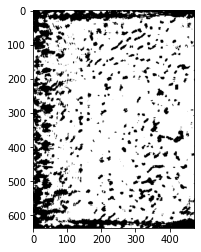

1283.0154252052307


In [17]:
from scipy.stats import multivariate_normal
import time
start = time.time()
from numpy.linalg import inv,det


cov_FG_inv = inv(cov_FG)
cov_BG_inv = inv(cov_BG)
cov_FG_det = det(cov_FG)
cov_BG_det = det(cov_BG)

for fname in glob.glob(path+'/*.Png'):  
    A = []
    serNum = fname.split('/')[6] 
    img  = cv.imread(fname)
    imgray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    
    imgFilt = cv.bilateralFilter(imgray, 15, 75, 75)
    diag_img = signal.convolve2d(imgFilt, np.array(kern), boundary='symm', mode='same')
    im = (diag_img+2)/4
    #im = (((diag_img+2))/4*255).astype(np.uint8) #bc min=-2 and max=+2
    im_array = np.array(im)
    for i in range(0,len(im_array)-8):
        for j in range(0,im_array.shape[1]-8):
            FG,BG = 0,0
            row_start,row_end = i,i+8
            col_start,col_end = j,j+8
            block = im_array[row_start:row_end,col_start:col_end]
            block_dct = dct2d(block).flatten()
            #block_dct = zig_zag_transform(block_dct)
            # foreground
    #         temp = block_dct - mean_FG
    #         temp1 = temp[:,np.newaxis]
    #         temp2 = (temp1.T.dot(cov_FG_inv)).dot(temp1)
    #         temp3 = np.log((2*np.pi)**64 * cov_FG_det) - 2 * np.log(prior_cheetah)
    #         FG = temp2 + temp3
            FG = multivariate_normal.pdf(block_dct,mean=mean_FG,cov=cov_FG)*prior_ch
            #print(block_dct)
            #background
    #         temp = block_dct - mean_BG
    #         temp1 = temp[:,np.newaxis]
    #         temp2 = (temp1.T.dot(cov_BG_inv)).dot(temp1)
    #         temp3 = np.log((2*np.pi)**64 * cov_BG_det) - 2 * np.log(prior_grass)
    #         BG = temp2 + temp3
            BG = multivariate_normal.pdf(block_dct,mean=mean_BG,cov=cov_BG)*prior_chNot
            print(i,',',j,':',FG,',',BG)
            if (FG) >= (BG):
                A.append(0)
            else:
                A.append(1)  
    A = np.array(A)
    A_matrix = np.reshape(A,(i+1,j+1))
    plt.figure()
    plt.imshow(A_matrix, cmap="gray")
    plt.show()
    break

end = time.time()
print(end - start)
    

In [ ]:
A_matrix = np.reshape(A,(638,473))

In [ ]:
plt.figure()
plt.imshow(A_matrix, cmap="gray")
plt.show()

In [ ]:
print(A_matrix)

In [ ]:
ch_dct[0]